1. fix the issue with HPT
2. remove collinear variables
3. auc and auprc get values of one which is incorrect,
4. add early stopping, 

In [1]:
%pip install optuna

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 182.0/182.0 kB 3.8 MB/s eta 0:00:00a 0:00:01
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 413.4/413.4 kB 11.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 233.4/233.4 kB 8.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 33.4 MB/s eta 0:00:0000:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.7/78.7 kB 2.7 MB/s eta 0:00:00
  Created wheel for greenlet: filename=greenlet-3.0.3-cp38-cp38-macosx_10_9_x86_64.whl size=219835 sha256=16e98460d332576621c185b2e997eb87162b84754f7e0755086428d04e4144ce
  Stored in directory: /Users/momamouei/Library/Caches/pip/wheels/48/c3/46/5e61d8224ca5247a7464bdd6fdded397df3f17812d0cbb402f
Successfully built greenlet
Note: you may need to restart the kernel to use updated packages.


In [55]:
import numpy as np
import lightgbm as lgb
import pandas as pd
import seaborn as sns

from datetime import timedelta
from tqdm.notebook import tqdm
import time
from sklearn.metrics import roc_auc_score,roc_curve,average_precision_score,roc_auc_score
import matplotlib.pyplot as plt
import pickle
import optuna

# Model training 

In [33]:
fl_df=pd.read_csv('data/fl_hourly_20200101_20240205_GGL_NVD_MS_APL.csv')
fl_df.timestamp=pd.to_datetime(fl_df.timestamp, utc=True)
fl_df=fl_df.set_index('timestamp')
fl_df=fl_df.drop(columns='Unnamed: 0')

categorical=['symbol']
with open('models/all_features20240207.pkl', 'rb') as f:
    feature_columns=pickle.load(f)
#feature_columns.remove('label')

feature_columns=feature_columns+['symbol']


fl_df.index.min(),fl_df.index.max()

(Timestamp('2020-01-02 09:00:00+0000', tz='UTC'),
 Timestamp('2024-02-05 19:00:00+0000', tz='UTC'))

# Stich with minute by minute features

In [34]:
fl_minute=pd.read_csv('bars_minute_20200101_GGL_NVD_MS_APL.csv').drop(columns='Unnamed: 0')
fl_minute['timestamp']=pd.to_datetime(fl_minute.timestamp, utc=True)
fl_minute=fl_minute.drop(columns=['last_value_open','last_value_high','last_value_low','last_value_close','last_value_volume','last_value_trade_count','last_value_vwap','last_value_delta_HL','last_value_nrmlz_open','last_value_nrmlz_high','last_value_nrmlz_low','last_value_nrmlz_close','last_value_nrmlz_volume','last_value_nrmlz_trade_count','last_value_nrmlz_vwap','last_value_nrmlz_delta_HL'])

In [35]:
data=pd.merge(fl_df,fl_minute,on=['timestamp','symbol'],how='inner')

In [36]:
minute_features_list=fl_minute.columns.tolist()
minute_features_list.remove('timestamp_minute')
minute_features_list.remove('timestamp')
minute_features_list.remove('symbol')

In [37]:
for cat in categorical:
    data[cat]=data[cat].astype("category")

In [38]:
train_test_split_date=pd.to_datetime('2023-09-01').tz_localize('UTC')

train=data[data.timestamp<train_test_split_date]
test=data[data.timestamp>=train_test_split_date]


#the step above messe up the timestamp orders because it's using set, below sorts it out
train=train.sort_values(by=['timestamp','symbol']).set_index('timestamp')
test=test.sort_values(by=['timestamp','symbol']).set_index('timestamp')

## set params of timeseries cross-validation

In [39]:
train_period_in_months=round((train.index.max()-train.index.min())/np.timedelta64(1, 'M'))

internal_validation_split_in_months=3
stride_in_month=2
cv_splits=10

internal_training_split_in_months=train_period_in_months-(cv_splits-1)*stride_in_month-internal_validation_split_in_months
print('internal_training_split_in_months will be: '+str(internal_training_split_in_months))

internal_training_split_in_months will be: 22


In [40]:
internal_training_startdate=train.index.min()
train.index.min(),train.index.max()

(Timestamp('2020-01-02 09:00:00+0000', tz='UTC'),
 Timestamp('2023-08-31 23:00:00+0000', tz='UTC'))

In [41]:
feature_columns=feature_columns+minute_features_list
label_column='label'
'symbol' if 'symbol'in feature_columns else None

'symbol'

# Test

In [179]:
global counter_glbl
counter_glbl=0
n_trials=2
feature_importances=np.zeros([n_trials*cv_splits,len(feature_columns)])

for counter_glbl in range(0,n_trials):
    print(counter_glbl)

    params={'cat_smooth':10,
        'xgboost_dart_mode':'true',
        'enable_bundle':True,
        'drop_rate':0.05,'skip_drop':0.5,'max_drop':50,
        'importance_type':'gain',
        'boosting_type':'gbdt',
        'bagging_fraction': 0.755828,
        'feature_fraction': 0.943518,
        'lambda_l1':        0.150457,
        'learning_rate':    0.146094,
        'min_data_in_leaf': 62,
        'min_split_gain': 0.461545,
        'n_estimators':  50,
        'num_leaves' :100,
        'evel_metric':'average_precision',
        "first_metric_only": True,
        'early_stopping_rounds':1
       }


    model_predictions=np.zeros([1,2])

    performance_metrics=np.zeros([2,cv_splits])

    cnt=0

    for fold,tscv_index_time in enumerate([train.index.min()+np.timedelta64(internal_training_split_in_months, 'M')+np.timedelta64(i*stride_in_month, 'M') for i in range(cv_splits)]):
        internal_tscv_split_training_starttime=internal_training_startdate+np.timedelta64(fold*stride_in_month, 'M')
        internal_tscv_split_validation_endtime=tscv_index_time+np.timedelta64(internal_validation_split_in_months, 'M')
    
        
        print('fold {}: training [{},  {}]   testing [{},  {}]'.format(fold,
                                                 internal_tscv_split_training_starttime.date().strftime("%Y-%m-%d"),
                                                 tscv_index_time.date().strftime("%Y-%m-%d"),
                                                 tscv_index_time.date().strftime("%Y-%m-%d"),
                                                 internal_tscv_split_validation_endtime.date().strftime("%Y-%m-%d") ))
    
        #train model
        tscv_train_indices=(train.index<tscv_index_time) & (train.index>=internal_tscv_split_training_starttime)
        tscv_validation_indices=(train.index>=tscv_index_time) & (train.index<=internal_tscv_split_validation_endtime)
    
        clf = lgb.LGBMClassifier(**params)
        clf.fit(train[tscv_train_indices][feature_columns], train[tscv_train_indices][label_column],
                categorical_feature=['symbol'],
                eval_set=[(train[tscv_validation_indices][feature_columns],
                           train[tscv_validation_indices][label_column])],
                eval_metric='average_precision')
        model_predictions=np.concatenate((model_predictions,
                                          np.array([clf.predict_proba(train[tscv_validation_indices][feature_columns])[:,1],
                                                    train[tscv_validation_indices][label_column]
                                                   ]).T),axis=0)
    
        feature_importances[counter_glbl*cv_splits+fold,:]=clf.feature_importances_
        cnt+=1

    auprc=average_precision_score(model_predictions[:,1],model_predictions[:,0])
    auc=roc_auc_score(model_predictions[:,1],model_predictions[:,0])

    

0
fold 0: training [2020-01-02,  2021-11-01]   testing [2021-11-01,  2022-01-30]


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'


[LightGBM] [Warning] Unknown parameter: evel_metric
[LightGBM] [Warning] lambda_l1 is set=0.150457, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.150457
[LightGBM] [Warning] early_stopping_round is set=1, early_stopping_rounds=1 will be ignored. Current value: early_stopping_round=1
[LightGBM] [Warning] min_data_in_leaf is set=62, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=62
[LightGBM] [Warning] feature_fraction is set=0.943518, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.943518
[LightGBM] [Warning] bagging_fraction is set=0.755828, subsample=1.0 will be ignored. Current value: bagging_fraction=0.755828


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.322723	valid_0's binary_logloss: 0.292494
[2]	valid_0's average_precision: 0.345214	valid_0's binary_logloss: 0.278788
[3]	valid_0's average_precision: 0.361233	valid_0's binary_logloss: 0.269488
[4]	valid_0's average_precision: 0.372255	valid_0's binary_logloss: 0.262721
[5]	valid_0's average_precision: 0.379338	valid_0's binary_logloss: 0.256785
[6]	valid_0's average_precision: 0.385283	valid_0's binary_logloss: 0.251672
[7]	valid_0's average_precision: 0.391366	valid_0's binary_logloss: 0.248836
[8]	valid_0's average_precision: 0.39436	valid_0's binary_logloss: 0.246433
[9]	valid_0's average_precision: 0.401874	valid_0's binary_logloss: 0.244288
[10]	valid_0's average_precision: 0.407459	valid_0's binary_logloss: 0.242756
[11]	valid_0's average_precision: 0.402308	valid_0's binary_logloss: 0.243056
fold 1: training [2020-03-01,  2021-12-30]   testing [2021-12-30,  2022-03-30]


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'


[LightGBM] [Warning] Unknown parameter: evel_metric
[LightGBM] [Warning] lambda_l1 is set=0.150457, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.150457
[LightGBM] [Warning] early_stopping_round is set=1, early_stopping_rounds=1 will be ignored. Current value: early_stopping_round=1
[LightGBM] [Warning] min_data_in_leaf is set=62, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=62
[LightGBM] [Warning] feature_fraction is set=0.943518, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.943518
[LightGBM] [Warning] bagging_fraction is set=0.755828, subsample=1.0 will be ignored. Current value: bagging_fraction=0.755828


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.345961	valid_0's binary_logloss: 0.350656
[2]	valid_0's average_precision: 0.367146	valid_0's binary_logloss: 0.335223
[3]	valid_0's average_precision: 0.370886	valid_0's binary_logloss: 0.326034
[4]	valid_0's average_precision: 0.375156	valid_0's binary_logloss: 0.31991
[5]	valid_0's average_precision: 0.374901	valid_0's binary_logloss: 0.315862
fold 2: training [2020-05-01,  2022-03-01]   testing [2022-03-01,  2022-05-30]


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'


[LightGBM] [Warning] Unknown parameter: evel_metric
[LightGBM] [Warning] lambda_l1 is set=0.150457, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.150457
[LightGBM] [Warning] early_stopping_round is set=1, early_stopping_rounds=1 will be ignored. Current value: early_stopping_round=1
[LightGBM] [Warning] min_data_in_leaf is set=62, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=62
[LightGBM] [Warning] feature_fraction is set=0.943518, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.943518
[LightGBM] [Warning] bagging_fraction is set=0.755828, subsample=1.0 will be ignored. Current value: bagging_fraction=0.755828


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.345058	valid_0's binary_logloss: 0.377102
[2]	valid_0's average_precision: 0.380285	valid_0's binary_logloss: 0.357107
[3]	valid_0's average_precision: 0.379948	valid_0's binary_logloss: 0.347491
fold 3: training [2020-07-01,  2022-05-01]   testing [2022-05-01,  2022-07-30]


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'


KeyboardInterrupt: 

In [178]:
auprc

0.32994178576299843

# Test end

In [182]:
global counter_glbl
counter_glbl=0
n_trials=100
feature_importances=np.zeros([n_trials*cv_splits,len(feature_columns)])

def objective(trial):
    global counter_glbl
    print(counter_glbl)

    params={
        'n_jobs':-1,
        'boosting_type':'gbdt',
        'cat_smooth':10,
        'enable_bundle':True,
        'drop_rate':0.1,'skip_drop':0.5,'max_drop':50,
        'eval_metric':'average_precision',
        "first_metric_only": True,
        'verbosity':-1,
        'xgboost_dart_mode':trial.suggest_categorical('xgboost_dart_mode',['false','true']),
        'boosting_type':trial.suggest_categorical('boosting_type',['gbdt','dart']),                                              
        'early_stopping_rounds':trial.suggest_int('early_stopping_rounds',10,50),
        'categorical_feature':['symbol' if 'symbol'in feature_columns else None],
        'n_estimators':trial.suggest_int('n_estimators',100,300),
        'bagging_fraction':trial.suggest_float('bagging_fraction',0.6,1),
        #'max_bin': trial.suggest_int('max_bin',300,400),
        'learning_rate':trial.suggest_float('learning_rate',0.01,0.2),
        'num_leaves':trial.suggest_int('num_leaves',200,400),
        'min_data_in_leaf':trial.suggest_int('min_data_in_leaf',30,100),
        'feature_fraction':trial.suggest_float('feature_fraction',0.9,1),
        'min_split_gain':trial.suggest_float('min_split_gain',0,1),
        #'cat_l2':trial.suggest_int('cat_l2',5,20),
        'lambda_l1':trial.suggest_float('lambda_l1',0.02,0.5),
        #'early_stopping_rounds':30
    }


    model_predictions=np.zeros([1,2])

    performance_metrics=np.zeros([2,cv_splits])

    cnt=0

    for fold,tscv_index_time in enumerate([train.index.min()+np.timedelta64(internal_training_split_in_months, 'M')+np.timedelta64(i*stride_in_month, 'M') for i in range(cv_splits)]):
        internal_tscv_split_training_starttime=internal_training_startdate+np.timedelta64(fold*stride_in_month, 'M')
        internal_tscv_split_validation_endtime=tscv_index_time+np.timedelta64(internal_validation_split_in_months, 'M')
    
        
        print('fold {}: training [{},  {}]   testing [{},  {}]'.format(fold,
                                                 internal_tscv_split_training_starttime.date().strftime("%Y-%m-%d"),
                                                 tscv_index_time.date().strftime("%Y-%m-%d"),
                                                 tscv_index_time.date().strftime("%Y-%m-%d"),
                                                 internal_tscv_split_validation_endtime.date().strftime("%Y-%m-%d") ))
    
        #train model
        tscv_train_indices=(train.index<tscv_index_time) & (train.index>=internal_tscv_split_training_starttime)
        tscv_validation_indices=(train.index>=tscv_index_time) & (train.index<=internal_tscv_split_validation_endtime)
    
        clf = lgb.LGBMClassifier(**params)
        clf.fit(train[tscv_train_indices][feature_columns], train[tscv_train_indices][label_column],
                categorical_feature=['symbol'],
                eval_set=[(train[tscv_validation_indices][feature_columns],
                           train[tscv_validation_indices][label_column])],
                eval_metric='average_precision')
        model_predictions=np.concatenate((model_predictions,
                                          np.array([clf.predict_proba(train[tscv_validation_indices][feature_columns])[:,1],
                                                    train[tscv_validation_indices][label_column]
                                                   ]).T),axis=0)
    
        feature_importances[counter_glbl*cv_splits+fold,:]=clf.feature_importances_
        cnt+=1

    auprc=average_precision_score(model_predictions[:,1],model_predictions[:,0])
    auc=roc_auc_score(model_predictions[:,1],model_predictions[:,0])
    counter_glbl+=1
    return auprc
    

In [183]:
study = optuna.create_study(direction='maximize')
study.optimize(objective,n_trials=n_trials,show_progress_bar=True)

[I 2024-02-18 12:47:08,383] A new study created in memory with name: no-name-e5f3da4e-2a3d-48c2-963c-6388c3057454


  0%|          | 0/100 [00:00<?, ?it/s]

0
fold 0: training [2020-01-02,  2021-11-01]   testing [2021-11-01,  2022-01-30]


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-

[1]	valid_0's average_precision: 0.313698	valid_0's binary_logloss: 0.292349
[2]	valid_0's average_precision: 0.359189	valid_0's binary_logloss: 0.275779
[3]	valid_0's average_precision: 0.380871	valid_0's binary_logloss: 0.264518
[4]	valid_0's average_precision: 0.39504	valid_0's binary_logloss: 0.257249
[5]	valid_0's average_precision: 0.408455	valid_0's binary_logloss: 0.250304
[6]	valid_0's average_precision: 0.412302	valid_0's binary_logloss: 0.246413
[7]	valid_0's average_precision: 0.415811	valid_0's binary_logloss: 0.243853
[8]	valid_0's average_precision: 0.412265	valid_0's binary_logloss: 0.241704
[9]	valid_0's average_precision: 0.410821	valid_0's binary_logloss: 0.241485
[10]	valid_0's average_precision: 0.41226	valid_0's binary_logloss: 0.240041
[11]	valid_0's average_precision: 0.413639	valid_0's binary_logloss: 0.23901
[12]	valid_0's average_precision: 0.413053	valid_0's binary_logloss: 0.239862
[13]	valid_0's average_precision: 0.413742	valid_0's binary_logloss: 0.23932

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] feature_fraction is set=0.9952571434563837, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9952571434563837
[LightGBM] [Warning] bagging_fraction is set=0.8575720944058306, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8575720944058306
[LightGBM] [Warning] lambda_l1 is set=0.225827794123336, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.225827794123336
[LightGBM] [Warning] early_stopping_round is set=48, early_stopping_rounds=48 will be ignored. Current value: early_stopping_round=48


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.377015	valid_0's binary_logloss: 0.344966
[2]	valid_0's average_precision: 0.39801	valid_0's binary_logloss: 0.327429
[3]	valid_0's average_precision: 0.403545	valid_0's binary_logloss: 0.31848
[4]	valid_0's average_precision: 0.406482	valid_0's binary_logloss: 0.313
[5]	valid_0's average_precision: 0.407752	valid_0's binary_logloss: 0.3085
[6]	valid_0's average_precision: 0.411127	valid_0's binary_logloss: 0.305794
[7]	valid_0's average_precision: 0.418827	valid_0's binary_logloss: 0.302165
[8]	valid_0's average_precision: 0.419094	valid_0's binary_logloss: 0.301099
[9]	valid_0's average_precision: 0.422571	valid_0's binary_logloss: 0.299227
[10]	valid_0's average_precision: 0.423968	valid_0's binary_logloss: 0.298867
[11]	valid_0's average_precision: 0.418191	valid_0's binary_logloss: 0.299545
[12]	valid_0's average_precision: 0.41878	valid_0's binary_logloss: 0.299151
[13]	valid_0's average_precision: 0.420048	valid_0's binary_logloss: 0.298571
[14

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] feature_fraction is set=0.9952571434563837, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9952571434563837
[LightGBM] [Warning] bagging_fraction is set=0.8575720944058306, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8575720944058306
[LightGBM] [Warning] lambda_l1 is set=0.225827794123336, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.225827794123336
[LightGBM] [Warning] early_stopping_round is set=48, early_stopping_rounds=48 will be ignored. Current value: early_stopping_round=48


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.366382	valid_0's binary_logloss: 0.373112
[2]	valid_0's average_precision: 0.389651	valid_0's binary_logloss: 0.354809
[3]	valid_0's average_precision: 0.404913	valid_0's binary_logloss: 0.341828
[4]	valid_0's average_precision: 0.418122	valid_0's binary_logloss: 0.332821
[5]	valid_0's average_precision: 0.417913	valid_0's binary_logloss: 0.327005
[6]	valid_0's average_precision: 0.418683	valid_0's binary_logloss: 0.323051
[7]	valid_0's average_precision: 0.418479	valid_0's binary_logloss: 0.321257
[8]	valid_0's average_precision: 0.42046	valid_0's binary_logloss: 0.319322
[9]	valid_0's average_precision: 0.420774	valid_0's binary_logloss: 0.318963
[10]	valid_0's average_precision: 0.424246	valid_0's binary_logloss: 0.317845
[11]	valid_0's average_precision: 0.422123	valid_0's binary_logloss: 0.317292
[12]	valid_0's average_precision: 0.421308	valid_0's binary_logloss: 0.317169
[13]	valid_0's average_precision: 0.422823	valid_0's binary_logloss: 0.316

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] feature_fraction is set=0.9952571434563837, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9952571434563837
[LightGBM] [Warning] bagging_fraction is set=0.8575720944058306, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8575720944058306
[LightGBM] [Warning] lambda_l1 is set=0.225827794123336, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.225827794123336
[LightGBM] [Warning] early_stopping_round is set=48, early_stopping_rounds=48 will be ignored. Current value: early_stopping_round=48


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.309727	valid_0's binary_logloss: 0.382181
[2]	valid_0's average_precision: 0.345537	valid_0's binary_logloss: 0.363087
[3]	valid_0's average_precision: 0.355393	valid_0's binary_logloss: 0.351889
[4]	valid_0's average_precision: 0.358262	valid_0's binary_logloss: 0.345361
[5]	valid_0's average_precision: 0.367511	valid_0's binary_logloss: 0.341406
[6]	valid_0's average_precision: 0.371139	valid_0's binary_logloss: 0.338455
[7]	valid_0's average_precision: 0.375539	valid_0's binary_logloss: 0.33583
[8]	valid_0's average_precision: 0.374373	valid_0's binary_logloss: 0.335438
[9]	valid_0's average_precision: 0.379881	valid_0's binary_logloss: 0.333401
[10]	valid_0's average_precision: 0.380272	valid_0's binary_logloss: 0.33322
[11]	valid_0's average_precision: 0.381679	valid_0's binary_logloss: 0.333531
[12]	valid_0's average_precision: 0.382161	valid_0's binary_logloss: 0.334323
[13]	valid_0's average_precision: 0.381218	valid_0's binary_logloss: 0.3355

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] feature_fraction is set=0.9952571434563837, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9952571434563837
[LightGBM] [Warning] bagging_fraction is set=0.8575720944058306, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8575720944058306
[LightGBM] [Warning] lambda_l1 is set=0.225827794123336, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.225827794123336
[LightGBM] [Warning] early_stopping_round is set=48, early_stopping_rounds=48 will be ignored. Current value: early_stopping_round=48


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.239047	valid_0's binary_logloss: 0.266991
[2]	valid_0's average_precision: 0.272554	valid_0's binary_logloss: 0.25485
[3]	valid_0's average_precision: 0.273392	valid_0's binary_logloss: 0.249167
[4]	valid_0's average_precision: 0.279036	valid_0's binary_logloss: 0.24492
[5]	valid_0's average_precision: 0.280685	valid_0's binary_logloss: 0.241812
[6]	valid_0's average_precision: 0.28227	valid_0's binary_logloss: 0.239421
[7]	valid_0's average_precision: 0.284629	valid_0's binary_logloss: 0.237529
[8]	valid_0's average_precision: 0.285068	valid_0's binary_logloss: 0.236161
[9]	valid_0's average_precision: 0.282268	valid_0's binary_logloss: 0.236244
[10]	valid_0's average_precision: 0.285187	valid_0's binary_logloss: 0.235108
[11]	valid_0's average_precision: 0.283763	valid_0's binary_logloss: 0.235515
[12]	valid_0's average_precision: 0.28601	valid_0's binary_logloss: 0.234671
[13]	valid_0's average_precision: 0.28852	valid_0's binary_logloss: 0.235158


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] feature_fraction is set=0.9952571434563837, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9952571434563837
[LightGBM] [Warning] bagging_fraction is set=0.8575720944058306, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8575720944058306
[LightGBM] [Warning] lambda_l1 is set=0.225827794123336, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.225827794123336
[LightGBM] [Warning] early_stopping_round is set=48, early_stopping_rounds=48 will be ignored. Current value: early_stopping_round=48


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.26327	valid_0's binary_logloss: 0.309117
[2]	valid_0's average_precision: 0.292748	valid_0's binary_logloss: 0.295758
[3]	valid_0's average_precision: 0.300334	valid_0's binary_logloss: 0.289416
[4]	valid_0's average_precision: 0.300976	valid_0's binary_logloss: 0.284935
[5]	valid_0's average_precision: 0.305489	valid_0's binary_logloss: 0.28151
[6]	valid_0's average_precision: 0.304235	valid_0's binary_logloss: 0.279496
[7]	valid_0's average_precision: 0.301572	valid_0's binary_logloss: 0.279832
[8]	valid_0's average_precision: 0.301703	valid_0's binary_logloss: 0.27973
[9]	valid_0's average_precision: 0.302775	valid_0's binary_logloss: 0.278999
[10]	valid_0's average_precision: 0.300854	valid_0's binary_logloss: 0.278724
[11]	valid_0's average_precision: 0.296996	valid_0's binary_logloss: 0.279373
[12]	valid_0's average_precision: 0.298045	valid_0's binary_logloss: 0.279508
[13]	valid_0's average_precision: 0.293667	valid_0's binary_logloss: 0.28044

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] feature_fraction is set=0.9952571434563837, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9952571434563837
[LightGBM] [Warning] bagging_fraction is set=0.8575720944058306, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8575720944058306
[LightGBM] [Warning] lambda_l1 is set=0.225827794123336, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.225827794123336
[LightGBM] [Warning] early_stopping_round is set=48, early_stopping_rounds=48 will be ignored. Current value: early_stopping_round=48


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.287257	valid_0's binary_logloss: 0.284675
[2]	valid_0's average_precision: 0.323302	valid_0's binary_logloss: 0.27212
[3]	valid_0's average_precision: 0.329611	valid_0's binary_logloss: 0.264238
[4]	valid_0's average_precision: 0.329954	valid_0's binary_logloss: 0.259501
[5]	valid_0's average_precision: 0.325726	valid_0's binary_logloss: 0.25666
[6]	valid_0's average_precision: 0.321111	valid_0's binary_logloss: 0.25513
[7]	valid_0's average_precision: 0.318693	valid_0's binary_logloss: 0.253312
[8]	valid_0's average_precision: 0.318893	valid_0's binary_logloss: 0.252676
[9]	valid_0's average_precision: 0.319042	valid_0's binary_logloss: 0.250789
[10]	valid_0's average_precision: 0.319231	valid_0's binary_logloss: 0.249929
[11]	valid_0's average_precision: 0.320799	valid_0's binary_logloss: 0.249273
[12]	valid_0's average_precision: 0.318298	valid_0's binary_logloss: 0.249788
[13]	valid_0's average_precision: 0.319765	valid_0's binary_logloss: 0.24906

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] feature_fraction is set=0.9952571434563837, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9952571434563837
[LightGBM] [Warning] bagging_fraction is set=0.8575720944058306, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8575720944058306
[LightGBM] [Warning] lambda_l1 is set=0.225827794123336, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.225827794123336
[LightGBM] [Warning] early_stopping_round is set=48, early_stopping_rounds=48 will be ignored. Current value: early_stopping_round=48


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.293404	valid_0's binary_logloss: 0.299631
[2]	valid_0's average_precision: 0.329517	valid_0's binary_logloss: 0.287006
[3]	valid_0's average_precision: 0.328541	valid_0's binary_logloss: 0.279817
[4]	valid_0's average_precision: 0.330833	valid_0's binary_logloss: 0.275386
[5]	valid_0's average_precision: 0.343634	valid_0's binary_logloss: 0.270991
[6]	valid_0's average_precision: 0.350623	valid_0's binary_logloss: 0.267593
[7]	valid_0's average_precision: 0.345823	valid_0's binary_logloss: 0.265888
[8]	valid_0's average_precision: 0.347109	valid_0's binary_logloss: 0.264408
[9]	valid_0's average_precision: 0.343406	valid_0's binary_logloss: 0.2641
[10]	valid_0's average_precision: 0.338245	valid_0's binary_logloss: 0.264293
[11]	valid_0's average_precision: 0.332767	valid_0's binary_logloss: 0.265875
[12]	valid_0's average_precision: 0.334572	valid_0's binary_logloss: 0.265584
[13]	valid_0's average_precision: 0.336721	valid_0's binary_logloss: 0.2652

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] feature_fraction is set=0.9952571434563837, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9952571434563837
[LightGBM] [Warning] bagging_fraction is set=0.8575720944058306, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8575720944058306
[LightGBM] [Warning] lambda_l1 is set=0.225827794123336, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.225827794123336
[LightGBM] [Warning] early_stopping_round is set=48, early_stopping_rounds=48 will be ignored. Current value: early_stopping_round=48


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.188566	valid_0's binary_logloss: 0.226907
[2]	valid_0's average_precision: 0.236293	valid_0's binary_logloss: 0.216508
[3]	valid_0's average_precision: 0.252102	valid_0's binary_logloss: 0.209463
[4]	valid_0's average_precision: 0.261421	valid_0's binary_logloss: 0.203737
[5]	valid_0's average_precision: 0.263595	valid_0's binary_logloss: 0.199951
[6]	valid_0's average_precision: 0.25482	valid_0's binary_logloss: 0.197862
[7]	valid_0's average_precision: 0.258995	valid_0's binary_logloss: 0.195423
[8]	valid_0's average_precision: 0.265594	valid_0's binary_logloss: 0.193369
[9]	valid_0's average_precision: 0.27144	valid_0's binary_logloss: 0.191787
[10]	valid_0's average_precision: 0.270539	valid_0's binary_logloss: 0.189779
[11]	valid_0's average_precision: 0.267412	valid_0's binary_logloss: 0.189758
[12]	valid_0's average_precision: 0.273578	valid_0's binary_logloss: 0.189473
[13]	valid_0's average_precision: 0.277909	valid_0's binary_logloss: 0.1888

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] feature_fraction is set=0.9952571434563837, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9952571434563837
[LightGBM] [Warning] bagging_fraction is set=0.8575720944058306, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8575720944058306
[LightGBM] [Warning] lambda_l1 is set=0.225827794123336, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.225827794123336
[LightGBM] [Warning] early_stopping_round is set=48, early_stopping_rounds=48 will be ignored. Current value: early_stopping_round=48


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.263605	valid_0's binary_logloss: 0.208295
[2]	valid_0's average_precision: 0.323457	valid_0's binary_logloss: 0.19716
[3]	valid_0's average_precision: 0.315136	valid_0's binary_logloss: 0.190453
[4]	valid_0's average_precision: 0.331254	valid_0's binary_logloss: 0.184006
[5]	valid_0's average_precision: 0.333424	valid_0's binary_logloss: 0.17977
[6]	valid_0's average_precision: 0.329847	valid_0's binary_logloss: 0.176182
[7]	valid_0's average_precision: 0.326317	valid_0's binary_logloss: 0.173584
[8]	valid_0's average_precision: 0.32873	valid_0's binary_logloss: 0.171183
[9]	valid_0's average_precision: 0.314403	valid_0's binary_logloss: 0.169848
[10]	valid_0's average_precision: 0.319953	valid_0's binary_logloss: 0.168329
[11]	valid_0's average_precision: 0.314161	valid_0's binary_logloss: 0.16737
[12]	valid_0's average_precision: 0.303933	valid_0's binary_logloss: 0.166931
[13]	valid_0's average_precision: 0.310598	valid_0's binary_logloss: 0.166383

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] feature_fraction is set=0.9067660863272073, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9067660863272073
[LightGBM] [Warning] bagging_fraction is set=0.8168287413772249, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8168287413772249
[LightGBM] [Warning] lambda_l1 is set=0.33020964245218276, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.33020964245218276
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.317736	valid_0's binary_logloss: 0.297525
[2]	valid_0's average_precision: 0.341709	valid_0's binary_logloss: 0.284332
[3]	valid_0's average_precision: 0.361985	valid_0's binary_logloss: 0.275004
[4]	valid_0's average_precision: 0.366081	valid_0's binary_logloss: 0.268129
[5]	valid_0's average_precision: 0.373955	valid_0's binary_logloss: 0.262765
[6]	valid_0's average_precision: 0.378312	valid_0's binary_logloss: 0.258505
[7]	valid_0's average_precision: 0.382672	valid_0's binary_logloss: 0.255249
[8]	valid_0's average_precision: 0.389503	valid_0's binary_logloss: 0.252179
[9]	valid_0's average_precision: 0.392547	valid_0's binary_logloss: 0.249882
[10]	valid_0's average_precision: 0.398343	valid_0's binary_logloss: 0.247179
[11]	valid_0's average_precision: 0.403988	valid_0's binary_logloss: 0.244947
[12]	valid_0's average_precision: 0.409297	valid_0's binary_logloss: 0.242958
[13]	valid_0's average_precision: 0.413011	valid_0's binary_logloss: 0.24

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] feature_fraction is set=0.9067660863272073, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9067660863272073
[LightGBM] [Warning] bagging_fraction is set=0.8168287413772249, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8168287413772249
[LightGBM] [Warning] lambda_l1 is set=0.33020964245218276, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.33020964245218276
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.346473	valid_0's binary_logloss: 0.355896
[2]	valid_0's average_precision: 0.360601	valid_0's binary_logloss: 0.341003
[3]	valid_0's average_precision: 0.377116	valid_0's binary_logloss: 0.332165
[4]	valid_0's average_precision: 0.385489	valid_0's binary_logloss: 0.324551
[5]	valid_0's average_precision: 0.389301	valid_0's binary_logloss: 0.320333
[6]	valid_0's average_precision: 0.386396	valid_0's binary_logloss: 0.318277
[7]	valid_0's average_precision: 0.385674	valid_0's binary_logloss: 0.315465
[8]	valid_0's average_precision: 0.388168	valid_0's binary_logloss: 0.313462
[9]	valid_0's average_precision: 0.392425	valid_0's binary_logloss: 0.310704
[10]	valid_0's average_precision: 0.393102	valid_0's binary_logloss: 0.309403
[11]	valid_0's average_precision: 0.39331	valid_0's binary_logloss: 0.308584
[12]	valid_0's average_precision: 0.396679	valid_0's binary_logloss: 0.307456
[13]	valid_0's average_precision: 0.39353	valid_0's binary_logloss: 0.3080

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] feature_fraction is set=0.9067660863272073, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9067660863272073
[LightGBM] [Warning] bagging_fraction is set=0.8168287413772249, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8168287413772249
[LightGBM] [Warning] lambda_l1 is set=0.33020964245218276, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.33020964245218276
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.344498	valid_0's binary_logloss: 0.385246
[2]	valid_0's average_precision: 0.365581	valid_0's binary_logloss: 0.367697
[3]	valid_0's average_precision: 0.371323	valid_0's binary_logloss: 0.357791
[4]	valid_0's average_precision: 0.379961	valid_0's binary_logloss: 0.350298
[5]	valid_0's average_precision: 0.388349	valid_0's binary_logloss: 0.344812
[6]	valid_0's average_precision: 0.393793	valid_0's binary_logloss: 0.339478
[7]	valid_0's average_precision: 0.393543	valid_0's binary_logloss: 0.336531
[8]	valid_0's average_precision: 0.393675	valid_0's binary_logloss: 0.335004
[9]	valid_0's average_precision: 0.399562	valid_0's binary_logloss: 0.332118
[10]	valid_0's average_precision: 0.40198	valid_0's binary_logloss: 0.330798
[11]	valid_0's average_precision: 0.404445	valid_0's binary_logloss: 0.329488
[12]	valid_0's average_precision: 0.405397	valid_0's binary_logloss: 0.32845
[13]	valid_0's average_precision: 0.406285	valid_0's binary_logloss: 0.3283

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] feature_fraction is set=0.9067660863272073, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9067660863272073
[LightGBM] [Warning] bagging_fraction is set=0.8168287413772249, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8168287413772249
[LightGBM] [Warning] lambda_l1 is set=0.33020964245218276, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.33020964245218276
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.30656	valid_0's binary_logloss: 0.390969
[2]	valid_0's average_precision: 0.343446	valid_0's binary_logloss: 0.374239
[3]	valid_0's average_precision: 0.359664	valid_0's binary_logloss: 0.363663
[4]	valid_0's average_precision: 0.378762	valid_0's binary_logloss: 0.354321
[5]	valid_0's average_precision: 0.383888	valid_0's binary_logloss: 0.349452
[6]	valid_0's average_precision: 0.383021	valid_0's binary_logloss: 0.345987
[7]	valid_0's average_precision: 0.385436	valid_0's binary_logloss: 0.344137
[8]	valid_0's average_precision: 0.386577	valid_0's binary_logloss: 0.342097
[9]	valid_0's average_precision: 0.385622	valid_0's binary_logloss: 0.34193
[10]	valid_0's average_precision: 0.387734	valid_0's binary_logloss: 0.340648
[11]	valid_0's average_precision: 0.388353	valid_0's binary_logloss: 0.339338
[12]	valid_0's average_precision: 0.388426	valid_0's binary_logloss: 0.338978
[13]	valid_0's average_precision: 0.385983	valid_0's binary_logloss: 0.3402

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] feature_fraction is set=0.9067660863272073, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9067660863272073
[LightGBM] [Warning] bagging_fraction is set=0.8168287413772249, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8168287413772249
[LightGBM] [Warning] lambda_l1 is set=0.33020964245218276, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.33020964245218276
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.243338	valid_0's binary_logloss: 0.27003
[2]	valid_0's average_precision: 0.258367	valid_0's binary_logloss: 0.261182
[3]	valid_0's average_precision: 0.27111	valid_0's binary_logloss: 0.255288
[4]	valid_0's average_precision: 0.278514	valid_0's binary_logloss: 0.251233
[5]	valid_0's average_precision: 0.28394	valid_0's binary_logloss: 0.248038
[6]	valid_0's average_precision: 0.292001	valid_0's binary_logloss: 0.245616
[7]	valid_0's average_precision: 0.290006	valid_0's binary_logloss: 0.243638
[8]	valid_0's average_precision: 0.288103	valid_0's binary_logloss: 0.24243
[9]	valid_0's average_precision: 0.287855	valid_0's binary_logloss: 0.240818
[10]	valid_0's average_precision: 0.287291	valid_0's binary_logloss: 0.240737
[11]	valid_0's average_precision: 0.28836	valid_0's binary_logloss: 0.240056
[12]	valid_0's average_precision: 0.292727	valid_0's binary_logloss: 0.239394
[13]	valid_0's average_precision: 0.289216	valid_0's binary_logloss: 0.239882


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] feature_fraction is set=0.9067660863272073, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9067660863272073
[LightGBM] [Warning] bagging_fraction is set=0.8168287413772249, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8168287413772249
[LightGBM] [Warning] lambda_l1 is set=0.33020964245218276, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.33020964245218276
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.252659	valid_0's binary_logloss: 0.316313
[2]	valid_0's average_precision: 0.269483	valid_0's binary_logloss: 0.306146
[3]	valid_0's average_precision: 0.294739	valid_0's binary_logloss: 0.297262
[4]	valid_0's average_precision: 0.297884	valid_0's binary_logloss: 0.292685
[5]	valid_0's average_precision: 0.296906	valid_0's binary_logloss: 0.290051
[6]	valid_0's average_precision: 0.301335	valid_0's binary_logloss: 0.28736
[7]	valid_0's average_precision: 0.301665	valid_0's binary_logloss: 0.285653
[8]	valid_0's average_precision: 0.303747	valid_0's binary_logloss: 0.283633
[9]	valid_0's average_precision: 0.301925	valid_0's binary_logloss: 0.282792
[10]	valid_0's average_precision: 0.305694	valid_0's binary_logloss: 0.282108
[11]	valid_0's average_precision: 0.307024	valid_0's binary_logloss: 0.281664
[12]	valid_0's average_precision: 0.307443	valid_0's binary_logloss: 0.281571
[13]	valid_0's average_precision: 0.30811	valid_0's binary_logloss: 0.2818

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] feature_fraction is set=0.9067660863272073, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9067660863272073
[LightGBM] [Warning] bagging_fraction is set=0.8168287413772249, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8168287413772249
[LightGBM] [Warning] lambda_l1 is set=0.33020964245218276, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.33020964245218276
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.2772	valid_0's binary_logloss: 0.292091
[2]	valid_0's average_precision: 0.307464	valid_0's binary_logloss: 0.28108
[3]	valid_0's average_precision: 0.319074	valid_0's binary_logloss: 0.273677
[4]	valid_0's average_precision: 0.321883	valid_0's binary_logloss: 0.26829
[5]	valid_0's average_precision: 0.325196	valid_0's binary_logloss: 0.264264
[6]	valid_0's average_precision: 0.321907	valid_0's binary_logloss: 0.26168
[7]	valid_0's average_precision: 0.324462	valid_0's binary_logloss: 0.259011
[8]	valid_0's average_precision: 0.328598	valid_0's binary_logloss: 0.256827
[9]	valid_0's average_precision: 0.333542	valid_0's binary_logloss: 0.254771
[10]	valid_0's average_precision: 0.329958	valid_0's binary_logloss: 0.254328
[11]	valid_0's average_precision: 0.330082	valid_0's binary_logloss: 0.253761
[12]	valid_0's average_precision: 0.336693	valid_0's binary_logloss: 0.252788
[13]	valid_0's average_precision: 0.335571	valid_0's binary_logloss: 0.252613


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] feature_fraction is set=0.9067660863272073, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9067660863272073
[LightGBM] [Warning] bagging_fraction is set=0.8168287413772249, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8168287413772249
[LightGBM] [Warning] lambda_l1 is set=0.33020964245218276, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.33020964245218276
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.276857	valid_0's binary_logloss: 0.306651
[2]	valid_0's average_precision: 0.300341	valid_0's binary_logloss: 0.29586
[3]	valid_0's average_precision: 0.308176	valid_0's binary_logloss: 0.288789
[4]	valid_0's average_precision: 0.307453	valid_0's binary_logloss: 0.283785
[5]	valid_0's average_precision: 0.313662	valid_0's binary_logloss: 0.279382
[6]	valid_0's average_precision: 0.323638	valid_0's binary_logloss: 0.275836
[7]	valid_0's average_precision: 0.326168	valid_0's binary_logloss: 0.273491
[8]	valid_0's average_precision: 0.330472	valid_0's binary_logloss: 0.271502
[9]	valid_0's average_precision: 0.331986	valid_0's binary_logloss: 0.269937
[10]	valid_0's average_precision: 0.335746	valid_0's binary_logloss: 0.268493
[11]	valid_0's average_precision: 0.337468	valid_0's binary_logloss: 0.267542
[12]	valid_0's average_precision: 0.339985	valid_0's binary_logloss: 0.266621
[13]	valid_0's average_precision: 0.346321	valid_0's binary_logloss: 0.265

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] feature_fraction is set=0.9067660863272073, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9067660863272073
[LightGBM] [Warning] bagging_fraction is set=0.8168287413772249, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8168287413772249
[LightGBM] [Warning] lambda_l1 is set=0.33020964245218276, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.33020964245218276
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.16624	valid_0's binary_logloss: 0.231151
[2]	valid_0's average_precision: 0.207725	valid_0's binary_logloss: 0.223377
[3]	valid_0's average_precision: 0.226536	valid_0's binary_logloss: 0.216933
[4]	valid_0's average_precision: 0.24274	valid_0's binary_logloss: 0.21146
[5]	valid_0's average_precision: 0.251662	valid_0's binary_logloss: 0.206972
[6]	valid_0's average_precision: 0.252373	valid_0's binary_logloss: 0.203741
[7]	valid_0's average_precision: 0.255318	valid_0's binary_logloss: 0.201425
[8]	valid_0's average_precision: 0.253305	valid_0's binary_logloss: 0.199398
[9]	valid_0's average_precision: 0.258295	valid_0's binary_logloss: 0.197445
[10]	valid_0's average_precision: 0.259713	valid_0's binary_logloss: 0.195685
[11]	valid_0's average_precision: 0.262858	valid_0's binary_logloss: 0.194698
[12]	valid_0's average_precision: 0.261544	valid_0's binary_logloss: 0.193797
[13]	valid_0's average_precision: 0.262803	valid_0's binary_logloss: 0.19280

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] feature_fraction is set=0.9067660863272073, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9067660863272073
[LightGBM] [Warning] bagging_fraction is set=0.8168287413772249, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8168287413772249
[LightGBM] [Warning] lambda_l1 is set=0.33020964245218276, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.33020964245218276
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.245948	valid_0's binary_logloss: 0.211879
[2]	valid_0's average_precision: 0.268535	valid_0's binary_logloss: 0.204226
[3]	valid_0's average_precision: 0.273334	valid_0's binary_logloss: 0.198269
[4]	valid_0's average_precision: 0.278662	valid_0's binary_logloss: 0.192935
[5]	valid_0's average_precision: 0.283763	valid_0's binary_logloss: 0.188265
[6]	valid_0's average_precision: 0.287131	valid_0's binary_logloss: 0.184892
[7]	valid_0's average_precision: 0.295017	valid_0's binary_logloss: 0.181322
[8]	valid_0's average_precision: 0.298526	valid_0's binary_logloss: 0.178316
[9]	valid_0's average_precision: 0.299606	valid_0's binary_logloss: 0.176305
[10]	valid_0's average_precision: 0.298485	valid_0's binary_logloss: 0.174909
[11]	valid_0's average_precision: 0.302139	valid_0's binary_logloss: 0.172942
[12]	valid_0's average_precision: 0.307538	valid_0's binary_logloss: 0.170923
[13]	valid_0's average_precision: 0.305241	valid_0's binary_logloss: 0.17

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] feature_fraction is set=0.9174249779410782, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9174249779410782
[LightGBM] [Warning] bagging_fraction is set=0.6060648631488125, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060648631488125
[LightGBM] [Warning] lambda_l1 is set=0.48256590432822494, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.48256590432822494
[LightGBM] [Warning] early_stopping_round is set=21, early_stopping_rounds=21 will be ignored. Current value: early_stopping_round=21


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.324032	valid_0's binary_logloss: 0.287239
[2]	valid_0's average_precision: 0.357644	valid_0's binary_logloss: 0.272863
[3]	valid_0's average_precision: 0.37652	valid_0's binary_logloss: 0.262695
[4]	valid_0's average_precision: 0.38311	valid_0's binary_logloss: 0.257075
[5]	valid_0's average_precision: 0.384875	valid_0's binary_logloss: 0.25323
[6]	valid_0's average_precision: 0.390151	valid_0's binary_logloss: 0.24954
[7]	valid_0's average_precision: 0.393058	valid_0's binary_logloss: 0.24665
[8]	valid_0's average_precision: 0.396279	valid_0's binary_logloss: 0.244736
[9]	valid_0's average_precision: 0.395738	valid_0's binary_logloss: 0.24447
[10]	valid_0's average_precision: 0.397421	valid_0's binary_logloss: 0.243944
[11]	valid_0's average_precision: 0.397254	valid_0's binary_logloss: 0.244509
[12]	valid_0's average_precision: 0.394952	valid_0's binary_logloss: 0.244886
[13]	valid_0's average_precision: 0.39947	valid_0's binary_logloss: 0.24442
[14

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] feature_fraction is set=0.9174249779410782, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9174249779410782
[LightGBM] [Warning] bagging_fraction is set=0.6060648631488125, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060648631488125
[LightGBM] [Warning] lambda_l1 is set=0.48256590432822494, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.48256590432822494
[LightGBM] [Warning] early_stopping_round is set=21, early_stopping_rounds=21 will be ignored. Current value: early_stopping_round=21


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.364911	valid_0's binary_logloss: 0.342023
[2]	valid_0's average_precision: 0.391018	valid_0's binary_logloss: 0.324925
[3]	valid_0's average_precision: 0.393755	valid_0's binary_logloss: 0.31687
[4]	valid_0's average_precision: 0.397294	valid_0's binary_logloss: 0.309827
[5]	valid_0's average_precision: 0.406324	valid_0's binary_logloss: 0.305066
[6]	valid_0's average_precision: 0.410487	valid_0's binary_logloss: 0.301642
[7]	valid_0's average_precision: 0.412248	valid_0's binary_logloss: 0.298491
[8]	valid_0's average_precision: 0.414859	valid_0's binary_logloss: 0.297208
[9]	valid_0's average_precision: 0.414279	valid_0's binary_logloss: 0.296803
[10]	valid_0's average_precision: 0.4076	valid_0's binary_logloss: 0.297095
[11]	valid_0's average_precision: 0.405995	valid_0's binary_logloss: 0.297817
[12]	valid_0's average_precision: 0.414712	valid_0's binary_logloss: 0.296843
[13]	valid_0's average_precision: 0.415466	valid_0's binary_logloss: 0.29759

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] feature_fraction is set=0.9174249779410782, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9174249779410782
[LightGBM] [Warning] bagging_fraction is set=0.6060648631488125, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060648631488125
[LightGBM] [Warning] lambda_l1 is set=0.48256590432822494, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.48256590432822494
[LightGBM] [Warning] early_stopping_round is set=21, early_stopping_rounds=21 will be ignored. Current value: early_stopping_round=21


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.342753	valid_0's binary_logloss: 0.369326
[2]	valid_0's average_precision: 0.372707	valid_0's binary_logloss: 0.351849
[3]	valid_0's average_precision: 0.384054	valid_0's binary_logloss: 0.341651
[4]	valid_0's average_precision: 0.39419	valid_0's binary_logloss: 0.334194
[5]	valid_0's average_precision: 0.394128	valid_0's binary_logloss: 0.330801
[6]	valid_0's average_precision: 0.398804	valid_0's binary_logloss: 0.32773
[7]	valid_0's average_precision: 0.395929	valid_0's binary_logloss: 0.327109
[8]	valid_0's average_precision: 0.396011	valid_0's binary_logloss: 0.32669
[9]	valid_0's average_precision: 0.40453	valid_0's binary_logloss: 0.325242
[10]	valid_0's average_precision: 0.40672	valid_0's binary_logloss: 0.323978
[11]	valid_0's average_precision: 0.406028	valid_0's binary_logloss: 0.325059
[12]	valid_0's average_precision: 0.403931	valid_0's binary_logloss: 0.324984
[13]	valid_0's average_precision: 0.407468	valid_0's binary_logloss: 0.325261


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] feature_fraction is set=0.9174249779410782, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9174249779410782
[LightGBM] [Warning] bagging_fraction is set=0.6060648631488125, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060648631488125
[LightGBM] [Warning] lambda_l1 is set=0.48256590432822494, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.48256590432822494
[LightGBM] [Warning] early_stopping_round is set=21, early_stopping_rounds=21 will be ignored. Current value: early_stopping_round=21


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.312958	valid_0's binary_logloss: 0.376692
[2]	valid_0's average_precision: 0.348466	valid_0's binary_logloss: 0.358742
[3]	valid_0's average_precision: 0.355668	valid_0's binary_logloss: 0.349781
[4]	valid_0's average_precision: 0.35515	valid_0's binary_logloss: 0.345782
[5]	valid_0's average_precision: 0.36247	valid_0's binary_logloss: 0.343018
[6]	valid_0's average_precision: 0.371835	valid_0's binary_logloss: 0.340005
[7]	valid_0's average_precision: 0.376673	valid_0's binary_logloss: 0.337778
[8]	valid_0's average_precision: 0.381098	valid_0's binary_logloss: 0.337844
[9]	valid_0's average_precision: 0.380015	valid_0's binary_logloss: 0.337238
[10]	valid_0's average_precision: 0.386849	valid_0's binary_logloss: 0.335831
[11]	valid_0's average_precision: 0.386772	valid_0's binary_logloss: 0.336752
[12]	valid_0's average_precision: 0.384922	valid_0's binary_logloss: 0.337473
[13]	valid_0's average_precision: 0.383192	valid_0's binary_logloss: 0.3387

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] feature_fraction is set=0.9174249779410782, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9174249779410782
[LightGBM] [Warning] bagging_fraction is set=0.6060648631488125, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060648631488125
[LightGBM] [Warning] lambda_l1 is set=0.48256590432822494, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.48256590432822494
[LightGBM] [Warning] early_stopping_round is set=21, early_stopping_rounds=21 will be ignored. Current value: early_stopping_round=21


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.248653	valid_0's binary_logloss: 0.264092
[2]	valid_0's average_precision: 0.276029	valid_0's binary_logloss: 0.252583
[3]	valid_0's average_precision: 0.284578	valid_0's binary_logloss: 0.246705
[4]	valid_0's average_precision: 0.292696	valid_0's binary_logloss: 0.242414
[5]	valid_0's average_precision: 0.292793	valid_0's binary_logloss: 0.239585
[6]	valid_0's average_precision: 0.292073	valid_0's binary_logloss: 0.238619
[7]	valid_0's average_precision: 0.289479	valid_0's binary_logloss: 0.237786
[8]	valid_0's average_precision: 0.294789	valid_0's binary_logloss: 0.236134
[9]	valid_0's average_precision: 0.292963	valid_0's binary_logloss: 0.236287
[10]	valid_0's average_precision: 0.292477	valid_0's binary_logloss: 0.236706
[11]	valid_0's average_precision: 0.295499	valid_0's binary_logloss: 0.236474
[12]	valid_0's average_precision: 0.287757	valid_0's binary_logloss: 0.237453
[13]	valid_0's average_precision: 0.287835	valid_0's binary_logloss: 0.23

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] feature_fraction is set=0.9174249779410782, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9174249779410782
[LightGBM] [Warning] bagging_fraction is set=0.6060648631488125, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060648631488125
[LightGBM] [Warning] lambda_l1 is set=0.48256590432822494, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.48256590432822494
[LightGBM] [Warning] early_stopping_round is set=21, early_stopping_rounds=21 will be ignored. Current value: early_stopping_round=21


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.272302	valid_0's binary_logloss: 0.306086
[2]	valid_0's average_precision: 0.295194	valid_0's binary_logloss: 0.292529
[3]	valid_0's average_precision: 0.294733	valid_0's binary_logloss: 0.287042
[4]	valid_0's average_precision: 0.299354	valid_0's binary_logloss: 0.282753
[5]	valid_0's average_precision: 0.299149	valid_0's binary_logloss: 0.280219
[6]	valid_0's average_precision: 0.29703	valid_0's binary_logloss: 0.279794
[7]	valid_0's average_precision: 0.297343	valid_0's binary_logloss: 0.278473
[8]	valid_0's average_precision: 0.301911	valid_0's binary_logloss: 0.277159
[9]	valid_0's average_precision: 0.30525	valid_0's binary_logloss: 0.276047
[10]	valid_0's average_precision: 0.310998	valid_0's binary_logloss: 0.274564
[11]	valid_0's average_precision: 0.312508	valid_0's binary_logloss: 0.274226
[12]	valid_0's average_precision: 0.315357	valid_0's binary_logloss: 0.274663
[13]	valid_0's average_precision: 0.318807	valid_0's binary_logloss: 0.2746

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] feature_fraction is set=0.9174249779410782, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9174249779410782
[LightGBM] [Warning] bagging_fraction is set=0.6060648631488125, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060648631488125
[LightGBM] [Warning] lambda_l1 is set=0.48256590432822494, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.48256590432822494
[LightGBM] [Warning] early_stopping_round is set=21, early_stopping_rounds=21 will be ignored. Current value: early_stopping_round=21


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.274644	valid_0's binary_logloss: 0.284334
[2]	valid_0's average_precision: 0.312209	valid_0's binary_logloss: 0.271854
[3]	valid_0's average_precision: 0.313672	valid_0's binary_logloss: 0.265868
[4]	valid_0's average_precision: 0.323579	valid_0's binary_logloss: 0.260431
[5]	valid_0's average_precision: 0.329056	valid_0's binary_logloss: 0.256605
[6]	valid_0's average_precision: 0.327785	valid_0's binary_logloss: 0.255576
[7]	valid_0's average_precision: 0.324964	valid_0's binary_logloss: 0.254151
[8]	valid_0's average_precision: 0.327002	valid_0's binary_logloss: 0.253547
[9]	valid_0's average_precision: 0.325836	valid_0's binary_logloss: 0.253114
[10]	valid_0's average_precision: 0.331208	valid_0's binary_logloss: 0.25246
[11]	valid_0's average_precision: 0.329637	valid_0's binary_logloss: 0.25245
[12]	valid_0's average_precision: 0.325155	valid_0's binary_logloss: 0.25342
[13]	valid_0's average_precision: 0.326921	valid_0's binary_logloss: 0.25392

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] feature_fraction is set=0.9174249779410782, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9174249779410782
[LightGBM] [Warning] bagging_fraction is set=0.6060648631488125, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060648631488125
[LightGBM] [Warning] lambda_l1 is set=0.48256590432822494, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.48256590432822494
[LightGBM] [Warning] early_stopping_round is set=21, early_stopping_rounds=21 will be ignored. Current value: early_stopping_round=21


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.298116	valid_0's binary_logloss: 0.296671
[2]	valid_0's average_precision: 0.324972	valid_0's binary_logloss: 0.283528
[3]	valid_0's average_precision: 0.334544	valid_0's binary_logloss: 0.275269
[4]	valid_0's average_precision: 0.341185	valid_0's binary_logloss: 0.270947
[5]	valid_0's average_precision: 0.336056	valid_0's binary_logloss: 0.267973
[6]	valid_0's average_precision: 0.333479	valid_0's binary_logloss: 0.266529
[7]	valid_0's average_precision: 0.335952	valid_0's binary_logloss: 0.265601
[8]	valid_0's average_precision: 0.339127	valid_0's binary_logloss: 0.264101
[9]	valid_0's average_precision: 0.339262	valid_0's binary_logloss: 0.263688
[10]	valid_0's average_precision: 0.334271	valid_0's binary_logloss: 0.265073
[11]	valid_0's average_precision: 0.332263	valid_0's binary_logloss: 0.265562
[12]	valid_0's average_precision: 0.333132	valid_0's binary_logloss: 0.264421
[13]	valid_0's average_precision: 0.33378	valid_0's binary_logloss: 0.265

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] feature_fraction is set=0.9174249779410782, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9174249779410782
[LightGBM] [Warning] bagging_fraction is set=0.6060648631488125, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060648631488125
[LightGBM] [Warning] lambda_l1 is set=0.48256590432822494, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.48256590432822494
[LightGBM] [Warning] early_stopping_round is set=21, early_stopping_rounds=21 will be ignored. Current value: early_stopping_round=21


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.200261	valid_0's binary_logloss: 0.224529
[2]	valid_0's average_precision: 0.233431	valid_0's binary_logloss: 0.214077
[3]	valid_0's average_precision: 0.250309	valid_0's binary_logloss: 0.206832
[4]	valid_0's average_precision: 0.254249	valid_0's binary_logloss: 0.202547
[5]	valid_0's average_precision: 0.253967	valid_0's binary_logloss: 0.199369
[6]	valid_0's average_precision: 0.253564	valid_0's binary_logloss: 0.19791
[7]	valid_0's average_precision: 0.251708	valid_0's binary_logloss: 0.196748
[8]	valid_0's average_precision: 0.254471	valid_0's binary_logloss: 0.195596
[9]	valid_0's average_precision: 0.262476	valid_0's binary_logloss: 0.19383
[10]	valid_0's average_precision: 0.261671	valid_0's binary_logloss: 0.193421
[11]	valid_0's average_precision: 0.26779	valid_0's binary_logloss: 0.191563
[12]	valid_0's average_precision: 0.261976	valid_0's binary_logloss: 0.1922
[13]	valid_0's average_precision: 0.266605	valid_0's binary_logloss: 0.192114


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] feature_fraction is set=0.9174249779410782, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9174249779410782
[LightGBM] [Warning] bagging_fraction is set=0.6060648631488125, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060648631488125
[LightGBM] [Warning] lambda_l1 is set=0.48256590432822494, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.48256590432822494
[LightGBM] [Warning] early_stopping_round is set=21, early_stopping_rounds=21 will be ignored. Current value: early_stopping_round=21


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.240842	valid_0's binary_logloss: 0.207173
[2]	valid_0's average_precision: 0.286962	valid_0's binary_logloss: 0.195758
[3]	valid_0's average_precision: 0.304666	valid_0's binary_logloss: 0.187926
[4]	valid_0's average_precision: 0.315315	valid_0's binary_logloss: 0.181412
[5]	valid_0's average_precision: 0.320521	valid_0's binary_logloss: 0.176825
[6]	valid_0's average_precision: 0.315952	valid_0's binary_logloss: 0.174475
[7]	valid_0's average_precision: 0.317793	valid_0's binary_logloss: 0.171476
[8]	valid_0's average_precision: 0.313742	valid_0's binary_logloss: 0.169701
[9]	valid_0's average_precision: 0.315948	valid_0's binary_logloss: 0.168501
[10]	valid_0's average_precision: 0.310235	valid_0's binary_logloss: 0.167578
[11]	valid_0's average_precision: 0.308433	valid_0's binary_logloss: 0.166109
[12]	valid_0's average_precision: 0.317806	valid_0's binary_logloss: 0.164955
[13]	valid_0's average_precision: 0.316533	valid_0's binary_logloss: 0.16

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=93, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=93
[LightGBM] [Warning] feature_fraction is set=0.9381085792757258, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9381085792757258
[LightGBM] [Warning] bagging_fraction is set=0.9953484941464777, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9953484941464777
[LightGBM] [Warning] lambda_l1 is set=0.20238001247885307, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20238001247885307
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.317012	valid_0's binary_logloss: 0.306144
[2]	valid_0's average_precision: 0.347181	valid_0's binary_logloss: 0.294508
[3]	valid_0's average_precision: 0.362273	valid_0's binary_logloss: 0.28584
[4]	valid_0's average_precision: 0.370724	valid_0's binary_logloss: 0.278986
[5]	valid_0's average_precision: 0.379336	valid_0's binary_logloss: 0.272784
[6]	valid_0's average_precision: 0.390528	valid_0's binary_logloss: 0.267387
[7]	valid_0's average_precision: 0.397069	valid_0's binary_logloss: 0.262507
[8]	valid_0's average_precision: 0.40378	valid_0's binary_logloss: 0.258585
[9]	valid_0's average_precision: 0.40428	valid_0's binary_logloss: 0.255884
[10]	valid_0's average_precision: 0.407132	valid_0's binary_logloss: 0.253281
[11]	valid_0's average_precision: 0.409771	valid_0's binary_logloss: 0.250592
[12]	valid_0's average_precision: 0.410849	valid_0's binary_logloss: 0.248226
[13]	valid_0's average_precision: 0.413795	valid_0's binary_logloss: 0.24675

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=93, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=93
[LightGBM] [Warning] feature_fraction is set=0.9381085792757258, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9381085792757258
[LightGBM] [Warning] bagging_fraction is set=0.9953484941464777, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9953484941464777
[LightGBM] [Warning] lambda_l1 is set=0.20238001247885307, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20238001247885307
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.375017	valid_0's binary_logloss: 0.365552
[2]	valid_0's average_precision: 0.407016	valid_0's binary_logloss: 0.351233
[3]	valid_0's average_precision: 0.417115	valid_0's binary_logloss: 0.341272
[4]	valid_0's average_precision: 0.410767	valid_0's binary_logloss: 0.334694
[5]	valid_0's average_precision: 0.407575	valid_0's binary_logloss: 0.328382
[6]	valid_0's average_precision: 0.415809	valid_0's binary_logloss: 0.322557
[7]	valid_0's average_precision: 0.414702	valid_0's binary_logloss: 0.318808
[8]	valid_0's average_precision: 0.42036	valid_0's binary_logloss: 0.314761
[9]	valid_0's average_precision: 0.421423	valid_0's binary_logloss: 0.312543
[10]	valid_0's average_precision: 0.426031	valid_0's binary_logloss: 0.309726
[11]	valid_0's average_precision: 0.424935	valid_0's binary_logloss: 0.307995
[12]	valid_0's average_precision: 0.424307	valid_0's binary_logloss: 0.306112
[13]	valid_0's average_precision: 0.422904	valid_0's binary_logloss: 0.305

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=93, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=93
[LightGBM] [Warning] feature_fraction is set=0.9381085792757258, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9381085792757258
[LightGBM] [Warning] bagging_fraction is set=0.9953484941464777, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9953484941464777
[LightGBM] [Warning] lambda_l1 is set=0.20238001247885307, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20238001247885307
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.358017	valid_0's binary_logloss: 0.398625
[2]	valid_0's average_precision: 0.409182	valid_0's binary_logloss: 0.379984
[3]	valid_0's average_precision: 0.418772	valid_0's binary_logloss: 0.368369
[4]	valid_0's average_precision: 0.419698	valid_0's binary_logloss: 0.358995
[5]	valid_0's average_precision: 0.425233	valid_0's binary_logloss: 0.35127
[6]	valid_0's average_precision: 0.422443	valid_0's binary_logloss: 0.345683
[7]	valid_0's average_precision: 0.426251	valid_0's binary_logloss: 0.340398
[8]	valid_0's average_precision: 0.431711	valid_0's binary_logloss: 0.335466
[9]	valid_0's average_precision: 0.430399	valid_0's binary_logloss: 0.332291
[10]	valid_0's average_precision: 0.433964	valid_0's binary_logloss: 0.328621
[11]	valid_0's average_precision: 0.435168	valid_0's binary_logloss: 0.326021
[12]	valid_0's average_precision: 0.441269	valid_0's binary_logloss: 0.323188
[13]	valid_0's average_precision: 0.439814	valid_0's binary_logloss: 0.321

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=93, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=93
[LightGBM] [Warning] feature_fraction is set=0.9381085792757258, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9381085792757258
[LightGBM] [Warning] bagging_fraction is set=0.9953484941464777, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9953484941464777
[LightGBM] [Warning] lambda_l1 is set=0.20238001247885307, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20238001247885307
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.307746	valid_0's binary_logloss: 0.402305
[2]	valid_0's average_precision: 0.340247	valid_0's binary_logloss: 0.387424
[3]	valid_0's average_precision: 0.352739	valid_0's binary_logloss: 0.376232
[4]	valid_0's average_precision: 0.368196	valid_0's binary_logloss: 0.366602
[5]	valid_0's average_precision: 0.375783	valid_0's binary_logloss: 0.359494
[6]	valid_0's average_precision: 0.381738	valid_0's binary_logloss: 0.353852
[7]	valid_0's average_precision: 0.384792	valid_0's binary_logloss: 0.349549
[8]	valid_0's average_precision: 0.383061	valid_0's binary_logloss: 0.346706
[9]	valid_0's average_precision: 0.385959	valid_0's binary_logloss: 0.343496
[10]	valid_0's average_precision: 0.391594	valid_0's binary_logloss: 0.339753
[11]	valid_0's average_precision: 0.392145	valid_0's binary_logloss: 0.337667
[12]	valid_0's average_precision: 0.395599	valid_0's binary_logloss: 0.335809
[13]	valid_0's average_precision: 0.393228	valid_0's binary_logloss: 0.33

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=93, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=93
[LightGBM] [Warning] feature_fraction is set=0.9381085792757258, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9381085792757258
[LightGBM] [Warning] bagging_fraction is set=0.9953484941464777, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9953484941464777
[LightGBM] [Warning] lambda_l1 is set=0.20238001247885307, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20238001247885307
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.251113	valid_0's binary_logloss: 0.27538
[2]	valid_0's average_precision: 0.268454	valid_0's binary_logloss: 0.267284
[3]	valid_0's average_precision: 0.274568	valid_0's binary_logloss: 0.260508
[4]	valid_0's average_precision: 0.277767	valid_0's binary_logloss: 0.25605
[5]	valid_0's average_precision: 0.289456	valid_0's binary_logloss: 0.25137
[6]	valid_0's average_precision: 0.302209	valid_0's binary_logloss: 0.247616
[7]	valid_0's average_precision: 0.301936	valid_0's binary_logloss: 0.245273
[8]	valid_0's average_precision: 0.303333	valid_0's binary_logloss: 0.24317
[9]	valid_0's average_precision: 0.3056	valid_0's binary_logloss: 0.241238
[10]	valid_0's average_precision: 0.308169	valid_0's binary_logloss: 0.239015
[11]	valid_0's average_precision: 0.309428	valid_0's binary_logloss: 0.237346
[12]	valid_0's average_precision: 0.305464	valid_0's binary_logloss: 0.23665
[13]	valid_0's average_precision: 0.309092	valid_0's binary_logloss: 0.235434
[1

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=93, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=93
[LightGBM] [Warning] feature_fraction is set=0.9381085792757258, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9381085792757258
[LightGBM] [Warning] bagging_fraction is set=0.9953484941464777, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9953484941464777
[LightGBM] [Warning] lambda_l1 is set=0.20238001247885307, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20238001247885307
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.267293	valid_0's binary_logloss: 0.321117
[2]	valid_0's average_precision: 0.286648	valid_0's binary_logloss: 0.311335
[3]	valid_0's average_precision: 0.308914	valid_0's binary_logloss: 0.302971
[4]	valid_0's average_precision: 0.303309	valid_0's binary_logloss: 0.297682
[5]	valid_0's average_precision: 0.308457	valid_0's binary_logloss: 0.293562
[6]	valid_0's average_precision: 0.309037	valid_0's binary_logloss: 0.290177
[7]	valid_0's average_precision: 0.313866	valid_0's binary_logloss: 0.286321
[8]	valid_0's average_precision: 0.318215	valid_0's binary_logloss: 0.283662
[9]	valid_0's average_precision: 0.317552	valid_0's binary_logloss: 0.281637
[10]	valid_0's average_precision: 0.315508	valid_0's binary_logloss: 0.280135
[11]	valid_0's average_precision: 0.313643	valid_0's binary_logloss: 0.278999
[12]	valid_0's average_precision: 0.314098	valid_0's binary_logloss: 0.278249
[13]	valid_0's average_precision: 0.316141	valid_0's binary_logloss: 0.27

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=93, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=93
[LightGBM] [Warning] feature_fraction is set=0.9381085792757258, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9381085792757258
[LightGBM] [Warning] bagging_fraction is set=0.9953484941464777, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9953484941464777
[LightGBM] [Warning] lambda_l1 is set=0.20238001247885307, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20238001247885307
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.290029	valid_0's binary_logloss: 0.29761
[2]	valid_0's average_precision: 0.331937	valid_0's binary_logloss: 0.28834
[3]	valid_0's average_precision: 0.341552	valid_0's binary_logloss: 0.281267
[4]	valid_0's average_precision: 0.332278	valid_0's binary_logloss: 0.275875
[5]	valid_0's average_precision: 0.328206	valid_0's binary_logloss: 0.271725
[6]	valid_0's average_precision: 0.330462	valid_0's binary_logloss: 0.268121
[7]	valid_0's average_precision: 0.330617	valid_0's binary_logloss: 0.265084
[8]	valid_0's average_precision: 0.331322	valid_0's binary_logloss: 0.262363
[9]	valid_0's average_precision: 0.32736	valid_0's binary_logloss: 0.260172
[10]	valid_0's average_precision: 0.330605	valid_0's binary_logloss: 0.258458
[11]	valid_0's average_precision: 0.335498	valid_0's binary_logloss: 0.257155
[12]	valid_0's average_precision: 0.333596	valid_0's binary_logloss: 0.25604
[13]	valid_0's average_precision: 0.331543	valid_0's binary_logloss: 0.255235

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=93, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=93
[LightGBM] [Warning] feature_fraction is set=0.9381085792757258, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9381085792757258
[LightGBM] [Warning] bagging_fraction is set=0.9953484941464777, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9953484941464777
[LightGBM] [Warning] lambda_l1 is set=0.20238001247885307, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20238001247885307
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.302053	valid_0's binary_logloss: 0.311698
[2]	valid_0's average_precision: 0.348836	valid_0's binary_logloss: 0.301557
[3]	valid_0's average_precision: 0.35686	valid_0's binary_logloss: 0.294753
[4]	valid_0's average_precision: 0.359116	valid_0's binary_logloss: 0.288996
[5]	valid_0's average_precision: 0.358706	valid_0's binary_logloss: 0.284525
[6]	valid_0's average_precision: 0.361485	valid_0's binary_logloss: 0.280388
[7]	valid_0's average_precision: 0.362063	valid_0's binary_logloss: 0.276983
[8]	valid_0's average_precision: 0.36556	valid_0's binary_logloss: 0.274081
[9]	valid_0's average_precision: 0.362837	valid_0's binary_logloss: 0.271734
[10]	valid_0's average_precision: 0.360727	valid_0's binary_logloss: 0.26949
[11]	valid_0's average_precision: 0.357957	valid_0's binary_logloss: 0.267839
[12]	valid_0's average_precision: 0.361172	valid_0's binary_logloss: 0.265922
[13]	valid_0's average_precision: 0.364445	valid_0's binary_logloss: 0.26472

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=93, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=93
[LightGBM] [Warning] feature_fraction is set=0.9381085792757258, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9381085792757258
[LightGBM] [Warning] bagging_fraction is set=0.9953484941464777, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9953484941464777
[LightGBM] [Warning] lambda_l1 is set=0.20238001247885307, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20238001247885307
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.198083	valid_0's binary_logloss: 0.232359
[2]	valid_0's average_precision: 0.245428	valid_0's binary_logloss: 0.225525
[3]	valid_0's average_precision: 0.259316	valid_0's binary_logloss: 0.220244
[4]	valid_0's average_precision: 0.277643	valid_0's binary_logloss: 0.215571
[5]	valid_0's average_precision: 0.283647	valid_0's binary_logloss: 0.211529
[6]	valid_0's average_precision: 0.290258	valid_0's binary_logloss: 0.208051
[7]	valid_0's average_precision: 0.294927	valid_0's binary_logloss: 0.204893
[8]	valid_0's average_precision: 0.29566	valid_0's binary_logloss: 0.202183
[9]	valid_0's average_precision: 0.293533	valid_0's binary_logloss: 0.200181
[10]	valid_0's average_precision: 0.289853	valid_0's binary_logloss: 0.198732
[11]	valid_0's average_precision: 0.291125	valid_0's binary_logloss: 0.197271
[12]	valid_0's average_precision: 0.294572	valid_0's binary_logloss: 0.195516
[13]	valid_0's average_precision: 0.293828	valid_0's binary_logloss: 0.194

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=93, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=93
[LightGBM] [Warning] feature_fraction is set=0.9381085792757258, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9381085792757258
[LightGBM] [Warning] bagging_fraction is set=0.9953484941464777, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9953484941464777
[LightGBM] [Warning] lambda_l1 is set=0.20238001247885307, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20238001247885307
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.242709	valid_0's binary_logloss: 0.216179
[2]	valid_0's average_precision: 0.282487	valid_0's binary_logloss: 0.20908
[3]	valid_0's average_precision: 0.30322	valid_0's binary_logloss: 0.203505
[4]	valid_0's average_precision: 0.314712	valid_0's binary_logloss: 0.19881
[5]	valid_0's average_precision: 0.315551	valid_0's binary_logloss: 0.195107
[6]	valid_0's average_precision: 0.326026	valid_0's binary_logloss: 0.191238
[7]	valid_0's average_precision: 0.329001	valid_0's binary_logloss: 0.187828
[8]	valid_0's average_precision: 0.326996	valid_0's binary_logloss: 0.184939
[9]	valid_0's average_precision: 0.331277	valid_0's binary_logloss: 0.182076
[10]	valid_0's average_precision: 0.332422	valid_0's binary_logloss: 0.179597
[11]	valid_0's average_precision: 0.329875	valid_0's binary_logloss: 0.177886
[12]	valid_0's average_precision: 0.326977	valid_0's binary_logloss: 0.176013
[13]	valid_0's average_precision: 0.326983	valid_0's binary_logloss: 0.17436

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] feature_fraction is set=0.968844271685077, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.968844271685077
[LightGBM] [Warning] bagging_fraction is set=0.6387318798714556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6387318798714556
[LightGBM] [Warning] lambda_l1 is set=0.1646087750853875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1646087750853875
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.312136	valid_0's binary_logloss: 0.287911
[2]	valid_0's average_precision: 0.347639	valid_0's binary_logloss: 0.274007
[3]	valid_0's average_precision: 0.360907	valid_0's binary_logloss: 0.265697
[4]	valid_0's average_precision: 0.374418	valid_0's binary_logloss: 0.258669
[5]	valid_0's average_precision: 0.382614	valid_0's binary_logloss: 0.253797
[6]	valid_0's average_precision: 0.385265	valid_0's binary_logloss: 0.250573
[7]	valid_0's average_precision: 0.390082	valid_0's binary_logloss: 0.248942
[8]	valid_0's average_precision: 0.393285	valid_0's binary_logloss: 0.247618
[9]	valid_0's average_precision: 0.402666	valid_0's binary_logloss: 0.24566
[10]	valid_0's average_precision: 0.400047	valid_0's binary_logloss: 0.246138
[11]	valid_0's average_precision: 0.406351	valid_0's binary_logloss: 0.245051
[12]	valid_0's average_precision: 0.412581	valid_0's binary_logloss: 0.242741
[13]	valid_0's average_precision: 0.41053	valid_0's binary_logloss: 0.2442

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] feature_fraction is set=0.968844271685077, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.968844271685077
[LightGBM] [Warning] bagging_fraction is set=0.6387318798714556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6387318798714556
[LightGBM] [Warning] lambda_l1 is set=0.1646087750853875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1646087750853875
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.344033	valid_0's binary_logloss: 0.343808
[2]	valid_0's average_precision: 0.376783	valid_0's binary_logloss: 0.32814
[3]	valid_0's average_precision: 0.390004	valid_0's binary_logloss: 0.318777
[4]	valid_0's average_precision: 0.391233	valid_0's binary_logloss: 0.314963
[5]	valid_0's average_precision: 0.399323	valid_0's binary_logloss: 0.310989
[6]	valid_0's average_precision: 0.399926	valid_0's binary_logloss: 0.309321
[7]	valid_0's average_precision: 0.400514	valid_0's binary_logloss: 0.308061
[8]	valid_0's average_precision: 0.409794	valid_0's binary_logloss: 0.305527
[9]	valid_0's average_precision: 0.40871	valid_0's binary_logloss: 0.30619
[10]	valid_0's average_precision: 0.414854	valid_0's binary_logloss: 0.305289
[11]	valid_0's average_precision: 0.412493	valid_0's binary_logloss: 0.306165
[12]	valid_0's average_precision: 0.413301	valid_0's binary_logloss: 0.306647
[13]	valid_0's average_precision: 0.410743	valid_0's binary_logloss: 0.30807

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] feature_fraction is set=0.968844271685077, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.968844271685077
[LightGBM] [Warning] bagging_fraction is set=0.6387318798714556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6387318798714556
[LightGBM] [Warning] lambda_l1 is set=0.1646087750853875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1646087750853875
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.345846	valid_0's binary_logloss: 0.369851
[2]	valid_0's average_precision: 0.368572	valid_0's binary_logloss: 0.354248
[3]	valid_0's average_precision: 0.386591	valid_0's binary_logloss: 0.343904
[4]	valid_0's average_precision: 0.394507	valid_0's binary_logloss: 0.339304
[5]	valid_0's average_precision: 0.38872	valid_0's binary_logloss: 0.33758
[6]	valid_0's average_precision: 0.393767	valid_0's binary_logloss: 0.335371
[7]	valid_0's average_precision: 0.395698	valid_0's binary_logloss: 0.335544
[8]	valid_0's average_precision: 0.402704	valid_0's binary_logloss: 0.333543
[9]	valid_0's average_precision: 0.408101	valid_0's binary_logloss: 0.332597
[10]	valid_0's average_precision: 0.407587	valid_0's binary_logloss: 0.333196
[11]	valid_0's average_precision: 0.416418	valid_0's binary_logloss: 0.331429
[12]	valid_0's average_precision: 0.416564	valid_0's binary_logloss: 0.332044
[13]	valid_0's average_precision: 0.417397	valid_0's binary_logloss: 0.3335

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] feature_fraction is set=0.968844271685077, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.968844271685077
[LightGBM] [Warning] bagging_fraction is set=0.6387318798714556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6387318798714556
[LightGBM] [Warning] lambda_l1 is set=0.1646087750853875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1646087750853875
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.291591	valid_0's binary_logloss: 0.381
[2]	valid_0's average_precision: 0.319497	valid_0's binary_logloss: 0.366646
[3]	valid_0's average_precision: 0.327887	valid_0's binary_logloss: 0.359076
[4]	valid_0's average_precision: 0.335299	valid_0's binary_logloss: 0.353719
[5]	valid_0's average_precision: 0.342782	valid_0's binary_logloss: 0.351016
[6]	valid_0's average_precision: 0.340783	valid_0's binary_logloss: 0.350421
[7]	valid_0's average_precision: 0.341816	valid_0's binary_logloss: 0.351142
[8]	valid_0's average_precision: 0.344878	valid_0's binary_logloss: 0.350949
[9]	valid_0's average_precision: 0.346325	valid_0's binary_logloss: 0.351158
[10]	valid_0's average_precision: 0.348808	valid_0's binary_logloss: 0.351405
[11]	valid_0's average_precision: 0.352321	valid_0's binary_logloss: 0.351946
[12]	valid_0's average_precision: 0.355643	valid_0's binary_logloss: 0.352629
[13]	valid_0's average_precision: 0.356886	valid_0's binary_logloss: 0.35449

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] feature_fraction is set=0.968844271685077, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.968844271685077
[LightGBM] [Warning] bagging_fraction is set=0.6387318798714556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6387318798714556
[LightGBM] [Warning] lambda_l1 is set=0.1646087750853875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1646087750853875
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.211769	valid_0's binary_logloss: 0.266482
[2]	valid_0's average_precision: 0.235404	valid_0's binary_logloss: 0.256619
[3]	valid_0's average_precision: 0.240064	valid_0's binary_logloss: 0.251991
[4]	valid_0's average_precision: 0.244919	valid_0's binary_logloss: 0.249566
[5]	valid_0's average_precision: 0.252886	valid_0's binary_logloss: 0.245535
[6]	valid_0's average_precision: 0.260953	valid_0's binary_logloss: 0.243071
[7]	valid_0's average_precision: 0.267936	valid_0's binary_logloss: 0.241621
[8]	valid_0's average_precision: 0.270496	valid_0's binary_logloss: 0.240373
[9]	valid_0's average_precision: 0.274059	valid_0's binary_logloss: 0.240809
[10]	valid_0's average_precision: 0.2749	valid_0's binary_logloss: 0.240881
[11]	valid_0's average_precision: 0.278674	valid_0's binary_logloss: 0.240773
[12]	valid_0's average_precision: 0.28093	valid_0's binary_logloss: 0.240892
[13]	valid_0's average_precision: 0.278759	valid_0's binary_logloss: 0.24295

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] feature_fraction is set=0.968844271685077, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.968844271685077
[LightGBM] [Warning] bagging_fraction is set=0.6387318798714556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6387318798714556
[LightGBM] [Warning] lambda_l1 is set=0.1646087750853875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1646087750853875
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.246405	valid_0's binary_logloss: 0.308664
[2]	valid_0's average_precision: 0.273235	valid_0's binary_logloss: 0.297803
[3]	valid_0's average_precision: 0.288056	valid_0's binary_logloss: 0.291079
[4]	valid_0's average_precision: 0.289629	valid_0's binary_logloss: 0.287172
[5]	valid_0's average_precision: 0.288519	valid_0's binary_logloss: 0.285478
[6]	valid_0's average_precision: 0.291721	valid_0's binary_logloss: 0.283957
[7]	valid_0's average_precision: 0.296686	valid_0's binary_logloss: 0.282248
[8]	valid_0's average_precision: 0.297321	valid_0's binary_logloss: 0.281884
[9]	valid_0's average_precision: 0.296532	valid_0's binary_logloss: 0.282271
[10]	valid_0's average_precision: 0.297477	valid_0's binary_logloss: 0.282428
[11]	valid_0's average_precision: 0.29858	valid_0's binary_logloss: 0.282751
[12]	valid_0's average_precision: 0.299652	valid_0's binary_logloss: 0.283917
[13]	valid_0's average_precision: 0.298586	valid_0's binary_logloss: 0.285

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] feature_fraction is set=0.968844271685077, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.968844271685077
[LightGBM] [Warning] bagging_fraction is set=0.6387318798714556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6387318798714556
[LightGBM] [Warning] lambda_l1 is set=0.1646087750853875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1646087750853875
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.26469	valid_0's binary_logloss: 0.286336
[2]	valid_0's average_precision: 0.307662	valid_0's binary_logloss: 0.272964
[3]	valid_0's average_precision: 0.322308	valid_0's binary_logloss: 0.266987
[4]	valid_0's average_precision: 0.321031	valid_0's binary_logloss: 0.262045
[5]	valid_0's average_precision: 0.319383	valid_0's binary_logloss: 0.260783
[6]	valid_0's average_precision: 0.323865	valid_0's binary_logloss: 0.259081
[7]	valid_0's average_precision: 0.322097	valid_0's binary_logloss: 0.258185
[8]	valid_0's average_precision: 0.328188	valid_0's binary_logloss: 0.256709
[9]	valid_0's average_precision: 0.328934	valid_0's binary_logloss: 0.257124
[10]	valid_0's average_precision: 0.330804	valid_0's binary_logloss: 0.257003
[11]	valid_0's average_precision: 0.331166	valid_0's binary_logloss: 0.257387
[12]	valid_0's average_precision: 0.329465	valid_0's binary_logloss: 0.258088
[13]	valid_0's average_precision: 0.326561	valid_0's binary_logloss: 0.259

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] feature_fraction is set=0.968844271685077, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.968844271685077
[LightGBM] [Warning] bagging_fraction is set=0.6387318798714556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6387318798714556
[LightGBM] [Warning] lambda_l1 is set=0.1646087750853875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1646087750853875
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.263116	valid_0's binary_logloss: 0.300059
[2]	valid_0's average_precision: 0.290957	valid_0's binary_logloss: 0.288619
[3]	valid_0's average_precision: 0.298229	valid_0's binary_logloss: 0.281625
[4]	valid_0's average_precision: 0.302379	valid_0's binary_logloss: 0.277309
[5]	valid_0's average_precision: 0.303929	valid_0's binary_logloss: 0.274235
[6]	valid_0's average_precision: 0.307316	valid_0's binary_logloss: 0.273516
[7]	valid_0's average_precision: 0.307346	valid_0's binary_logloss: 0.273308
[8]	valid_0's average_precision: 0.305309	valid_0's binary_logloss: 0.274103
[9]	valid_0's average_precision: 0.305257	valid_0's binary_logloss: 0.273471
[10]	valid_0's average_precision: 0.299058	valid_0's binary_logloss: 0.275232
[11]	valid_0's average_precision: 0.293411	valid_0's binary_logloss: 0.277613
[12]	valid_0's average_precision: 0.294618	valid_0's binary_logloss: 0.279198
[13]	valid_0's average_precision: 0.294008	valid_0's binary_logloss: 0.28

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] feature_fraction is set=0.968844271685077, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.968844271685077
[LightGBM] [Warning] bagging_fraction is set=0.6387318798714556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6387318798714556
[LightGBM] [Warning] lambda_l1 is set=0.1646087750853875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1646087750853875
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.154567	valid_0's binary_logloss: 0.228493
[2]	valid_0's average_precision: 0.201958	valid_0's binary_logloss: 0.218393
[3]	valid_0's average_precision: 0.214393	valid_0's binary_logloss: 0.212443
[4]	valid_0's average_precision: 0.228904	valid_0's binary_logloss: 0.206702
[5]	valid_0's average_precision: 0.232799	valid_0's binary_logloss: 0.203849
[6]	valid_0's average_precision: 0.235748	valid_0's binary_logloss: 0.201225
[7]	valid_0's average_precision: 0.23128	valid_0's binary_logloss: 0.199823
[8]	valid_0's average_precision: 0.234357	valid_0's binary_logloss: 0.198634
[9]	valid_0's average_precision: 0.237617	valid_0's binary_logloss: 0.198437
[10]	valid_0's average_precision: 0.240583	valid_0's binary_logloss: 0.197712
[11]	valid_0's average_precision: 0.238878	valid_0's binary_logloss: 0.197939
[12]	valid_0's average_precision: 0.243995	valid_0's binary_logloss: 0.198021
[13]	valid_0's average_precision: 0.246641	valid_0's binary_logloss: 0.198

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] feature_fraction is set=0.968844271685077, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.968844271685077
[LightGBM] [Warning] bagging_fraction is set=0.6387318798714556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6387318798714556
[LightGBM] [Warning] lambda_l1 is set=0.1646087750853875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1646087750853875
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.217354	valid_0's binary_logloss: 0.208171
[2]	valid_0's average_precision: 0.256126	valid_0's binary_logloss: 0.197799
[3]	valid_0's average_precision: 0.2684	valid_0's binary_logloss: 0.190685
[4]	valid_0's average_precision: 0.271876	valid_0's binary_logloss: 0.185468
[5]	valid_0's average_precision: 0.282674	valid_0's binary_logloss: 0.181288
[6]	valid_0's average_precision: 0.290741	valid_0's binary_logloss: 0.177364
[7]	valid_0's average_precision: 0.294086	valid_0's binary_logloss: 0.174568
[8]	valid_0's average_precision: 0.292487	valid_0's binary_logloss: 0.173279
[9]	valid_0's average_precision: 0.296912	valid_0's binary_logloss: 0.171139
[10]	valid_0's average_precision: 0.295435	valid_0's binary_logloss: 0.170221
[11]	valid_0's average_precision: 0.296055	valid_0's binary_logloss: 0.170051
[12]	valid_0's average_precision: 0.298351	valid_0's binary_logloss: 0.169552
[13]	valid_0's average_precision: 0.295491	valid_0's binary_logloss: 0.1700

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] feature_fraction is set=0.9386176385408578, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9386176385408578
[LightGBM] [Warning] bagging_fraction is set=0.7326011275147766, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7326011275147766
[LightGBM] [Warning] lambda_l1 is set=0.28130706943850875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28130706943850875
[LightGBM] [Warning] early_stopping_round is set=23, early_stopping_rounds=23 will be ignored. Current value: early_stopping_round=23


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.325409	valid_0's binary_logloss: 0.288119
[2]	valid_0's average_precision: 0.349563	valid_0's binary_logloss: 0.274756
[3]	valid_0's average_precision: 0.364495	valid_0's binary_logloss: 0.264551
[4]	valid_0's average_precision: 0.373403	valid_0's binary_logloss: 0.258833
[5]	valid_0's average_precision: 0.377459	valid_0's binary_logloss: 0.253763
[6]	valid_0's average_precision: 0.376205	valid_0's binary_logloss: 0.251395
[7]	valid_0's average_precision: 0.384687	valid_0's binary_logloss: 0.247525
[8]	valid_0's average_precision: 0.389366	valid_0's binary_logloss: 0.245785
[9]	valid_0's average_precision: 0.391878	valid_0's binary_logloss: 0.243469
[10]	valid_0's average_precision: 0.395339	valid_0's binary_logloss: 0.242844
[11]	valid_0's average_precision: 0.39205	valid_0's binary_logloss: 0.242777
[12]	valid_0's average_precision: 0.39122	valid_0's binary_logloss: 0.242383
[13]	valid_0's average_precision: 0.394716	valid_0's binary_logloss: 0.2421

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] feature_fraction is set=0.9386176385408578, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9386176385408578
[LightGBM] [Warning] bagging_fraction is set=0.7326011275147766, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7326011275147766
[LightGBM] [Warning] lambda_l1 is set=0.28130706943850875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28130706943850875
[LightGBM] [Warning] early_stopping_round is set=23, early_stopping_rounds=23 will be ignored. Current value: early_stopping_round=23


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.353852	valid_0's binary_logloss: 0.346209
[2]	valid_0's average_precision: 0.383013	valid_0's binary_logloss: 0.330729
[3]	valid_0's average_precision: 0.390388	valid_0's binary_logloss: 0.321923
[4]	valid_0's average_precision: 0.39003	valid_0's binary_logloss: 0.317024
[5]	valid_0's average_precision: 0.393185	valid_0's binary_logloss: 0.311744
[6]	valid_0's average_precision: 0.393111	valid_0's binary_logloss: 0.309178
[7]	valid_0's average_precision: 0.398342	valid_0's binary_logloss: 0.305719
[8]	valid_0's average_precision: 0.395317	valid_0's binary_logloss: 0.305579
[9]	valid_0's average_precision: 0.39862	valid_0's binary_logloss: 0.304583
[10]	valid_0's average_precision: 0.4056	valid_0's binary_logloss: 0.302286
[11]	valid_0's average_precision: 0.406647	valid_0's binary_logloss: 0.302456
[12]	valid_0's average_precision: 0.411562	valid_0's binary_logloss: 0.300781
[13]	valid_0's average_precision: 0.413485	valid_0's binary_logloss: 0.301694

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] feature_fraction is set=0.9386176385408578, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9386176385408578
[LightGBM] [Warning] bagging_fraction is set=0.7326011275147766, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7326011275147766
[LightGBM] [Warning] lambda_l1 is set=0.28130706943850875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28130706943850875
[LightGBM] [Warning] early_stopping_round is set=23, early_stopping_rounds=23 will be ignored. Current value: early_stopping_round=23


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.336766	valid_0's binary_logloss: 0.373587
[2]	valid_0's average_precision: 0.367861	valid_0's binary_logloss: 0.35563
[3]	valid_0's average_precision: 0.383226	valid_0's binary_logloss: 0.34443
[4]	valid_0's average_precision: 0.387618	valid_0's binary_logloss: 0.338187
[5]	valid_0's average_precision: 0.388824	valid_0's binary_logloss: 0.334802
[6]	valid_0's average_precision: 0.402458	valid_0's binary_logloss: 0.328889
[7]	valid_0's average_precision: 0.407956	valid_0's binary_logloss: 0.32548
[8]	valid_0's average_precision: 0.410002	valid_0's binary_logloss: 0.324896
[9]	valid_0's average_precision: 0.415945	valid_0's binary_logloss: 0.323664
[10]	valid_0's average_precision: 0.419611	valid_0's binary_logloss: 0.322886
[11]	valid_0's average_precision: 0.421991	valid_0's binary_logloss: 0.323285
[12]	valid_0's average_precision: 0.424886	valid_0's binary_logloss: 0.322313
[13]	valid_0's average_precision: 0.427791	valid_0's binary_logloss: 0.32081

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] feature_fraction is set=0.9386176385408578, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9386176385408578
[LightGBM] [Warning] bagging_fraction is set=0.7326011275147766, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7326011275147766
[LightGBM] [Warning] lambda_l1 is set=0.28130706943850875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28130706943850875
[LightGBM] [Warning] early_stopping_round is set=23, early_stopping_rounds=23 will be ignored. Current value: early_stopping_round=23


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.307878	valid_0's binary_logloss: 0.381131
[2]	valid_0's average_precision: 0.338751	valid_0's binary_logloss: 0.363146
[3]	valid_0's average_precision: 0.356097	valid_0's binary_logloss: 0.35206
[4]	valid_0's average_precision: 0.35435	valid_0's binary_logloss: 0.349267
[5]	valid_0's average_precision: 0.352082	valid_0's binary_logloss: 0.347186
[6]	valid_0's average_precision: 0.353616	valid_0's binary_logloss: 0.346194
[7]	valid_0's average_precision: 0.351644	valid_0's binary_logloss: 0.346053
[8]	valid_0's average_precision: 0.355546	valid_0's binary_logloss: 0.345391
[9]	valid_0's average_precision: 0.357013	valid_0's binary_logloss: 0.34577
[10]	valid_0's average_precision: 0.35601	valid_0's binary_logloss: 0.346603
[11]	valid_0's average_precision: 0.358414	valid_0's binary_logloss: 0.347072
[12]	valid_0's average_precision: 0.357879	valid_0's binary_logloss: 0.34775
[13]	valid_0's average_precision: 0.357715	valid_0's binary_logloss: 0.348044


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] feature_fraction is set=0.9386176385408578, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9386176385408578
[LightGBM] [Warning] bagging_fraction is set=0.7326011275147766, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7326011275147766
[LightGBM] [Warning] lambda_l1 is set=0.28130706943850875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28130706943850875
[LightGBM] [Warning] early_stopping_round is set=23, early_stopping_rounds=23 will be ignored. Current value: early_stopping_round=23


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.23088	valid_0's binary_logloss: 0.266475
[2]	valid_0's average_precision: 0.276837	valid_0's binary_logloss: 0.254962
[3]	valid_0's average_precision: 0.286247	valid_0's binary_logloss: 0.248863
[4]	valid_0's average_precision: 0.284769	valid_0's binary_logloss: 0.244153
[5]	valid_0's average_precision: 0.287454	valid_0's binary_logloss: 0.241054
[6]	valid_0's average_precision: 0.293236	valid_0's binary_logloss: 0.238306
[7]	valid_0's average_precision: 0.298292	valid_0's binary_logloss: 0.237172
[8]	valid_0's average_precision: 0.2949	valid_0's binary_logloss: 0.236157
[9]	valid_0's average_precision: 0.299108	valid_0's binary_logloss: 0.236051
[10]	valid_0's average_precision: 0.301204	valid_0's binary_logloss: 0.235242
[11]	valid_0's average_precision: 0.30027	valid_0's binary_logloss: 0.235642
[12]	valid_0's average_precision: 0.302817	valid_0's binary_logloss: 0.235645
[13]	valid_0's average_precision: 0.303226	valid_0's binary_logloss: 0.236525

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] feature_fraction is set=0.9386176385408578, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9386176385408578
[LightGBM] [Warning] bagging_fraction is set=0.7326011275147766, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7326011275147766
[LightGBM] [Warning] lambda_l1 is set=0.28130706943850875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28130706943850875
[LightGBM] [Warning] early_stopping_round is set=23, early_stopping_rounds=23 will be ignored. Current value: early_stopping_round=23


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.242152	valid_0's binary_logloss: 0.311146
[2]	valid_0's average_precision: 0.2778	valid_0's binary_logloss: 0.298801
[3]	valid_0's average_precision: 0.284967	valid_0's binary_logloss: 0.293813
[4]	valid_0's average_precision: 0.286196	valid_0's binary_logloss: 0.290825
[5]	valid_0's average_precision: 0.28644	valid_0's binary_logloss: 0.288818
[6]	valid_0's average_precision: 0.295637	valid_0's binary_logloss: 0.286109
[7]	valid_0's average_precision: 0.290922	valid_0's binary_logloss: 0.28608
[8]	valid_0's average_precision: 0.293955	valid_0's binary_logloss: 0.285278
[9]	valid_0's average_precision: 0.295871	valid_0's binary_logloss: 0.28467
[10]	valid_0's average_precision: 0.299406	valid_0's binary_logloss: 0.284618
[11]	valid_0's average_precision: 0.305373	valid_0's binary_logloss: 0.283867
[12]	valid_0's average_precision: 0.306794	valid_0's binary_logloss: 0.284789
[13]	valid_0's average_precision: 0.308572	valid_0's binary_logloss: 0.284764


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] feature_fraction is set=0.9386176385408578, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9386176385408578
[LightGBM] [Warning] bagging_fraction is set=0.7326011275147766, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7326011275147766
[LightGBM] [Warning] lambda_l1 is set=0.28130706943850875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28130706943850875
[LightGBM] [Warning] early_stopping_round is set=23, early_stopping_rounds=23 will be ignored. Current value: early_stopping_round=23


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.262712	valid_0's binary_logloss: 0.28756
[2]	valid_0's average_precision: 0.313008	valid_0's binary_logloss: 0.27347
[3]	valid_0's average_precision: 0.315081	valid_0's binary_logloss: 0.266844
[4]	valid_0's average_precision: 0.316066	valid_0's binary_logloss: 0.262682
[5]	valid_0's average_precision: 0.323284	valid_0's binary_logloss: 0.259427
[6]	valid_0's average_precision: 0.321769	valid_0's binary_logloss: 0.256665
[7]	valid_0's average_precision: 0.32433	valid_0's binary_logloss: 0.255035
[8]	valid_0's average_precision: 0.320975	valid_0's binary_logloss: 0.253608
[9]	valid_0's average_precision: 0.322562	valid_0's binary_logloss: 0.253147
[10]	valid_0's average_precision: 0.324235	valid_0's binary_logloss: 0.253179
[11]	valid_0's average_precision: 0.32494	valid_0's binary_logloss: 0.252703
[12]	valid_0's average_precision: 0.330006	valid_0's binary_logloss: 0.25298
[13]	valid_0's average_precision: 0.329107	valid_0's binary_logloss: 0.254126


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] feature_fraction is set=0.9386176385408578, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9386176385408578
[LightGBM] [Warning] bagging_fraction is set=0.7326011275147766, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7326011275147766
[LightGBM] [Warning] lambda_l1 is set=0.28130706943850875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28130706943850875
[LightGBM] [Warning] early_stopping_round is set=23, early_stopping_rounds=23 will be ignored. Current value: early_stopping_round=23


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.280955	valid_0's binary_logloss: 0.299776
[2]	valid_0's average_precision: 0.307275	valid_0's binary_logloss: 0.288171
[3]	valid_0's average_precision: 0.324366	valid_0's binary_logloss: 0.280616
[4]	valid_0's average_precision: 0.320934	valid_0's binary_logloss: 0.276371
[5]	valid_0's average_precision: 0.324752	valid_0's binary_logloss: 0.273124
[6]	valid_0's average_precision: 0.31899	valid_0's binary_logloss: 0.271151
[7]	valid_0's average_precision: 0.321965	valid_0's binary_logloss: 0.268672
[8]	valid_0's average_precision: 0.321726	valid_0's binary_logloss: 0.268021
[9]	valid_0's average_precision: 0.329711	valid_0's binary_logloss: 0.267103
[10]	valid_0's average_precision: 0.330994	valid_0's binary_logloss: 0.267427
[11]	valid_0's average_precision: 0.33332	valid_0's binary_logloss: 0.2675
[12]	valid_0's average_precision: 0.336942	valid_0's binary_logloss: 0.267533
[13]	valid_0's average_precision: 0.335025	valid_0's binary_logloss: 0.268365

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] feature_fraction is set=0.9386176385408578, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9386176385408578
[LightGBM] [Warning] bagging_fraction is set=0.7326011275147766, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7326011275147766
[LightGBM] [Warning] lambda_l1 is set=0.28130706943850875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28130706943850875
[LightGBM] [Warning] early_stopping_round is set=23, early_stopping_rounds=23 will be ignored. Current value: early_stopping_round=23


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.170502	valid_0's binary_logloss: 0.228001
[2]	valid_0's average_precision: 0.201831	valid_0's binary_logloss: 0.218646
[3]	valid_0's average_precision: 0.224914	valid_0's binary_logloss: 0.21154
[4]	valid_0's average_precision: 0.228128	valid_0's binary_logloss: 0.207285
[5]	valid_0's average_precision: 0.235641	valid_0's binary_logloss: 0.202623
[6]	valid_0's average_precision: 0.236712	valid_0's binary_logloss: 0.20022
[7]	valid_0's average_precision: 0.235563	valid_0's binary_logloss: 0.198571
[8]	valid_0's average_precision: 0.235549	valid_0's binary_logloss: 0.197032
[9]	valid_0's average_precision: 0.236748	valid_0's binary_logloss: 0.196147
[10]	valid_0's average_precision: 0.238883	valid_0's binary_logloss: 0.195572
[11]	valid_0's average_precision: 0.236653	valid_0's binary_logloss: 0.19539
[12]	valid_0's average_precision: 0.240623	valid_0's binary_logloss: 0.194886
[13]	valid_0's average_precision: 0.241114	valid_0's binary_logloss: 0.19492

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] feature_fraction is set=0.9386176385408578, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9386176385408578
[LightGBM] [Warning] bagging_fraction is set=0.7326011275147766, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7326011275147766
[LightGBM] [Warning] lambda_l1 is set=0.28130706943850875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28130706943850875
[LightGBM] [Warning] early_stopping_round is set=23, early_stopping_rounds=23 will be ignored. Current value: early_stopping_round=23


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.259562	valid_0's binary_logloss: 0.207723
[2]	valid_0's average_precision: 0.279623	valid_0's binary_logloss: 0.198404
[3]	valid_0's average_precision: 0.294758	valid_0's binary_logloss: 0.190943
[4]	valid_0's average_precision: 0.300229	valid_0's binary_logloss: 0.185607
[5]	valid_0's average_precision: 0.300154	valid_0's binary_logloss: 0.181195
[6]	valid_0's average_precision: 0.298669	valid_0's binary_logloss: 0.177829
[7]	valid_0's average_precision: 0.301397	valid_0's binary_logloss: 0.174508
[8]	valid_0's average_precision: 0.300322	valid_0's binary_logloss: 0.172517
[9]	valid_0's average_precision: 0.295529	valid_0's binary_logloss: 0.171244
[10]	valid_0's average_precision: 0.305336	valid_0's binary_logloss: 0.169355
[11]	valid_0's average_precision: 0.311618	valid_0's binary_logloss: 0.167851
[12]	valid_0's average_precision: 0.308983	valid_0's binary_logloss: 0.166742
[13]	valid_0's average_precision: 0.309261	valid_0's binary_logloss: 0.16

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.9909105272278458, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9909105272278458
[LightGBM] [Warning] bagging_fraction is set=0.7010548915300896, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7010548915300896
[LightGBM] [Warning] lambda_l1 is set=0.47401635568092393, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.47401635568092393
[LightGBM] [Warning] early_stopping_round is set=47, early_stopping_rounds=47 will be ignored. Current value: early_stopping_round=47


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.322209	valid_0's binary_logloss: 0.318153
[2]	valid_0's average_precision: 0.345206	valid_0's binary_logloss: 0.314064
[3]	valid_0's average_precision: 0.344739	valid_0's binary_logloss: 0.310573
[4]	valid_0's average_precision: 0.362863	valid_0's binary_logloss: 0.30717
[5]	valid_0's average_precision: 0.369152	valid_0's binary_logloss: 0.304083
[6]	valid_0's average_precision: 0.376788	valid_0's binary_logloss: 0.300964
[7]	valid_0's average_precision: 0.381132	valid_0's binary_logloss: 0.298347
[8]	valid_0's average_precision: 0.385079	valid_0's binary_logloss: 0.295684
[9]	valid_0's average_precision: 0.382806	valid_0's binary_logloss: 0.293362
[10]	valid_0's average_precision: 0.385472	valid_0's binary_logloss: 0.290956
[11]	valid_0's average_precision: 0.389656	valid_0's binary_logloss: 0.288847
[12]	valid_0's average_precision: 0.391455	valid_0's binary_logloss: 0.286854
[13]	valid_0's average_precision: 0.395507	valid_0's binary_logloss: 0.284

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.9909105272278458, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9909105272278458
[LightGBM] [Warning] bagging_fraction is set=0.7010548915300896, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7010548915300896
[LightGBM] [Warning] lambda_l1 is set=0.47401635568092393, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.47401635568092393
[LightGBM] [Warning] early_stopping_round is set=47, early_stopping_rounds=47 will be ignored. Current value: early_stopping_round=47


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.373934	valid_0's binary_logloss: 0.382485
[2]	valid_0's average_precision: 0.400244	valid_0's binary_logloss: 0.377505
[3]	valid_0's average_precision: 0.404142	valid_0's binary_logloss: 0.373005
[4]	valid_0's average_precision: 0.406919	valid_0's binary_logloss: 0.368911
[5]	valid_0's average_precision: 0.408877	valid_0's binary_logloss: 0.365144
[6]	valid_0's average_precision: 0.415161	valid_0's binary_logloss: 0.361572
[7]	valid_0's average_precision: 0.413719	valid_0's binary_logloss: 0.358489
[8]	valid_0's average_precision: 0.419198	valid_0's binary_logloss: 0.355265
[9]	valid_0's average_precision: 0.419988	valid_0's binary_logloss: 0.352595
[10]	valid_0's average_precision: 0.420676	valid_0's binary_logloss: 0.350042
[11]	valid_0's average_precision: 0.424136	valid_0's binary_logloss: 0.347475
[12]	valid_0's average_precision: 0.427153	valid_0's binary_logloss: 0.34482
[13]	valid_0's average_precision: 0.428233	valid_0's binary_logloss: 0.342

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.9909105272278458, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9909105272278458
[LightGBM] [Warning] bagging_fraction is set=0.7010548915300896, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7010548915300896
[LightGBM] [Warning] lambda_l1 is set=0.47401635568092393, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.47401635568092393
[LightGBM] [Warning] early_stopping_round is set=47, early_stopping_rounds=47 will be ignored. Current value: early_stopping_round=47


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.346984	valid_0's binary_logloss: 0.418627
[2]	valid_0's average_precision: 0.39849	valid_0's binary_logloss: 0.412039
[3]	valid_0's average_precision: 0.40838	valid_0's binary_logloss: 0.406423
[4]	valid_0's average_precision: 0.419222	valid_0's binary_logloss: 0.401024
[5]	valid_0's average_precision: 0.427716	valid_0's binary_logloss: 0.39613
[6]	valid_0's average_precision: 0.441109	valid_0's binary_logloss: 0.391402
[7]	valid_0's average_precision: 0.44885	valid_0's binary_logloss: 0.387004
[8]	valid_0's average_precision: 0.448793	valid_0's binary_logloss: 0.382973
[9]	valid_0's average_precision: 0.446597	valid_0's binary_logloss: 0.379684
[10]	valid_0's average_precision: 0.445126	valid_0's binary_logloss: 0.376441
[11]	valid_0's average_precision: 0.446791	valid_0's binary_logloss: 0.373215
[12]	valid_0's average_precision: 0.446916	valid_0's binary_logloss: 0.370435
[13]	valid_0's average_precision: 0.446195	valid_0's binary_logloss: 0.368087

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.9909105272278458, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9909105272278458
[LightGBM] [Warning] bagging_fraction is set=0.7010548915300896, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7010548915300896
[LightGBM] [Warning] lambda_l1 is set=0.47401635568092393, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.47401635568092393
[LightGBM] [Warning] early_stopping_round is set=47, early_stopping_rounds=47 will be ignored. Current value: early_stopping_round=47


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.313045	valid_0's binary_logloss: 0.418815
[2]	valid_0's average_precision: 0.342016	valid_0's binary_logloss: 0.413663
[3]	valid_0's average_precision: 0.360575	valid_0's binary_logloss: 0.408983
[4]	valid_0's average_precision: 0.376282	valid_0's binary_logloss: 0.4046
[5]	valid_0's average_precision: 0.388229	valid_0's binary_logloss: 0.400232
[6]	valid_0's average_precision: 0.393748	valid_0's binary_logloss: 0.39627
[7]	valid_0's average_precision: 0.39372	valid_0's binary_logloss: 0.392793
[8]	valid_0's average_precision: 0.39477	valid_0's binary_logloss: 0.389375
[9]	valid_0's average_precision: 0.394902	valid_0's binary_logloss: 0.386235
[10]	valid_0's average_precision: 0.395415	valid_0's binary_logloss: 0.383366
[11]	valid_0's average_precision: 0.397168	valid_0's binary_logloss: 0.380599
[12]	valid_0's average_precision: 0.398418	valid_0's binary_logloss: 0.377828
[13]	valid_0's average_precision: 0.400279	valid_0's binary_logloss: 0.375418


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.9909105272278458, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9909105272278458
[LightGBM] [Warning] bagging_fraction is set=0.7010548915300896, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7010548915300896
[LightGBM] [Warning] lambda_l1 is set=0.47401635568092393, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.47401635568092393
[LightGBM] [Warning] early_stopping_round is set=47, early_stopping_rounds=47 will be ignored. Current value: early_stopping_round=47


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.239355	valid_0's binary_logloss: 0.283598
[2]	valid_0's average_precision: 0.257678	valid_0's binary_logloss: 0.280865
[3]	valid_0's average_precision: 0.275033	valid_0's binary_logloss: 0.278266
[4]	valid_0's average_precision: 0.278292	valid_0's binary_logloss: 0.276138
[5]	valid_0's average_precision: 0.274941	valid_0's binary_logloss: 0.274259
[6]	valid_0's average_precision: 0.281687	valid_0's binary_logloss: 0.272196
[7]	valid_0's average_precision: 0.28396	valid_0's binary_logloss: 0.270302
[8]	valid_0's average_precision: 0.28391	valid_0's binary_logloss: 0.268448
[9]	valid_0's average_precision: 0.283421	valid_0's binary_logloss: 0.266779
[10]	valid_0's average_precision: 0.283255	valid_0's binary_logloss: 0.265195
[11]	valid_0's average_precision: 0.283793	valid_0's binary_logloss: 0.263865
[12]	valid_0's average_precision: 0.284523	valid_0's binary_logloss: 0.262517
[13]	valid_0's average_precision: 0.286016	valid_0's binary_logloss: 0.2612

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.9909105272278458, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9909105272278458
[LightGBM] [Warning] bagging_fraction is set=0.7010548915300896, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7010548915300896
[LightGBM] [Warning] lambda_l1 is set=0.47401635568092393, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.47401635568092393
[LightGBM] [Warning] early_stopping_round is set=47, early_stopping_rounds=47 will be ignored. Current value: early_stopping_round=47


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.263309	valid_0's binary_logloss: 0.33216
[2]	valid_0's average_precision: 0.285457	valid_0's binary_logloss: 0.328627
[3]	valid_0's average_precision: 0.290619	valid_0's binary_logloss: 0.325318
[4]	valid_0's average_precision: 0.300976	valid_0's binary_logloss: 0.32219
[5]	valid_0's average_precision: 0.304245	valid_0's binary_logloss: 0.319462
[6]	valid_0's average_precision: 0.302488	valid_0's binary_logloss: 0.317182
[7]	valid_0's average_precision: 0.303278	valid_0's binary_logloss: 0.314841
[8]	valid_0's average_precision: 0.31312	valid_0's binary_logloss: 0.312344
[9]	valid_0's average_precision: 0.316063	valid_0's binary_logloss: 0.310074
[10]	valid_0's average_precision: 0.32151	valid_0's binary_logloss: 0.307798
[11]	valid_0's average_precision: 0.324745	valid_0's binary_logloss: 0.305718
[12]	valid_0's average_precision: 0.325804	valid_0's binary_logloss: 0.30383
[13]	valid_0's average_precision: 0.328356	valid_0's binary_logloss: 0.302107


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.9909105272278458, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9909105272278458
[LightGBM] [Warning] bagging_fraction is set=0.7010548915300896, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7010548915300896
[LightGBM] [Warning] lambda_l1 is set=0.47401635568092393, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.47401635568092393
[LightGBM] [Warning] early_stopping_round is set=47, early_stopping_rounds=47 will be ignored. Current value: early_stopping_round=47


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.282352	valid_0's binary_logloss: 0.307453
[2]	valid_0's average_precision: 0.281858	valid_0's binary_logloss: 0.304641
[3]	valid_0's average_precision: 0.295627	valid_0's binary_logloss: 0.302063
[4]	valid_0's average_precision: 0.308177	valid_0's binary_logloss: 0.299716
[5]	valid_0's average_precision: 0.315808	valid_0's binary_logloss: 0.297269
[6]	valid_0's average_precision: 0.319586	valid_0's binary_logloss: 0.295235
[7]	valid_0's average_precision: 0.32635	valid_0's binary_logloss: 0.293029
[8]	valid_0's average_precision: 0.335978	valid_0's binary_logloss: 0.290844
[9]	valid_0's average_precision: 0.340121	valid_0's binary_logloss: 0.28897
[10]	valid_0's average_precision: 0.337249	valid_0's binary_logloss: 0.287292
[11]	valid_0's average_precision: 0.342725	valid_0's binary_logloss: 0.285374
[12]	valid_0's average_precision: 0.342272	valid_0's binary_logloss: 0.283781
[13]	valid_0's average_precision: 0.340746	valid_0's binary_logloss: 0.2823

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.9909105272278458, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9909105272278458
[LightGBM] [Warning] bagging_fraction is set=0.7010548915300896, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7010548915300896
[LightGBM] [Warning] lambda_l1 is set=0.47401635568092393, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.47401635568092393
[LightGBM] [Warning] early_stopping_round is set=47, early_stopping_rounds=47 will be ignored. Current value: early_stopping_round=47


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.287398	valid_0's binary_logloss: 0.322262
[2]	valid_0's average_precision: 0.315397	valid_0's binary_logloss: 0.319024
[3]	valid_0's average_precision: 0.318764	valid_0's binary_logloss: 0.316284
[4]	valid_0's average_precision: 0.325517	valid_0's binary_logloss: 0.313637
[5]	valid_0's average_precision: 0.343388	valid_0's binary_logloss: 0.310955
[6]	valid_0's average_precision: 0.352346	valid_0's binary_logloss: 0.308385
[7]	valid_0's average_precision: 0.359786	valid_0's binary_logloss: 0.306065
[8]	valid_0's average_precision: 0.361145	valid_0's binary_logloss: 0.303914
[9]	valid_0's average_precision: 0.362296	valid_0's binary_logloss: 0.301895
[10]	valid_0's average_precision: 0.36648	valid_0's binary_logloss: 0.300037
[11]	valid_0's average_precision: 0.368741	valid_0's binary_logloss: 0.298266
[12]	valid_0's average_precision: 0.370067	valid_0's binary_logloss: 0.296482
[13]	valid_0's average_precision: 0.37254	valid_0's binary_logloss: 0.2949

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.9909105272278458, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9909105272278458
[LightGBM] [Warning] bagging_fraction is set=0.7010548915300896, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7010548915300896
[LightGBM] [Warning] lambda_l1 is set=0.47401635568092393, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.47401635568092393
[LightGBM] [Warning] early_stopping_round is set=47, early_stopping_rounds=47 will be ignored. Current value: early_stopping_round=47


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.19689	valid_0's binary_logloss: 0.23788
[2]	valid_0's average_precision: 0.218384	valid_0's binary_logloss: 0.236026
[3]	valid_0's average_precision: 0.224456	valid_0's binary_logloss: 0.23436
[4]	valid_0's average_precision: 0.229081	valid_0's binary_logloss: 0.232669
[5]	valid_0's average_precision: 0.239279	valid_0's binary_logloss: 0.230924
[6]	valid_0's average_precision: 0.240867	valid_0's binary_logloss: 0.229443
[7]	valid_0's average_precision: 0.246349	valid_0's binary_logloss: 0.227954
[8]	valid_0's average_precision: 0.253835	valid_0's binary_logloss: 0.226498
[9]	valid_0's average_precision: 0.260543	valid_0's binary_logloss: 0.225062
[10]	valid_0's average_precision: 0.261408	valid_0's binary_logloss: 0.223781
[11]	valid_0's average_precision: 0.26465	valid_0's binary_logloss: 0.22253
[12]	valid_0's average_precision: 0.267823	valid_0's binary_logloss: 0.221211
[13]	valid_0's average_precision: 0.268973	valid_0's binary_logloss: 0.220055


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.9909105272278458, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9909105272278458
[LightGBM] [Warning] bagging_fraction is set=0.7010548915300896, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7010548915300896
[LightGBM] [Warning] lambda_l1 is set=0.47401635568092393, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.47401635568092393
[LightGBM] [Warning] early_stopping_round is set=47, early_stopping_rounds=47 will be ignored. Current value: early_stopping_round=47


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.264804	valid_0's binary_logloss: 0.222064
[2]	valid_0's average_precision: 0.267955	valid_0's binary_logloss: 0.220154
[3]	valid_0's average_precision: 0.267176	valid_0's binary_logloss: 0.21846
[4]	valid_0's average_precision: 0.274452	valid_0's binary_logloss: 0.216741
[5]	valid_0's average_precision: 0.27194	valid_0's binary_logloss: 0.215229
[6]	valid_0's average_precision: 0.294913	valid_0's binary_logloss: 0.213261
[7]	valid_0's average_precision: 0.302697	valid_0's binary_logloss: 0.211666
[8]	valid_0's average_precision: 0.307712	valid_0's binary_logloss: 0.210107
[9]	valid_0's average_precision: 0.315542	valid_0's binary_logloss: 0.208647
[10]	valid_0's average_precision: 0.319126	valid_0's binary_logloss: 0.20723
[11]	valid_0's average_precision: 0.322771	valid_0's binary_logloss: 0.205845
[12]	valid_0's average_precision: 0.320875	valid_0's binary_logloss: 0.204692
[13]	valid_0's average_precision: 0.321189	valid_0's binary_logloss: 0.20351

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] feature_fraction is set=0.9778269122482535, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9778269122482535
[LightGBM] [Warning] bagging_fraction is set=0.8104915377998773, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8104915377998773
[LightGBM] [Warning] lambda_l1 is set=0.0706976267949531, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0706976267949531
[LightGBM] [Warning] early_stopping_round is set=13, early_stopping_rounds=13 will be ignored. Current value: early_stopping_round=13


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.311019	valid_0's binary_logloss: 0.316787
[2]	valid_0's average_precision: 0.332845	valid_0's binary_logloss: 0.31208
[3]	valid_0's average_precision: 0.337276	valid_0's binary_logloss: 0.308053
[4]	valid_0's average_precision: 0.351947	valid_0's binary_logloss: 0.303779
[5]	valid_0's average_precision: 0.360743	valid_0's binary_logloss: 0.300056
[6]	valid_0's average_precision: 0.36586	valid_0's binary_logloss: 0.297332
[7]	valid_0's average_precision: 0.372052	valid_0's binary_logloss: 0.294268
[8]	valid_0's average_precision: 0.373686	valid_0's binary_logloss: 0.291448
[9]	valid_0's average_precision: 0.374614	valid_0's binary_logloss: 0.288924
[10]	valid_0's average_precision: 0.377672	valid_0's binary_logloss: 0.28641
[11]	valid_0's average_precision: 0.382368	valid_0's binary_logloss: 0.284074
[12]	valid_0's average_precision: 0.385971	valid_0's binary_logloss: 0.282005
[13]	valid_0's average_precision: 0.390515	valid_0's binary_logloss: 0.27982

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] feature_fraction is set=0.9778269122482535, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9778269122482535
[LightGBM] [Warning] bagging_fraction is set=0.8104915377998773, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8104915377998773
[LightGBM] [Warning] lambda_l1 is set=0.0706976267949531, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0706976267949531
[LightGBM] [Warning] early_stopping_round is set=13, early_stopping_rounds=13 will be ignored. Current value: early_stopping_round=13


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.338967	valid_0's binary_logloss: 0.381269
[2]	valid_0's average_precision: 0.369243	valid_0's binary_logloss: 0.375389
[3]	valid_0's average_precision: 0.38188	valid_0's binary_logloss: 0.370299
[4]	valid_0's average_precision: 0.390098	valid_0's binary_logloss: 0.365714
[5]	valid_0's average_precision: 0.394303	valid_0's binary_logloss: 0.361828
[6]	valid_0's average_precision: 0.400345	valid_0's binary_logloss: 0.358038
[7]	valid_0's average_precision: 0.409615	valid_0's binary_logloss: 0.354668
[8]	valid_0's average_precision: 0.40894	valid_0's binary_logloss: 0.351542
[9]	valid_0's average_precision: 0.41685	valid_0's binary_logloss: 0.348027
[10]	valid_0's average_precision: 0.421559	valid_0's binary_logloss: 0.345233
[11]	valid_0's average_precision: 0.428977	valid_0's binary_logloss: 0.342583
[12]	valid_0's average_precision: 0.428442	valid_0's binary_logloss: 0.340341
[13]	valid_0's average_precision: 0.43041	valid_0's binary_logloss: 0.338226

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] feature_fraction is set=0.9778269122482535, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9778269122482535
[LightGBM] [Warning] bagging_fraction is set=0.8104915377998773, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8104915377998773
[LightGBM] [Warning] lambda_l1 is set=0.0706976267949531, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0706976267949531
[LightGBM] [Warning] early_stopping_round is set=13, early_stopping_rounds=13 will be ignored. Current value: early_stopping_round=13


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.335257	valid_0's binary_logloss: 0.416955
[2]	valid_0's average_precision: 0.403162	valid_0's binary_logloss: 0.408848
[3]	valid_0's average_precision: 0.421412	valid_0's binary_logloss: 0.401691
[4]	valid_0's average_precision: 0.428028	valid_0's binary_logloss: 0.396533
[5]	valid_0's average_precision: 0.436313	valid_0's binary_logloss: 0.391151
[6]	valid_0's average_precision: 0.432856	valid_0's binary_logloss: 0.386963
[7]	valid_0's average_precision: 0.437309	valid_0's binary_logloss: 0.382388
[8]	valid_0's average_precision: 0.436751	valid_0's binary_logloss: 0.378421
[9]	valid_0's average_precision: 0.437016	valid_0's binary_logloss: 0.374653
[10]	valid_0's average_precision: 0.438056	valid_0's binary_logloss: 0.371139
[11]	valid_0's average_precision: 0.443372	valid_0's binary_logloss: 0.367948
[12]	valid_0's average_precision: 0.447001	valid_0's binary_logloss: 0.36478
[13]	valid_0's average_precision: 0.445583	valid_0's binary_logloss: 0.362

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] feature_fraction is set=0.9778269122482535, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9778269122482535
[LightGBM] [Warning] bagging_fraction is set=0.8104915377998773, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8104915377998773
[LightGBM] [Warning] lambda_l1 is set=0.0706976267949531, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0706976267949531
[LightGBM] [Warning] early_stopping_round is set=13, early_stopping_rounds=13 will be ignored. Current value: early_stopping_round=13


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.296229	valid_0's binary_logloss: 0.417687
[2]	valid_0's average_precision: 0.323807	valid_0's binary_logloss: 0.411113
[3]	valid_0's average_precision: 0.344517	valid_0's binary_logloss: 0.405375
[4]	valid_0's average_precision: 0.356519	valid_0's binary_logloss: 0.400335
[5]	valid_0's average_precision: 0.3655	valid_0's binary_logloss: 0.395719
[6]	valid_0's average_precision: 0.373006	valid_0's binary_logloss: 0.391503
[7]	valid_0's average_precision: 0.378979	valid_0's binary_logloss: 0.387342
[8]	valid_0's average_precision: 0.380801	valid_0's binary_logloss: 0.38374
[9]	valid_0's average_precision: 0.37653	valid_0's binary_logloss: 0.380927
[10]	valid_0's average_precision: 0.379074	valid_0's binary_logloss: 0.377999
[11]	valid_0's average_precision: 0.380882	valid_0's binary_logloss: 0.375331
[12]	valid_0's average_precision: 0.384036	valid_0's binary_logloss: 0.372811
[13]	valid_0's average_precision: 0.384546	valid_0's binary_logloss: 0.370901

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] feature_fraction is set=0.9778269122482535, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9778269122482535
[LightGBM] [Warning] bagging_fraction is set=0.8104915377998773, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8104915377998773
[LightGBM] [Warning] lambda_l1 is set=0.0706976267949531, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0706976267949531
[LightGBM] [Warning] early_stopping_round is set=13, early_stopping_rounds=13 will be ignored. Current value: early_stopping_round=13


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.224303	valid_0's binary_logloss: 0.282899
[2]	valid_0's average_precision: 0.249748	valid_0's binary_logloss: 0.279397
[3]	valid_0's average_precision: 0.261641	valid_0's binary_logloss: 0.276622
[4]	valid_0's average_precision: 0.263924	valid_0's binary_logloss: 0.274433
[5]	valid_0's average_precision: 0.265173	valid_0's binary_logloss: 0.272323
[6]	valid_0's average_precision: 0.266705	valid_0's binary_logloss: 0.270137
[7]	valid_0's average_precision: 0.267471	valid_0's binary_logloss: 0.267998
[8]	valid_0's average_precision: 0.26717	valid_0's binary_logloss: 0.266075
[9]	valid_0's average_precision: 0.271937	valid_0's binary_logloss: 0.264192
[10]	valid_0's average_precision: 0.271701	valid_0's binary_logloss: 0.262855
[11]	valid_0's average_precision: 0.276123	valid_0's binary_logloss: 0.261376
[12]	valid_0's average_precision: 0.275658	valid_0's binary_logloss: 0.260055
[13]	valid_0's average_precision: 0.277663	valid_0's binary_logloss: 0.258

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] feature_fraction is set=0.9778269122482535, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9778269122482535
[LightGBM] [Warning] bagging_fraction is set=0.8104915377998773, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8104915377998773
[LightGBM] [Warning] lambda_l1 is set=0.0706976267949531, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0706976267949531
[LightGBM] [Warning] early_stopping_round is set=13, early_stopping_rounds=13 will be ignored. Current value: early_stopping_round=13


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.26156	valid_0's binary_logloss: 0.330959
[2]	valid_0's average_precision: 0.274363	valid_0's binary_logloss: 0.327263
[3]	valid_0's average_precision: 0.281372	valid_0's binary_logloss: 0.323997
[4]	valid_0's average_precision: 0.287855	valid_0's binary_logloss: 0.320948
[5]	valid_0's average_precision: 0.294736	valid_0's binary_logloss: 0.317684
[6]	valid_0's average_precision: 0.304488	valid_0's binary_logloss: 0.314812
[7]	valid_0's average_precision: 0.311876	valid_0's binary_logloss: 0.312286
[8]	valid_0's average_precision: 0.315733	valid_0's binary_logloss: 0.310252
[9]	valid_0's average_precision: 0.314266	valid_0's binary_logloss: 0.308334
[10]	valid_0's average_precision: 0.313289	valid_0's binary_logloss: 0.306777
[11]	valid_0's average_precision: 0.314601	valid_0's binary_logloss: 0.30511
[12]	valid_0's average_precision: 0.318177	valid_0's binary_logloss: 0.303305
[13]	valid_0's average_precision: 0.317766	valid_0's binary_logloss: 0.3017

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] feature_fraction is set=0.9778269122482535, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9778269122482535
[LightGBM] [Warning] bagging_fraction is set=0.8104915377998773, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8104915377998773
[LightGBM] [Warning] lambda_l1 is set=0.0706976267949531, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0706976267949531
[LightGBM] [Warning] early_stopping_round is set=13, early_stopping_rounds=13 will be ignored. Current value: early_stopping_round=13


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.270314	valid_0's binary_logloss: 0.306537
[2]	valid_0's average_precision: 0.316596	valid_0's binary_logloss: 0.302715
[3]	valid_0's average_precision: 0.319057	valid_0's binary_logloss: 0.299726
[4]	valid_0's average_precision: 0.327301	valid_0's binary_logloss: 0.296878
[5]	valid_0's average_precision: 0.333149	valid_0's binary_logloss: 0.294056
[6]	valid_0's average_precision: 0.343195	valid_0's binary_logloss: 0.291523
[7]	valid_0's average_precision: 0.35259	valid_0's binary_logloss: 0.288912
[8]	valid_0's average_precision: 0.351885	valid_0's binary_logloss: 0.286788
[9]	valid_0's average_precision: 0.348849	valid_0's binary_logloss: 0.284875
[10]	valid_0's average_precision: 0.349758	valid_0's binary_logloss: 0.283132
[11]	valid_0's average_precision: 0.348952	valid_0's binary_logloss: 0.281471
[12]	valid_0's average_precision: 0.342903	valid_0's binary_logloss: 0.280253
[13]	valid_0's average_precision: 0.343273	valid_0's binary_logloss: 0.278

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] feature_fraction is set=0.9778269122482535, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9778269122482535
[LightGBM] [Warning] bagging_fraction is set=0.8104915377998773, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8104915377998773
[LightGBM] [Warning] lambda_l1 is set=0.0706976267949531, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0706976267949531
[LightGBM] [Warning] early_stopping_round is set=13, early_stopping_rounds=13 will be ignored. Current value: early_stopping_round=13


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.247082	valid_0's binary_logloss: 0.321881
[2]	valid_0's average_precision: 0.292285	valid_0's binary_logloss: 0.318036
[3]	valid_0's average_precision: 0.310784	valid_0's binary_logloss: 0.314879
[4]	valid_0's average_precision: 0.3143	valid_0's binary_logloss: 0.312318
[5]	valid_0's average_precision: 0.332203	valid_0's binary_logloss: 0.309337
[6]	valid_0's average_precision: 0.335368	valid_0's binary_logloss: 0.30685
[7]	valid_0's average_precision: 0.343436	valid_0's binary_logloss: 0.304411
[8]	valid_0's average_precision: 0.347283	valid_0's binary_logloss: 0.301969
[9]	valid_0's average_precision: 0.35298	valid_0's binary_logloss: 0.299731
[10]	valid_0's average_precision: 0.358357	valid_0's binary_logloss: 0.29747
[11]	valid_0's average_precision: 0.364401	valid_0's binary_logloss: 0.295246
[12]	valid_0's average_precision: 0.367567	valid_0's binary_logloss: 0.29337
[13]	valid_0's average_precision: 0.370692	valid_0's binary_logloss: 0.291514
[

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] feature_fraction is set=0.9778269122482535, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9778269122482535
[LightGBM] [Warning] bagging_fraction is set=0.8104915377998773, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8104915377998773
[LightGBM] [Warning] lambda_l1 is set=0.0706976267949531, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0706976267949531
[LightGBM] [Warning] early_stopping_round is set=13, early_stopping_rounds=13 will be ignored. Current value: early_stopping_round=13


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.161011	valid_0's binary_logloss: 0.237692
[2]	valid_0's average_precision: 0.203584	valid_0's binary_logloss: 0.235484
[3]	valid_0's average_precision: 0.218592	valid_0's binary_logloss: 0.233349
[4]	valid_0's average_precision: 0.228393	valid_0's binary_logloss: 0.231368
[5]	valid_0's average_precision: 0.233427	valid_0's binary_logloss: 0.229657
[6]	valid_0's average_precision: 0.240617	valid_0's binary_logloss: 0.22776
[7]	valid_0's average_precision: 0.254565	valid_0's binary_logloss: 0.225907
[8]	valid_0's average_precision: 0.261008	valid_0's binary_logloss: 0.224244
[9]	valid_0's average_precision: 0.270307	valid_0's binary_logloss: 0.222586
[10]	valid_0's average_precision: 0.267773	valid_0's binary_logloss: 0.2212
[11]	valid_0's average_precision: 0.270428	valid_0's binary_logloss: 0.219936
[12]	valid_0's average_precision: 0.26985	valid_0's binary_logloss: 0.218699
[13]	valid_0's average_precision: 0.269034	valid_0's binary_logloss: 0.217608

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] feature_fraction is set=0.9778269122482535, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9778269122482535
[LightGBM] [Warning] bagging_fraction is set=0.8104915377998773, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8104915377998773
[LightGBM] [Warning] lambda_l1 is set=0.0706976267949531, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0706976267949531
[LightGBM] [Warning] early_stopping_round is set=13, early_stopping_rounds=13 will be ignored. Current value: early_stopping_round=13


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.226287	valid_0's binary_logloss: 0.221595
[2]	valid_0's average_precision: 0.239717	valid_0's binary_logloss: 0.219526
[3]	valid_0's average_precision: 0.250072	valid_0's binary_logloss: 0.217448
[4]	valid_0's average_precision: 0.246085	valid_0's binary_logloss: 0.215836
[5]	valid_0's average_precision: 0.248139	valid_0's binary_logloss: 0.214283
[6]	valid_0's average_precision: 0.262445	valid_0's binary_logloss: 0.212455
[7]	valid_0's average_precision: 0.274018	valid_0's binary_logloss: 0.210729
[8]	valid_0's average_precision: 0.27866	valid_0's binary_logloss: 0.209032
[9]	valid_0's average_precision: 0.281733	valid_0's binary_logloss: 0.207535
[10]	valid_0's average_precision: 0.28659	valid_0's binary_logloss: 0.205952
[11]	valid_0's average_precision: 0.287137	valid_0's binary_logloss: 0.204666
[12]	valid_0's average_precision: 0.287478	valid_0's binary_logloss: 0.203275
[13]	valid_0's average_precision: 0.288923	valid_0's binary_logloss: 0.2019

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] feature_fraction is set=0.983588655649245, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.983588655649245
[LightGBM] [Warning] bagging_fraction is set=0.9149613776268719, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9149613776268719
[LightGBM] [Warning] lambda_l1 is set=0.20638671336322598, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20638671336322598
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.287773	valid_0's binary_logloss: 0.304952
[2]	valid_0's average_precision: 0.335801	valid_0's binary_logloss: 0.292583
[3]	valid_0's average_precision: 0.357813	valid_0's binary_logloss: 0.283275
[4]	valid_0's average_precision: 0.377108	valid_0's binary_logloss: 0.275743
[5]	valid_0's average_precision: 0.377623	valid_0's binary_logloss: 0.270184
[6]	valid_0's average_precision: 0.389427	valid_0's binary_logloss: 0.265016
[7]	valid_0's average_precision: 0.393159	valid_0's binary_logloss: 0.261491
[8]	valid_0's average_precision: 0.400525	valid_0's binary_logloss: 0.257733
[9]	valid_0's average_precision: 0.405585	valid_0's binary_logloss: 0.254438
[10]	valid_0's average_precision: 0.411943	valid_0's binary_logloss: 0.251815
[11]	valid_0's average_precision: 0.412868	valid_0's binary_logloss: 0.249553
[12]	valid_0's average_precision: 0.41451	valid_0's binary_logloss: 0.247964
[13]	valid_0's average_precision: 0.41738	valid_0's binary_logloss: 0.2461

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] feature_fraction is set=0.983588655649245, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.983588655649245
[LightGBM] [Warning] bagging_fraction is set=0.9149613776268719, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9149613776268719
[LightGBM] [Warning] lambda_l1 is set=0.20638671336322598, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20638671336322598
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.334342	valid_0's binary_logloss: 0.366017
[2]	valid_0's average_precision: 0.360125	valid_0's binary_logloss: 0.352744
[3]	valid_0's average_precision: 0.374253	valid_0's binary_logloss: 0.343215
[4]	valid_0's average_precision: 0.384886	valid_0's binary_logloss: 0.335692
[5]	valid_0's average_precision: 0.388649	valid_0's binary_logloss: 0.32929
[6]	valid_0's average_precision: 0.38642	valid_0's binary_logloss: 0.325948
[7]	valid_0's average_precision: 0.39405	valid_0's binary_logloss: 0.321592
[8]	valid_0's average_precision: 0.397493	valid_0's binary_logloss: 0.317613
[9]	valid_0's average_precision: 0.396498	valid_0's binary_logloss: 0.315092
[10]	valid_0's average_precision: 0.394435	valid_0's binary_logloss: 0.313322
[11]	valid_0's average_precision: 0.400739	valid_0's binary_logloss: 0.310678
[12]	valid_0's average_precision: 0.403467	valid_0's binary_logloss: 0.308749
[13]	valid_0's average_precision: 0.403927	valid_0's binary_logloss: 0.30765

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] feature_fraction is set=0.983588655649245, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.983588655649245
[LightGBM] [Warning] bagging_fraction is set=0.9149613776268719, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9149613776268719
[LightGBM] [Warning] lambda_l1 is set=0.20638671336322598, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20638671336322598
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.335319	valid_0's binary_logloss: 0.395891
[2]	valid_0's average_precision: 0.381844	valid_0's binary_logloss: 0.378097
[3]	valid_0's average_precision: 0.410893	valid_0's binary_logloss: 0.362657
[4]	valid_0's average_precision: 0.406826	valid_0's binary_logloss: 0.354288
[5]	valid_0's average_precision: 0.409412	valid_0's binary_logloss: 0.347762
[6]	valid_0's average_precision: 0.411252	valid_0's binary_logloss: 0.343446
[7]	valid_0's average_precision: 0.405686	valid_0's binary_logloss: 0.340211
[8]	valid_0's average_precision: 0.410954	valid_0's binary_logloss: 0.335539
[9]	valid_0's average_precision: 0.41659	valid_0's binary_logloss: 0.331903
[10]	valid_0's average_precision: 0.414429	valid_0's binary_logloss: 0.329902
[11]	valid_0's average_precision: 0.417119	valid_0's binary_logloss: 0.327373
[12]	valid_0's average_precision: 0.420369	valid_0's binary_logloss: 0.325445
[13]	valid_0's average_precision: 0.419691	valid_0's binary_logloss: 0.324

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] feature_fraction is set=0.983588655649245, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.983588655649245
[LightGBM] [Warning] bagging_fraction is set=0.9149613776268719, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9149613776268719
[LightGBM] [Warning] lambda_l1 is set=0.20638671336322598, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20638671336322598
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.298008	valid_0's binary_logloss: 0.400907
[2]	valid_0's average_precision: 0.34181	valid_0's binary_logloss: 0.38491
[3]	valid_0's average_precision: 0.354132	valid_0's binary_logloss: 0.373728
[4]	valid_0's average_precision: 0.367206	valid_0's binary_logloss: 0.364774
[5]	valid_0's average_precision: 0.366563	valid_0's binary_logloss: 0.358862
[6]	valid_0's average_precision: 0.369733	valid_0's binary_logloss: 0.354141
[7]	valid_0's average_precision: 0.376042	valid_0's binary_logloss: 0.349379
[8]	valid_0's average_precision: 0.371967	valid_0's binary_logloss: 0.347858
[9]	valid_0's average_precision: 0.375256	valid_0's binary_logloss: 0.344725
[10]	valid_0's average_precision: 0.38218	valid_0's binary_logloss: 0.34222
[11]	valid_0's average_precision: 0.385937	valid_0's binary_logloss: 0.34011
[12]	valid_0's average_precision: 0.38725	valid_0's binary_logloss: 0.338647
[13]	valid_0's average_precision: 0.388381	valid_0's binary_logloss: 0.337216
[

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] feature_fraction is set=0.983588655649245, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.983588655649245
[LightGBM] [Warning] bagging_fraction is set=0.9149613776268719, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9149613776268719
[LightGBM] [Warning] lambda_l1 is set=0.20638671336322598, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20638671336322598
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.232051	valid_0's binary_logloss: 0.275367
[2]	valid_0's average_precision: 0.270843	valid_0's binary_logloss: 0.266838
[3]	valid_0's average_precision: 0.279571	valid_0's binary_logloss: 0.259793
[4]	valid_0's average_precision: 0.289867	valid_0's binary_logloss: 0.254563
[5]	valid_0's average_precision: 0.294977	valid_0's binary_logloss: 0.251335
[6]	valid_0's average_precision: 0.304886	valid_0's binary_logloss: 0.247566
[7]	valid_0's average_precision: 0.301091	valid_0's binary_logloss: 0.244911
[8]	valid_0's average_precision: 0.299497	valid_0's binary_logloss: 0.242742
[9]	valid_0's average_precision: 0.302962	valid_0's binary_logloss: 0.240796
[10]	valid_0's average_precision: 0.305363	valid_0's binary_logloss: 0.238872
[11]	valid_0's average_precision: 0.305119	valid_0's binary_logloss: 0.237827
[12]	valid_0's average_precision: 0.303613	valid_0's binary_logloss: 0.236861
[13]	valid_0's average_precision: 0.304559	valid_0's binary_logloss: 0.23

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] feature_fraction is set=0.983588655649245, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.983588655649245
[LightGBM] [Warning] bagging_fraction is set=0.9149613776268719, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9149613776268719
[LightGBM] [Warning] lambda_l1 is set=0.20638671336322598, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20638671336322598
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.252172	valid_0's binary_logloss: 0.320882
[2]	valid_0's average_precision: 0.268944	valid_0's binary_logloss: 0.311175
[3]	valid_0's average_precision: 0.288197	valid_0's binary_logloss: 0.303265
[4]	valid_0's average_precision: 0.292625	valid_0's binary_logloss: 0.297674
[5]	valid_0's average_precision: 0.297533	valid_0's binary_logloss: 0.29321
[6]	valid_0's average_precision: 0.303553	valid_0's binary_logloss: 0.289281
[7]	valid_0's average_precision: 0.304119	valid_0's binary_logloss: 0.287019
[8]	valid_0's average_precision: 0.305418	valid_0's binary_logloss: 0.284808
[9]	valid_0's average_precision: 0.304545	valid_0's binary_logloss: 0.283625
[10]	valid_0's average_precision: 0.30483	valid_0's binary_logloss: 0.282034
[11]	valid_0's average_precision: 0.312105	valid_0's binary_logloss: 0.280124
[12]	valid_0's average_precision: 0.315048	valid_0's binary_logloss: 0.278203
[13]	valid_0's average_precision: 0.313053	valid_0's binary_logloss: 0.2771

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] feature_fraction is set=0.983588655649245, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.983588655649245
[LightGBM] [Warning] bagging_fraction is set=0.9149613776268719, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9149613776268719
[LightGBM] [Warning] lambda_l1 is set=0.20638671336322598, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20638671336322598
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.260446	valid_0's binary_logloss: 0.297969
[2]	valid_0's average_precision: 0.295745	valid_0's binary_logloss: 0.289071
[3]	valid_0's average_precision: 0.320924	valid_0's binary_logloss: 0.281206
[4]	valid_0's average_precision: 0.328206	valid_0's binary_logloss: 0.275393
[5]	valid_0's average_precision: 0.327571	valid_0's binary_logloss: 0.271798
[6]	valid_0's average_precision: 0.328764	valid_0's binary_logloss: 0.268416
[7]	valid_0's average_precision: 0.327337	valid_0's binary_logloss: 0.265692
[8]	valid_0's average_precision: 0.331575	valid_0's binary_logloss: 0.26238
[9]	valid_0's average_precision: 0.332713	valid_0's binary_logloss: 0.260805
[10]	valid_0's average_precision: 0.330229	valid_0's binary_logloss: 0.259624
[11]	valid_0's average_precision: 0.329028	valid_0's binary_logloss: 0.258335
[12]	valid_0's average_precision: 0.329441	valid_0's binary_logloss: 0.257056
[13]	valid_0's average_precision: 0.331329	valid_0's binary_logloss: 0.256

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] feature_fraction is set=0.983588655649245, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.983588655649245
[LightGBM] [Warning] bagging_fraction is set=0.9149613776268719, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9149613776268719
[LightGBM] [Warning] lambda_l1 is set=0.20638671336322598, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20638671336322598
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.276038	valid_0's binary_logloss: 0.311245
[2]	valid_0's average_precision: 0.324958	valid_0's binary_logloss: 0.301359
[3]	valid_0's average_precision: 0.332286	valid_0's binary_logloss: 0.293938
[4]	valid_0's average_precision: 0.335035	valid_0's binary_logloss: 0.288663
[5]	valid_0's average_precision: 0.338892	valid_0's binary_logloss: 0.284346
[6]	valid_0's average_precision: 0.341004	valid_0's binary_logloss: 0.28022
[7]	valid_0's average_precision: 0.345821	valid_0's binary_logloss: 0.276846
[8]	valid_0's average_precision: 0.344422	valid_0's binary_logloss: 0.274491
[9]	valid_0's average_precision: 0.346952	valid_0's binary_logloss: 0.272092
[10]	valid_0's average_precision: 0.346487	valid_0's binary_logloss: 0.270435
[11]	valid_0's average_precision: 0.344214	valid_0's binary_logloss: 0.269192
[12]	valid_0's average_precision: 0.345319	valid_0's binary_logloss: 0.268076
[13]	valid_0's average_precision: 0.346118	valid_0's binary_logloss: 0.266

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] feature_fraction is set=0.983588655649245, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.983588655649245
[LightGBM] [Warning] bagging_fraction is set=0.9149613776268719, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9149613776268719
[LightGBM] [Warning] lambda_l1 is set=0.20638671336322598, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20638671336322598
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.171894	valid_0's binary_logloss: 0.232763
[2]	valid_0's average_precision: 0.197922	valid_0's binary_logloss: 0.226671
[3]	valid_0's average_precision: 0.221269	valid_0's binary_logloss: 0.221177
[4]	valid_0's average_precision: 0.232536	valid_0's binary_logloss: 0.216423
[5]	valid_0's average_precision: 0.239696	valid_0's binary_logloss: 0.212787
[6]	valid_0's average_precision: 0.244587	valid_0's binary_logloss: 0.209537
[7]	valid_0's average_precision: 0.251646	valid_0's binary_logloss: 0.206501
[8]	valid_0's average_precision: 0.254824	valid_0's binary_logloss: 0.203819
[9]	valid_0's average_precision: 0.258649	valid_0's binary_logloss: 0.20114
[10]	valid_0's average_precision: 0.263851	valid_0's binary_logloss: 0.198875
[11]	valid_0's average_precision: 0.26584	valid_0's binary_logloss: 0.197113
[12]	valid_0's average_precision: 0.268414	valid_0's binary_logloss: 0.195329
[13]	valid_0's average_precision: 0.273356	valid_0's binary_logloss: 0.1936

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] feature_fraction is set=0.983588655649245, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.983588655649245
[LightGBM] [Warning] bagging_fraction is set=0.9149613776268719, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9149613776268719
[LightGBM] [Warning] lambda_l1 is set=0.20638671336322598, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20638671336322598
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.243632	valid_0's binary_logloss: 0.21536
[2]	valid_0's average_precision: 0.272183	valid_0's binary_logloss: 0.208788
[3]	valid_0's average_precision: 0.285374	valid_0's binary_logloss: 0.203218
[4]	valid_0's average_precision: 0.299646	valid_0's binary_logloss: 0.198578
[5]	valid_0's average_precision: 0.302373	valid_0's binary_logloss: 0.194512
[6]	valid_0's average_precision: 0.30449	valid_0's binary_logloss: 0.190848
[7]	valid_0's average_precision: 0.309879	valid_0's binary_logloss: 0.187626
[8]	valid_0's average_precision: 0.312796	valid_0's binary_logloss: 0.184382
[9]	valid_0's average_precision: 0.313512	valid_0's binary_logloss: 0.181768
[10]	valid_0's average_precision: 0.312102	valid_0's binary_logloss: 0.179387
[11]	valid_0's average_precision: 0.316789	valid_0's binary_logloss: 0.177313
[12]	valid_0's average_precision: 0.317034	valid_0's binary_logloss: 0.175523
[13]	valid_0's average_precision: 0.316188	valid_0's binary_logloss: 0.1741

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] feature_fraction is set=0.9205257521800354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9205257521800354
[LightGBM] [Warning] bagging_fraction is set=0.8306990365015623, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8306990365015623
[LightGBM] [Warning] lambda_l1 is set=0.2718554034375237, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2718554034375237
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.320445	valid_0's binary_logloss: 0.303668


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[2]	valid_0's average_precision: 0.353309	valid_0's binary_logloss: 0.291846
[3]	valid_0's average_precision: 0.371728	valid_0's binary_logloss: 0.282668
[4]	valid_0's average_precision: 0.374747	valid_0's binary_logloss: 0.275422
[5]	valid_0's average_precision: 0.384895	valid_0's binary_logloss: 0.269747
[6]	valid_0's average_precision: 0.392985	valid_0's binary_logloss: 0.264678
[7]	valid_0's average_precision: 0.390331	valid_0's binary_logloss: 0.26126
[8]	valid_0's average_precision: 0.396201	valid_0's binary_logloss: 0.25942
[9]	valid_0's average_precision: 0.39718	valid_0's binary_logloss: 0.25616
[10]	valid_0's average_precision: 0.404468	valid_0's binary_logloss: 0.253281
[11]	valid_0's average_precision: 0.407227	valid_0's binary_logloss: 0.251229
[12]	valid_0's average_precision: 0.406882	valid_0's binary_logloss: 0.250504
[13]	valid_0's average_precision: 0.410051	valid_0's binary_logloss: 0.247937
[14]	valid_0's average_precision: 0.407372	valid_0's binary_logloss: 0.24726

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] feature_fraction is set=0.9205257521800354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9205257521800354
[LightGBM] [Warning] bagging_fraction is set=0.8306990365015623, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8306990365015623
[LightGBM] [Warning] lambda_l1 is set=0.2718554034375237, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2718554034375237
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.360712	valid_0's binary_logloss: 0.364232


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[2]	valid_0's average_precision: 0.397108	valid_0's binary_logloss: 0.349312
[3]	valid_0's average_precision: 0.405698	valid_0's binary_logloss: 0.339241
[4]	valid_0's average_precision: 0.398281	valid_0's binary_logloss: 0.333167
[5]	valid_0's average_precision: 0.401959	valid_0's binary_logloss: 0.326965
[6]	valid_0's average_precision: 0.402027	valid_0's binary_logloss: 0.322397
[7]	valid_0's average_precision: 0.407697	valid_0's binary_logloss: 0.318634
[8]	valid_0's average_precision: 0.408473	valid_0's binary_logloss: 0.316873
[9]	valid_0's average_precision: 0.410423	valid_0's binary_logloss: 0.313413
[10]	valid_0's average_precision: 0.414603	valid_0's binary_logloss: 0.309839
[11]	valid_0's average_precision: 0.416485	valid_0's binary_logloss: 0.307677
[12]	valid_0's average_precision: 0.416463	valid_0's binary_logloss: 0.307255
[13]	valid_0's average_precision: 0.422134	valid_0's binary_logloss: 0.304651
[14]	valid_0's average_precision: 0.426474	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] feature_fraction is set=0.9205257521800354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9205257521800354
[LightGBM] [Warning] bagging_fraction is set=0.8306990365015623, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8306990365015623
[LightGBM] [Warning] lambda_l1 is set=0.2718554034375237, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2718554034375237
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.336501	valid_0's binary_logloss: 0.396854


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[2]	valid_0's average_precision: 0.375728	valid_0's binary_logloss: 0.378452
[3]	valid_0's average_precision: 0.391976	valid_0's binary_logloss: 0.365545
[4]	valid_0's average_precision: 0.40878	valid_0's binary_logloss: 0.355651
[5]	valid_0's average_precision: 0.409737	valid_0's binary_logloss: 0.349154
[6]	valid_0's average_precision: 0.411267	valid_0's binary_logloss: 0.344247
[7]	valid_0's average_precision: 0.41782	valid_0's binary_logloss: 0.339351
[8]	valid_0's average_precision: 0.420644	valid_0's binary_logloss: 0.3366
[9]	valid_0's average_precision: 0.417776	valid_0's binary_logloss: 0.333994
[10]	valid_0's average_precision: 0.421508	valid_0's binary_logloss: 0.330886
[11]	valid_0's average_precision: 0.422024	valid_0's binary_logloss: 0.328874
[12]	valid_0's average_precision: 0.423269	valid_0's binary_logloss: 0.328087
[13]	valid_0's average_precision: 0.425368	valid_0's binary_logloss: 0.326171
[14]	valid_0's average_precision: 0.426109	valid_0's binary_logloss: 0.32456

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] feature_fraction is set=0.9205257521800354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9205257521800354
[LightGBM] [Warning] bagging_fraction is set=0.8306990365015623, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8306990365015623
[LightGBM] [Warning] lambda_l1 is set=0.2718554034375237, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2718554034375237
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.305559	valid_0's binary_logloss: 0.400112
[2]	valid_0's average_precision: 0.329733	valid_0's binary_logloss: 0.38549


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.349603	valid_0's binary_logloss: 0.374024
[4]	valid_0's average_precision: 0.363301	valid_0's binary_logloss: 0.3651
[5]	valid_0's average_precision: 0.375851	valid_0's binary_logloss: 0.357851
[6]	valid_0's average_precision: 0.38144	valid_0's binary_logloss: 0.352359
[7]	valid_0's average_precision: 0.384578	valid_0's binary_logloss: 0.348786
[8]	valid_0's average_precision: 0.385996	valid_0's binary_logloss: 0.347053
[9]	valid_0's average_precision: 0.39204	valid_0's binary_logloss: 0.343668
[10]	valid_0's average_precision: 0.392935	valid_0's binary_logloss: 0.340891
[11]	valid_0's average_precision: 0.391308	valid_0's binary_logloss: 0.339454
[12]	valid_0's average_precision: 0.391884	valid_0's binary_logloss: 0.338852
[13]	valid_0's average_precision: 0.393601	valid_0's binary_logloss: 0.33771
[14]	valid_0's average_precision: 0.390625	valid_0's binary_logloss: 0.337343
[15]	valid_0's average_precision: 0.393213	valid_0's binary_logloss: 0.33594

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] feature_fraction is set=0.9205257521800354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9205257521800354
[LightGBM] [Warning] bagging_fraction is set=0.8306990365015623, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8306990365015623
[LightGBM] [Warning] lambda_l1 is set=0.2718554034375237, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2718554034375237
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.244834	valid_0's binary_logloss: 0.27473


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[2]	valid_0's average_precision: 0.267416	valid_0's binary_logloss: 0.267148
[3]	valid_0's average_precision: 0.274073	valid_0's binary_logloss: 0.260386
[4]	valid_0's average_precision: 0.273947	valid_0's binary_logloss: 0.256401
[5]	valid_0's average_precision: 0.28322	valid_0's binary_logloss: 0.25197
[6]	valid_0's average_precision: 0.279608	valid_0's binary_logloss: 0.249674
[7]	valid_0's average_precision: 0.281773	valid_0's binary_logloss: 0.247425
[8]	valid_0's average_precision: 0.287323	valid_0's binary_logloss: 0.246052
[9]	valid_0's average_precision: 0.288443	valid_0's binary_logloss: 0.24379
[10]	valid_0's average_precision: 0.290889	valid_0's binary_logloss: 0.242119
[11]	valid_0's average_precision: 0.289602	valid_0's binary_logloss: 0.241034
[12]	valid_0's average_precision: 0.288049	valid_0's binary_logloss: 0.240647
[13]	valid_0's average_precision: 0.291627	valid_0's binary_logloss: 0.239771
[14]	valid_0's average_precision: 0.295589	valid_0's binary_logloss: 0.2386

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] feature_fraction is set=0.9205257521800354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9205257521800354
[LightGBM] [Warning] bagging_fraction is set=0.8306990365015623, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8306990365015623
[LightGBM] [Warning] lambda_l1 is set=0.2718554034375237, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2718554034375237
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.2531	valid_0's binary_logloss: 0.320934


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[2]	valid_0's average_precision: 0.288444	valid_0's binary_logloss: 0.311138
[3]	valid_0's average_precision: 0.302135	valid_0's binary_logloss: 0.303117
[4]	valid_0's average_precision: 0.304875	valid_0's binary_logloss: 0.297544
[5]	valid_0's average_precision: 0.309343	valid_0's binary_logloss: 0.293498
[6]	valid_0's average_precision: 0.309334	valid_0's binary_logloss: 0.290251
[7]	valid_0's average_precision: 0.309993	valid_0's binary_logloss: 0.288063
[8]	valid_0's average_precision: 0.314448	valid_0's binary_logloss: 0.286466
[9]	valid_0's average_precision: 0.314227	valid_0's binary_logloss: 0.28466
[10]	valid_0's average_precision: 0.317563	valid_0's binary_logloss: 0.283024
[11]	valid_0's average_precision: 0.318816	valid_0's binary_logloss: 0.281092
[12]	valid_0's average_precision: 0.318928	valid_0's binary_logloss: 0.280606
[13]	valid_0's average_precision: 0.321195	valid_0's binary_logloss: 0.279309
[14]	valid_0's average_precision: 0.321017	valid_0's binary_logloss: 0.27

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] feature_fraction is set=0.9205257521800354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9205257521800354
[LightGBM] [Warning] bagging_fraction is set=0.8306990365015623, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8306990365015623
[LightGBM] [Warning] lambda_l1 is set=0.2718554034375237, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2718554034375237
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.264134	valid_0's binary_logloss: 0.297813
[2]	valid_0's average_precision: 0.304333	valid_0's binary_logloss: 0.288309


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.323843	valid_0's binary_logloss: 0.281196
[4]	valid_0's average_precision: 0.327409	valid_0's binary_logloss: 0.275942
[5]	valid_0's average_precision: 0.324125	valid_0's binary_logloss: 0.271807
[6]	valid_0's average_precision: 0.328988	valid_0's binary_logloss: 0.267789
[7]	valid_0's average_precision: 0.325035	valid_0's binary_logloss: 0.265085
[8]	valid_0's average_precision: 0.326267	valid_0's binary_logloss: 0.263779
[9]	valid_0's average_precision: 0.322074	valid_0's binary_logloss: 0.262179
[10]	valid_0's average_precision: 0.325479	valid_0's binary_logloss: 0.260394
[11]	valid_0's average_precision: 0.321174	valid_0's binary_logloss: 0.259432
[12]	valid_0's average_precision: 0.323153	valid_0's binary_logloss: 0.258931
[13]	valid_0's average_precision: 0.322889	valid_0's binary_logloss: 0.258303
[14]	valid_0's average_precision: 0.324986	valid_0's binary_logloss: 0.257242
[15]	valid_0's average_precision: 0.325136	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] feature_fraction is set=0.9205257521800354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9205257521800354
[LightGBM] [Warning] bagging_fraction is set=0.8306990365015623, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8306990365015623
[LightGBM] [Warning] lambda_l1 is set=0.2718554034375237, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2718554034375237
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.28779	valid_0's binary_logloss: 0.310518
[2]	valid_0's average_precision: 0.306856	valid_0's binary_logloss: 0.302547


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.325441	valid_0's binary_logloss: 0.294216
[4]	valid_0's average_precision: 0.332583	valid_0's binary_logloss: 0.288011
[5]	valid_0's average_precision: 0.334305	valid_0's binary_logloss: 0.284005
[6]	valid_0's average_precision: 0.341284	valid_0's binary_logloss: 0.279191
[7]	valid_0's average_precision: 0.343271	valid_0's binary_logloss: 0.275472
[8]	valid_0's average_precision: 0.345796	valid_0's binary_logloss: 0.274128
[9]	valid_0's average_precision: 0.349779	valid_0's binary_logloss: 0.271494
[10]	valid_0's average_precision: 0.346242	valid_0's binary_logloss: 0.269905
[11]	valid_0's average_precision: 0.34553	valid_0's binary_logloss: 0.268501
[12]	valid_0's average_precision: 0.347304	valid_0's binary_logloss: 0.267845
[13]	valid_0's average_precision: 0.34937	valid_0's binary_logloss: 0.266687
[14]	valid_0's average_precision: 0.350531	valid_0's binary_logloss: 0.265495
[15]	valid_0's average_precision: 0.35106	valid_0's binary_logloss: 0.264

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] feature_fraction is set=0.9205257521800354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9205257521800354
[LightGBM] [Warning] bagging_fraction is set=0.8306990365015623, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8306990365015623
[LightGBM] [Warning] lambda_l1 is set=0.2718554034375237, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2718554034375237
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.182591	valid_0's binary_logloss: 0.232595
[2]	valid_0's average_precision: 0.204265	valid_0's binary_logloss: 0.226662


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.221415	valid_0's binary_logloss: 0.221512
[4]	valid_0's average_precision: 0.233051	valid_0's binary_logloss: 0.216711
[5]	valid_0's average_precision: 0.246726	valid_0's binary_logloss: 0.212352
[6]	valid_0's average_precision: 0.245565	valid_0's binary_logloss: 0.209657
[7]	valid_0's average_precision: 0.252904	valid_0's binary_logloss: 0.206501
[8]	valid_0's average_precision: 0.256373	valid_0's binary_logloss: 0.205114
[9]	valid_0's average_precision: 0.256864	valid_0's binary_logloss: 0.202997
[10]	valid_0's average_precision: 0.260112	valid_0's binary_logloss: 0.200751
[11]	valid_0's average_precision: 0.261495	valid_0's binary_logloss: 0.199488
[12]	valid_0's average_precision: 0.263498	valid_0's binary_logloss: 0.198887
[13]	valid_0's average_precision: 0.263542	valid_0's binary_logloss: 0.197306
[14]	valid_0's average_precision: 0.265096	valid_0's binary_logloss: 0.195894
[15]	valid_0's average_precision: 0.269294	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] feature_fraction is set=0.9205257521800354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9205257521800354
[LightGBM] [Warning] bagging_fraction is set=0.8306990365015623, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8306990365015623
[LightGBM] [Warning] lambda_l1 is set=0.2718554034375237, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2718554034375237
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.256664	valid_0's binary_logloss: 0.215263
[2]	valid_0's average_precision: 0.305736	valid_0's binary_logloss: 0.208123


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.318963	valid_0's binary_logloss: 0.202767
[4]	valid_0's average_precision: 0.335846	valid_0's binary_logloss: 0.197613
[5]	valid_0's average_precision: 0.328293	valid_0's binary_logloss: 0.193335
[6]	valid_0's average_precision: 0.318185	valid_0's binary_logloss: 0.190261
[7]	valid_0's average_precision: 0.322391	valid_0's binary_logloss: 0.186644
[8]	valid_0's average_precision: 0.323024	valid_0's binary_logloss: 0.185228
[9]	valid_0's average_precision: 0.325057	valid_0's binary_logloss: 0.182263
[10]	valid_0's average_precision: 0.32607	valid_0's binary_logloss: 0.179622
[11]	valid_0's average_precision: 0.328264	valid_0's binary_logloss: 0.177932
[12]	valid_0's average_precision: 0.328413	valid_0's binary_logloss: 0.177462
[13]	valid_0's average_precision: 0.328374	valid_0's binary_logloss: 0.175719
[14]	valid_0's average_precision: 0.328248	valid_0's binary_logloss: 0.174484
[15]	valid_0's average_precision: 0.331983	valid_0's binary_logloss: 0.1

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=70, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=70
[LightGBM] [Warning] feature_fraction is set=0.9244862761361267, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9244862761361267
[LightGBM] [Warning] bagging_fraction is set=0.9414782452722951, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9414782452722951
[LightGBM] [Warning] lambda_l1 is set=0.3729167084271274, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3729167084271274
[LightGBM] [Warning] early_stopping_round is set=10, early_stopping_rounds=10 will be ignored. Current value: early_stopping_round=10


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.303997	valid_0's binary_logloss: 0.298546
[2]	valid_0's average_precision: 0.348164	valid_0's binary_logloss: 0.283755


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.35242	valid_0's binary_logloss: 0.275167
[4]	valid_0's average_precision: 0.36001	valid_0's binary_logloss: 0.267587
[5]	valid_0's average_precision: 0.365122	valid_0's binary_logloss: 0.262139
[6]	valid_0's average_precision: 0.370514	valid_0's binary_logloss: 0.257441
[7]	valid_0's average_precision: 0.372976	valid_0's binary_logloss: 0.253828
[8]	valid_0's average_precision: 0.375695	valid_0's binary_logloss: 0.252467
[9]	valid_0's average_precision: 0.383879	valid_0's binary_logloss: 0.249621
[10]	valid_0's average_precision: 0.386406	valid_0's binary_logloss: 0.247427
[11]	valid_0's average_precision: 0.389453	valid_0's binary_logloss: 0.245519
[12]	valid_0's average_precision: 0.392165	valid_0's binary_logloss: 0.244977
[13]	valid_0's average_precision: 0.394942	valid_0's binary_logloss: 0.243425
[14]	valid_0's average_precision: 0.396213	valid_0's binary_logloss: 0.242053
[15]	valid_0's average_precision: 0.398754	valid_0's binary_logloss: 0.24

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=70, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=70
[LightGBM] [Warning] feature_fraction is set=0.9244862761361267, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9244862761361267
[LightGBM] [Warning] bagging_fraction is set=0.9414782452722951, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9414782452722951
[LightGBM] [Warning] lambda_l1 is set=0.3729167084271274, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3729167084271274
[LightGBM] [Warning] early_stopping_round is set=10, early_stopping_rounds=10 will be ignored. Current value: early_stopping_round=10


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.356438	valid_0's binary_logloss: 0.356404
[2]	valid_0's average_precision: 0.38777	valid_0's binary_logloss: 0.341337


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.404235	valid_0's binary_logloss: 0.329795
[4]	valid_0's average_precision: 0.405721	valid_0's binary_logloss: 0.322401
[5]	valid_0's average_precision: 0.410552	valid_0's binary_logloss: 0.316544
[6]	valid_0's average_precision: 0.415676	valid_0's binary_logloss: 0.311441
[7]	valid_0's average_precision: 0.415705	valid_0's binary_logloss: 0.308978
[8]	valid_0's average_precision: 0.416657	valid_0's binary_logloss: 0.307666
[9]	valid_0's average_precision: 0.421714	valid_0's binary_logloss: 0.30494
[10]	valid_0's average_precision: 0.421837	valid_0's binary_logloss: 0.302748
[11]	valid_0's average_precision: 0.418525	valid_0's binary_logloss: 0.301744
[12]	valid_0's average_precision: 0.420106	valid_0's binary_logloss: 0.300795
[13]	valid_0's average_precision: 0.423537	valid_0's binary_logloss: 0.299928
[14]	valid_0's average_precision: 0.424093	valid_0's binary_logloss: 0.29891
[15]	valid_0's average_precision: 0.423292	valid_0's binary_logloss: 0.29

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=70, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=70
[LightGBM] [Warning] feature_fraction is set=0.9244862761361267, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9244862761361267
[LightGBM] [Warning] bagging_fraction is set=0.9414782452722951, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9414782452722951
[LightGBM] [Warning] lambda_l1 is set=0.3729167084271274, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3729167084271274
[LightGBM] [Warning] early_stopping_round is set=10, early_stopping_rounds=10 will be ignored. Current value: early_stopping_round=10


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.348392	valid_0's binary_logloss: 0.385774
[2]	valid_0's average_precision: 0.368628	valid_0's binary_logloss: 0.368979
[3]	valid_0's average_precision: 0.383479	valid_0's binary_logloss: 0.355741


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.386259	valid_0's binary_logloss: 0.348217
[5]	valid_0's average_precision: 0.389368	valid_0's binary_logloss: 0.342483
[6]	valid_0's average_precision: 0.401441	valid_0's binary_logloss: 0.336996
[7]	valid_0's average_precision: 0.406289	valid_0's binary_logloss: 0.333067
[8]	valid_0's average_precision: 0.407954	valid_0's binary_logloss: 0.331607
[9]	valid_0's average_precision: 0.411392	valid_0's binary_logloss: 0.328879
[10]	valid_0's average_precision: 0.417622	valid_0's binary_logloss: 0.326356
[11]	valid_0's average_precision: 0.422019	valid_0's binary_logloss: 0.324285
[12]	valid_0's average_precision: 0.422681	valid_0's binary_logloss: 0.323548
[13]	valid_0's average_precision: 0.419661	valid_0's binary_logloss: 0.322606
[14]	valid_0's average_precision: 0.42125	valid_0's binary_logloss: 0.321423
[15]	valid_0's average_precision: 0.420742	valid_0's binary_logloss: 0.32178
[16]	valid_0's average_precision: 0.423542	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=70, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=70
[LightGBM] [Warning] feature_fraction is set=0.9244862761361267, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9244862761361267
[LightGBM] [Warning] bagging_fraction is set=0.9414782452722951, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9414782452722951
[LightGBM] [Warning] lambda_l1 is set=0.3729167084271274, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3729167084271274
[LightGBM] [Warning] early_stopping_round is set=10, early_stopping_rounds=10 will be ignored. Current value: early_stopping_round=10


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.312074	valid_0's binary_logloss: 0.391163
[2]	valid_0's average_precision: 0.339787	valid_0's binary_logloss: 0.374339


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.354611	valid_0's binary_logloss: 0.362386
[4]	valid_0's average_precision: 0.362937	valid_0's binary_logloss: 0.354707
[5]	valid_0's average_precision: 0.371301	valid_0's binary_logloss: 0.347538
[6]	valid_0's average_precision: 0.369068	valid_0's binary_logloss: 0.34473
[7]	valid_0's average_precision: 0.372373	valid_0's binary_logloss: 0.34214
[8]	valid_0's average_precision: 0.374677	valid_0's binary_logloss: 0.340167
[9]	valid_0's average_precision: 0.376422	valid_0's binary_logloss: 0.338126
[10]	valid_0's average_precision: 0.377315	valid_0's binary_logloss: 0.336556
[11]	valid_0's average_precision: 0.377591	valid_0's binary_logloss: 0.336253
[12]	valid_0's average_precision: 0.378527	valid_0's binary_logloss: 0.335654
[13]	valid_0's average_precision: 0.383477	valid_0's binary_logloss: 0.334148
[14]	valid_0's average_precision: 0.388032	valid_0's binary_logloss: 0.332375
[15]	valid_0's average_precision: 0.390583	valid_0's binary_logloss: 0.33

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=70, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=70
[LightGBM] [Warning] feature_fraction is set=0.9244862761361267, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9244862761361267
[LightGBM] [Warning] bagging_fraction is set=0.9414782452722951, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9414782452722951
[LightGBM] [Warning] lambda_l1 is set=0.3729167084271274, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3729167084271274
[LightGBM] [Warning] early_stopping_round is set=10, early_stopping_rounds=10 will be ignored. Current value: early_stopping_round=10


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.266875	valid_0's binary_logloss: 0.26976
[2]	valid_0's average_precision: 0.272546	valid_0's binary_logloss: 0.260825


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.278622	valid_0's binary_logloss: 0.254319
[4]	valid_0's average_precision: 0.28886	valid_0's binary_logloss: 0.24905
[5]	valid_0's average_precision: 0.294449	valid_0's binary_logloss: 0.245138
[6]	valid_0's average_precision: 0.300416	valid_0's binary_logloss: 0.241641
[7]	valid_0's average_precision: 0.29719	valid_0's binary_logloss: 0.239654
[8]	valid_0's average_precision: 0.298759	valid_0's binary_logloss: 0.238656
[9]	valid_0's average_precision: 0.299711	valid_0's binary_logloss: 0.237083
[10]	valid_0's average_precision: 0.3033	valid_0's binary_logloss: 0.235577
[11]	valid_0's average_precision: 0.301715	valid_0's binary_logloss: 0.234831
[12]	valid_0's average_precision: 0.303813	valid_0's binary_logloss: 0.234485
[13]	valid_0's average_precision: 0.300905	valid_0's binary_logloss: 0.233978
[14]	valid_0's average_precision: 0.298547	valid_0's binary_logloss: 0.234098
[15]	valid_0's average_precision: 0.300833	valid_0's binary_logloss: 0.23361

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=70, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=70
[LightGBM] [Warning] feature_fraction is set=0.9244862761361267, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9244862761361267
[LightGBM] [Warning] bagging_fraction is set=0.9414782452722951, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9414782452722951
[LightGBM] [Warning] lambda_l1 is set=0.3729167084271274, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3729167084271274
[LightGBM] [Warning] early_stopping_round is set=10, early_stopping_rounds=10 will be ignored. Current value: early_stopping_round=10


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.262289	valid_0's binary_logloss: 0.315377
[2]	valid_0's average_precision: 0.300964	valid_0's binary_logloss: 0.301597
[3]	valid_0's average_precision: 0.311363	valid_0's binary_logloss: 0.293099


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.310461	valid_0's binary_logloss: 0.288741
[5]	valid_0's average_precision: 0.313243	valid_0's binary_logloss: 0.284411
[6]	valid_0's average_precision: 0.318984	valid_0's binary_logloss: 0.281368
[7]	valid_0's average_precision: 0.321811	valid_0's binary_logloss: 0.27878
[8]	valid_0's average_precision: 0.323438	valid_0's binary_logloss: 0.27779
[9]	valid_0's average_precision: 0.320665	valid_0's binary_logloss: 0.277137
[10]	valid_0's average_precision: 0.316521	valid_0's binary_logloss: 0.276779
[11]	valid_0's average_precision: 0.318233	valid_0's binary_logloss: 0.27572
[12]	valid_0's average_precision: 0.318648	valid_0's binary_logloss: 0.275316
[13]	valid_0's average_precision: 0.319746	valid_0's binary_logloss: 0.275069
[14]	valid_0's average_precision: 0.317697	valid_0's binary_logloss: 0.275691
[15]	valid_0's average_precision: 0.316842	valid_0's binary_logloss: 0.27588
[16]	valid_0's average_precision: 0.316018	valid_0's binary_logloss: 0.275

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=70, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=70
[LightGBM] [Warning] feature_fraction is set=0.9244862761361267, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9244862761361267
[LightGBM] [Warning] bagging_fraction is set=0.9414782452722951, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9414782452722951
[LightGBM] [Warning] lambda_l1 is set=0.3729167084271274, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3729167084271274
[LightGBM] [Warning] early_stopping_round is set=10, early_stopping_rounds=10 will be ignored. Current value: early_stopping_round=10


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.270943	valid_0's binary_logloss: 0.29281
[2]	valid_0's average_precision: 0.305749	valid_0's binary_logloss: 0.280861


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.303643	valid_0's binary_logloss: 0.2746
[4]	valid_0's average_precision: 0.310422	valid_0's binary_logloss: 0.269095
[5]	valid_0's average_precision: 0.312848	valid_0's binary_logloss: 0.264959
[6]	valid_0's average_precision: 0.3157	valid_0's binary_logloss: 0.261404
[7]	valid_0's average_precision: 0.317629	valid_0's binary_logloss: 0.259388
[8]	valid_0's average_precision: 0.319531	valid_0's binary_logloss: 0.258181
[9]	valid_0's average_precision: 0.322542	valid_0's binary_logloss: 0.256689
[10]	valid_0's average_precision: 0.32857	valid_0's binary_logloss: 0.254789
[11]	valid_0's average_precision: 0.326145	valid_0's binary_logloss: 0.254424
[12]	valid_0's average_precision: 0.326258	valid_0's binary_logloss: 0.254047
[13]	valid_0's average_precision: 0.321923	valid_0's binary_logloss: 0.254153
[14]	valid_0's average_precision: 0.32291	valid_0's binary_logloss: 0.253809
[15]	valid_0's average_precision: 0.322233	valid_0's binary_logloss: 0.253528

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=70, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=70
[LightGBM] [Warning] feature_fraction is set=0.9244862761361267, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9244862761361267
[LightGBM] [Warning] bagging_fraction is set=0.9414782452722951, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9414782452722951
[LightGBM] [Warning] lambda_l1 is set=0.3729167084271274, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3729167084271274
[LightGBM] [Warning] early_stopping_round is set=10, early_stopping_rounds=10 will be ignored. Current value: early_stopping_round=10


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.297135	valid_0's binary_logloss: 0.304454
[2]	valid_0's average_precision: 0.325864	valid_0's binary_logloss: 0.293677


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.338807	valid_0's binary_logloss: 0.285578
[4]	valid_0's average_precision: 0.340606	valid_0's binary_logloss: 0.280162
[5]	valid_0's average_precision: 0.342945	valid_0's binary_logloss: 0.275135
[6]	valid_0's average_precision: 0.34421	valid_0's binary_logloss: 0.271759
[7]	valid_0's average_precision: 0.343573	valid_0's binary_logloss: 0.268989
[8]	valid_0's average_precision: 0.347176	valid_0's binary_logloss: 0.267607
[9]	valid_0's average_precision: 0.347715	valid_0's binary_logloss: 0.265612
[10]	valid_0's average_precision: 0.346554	valid_0's binary_logloss: 0.264703
[11]	valid_0's average_precision: 0.349301	valid_0's binary_logloss: 0.263763
[12]	valid_0's average_precision: 0.351111	valid_0's binary_logloss: 0.263032
[13]	valid_0's average_precision: 0.349073	valid_0's binary_logloss: 0.262314
[14]	valid_0's average_precision: 0.352345	valid_0's binary_logloss: 0.261052
[15]	valid_0's average_precision: 0.3544	valid_0's binary_logloss: 0.260

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=70, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=70
[LightGBM] [Warning] feature_fraction is set=0.9244862761361267, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9244862761361267
[LightGBM] [Warning] bagging_fraction is set=0.9414782452722951, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9414782452722951
[LightGBM] [Warning] lambda_l1 is set=0.3729167084271274, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3729167084271274
[LightGBM] [Warning] early_stopping_round is set=10, early_stopping_rounds=10 will be ignored. Current value: early_stopping_round=10


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.190993	valid_0's binary_logloss: 0.229402
[2]	valid_0's average_precision: 0.219781	valid_0's binary_logloss: 0.221603


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.237996	valid_0's binary_logloss: 0.214909
[4]	valid_0's average_precision: 0.252428	valid_0's binary_logloss: 0.209557
[5]	valid_0's average_precision: 0.255357	valid_0's binary_logloss: 0.205442
[6]	valid_0's average_precision: 0.265058	valid_0's binary_logloss: 0.202267
[7]	valid_0's average_precision: 0.264259	valid_0's binary_logloss: 0.199581
[8]	valid_0's average_precision: 0.265313	valid_0's binary_logloss: 0.198565
[9]	valid_0's average_precision: 0.264234	valid_0's binary_logloss: 0.196539
[10]	valid_0's average_precision: 0.263325	valid_0's binary_logloss: 0.195119
[11]	valid_0's average_precision: 0.26926	valid_0's binary_logloss: 0.193379
[12]	valid_0's average_precision: 0.269097	valid_0's binary_logloss: 0.192923
[13]	valid_0's average_precision: 0.270364	valid_0's binary_logloss: 0.191507
[14]	valid_0's average_precision: 0.266699	valid_0's binary_logloss: 0.191321
[15]	valid_0's average_precision: 0.264614	valid_0's binary_logloss: 0.1

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=70, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=70
[LightGBM] [Warning] feature_fraction is set=0.9244862761361267, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9244862761361267
[LightGBM] [Warning] bagging_fraction is set=0.9414782452722951, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9414782452722951
[LightGBM] [Warning] lambda_l1 is set=0.3729167084271274, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3729167084271274
[LightGBM] [Warning] early_stopping_round is set=10, early_stopping_rounds=10 will be ignored. Current value: early_stopping_round=10


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.260191	valid_0's binary_logloss: 0.211594
[2]	valid_0's average_precision: 0.301898	valid_0's binary_logloss: 0.202728


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.295602	valid_0's binary_logloss: 0.19715
[4]	valid_0's average_precision: 0.30232	valid_0's binary_logloss: 0.191279
[5]	valid_0's average_precision: 0.299031	valid_0's binary_logloss: 0.187171
[6]	valid_0's average_precision: 0.304607	valid_0's binary_logloss: 0.18328
[7]	valid_0's average_precision: 0.307886	valid_0's binary_logloss: 0.179624
[8]	valid_0's average_precision: 0.307152	valid_0's binary_logloss: 0.178756
[9]	valid_0's average_precision: 0.302791	valid_0's binary_logloss: 0.176919
[10]	valid_0's average_precision: 0.299226	valid_0's binary_logloss: 0.175406
[11]	valid_0's average_precision: 0.302611	valid_0's binary_logloss: 0.173969
[12]	valid_0's average_precision: 0.30443	valid_0's binary_logloss: 0.173143
[13]	valid_0's average_precision: 0.306074	valid_0's binary_logloss: 0.171268
[14]	valid_0's average_precision: 0.304632	valid_0's binary_logloss: 0.170522
[15]	valid_0's average_precision: 0.302738	valid_0's binary_logloss: 0.1693

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=68, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=68
[LightGBM] [Warning] feature_fraction is set=0.9227876739081587, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9227876739081587
[LightGBM] [Warning] bagging_fraction is set=0.9336640361498327, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9336640361498327
[LightGBM] [Warning] lambda_l1 is set=0.3625648738470454, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3625648738470454
[LightGBM] [Warning] early_stopping_round is set=10, early_stopping_rounds=10 will be ignored. Current value: early_stopping_round=10


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.313769	valid_0's binary_logloss: 0.297463
[2]	valid_0's average_precision: 0.351165	valid_0's binary_logloss: 0.28281


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.353042	valid_0's binary_logloss: 0.27405
[4]	valid_0's average_precision: 0.373764	valid_0's binary_logloss: 0.266163
[5]	valid_0's average_precision: 0.384848	valid_0's binary_logloss: 0.260872
[6]	valid_0's average_precision: 0.389835	valid_0's binary_logloss: 0.256523
[7]	valid_0's average_precision: 0.394976	valid_0's binary_logloss: 0.251927
[8]	valid_0's average_precision: 0.396535	valid_0's binary_logloss: 0.250586
[9]	valid_0's average_precision: 0.395016	valid_0's binary_logloss: 0.248613
[10]	valid_0's average_precision: 0.395729	valid_0's binary_logloss: 0.246497
[11]	valid_0's average_precision: 0.400445	valid_0's binary_logloss: 0.244703
[12]	valid_0's average_precision: 0.402472	valid_0's binary_logloss: 0.243763
[13]	valid_0's average_precision: 0.407609	valid_0's binary_logloss: 0.242
[14]	valid_0's average_precision: 0.409636	valid_0's binary_logloss: 0.241705
[15]	valid_0's average_precision: 0.409491	valid_0's binary_logloss: 0.2408

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=68, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=68
[LightGBM] [Warning] feature_fraction is set=0.9227876739081587, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9227876739081587
[LightGBM] [Warning] bagging_fraction is set=0.9336640361498327, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9336640361498327
[LightGBM] [Warning] lambda_l1 is set=0.3625648738470454, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3625648738470454
[LightGBM] [Warning] early_stopping_round is set=10, early_stopping_rounds=10 will be ignored. Current value: early_stopping_round=10


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.356151	valid_0's binary_logloss: 0.355966
[2]	valid_0's average_precision: 0.38789	valid_0's binary_logloss: 0.340404


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.392917	valid_0's binary_logloss: 0.330949
[4]	valid_0's average_precision: 0.394362	valid_0's binary_logloss: 0.32337
[5]	valid_0's average_precision: 0.400889	valid_0's binary_logloss: 0.318148
[6]	valid_0's average_precision: 0.410132	valid_0's binary_logloss: 0.31291
[7]	valid_0's average_precision: 0.41493	valid_0's binary_logloss: 0.309244
[8]	valid_0's average_precision: 0.416291	valid_0's binary_logloss: 0.30785
[9]	valid_0's average_precision: 0.422622	valid_0's binary_logloss: 0.305485
[10]	valid_0's average_precision: 0.423663	valid_0's binary_logloss: 0.303482
[11]	valid_0's average_precision: 0.421144	valid_0's binary_logloss: 0.30246
[12]	valid_0's average_precision: 0.422924	valid_0's binary_logloss: 0.301261
[13]	valid_0's average_precision: 0.423494	valid_0's binary_logloss: 0.299741
[14]	valid_0's average_precision: 0.427778	valid_0's binary_logloss: 0.297555
[15]	valid_0's average_precision: 0.427924	valid_0's binary_logloss: 0.29700

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=68, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=68
[LightGBM] [Warning] feature_fraction is set=0.9227876739081587, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9227876739081587
[LightGBM] [Warning] bagging_fraction is set=0.9336640361498327, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9336640361498327
[LightGBM] [Warning] lambda_l1 is set=0.3625648738470454, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3625648738470454
[LightGBM] [Warning] early_stopping_round is set=10, early_stopping_rounds=10 will be ignored. Current value: early_stopping_round=10


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.347446	valid_0's binary_logloss: 0.385108
[2]	valid_0's average_precision: 0.365699	valid_0's binary_logloss: 0.36827
[3]	valid_0's average_precision: 0.378213	valid_0's binary_logloss: 0.355497


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.380618	valid_0's binary_logloss: 0.348672
[5]	valid_0's average_precision: 0.380929	valid_0's binary_logloss: 0.343593
[6]	valid_0's average_precision: 0.393372	valid_0's binary_logloss: 0.337788
[7]	valid_0's average_precision: 0.39719	valid_0's binary_logloss: 0.333674
[8]	valid_0's average_precision: 0.398443	valid_0's binary_logloss: 0.332362
[9]	valid_0's average_precision: 0.404263	valid_0's binary_logloss: 0.329291
[10]	valid_0's average_precision: 0.40239	valid_0's binary_logloss: 0.327031
[11]	valid_0's average_precision: 0.40629	valid_0's binary_logloss: 0.324908
[12]	valid_0's average_precision: 0.407226	valid_0's binary_logloss: 0.32433
[13]	valid_0's average_precision: 0.407888	valid_0's binary_logloss: 0.323776
[14]	valid_0's average_precision: 0.410656	valid_0's binary_logloss: 0.322764
[15]	valid_0's average_precision: 0.410125	valid_0's binary_logloss: 0.323127
[16]	valid_0's average_precision: 0.413914	valid_0's binary_logloss: 0.322

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=68, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=68
[LightGBM] [Warning] feature_fraction is set=0.9227876739081587, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9227876739081587
[LightGBM] [Warning] bagging_fraction is set=0.9336640361498327, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9336640361498327
[LightGBM] [Warning] lambda_l1 is set=0.3625648738470454, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3625648738470454
[LightGBM] [Warning] early_stopping_round is set=10, early_stopping_rounds=10 will be ignored. Current value: early_stopping_round=10


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.311079	valid_0's binary_logloss: 0.390653
[2]	valid_0's average_precision: 0.346021	valid_0's binary_logloss: 0.371727
[3]	valid_0's average_precision: 0.359572	valid_0's binary_logloss: 0.360969


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.362338	valid_0's binary_logloss: 0.353936
[5]	valid_0's average_precision: 0.369702	valid_0's binary_logloss: 0.347923
[6]	valid_0's average_precision: 0.373159	valid_0's binary_logloss: 0.344031
[7]	valid_0's average_precision: 0.374097	valid_0's binary_logloss: 0.341501
[8]	valid_0's average_precision: 0.376679	valid_0's binary_logloss: 0.339747
[9]	valid_0's average_precision: 0.38262	valid_0's binary_logloss: 0.336837
[10]	valid_0's average_precision: 0.382605	valid_0's binary_logloss: 0.336332
[11]	valid_0's average_precision: 0.384416	valid_0's binary_logloss: 0.335594
[12]	valid_0's average_precision: 0.386106	valid_0's binary_logloss: 0.335064
[13]	valid_0's average_precision: 0.387807	valid_0's binary_logloss: 0.33469
[14]	valid_0's average_precision: 0.384936	valid_0's binary_logloss: 0.335064
[15]	valid_0's average_precision: 0.386692	valid_0's binary_logloss: 0.334974
[16]	valid_0's average_precision: 0.383501	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=68, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=68
[LightGBM] [Warning] feature_fraction is set=0.9227876739081587, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9227876739081587
[LightGBM] [Warning] bagging_fraction is set=0.9336640361498327, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9336640361498327
[LightGBM] [Warning] lambda_l1 is set=0.3625648738470454, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3625648738470454
[LightGBM] [Warning] early_stopping_round is set=10, early_stopping_rounds=10 will be ignored. Current value: early_stopping_round=10


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.258865	valid_0's binary_logloss: 0.269698
[2]	valid_0's average_precision: 0.270341	valid_0's binary_logloss: 0.260576


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.281904	valid_0's binary_logloss: 0.253764
[4]	valid_0's average_precision: 0.290368	valid_0's binary_logloss: 0.248751
[5]	valid_0's average_precision: 0.293165	valid_0's binary_logloss: 0.245657
[6]	valid_0's average_precision: 0.301317	valid_0's binary_logloss: 0.242264
[7]	valid_0's average_precision: 0.303286	valid_0's binary_logloss: 0.240288
[8]	valid_0's average_precision: 0.304264	valid_0's binary_logloss: 0.239532
[9]	valid_0's average_precision: 0.305267	valid_0's binary_logloss: 0.237825
[10]	valid_0's average_precision: 0.307696	valid_0's binary_logloss: 0.236273
[11]	valid_0's average_precision: 0.309411	valid_0's binary_logloss: 0.235785
[12]	valid_0's average_precision: 0.310356	valid_0's binary_logloss: 0.235263
[13]	valid_0's average_precision: 0.308316	valid_0's binary_logloss: 0.234447
[14]	valid_0's average_precision: 0.310813	valid_0's binary_logloss: 0.233467
[15]	valid_0's average_precision: 0.309746	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=68, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=68
[LightGBM] [Warning] feature_fraction is set=0.9227876739081587, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9227876739081587
[LightGBM] [Warning] bagging_fraction is set=0.9336640361498327, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9336640361498327
[LightGBM] [Warning] lambda_l1 is set=0.3625648738470454, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3625648738470454
[LightGBM] [Warning] early_stopping_round is set=10, early_stopping_rounds=10 will be ignored. Current value: early_stopping_round=10


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.255806	valid_0's binary_logloss: 0.315675
[2]	valid_0's average_precision: 0.289773	valid_0's binary_logloss: 0.303266
[3]	valid_0's average_precision: 0.29992	valid_0's binary_logloss: 0.294515


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.310211	valid_0's binary_logloss: 0.289126
[5]	valid_0's average_precision: 0.30871	valid_0's binary_logloss: 0.286339
[6]	valid_0's average_precision: 0.310109	valid_0's binary_logloss: 0.283596
[7]	valid_0's average_precision: 0.30618	valid_0's binary_logloss: 0.281727
[8]	valid_0's average_precision: 0.30609	valid_0's binary_logloss: 0.280305
[9]	valid_0's average_precision: 0.311278	valid_0's binary_logloss: 0.278655
[10]	valid_0's average_precision: 0.313487	valid_0's binary_logloss: 0.277509
[11]	valid_0's average_precision: 0.313811	valid_0's binary_logloss: 0.27702
[12]	valid_0's average_precision: 0.314888	valid_0's binary_logloss: 0.276185
[13]	valid_0's average_precision: 0.314758	valid_0's binary_logloss: 0.276437
[14]	valid_0's average_precision: 0.315513	valid_0's binary_logloss: 0.275932
[15]	valid_0's average_precision: 0.314508	valid_0's binary_logloss: 0.27561
[16]	valid_0's average_precision: 0.314814	valid_0's binary_logloss: 0.2754

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=68, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=68
[LightGBM] [Warning] feature_fraction is set=0.9227876739081587, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9227876739081587
[LightGBM] [Warning] bagging_fraction is set=0.9336640361498327, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9336640361498327
[LightGBM] [Warning] lambda_l1 is set=0.3625648738470454, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3625648738470454
[LightGBM] [Warning] early_stopping_round is set=10, early_stopping_rounds=10 will be ignored. Current value: early_stopping_round=10


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.277196	valid_0's binary_logloss: 0.29197
[2]	valid_0's average_precision: 0.308941	valid_0's binary_logloss: 0.280094


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.317327	valid_0's binary_logloss: 0.272496
[4]	valid_0's average_precision: 0.311055	valid_0's binary_logloss: 0.267678
[5]	valid_0's average_precision: 0.3107	valid_0's binary_logloss: 0.264015
[6]	valid_0's average_precision: 0.312573	valid_0's binary_logloss: 0.260647
[7]	valid_0's average_precision: 0.306117	valid_0's binary_logloss: 0.258668
[8]	valid_0's average_precision: 0.310431	valid_0's binary_logloss: 0.257239
[9]	valid_0's average_precision: 0.314441	valid_0's binary_logloss: 0.255811
[10]	valid_0's average_precision: 0.312684	valid_0's binary_logloss: 0.254962
[11]	valid_0's average_precision: 0.314174	valid_0's binary_logloss: 0.253959
[12]	valid_0's average_precision: 0.315471	valid_0's binary_logloss: 0.253565
[13]	valid_0's average_precision: 0.317749	valid_0's binary_logloss: 0.252433
[14]	valid_0's average_precision: 0.31665	valid_0's binary_logloss: 0.251654
[15]	valid_0's average_precision: 0.314657	valid_0's binary_logloss: 0.251

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=68, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=68
[LightGBM] [Warning] feature_fraction is set=0.9227876739081587, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9227876739081587
[LightGBM] [Warning] bagging_fraction is set=0.9336640361498327, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9336640361498327
[LightGBM] [Warning] lambda_l1 is set=0.3625648738470454, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3625648738470454
[LightGBM] [Warning] early_stopping_round is set=10, early_stopping_rounds=10 will be ignored. Current value: early_stopping_round=10


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.288668	valid_0's binary_logloss: 0.304664
[2]	valid_0's average_precision: 0.312292	valid_0's binary_logloss: 0.294411


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.324341	valid_0's binary_logloss: 0.286469
[4]	valid_0's average_precision: 0.319303	valid_0's binary_logloss: 0.281105
[5]	valid_0's average_precision: 0.322115	valid_0's binary_logloss: 0.276841
[6]	valid_0's average_precision: 0.333479	valid_0's binary_logloss: 0.272564
[7]	valid_0's average_precision: 0.341772	valid_0's binary_logloss: 0.269014
[8]	valid_0's average_precision: 0.346805	valid_0's binary_logloss: 0.267566
[9]	valid_0's average_precision: 0.350504	valid_0's binary_logloss: 0.2652
[10]	valid_0's average_precision: 0.34837	valid_0's binary_logloss: 0.264499
[11]	valid_0's average_precision: 0.345229	valid_0's binary_logloss: 0.263621
[12]	valid_0's average_precision: 0.348583	valid_0's binary_logloss: 0.262738
[13]	valid_0's average_precision: 0.349725	valid_0's binary_logloss: 0.262046
[14]	valid_0's average_precision: 0.352489	valid_0's binary_logloss: 0.261244
[15]	valid_0's average_precision: 0.357765	valid_0's binary_logloss: 0.260

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=68, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=68
[LightGBM] [Warning] feature_fraction is set=0.9227876739081587, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9227876739081587
[LightGBM] [Warning] bagging_fraction is set=0.9336640361498327, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9336640361498327
[LightGBM] [Warning] lambda_l1 is set=0.3625648738470454, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3625648738470454
[LightGBM] [Warning] early_stopping_round is set=10, early_stopping_rounds=10 will be ignored. Current value: early_stopping_round=10


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.184118	valid_0's binary_logloss: 0.22966
[2]	valid_0's average_precision: 0.230102	valid_0's binary_logloss: 0.22093


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.25112	valid_0's binary_logloss: 0.214773
[4]	valid_0's average_precision: 0.26323	valid_0's binary_logloss: 0.209503
[5]	valid_0's average_precision: 0.270468	valid_0's binary_logloss: 0.205427
[6]	valid_0's average_precision: 0.277634	valid_0's binary_logloss: 0.201955
[7]	valid_0's average_precision: 0.283176	valid_0's binary_logloss: 0.199166
[8]	valid_0's average_precision: 0.287412	valid_0's binary_logloss: 0.197667
[9]	valid_0's average_precision: 0.291401	valid_0's binary_logloss: 0.195195
[10]	valid_0's average_precision: 0.295334	valid_0's binary_logloss: 0.193139
[11]	valid_0's average_precision: 0.295504	valid_0's binary_logloss: 0.19191
[12]	valid_0's average_precision: 0.29184	valid_0's binary_logloss: 0.19135
[13]	valid_0's average_precision: 0.289718	valid_0's binary_logloss: 0.190449
[14]	valid_0's average_precision: 0.286148	valid_0's binary_logloss: 0.189906
[15]	valid_0's average_precision: 0.281379	valid_0's binary_logloss: 0.18931

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=68, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=68
[LightGBM] [Warning] feature_fraction is set=0.9227876739081587, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9227876739081587
[LightGBM] [Warning] bagging_fraction is set=0.9336640361498327, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9336640361498327
[LightGBM] [Warning] lambda_l1 is set=0.3625648738470454, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3625648738470454
[LightGBM] [Warning] early_stopping_round is set=10, early_stopping_rounds=10 will be ignored. Current value: early_stopping_round=10


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.260471	valid_0's binary_logloss: 0.211419
[2]	valid_0's average_precision: 0.294477	valid_0's binary_logloss: 0.202807


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.296925	valid_0's binary_logloss: 0.196467
[4]	valid_0's average_precision: 0.302666	valid_0's binary_logloss: 0.191172
[5]	valid_0's average_precision: 0.293759	valid_0's binary_logloss: 0.186864
[6]	valid_0's average_precision: 0.296152	valid_0's binary_logloss: 0.183256
[7]	valid_0's average_precision: 0.300729	valid_0's binary_logloss: 0.179905
[8]	valid_0's average_precision: 0.305062	valid_0's binary_logloss: 0.178721
[9]	valid_0's average_precision: 0.310681	valid_0's binary_logloss: 0.17614
[10]	valid_0's average_precision: 0.31283	valid_0's binary_logloss: 0.17387
[11]	valid_0's average_precision: 0.313953	valid_0's binary_logloss: 0.1722
[12]	valid_0's average_precision: 0.316643	valid_0's binary_logloss: 0.171257
[13]	valid_0's average_precision: 0.301662	valid_0's binary_logloss: 0.170728
[14]	valid_0's average_precision: 0.303482	valid_0's binary_logloss: 0.169419
[15]	valid_0's average_precision: 0.305886	valid_0's binary_logloss: 0.16847

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=69, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=69
[LightGBM] [Warning] feature_fraction is set=0.9574984596498665, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9574984596498665
[LightGBM] [Warning] bagging_fraction is set=0.8977792752830911, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8977792752830911
[LightGBM] [Warning] lambda_l1 is set=0.37507434857582145, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37507434857582145
[LightGBM] [Warning] early_stopping_round is set=19, early_stopping_rounds=19 will be ignored. Current value: early_stopping_round=19


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.302878	valid_0's binary_logloss: 0.307698
[2]	valid_0's average_precision: 0.340588	valid_0's binary_logloss: 0.296693


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.357389	valid_0's binary_logloss: 0.287696
[4]	valid_0's average_precision: 0.358449	valid_0's binary_logloss: 0.281807
[5]	valid_0's average_precision: 0.356924	valid_0's binary_logloss: 0.276791
[6]	valid_0's average_precision: 0.368416	valid_0's binary_logloss: 0.271826
[7]	valid_0's average_precision: 0.372582	valid_0's binary_logloss: 0.267672
[8]	valid_0's average_precision: 0.375756	valid_0's binary_logloss: 0.265711
[9]	valid_0's average_precision: 0.379666	valid_0's binary_logloss: 0.261898
[10]	valid_0's average_precision: 0.385123	valid_0's binary_logloss: 0.258807
[11]	valid_0's average_precision: 0.385967	valid_0's binary_logloss: 0.256689
[12]	valid_0's average_precision: 0.387435	valid_0's binary_logloss: 0.255877
[13]	valid_0's average_precision: 0.386619	valid_0's binary_logloss: 0.253894
[14]	valid_0's average_precision: 0.392107	valid_0's binary_logloss: 0.251458
[15]	valid_0's average_precision: 0.394381	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=69, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=69
[LightGBM] [Warning] feature_fraction is set=0.9574984596498665, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9574984596498665
[LightGBM] [Warning] bagging_fraction is set=0.8977792752830911, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8977792752830911
[LightGBM] [Warning] lambda_l1 is set=0.37507434857582145, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37507434857582145
[LightGBM] [Warning] early_stopping_round is set=19, early_stopping_rounds=19 will be ignored. Current value: early_stopping_round=19


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.359712	valid_0's binary_logloss: 0.368082
[2]	valid_0's average_precision: 0.396273	valid_0's binary_logloss: 0.354909


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.406776	valid_0's binary_logloss: 0.345012
[4]	valid_0's average_precision: 0.410713	valid_0's binary_logloss: 0.33759
[5]	valid_0's average_precision: 0.413486	valid_0's binary_logloss: 0.331797
[6]	valid_0's average_precision: 0.416312	valid_0's binary_logloss: 0.326539
[7]	valid_0's average_precision: 0.417972	valid_0's binary_logloss: 0.321936
[8]	valid_0's average_precision: 0.418079	valid_0's binary_logloss: 0.319914
[9]	valid_0's average_precision: 0.423931	valid_0's binary_logloss: 0.31595
[10]	valid_0's average_precision: 0.426912	valid_0's binary_logloss: 0.312832
[11]	valid_0's average_precision: 0.426891	valid_0's binary_logloss: 0.310676
[12]	valid_0's average_precision: 0.427887	valid_0's binary_logloss: 0.309806
[13]	valid_0's average_precision: 0.428526	valid_0's binary_logloss: 0.30741
[14]	valid_0's average_precision: 0.428534	valid_0's binary_logloss: 0.305542
[15]	valid_0's average_precision: 0.429798	valid_0's binary_logloss: 0.303

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=69, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=69
[LightGBM] [Warning] feature_fraction is set=0.9574984596498665, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9574984596498665
[LightGBM] [Warning] bagging_fraction is set=0.8977792752830911, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8977792752830911
[LightGBM] [Warning] lambda_l1 is set=0.37507434857582145, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37507434857582145
[LightGBM] [Warning] early_stopping_round is set=19, early_stopping_rounds=19 will be ignored. Current value: early_stopping_round=19


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.351371	valid_0's binary_logloss: 0.400174
[2]	valid_0's average_precision: 0.410052	valid_0's binary_logloss: 0.381877
[3]	valid_0's average_precision: 0.411457	valid_0's binary_logloss: 0.370965


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.431022	valid_0's binary_logloss: 0.360028
[5]	valid_0's average_precision: 0.431095	valid_0's binary_logloss: 0.352791
[6]	valid_0's average_precision: 0.434765	valid_0's binary_logloss: 0.346381
[7]	valid_0's average_precision: 0.434842	valid_0's binary_logloss: 0.341717
[8]	valid_0's average_precision: 0.43788	valid_0's binary_logloss: 0.338538
[9]	valid_0's average_precision: 0.443145	valid_0's binary_logloss: 0.334295
[10]	valid_0's average_precision: 0.44168	valid_0's binary_logloss: 0.331537
[11]	valid_0's average_precision: 0.444195	valid_0's binary_logloss: 0.328251
[12]	valid_0's average_precision: 0.444996	valid_0's binary_logloss: 0.327439
[13]	valid_0's average_precision: 0.443811	valid_0's binary_logloss: 0.325201
[14]	valid_0's average_precision: 0.445023	valid_0's binary_logloss: 0.323464
[15]	valid_0's average_precision: 0.446399	valid_0's binary_logloss: 0.321466
[16]	valid_0's average_precision: 0.447965	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=69, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=69
[LightGBM] [Warning] feature_fraction is set=0.9574984596498665, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9574984596498665
[LightGBM] [Warning] bagging_fraction is set=0.8977792752830911, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8977792752830911
[LightGBM] [Warning] lambda_l1 is set=0.37507434857582145, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37507434857582145
[LightGBM] [Warning] early_stopping_round is set=19, early_stopping_rounds=19 will be ignored. Current value: early_stopping_round=19


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.318315	valid_0's binary_logloss: 0.40378
[2]	valid_0's average_precision: 0.358485	valid_0's binary_logloss: 0.388765


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.364594	valid_0's binary_logloss: 0.378671
[4]	valid_0's average_precision: 0.37665	valid_0's binary_logloss: 0.370973
[5]	valid_0's average_precision: 0.379142	valid_0's binary_logloss: 0.364781
[6]	valid_0's average_precision: 0.380905	valid_0's binary_logloss: 0.359522
[7]	valid_0's average_precision: 0.381266	valid_0's binary_logloss: 0.355261
[8]	valid_0's average_precision: 0.383546	valid_0's binary_logloss: 0.352799
[9]	valid_0's average_precision: 0.383182	valid_0's binary_logloss: 0.350189
[10]	valid_0's average_precision: 0.384637	valid_0's binary_logloss: 0.347211
[11]	valid_0's average_precision: 0.380119	valid_0's binary_logloss: 0.346315
[12]	valid_0's average_precision: 0.381703	valid_0's binary_logloss: 0.345593
[13]	valid_0's average_precision: 0.385564	valid_0's binary_logloss: 0.343212
[14]	valid_0's average_precision: 0.386531	valid_0's binary_logloss: 0.341534
[15]	valid_0's average_precision: 0.384889	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=69, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=69
[LightGBM] [Warning] feature_fraction is set=0.9574984596498665, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9574984596498665
[LightGBM] [Warning] bagging_fraction is set=0.8977792752830911, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8977792752830911
[LightGBM] [Warning] lambda_l1 is set=0.37507434857582145, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37507434857582145
[LightGBM] [Warning] early_stopping_round is set=19, early_stopping_rounds=19 will be ignored. Current value: early_stopping_round=19


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.246163	valid_0's binary_logloss: 0.276219
[2]	valid_0's average_precision: 0.270646	valid_0's binary_logloss: 0.268559


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.281817	valid_0's binary_logloss: 0.261916
[4]	valid_0's average_precision: 0.293184	valid_0's binary_logloss: 0.256236
[5]	valid_0's average_precision: 0.295398	valid_0's binary_logloss: 0.252716
[6]	valid_0's average_precision: 0.296667	valid_0's binary_logloss: 0.249369
[7]	valid_0's average_precision: 0.293751	valid_0's binary_logloss: 0.247221
[8]	valid_0's average_precision: 0.294669	valid_0's binary_logloss: 0.246199
[9]	valid_0's average_precision: 0.298636	valid_0's binary_logloss: 0.243927
[10]	valid_0's average_precision: 0.302495	valid_0's binary_logloss: 0.241933
[11]	valid_0's average_precision: 0.307073	valid_0's binary_logloss: 0.240676
[12]	valid_0's average_precision: 0.30718	valid_0's binary_logloss: 0.240177
[13]	valid_0's average_precision: 0.305088	valid_0's binary_logloss: 0.23904
[14]	valid_0's average_precision: 0.310661	valid_0's binary_logloss: 0.237436
[15]	valid_0's average_precision: 0.310932	valid_0's binary_logloss: 0.23

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=69, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=69
[LightGBM] [Warning] feature_fraction is set=0.9574984596498665, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9574984596498665
[LightGBM] [Warning] bagging_fraction is set=0.8977792752830911, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8977792752830911
[LightGBM] [Warning] lambda_l1 is set=0.37507434857582145, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37507434857582145
[LightGBM] [Warning] early_stopping_round is set=19, early_stopping_rounds=19 will be ignored. Current value: early_stopping_round=19


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.254148	valid_0's binary_logloss: 0.323003
[2]	valid_0's average_precision: 0.281097	valid_0's binary_logloss: 0.312925


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.308713	valid_0's binary_logloss: 0.304808
[4]	valid_0's average_precision: 0.30391	valid_0's binary_logloss: 0.299601
[5]	valid_0's average_precision: 0.309835	valid_0's binary_logloss: 0.294752
[6]	valid_0's average_precision: 0.317539	valid_0's binary_logloss: 0.29095
[7]	valid_0's average_precision: 0.320318	valid_0's binary_logloss: 0.288235
[8]	valid_0's average_precision: 0.322478	valid_0's binary_logloss: 0.286869
[9]	valid_0's average_precision: 0.327938	valid_0's binary_logloss: 0.284399
[10]	valid_0's average_precision: 0.330544	valid_0's binary_logloss: 0.282238
[11]	valid_0's average_precision: 0.331097	valid_0's binary_logloss: 0.280685
[12]	valid_0's average_precision: 0.331299	valid_0's binary_logloss: 0.280161
[13]	valid_0's average_precision: 0.33147	valid_0's binary_logloss: 0.279077
[14]	valid_0's average_precision: 0.333604	valid_0's binary_logloss: 0.278124
[15]	valid_0's average_precision: 0.334949	valid_0's binary_logloss: 0.277

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=69, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=69
[LightGBM] [Warning] feature_fraction is set=0.9574984596498665, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9574984596498665
[LightGBM] [Warning] bagging_fraction is set=0.8977792752830911, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8977792752830911
[LightGBM] [Warning] lambda_l1 is set=0.37507434857582145, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37507434857582145
[LightGBM] [Warning] early_stopping_round is set=19, early_stopping_rounds=19 will be ignored. Current value: early_stopping_round=19


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.267334	valid_0's binary_logloss: 0.299932
[2]	valid_0's average_precision: 0.30188	valid_0's binary_logloss: 0.292127


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.31239	valid_0's binary_logloss: 0.2855
[4]	valid_0's average_precision: 0.315292	valid_0's binary_logloss: 0.280798
[5]	valid_0's average_precision: 0.311439	valid_0's binary_logloss: 0.276813
[6]	valid_0's average_precision: 0.313226	valid_0's binary_logloss: 0.27331
[7]	valid_0's average_precision: 0.315834	valid_0's binary_logloss: 0.27009
[8]	valid_0's average_precision: 0.318401	valid_0's binary_logloss: 0.268545
[9]	valid_0's average_precision: 0.314732	valid_0's binary_logloss: 0.266538
[10]	valid_0's average_precision: 0.313798	valid_0's binary_logloss: 0.264306
[11]	valid_0's average_precision: 0.314774	valid_0's binary_logloss: 0.262595
[12]	valid_0's average_precision: 0.313283	valid_0's binary_logloss: 0.262247
[13]	valid_0's average_precision: 0.309725	valid_0's binary_logloss: 0.261134
[14]	valid_0's average_precision: 0.312791	valid_0's binary_logloss: 0.25981
[15]	valid_0's average_precision: 0.313737	valid_0's binary_logloss: 0.259029

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=69, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=69
[LightGBM] [Warning] feature_fraction is set=0.9574984596498665, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9574984596498665
[LightGBM] [Warning] bagging_fraction is set=0.8977792752830911, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8977792752830911
[LightGBM] [Warning] lambda_l1 is set=0.37507434857582145, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37507434857582145
[LightGBM] [Warning] early_stopping_round is set=19, early_stopping_rounds=19 will be ignored. Current value: early_stopping_round=19


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.292489	valid_0's binary_logloss: 0.312373
[2]	valid_0's average_precision: 0.321834	valid_0's binary_logloss: 0.304057


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.334718	valid_0's binary_logloss: 0.297447
[4]	valid_0's average_precision: 0.333253	valid_0's binary_logloss: 0.292213
[5]	valid_0's average_precision: 0.331413	valid_0's binary_logloss: 0.287782
[6]	valid_0's average_precision: 0.335064	valid_0's binary_logloss: 0.283752
[7]	valid_0's average_precision: 0.34065	valid_0's binary_logloss: 0.280096
[8]	valid_0's average_precision: 0.342288	valid_0's binary_logloss: 0.278485
[9]	valid_0's average_precision: 0.347318	valid_0's binary_logloss: 0.27573
[10]	valid_0's average_precision: 0.347188	valid_0's binary_logloss: 0.273589
[11]	valid_0's average_precision: 0.35088	valid_0's binary_logloss: 0.271569
[12]	valid_0's average_precision: 0.35312	valid_0's binary_logloss: 0.270905
[13]	valid_0's average_precision: 0.35488	valid_0's binary_logloss: 0.269176
[14]	valid_0's average_precision: 0.360985	valid_0's binary_logloss: 0.267369
[15]	valid_0's average_precision: 0.359046	valid_0's binary_logloss: 0.26642

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=69, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=69
[LightGBM] [Warning] feature_fraction is set=0.9574984596498665, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9574984596498665
[LightGBM] [Warning] bagging_fraction is set=0.8977792752830911, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8977792752830911
[LightGBM] [Warning] lambda_l1 is set=0.37507434857582145, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37507434857582145
[LightGBM] [Warning] early_stopping_round is set=19, early_stopping_rounds=19 will be ignored. Current value: early_stopping_round=19


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.184107	valid_0's binary_logloss: 0.233465
[2]	valid_0's average_precision: 0.221916	valid_0's binary_logloss: 0.227491


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.244221	valid_0's binary_logloss: 0.222267
[4]	valid_0's average_precision: 0.253624	valid_0's binary_logloss: 0.21789
[5]	valid_0's average_precision: 0.263594	valid_0's binary_logloss: 0.213885
[6]	valid_0's average_precision: 0.269682	valid_0's binary_logloss: 0.210677
[7]	valid_0's average_precision: 0.273124	valid_0's binary_logloss: 0.207834
[8]	valid_0's average_precision: 0.277798	valid_0's binary_logloss: 0.206584
[9]	valid_0's average_precision: 0.277057	valid_0's binary_logloss: 0.204081
[10]	valid_0's average_precision: 0.281176	valid_0's binary_logloss: 0.20203
[11]	valid_0's average_precision: 0.283613	valid_0's binary_logloss: 0.200215
[12]	valid_0's average_precision: 0.283857	valid_0's binary_logloss: 0.19969
[13]	valid_0's average_precision: 0.285019	valid_0's binary_logloss: 0.198042
[14]	valid_0's average_precision: 0.285521	valid_0's binary_logloss: 0.196612
[15]	valid_0's average_precision: 0.28422	valid_0's binary_logloss: 0.1956

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=69, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=69
[LightGBM] [Warning] feature_fraction is set=0.9574984596498665, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9574984596498665
[LightGBM] [Warning] bagging_fraction is set=0.8977792752830911, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8977792752830911
[LightGBM] [Warning] lambda_l1 is set=0.37507434857582145, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37507434857582145
[LightGBM] [Warning] early_stopping_round is set=19, early_stopping_rounds=19 will be ignored. Current value: early_stopping_round=19


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.246295	valid_0's binary_logloss: 0.216637
[2]	valid_0's average_precision: 0.265911	valid_0's binary_logloss: 0.21103


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.278285	valid_0's binary_logloss: 0.205874
[4]	valid_0's average_precision: 0.295552	valid_0's binary_logloss: 0.200938
[5]	valid_0's average_precision: 0.298159	valid_0's binary_logloss: 0.197093
[6]	valid_0's average_precision: 0.299247	valid_0's binary_logloss: 0.193891
[7]	valid_0's average_precision: 0.302598	valid_0's binary_logloss: 0.190733
[8]	valid_0's average_precision: 0.305664	valid_0's binary_logloss: 0.189327
[9]	valid_0's average_precision: 0.304383	valid_0's binary_logloss: 0.186553
[10]	valid_0's average_precision: 0.308515	valid_0's binary_logloss: 0.184034
[11]	valid_0's average_precision: 0.311352	valid_0's binary_logloss: 0.182084
[12]	valid_0's average_precision: 0.312728	valid_0's binary_logloss: 0.181483
[13]	valid_0's average_precision: 0.310024	valid_0's binary_logloss: 0.179614
[14]	valid_0's average_precision: 0.313735	valid_0's binary_logloss: 0.177845
[15]	valid_0's average_precision: 0.319615	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] feature_fraction is set=0.9578048224596594, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9578048224596594
[LightGBM] [Warning] bagging_fraction is set=0.8753176710469277, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8753176710469277
[LightGBM] [Warning] lambda_l1 is set=0.4033037980822314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4033037980822314
[LightGBM] [Warning] early_stopping_round is set=21, early_stopping_rounds=21 will be ignored. Current value: early_stopping_round=21


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.304235	valid_0's binary_logloss: 0.309892
[2]	valid_0's average_precision: 0.346603	valid_0's binary_logloss: 0.299917


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.355498	valid_0's binary_logloss: 0.29222
[4]	valid_0's average_precision: 0.366498	valid_0's binary_logloss: 0.286336
[5]	valid_0's average_precision: 0.368549	valid_0's binary_logloss: 0.280888
[6]	valid_0's average_precision: 0.377014	valid_0's binary_logloss: 0.275819
[7]	valid_0's average_precision: 0.383846	valid_0's binary_logloss: 0.271091
[8]	valid_0's average_precision: 0.38819	valid_0's binary_logloss: 0.269021
[9]	valid_0's average_precision: 0.397216	valid_0's binary_logloss: 0.265275
[10]	valid_0's average_precision: 0.401507	valid_0's binary_logloss: 0.262296
[11]	valid_0's average_precision: 0.407757	valid_0's binary_logloss: 0.259411
[12]	valid_0's average_precision: 0.407517	valid_0's binary_logloss: 0.258494
[13]	valid_0's average_precision: 0.408237	valid_0's binary_logloss: 0.256355
[14]	valid_0's average_precision: 0.407443	valid_0's binary_logloss: 0.254518
[15]	valid_0's average_precision: 0.406172	valid_0's binary_logloss: 0.25

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] feature_fraction is set=0.9578048224596594, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9578048224596594
[LightGBM] [Warning] bagging_fraction is set=0.8753176710469277, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8753176710469277
[LightGBM] [Warning] lambda_l1 is set=0.4033037980822314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4033037980822314
[LightGBM] [Warning] early_stopping_round is set=21, early_stopping_rounds=21 will be ignored. Current value: early_stopping_round=21


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.341017	valid_0's binary_logloss: 0.371952
[2]	valid_0's average_precision: 0.369134	valid_0's binary_logloss: 0.360823


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.393508	valid_0's binary_logloss: 0.35059
[4]	valid_0's average_precision: 0.402829	valid_0's binary_logloss: 0.342872
[5]	valid_0's average_precision: 0.406807	valid_0's binary_logloss: 0.337174
[6]	valid_0's average_precision: 0.406545	valid_0's binary_logloss: 0.332135
[7]	valid_0's average_precision: 0.408154	valid_0's binary_logloss: 0.32793
[8]	valid_0's average_precision: 0.411207	valid_0's binary_logloss: 0.325801
[9]	valid_0's average_precision: 0.410741	valid_0's binary_logloss: 0.322617
[10]	valid_0's average_precision: 0.413901	valid_0's binary_logloss: 0.319624
[11]	valid_0's average_precision: 0.415731	valid_0's binary_logloss: 0.316909
[12]	valid_0's average_precision: 0.415498	valid_0's binary_logloss: 0.316126
[13]	valid_0's average_precision: 0.417972	valid_0's binary_logloss: 0.314052
[14]	valid_0's average_precision: 0.414872	valid_0's binary_logloss: 0.312348
[15]	valid_0's average_precision: 0.416742	valid_0's binary_logloss: 0.31

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] feature_fraction is set=0.9578048224596594, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9578048224596594
[LightGBM] [Warning] bagging_fraction is set=0.8753176710469277, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8753176710469277
[LightGBM] [Warning] lambda_l1 is set=0.4033037980822314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4033037980822314
[LightGBM] [Warning] early_stopping_round is set=21, early_stopping_rounds=21 will be ignored. Current value: early_stopping_round=21


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.353589	valid_0's binary_logloss: 0.404736
[2]	valid_0's average_precision: 0.398423	valid_0's binary_logloss: 0.389135


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.413921	valid_0's binary_logloss: 0.378633
[4]	valid_0's average_precision: 0.42278	valid_0's binary_logloss: 0.368144
[5]	valid_0's average_precision: 0.418187	valid_0's binary_logloss: 0.3615
[6]	valid_0's average_precision: 0.421748	valid_0's binary_logloss: 0.355728
[7]	valid_0's average_precision: 0.424786	valid_0's binary_logloss: 0.350748
[8]	valid_0's average_precision: 0.426682	valid_0's binary_logloss: 0.347954
[9]	valid_0's average_precision: 0.419812	valid_0's binary_logloss: 0.34482
[10]	valid_0's average_precision: 0.425803	valid_0's binary_logloss: 0.341116
[11]	valid_0's average_precision: 0.426132	valid_0's binary_logloss: 0.337949
[12]	valid_0's average_precision: 0.427294	valid_0's binary_logloss: 0.337023
[13]	valid_0's average_precision: 0.429053	valid_0's binary_logloss: 0.334412
[14]	valid_0's average_precision: 0.429863	valid_0's binary_logloss: 0.332322
[15]	valid_0's average_precision: 0.429525	valid_0's binary_logloss: 0.3304

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] feature_fraction is set=0.9578048224596594, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9578048224596594
[LightGBM] [Warning] bagging_fraction is set=0.8753176710469277, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8753176710469277
[LightGBM] [Warning] lambda_l1 is set=0.4033037980822314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4033037980822314
[LightGBM] [Warning] early_stopping_round is set=21, early_stopping_rounds=21 will be ignored. Current value: early_stopping_round=21


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.324196	valid_0's binary_logloss: 0.40655
[2]	valid_0's average_precision: 0.356025	valid_0's binary_logloss: 0.393707


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.366554	valid_0's binary_logloss: 0.384709
[4]	valid_0's average_precision: 0.37121	valid_0's binary_logloss: 0.377338
[5]	valid_0's average_precision: 0.378957	valid_0's binary_logloss: 0.37051
[6]	valid_0's average_precision: 0.381775	valid_0's binary_logloss: 0.365515
[7]	valid_0's average_precision: 0.381807	valid_0's binary_logloss: 0.360823
[8]	valid_0's average_precision: 0.383559	valid_0's binary_logloss: 0.358299
[9]	valid_0's average_precision: 0.384731	valid_0's binary_logloss: 0.355071
[10]	valid_0's average_precision: 0.384221	valid_0's binary_logloss: 0.352173
[11]	valid_0's average_precision: 0.387884	valid_0's binary_logloss: 0.349788
[12]	valid_0's average_precision: 0.388092	valid_0's binary_logloss: 0.34891
[13]	valid_0's average_precision: 0.390517	valid_0's binary_logloss: 0.346805
[14]	valid_0's average_precision: 0.391096	valid_0's binary_logloss: 0.344716
[15]	valid_0's average_precision: 0.39153	valid_0's binary_logloss: 0.3431

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] feature_fraction is set=0.9578048224596594, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9578048224596594
[LightGBM] [Warning] bagging_fraction is set=0.8753176710469277, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8753176710469277
[LightGBM] [Warning] lambda_l1 is set=0.4033037980822314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4033037980822314
[LightGBM] [Warning] early_stopping_round is set=21, early_stopping_rounds=21 will be ignored. Current value: early_stopping_round=21


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.242554	valid_0's binary_logloss: 0.278019
[2]	valid_0's average_precision: 0.268931	valid_0's binary_logloss: 0.27103


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.269513	valid_0's binary_logloss: 0.266504
[4]	valid_0's average_precision: 0.278075	valid_0's binary_logloss: 0.26192
[5]	valid_0's average_precision: 0.281162	valid_0's binary_logloss: 0.258531
[6]	valid_0's average_precision: 0.288986	valid_0's binary_logloss: 0.255088
[7]	valid_0's average_precision: 0.287735	valid_0's binary_logloss: 0.252593
[8]	valid_0's average_precision: 0.288033	valid_0's binary_logloss: 0.251434
[9]	valid_0's average_precision: 0.28945	valid_0's binary_logloss: 0.248939
[10]	valid_0's average_precision: 0.290518	valid_0's binary_logloss: 0.247047
[11]	valid_0's average_precision: 0.288139	valid_0's binary_logloss: 0.245905
[12]	valid_0's average_precision: 0.289301	valid_0's binary_logloss: 0.245166
[13]	valid_0's average_precision: 0.287662	valid_0's binary_logloss: 0.243858
[14]	valid_0's average_precision: 0.287559	valid_0's binary_logloss: 0.242876
[15]	valid_0's average_precision: 0.288684	valid_0's binary_logloss: 0.24

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] feature_fraction is set=0.9578048224596594, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9578048224596594
[LightGBM] [Warning] bagging_fraction is set=0.8753176710469277, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8753176710469277
[LightGBM] [Warning] lambda_l1 is set=0.4033037980822314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4033037980822314
[LightGBM] [Warning] early_stopping_round is set=21, early_stopping_rounds=21 will be ignored. Current value: early_stopping_round=21


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.248472	valid_0's binary_logloss: 0.325687
[2]	valid_0's average_precision: 0.286283	valid_0's binary_logloss: 0.316505


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.304121	valid_0's binary_logloss: 0.309443
[4]	valid_0's average_precision: 0.313712	valid_0's binary_logloss: 0.303493
[5]	valid_0's average_precision: 0.315046	valid_0's binary_logloss: 0.298901
[6]	valid_0's average_precision: 0.306236	valid_0's binary_logloss: 0.29606
[7]	valid_0's average_precision: 0.311614	valid_0's binary_logloss: 0.292867
[8]	valid_0's average_precision: 0.311329	valid_0's binary_logloss: 0.291229
[9]	valid_0's average_precision: 0.310862	valid_0's binary_logloss: 0.288997
[10]	valid_0's average_precision: 0.309853	valid_0's binary_logloss: 0.286921
[11]	valid_0's average_precision: 0.308577	valid_0's binary_logloss: 0.285609
[12]	valid_0's average_precision: 0.309833	valid_0's binary_logloss: 0.285113
[13]	valid_0's average_precision: 0.311548	valid_0's binary_logloss: 0.28343
[14]	valid_0's average_precision: 0.310805	valid_0's binary_logloss: 0.281871
[15]	valid_0's average_precision: 0.309038	valid_0's binary_logloss: 0.28

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] feature_fraction is set=0.9578048224596594, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9578048224596594
[LightGBM] [Warning] bagging_fraction is set=0.8753176710469277, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8753176710469277
[LightGBM] [Warning] lambda_l1 is set=0.4033037980822314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4033037980822314
[LightGBM] [Warning] early_stopping_round is set=21, early_stopping_rounds=21 will be ignored. Current value: early_stopping_round=21


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.269799	valid_0's binary_logloss: 0.301496


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[2]	valid_0's average_precision: 0.308161	valid_0's binary_logloss: 0.294421
[3]	valid_0's average_precision: 0.319484	valid_0's binary_logloss: 0.288415
[4]	valid_0's average_precision: 0.329364	valid_0's binary_logloss: 0.282717
[5]	valid_0's average_precision: 0.331019	valid_0's binary_logloss: 0.278572
[6]	valid_0's average_precision: 0.333474	valid_0's binary_logloss: 0.274983
[7]	valid_0's average_precision: 0.336539	valid_0's binary_logloss: 0.271808
[8]	valid_0's average_precision: 0.336857	valid_0's binary_logloss: 0.270171
[9]	valid_0's average_precision: 0.333459	valid_0's binary_logloss: 0.267859
[10]	valid_0's average_precision: 0.337758	valid_0's binary_logloss: 0.265207
[11]	valid_0's average_precision: 0.335903	valid_0's binary_logloss: 0.263505
[12]	valid_0's average_precision: 0.335672	valid_0's binary_logloss: 0.26303
[13]	valid_0's average_precision: 0.339905	valid_0's binary_logloss: 0.261323
[14]	valid_0's average_precision: 0.338209	valid_0's binary_logloss: 0.26

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] feature_fraction is set=0.9578048224596594, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9578048224596594
[LightGBM] [Warning] bagging_fraction is set=0.8753176710469277, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8753176710469277
[LightGBM] [Warning] lambda_l1 is set=0.4033037980822314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4033037980822314
[LightGBM] [Warning] early_stopping_round is set=21, early_stopping_rounds=21 will be ignored. Current value: early_stopping_round=21


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.281618	valid_0's binary_logloss: 0.315587
[2]	valid_0's average_precision: 0.31288	valid_0's binary_logloss: 0.308003


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.317547	valid_0's binary_logloss: 0.302777
[4]	valid_0's average_precision: 0.326483	valid_0's binary_logloss: 0.29777
[5]	valid_0's average_precision: 0.328833	valid_0's binary_logloss: 0.292946
[6]	valid_0's average_precision: 0.335539	valid_0's binary_logloss: 0.28854
[7]	valid_0's average_precision: 0.337219	valid_0's binary_logloss: 0.285458
[8]	valid_0's average_precision: 0.339775	valid_0's binary_logloss: 0.283763
[9]	valid_0's average_precision: 0.343983	valid_0's binary_logloss: 0.280995
[10]	valid_0's average_precision: 0.343665	valid_0's binary_logloss: 0.278535
[11]	valid_0's average_precision: 0.342992	valid_0's binary_logloss: 0.276649
[12]	valid_0's average_precision: 0.343378	valid_0's binary_logloss: 0.27595
[13]	valid_0's average_precision: 0.346987	valid_0's binary_logloss: 0.274342
[14]	valid_0's average_precision: 0.352141	valid_0's binary_logloss: 0.272264
[15]	valid_0's average_precision: 0.350479	valid_0's binary_logloss: 0.270

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] feature_fraction is set=0.9578048224596594, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9578048224596594
[LightGBM] [Warning] bagging_fraction is set=0.8753176710469277, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8753176710469277
[LightGBM] [Warning] lambda_l1 is set=0.4033037980822314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4033037980822314
[LightGBM] [Warning] early_stopping_round is set=21, early_stopping_rounds=21 will be ignored. Current value: early_stopping_round=21


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.194972	valid_0's binary_logloss: 0.23428
[2]	valid_0's average_precision: 0.219854	valid_0's binary_logloss: 0.229495


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.243094	valid_0's binary_logloss: 0.224998
[4]	valid_0's average_precision: 0.254653	valid_0's binary_logloss: 0.221059
[5]	valid_0's average_precision: 0.262723	valid_0's binary_logloss: 0.217424
[6]	valid_0's average_precision: 0.271869	valid_0's binary_logloss: 0.214507
[7]	valid_0's average_precision: 0.275838	valid_0's binary_logloss: 0.211836
[8]	valid_0's average_precision: 0.2784	valid_0's binary_logloss: 0.210484
[9]	valid_0's average_precision: 0.281771	valid_0's binary_logloss: 0.208244
[10]	valid_0's average_precision: 0.283951	valid_0's binary_logloss: 0.206075
[11]	valid_0's average_precision: 0.284295	valid_0's binary_logloss: 0.204315
[12]	valid_0's average_precision: 0.284433	valid_0's binary_logloss: 0.203709
[13]	valid_0's average_precision: 0.287869	valid_0's binary_logloss: 0.201988
[14]	valid_0's average_precision: 0.283748	valid_0's binary_logloss: 0.200666
[15]	valid_0's average_precision: 0.284933	valid_0's binary_logloss: 0.19

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] feature_fraction is set=0.9578048224596594, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9578048224596594
[LightGBM] [Warning] bagging_fraction is set=0.8753176710469277, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8753176710469277
[LightGBM] [Warning] lambda_l1 is set=0.4033037980822314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4033037980822314
[LightGBM] [Warning] early_stopping_round is set=21, early_stopping_rounds=21 will be ignored. Current value: early_stopping_round=21


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.255399	valid_0's binary_logloss: 0.217877
[2]	valid_0's average_precision: 0.271791	valid_0's binary_logloss: 0.213258


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.290242	valid_0's binary_logloss: 0.208662
[4]	valid_0's average_precision: 0.308159	valid_0's binary_logloss: 0.20443
[5]	valid_0's average_precision: 0.307727	valid_0's binary_logloss: 0.201034
[6]	valid_0's average_precision: 0.310939	valid_0's binary_logloss: 0.197689
[7]	valid_0's average_precision: 0.317973	valid_0's binary_logloss: 0.194545
[8]	valid_0's average_precision: 0.323764	valid_0's binary_logloss: 0.193098
[9]	valid_0's average_precision: 0.320535	valid_0's binary_logloss: 0.190619
[10]	valid_0's average_precision: 0.314776	valid_0's binary_logloss: 0.188715
[11]	valid_0's average_precision: 0.30751	valid_0's binary_logloss: 0.187254
[12]	valid_0's average_precision: 0.306604	valid_0's binary_logloss: 0.186666
[13]	valid_0's average_precision: 0.307343	valid_0's binary_logloss: 0.184486
[14]	valid_0's average_precision: 0.305954	valid_0's binary_logloss: 0.182923
[15]	valid_0's average_precision: 0.31115	valid_0's binary_logloss: 0.180

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=57, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=57
[LightGBM] [Warning] feature_fraction is set=0.9480548066734944, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9480548066734944
[LightGBM] [Warning] bagging_fraction is set=0.7483558036627229, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7483558036627229
[LightGBM] [Warning] lambda_l1 is set=0.425157156157168, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.425157156157168
[LightGBM] [Warning] early_stopping_round is set=29, early_stopping_rounds=29 will be ignored. Current value: early_stopping_round=29


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.290497	valid_0's binary_logloss: 0.311303


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[2]	valid_0's average_precision: 0.345296	valid_0's binary_logloss: 0.301778
[3]	valid_0's average_precision: 0.360668	valid_0's binary_logloss: 0.294055
[4]	valid_0's average_precision: 0.360919	valid_0's binary_logloss: 0.288741
[5]	valid_0's average_precision: 0.369359	valid_0's binary_logloss: 0.283378
[6]	valid_0's average_precision: 0.374022	valid_0's binary_logloss: 0.27886
[7]	valid_0's average_precision: 0.375882	valid_0's binary_logloss: 0.275037
[8]	valid_0's average_precision: 0.377314	valid_0's binary_logloss: 0.273231
[9]	valid_0's average_precision: 0.383335	valid_0's binary_logloss: 0.269532
[10]	valid_0's average_precision: 0.384682	valid_0's binary_logloss: 0.266681
[11]	valid_0's average_precision: 0.391062	valid_0's binary_logloss: 0.263693
[12]	valid_0's average_precision: 0.391641	valid_0's binary_logloss: 0.262908
[13]	valid_0's average_precision: 0.391987	valid_0's binary_logloss: 0.261031
[14]	valid_0's average_precision: 0.391769	valid_0's binary_logloss: 0.25

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=57, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=57
[LightGBM] [Warning] feature_fraction is set=0.9480548066734944, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9480548066734944
[LightGBM] [Warning] bagging_fraction is set=0.7483558036627229, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7483558036627229
[LightGBM] [Warning] lambda_l1 is set=0.425157156157168, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.425157156157168
[LightGBM] [Warning] early_stopping_round is set=29, early_stopping_rounds=29 will be ignored. Current value: early_stopping_round=29


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.34269	valid_0's binary_logloss: 0.373058
[2]	valid_0's average_precision: 0.379571	valid_0's binary_logloss: 0.362094


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.395029	valid_0's binary_logloss: 0.353483
[4]	valid_0's average_precision: 0.403367	valid_0's binary_logloss: 0.346179
[5]	valid_0's average_precision: 0.408582	valid_0's binary_logloss: 0.34032
[6]	valid_0's average_precision: 0.414144	valid_0's binary_logloss: 0.335292
[7]	valid_0's average_precision: 0.416191	valid_0's binary_logloss: 0.330889
[8]	valid_0's average_precision: 0.419404	valid_0's binary_logloss: 0.328738
[9]	valid_0's average_precision: 0.419192	valid_0's binary_logloss: 0.325333
[10]	valid_0's average_precision: 0.416119	valid_0's binary_logloss: 0.3228
[11]	valid_0's average_precision: 0.412301	valid_0's binary_logloss: 0.320642
[12]	valid_0's average_precision: 0.413576	valid_0's binary_logloss: 0.319529
[13]	valid_0's average_precision: 0.414644	valid_0's binary_logloss: 0.317589
[14]	valid_0's average_precision: 0.416802	valid_0's binary_logloss: 0.315156
[15]	valid_0's average_precision: 0.41639	valid_0's binary_logloss: 0.3132

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=57, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=57
[LightGBM] [Warning] feature_fraction is set=0.9480548066734944, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9480548066734944
[LightGBM] [Warning] bagging_fraction is set=0.7483558036627229, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7483558036627229
[LightGBM] [Warning] lambda_l1 is set=0.425157156157168, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.425157156157168
[LightGBM] [Warning] early_stopping_round is set=29, early_stopping_rounds=29 will be ignored. Current value: early_stopping_round=29


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.333064	valid_0's binary_logloss: 0.406789
[2]	valid_0's average_precision: 0.377324	valid_0's binary_logloss: 0.392875


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.398072	valid_0's binary_logloss: 0.382544
[4]	valid_0's average_precision: 0.413273	valid_0's binary_logloss: 0.373924
[5]	valid_0's average_precision: 0.418857	valid_0's binary_logloss: 0.36599
[6]	valid_0's average_precision: 0.423816	valid_0's binary_logloss: 0.360397
[7]	valid_0's average_precision: 0.422964	valid_0's binary_logloss: 0.355744
[8]	valid_0's average_precision: 0.424857	valid_0's binary_logloss: 0.353111
[9]	valid_0's average_precision: 0.426627	valid_0's binary_logloss: 0.349347
[10]	valid_0's average_precision: 0.423997	valid_0's binary_logloss: 0.346123
[11]	valid_0's average_precision: 0.423841	valid_0's binary_logloss: 0.343432
[12]	valid_0's average_precision: 0.423366	valid_0's binary_logloss: 0.342594
[13]	valid_0's average_precision: 0.42584	valid_0's binary_logloss: 0.339662
[14]	valid_0's average_precision: 0.423671	valid_0's binary_logloss: 0.337441
[15]	valid_0's average_precision: 0.422613	valid_0's binary_logloss: 0.33

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=57, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=57
[LightGBM] [Warning] feature_fraction is set=0.9480548066734944, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9480548066734944
[LightGBM] [Warning] bagging_fraction is set=0.7483558036627229, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7483558036627229
[LightGBM] [Warning] lambda_l1 is set=0.425157156157168, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.425157156157168
[LightGBM] [Warning] early_stopping_round is set=29, early_stopping_rounds=29 will be ignored. Current value: early_stopping_round=29


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.313132	valid_0's binary_logloss: 0.408257
[2]	valid_0's average_precision: 0.335983	valid_0's binary_logloss: 0.397633


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.355168	valid_0's binary_logloss: 0.388195
[4]	valid_0's average_precision: 0.362249	valid_0's binary_logloss: 0.380525
[5]	valid_0's average_precision: 0.37183	valid_0's binary_logloss: 0.373248
[6]	valid_0's average_precision: 0.378302	valid_0's binary_logloss: 0.367007
[7]	valid_0's average_precision: 0.386227	valid_0's binary_logloss: 0.361935
[8]	valid_0's average_precision: 0.386556	valid_0's binary_logloss: 0.359838
[9]	valid_0's average_precision: 0.387642	valid_0's binary_logloss: 0.356299
[10]	valid_0's average_precision: 0.388462	valid_0's binary_logloss: 0.353427
[11]	valid_0's average_precision: 0.390811	valid_0's binary_logloss: 0.350334
[12]	valid_0's average_precision: 0.391442	valid_0's binary_logloss: 0.349201
[13]	valid_0's average_precision: 0.391508	valid_0's binary_logloss: 0.34697
[14]	valid_0's average_precision: 0.393749	valid_0's binary_logloss: 0.344666
[15]	valid_0's average_precision: 0.396844	valid_0's binary_logloss: 0.34

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=57, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=57
[LightGBM] [Warning] feature_fraction is set=0.9480548066734944, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9480548066734944
[LightGBM] [Warning] bagging_fraction is set=0.7483558036627229, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7483558036627229
[LightGBM] [Warning] lambda_l1 is set=0.425157156157168, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.425157156157168
[LightGBM] [Warning] early_stopping_round is set=29, early_stopping_rounds=29 will be ignored. Current value: early_stopping_round=29


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.240547	valid_0's binary_logloss: 0.278626
[2]	valid_0's average_precision: 0.256052	valid_0's binary_logloss: 0.272946


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.263915	valid_0's binary_logloss: 0.268031
[4]	valid_0's average_precision: 0.275314	valid_0's binary_logloss: 0.263453
[5]	valid_0's average_precision: 0.28044	valid_0's binary_logloss: 0.260209
[6]	valid_0's average_precision: 0.287549	valid_0's binary_logloss: 0.256948
[7]	valid_0's average_precision: 0.294863	valid_0's binary_logloss: 0.253984
[8]	valid_0's average_precision: 0.295242	valid_0's binary_logloss: 0.252678
[9]	valid_0's average_precision: 0.297671	valid_0's binary_logloss: 0.250374
[10]	valid_0's average_precision: 0.297529	valid_0's binary_logloss: 0.248812
[11]	valid_0's average_precision: 0.299112	valid_0's binary_logloss: 0.247032
[12]	valid_0's average_precision: 0.300471	valid_0's binary_logloss: 0.246487
[13]	valid_0's average_precision: 0.299439	valid_0's binary_logloss: 0.245134
[14]	valid_0's average_precision: 0.30101	valid_0's binary_logloss: 0.243709
[15]	valid_0's average_precision: 0.303532	valid_0's binary_logloss: 0.24

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=57, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=57
[LightGBM] [Warning] feature_fraction is set=0.9480548066734944, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9480548066734944
[LightGBM] [Warning] bagging_fraction is set=0.7483558036627229, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7483558036627229
[LightGBM] [Warning] lambda_l1 is set=0.425157156157168, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.425157156157168
[LightGBM] [Warning] early_stopping_round is set=29, early_stopping_rounds=29 will be ignored. Current value: early_stopping_round=29


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.24455	valid_0's binary_logloss: 0.326597
[2]	valid_0's average_precision: 0.283094	valid_0's binary_logloss: 0.318799


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.292949	valid_0's binary_logloss: 0.312146
[4]	valid_0's average_precision: 0.316681	valid_0's binary_logloss: 0.306172
[5]	valid_0's average_precision: 0.320198	valid_0's binary_logloss: 0.301596
[6]	valid_0's average_precision: 0.321403	valid_0's binary_logloss: 0.29802
[7]	valid_0's average_precision: 0.320421	valid_0's binary_logloss: 0.295222
[8]	valid_0's average_precision: 0.321159	valid_0's binary_logloss: 0.293528
[9]	valid_0's average_precision: 0.320494	valid_0's binary_logloss: 0.291408
[10]	valid_0's average_precision: 0.319792	valid_0's binary_logloss: 0.289234
[11]	valid_0's average_precision: 0.317617	valid_0's binary_logloss: 0.287634
[12]	valid_0's average_precision: 0.31805	valid_0's binary_logloss: 0.287063
[13]	valid_0's average_precision: 0.318638	valid_0's binary_logloss: 0.285317
[14]	valid_0's average_precision: 0.317308	valid_0's binary_logloss: 0.28435
[15]	valid_0's average_precision: 0.321161	valid_0's binary_logloss: 0.282

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=57, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=57
[LightGBM] [Warning] feature_fraction is set=0.9480548066734944, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9480548066734944
[LightGBM] [Warning] bagging_fraction is set=0.7483558036627229, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7483558036627229
[LightGBM] [Warning] lambda_l1 is set=0.425157156157168, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.425157156157168
[LightGBM] [Warning] early_stopping_round is set=29, early_stopping_rounds=29 will be ignored. Current value: early_stopping_round=29


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.269521	valid_0's binary_logloss: 0.302334
[2]	valid_0's average_precision: 0.301757	valid_0's binary_logloss: 0.296037


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.317717	valid_0's binary_logloss: 0.289867
[4]	valid_0's average_precision: 0.328453	valid_0's binary_logloss: 0.284885
[5]	valid_0's average_precision: 0.33539	valid_0's binary_logloss: 0.280267
[6]	valid_0's average_precision: 0.334357	valid_0's binary_logloss: 0.276853
[7]	valid_0's average_precision: 0.330574	valid_0's binary_logloss: 0.273887
[8]	valid_0's average_precision: 0.331852	valid_0's binary_logloss: 0.272249
[9]	valid_0's average_precision: 0.326168	valid_0's binary_logloss: 0.270082
[10]	valid_0's average_precision: 0.321195	valid_0's binary_logloss: 0.268216
[11]	valid_0's average_precision: 0.322796	valid_0's binary_logloss: 0.266354
[12]	valid_0's average_precision: 0.324048	valid_0's binary_logloss: 0.265691
[13]	valid_0's average_precision: 0.325159	valid_0's binary_logloss: 0.263888
[14]	valid_0's average_precision: 0.326877	valid_0's binary_logloss: 0.262592
[15]	valid_0's average_precision: 0.329396	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=57, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=57
[LightGBM] [Warning] feature_fraction is set=0.9480548066734944, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9480548066734944
[LightGBM] [Warning] bagging_fraction is set=0.7483558036627229, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7483558036627229
[LightGBM] [Warning] lambda_l1 is set=0.425157156157168, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.425157156157168
[LightGBM] [Warning] early_stopping_round is set=29, early_stopping_rounds=29 will be ignored. Current value: early_stopping_round=29


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.285311	valid_0's binary_logloss: 0.316308
[2]	valid_0's average_precision: 0.315749	valid_0's binary_logloss: 0.309151


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.341702	valid_0's binary_logloss: 0.303161
[4]	valid_0's average_precision: 0.345855	valid_0's binary_logloss: 0.298106
[5]	valid_0's average_precision: 0.354818	valid_0's binary_logloss: 0.293392
[6]	valid_0's average_precision: 0.358998	valid_0's binary_logloss: 0.289419
[7]	valid_0's average_precision: 0.361527	valid_0's binary_logloss: 0.286128
[8]	valid_0's average_precision: 0.365409	valid_0's binary_logloss: 0.284136
[9]	valid_0's average_precision: 0.366913	valid_0's binary_logloss: 0.281386
[10]	valid_0's average_precision: 0.367632	valid_0's binary_logloss: 0.278839
[11]	valid_0's average_precision: 0.36492	valid_0's binary_logloss: 0.277029
[12]	valid_0's average_precision: 0.366165	valid_0's binary_logloss: 0.276257
[13]	valid_0's average_precision: 0.365369	valid_0's binary_logloss: 0.274603
[14]	valid_0's average_precision: 0.361738	valid_0's binary_logloss: 0.273149
[15]	valid_0's average_precision: 0.361803	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=57, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=57
[LightGBM] [Warning] feature_fraction is set=0.9480548066734944, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9480548066734944
[LightGBM] [Warning] bagging_fraction is set=0.7483558036627229, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7483558036627229
[LightGBM] [Warning] lambda_l1 is set=0.425157156157168, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.425157156157168
[LightGBM] [Warning] early_stopping_round is set=29, early_stopping_rounds=29 will be ignored. Current value: early_stopping_round=29


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.199169	valid_0's binary_logloss: 0.234696
[2]	valid_0's average_precision: 0.227566	valid_0's binary_logloss: 0.229906


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.240275	valid_0's binary_logloss: 0.226006
[4]	valid_0's average_precision: 0.254622	valid_0's binary_logloss: 0.222367
[5]	valid_0's average_precision: 0.260666	valid_0's binary_logloss: 0.219149
[6]	valid_0's average_precision: 0.264585	valid_0's binary_logloss: 0.216201
[7]	valid_0's average_precision: 0.26471	valid_0's binary_logloss: 0.213756
[8]	valid_0's average_precision: 0.264666	valid_0's binary_logloss: 0.212568
[9]	valid_0's average_precision: 0.268754	valid_0's binary_logloss: 0.21019
[10]	valid_0's average_precision: 0.272304	valid_0's binary_logloss: 0.208036
[11]	valid_0's average_precision: 0.273803	valid_0's binary_logloss: 0.206369
[12]	valid_0's average_precision: 0.27474	valid_0's binary_logloss: 0.205732
[13]	valid_0's average_precision: 0.277737	valid_0's binary_logloss: 0.203931
[14]	valid_0's average_precision: 0.276352	valid_0's binary_logloss: 0.202565
[15]	valid_0's average_precision: 0.281876	valid_0's binary_logloss: 0.200

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=57, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=57
[LightGBM] [Warning] feature_fraction is set=0.9480548066734944, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9480548066734944
[LightGBM] [Warning] bagging_fraction is set=0.7483558036627229, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7483558036627229
[LightGBM] [Warning] lambda_l1 is set=0.425157156157168, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.425157156157168
[LightGBM] [Warning] early_stopping_round is set=29, early_stopping_rounds=29 will be ignored. Current value: early_stopping_round=29


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.250963	valid_0's binary_logloss: 0.218405
[2]	valid_0's average_precision: 0.277977	valid_0's binary_logloss: 0.213933


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.284629	valid_0's binary_logloss: 0.210088
[4]	valid_0's average_precision: 0.294565	valid_0's binary_logloss: 0.20613
[5]	valid_0's average_precision: 0.308749	valid_0's binary_logloss: 0.20248
[6]	valid_0's average_precision: 0.320596	valid_0's binary_logloss: 0.199185
[7]	valid_0's average_precision: 0.33155	valid_0's binary_logloss: 0.196527
[8]	valid_0's average_precision: 0.334762	valid_0's binary_logloss: 0.19541
[9]	valid_0's average_precision: 0.329805	valid_0's binary_logloss: 0.192985
[10]	valid_0's average_precision: 0.340832	valid_0's binary_logloss: 0.190684
[11]	valid_0's average_precision: 0.334572	valid_0's binary_logloss: 0.188976
[12]	valid_0's average_precision: 0.334399	valid_0's binary_logloss: 0.188429
[13]	valid_0's average_precision: 0.33162	valid_0's binary_logloss: 0.186694
[14]	valid_0's average_precision: 0.331277	valid_0's binary_logloss: 0.185024
[15]	valid_0's average_precision: 0.333653	valid_0's binary_logloss: 0.18309

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.954986791766911, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.954986791766911
[LightGBM] [Warning] bagging_fraction is set=0.7390706164606681, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7390706164606681
[LightGBM] [Warning] lambda_l1 is set=0.4333492200746884, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4333492200746884
[LightGBM] [Warning] early_stopping_round is set=36, early_stopping_rounds=36 will be ignored. Current value: early_stopping_round=36


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.324896	valid_0's binary_logloss: 0.312225
[2]	valid_0's average_precision: 0.36652	valid_0's binary_logloss: 0.303219


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.382748	valid_0's binary_logloss: 0.295799
[4]	valid_0's average_precision: 0.391599	valid_0's binary_logloss: 0.289579
[5]	valid_0's average_precision: 0.402832	valid_0's binary_logloss: 0.2838
[6]	valid_0's average_precision: 0.407733	valid_0's binary_logloss: 0.279548
[7]	valid_0's average_precision: 0.412424	valid_0's binary_logloss: 0.27495
[8]	valid_0's average_precision: 0.412874	valid_0's binary_logloss: 0.272996
[9]	valid_0's average_precision: 0.416174	valid_0's binary_logloss: 0.26952
[10]	valid_0's average_precision: 0.417369	valid_0's binary_logloss: 0.266348
[11]	valid_0's average_precision: 0.418266	valid_0's binary_logloss: 0.264021
[12]	valid_0's average_precision: 0.420307	valid_0's binary_logloss: 0.263061
[13]	valid_0's average_precision: 0.421954	valid_0's binary_logloss: 0.260748
[14]	valid_0's average_precision: 0.423594	valid_0's binary_logloss: 0.25839
[15]	valid_0's average_precision: 0.424522	valid_0's binary_logloss: 0.25645

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.954986791766911, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.954986791766911
[LightGBM] [Warning] bagging_fraction is set=0.7390706164606681, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7390706164606681
[LightGBM] [Warning] lambda_l1 is set=0.4333492200746884, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4333492200746884
[LightGBM] [Warning] early_stopping_round is set=36, early_stopping_rounds=36 will be ignored. Current value: early_stopping_round=36


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.365499	valid_0's binary_logloss: 0.374126
[2]	valid_0's average_precision: 0.3982	valid_0's binary_logloss: 0.363692


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.393064	valid_0's binary_logloss: 0.356115
[4]	valid_0's average_precision: 0.398673	valid_0's binary_logloss: 0.349672
[5]	valid_0's average_precision: 0.40563	valid_0's binary_logloss: 0.343876
[6]	valid_0's average_precision: 0.41037	valid_0's binary_logloss: 0.338152
[7]	valid_0's average_precision: 0.415903	valid_0's binary_logloss: 0.333115
[8]	valid_0's average_precision: 0.418387	valid_0's binary_logloss: 0.330705
[9]	valid_0's average_precision: 0.420835	valid_0's binary_logloss: 0.326921
[10]	valid_0's average_precision: 0.424151	valid_0's binary_logloss: 0.324178
[11]	valid_0's average_precision: 0.424245	valid_0's binary_logloss: 0.321429
[12]	valid_0's average_precision: 0.425247	valid_0's binary_logloss: 0.320406
[13]	valid_0's average_precision: 0.427944	valid_0's binary_logloss: 0.317588
[14]	valid_0's average_precision: 0.428289	valid_0's binary_logloss: 0.315216
[15]	valid_0's average_precision: 0.430428	valid_0's binary_logloss: 0.31

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.954986791766911, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.954986791766911
[LightGBM] [Warning] bagging_fraction is set=0.7390706164606681, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7390706164606681
[LightGBM] [Warning] lambda_l1 is set=0.4333492200746884, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4333492200746884
[LightGBM] [Warning] early_stopping_round is set=36, early_stopping_rounds=36 will be ignored. Current value: early_stopping_round=36


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.354461	valid_0's binary_logloss: 0.407951
[2]	valid_0's average_precision: 0.391847	valid_0's binary_logloss: 0.394894


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.412405	valid_0's binary_logloss: 0.384256
[4]	valid_0's average_precision: 0.417723	valid_0's binary_logloss: 0.376076
[5]	valid_0's average_precision: 0.426899	valid_0's binary_logloss: 0.368517
[6]	valid_0's average_precision: 0.42612	valid_0's binary_logloss: 0.362305
[7]	valid_0's average_precision: 0.43134	valid_0's binary_logloss: 0.357658
[8]	valid_0's average_precision: 0.432951	valid_0's binary_logloss: 0.354722
[9]	valid_0's average_precision: 0.433863	valid_0's binary_logloss: 0.350553
[10]	valid_0's average_precision: 0.438151	valid_0's binary_logloss: 0.346472
[11]	valid_0's average_precision: 0.438703	valid_0's binary_logloss: 0.343319
[12]	valid_0's average_precision: 0.439057	valid_0's binary_logloss: 0.342186
[13]	valid_0's average_precision: 0.441223	valid_0's binary_logloss: 0.339091
[14]	valid_0's average_precision: 0.440751	valid_0's binary_logloss: 0.336271
[15]	valid_0's average_precision: 0.44451	valid_0's binary_logloss: 0.333

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.954986791766911, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.954986791766911
[LightGBM] [Warning] bagging_fraction is set=0.7390706164606681, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7390706164606681
[LightGBM] [Warning] lambda_l1 is set=0.4333492200746884, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4333492200746884
[LightGBM] [Warning] early_stopping_round is set=36, early_stopping_rounds=36 will be ignored. Current value: early_stopping_round=36


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.310226	valid_0's binary_logloss: 0.410223
[2]	valid_0's average_precision: 0.338983	valid_0's binary_logloss: 0.399568


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.358001	valid_0's binary_logloss: 0.390959
[4]	valid_0's average_precision: 0.370252	valid_0's binary_logloss: 0.383842
[5]	valid_0's average_precision: 0.382094	valid_0's binary_logloss: 0.37664
[6]	valid_0's average_precision: 0.392796	valid_0's binary_logloss: 0.37037
[7]	valid_0's average_precision: 0.399299	valid_0's binary_logloss: 0.365191
[8]	valid_0's average_precision: 0.40064	valid_0's binary_logloss: 0.362919
[9]	valid_0's average_precision: 0.402781	valid_0's binary_logloss: 0.359007
[10]	valid_0's average_precision: 0.401945	valid_0's binary_logloss: 0.35579
[11]	valid_0's average_precision: 0.400852	valid_0's binary_logloss: 0.353065
[12]	valid_0's average_precision: 0.401083	valid_0's binary_logloss: 0.352037
[13]	valid_0's average_precision: 0.401544	valid_0's binary_logloss: 0.349853
[14]	valid_0's average_precision: 0.401038	valid_0's binary_logloss: 0.347664
[15]	valid_0's average_precision: 0.40419	valid_0's binary_logloss: 0.34543

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.954986791766911, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.954986791766911
[LightGBM] [Warning] bagging_fraction is set=0.7390706164606681, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7390706164606681
[LightGBM] [Warning] lambda_l1 is set=0.4333492200746884, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4333492200746884
[LightGBM] [Warning] early_stopping_round is set=36, early_stopping_rounds=36 will be ignored. Current value: early_stopping_round=36


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.245646	valid_0's binary_logloss: 0.279749
[2]	valid_0's average_precision: 0.267743	valid_0's binary_logloss: 0.273964


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.278478	valid_0's binary_logloss: 0.26934
[4]	valid_0's average_precision: 0.280458	valid_0's binary_logloss: 0.265063
[5]	valid_0's average_precision: 0.288882	valid_0's binary_logloss: 0.261071
[6]	valid_0's average_precision: 0.293931	valid_0's binary_logloss: 0.258284
[7]	valid_0's average_precision: 0.299569	valid_0's binary_logloss: 0.255636
[8]	valid_0's average_precision: 0.297233	valid_0's binary_logloss: 0.254543
[9]	valid_0's average_precision: 0.297821	valid_0's binary_logloss: 0.252374
[10]	valid_0's average_precision: 0.299316	valid_0's binary_logloss: 0.250193
[11]	valid_0's average_precision: 0.299102	valid_0's binary_logloss: 0.248625
[12]	valid_0's average_precision: 0.299646	valid_0's binary_logloss: 0.248103
[13]	valid_0's average_precision: 0.300675	valid_0's binary_logloss: 0.246313
[14]	valid_0's average_precision: 0.30297	valid_0's binary_logloss: 0.244851
[15]	valid_0's average_precision: 0.307476	valid_0's binary_logloss: 0.24

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.954986791766911, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.954986791766911
[LightGBM] [Warning] bagging_fraction is set=0.7390706164606681, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7390706164606681
[LightGBM] [Warning] lambda_l1 is set=0.4333492200746884, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4333492200746884
[LightGBM] [Warning] early_stopping_round is set=36, early_stopping_rounds=36 will be ignored. Current value: early_stopping_round=36


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.257204	valid_0's binary_logloss: 0.327206
[2]	valid_0's average_precision: 0.277817	valid_0's binary_logloss: 0.320003


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.295687	valid_0's binary_logloss: 0.31385
[4]	valid_0's average_precision: 0.308455	valid_0's binary_logloss: 0.308544
[5]	valid_0's average_precision: 0.318666	valid_0's binary_logloss: 0.303941
[6]	valid_0's average_precision: 0.313786	valid_0's binary_logloss: 0.30054
[7]	valid_0's average_precision: 0.316603	valid_0's binary_logloss: 0.296759
[8]	valid_0's average_precision: 0.315984	valid_0's binary_logloss: 0.29519
[9]	valid_0's average_precision: 0.317959	valid_0's binary_logloss: 0.292819
[10]	valid_0's average_precision: 0.322931	valid_0's binary_logloss: 0.290295
[11]	valid_0's average_precision: 0.31909	valid_0's binary_logloss: 0.288873
[12]	valid_0's average_precision: 0.317918	valid_0's binary_logloss: 0.288104
[13]	valid_0's average_precision: 0.318306	valid_0's binary_logloss: 0.28664
[14]	valid_0's average_precision: 0.319448	valid_0's binary_logloss: 0.285379
[15]	valid_0's average_precision: 0.321463	valid_0's binary_logloss: 0.28416

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.954986791766911, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.954986791766911
[LightGBM] [Warning] bagging_fraction is set=0.7390706164606681, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7390706164606681
[LightGBM] [Warning] lambda_l1 is set=0.4333492200746884, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4333492200746884
[LightGBM] [Warning] early_stopping_round is set=36, early_stopping_rounds=36 will be ignored. Current value: early_stopping_round=36


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.257405	valid_0's binary_logloss: 0.303625
[2]	valid_0's average_precision: 0.294911	valid_0's binary_logloss: 0.297843


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.297596	valid_0's binary_logloss: 0.293089
[4]	valid_0's average_precision: 0.320959	valid_0's binary_logloss: 0.287792
[5]	valid_0's average_precision: 0.328119	valid_0's binary_logloss: 0.283671
[6]	valid_0's average_precision: 0.330203	valid_0's binary_logloss: 0.280482
[7]	valid_0's average_precision: 0.330162	valid_0's binary_logloss: 0.277405
[8]	valid_0's average_precision: 0.329552	valid_0's binary_logloss: 0.275937
[9]	valid_0's average_precision: 0.326793	valid_0's binary_logloss: 0.273287
[10]	valid_0's average_precision: 0.329796	valid_0's binary_logloss: 0.270899
[11]	valid_0's average_precision: 0.3275	valid_0's binary_logloss: 0.269156
[12]	valid_0's average_precision: 0.327231	valid_0's binary_logloss: 0.268512
[13]	valid_0's average_precision: 0.329791	valid_0's binary_logloss: 0.266772
[14]	valid_0's average_precision: 0.327314	valid_0's binary_logloss: 0.265159
[15]	valid_0's average_precision: 0.325829	valid_0's binary_logloss: 0.26

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.954986791766911, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.954986791766911
[LightGBM] [Warning] bagging_fraction is set=0.7390706164606681, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7390706164606681
[LightGBM] [Warning] lambda_l1 is set=0.4333492200746884, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4333492200746884
[LightGBM] [Warning] early_stopping_round is set=36, early_stopping_rounds=36 will be ignored. Current value: early_stopping_round=36


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.305338	valid_0's binary_logloss: 0.316885
[2]	valid_0's average_precision: 0.335116	valid_0's binary_logloss: 0.310396


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.347204	valid_0's binary_logloss: 0.304791
[4]	valid_0's average_precision: 0.353658	valid_0's binary_logloss: 0.299785
[5]	valid_0's average_precision: 0.357993	valid_0's binary_logloss: 0.295622
[6]	valid_0's average_precision: 0.368617	valid_0's binary_logloss: 0.291324
[7]	valid_0's average_precision: 0.368463	valid_0's binary_logloss: 0.28792
[8]	valid_0's average_precision: 0.370452	valid_0's binary_logloss: 0.286203
[9]	valid_0's average_precision: 0.370188	valid_0's binary_logloss: 0.283447
[10]	valid_0's average_precision: 0.369926	valid_0's binary_logloss: 0.280971
[11]	valid_0's average_precision: 0.370384	valid_0's binary_logloss: 0.278714
[12]	valid_0's average_precision: 0.36996	valid_0's binary_logloss: 0.278038
[13]	valid_0's average_precision: 0.370785	valid_0's binary_logloss: 0.27575
[14]	valid_0's average_precision: 0.371931	valid_0's binary_logloss: 0.273855
[15]	valid_0's average_precision: 0.369682	valid_0's binary_logloss: 0.272

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.954986791766911, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.954986791766911
[LightGBM] [Warning] bagging_fraction is set=0.7390706164606681, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7390706164606681
[LightGBM] [Warning] lambda_l1 is set=0.4333492200746884, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4333492200746884
[LightGBM] [Warning] early_stopping_round is set=36, early_stopping_rounds=36 will be ignored. Current value: early_stopping_round=36


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.197408	valid_0's binary_logloss: 0.235192
[2]	valid_0's average_precision: 0.230324	valid_0's binary_logloss: 0.230829


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.240672	valid_0's binary_logloss: 0.227211
[4]	valid_0's average_precision: 0.255678	valid_0's binary_logloss: 0.223597
[5]	valid_0's average_precision: 0.258476	valid_0's binary_logloss: 0.220546
[6]	valid_0's average_precision: 0.261385	valid_0's binary_logloss: 0.217547
[7]	valid_0's average_precision: 0.266676	valid_0's binary_logloss: 0.215066
[8]	valid_0's average_precision: 0.266474	valid_0's binary_logloss: 0.213926
[9]	valid_0's average_precision: 0.271113	valid_0's binary_logloss: 0.211771
[10]	valid_0's average_precision: 0.273101	valid_0's binary_logloss: 0.209941
[11]	valid_0's average_precision: 0.274231	valid_0's binary_logloss: 0.208169
[12]	valid_0's average_precision: 0.27737	valid_0's binary_logloss: 0.207631
[13]	valid_0's average_precision: 0.278458	valid_0's binary_logloss: 0.205987
[14]	valid_0's average_precision: 0.278158	valid_0's binary_logloss: 0.204544
[15]	valid_0's average_precision: 0.279858	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.954986791766911, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.954986791766911
[LightGBM] [Warning] bagging_fraction is set=0.7390706164606681, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7390706164606681
[LightGBM] [Warning] lambda_l1 is set=0.4333492200746884, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4333492200746884
[LightGBM] [Warning] early_stopping_round is set=36, early_stopping_rounds=36 will be ignored. Current value: early_stopping_round=36


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.231046	valid_0's binary_logloss: 0.219485
[2]	valid_0's average_precision: 0.238687	valid_0's binary_logloss: 0.215724


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.272268	valid_0's binary_logloss: 0.211156
[4]	valid_0's average_precision: 0.279851	valid_0's binary_logloss: 0.20784
[5]	valid_0's average_precision: 0.27787	valid_0's binary_logloss: 0.204923
[6]	valid_0's average_precision: 0.289376	valid_0's binary_logloss: 0.201943
[7]	valid_0's average_precision: 0.292758	valid_0's binary_logloss: 0.199505
[8]	valid_0's average_precision: 0.294121	valid_0's binary_logloss: 0.198427
[9]	valid_0's average_precision: 0.296203	valid_0's binary_logloss: 0.196125
[10]	valid_0's average_precision: 0.297896	valid_0's binary_logloss: 0.193985
[11]	valid_0's average_precision: 0.298946	valid_0's binary_logloss: 0.19198
[12]	valid_0's average_precision: 0.30211	valid_0's binary_logloss: 0.191454
[13]	valid_0's average_precision: 0.304786	valid_0's binary_logloss: 0.189455
[14]	valid_0's average_precision: 0.304649	valid_0's binary_logloss: 0.187795
[15]	valid_0's average_precision: 0.307393	valid_0's binary_logloss: 0.1858

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.9439269292472086, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9439269292472086
[LightGBM] [Warning] bagging_fraction is set=0.7422513377102102, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7422513377102102
[LightGBM] [Warning] lambda_l1 is set=0.4287093557762239, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4287093557762239
[LightGBM] [Warning] early_stopping_round is set=37, early_stopping_rounds=37 will be ignored. Current value: early_stopping_round=37


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.33228	valid_0's binary_logloss: 0.312891
[2]	valid_0's average_precision: 0.350843	valid_0's binary_logloss: 0.305328


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.368402	valid_0's binary_logloss: 0.29871
[4]	valid_0's average_precision: 0.364421	valid_0's binary_logloss: 0.2936
[5]	valid_0's average_precision: 0.365243	valid_0's binary_logloss: 0.288801
[6]	valid_0's average_precision: 0.371985	valid_0's binary_logloss: 0.284565
[7]	valid_0's average_precision: 0.37528	valid_0's binary_logloss: 0.280963
[8]	valid_0's average_precision: 0.375185	valid_0's binary_logloss: 0.279106
[9]	valid_0's average_precision: 0.377699	valid_0's binary_logloss: 0.275774
[10]	valid_0's average_precision: 0.379716	valid_0's binary_logloss: 0.27263
[11]	valid_0's average_precision: 0.385694	valid_0's binary_logloss: 0.269839
[12]	valid_0's average_precision: 0.384731	valid_0's binary_logloss: 0.269187
[13]	valid_0's average_precision: 0.389099	valid_0's binary_logloss: 0.26673
[14]	valid_0's average_precision: 0.393746	valid_0's binary_logloss: 0.264246
[15]	valid_0's average_precision: 0.396186	valid_0's binary_logloss: 0.261914

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.9439269292472086, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9439269292472086
[LightGBM] [Warning] bagging_fraction is set=0.7422513377102102, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7422513377102102
[LightGBM] [Warning] lambda_l1 is set=0.4287093557762239, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4287093557762239
[LightGBM] [Warning] early_stopping_round is set=37, early_stopping_rounds=37 will be ignored. Current value: early_stopping_round=37


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.36505	valid_0's binary_logloss: 0.375544
[2]	valid_0's average_precision: 0.397454	valid_0's binary_logloss: 0.365979


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.39375	valid_0's binary_logloss: 0.358708
[4]	valid_0's average_precision: 0.395193	valid_0's binary_logloss: 0.352741
[5]	valid_0's average_precision: 0.401045	valid_0's binary_logloss: 0.346882
[6]	valid_0's average_precision: 0.407845	valid_0's binary_logloss: 0.342045
[7]	valid_0's average_precision: 0.409485	valid_0's binary_logloss: 0.338248
[8]	valid_0's average_precision: 0.411206	valid_0's binary_logloss: 0.336093
[9]	valid_0's average_precision: 0.411331	valid_0's binary_logloss: 0.332593
[10]	valid_0's average_precision: 0.414713	valid_0's binary_logloss: 0.329206
[11]	valid_0's average_precision: 0.41406	valid_0's binary_logloss: 0.326511
[12]	valid_0's average_precision: 0.415062	valid_0's binary_logloss: 0.32554
[13]	valid_0's average_precision: 0.416534	valid_0's binary_logloss: 0.322955
[14]	valid_0's average_precision: 0.414996	valid_0's binary_logloss: 0.320602
[15]	valid_0's average_precision: 0.41647	valid_0's binary_logloss: 0.3184

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.9439269292472086, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9439269292472086
[LightGBM] [Warning] bagging_fraction is set=0.7422513377102102, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7422513377102102
[LightGBM] [Warning] lambda_l1 is set=0.4287093557762239, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4287093557762239
[LightGBM] [Warning] early_stopping_round is set=37, early_stopping_rounds=37 will be ignored. Current value: early_stopping_round=37


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.354651	valid_0's binary_logloss: 0.40969
[2]	valid_0's average_precision: 0.397737	valid_0's binary_logloss: 0.397536


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.419822	valid_0's binary_logloss: 0.387503
[4]	valid_0's average_precision: 0.437536	valid_0's binary_logloss: 0.378675
[5]	valid_0's average_precision: 0.445031	valid_0's binary_logloss: 0.371383
[6]	valid_0's average_precision: 0.43564	valid_0's binary_logloss: 0.365789
[7]	valid_0's average_precision: 0.43306	valid_0's binary_logloss: 0.361437
[8]	valid_0's average_precision: 0.432885	valid_0's binary_logloss: 0.358849
[9]	valid_0's average_precision: 0.433925	valid_0's binary_logloss: 0.355077
[10]	valid_0's average_precision: 0.431448	valid_0's binary_logloss: 0.351729
[11]	valid_0's average_precision: 0.433615	valid_0's binary_logloss: 0.348073
[12]	valid_0's average_precision: 0.432857	valid_0's binary_logloss: 0.347017
[13]	valid_0's average_precision: 0.429456	valid_0's binary_logloss: 0.344208
[14]	valid_0's average_precision: 0.428767	valid_0's binary_logloss: 0.341491
[15]	valid_0's average_precision: 0.432446	valid_0's binary_logloss: 0.33

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.9439269292472086, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9439269292472086
[LightGBM] [Warning] bagging_fraction is set=0.7422513377102102, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7422513377102102
[LightGBM] [Warning] lambda_l1 is set=0.4287093557762239, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4287093557762239
[LightGBM] [Warning] early_stopping_round is set=37, early_stopping_rounds=37 will be ignored. Current value: early_stopping_round=37


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.313317	valid_0's binary_logloss: 0.411436
[2]	valid_0's average_precision: 0.344692	valid_0's binary_logloss: 0.401226


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.363015	valid_0's binary_logloss: 0.392899
[4]	valid_0's average_precision: 0.376458	valid_0's binary_logloss: 0.385781
[5]	valid_0's average_precision: 0.382111	valid_0's binary_logloss: 0.379986
[6]	valid_0's average_precision: 0.387977	valid_0's binary_logloss: 0.374114
[7]	valid_0's average_precision: 0.395842	valid_0's binary_logloss: 0.369005
[8]	valid_0's average_precision: 0.39863	valid_0's binary_logloss: 0.366673
[9]	valid_0's average_precision: 0.397882	valid_0's binary_logloss: 0.362929
[10]	valid_0's average_precision: 0.397812	valid_0's binary_logloss: 0.359505
[11]	valid_0's average_precision: 0.399325	valid_0's binary_logloss: 0.356064
[12]	valid_0's average_precision: 0.40175	valid_0's binary_logloss: 0.35506
[13]	valid_0's average_precision: 0.401689	valid_0's binary_logloss: 0.35245
[14]	valid_0's average_precision: 0.401084	valid_0's binary_logloss: 0.350935
[15]	valid_0's average_precision: 0.400705	valid_0's binary_logloss: 0.3490

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.9439269292472086, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9439269292472086
[LightGBM] [Warning] bagging_fraction is set=0.7422513377102102, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7422513377102102
[LightGBM] [Warning] lambda_l1 is set=0.4287093557762239, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4287093557762239
[LightGBM] [Warning] early_stopping_round is set=37, early_stopping_rounds=37 will be ignored. Current value: early_stopping_round=37


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.251654	valid_0's binary_logloss: 0.280187
[2]	valid_0's average_precision: 0.268218	valid_0's binary_logloss: 0.275044


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.274023	valid_0's binary_logloss: 0.270696
[4]	valid_0's average_precision: 0.278913	valid_0's binary_logloss: 0.266533
[5]	valid_0's average_precision: 0.291814	valid_0's binary_logloss: 0.262751
[6]	valid_0's average_precision: 0.295424	valid_0's binary_logloss: 0.260051
[7]	valid_0's average_precision: 0.297131	valid_0's binary_logloss: 0.257301
[8]	valid_0's average_precision: 0.29621	valid_0's binary_logloss: 0.256244
[9]	valid_0's average_precision: 0.300169	valid_0's binary_logloss: 0.254219
[10]	valid_0's average_precision: 0.300891	valid_0's binary_logloss: 0.25232
[11]	valid_0's average_precision: 0.298941	valid_0's binary_logloss: 0.250967
[12]	valid_0's average_precision: 0.299704	valid_0's binary_logloss: 0.25041
[13]	valid_0's average_precision: 0.301429	valid_0's binary_logloss: 0.24861
[14]	valid_0's average_precision: 0.301046	valid_0's binary_logloss: 0.247209
[15]	valid_0's average_precision: 0.304292	valid_0's binary_logloss: 0.2456

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.9439269292472086, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9439269292472086
[LightGBM] [Warning] bagging_fraction is set=0.7422513377102102, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7422513377102102
[LightGBM] [Warning] lambda_l1 is set=0.4287093557762239, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4287093557762239
[LightGBM] [Warning] early_stopping_round is set=37, early_stopping_rounds=37 will be ignored. Current value: early_stopping_round=37


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.258682	valid_0's binary_logloss: 0.327933
[2]	valid_0's average_precision: 0.280125	valid_0's binary_logloss: 0.321419


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.289684	valid_0's binary_logloss: 0.315692
[4]	valid_0's average_precision: 0.304322	valid_0's binary_logloss: 0.310778
[5]	valid_0's average_precision: 0.306732	valid_0's binary_logloss: 0.306405
[6]	valid_0's average_precision: 0.315526	valid_0's binary_logloss: 0.302372
[7]	valid_0's average_precision: 0.317865	valid_0's binary_logloss: 0.298878
[8]	valid_0's average_precision: 0.319905	valid_0's binary_logloss: 0.297282
[9]	valid_0's average_precision: 0.320118	valid_0's binary_logloss: 0.294969
[10]	valid_0's average_precision: 0.31983	valid_0's binary_logloss: 0.293028
[11]	valid_0's average_precision: 0.32241	valid_0's binary_logloss: 0.290848
[12]	valid_0's average_precision: 0.32284	valid_0's binary_logloss: 0.289982
[13]	valid_0's average_precision: 0.324404	valid_0's binary_logloss: 0.288133
[14]	valid_0's average_precision: 0.323103	valid_0's binary_logloss: 0.286652
[15]	valid_0's average_precision: 0.328014	valid_0's binary_logloss: 0.285

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.9439269292472086, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9439269292472086
[LightGBM] [Warning] bagging_fraction is set=0.7422513377102102, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7422513377102102
[LightGBM] [Warning] lambda_l1 is set=0.4287093557762239, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4287093557762239
[LightGBM] [Warning] early_stopping_round is set=37, early_stopping_rounds=37 will be ignored. Current value: early_stopping_round=37


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.258509	valid_0's binary_logloss: 0.304335
[2]	valid_0's average_precision: 0.29342	valid_0's binary_logloss: 0.298247


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.305312	valid_0's binary_logloss: 0.2935
[4]	valid_0's average_precision: 0.323592	valid_0's binary_logloss: 0.288652
[5]	valid_0's average_precision: 0.330945	valid_0's binary_logloss: 0.284856
[6]	valid_0's average_precision: 0.329791	valid_0's binary_logloss: 0.281734
[7]	valid_0's average_precision: 0.32966	valid_0's binary_logloss: 0.278694
[8]	valid_0's average_precision: 0.329644	valid_0's binary_logloss: 0.277165
[9]	valid_0's average_precision: 0.32869	valid_0's binary_logloss: 0.274578
[10]	valid_0's average_precision: 0.326904	valid_0's binary_logloss: 0.272339
[11]	valid_0's average_precision: 0.327668	valid_0's binary_logloss: 0.270426
[12]	valid_0's average_precision: 0.327715	valid_0's binary_logloss: 0.269782
[13]	valid_0's average_precision: 0.327944	valid_0's binary_logloss: 0.26796
[14]	valid_0's average_precision: 0.33089	valid_0's binary_logloss: 0.266139
[15]	valid_0's average_precision: 0.330021	valid_0's binary_logloss: 0.264469

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.9439269292472086, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9439269292472086
[LightGBM] [Warning] bagging_fraction is set=0.7422513377102102, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7422513377102102
[LightGBM] [Warning] lambda_l1 is set=0.4287093557762239, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4287093557762239
[LightGBM] [Warning] early_stopping_round is set=37, early_stopping_rounds=37 will be ignored. Current value: early_stopping_round=37


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.305809	valid_0's binary_logloss: 0.317773
[2]	valid_0's average_precision: 0.329201	valid_0's binary_logloss: 0.311864


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.349024	valid_0's binary_logloss: 0.306658
[4]	valid_0's average_precision: 0.362051	valid_0's binary_logloss: 0.30153
[5]	valid_0's average_precision: 0.368851	valid_0's binary_logloss: 0.297266
[6]	valid_0's average_precision: 0.373113	valid_0's binary_logloss: 0.293232
[7]	valid_0's average_precision: 0.380408	valid_0's binary_logloss: 0.289623
[8]	valid_0's average_precision: 0.381442	valid_0's binary_logloss: 0.287988
[9]	valid_0's average_precision: 0.379028	valid_0's binary_logloss: 0.28557
[10]	valid_0's average_precision: 0.375201	valid_0's binary_logloss: 0.283225
[11]	valid_0's average_precision: 0.375116	valid_0's binary_logloss: 0.280761
[12]	valid_0's average_precision: 0.374927	valid_0's binary_logloss: 0.280025
[13]	valid_0's average_precision: 0.378435	valid_0's binary_logloss: 0.277852
[14]	valid_0's average_precision: 0.377234	valid_0's binary_logloss: 0.276063
[15]	valid_0's average_precision: 0.374627	valid_0's binary_logloss: 0.27

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.9439269292472086, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9439269292472086
[LightGBM] [Warning] bagging_fraction is set=0.7422513377102102, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7422513377102102
[LightGBM] [Warning] lambda_l1 is set=0.4287093557762239, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4287093557762239
[LightGBM] [Warning] early_stopping_round is set=37, early_stopping_rounds=37 will be ignored. Current value: early_stopping_round=37


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.196462	valid_0's binary_logloss: 0.235634
[2]	valid_0's average_precision: 0.232505	valid_0's binary_logloss: 0.231604


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.246306	valid_0's binary_logloss: 0.228
[4]	valid_0's average_precision: 0.257428	valid_0's binary_logloss: 0.22474
[5]	valid_0's average_precision: 0.264072	valid_0's binary_logloss: 0.221708
[6]	valid_0's average_precision: 0.270751	valid_0's binary_logloss: 0.219111
[7]	valid_0's average_precision: 0.276269	valid_0's binary_logloss: 0.216587
[8]	valid_0's average_precision: 0.276777	valid_0's binary_logloss: 0.215542
[9]	valid_0's average_precision: 0.281752	valid_0's binary_logloss: 0.213323
[10]	valid_0's average_precision: 0.287243	valid_0's binary_logloss: 0.211089
[11]	valid_0's average_precision: 0.290319	valid_0's binary_logloss: 0.2094
[12]	valid_0's average_precision: 0.291025	valid_0's binary_logloss: 0.208887
[13]	valid_0's average_precision: 0.289533	valid_0's binary_logloss: 0.207366
[14]	valid_0's average_precision: 0.285866	valid_0's binary_logloss: 0.206127
[15]	valid_0's average_precision: 0.287259	valid_0's binary_logloss: 0.204572

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.9439269292472086, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9439269292472086
[LightGBM] [Warning] bagging_fraction is set=0.7422513377102102, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7422513377102102
[LightGBM] [Warning] lambda_l1 is set=0.4287093557762239, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4287093557762239
[LightGBM] [Warning] early_stopping_round is set=37, early_stopping_rounds=37 will be ignored. Current value: early_stopping_round=37


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.23009	valid_0's binary_logloss: 0.219905
[2]	valid_0's average_precision: 0.236756	valid_0's binary_logloss: 0.216561


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.27044	valid_0's binary_logloss: 0.212466
[4]	valid_0's average_precision: 0.282713	valid_0's binary_logloss: 0.209258
[5]	valid_0's average_precision: 0.289056	valid_0's binary_logloss: 0.20645
[6]	valid_0's average_precision: 0.290839	valid_0's binary_logloss: 0.203877
[7]	valid_0's average_precision: 0.294973	valid_0's binary_logloss: 0.201403
[8]	valid_0's average_precision: 0.296758	valid_0's binary_logloss: 0.200231
[9]	valid_0's average_precision: 0.306998	valid_0's binary_logloss: 0.197898
[10]	valid_0's average_precision: 0.303598	valid_0's binary_logloss: 0.195736
[11]	valid_0's average_precision: 0.307872	valid_0's binary_logloss: 0.193747
[12]	valid_0's average_precision: 0.309673	valid_0's binary_logloss: 0.193162
[13]	valid_0's average_precision: 0.31389	valid_0's binary_logloss: 0.191507
[14]	valid_0's average_precision: 0.311308	valid_0's binary_logloss: 0.189877
[15]	valid_0's average_precision: 0.317243	valid_0's binary_logloss: 0.188

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] feature_fraction is set=0.9380005429684799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9380005429684799
[LightGBM] [Warning] bagging_fraction is set=0.6762435874896606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6762435874896606
[LightGBM] [Warning] lambda_l1 is set=0.49846569967136906, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.49846569967136906
[LightGBM] [Warning] early_stopping_round is set=37, early_stopping_rounds=37 will be ignored. Current value: early_stopping_round=37


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.330076	valid_0's binary_logloss: 0.314622
[2]	valid_0's average_precision: 0.351294	valid_0's binary_logloss: 0.307926


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.372375	valid_0's binary_logloss: 0.302078
[4]	valid_0's average_precision: 0.384549	valid_0's binary_logloss: 0.296557
[5]	valid_0's average_precision: 0.3863	valid_0's binary_logloss: 0.29206
[6]	valid_0's average_precision: 0.387408	valid_0's binary_logloss: 0.288009
[7]	valid_0's average_precision: 0.388317	valid_0's binary_logloss: 0.2847
[8]	valid_0's average_precision: 0.387471	valid_0's binary_logloss: 0.282952
[9]	valid_0's average_precision: 0.395819	valid_0's binary_logloss: 0.279492
[10]	valid_0's average_precision: 0.39594	valid_0's binary_logloss: 0.276675
[11]	valid_0's average_precision: 0.401256	valid_0's binary_logloss: 0.273969
[12]	valid_0's average_precision: 0.400026	valid_0's binary_logloss: 0.273246
[13]	valid_0's average_precision: 0.400859	valid_0's binary_logloss: 0.27073
[14]	valid_0's average_precision: 0.40305	valid_0's binary_logloss: 0.268702
[15]	valid_0's average_precision: 0.403739	valid_0's binary_logloss: 0.266702
[

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] feature_fraction is set=0.9380005429684799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9380005429684799
[LightGBM] [Warning] bagging_fraction is set=0.6762435874896606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6762435874896606
[LightGBM] [Warning] lambda_l1 is set=0.49846569967136906, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.49846569967136906
[LightGBM] [Warning] early_stopping_round is set=37, early_stopping_rounds=37 will be ignored. Current value: early_stopping_round=37


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.367545	valid_0's binary_logloss: 0.377707
[2]	valid_0's average_precision: 0.396292	valid_0's binary_logloss: 0.369601
[3]	valid_0's average_precision: 0.389138	valid_0's binary_logloss: 0.363256


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.401073	valid_0's binary_logloss: 0.357473
[5]	valid_0's average_precision: 0.400949	valid_0's binary_logloss: 0.352481
[6]	valid_0's average_precision: 0.41095	valid_0's binary_logloss: 0.347684
[7]	valid_0's average_precision: 0.417192	valid_0's binary_logloss: 0.343274
[8]	valid_0's average_precision: 0.416873	valid_0's binary_logloss: 0.341241
[9]	valid_0's average_precision: 0.420764	valid_0's binary_logloss: 0.337398
[10]	valid_0's average_precision: 0.423483	valid_0's binary_logloss: 0.334241
[11]	valid_0's average_precision: 0.428313	valid_0's binary_logloss: 0.331158
[12]	valid_0's average_precision: 0.427613	valid_0's binary_logloss: 0.330228
[13]	valid_0's average_precision: 0.426435	valid_0's binary_logloss: 0.327831
[14]	valid_0's average_precision: 0.426908	valid_0's binary_logloss: 0.325322
[15]	valid_0's average_precision: 0.428688	valid_0's binary_logloss: 0.322879
[16]	valid_0's average_precision: 0.432359	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] feature_fraction is set=0.9380005429684799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9380005429684799
[LightGBM] [Warning] bagging_fraction is set=0.6762435874896606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6762435874896606
[LightGBM] [Warning] lambda_l1 is set=0.49846569967136906, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.49846569967136906
[LightGBM] [Warning] early_stopping_round is set=37, early_stopping_rounds=37 will be ignored. Current value: early_stopping_round=37


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.349634	valid_0's binary_logloss: 0.412549
[2]	valid_0's average_precision: 0.392464	valid_0's binary_logloss: 0.40214
[3]	valid_0's average_precision: 0.41415	valid_0's binary_logloss: 0.393199


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.420838	valid_0's binary_logloss: 0.385265
[5]	valid_0's average_precision: 0.440685	valid_0's binary_logloss: 0.378199
[6]	valid_0's average_precision: 0.446184	valid_0's binary_logloss: 0.371963
[7]	valid_0's average_precision: 0.441628	valid_0's binary_logloss: 0.367023
[8]	valid_0's average_precision: 0.443104	valid_0's binary_logloss: 0.364425
[9]	valid_0's average_precision: 0.444834	valid_0's binary_logloss: 0.360371
[10]	valid_0's average_precision: 0.443625	valid_0's binary_logloss: 0.356732
[11]	valid_0's average_precision: 0.441169	valid_0's binary_logloss: 0.353771
[12]	valid_0's average_precision: 0.441868	valid_0's binary_logloss: 0.352533
[13]	valid_0's average_precision: 0.440893	valid_0's binary_logloss: 0.349642
[14]	valid_0's average_precision: 0.441959	valid_0's binary_logloss: 0.346353
[15]	valid_0's average_precision: 0.443295	valid_0's binary_logloss: 0.34374
[16]	valid_0's average_precision: 0.444648	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] feature_fraction is set=0.9380005429684799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9380005429684799
[LightGBM] [Warning] bagging_fraction is set=0.6762435874896606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6762435874896606
[LightGBM] [Warning] lambda_l1 is set=0.49846569967136906, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.49846569967136906
[LightGBM] [Warning] early_stopping_round is set=37, early_stopping_rounds=37 will be ignored. Current value: early_stopping_round=37


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.311558	valid_0's binary_logloss: 0.413946
[2]	valid_0's average_precision: 0.351764	valid_0's binary_logloss: 0.405289


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.371259	valid_0's binary_logloss: 0.397654
[4]	valid_0's average_precision: 0.374474	valid_0's binary_logloss: 0.391226
[5]	valid_0's average_precision: 0.37625	valid_0's binary_logloss: 0.385676
[6]	valid_0's average_precision: 0.38019	valid_0's binary_logloss: 0.38083
[7]	valid_0's average_precision: 0.386645	valid_0's binary_logloss: 0.376238
[8]	valid_0's average_precision: 0.387672	valid_0's binary_logloss: 0.374004
[9]	valid_0's average_precision: 0.391841	valid_0's binary_logloss: 0.369801
[10]	valid_0's average_precision: 0.396946	valid_0's binary_logloss: 0.366031
[11]	valid_0's average_precision: 0.399917	valid_0's binary_logloss: 0.362709
[12]	valid_0's average_precision: 0.400819	valid_0's binary_logloss: 0.361536
[13]	valid_0's average_precision: 0.402585	valid_0's binary_logloss: 0.358728
[14]	valid_0's average_precision: 0.405416	valid_0's binary_logloss: 0.355987
[15]	valid_0's average_precision: 0.404929	valid_0's binary_logloss: 0.353

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] feature_fraction is set=0.9380005429684799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9380005429684799
[LightGBM] [Warning] bagging_fraction is set=0.6762435874896606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6762435874896606
[LightGBM] [Warning] lambda_l1 is set=0.49846569967136906, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.49846569967136906
[LightGBM] [Warning] early_stopping_round is set=37, early_stopping_rounds=37 will be ignored. Current value: early_stopping_round=37


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.249784	valid_0's binary_logloss: 0.281235
[2]	valid_0's average_precision: 0.271087	valid_0's binary_logloss: 0.276774


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.269196	valid_0's binary_logloss: 0.273212
[4]	valid_0's average_precision: 0.27559	valid_0's binary_logloss: 0.269769
[5]	valid_0's average_precision: 0.289044	valid_0's binary_logloss: 0.26612
[6]	valid_0's average_precision: 0.286756	valid_0's binary_logloss: 0.263422
[7]	valid_0's average_precision: 0.289549	valid_0's binary_logloss: 0.261103
[8]	valid_0's average_precision: 0.290527	valid_0's binary_logloss: 0.259746
[9]	valid_0's average_precision: 0.29478	valid_0's binary_logloss: 0.257798
[10]	valid_0's average_precision: 0.295381	valid_0's binary_logloss: 0.25585
[11]	valid_0's average_precision: 0.296046	valid_0's binary_logloss: 0.254263
[12]	valid_0's average_precision: 0.296737	valid_0's binary_logloss: 0.253714
[13]	valid_0's average_precision: 0.302985	valid_0's binary_logloss: 0.251916
[14]	valid_0's average_precision: 0.304206	valid_0's binary_logloss: 0.25033
[15]	valid_0's average_precision: 0.305554	valid_0's binary_logloss: 0.24874

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] feature_fraction is set=0.9380005429684799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9380005429684799
[LightGBM] [Warning] bagging_fraction is set=0.6762435874896606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6762435874896606
[LightGBM] [Warning] lambda_l1 is set=0.49846569967136906, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.49846569967136906
[LightGBM] [Warning] early_stopping_round is set=37, early_stopping_rounds=37 will be ignored. Current value: early_stopping_round=37


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.262154	valid_0's binary_logloss: 0.329359
[2]	valid_0's average_precision: 0.277149	valid_0's binary_logloss: 0.324021


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.280349	valid_0's binary_logloss: 0.319205
[4]	valid_0's average_precision: 0.293206	valid_0's binary_logloss: 0.31436
[5]	valid_0's average_precision: 0.306004	valid_0's binary_logloss: 0.310119
[6]	valid_0's average_precision: 0.313429	valid_0's binary_logloss: 0.306277
[7]	valid_0's average_precision: 0.316851	valid_0's binary_logloss: 0.302981
[8]	valid_0's average_precision: 0.321361	valid_0's binary_logloss: 0.3013
[9]	valid_0's average_precision: 0.320516	valid_0's binary_logloss: 0.298808
[10]	valid_0's average_precision: 0.320816	valid_0's binary_logloss: 0.296659
[11]	valid_0's average_precision: 0.319198	valid_0's binary_logloss: 0.294756
[12]	valid_0's average_precision: 0.319645	valid_0's binary_logloss: 0.293994
[13]	valid_0's average_precision: 0.320746	valid_0's binary_logloss: 0.292106
[14]	valid_0's average_precision: 0.321641	valid_0's binary_logloss: 0.290612
[15]	valid_0's average_precision: 0.321067	valid_0's binary_logloss: 0.289

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] feature_fraction is set=0.9380005429684799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9380005429684799
[LightGBM] [Warning] bagging_fraction is set=0.6762435874896606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6762435874896606
[LightGBM] [Warning] lambda_l1 is set=0.49846569967136906, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.49846569967136906
[LightGBM] [Warning] early_stopping_round is set=37, early_stopping_rounds=37 will be ignored. Current value: early_stopping_round=37


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.266631	valid_0's binary_logloss: 0.305322
[2]	valid_0's average_precision: 0.304842	valid_0's binary_logloss: 0.300106


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.315423	valid_0's binary_logloss: 0.295816
[4]	valid_0's average_precision: 0.319335	valid_0's binary_logloss: 0.292463
[5]	valid_0's average_precision: 0.33957	valid_0's binary_logloss: 0.28852
[6]	valid_0's average_precision: 0.346246	valid_0's binary_logloss: 0.285033
[7]	valid_0's average_precision: 0.350575	valid_0's binary_logloss: 0.281727
[8]	valid_0's average_precision: 0.350612	valid_0's binary_logloss: 0.280215
[9]	valid_0's average_precision: 0.343875	valid_0's binary_logloss: 0.27782
[10]	valid_0's average_precision: 0.346838	valid_0's binary_logloss: 0.275418
[11]	valid_0's average_precision: 0.344966	valid_0's binary_logloss: 0.273429
[12]	valid_0's average_precision: 0.346236	valid_0's binary_logloss: 0.272617
[13]	valid_0's average_precision: 0.343288	valid_0's binary_logloss: 0.270936
[14]	valid_0's average_precision: 0.346127	valid_0's binary_logloss: 0.268952
[15]	valid_0's average_precision: 0.344532	valid_0's binary_logloss: 0.267

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] feature_fraction is set=0.9380005429684799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9380005429684799
[LightGBM] [Warning] bagging_fraction is set=0.6762435874896606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6762435874896606
[LightGBM] [Warning] lambda_l1 is set=0.49846569967136906, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.49846569967136906
[LightGBM] [Warning] early_stopping_round is set=37, early_stopping_rounds=37 will be ignored. Current value: early_stopping_round=37


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.297441	valid_0's binary_logloss: 0.319412
[2]	valid_0's average_precision: 0.317538	valid_0's binary_logloss: 0.314415


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.328857	valid_0's binary_logloss: 0.309818
[4]	valid_0's average_precision: 0.346946	valid_0's binary_logloss: 0.305582
[5]	valid_0's average_precision: 0.358423	valid_0's binary_logloss: 0.301753
[6]	valid_0's average_precision: 0.365505	valid_0's binary_logloss: 0.29826
[7]	valid_0's average_precision: 0.373788	valid_0's binary_logloss: 0.294824
[8]	valid_0's average_precision: 0.37485	valid_0's binary_logloss: 0.293431
[9]	valid_0's average_precision: 0.370784	valid_0's binary_logloss: 0.290951
[10]	valid_0's average_precision: 0.372285	valid_0's binary_logloss: 0.28864
[11]	valid_0's average_precision: 0.376055	valid_0's binary_logloss: 0.28636
[12]	valid_0's average_precision: 0.375847	valid_0's binary_logloss: 0.285602
[13]	valid_0's average_precision: 0.373913	valid_0's binary_logloss: 0.283885
[14]	valid_0's average_precision: 0.378134	valid_0's binary_logloss: 0.281763
[15]	valid_0's average_precision: 0.383761	valid_0's binary_logloss: 0.2797

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] feature_fraction is set=0.9380005429684799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9380005429684799
[LightGBM] [Warning] bagging_fraction is set=0.6762435874896606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6762435874896606
[LightGBM] [Warning] lambda_l1 is set=0.49846569967136906, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.49846569967136906
[LightGBM] [Warning] early_stopping_round is set=37, early_stopping_rounds=37 will be ignored. Current value: early_stopping_round=37


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.195417	valid_0's binary_logloss: 0.236385
[2]	valid_0's average_precision: 0.228153	valid_0's binary_logloss: 0.233071


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.239423	valid_0's binary_logloss: 0.230112
[4]	valid_0's average_precision: 0.236579	valid_0's binary_logloss: 0.227908
[5]	valid_0's average_precision: 0.245134	valid_0's binary_logloss: 0.225415
[6]	valid_0's average_precision: 0.249714	valid_0's binary_logloss: 0.223114
[7]	valid_0's average_precision: 0.256158	valid_0's binary_logloss: 0.220804
[8]	valid_0's average_precision: 0.259101	valid_0's binary_logloss: 0.219707
[9]	valid_0's average_precision: 0.261008	valid_0's binary_logloss: 0.217763
[10]	valid_0's average_precision: 0.269467	valid_0's binary_logloss: 0.215797
[11]	valid_0's average_precision: 0.272318	valid_0's binary_logloss: 0.214005
[12]	valid_0's average_precision: 0.272917	valid_0's binary_logloss: 0.213468
[13]	valid_0's average_precision: 0.273532	valid_0's binary_logloss: 0.212038
[14]	valid_0's average_precision: 0.274655	valid_0's binary_logloss: 0.21059
[15]	valid_0's average_precision: 0.276127	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] feature_fraction is set=0.9380005429684799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9380005429684799
[LightGBM] [Warning] bagging_fraction is set=0.6762435874896606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6762435874896606
[LightGBM] [Warning] lambda_l1 is set=0.49846569967136906, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.49846569967136906
[LightGBM] [Warning] early_stopping_round is set=37, early_stopping_rounds=37 will be ignored. Current value: early_stopping_round=37


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.238413	valid_0's binary_logloss: 0.220606
[2]	valid_0's average_precision: 0.23467	valid_0's binary_logloss: 0.217773


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.248636	valid_0's binary_logloss: 0.214781
[4]	valid_0's average_precision: 0.278854	valid_0's binary_logloss: 0.2114
[5]	valid_0's average_precision: 0.289769	valid_0's binary_logloss: 0.20866
[6]	valid_0's average_precision: 0.279853	valid_0's binary_logloss: 0.206739
[7]	valid_0's average_precision: 0.282771	valid_0's binary_logloss: 0.204475
[8]	valid_0's average_precision: 0.283507	valid_0's binary_logloss: 0.203576
[9]	valid_0's average_precision: 0.289212	valid_0's binary_logloss: 0.201409
[10]	valid_0's average_precision: 0.29539	valid_0's binary_logloss: 0.199455
[11]	valid_0's average_precision: 0.290042	valid_0's binary_logloss: 0.198038
[12]	valid_0's average_precision: 0.290465	valid_0's binary_logloss: 0.197489
[13]	valid_0's average_precision: 0.296168	valid_0's binary_logloss: 0.195758
[14]	valid_0's average_precision: 0.290649	valid_0's binary_logloss: 0.194282
[15]	valid_0's average_precision: 0.298284	valid_0's binary_logloss: 0.1925

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9643392367767689, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9643392367767689
[LightGBM] [Warning] bagging_fraction is set=0.6730852975916845, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6730852975916845
[LightGBM] [Warning] lambda_l1 is set=0.4971675001996194, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4971675001996194
[LightGBM] [Warning] early_stopping_round is set=41, early_stopping_rounds=41 will be ignored. Current value: early_stopping_round=41


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.304754	valid_0's binary_logloss: 0.319717
[2]	valid_0's average_precision: 0.344757	valid_0's binary_logloss: 0.316862


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.348676	valid_0's binary_logloss: 0.314369
[4]	valid_0's average_precision: 0.360669	valid_0's binary_logloss: 0.311848
[5]	valid_0's average_precision: 0.367842	valid_0's binary_logloss: 0.309487
[6]	valid_0's average_precision: 0.371829	valid_0's binary_logloss: 0.307354
[7]	valid_0's average_precision: 0.373452	valid_0's binary_logloss: 0.305404
[8]	valid_0's average_precision: 0.370792	valid_0's binary_logloss: 0.306335
[9]	valid_0's average_precision: 0.372386	valid_0's binary_logloss: 0.304398
[10]	valid_0's average_precision: 0.375305	valid_0's binary_logloss: 0.302407
[11]	valid_0's average_precision: 0.377072	valid_0's binary_logloss: 0.300594
[12]	valid_0's average_precision: 0.378221	valid_0's binary_logloss: 0.301241
[13]	valid_0's average_precision: 0.379093	valid_0's binary_logloss: 0.299581
[14]	valid_0's average_precision: 0.384458	valid_0's binary_logloss: 0.297571
[15]	valid_0's average_precision: 0.387669	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9643392367767689, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9643392367767689
[LightGBM] [Warning] bagging_fraction is set=0.6730852975916845, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6730852975916845
[LightGBM] [Warning] lambda_l1 is set=0.4971675001996194, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4971675001996194
[LightGBM] [Warning] early_stopping_round is set=41, early_stopping_rounds=41 will be ignored. Current value: early_stopping_round=41


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.355208	valid_0's binary_logloss: 0.384453
[2]	valid_0's average_precision: 0.397336	valid_0's binary_logloss: 0.381144
[3]	valid_0's average_precision: 0.400671	valid_0's binary_logloss: 0.377993


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.406589	valid_0's binary_logloss: 0.374862
[5]	valid_0's average_precision: 0.403685	valid_0's binary_logloss: 0.372029
[6]	valid_0's average_precision: 0.40279	valid_0's binary_logloss: 0.369529
[7]	valid_0's average_precision: 0.407708	valid_0's binary_logloss: 0.367001
[8]	valid_0's average_precision: 0.408863	valid_0's binary_logloss: 0.367972
[9]	valid_0's average_precision: 0.407501	valid_0's binary_logloss: 0.365632
[10]	valid_0's average_precision: 0.408713	valid_0's binary_logloss: 0.363234
[11]	valid_0's average_precision: 0.408127	valid_0's binary_logloss: 0.361141
[12]	valid_0's average_precision: 0.408872	valid_0's binary_logloss: 0.361952
[13]	valid_0's average_precision: 0.40917	valid_0's binary_logloss: 0.359894
[14]	valid_0's average_precision: 0.414198	valid_0's binary_logloss: 0.357794
[15]	valid_0's average_precision: 0.414969	valid_0's binary_logloss: 0.355839
[16]	valid_0's average_precision: 0.416166	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9643392367767689, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9643392367767689
[LightGBM] [Warning] bagging_fraction is set=0.6730852975916845, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6730852975916845
[LightGBM] [Warning] lambda_l1 is set=0.4971675001996194, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4971675001996194
[LightGBM] [Warning] early_stopping_round is set=41, early_stopping_rounds=41 will be ignored. Current value: early_stopping_round=41


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.340631	valid_0's binary_logloss: 0.420922
[2]	valid_0's average_precision: 0.381484	valid_0's binary_logloss: 0.416694
[3]	valid_0's average_precision: 0.402565	valid_0's binary_logloss: 0.412663


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.418649	valid_0's binary_logloss: 0.408885
[5]	valid_0's average_precision: 0.4232	valid_0's binary_logloss: 0.405347
[6]	valid_0's average_precision: 0.424934	valid_0's binary_logloss: 0.402058
[7]	valid_0's average_precision: 0.424912	valid_0's binary_logloss: 0.398913
[8]	valid_0's average_precision: 0.426272	valid_0's binary_logloss: 0.400175
[9]	valid_0's average_precision: 0.430565	valid_0's binary_logloss: 0.397035
[10]	valid_0's average_precision: 0.43303	valid_0's binary_logloss: 0.394075
[11]	valid_0's average_precision: 0.436282	valid_0's binary_logloss: 0.39139
[12]	valid_0's average_precision: 0.434572	valid_0's binary_logloss: 0.392485
[13]	valid_0's average_precision: 0.438828	valid_0's binary_logloss: 0.3899
[14]	valid_0's average_precision: 0.438697	valid_0's binary_logloss: 0.387327
[15]	valid_0's average_precision: 0.439147	valid_0's binary_logloss: 0.384866
[16]	valid_0's average_precision: 0.443964	valid_0's binary_logloss: 0.38237

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9643392367767689, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9643392367767689
[LightGBM] [Warning] bagging_fraction is set=0.6730852975916845, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6730852975916845
[LightGBM] [Warning] lambda_l1 is set=0.4971675001996194, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4971675001996194
[LightGBM] [Warning] early_stopping_round is set=41, early_stopping_rounds=41 will be ignored. Current value: early_stopping_round=41


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.324459	valid_0's binary_logloss: 0.420764
[2]	valid_0's average_precision: 0.34504	valid_0's binary_logloss: 0.417038
[3]	valid_0's average_precision: 0.361234	valid_0's binary_logloss: 0.413646


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.365951	valid_0's binary_logloss: 0.410708
[5]	valid_0's average_precision: 0.367452	valid_0's binary_logloss: 0.407931
[6]	valid_0's average_precision: 0.379649	valid_0's binary_logloss: 0.40496
[7]	valid_0's average_precision: 0.389662	valid_0's binary_logloss: 0.40203
[8]	valid_0's average_precision: 0.388756	valid_0's binary_logloss: 0.403221
[9]	valid_0's average_precision: 0.388652	valid_0's binary_logloss: 0.400463
[10]	valid_0's average_precision: 0.388582	valid_0's binary_logloss: 0.397944
[11]	valid_0's average_precision: 0.387936	valid_0's binary_logloss: 0.395557
[12]	valid_0's average_precision: 0.38834	valid_0's binary_logloss: 0.396429
[13]	valid_0's average_precision: 0.387775	valid_0's binary_logloss: 0.394278
[14]	valid_0's average_precision: 0.389649	valid_0's binary_logloss: 0.39191
[15]	valid_0's average_precision: 0.392702	valid_0's binary_logloss: 0.389696
[16]	valid_0's average_precision: 0.392181	valid_0's binary_logloss: 0.387

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9643392367767689, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9643392367767689
[LightGBM] [Warning] bagging_fraction is set=0.6730852975916845, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6730852975916845
[LightGBM] [Warning] lambda_l1 is set=0.4971675001996194, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4971675001996194
[LightGBM] [Warning] early_stopping_round is set=41, early_stopping_rounds=41 will be ignored. Current value: early_stopping_round=41


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.250132	valid_0's binary_logloss: 0.284427
[2]	valid_0's average_precision: 0.258765	valid_0's binary_logloss: 0.282583
[3]	valid_0's average_precision: 0.266211	valid_0's binary_logloss: 0.280884


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.268276	valid_0's binary_logloss: 0.279269
[5]	valid_0's average_precision: 0.271734	valid_0's binary_logloss: 0.277746
[6]	valid_0's average_precision: 0.275555	valid_0's binary_logloss: 0.276356
[7]	valid_0's average_precision: 0.280534	valid_0's binary_logloss: 0.274991
[8]	valid_0's average_precision: 0.280655	valid_0's binary_logloss: 0.275549
[9]	valid_0's average_precision: 0.282315	valid_0's binary_logloss: 0.274203
[10]	valid_0's average_precision: 0.283472	valid_0's binary_logloss: 0.272835
[11]	valid_0's average_precision: 0.284496	valid_0's binary_logloss: 0.271486
[12]	valid_0's average_precision: 0.284764	valid_0's binary_logloss: 0.27194
[13]	valid_0's average_precision: 0.288983	valid_0's binary_logloss: 0.27082
[14]	valid_0's average_precision: 0.290318	valid_0's binary_logloss: 0.269643
[15]	valid_0's average_precision: 0.290037	valid_0's binary_logloss: 0.268541
[16]	valid_0's average_precision: 0.29198	valid_0's binary_logloss: 0.26

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9643392367767689, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9643392367767689
[LightGBM] [Warning] bagging_fraction is set=0.6730852975916845, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6730852975916845
[LightGBM] [Warning] lambda_l1 is set=0.4971675001996194, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4971675001996194
[LightGBM] [Warning] early_stopping_round is set=41, early_stopping_rounds=41 will be ignored. Current value: early_stopping_round=41


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.262021	valid_0's binary_logloss: 0.333412
[2]	valid_0's average_precision: 0.270499	valid_0's binary_logloss: 0.331098
[3]	valid_0's average_precision: 0.282492	valid_0's binary_logloss: 0.328885


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.29074	valid_0's binary_logloss: 0.326831
[5]	valid_0's average_precision: 0.29488	valid_0's binary_logloss: 0.324765
[6]	valid_0's average_precision: 0.299568	valid_0's binary_logloss: 0.322987
[7]	valid_0's average_precision: 0.309031	valid_0's binary_logloss: 0.321175
[8]	valid_0's average_precision: 0.30884	valid_0's binary_logloss: 0.321839
[9]	valid_0's average_precision: 0.307001	valid_0's binary_logloss: 0.320209
[10]	valid_0's average_precision: 0.306973	valid_0's binary_logloss: 0.318592
[11]	valid_0's average_precision: 0.306791	valid_0's binary_logloss: 0.317021
[12]	valid_0's average_precision: 0.306413	valid_0's binary_logloss: 0.317679
[13]	valid_0's average_precision: 0.307656	valid_0's binary_logloss: 0.316305
[14]	valid_0's average_precision: 0.313801	valid_0's binary_logloss: 0.314688
[15]	valid_0's average_precision: 0.318614	valid_0's binary_logloss: 0.313192
[16]	valid_0's average_precision: 0.32415	valid_0's binary_logloss: 0.311

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9643392367767689, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9643392367767689
[LightGBM] [Warning] bagging_fraction is set=0.6730852975916845, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6730852975916845
[LightGBM] [Warning] lambda_l1 is set=0.4971675001996194, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4971675001996194
[LightGBM] [Warning] early_stopping_round is set=41, early_stopping_rounds=41 will be ignored. Current value: early_stopping_round=41


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.285614	valid_0's binary_logloss: 0.308797
[2]	valid_0's average_precision: 0.29746	valid_0's binary_logloss: 0.306783
[3]	valid_0's average_precision: 0.302959	valid_0's binary_logloss: 0.30497


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.320883	valid_0's binary_logloss: 0.30303
[5]	valid_0's average_precision: 0.326301	valid_0's binary_logloss: 0.301342
[6]	valid_0's average_precision: 0.331716	valid_0's binary_logloss: 0.299715
[7]	valid_0's average_precision: 0.338104	valid_0's binary_logloss: 0.298231
[8]	valid_0's average_precision: 0.34113	valid_0's binary_logloss: 0.298849
[9]	valid_0's average_precision: 0.336407	valid_0's binary_logloss: 0.297433
[10]	valid_0's average_precision: 0.336643	valid_0's binary_logloss: 0.296093
[11]	valid_0's average_precision: 0.336913	valid_0's binary_logloss: 0.294684
[12]	valid_0's average_precision: 0.337768	valid_0's binary_logloss: 0.295209
[13]	valid_0's average_precision: 0.339839	valid_0's binary_logloss: 0.293936
[14]	valid_0's average_precision: 0.347339	valid_0's binary_logloss: 0.292396
[15]	valid_0's average_precision: 0.350207	valid_0's binary_logloss: 0.290964
[16]	valid_0's average_precision: 0.350966	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9643392367767689, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9643392367767689
[LightGBM] [Warning] bagging_fraction is set=0.6730852975916845, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6730852975916845
[LightGBM] [Warning] lambda_l1 is set=0.4971675001996194, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4971675001996194
[LightGBM] [Warning] early_stopping_round is set=41, early_stopping_rounds=41 will be ignored. Current value: early_stopping_round=41


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.293361	valid_0's binary_logloss: 0.323429
[2]	valid_0's average_precision: 0.309498	valid_0's binary_logloss: 0.321355
[3]	valid_0's average_precision: 0.320006	valid_0's binary_logloss: 0.319437


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.323418	valid_0's binary_logloss: 0.317564
[5]	valid_0's average_precision: 0.335897	valid_0's binary_logloss: 0.31566
[6]	valid_0's average_precision: 0.33814	valid_0's binary_logloss: 0.313935
[7]	valid_0's average_precision: 0.339042	valid_0's binary_logloss: 0.312284
[8]	valid_0's average_precision: 0.338315	valid_0's binary_logloss: 0.312958
[9]	valid_0's average_precision: 0.347408	valid_0's binary_logloss: 0.311204
[10]	valid_0's average_precision: 0.35284	valid_0's binary_logloss: 0.309464
[11]	valid_0's average_precision: 0.35557	valid_0's binary_logloss: 0.307875
[12]	valid_0's average_precision: 0.356549	valid_0's binary_logloss: 0.308437
[13]	valid_0's average_precision: 0.36275	valid_0's binary_logloss: 0.306917
[14]	valid_0's average_precision: 0.364423	valid_0's binary_logloss: 0.305442
[15]	valid_0's average_precision: 0.370164	valid_0's binary_logloss: 0.304089
[16]	valid_0's average_precision: 0.371918	valid_0's binary_logloss: 0.3028

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9643392367767689, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9643392367767689
[LightGBM] [Warning] bagging_fraction is set=0.6730852975916845, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6730852975916845
[LightGBM] [Warning] lambda_l1 is set=0.4971675001996194, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4971675001996194
[LightGBM] [Warning] early_stopping_round is set=41, early_stopping_rounds=41 will be ignored. Current value: early_stopping_round=41


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.20605	valid_0's binary_logloss: 0.238463
[2]	valid_0's average_precision: 0.220003	valid_0's binary_logloss: 0.237302
[3]	valid_0's average_precision: 0.235777	valid_0's binary_logloss: 0.236059


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.232547	valid_0's binary_logloss: 0.234972
[5]	valid_0's average_precision: 0.235487	valid_0's binary_logloss: 0.233886
[6]	valid_0's average_precision: 0.241008	valid_0's binary_logloss: 0.232761
[7]	valid_0's average_precision: 0.244091	valid_0's binary_logloss: 0.231691
[8]	valid_0's average_precision: 0.244822	valid_0's binary_logloss: 0.232061
[9]	valid_0's average_precision: 0.246609	valid_0's binary_logloss: 0.230997
[10]	valid_0's average_precision: 0.247045	valid_0's binary_logloss: 0.229934
[11]	valid_0's average_precision: 0.251653	valid_0's binary_logloss: 0.228945
[12]	valid_0's average_precision: 0.251763	valid_0's binary_logloss: 0.22927
[13]	valid_0's average_precision: 0.253995	valid_0's binary_logloss: 0.228347
[14]	valid_0's average_precision: 0.258654	valid_0's binary_logloss: 0.227333
[15]	valid_0's average_precision: 0.263262	valid_0's binary_logloss: 0.226367
[16]	valid_0's average_precision: 0.265524	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9643392367767689, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9643392367767689
[LightGBM] [Warning] bagging_fraction is set=0.6730852975916845, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6730852975916845
[LightGBM] [Warning] lambda_l1 is set=0.4971675001996194, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4971675001996194
[LightGBM] [Warning] early_stopping_round is set=41, early_stopping_rounds=41 will be ignored. Current value: early_stopping_round=41


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.231499	valid_0's binary_logloss: 0.222887
[2]	valid_0's average_precision: 0.245749	valid_0's binary_logloss: 0.221675


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.248207	valid_0's binary_logloss: 0.220591
[4]	valid_0's average_precision: 0.257914	valid_0's binary_logloss: 0.219418
[5]	valid_0's average_precision: 0.248909	valid_0's binary_logloss: 0.218475
[6]	valid_0's average_precision: 0.248062	valid_0's binary_logloss: 0.217482
[7]	valid_0's average_precision: 0.253305	valid_0's binary_logloss: 0.216437
[8]	valid_0's average_precision: 0.252343	valid_0's binary_logloss: 0.216796
[9]	valid_0's average_precision: 0.2579	valid_0's binary_logloss: 0.215729
[10]	valid_0's average_precision: 0.270995	valid_0's binary_logloss: 0.214498
[11]	valid_0's average_precision: 0.282083	valid_0's binary_logloss: 0.213459
[12]	valid_0's average_precision: 0.281732	valid_0's binary_logloss: 0.213796
[13]	valid_0's average_precision: 0.284269	valid_0's binary_logloss: 0.212784
[14]	valid_0's average_precision: 0.289268	valid_0's binary_logloss: 0.211646
[15]	valid_0's average_precision: 0.294485	valid_0's binary_logloss: 0.21

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9727274203946223, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9727274203946223
[LightGBM] [Warning] bagging_fraction is set=0.7684715395260981, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7684715395260981
[LightGBM] [Warning] lambda_l1 is set=0.4445456562744433, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4445456562744433
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.304855	valid_0's binary_logloss: 0.319151
[2]	valid_0's average_precision: 0.343947	valid_0's binary_logloss: 0.315703


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.346301	valid_0's binary_logloss: 0.312817
[4]	valid_0's average_precision: 0.346536	valid_0's binary_logloss: 0.310049
[5]	valid_0's average_precision: 0.359941	valid_0's binary_logloss: 0.307326
[6]	valid_0's average_precision: 0.361544	valid_0's binary_logloss: 0.304983
[7]	valid_0's average_precision: 0.368374	valid_0's binary_logloss: 0.302607
[8]	valid_0's average_precision: 0.368312	valid_0's binary_logloss: 0.303648
[9]	valid_0's average_precision: 0.369769	valid_0's binary_logloss: 0.301213
[10]	valid_0's average_precision: 0.370667	valid_0's binary_logloss: 0.299215
[11]	valid_0's average_precision: 0.376477	valid_0's binary_logloss: 0.296927
[12]	valid_0's average_precision: 0.373856	valid_0's binary_logloss: 0.297766
[13]	valid_0's average_precision: 0.378723	valid_0's binary_logloss: 0.295787
[14]	valid_0's average_precision: 0.378403	valid_0's binary_logloss: 0.293884
[15]	valid_0's average_precision: 0.379279	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9727274203946223, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9727274203946223
[LightGBM] [Warning] bagging_fraction is set=0.7684715395260981, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7684715395260981
[LightGBM] [Warning] lambda_l1 is set=0.4445456562744433, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4445456562744433
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.357548	valid_0's binary_logloss: 0.383605
[2]	valid_0's average_precision: 0.394555	valid_0's binary_logloss: 0.379553
[3]	valid_0's average_precision: 0.402549	valid_0's binary_logloss: 0.375841


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.400738	valid_0's binary_logloss: 0.372314
[5]	valid_0's average_precision: 0.401177	valid_0's binary_logloss: 0.36914
[6]	valid_0's average_precision: 0.405062	valid_0's binary_logloss: 0.365954
[7]	valid_0's average_precision: 0.407886	valid_0's binary_logloss: 0.363244
[8]	valid_0's average_precision: 0.408494	valid_0's binary_logloss: 0.364492
[9]	valid_0's average_precision: 0.407739	valid_0's binary_logloss: 0.361674
[10]	valid_0's average_precision: 0.410333	valid_0's binary_logloss: 0.359194
[11]	valid_0's average_precision: 0.412924	valid_0's binary_logloss: 0.356701
[12]	valid_0's average_precision: 0.41294	valid_0's binary_logloss: 0.357681
[13]	valid_0's average_precision: 0.413792	valid_0's binary_logloss: 0.355375
[14]	valid_0's average_precision: 0.413805	valid_0's binary_logloss: 0.353105
[15]	valid_0's average_precision: 0.415443	valid_0's binary_logloss: 0.350916
[16]	valid_0's average_precision: 0.419533	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9727274203946223, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9727274203946223
[LightGBM] [Warning] bagging_fraction is set=0.7684715395260981, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7684715395260981
[LightGBM] [Warning] lambda_l1 is set=0.4445456562744433, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4445456562744433
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.339525	valid_0's binary_logloss: 0.419862
[2]	valid_0's average_precision: 0.381027	valid_0's binary_logloss: 0.414755
[3]	valid_0's average_precision: 0.396876	valid_0's binary_logloss: 0.410037


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.415684	valid_0's binary_logloss: 0.405569
[5]	valid_0's average_precision: 0.418206	valid_0's binary_logloss: 0.401503
[6]	valid_0's average_precision: 0.419543	valid_0's binary_logloss: 0.397701
[7]	valid_0's average_precision: 0.424329	valid_0's binary_logloss: 0.394104
[8]	valid_0's average_precision: 0.426267	valid_0's binary_logloss: 0.3957
[9]	valid_0's average_precision: 0.430444	valid_0's binary_logloss: 0.392127
[10]	valid_0's average_precision: 0.435329	valid_0's binary_logloss: 0.388908
[11]	valid_0's average_precision: 0.437984	valid_0's binary_logloss: 0.385721
[12]	valid_0's average_precision: 0.438236	valid_0's binary_logloss: 0.386957
[13]	valid_0's average_precision: 0.438524	valid_0's binary_logloss: 0.38403
[14]	valid_0's average_precision: 0.438148	valid_0's binary_logloss: 0.38087
[15]	valid_0's average_precision: 0.438492	valid_0's binary_logloss: 0.378257
[16]	valid_0's average_precision: 0.44071	valid_0's binary_logloss: 0.3755

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9727274203946223, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9727274203946223
[LightGBM] [Warning] bagging_fraction is set=0.7684715395260981, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7684715395260981
[LightGBM] [Warning] lambda_l1 is set=0.4445456562744433, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4445456562744433
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.324711	valid_0's binary_logloss: 0.419895
[2]	valid_0's average_precision: 0.354844	valid_0's binary_logloss: 0.415679
[3]	valid_0's average_precision: 0.366005	valid_0's binary_logloss: 0.41159


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.369702	valid_0's binary_logloss: 0.407825
[5]	valid_0's average_precision: 0.381469	valid_0's binary_logloss: 0.404241
[6]	valid_0's average_precision: 0.390455	valid_0's binary_logloss: 0.400746
[7]	valid_0's average_precision: 0.390787	valid_0's binary_logloss: 0.397582
[8]	valid_0's average_precision: 0.38858	valid_0's binary_logloss: 0.398945
[9]	valid_0's average_precision: 0.387546	valid_0's binary_logloss: 0.395987
[10]	valid_0's average_precision: 0.387135	valid_0's binary_logloss: 0.393196
[11]	valid_0's average_precision: 0.391106	valid_0's binary_logloss: 0.390517
[12]	valid_0's average_precision: 0.390843	valid_0's binary_logloss: 0.391524
[13]	valid_0's average_precision: 0.390483	valid_0's binary_logloss: 0.389198
[14]	valid_0's average_precision: 0.39237	valid_0's binary_logloss: 0.386754
[15]	valid_0's average_precision: 0.393197	valid_0's binary_logloss: 0.384246
[16]	valid_0's average_precision: 0.393922	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9727274203946223, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9727274203946223
[LightGBM] [Warning] bagging_fraction is set=0.7684715395260981, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7684715395260981
[LightGBM] [Warning] lambda_l1 is set=0.4445456562744433, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4445456562744433
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.250228	valid_0's binary_logloss: 0.284017
[2]	valid_0's average_precision: 0.258464	valid_0's binary_logloss: 0.281774
[3]	valid_0's average_precision: 0.263775	valid_0's binary_logloss: 0.279853


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.27127	valid_0's binary_logloss: 0.27791
[5]	valid_0's average_precision: 0.279968	valid_0's binary_logloss: 0.27619
[6]	valid_0's average_precision: 0.282286	valid_0's binary_logloss: 0.274484
[7]	valid_0's average_precision: 0.28382	valid_0's binary_logloss: 0.272857
[8]	valid_0's average_precision: 0.284443	valid_0's binary_logloss: 0.273555
[9]	valid_0's average_precision: 0.288916	valid_0's binary_logloss: 0.271927
[10]	valid_0's average_precision: 0.288324	valid_0's binary_logloss: 0.270255
[11]	valid_0's average_precision: 0.289216	valid_0's binary_logloss: 0.268867
[12]	valid_0's average_precision: 0.289623	valid_0's binary_logloss: 0.269357
[13]	valid_0's average_precision: 0.291593	valid_0's binary_logloss: 0.268105
[14]	valid_0's average_precision: 0.292412	valid_0's binary_logloss: 0.266652
[15]	valid_0's average_precision: 0.294261	valid_0's binary_logloss: 0.265342
[16]	valid_0's average_precision: 0.297396	valid_0's binary_logloss: 0.264

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9727274203946223, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9727274203946223
[LightGBM] [Warning] bagging_fraction is set=0.7684715395260981, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7684715395260981
[LightGBM] [Warning] lambda_l1 is set=0.4445456562744433, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4445456562744433
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.262271	valid_0's binary_logloss: 0.332858
[2]	valid_0's average_precision: 0.27112	valid_0's binary_logloss: 0.330116
[3]	valid_0's average_precision: 0.283479	valid_0's binary_logloss: 0.327559


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.292945	valid_0's binary_logloss: 0.325023
[5]	valid_0's average_precision: 0.299837	valid_0's binary_logloss: 0.322726
[6]	valid_0's average_precision: 0.302471	valid_0's binary_logloss: 0.320539
[7]	valid_0's average_precision: 0.301621	valid_0's binary_logloss: 0.318583
[8]	valid_0's average_precision: 0.301686	valid_0's binary_logloss: 0.31942
[9]	valid_0's average_precision: 0.299351	valid_0's binary_logloss: 0.317453
[10]	valid_0's average_precision: 0.301161	valid_0's binary_logloss: 0.315588
[11]	valid_0's average_precision: 0.313482	valid_0's binary_logloss: 0.313405
[12]	valid_0's average_precision: 0.308648	valid_0's binary_logloss: 0.314218
[13]	valid_0's average_precision: 0.315954	valid_0's binary_logloss: 0.312409
[14]	valid_0's average_precision: 0.320341	valid_0's binary_logloss: 0.31074
[15]	valid_0's average_precision: 0.323786	valid_0's binary_logloss: 0.309026
[16]	valid_0's average_precision: 0.32369	valid_0's binary_logloss: 0.30

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9727274203946223, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9727274203946223
[LightGBM] [Warning] bagging_fraction is set=0.7684715395260981, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7684715395260981
[LightGBM] [Warning] lambda_l1 is set=0.4445456562744433, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4445456562744433
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.286123	valid_0's binary_logloss: 0.308306
[2]	valid_0's average_precision: 0.29806	valid_0's binary_logloss: 0.305848


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.306067	valid_0's binary_logloss: 0.30358
[4]	valid_0's average_precision: 0.310266	valid_0's binary_logloss: 0.301307
[5]	valid_0's average_precision: 0.318996	valid_0's binary_logloss: 0.29933
[6]	valid_0's average_precision: 0.329469	valid_0's binary_logloss: 0.297469
[7]	valid_0's average_precision: 0.329153	valid_0's binary_logloss: 0.295745
[8]	valid_0's average_precision: 0.328614	valid_0's binary_logloss: 0.2965
[9]	valid_0's average_precision: 0.335742	valid_0's binary_logloss: 0.294636
[10]	valid_0's average_precision: 0.336825	valid_0's binary_logloss: 0.293017
[11]	valid_0's average_precision: 0.345883	valid_0's binary_logloss: 0.291209
[12]	valid_0's average_precision: 0.343355	valid_0's binary_logloss: 0.291873
[13]	valid_0's average_precision: 0.346382	valid_0's binary_logloss: 0.29023
[14]	valid_0's average_precision: 0.351384	valid_0's binary_logloss: 0.288563
[15]	valid_0's average_precision: 0.353836	valid_0's binary_logloss: 0.28694

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9727274203946223, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9727274203946223
[LightGBM] [Warning] bagging_fraction is set=0.7684715395260981, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7684715395260981
[LightGBM] [Warning] lambda_l1 is set=0.4445456562744433, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4445456562744433
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.296406	valid_0's binary_logloss: 0.322939
[2]	valid_0's average_precision: 0.322476	valid_0's binary_logloss: 0.320387
[3]	valid_0's average_precision: 0.328785	valid_0's binary_logloss: 0.318006


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.329236	valid_0's binary_logloss: 0.315966
[5]	valid_0's average_precision: 0.334208	valid_0's binary_logloss: 0.313871
[6]	valid_0's average_precision: 0.348335	valid_0's binary_logloss: 0.311692
[7]	valid_0's average_precision: 0.357034	valid_0's binary_logloss: 0.309605
[8]	valid_0's average_precision: 0.355828	valid_0's binary_logloss: 0.310401
[9]	valid_0's average_precision: 0.364413	valid_0's binary_logloss: 0.308278
[10]	valid_0's average_precision: 0.367691	valid_0's binary_logloss: 0.306332
[11]	valid_0's average_precision: 0.36852	valid_0's binary_logloss: 0.304618
[12]	valid_0's average_precision: 0.369092	valid_0's binary_logloss: 0.305225
[13]	valid_0's average_precision: 0.369298	valid_0's binary_logloss: 0.303616
[14]	valid_0's average_precision: 0.372127	valid_0's binary_logloss: 0.301926
[15]	valid_0's average_precision: 0.377327	valid_0's binary_logloss: 0.300346
[16]	valid_0's average_precision: 0.374955	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9727274203946223, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9727274203946223
[LightGBM] [Warning] bagging_fraction is set=0.7684715395260981, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7684715395260981
[LightGBM] [Warning] lambda_l1 is set=0.4445456562744433, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4445456562744433
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.20809	valid_0's binary_logloss: 0.238169
[2]	valid_0's average_precision: 0.221568	valid_0's binary_logloss: 0.236791


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.227896	valid_0's binary_logloss: 0.235431
[4]	valid_0's average_precision: 0.232451	valid_0's binary_logloss: 0.234018
[5]	valid_0's average_precision: 0.233394	valid_0's binary_logloss: 0.232722
[6]	valid_0's average_precision: 0.242845	valid_0's binary_logloss: 0.23136
[7]	valid_0's average_precision: 0.246792	valid_0's binary_logloss: 0.230034
[8]	valid_0's average_precision: 0.24718	valid_0's binary_logloss: 0.230441
[9]	valid_0's average_precision: 0.251336	valid_0's binary_logloss: 0.229174
[10]	valid_0's average_precision: 0.252928	valid_0's binary_logloss: 0.22799
[11]	valid_0's average_precision: 0.263006	valid_0's binary_logloss: 0.226737
[12]	valid_0's average_precision: 0.260975	valid_0's binary_logloss: 0.227168
[13]	valid_0's average_precision: 0.263465	valid_0's binary_logloss: 0.226094
[14]	valid_0's average_precision: 0.269829	valid_0's binary_logloss: 0.224888
[15]	valid_0's average_precision: 0.272036	valid_0's binary_logloss: 0.223

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9727274203946223, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9727274203946223
[LightGBM] [Warning] bagging_fraction is set=0.7684715395260981, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7684715395260981
[LightGBM] [Warning] lambda_l1 is set=0.4445456562744433, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4445456562744433
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.229977	valid_0's binary_logloss: 0.222598
[2]	valid_0's average_precision: 0.247649	valid_0's binary_logloss: 0.221122


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.253322	valid_0's binary_logloss: 0.219778
[4]	valid_0's average_precision: 0.247918	valid_0's binary_logloss: 0.218498
[5]	valid_0's average_precision: 0.244553	valid_0's binary_logloss: 0.217308
[6]	valid_0's average_precision: 0.245388	valid_0's binary_logloss: 0.216155
[7]	valid_0's average_precision: 0.265912	valid_0's binary_logloss: 0.214621
[8]	valid_0's average_precision: 0.268005	valid_0's binary_logloss: 0.215014
[9]	valid_0's average_precision: 0.280333	valid_0's binary_logloss: 0.213663
[10]	valid_0's average_precision: 0.285644	valid_0's binary_logloss: 0.212401
[11]	valid_0's average_precision: 0.287724	valid_0's binary_logloss: 0.21119
[12]	valid_0's average_precision: 0.293395	valid_0's binary_logloss: 0.211537
[13]	valid_0's average_precision: 0.293475	valid_0's binary_logloss: 0.210455
[14]	valid_0's average_precision: 0.295433	valid_0's binary_logloss: 0.209229
[15]	valid_0's average_precision: 0.299467	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] feature_fraction is set=0.9734805626668119, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9734805626668119
[LightGBM] [Warning] bagging_fraction is set=0.7670988460149075, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7670988460149075
[LightGBM] [Warning] lambda_l1 is set=0.3124009880624559, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3124009880624559
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.323734	valid_0's binary_logloss: 0.302437
[2]	valid_0's average_precision: 0.359829	valid_0's binary_logloss: 0.28892


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.359678	valid_0's binary_logloss: 0.280605
[4]	valid_0's average_precision: 0.370068	valid_0's binary_logloss: 0.272601
[5]	valid_0's average_precision: 0.374265	valid_0's binary_logloss: 0.266904
[6]	valid_0's average_precision: 0.378315	valid_0's binary_logloss: 0.262212
[7]	valid_0's average_precision: 0.378339	valid_0's binary_logloss: 0.258703
[8]	valid_0's average_precision: 0.379693	valid_0's binary_logloss: 0.26079
[9]	valid_0's average_precision: 0.385998	valid_0's binary_logloss: 0.25687
[10]	valid_0's average_precision: 0.388979	valid_0's binary_logloss: 0.253306
[11]	valid_0's average_precision: 0.390462	valid_0's binary_logloss: 0.250486
[12]	valid_0's average_precision: 0.390342	valid_0's binary_logloss: 0.251656
[13]	valid_0's average_precision: 0.39306	valid_0's binary_logloss: 0.249683
[14]	valid_0's average_precision: 0.396998	valid_0's binary_logloss: 0.247159
[15]	valid_0's average_precision: 0.398088	valid_0's binary_logloss: 0.245

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] feature_fraction is set=0.9734805626668119, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9734805626668119
[LightGBM] [Warning] bagging_fraction is set=0.7670988460149075, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7670988460149075
[LightGBM] [Warning] lambda_l1 is set=0.3124009880624559, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3124009880624559
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.370107	valid_0's binary_logloss: 0.360263
[2]	valid_0's average_precision: 0.382536	valid_0's binary_logloss: 0.345988


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.397044	valid_0's binary_logloss: 0.335209
[4]	valid_0's average_precision: 0.39657	valid_0's binary_logloss: 0.328129
[5]	valid_0's average_precision: 0.400328	valid_0's binary_logloss: 0.322216
[6]	valid_0's average_precision: 0.403831	valid_0's binary_logloss: 0.317755
[7]	valid_0's average_precision: 0.408627	valid_0's binary_logloss: 0.312978
[8]	valid_0's average_precision: 0.411996	valid_0's binary_logloss: 0.315044
[9]	valid_0's average_precision: 0.413693	valid_0's binary_logloss: 0.311636
[10]	valid_0's average_precision: 0.419197	valid_0's binary_logloss: 0.3076
[11]	valid_0's average_precision: 0.420327	valid_0's binary_logloss: 0.305225
[12]	valid_0's average_precision: 0.420684	valid_0's binary_logloss: 0.305994
[13]	valid_0's average_precision: 0.423317	valid_0's binary_logloss: 0.303334
[14]	valid_0's average_precision: 0.425631	valid_0's binary_logloss: 0.301346
[15]	valid_0's average_precision: 0.427462	valid_0's binary_logloss: 0.299

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] feature_fraction is set=0.9734805626668119, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9734805626668119
[LightGBM] [Warning] bagging_fraction is set=0.7670988460149075, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7670988460149075
[LightGBM] [Warning] lambda_l1 is set=0.3124009880624559, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3124009880624559
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.349592	valid_0's binary_logloss: 0.390452
[2]	valid_0's average_precision: 0.399356	valid_0's binary_logloss: 0.369938
[3]	valid_0's average_precision: 0.403797	valid_0's binary_logloss: 0.358294


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.413453	valid_0's binary_logloss: 0.3485
[5]	valid_0's average_precision: 0.414499	valid_0's binary_logloss: 0.34271
[6]	valid_0's average_precision: 0.426315	valid_0's binary_logloss: 0.336031
[7]	valid_0's average_precision: 0.421974	valid_0's binary_logloss: 0.332919
[8]	valid_0's average_precision: 0.41881	valid_0's binary_logloss: 0.33691
[9]	valid_0's average_precision: 0.420527	valid_0's binary_logloss: 0.332753
[10]	valid_0's average_precision: 0.41628	valid_0's binary_logloss: 0.330258
[11]	valid_0's average_precision: 0.423227	valid_0's binary_logloss: 0.326446
[12]	valid_0's average_precision: 0.420208	valid_0's binary_logloss: 0.328147
[13]	valid_0's average_precision: 0.424292	valid_0's binary_logloss: 0.325438
[14]	valid_0's average_precision: 0.423352	valid_0's binary_logloss: 0.323987
[15]	valid_0's average_precision: 0.420783	valid_0's binary_logloss: 0.322741
[16]	valid_0's average_precision: 0.423174	valid_0's binary_logloss: 0.32078

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] feature_fraction is set=0.9734805626668119, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9734805626668119
[LightGBM] [Warning] bagging_fraction is set=0.7670988460149075, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7670988460149075
[LightGBM] [Warning] lambda_l1 is set=0.3124009880624559, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3124009880624559
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.307846	valid_0's binary_logloss: 0.396457
[2]	valid_0's average_precision: 0.336445	valid_0's binary_logloss: 0.379715


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.351425	valid_0's binary_logloss: 0.368055
[4]	valid_0's average_precision: 0.357533	valid_0's binary_logloss: 0.360286
[5]	valid_0's average_precision: 0.362073	valid_0's binary_logloss: 0.353681
[6]	valid_0's average_precision: 0.366432	valid_0's binary_logloss: 0.348404
[7]	valid_0's average_precision: 0.368781	valid_0's binary_logloss: 0.345184
[8]	valid_0's average_precision: 0.371762	valid_0's binary_logloss: 0.347731
[9]	valid_0's average_precision: 0.374997	valid_0's binary_logloss: 0.344376
[10]	valid_0's average_precision: 0.377515	valid_0's binary_logloss: 0.342145
[11]	valid_0's average_precision: 0.377957	valid_0's binary_logloss: 0.339884
[12]	valid_0's average_precision: 0.37813	valid_0's binary_logloss: 0.34095
[13]	valid_0's average_precision: 0.381823	valid_0's binary_logloss: 0.338734
[14]	valid_0's average_precision: 0.378429	valid_0's binary_logloss: 0.33694
[15]	valid_0's average_precision: 0.380938	valid_0's binary_logloss: 0.335

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] feature_fraction is set=0.9734805626668119, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9734805626668119
[LightGBM] [Warning] bagging_fraction is set=0.7670988460149075, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7670988460149075
[LightGBM] [Warning] lambda_l1 is set=0.3124009880624559, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3124009880624559
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.236013	valid_0's binary_logloss: 0.273645
[2]	valid_0's average_precision: 0.26585	valid_0's binary_logloss: 0.264635


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.27551	valid_0's binary_logloss: 0.257883
[4]	valid_0's average_precision: 0.276425	valid_0's binary_logloss: 0.253762
[5]	valid_0's average_precision: 0.276275	valid_0's binary_logloss: 0.250391
[6]	valid_0's average_precision: 0.272788	valid_0's binary_logloss: 0.247476
[7]	valid_0's average_precision: 0.280538	valid_0's binary_logloss: 0.24466
[8]	valid_0's average_precision: 0.285161	valid_0's binary_logloss: 0.245819
[9]	valid_0's average_precision: 0.287476	valid_0's binary_logloss: 0.243463
[10]	valid_0's average_precision: 0.292372	valid_0's binary_logloss: 0.240778
[11]	valid_0's average_precision: 0.297721	valid_0's binary_logloss: 0.238543
[12]	valid_0's average_precision: 0.29883	valid_0's binary_logloss: 0.238857
[13]	valid_0's average_precision: 0.301711	valid_0's binary_logloss: 0.237074
[14]	valid_0's average_precision: 0.303928	valid_0's binary_logloss: 0.235747
[15]	valid_0's average_precision: 0.307569	valid_0's binary_logloss: 0.234

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] feature_fraction is set=0.9734805626668119, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9734805626668119
[LightGBM] [Warning] bagging_fraction is set=0.7670988460149075, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7670988460149075
[LightGBM] [Warning] lambda_l1 is set=0.3124009880624559, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3124009880624559
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.262612	valid_0's binary_logloss: 0.31836
[2]	valid_0's average_precision: 0.304201	valid_0's binary_logloss: 0.306275


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.311882	valid_0's binary_logloss: 0.297911
[4]	valid_0's average_precision: 0.313308	valid_0's binary_logloss: 0.292842
[5]	valid_0's average_precision: 0.307568	valid_0's binary_logloss: 0.289373
[6]	valid_0's average_precision: 0.308456	valid_0's binary_logloss: 0.286522
[7]	valid_0's average_precision: 0.307175	valid_0's binary_logloss: 0.284395
[8]	valid_0's average_precision: 0.304813	valid_0's binary_logloss: 0.286196
[9]	valid_0's average_precision: 0.309599	valid_0's binary_logloss: 0.282989
[10]	valid_0's average_precision: 0.310147	valid_0's binary_logloss: 0.281133
[11]	valid_0's average_precision: 0.314435	valid_0's binary_logloss: 0.278929
[12]	valid_0's average_precision: 0.315664	valid_0's binary_logloss: 0.279435
[13]	valid_0's average_precision: 0.316846	valid_0's binary_logloss: 0.278302
[14]	valid_0's average_precision: 0.319008	valid_0's binary_logloss: 0.277154
[15]	valid_0's average_precision: 0.322907	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] feature_fraction is set=0.9734805626668119, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9734805626668119
[LightGBM] [Warning] bagging_fraction is set=0.7670988460149075, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7670988460149075
[LightGBM] [Warning] lambda_l1 is set=0.3124009880624559, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3124009880624559
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.268539	valid_0's binary_logloss: 0.295792
[2]	valid_0's average_precision: 0.302794	valid_0's binary_logloss: 0.286512


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.324509	valid_0's binary_logloss: 0.278555
[4]	valid_0's average_precision: 0.326245	valid_0's binary_logloss: 0.272739
[5]	valid_0's average_precision: 0.322171	valid_0's binary_logloss: 0.268602
[6]	valid_0's average_precision: 0.324513	valid_0's binary_logloss: 0.265206
[7]	valid_0's average_precision: 0.32372	valid_0's binary_logloss: 0.262311
[8]	valid_0's average_precision: 0.323822	valid_0's binary_logloss: 0.26371
[9]	valid_0's average_precision: 0.323355	valid_0's binary_logloss: 0.26134
[10]	valid_0's average_precision: 0.322795	valid_0's binary_logloss: 0.259628
[11]	valid_0's average_precision: 0.320334	valid_0's binary_logloss: 0.258644
[12]	valid_0's average_precision: 0.322864	valid_0's binary_logloss: 0.258965
[13]	valid_0's average_precision: 0.325496	valid_0's binary_logloss: 0.257429
[14]	valid_0's average_precision: 0.320085	valid_0's binary_logloss: 0.256848
[15]	valid_0's average_precision: 0.317508	valid_0's binary_logloss: 0.256

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] feature_fraction is set=0.9734805626668119, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9734805626668119
[LightGBM] [Warning] bagging_fraction is set=0.7670988460149075, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7670988460149075
[LightGBM] [Warning] lambda_l1 is set=0.3124009880624559, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3124009880624559
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.297171	valid_0's binary_logloss: 0.308649
[2]	valid_0's average_precision: 0.335276	valid_0's binary_logloss: 0.298788


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.352182	valid_0's binary_logloss: 0.290532
[4]	valid_0's average_precision: 0.35395	valid_0's binary_logloss: 0.2842
[5]	valid_0's average_precision: 0.356655	valid_0's binary_logloss: 0.27926
[6]	valid_0's average_precision: 0.359925	valid_0's binary_logloss: 0.274859
[7]	valid_0's average_precision: 0.360131	valid_0's binary_logloss: 0.272067
[8]	valid_0's average_precision: 0.361748	valid_0's binary_logloss: 0.273891
[9]	valid_0's average_precision: 0.357483	valid_0's binary_logloss: 0.271371
[10]	valid_0's average_precision: 0.358218	valid_0's binary_logloss: 0.268717
[11]	valid_0's average_precision: 0.362078	valid_0's binary_logloss: 0.266185
[12]	valid_0's average_precision: 0.36317	valid_0's binary_logloss: 0.267139
[13]	valid_0's average_precision: 0.361	valid_0's binary_logloss: 0.265523
[14]	valid_0's average_precision: 0.355912	valid_0's binary_logloss: 0.264032
[15]	valid_0's average_precision: 0.352361	valid_0's binary_logloss: 0.263327
[

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] feature_fraction is set=0.9734805626668119, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9734805626668119
[LightGBM] [Warning] bagging_fraction is set=0.7670988460149075, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7670988460149075
[LightGBM] [Warning] lambda_l1 is set=0.3124009880624559, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3124009880624559
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.184464	valid_0's binary_logloss: 0.231355
[2]	valid_0's average_precision: 0.218401	valid_0's binary_logloss: 0.224052


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.234507	valid_0's binary_logloss: 0.218324
[4]	valid_0's average_precision: 0.238556	valid_0's binary_logloss: 0.21375
[5]	valid_0's average_precision: 0.241371	valid_0's binary_logloss: 0.209977
[6]	valid_0's average_precision: 0.242095	valid_0's binary_logloss: 0.206804
[7]	valid_0's average_precision: 0.246089	valid_0's binary_logloss: 0.203912
[8]	valid_0's average_precision: 0.247099	valid_0's binary_logloss: 0.205104
[9]	valid_0's average_precision: 0.248647	valid_0's binary_logloss: 0.202437
[10]	valid_0's average_precision: 0.249661	valid_0's binary_logloss: 0.200278
[11]	valid_0's average_precision: 0.254511	valid_0's binary_logloss: 0.197899
[12]	valid_0's average_precision: 0.254484	valid_0's binary_logloss: 0.19863
[13]	valid_0's average_precision: 0.255853	valid_0's binary_logloss: 0.197099
[14]	valid_0's average_precision: 0.255445	valid_0's binary_logloss: 0.195757
[15]	valid_0's average_precision: 0.255418	valid_0's binary_logloss: 0.19

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] feature_fraction is set=0.9734805626668119, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9734805626668119
[LightGBM] [Warning] bagging_fraction is set=0.7670988460149075, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7670988460149075
[LightGBM] [Warning] lambda_l1 is set=0.3124009880624559, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3124009880624559
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.23821	valid_0's binary_logloss: 0.214494
[2]	valid_0's average_precision: 0.300572	valid_0's binary_logloss: 0.205474


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.302509	valid_0's binary_logloss: 0.200029
[4]	valid_0's average_precision: 0.306768	valid_0's binary_logloss: 0.195331
[5]	valid_0's average_precision: 0.311768	valid_0's binary_logloss: 0.191035
[6]	valid_0's average_precision: 0.308401	valid_0's binary_logloss: 0.187219
[7]	valid_0's average_precision: 0.316268	valid_0's binary_logloss: 0.18353
[8]	valid_0's average_precision: 0.316611	valid_0's binary_logloss: 0.185179
[9]	valid_0's average_precision: 0.318633	valid_0's binary_logloss: 0.181761
[10]	valid_0's average_precision: 0.321661	valid_0's binary_logloss: 0.179302
[11]	valid_0's average_precision: 0.315756	valid_0's binary_logloss: 0.177459
[12]	valid_0's average_precision: 0.318284	valid_0's binary_logloss: 0.178113
[13]	valid_0's average_precision: 0.319406	valid_0's binary_logloss: 0.175713
[14]	valid_0's average_precision: 0.317368	valid_0's binary_logloss: 0.173779
[15]	valid_0's average_precision: 0.320154	valid_0's binary_logloss: 0.1

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] feature_fraction is set=0.9607974688865603, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9607974688865603
[LightGBM] [Warning] bagging_fraction is set=0.6732758542909721, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6732758542909721
[LightGBM] [Warning] lambda_l1 is set=0.44514653532141907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44514653532141907
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.305141	valid_0's binary_logloss: 0.319223
[2]	valid_0's average_precision: 0.341633	valid_0's binary_logloss: 0.315935


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.343538	valid_0's binary_logloss: 0.313079
[4]	valid_0's average_precision: 0.346309	valid_0's binary_logloss: 0.310363
[5]	valid_0's average_precision: 0.358198	valid_0's binary_logloss: 0.30775
[6]	valid_0's average_precision: 0.362071	valid_0's binary_logloss: 0.305284
[7]	valid_0's average_precision: 0.367311	valid_0's binary_logloss: 0.303
[8]	valid_0's average_precision: 0.365992	valid_0's binary_logloss: 0.304019
[9]	valid_0's average_precision: 0.372026	valid_0's binary_logloss: 0.301518
[10]	valid_0's average_precision: 0.369986	valid_0's binary_logloss: 0.299505
[11]	valid_0's average_precision: 0.374315	valid_0's binary_logloss: 0.297403
[12]	valid_0's average_precision: 0.372438	valid_0's binary_logloss: 0.298235
[13]	valid_0's average_precision: 0.378246	valid_0's binary_logloss: 0.29617
[14]	valid_0's average_precision: 0.379919	valid_0's binary_logloss: 0.294256
[15]	valid_0's average_precision: 0.380185	valid_0's binary_logloss: 0.29257

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] feature_fraction is set=0.9607974688865603, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9607974688865603
[LightGBM] [Warning] bagging_fraction is set=0.6732758542909721, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6732758542909721
[LightGBM] [Warning] lambda_l1 is set=0.44514653532141907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44514653532141907
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.357324	valid_0's binary_logloss: 0.383722
[2]	valid_0's average_precision: 0.395817	valid_0's binary_logloss: 0.379748
[3]	valid_0's average_precision: 0.404913	valid_0's binary_logloss: 0.376072


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.40709	valid_0's binary_logloss: 0.372594
[5]	valid_0's average_precision: 0.409493	valid_0's binary_logloss: 0.369292
[6]	valid_0's average_precision: 0.407095	valid_0's binary_logloss: 0.366229
[7]	valid_0's average_precision: 0.405555	valid_0's binary_logloss: 0.363668
[8]	valid_0's average_precision: 0.406385	valid_0's binary_logloss: 0.36487
[9]	valid_0's average_precision: 0.410987	valid_0's binary_logloss: 0.361967
[10]	valid_0's average_precision: 0.411913	valid_0's binary_logloss: 0.359515
[11]	valid_0's average_precision: 0.41552	valid_0's binary_logloss: 0.357056
[12]	valid_0's average_precision: 0.414719	valid_0's binary_logloss: 0.358046
[13]	valid_0's average_precision: 0.416565	valid_0's binary_logloss: 0.355719
[14]	valid_0's average_precision: 0.416594	valid_0's binary_logloss: 0.353477
[15]	valid_0's average_precision: 0.417925	valid_0's binary_logloss: 0.35123
[16]	valid_0's average_precision: 0.423773	valid_0's binary_logloss: 0.349

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] feature_fraction is set=0.9607974688865603, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9607974688865603
[LightGBM] [Warning] bagging_fraction is set=0.6732758542909721, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6732758542909721
[LightGBM] [Warning] lambda_l1 is set=0.44514653532141907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44514653532141907
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.337723	valid_0's binary_logloss: 0.420075
[2]	valid_0's average_precision: 0.379105	valid_0's binary_logloss: 0.415091


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.392764	valid_0's binary_logloss: 0.410414
[4]	valid_0's average_precision: 0.413854	valid_0's binary_logloss: 0.406122
[5]	valid_0's average_precision: 0.415664	valid_0's binary_logloss: 0.402134
[6]	valid_0's average_precision: 0.418703	valid_0's binary_logloss: 0.398404
[7]	valid_0's average_precision: 0.424399	valid_0's binary_logloss: 0.394902
[8]	valid_0's average_precision: 0.425702	valid_0's binary_logloss: 0.396381
[9]	valid_0's average_precision: 0.427904	valid_0's binary_logloss: 0.39296
[10]	valid_0's average_precision: 0.436394	valid_0's binary_logloss: 0.389361
[11]	valid_0's average_precision: 0.436586	valid_0's binary_logloss: 0.386343
[12]	valid_0's average_precision: 0.437134	valid_0's binary_logloss: 0.38753
[13]	valid_0's average_precision: 0.43922	valid_0's binary_logloss: 0.384607
[14]	valid_0's average_precision: 0.4373	valid_0's binary_logloss: 0.381833
[15]	valid_0's average_precision: 0.43618	valid_0's binary_logloss: 0.379443

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] feature_fraction is set=0.9607974688865603, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9607974688865603
[LightGBM] [Warning] bagging_fraction is set=0.6732758542909721, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6732758542909721
[LightGBM] [Warning] lambda_l1 is set=0.44514653532141907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44514653532141907
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.321755	valid_0's binary_logloss: 0.420079
[2]	valid_0's average_precision: 0.342543	valid_0's binary_logloss: 0.41578
[3]	valid_0's average_precision: 0.36056	valid_0's binary_logloss: 0.411683


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.370853	valid_0's binary_logloss: 0.408035
[5]	valid_0's average_precision: 0.381385	valid_0's binary_logloss: 0.404556
[6]	valid_0's average_precision: 0.390207	valid_0's binary_logloss: 0.401198
[7]	valid_0's average_precision: 0.389447	valid_0's binary_logloss: 0.398044
[8]	valid_0's average_precision: 0.390236	valid_0's binary_logloss: 0.399402
[9]	valid_0's average_precision: 0.39096	valid_0's binary_logloss: 0.396508
[10]	valid_0's average_precision: 0.390875	valid_0's binary_logloss: 0.393649
[11]	valid_0's average_precision: 0.393498	valid_0's binary_logloss: 0.390989
[12]	valid_0's average_precision: 0.391747	valid_0's binary_logloss: 0.392002
[13]	valid_0's average_precision: 0.391549	valid_0's binary_logloss: 0.389701
[14]	valid_0's average_precision: 0.392859	valid_0's binary_logloss: 0.387215
[15]	valid_0's average_precision: 0.393366	valid_0's binary_logloss: 0.38486
[16]	valid_0's average_precision: 0.393964	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] feature_fraction is set=0.9607974688865603, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9607974688865603
[LightGBM] [Warning] bagging_fraction is set=0.6732758542909721, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6732758542909721
[LightGBM] [Warning] lambda_l1 is set=0.44514653532141907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44514653532141907
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.251202	valid_0's binary_logloss: 0.284082
[2]	valid_0's average_precision: 0.260307	valid_0's binary_logloss: 0.28195
[3]	valid_0's average_precision: 0.264163	valid_0's binary_logloss: 0.280023


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.275637	valid_0's binary_logloss: 0.278106
[5]	valid_0's average_precision: 0.28377	valid_0's binary_logloss: 0.276424
[6]	valid_0's average_precision: 0.287755	valid_0's binary_logloss: 0.274835
[7]	valid_0's average_precision: 0.290689	valid_0's binary_logloss: 0.273173
[8]	valid_0's average_precision: 0.291014	valid_0's binary_logloss: 0.273824
[9]	valid_0's average_precision: 0.293218	valid_0's binary_logloss: 0.272219
[10]	valid_0's average_precision: 0.294774	valid_0's binary_logloss: 0.270773
[11]	valid_0's average_precision: 0.294127	valid_0's binary_logloss: 0.269354
[12]	valid_0's average_precision: 0.294361	valid_0's binary_logloss: 0.269799
[13]	valid_0's average_precision: 0.297869	valid_0's binary_logloss: 0.268548
[14]	valid_0's average_precision: 0.299475	valid_0's binary_logloss: 0.267097
[15]	valid_0's average_precision: 0.3	valid_0's binary_logloss: 0.265803
[16]	valid_0's average_precision: 0.303588	valid_0's binary_logloss: 0.26460

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] feature_fraction is set=0.9607974688865603, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9607974688865603
[LightGBM] [Warning] bagging_fraction is set=0.6732758542909721, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6732758542909721
[LightGBM] [Warning] lambda_l1 is set=0.44514653532141907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44514653532141907
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.2621	valid_0's binary_logloss: 0.332934
[2]	valid_0's average_precision: 0.272646	valid_0's binary_logloss: 0.330253
[3]	valid_0's average_precision: 0.284404	valid_0's binary_logloss: 0.327752


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.291657	valid_0's binary_logloss: 0.325308
[5]	valid_0's average_precision: 0.299534	valid_0's binary_logloss: 0.32304
[6]	valid_0's average_precision: 0.302378	valid_0's binary_logloss: 0.320864
[7]	valid_0's average_precision: 0.302223	valid_0's binary_logloss: 0.318948
[8]	valid_0's average_precision: 0.303705	valid_0's binary_logloss: 0.319748
[9]	valid_0's average_precision: 0.303263	valid_0's binary_logloss: 0.317773
[10]	valid_0's average_precision: 0.303141	valid_0's binary_logloss: 0.315902
[11]	valid_0's average_precision: 0.312526	valid_0's binary_logloss: 0.31382
[12]	valid_0's average_precision: 0.310061	valid_0's binary_logloss: 0.314574
[13]	valid_0's average_precision: 0.319984	valid_0's binary_logloss: 0.312706
[14]	valid_0's average_precision: 0.321406	valid_0's binary_logloss: 0.311091
[15]	valid_0's average_precision: 0.324512	valid_0's binary_logloss: 0.309372
[16]	valid_0's average_precision: 0.326571	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] feature_fraction is set=0.9607974688865603, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9607974688865603
[LightGBM] [Warning] bagging_fraction is set=0.6732758542909721, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6732758542909721
[LightGBM] [Warning] lambda_l1 is set=0.44514653532141907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44514653532141907
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.286043	valid_0's binary_logloss: 0.30834
[2]	valid_0's average_precision: 0.29247	valid_0's binary_logloss: 0.306015
[3]	valid_0's average_precision: 0.2996	valid_0's binary_logloss: 0.303868


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.304776	valid_0's binary_logloss: 0.301686
[5]	valid_0's average_precision: 0.314967	valid_0's binary_logloss: 0.299783
[6]	valid_0's average_precision: 0.324947	valid_0's binary_logloss: 0.297894
[7]	valid_0's average_precision: 0.323287	valid_0's binary_logloss: 0.296175
[8]	valid_0's average_precision: 0.324266	valid_0's binary_logloss: 0.296879
[9]	valid_0's average_precision: 0.326358	valid_0's binary_logloss: 0.29514
[10]	valid_0's average_precision: 0.326984	valid_0's binary_logloss: 0.293598
[11]	valid_0's average_precision: 0.338152	valid_0's binary_logloss: 0.291843
[12]	valid_0's average_precision: 0.335572	valid_0's binary_logloss: 0.292468
[13]	valid_0's average_precision: 0.337855	valid_0's binary_logloss: 0.290895
[14]	valid_0's average_precision: 0.342814	valid_0's binary_logloss: 0.289243
[15]	valid_0's average_precision: 0.346711	valid_0's binary_logloss: 0.28769
[16]	valid_0's average_precision: 0.351327	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] feature_fraction is set=0.9607974688865603, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9607974688865603
[LightGBM] [Warning] bagging_fraction is set=0.6732758542909721, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6732758542909721
[LightGBM] [Warning] lambda_l1 is set=0.44514653532141907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44514653532141907
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.294549	valid_0's binary_logloss: 0.323024
[2]	valid_0's average_precision: 0.320032	valid_0's binary_logloss: 0.320569


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.323382	valid_0's binary_logloss: 0.318368
[4]	valid_0's average_precision: 0.32496	valid_0's binary_logloss: 0.316311
[5]	valid_0's average_precision: 0.331427	valid_0's binary_logloss: 0.314194
[6]	valid_0's average_precision: 0.344478	valid_0's binary_logloss: 0.312067
[7]	valid_0's average_precision: 0.352392	valid_0's binary_logloss: 0.309996
[8]	valid_0's average_precision: 0.351035	valid_0's binary_logloss: 0.310822
[9]	valid_0's average_precision: 0.358396	valid_0's binary_logloss: 0.308824
[10]	valid_0's average_precision: 0.360987	valid_0's binary_logloss: 0.307032
[11]	valid_0's average_precision: 0.363641	valid_0's binary_logloss: 0.305245
[12]	valid_0's average_precision: 0.363527	valid_0's binary_logloss: 0.305878
[13]	valid_0's average_precision: 0.36741	valid_0's binary_logloss: 0.304173
[14]	valid_0's average_precision: 0.370275	valid_0's binary_logloss: 0.302456
[15]	valid_0's average_precision: 0.374928	valid_0's binary_logloss: 0.30

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] feature_fraction is set=0.9607974688865603, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9607974688865603
[LightGBM] [Warning] bagging_fraction is set=0.6732758542909721, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6732758542909721
[LightGBM] [Warning] lambda_l1 is set=0.44514653532141907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44514653532141907
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.204992	valid_0's binary_logloss: 0.238238
[2]	valid_0's average_precision: 0.220649	valid_0's binary_logloss: 0.236886
[3]	valid_0's average_precision: 0.230085	valid_0's binary_logloss: 0.235515


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.234902	valid_0's binary_logloss: 0.234199
[5]	valid_0's average_precision: 0.239567	valid_0's binary_logloss: 0.232885
[6]	valid_0's average_precision: 0.245532	valid_0's binary_logloss: 0.231552
[7]	valid_0's average_precision: 0.243619	valid_0's binary_logloss: 0.230329
[8]	valid_0's average_precision: 0.244452	valid_0's binary_logloss: 0.230738
[9]	valid_0's average_precision: 0.251152	valid_0's binary_logloss: 0.22946
[10]	valid_0's average_precision: 0.25205	valid_0's binary_logloss: 0.228306
[11]	valid_0's average_precision: 0.26235	valid_0's binary_logloss: 0.227065
[12]	valid_0's average_precision: 0.25836	valid_0's binary_logloss: 0.227499
[13]	valid_0's average_precision: 0.262693	valid_0's binary_logloss: 0.226441
[14]	valid_0's average_precision: 0.265592	valid_0's binary_logloss: 0.225261
[15]	valid_0's average_precision: 0.270113	valid_0's binary_logloss: 0.224138
[16]	valid_0's average_precision: 0.27263	valid_0's binary_logloss: 0.2230

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] feature_fraction is set=0.9607974688865603, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9607974688865603
[LightGBM] [Warning] bagging_fraction is set=0.6732758542909721, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6732758542909721
[LightGBM] [Warning] lambda_l1 is set=0.44514653532141907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44514653532141907
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.24033	valid_0's binary_logloss: 0.222602
[2]	valid_0's average_precision: 0.249536	valid_0's binary_logloss: 0.221167


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.249293	valid_0's binary_logloss: 0.219879
[4]	valid_0's average_precision: 0.252694	valid_0's binary_logloss: 0.218556
[5]	valid_0's average_precision: 0.249039	valid_0's binary_logloss: 0.217384
[6]	valid_0's average_precision: 0.242593	valid_0's binary_logloss: 0.216312
[7]	valid_0's average_precision: 0.265034	valid_0's binary_logloss: 0.214852
[8]	valid_0's average_precision: 0.267058	valid_0's binary_logloss: 0.215239
[9]	valid_0's average_precision: 0.278724	valid_0's binary_logloss: 0.213911
[10]	valid_0's average_precision: 0.282709	valid_0's binary_logloss: 0.212701
[11]	valid_0's average_precision: 0.28742	valid_0's binary_logloss: 0.211523
[12]	valid_0's average_precision: 0.289238	valid_0's binary_logloss: 0.211857
[13]	valid_0's average_precision: 0.29162	valid_0's binary_logloss: 0.210727
[14]	valid_0's average_precision: 0.293184	valid_0's binary_logloss: 0.209559
[15]	valid_0's average_precision: 0.299869	valid_0's binary_logloss: 0.20

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9588516250745887, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9588516250745887
[LightGBM] [Warning] bagging_fraction is set=0.7725555404400993, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7725555404400993
[LightGBM] [Warning] lambda_l1 is set=0.43547324853613, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.43547324853613
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.307071	valid_0's binary_logloss: 0.315849
[2]	valid_0's average_precision: 0.343025	valid_0's binary_logloss: 0.309248


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.360608	valid_0's binary_logloss: 0.303864
[4]	valid_0's average_precision: 0.377653	valid_0's binary_logloss: 0.298663
[5]	valid_0's average_precision: 0.374399	valid_0's binary_logloss: 0.294645
[6]	valid_0's average_precision: 0.382483	valid_0's binary_logloss: 0.290392
[7]	valid_0's average_precision: 0.387613	valid_0's binary_logloss: 0.287002
[8]	valid_0's average_precision: 0.385798	valid_0's binary_logloss: 0.288961
[9]	valid_0's average_precision: 0.394335	valid_0's binary_logloss: 0.285487
[10]	valid_0's average_precision: 0.396439	valid_0's binary_logloss: 0.282631
[11]	valid_0's average_precision: 0.397181	valid_0's binary_logloss: 0.279971
[12]	valid_0's average_precision: 0.398359	valid_0's binary_logloss: 0.28103
[13]	valid_0's average_precision: 0.400588	valid_0's binary_logloss: 0.278082
[14]	valid_0's average_precision: 0.400917	valid_0's binary_logloss: 0.275849
[15]	valid_0's average_precision: 0.403955	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9588516250745887, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9588516250745887
[LightGBM] [Warning] bagging_fraction is set=0.7725555404400993, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7725555404400993
[LightGBM] [Warning] lambda_l1 is set=0.43547324853613, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.43547324853613
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.373509	valid_0's binary_logloss: 0.378737
[2]	valid_0's average_precision: 0.397254	valid_0's binary_logloss: 0.370908
[3]	valid_0's average_precision: 0.410545	valid_0's binary_logloss: 0.364132


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.407912	valid_0's binary_logloss: 0.359097
[5]	valid_0's average_precision: 0.408168	valid_0's binary_logloss: 0.354145
[6]	valid_0's average_precision: 0.415266	valid_0's binary_logloss: 0.349623
[7]	valid_0's average_precision: 0.419883	valid_0's binary_logloss: 0.345274
[8]	valid_0's average_precision: 0.422086	valid_0's binary_logloss: 0.347329
[9]	valid_0's average_precision: 0.424883	valid_0's binary_logloss: 0.343238
[10]	valid_0's average_precision: 0.426837	valid_0's binary_logloss: 0.339497
[11]	valid_0's average_precision: 0.427773	valid_0's binary_logloss: 0.33621
[12]	valid_0's average_precision: 0.43023	valid_0's binary_logloss: 0.337479
[13]	valid_0's average_precision: 0.432092	valid_0's binary_logloss: 0.334395
[14]	valid_0's average_precision: 0.435877	valid_0's binary_logloss: 0.331279
[15]	valid_0's average_precision: 0.435387	valid_0's binary_logloss: 0.328531
[16]	valid_0's average_precision: 0.436909	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9588516250745887, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9588516250745887
[LightGBM] [Warning] bagging_fraction is set=0.7725555404400993, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7725555404400993
[LightGBM] [Warning] lambda_l1 is set=0.43547324853613, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.43547324853613
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.361856	valid_0's binary_logloss: 0.414001
[2]	valid_0's average_precision: 0.403334	valid_0's binary_logloss: 0.404176
[3]	valid_0's average_precision: 0.426155	valid_0's binary_logloss: 0.395493


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.431431	valid_0's binary_logloss: 0.38786
[5]	valid_0's average_precision: 0.444335	valid_0's binary_logloss: 0.381019
[6]	valid_0's average_precision: 0.442049	valid_0's binary_logloss: 0.375359
[7]	valid_0's average_precision: 0.434722	valid_0's binary_logloss: 0.370867
[8]	valid_0's average_precision: 0.433693	valid_0's binary_logloss: 0.373652
[9]	valid_0's average_precision: 0.429976	valid_0's binary_logloss: 0.369325
[10]	valid_0's average_precision: 0.432125	valid_0's binary_logloss: 0.365113
[11]	valid_0's average_precision: 0.434133	valid_0's binary_logloss: 0.361413
[12]	valid_0's average_precision: 0.43198	valid_0's binary_logloss: 0.363087
[13]	valid_0's average_precision: 0.433195	valid_0's binary_logloss: 0.359276
[14]	valid_0's average_precision: 0.435028	valid_0's binary_logloss: 0.355599
[15]	valid_0's average_precision: 0.436364	valid_0's binary_logloss: 0.35263
[16]	valid_0's average_precision: 0.43533	valid_0's binary_logloss: 0.349

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9588516250745887, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9588516250745887
[LightGBM] [Warning] bagging_fraction is set=0.7725555404400993, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7725555404400993
[LightGBM] [Warning] lambda_l1 is set=0.43547324853613, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.43547324853613
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.316419	valid_0's binary_logloss: 0.415155
[2]	valid_0's average_precision: 0.353606	valid_0's binary_logloss: 0.407023
[3]	valid_0's average_precision: 0.376028	valid_0's binary_logloss: 0.399532


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.379386	valid_0's binary_logloss: 0.39315
[5]	valid_0's average_precision: 0.385667	valid_0's binary_logloss: 0.387573
[6]	valid_0's average_precision: 0.3866	valid_0's binary_logloss: 0.382798
[7]	valid_0's average_precision: 0.386122	valid_0's binary_logloss: 0.37857
[8]	valid_0's average_precision: 0.385466	valid_0's binary_logloss: 0.380778
[9]	valid_0's average_precision: 0.391174	valid_0's binary_logloss: 0.37631
[10]	valid_0's average_precision: 0.393755	valid_0's binary_logloss: 0.372161
[11]	valid_0's average_precision: 0.395688	valid_0's binary_logloss: 0.368383
[12]	valid_0's average_precision: 0.394959	valid_0's binary_logloss: 0.370105
[13]	valid_0's average_precision: 0.395244	valid_0's binary_logloss: 0.367137
[14]	valid_0's average_precision: 0.396111	valid_0's binary_logloss: 0.364314
[15]	valid_0's average_precision: 0.398182	valid_0's binary_logloss: 0.361523
[16]	valid_0's average_precision: 0.399815	valid_0's binary_logloss: 0.3588

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9588516250745887, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9588516250745887
[LightGBM] [Warning] bagging_fraction is set=0.7725555404400993, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7725555404400993
[LightGBM] [Warning] lambda_l1 is set=0.43547324853613, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.43547324853613
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.247632	valid_0's binary_logloss: 0.28168
[2]	valid_0's average_precision: 0.258224	valid_0's binary_logloss: 0.277625
[3]	valid_0's average_precision: 0.266731	valid_0's binary_logloss: 0.274139


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.27834	valid_0's binary_logloss: 0.270822
[5]	valid_0's average_precision: 0.283887	valid_0's binary_logloss: 0.26784
[6]	valid_0's average_precision: 0.285558	valid_0's binary_logloss: 0.26498
[7]	valid_0's average_precision: 0.287151	valid_0's binary_logloss: 0.262973
[8]	valid_0's average_precision: 0.288092	valid_0's binary_logloss: 0.263992
[9]	valid_0's average_precision: 0.282627	valid_0's binary_logloss: 0.261682
[10]	valid_0's average_precision: 0.289309	valid_0's binary_logloss: 0.259638
[11]	valid_0's average_precision: 0.284722	valid_0's binary_logloss: 0.258094
[12]	valid_0's average_precision: 0.287398	valid_0's binary_logloss: 0.25859
[13]	valid_0's average_precision: 0.28516	valid_0's binary_logloss: 0.257252
[14]	valid_0's average_precision: 0.282378	valid_0's binary_logloss: 0.255561
[15]	valid_0's average_precision: 0.286779	valid_0's binary_logloss: 0.254056
[16]	valid_0's average_precision: 0.289146	valid_0's binary_logloss: 0.2524

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9588516250745887, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9588516250745887
[LightGBM] [Warning] bagging_fraction is set=0.7725555404400993, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7725555404400993
[LightGBM] [Warning] lambda_l1 is set=0.43547324853613, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.43547324853613
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.263879	valid_0's binary_logloss: 0.329665
[2]	valid_0's average_precision: 0.285938	valid_0's binary_logloss: 0.324246
[3]	valid_0's average_precision: 0.286436	valid_0's binary_logloss: 0.319886


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.295884	valid_0's binary_logloss: 0.315768
[5]	valid_0's average_precision: 0.31125	valid_0's binary_logloss: 0.311732
[6]	valid_0's average_precision: 0.322974	valid_0's binary_logloss: 0.307862
[7]	valid_0's average_precision: 0.327683	valid_0's binary_logloss: 0.304439
[8]	valid_0's average_precision: 0.326932	valid_0's binary_logloss: 0.305979
[9]	valid_0's average_precision: 0.332071	valid_0's binary_logloss: 0.302947
[10]	valid_0's average_precision: 0.334467	valid_0's binary_logloss: 0.300189
[11]	valid_0's average_precision: 0.332541	valid_0's binary_logloss: 0.298145
[12]	valid_0's average_precision: 0.330907	valid_0's binary_logloss: 0.299052
[13]	valid_0's average_precision: 0.335233	valid_0's binary_logloss: 0.296913
[14]	valid_0's average_precision: 0.334672	valid_0's binary_logloss: 0.295071
[15]	valid_0's average_precision: 0.332049	valid_0's binary_logloss: 0.293477
[16]	valid_0's average_precision: 0.331545	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9588516250745887, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9588516250745887
[LightGBM] [Warning] bagging_fraction is set=0.7725555404400993, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7725555404400993
[LightGBM] [Warning] lambda_l1 is set=0.43547324853613, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.43547324853613
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.285367	valid_0's binary_logloss: 0.305396
[2]	valid_0's average_precision: 0.307207	valid_0's binary_logloss: 0.300697
[3]	valid_0's average_precision: 0.323188	valid_0's binary_logloss: 0.296586


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.321878	valid_0's binary_logloss: 0.293201
[5]	valid_0's average_precision: 0.337973	valid_0's binary_logloss: 0.289456
[6]	valid_0's average_precision: 0.342919	valid_0's binary_logloss: 0.286354
[7]	valid_0's average_precision: 0.342562	valid_0's binary_logloss: 0.283671
[8]	valid_0's average_precision: 0.344932	valid_0's binary_logloss: 0.284845
[9]	valid_0's average_precision: 0.343197	valid_0's binary_logloss: 0.28219
[10]	valid_0's average_precision: 0.3419	valid_0's binary_logloss: 0.279749
[11]	valid_0's average_precision: 0.33704	valid_0's binary_logloss: 0.277803
[12]	valid_0's average_precision: 0.338168	valid_0's binary_logloss: 0.278707
[13]	valid_0's average_precision: 0.34013	valid_0's binary_logloss: 0.276349
[14]	valid_0's average_precision: 0.336421	valid_0's binary_logloss: 0.27473
[15]	valid_0's average_precision: 0.335739	valid_0's binary_logloss: 0.272948
[16]	valid_0's average_precision: 0.334283	valid_0's binary_logloss: 0.27126

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9588516250745887, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9588516250745887
[LightGBM] [Warning] bagging_fraction is set=0.7725555404400993, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7725555404400993
[LightGBM] [Warning] lambda_l1 is set=0.43547324853613, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.43547324853613
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.300512	valid_0's binary_logloss: 0.319863
[2]	valid_0's average_precision: 0.317036	valid_0's binary_logloss: 0.315074


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.332478	valid_0's binary_logloss: 0.310712
[4]	valid_0's average_precision: 0.34618	valid_0's binary_logloss: 0.306629
[5]	valid_0's average_precision: 0.357419	valid_0's binary_logloss: 0.302882
[6]	valid_0's average_precision: 0.357352	valid_0's binary_logloss: 0.299813
[7]	valid_0's average_precision: 0.360837	valid_0's binary_logloss: 0.296896
[8]	valid_0's average_precision: 0.36461	valid_0's binary_logloss: 0.298177
[9]	valid_0's average_precision: 0.377144	valid_0's binary_logloss: 0.295156
[10]	valid_0's average_precision: 0.378781	valid_0's binary_logloss: 0.292396
[11]	valid_0's average_precision: 0.377611	valid_0's binary_logloss: 0.29004
[12]	valid_0's average_precision: 0.377728	valid_0's binary_logloss: 0.29107
[13]	valid_0's average_precision: 0.380965	valid_0's binary_logloss: 0.288734
[14]	valid_0's average_precision: 0.383743	valid_0's binary_logloss: 0.286545
[15]	valid_0's average_precision: 0.382775	valid_0's binary_logloss: 0.2845

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9588516250745887, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9588516250745887
[LightGBM] [Warning] bagging_fraction is set=0.7725555404400993, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7725555404400993
[LightGBM] [Warning] lambda_l1 is set=0.43547324853613, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.43547324853613
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.212725	valid_0's binary_logloss: 0.236489
[2]	valid_0's average_precision: 0.225524	valid_0's binary_logloss: 0.233693


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.24391	valid_0's binary_logloss: 0.230702
[4]	valid_0's average_precision: 0.246273	valid_0's binary_logloss: 0.228097
[5]	valid_0's average_precision: 0.255583	valid_0's binary_logloss: 0.225648
[6]	valid_0's average_precision: 0.261432	valid_0's binary_logloss: 0.223558
[7]	valid_0's average_precision: 0.269872	valid_0's binary_logloss: 0.221449
[8]	valid_0's average_precision: 0.272862	valid_0's binary_logloss: 0.222183
[9]	valid_0's average_precision: 0.278216	valid_0's binary_logloss: 0.219859
[10]	valid_0's average_precision: 0.278903	valid_0's binary_logloss: 0.218095
[11]	valid_0's average_precision: 0.281733	valid_0's binary_logloss: 0.216131
[12]	valid_0's average_precision: 0.279868	valid_0's binary_logloss: 0.216885
[13]	valid_0's average_precision: 0.281036	valid_0's binary_logloss: 0.215397
[14]	valid_0's average_precision: 0.283007	valid_0's binary_logloss: 0.213743
[15]	valid_0's average_precision: 0.287611	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9588516250745887, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9588516250745887
[LightGBM] [Warning] bagging_fraction is set=0.7725555404400993, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7725555404400993
[LightGBM] [Warning] lambda_l1 is set=0.43547324853613, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.43547324853613
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.242084	valid_0's binary_logloss: 0.220825
[2]	valid_0's average_precision: 0.253668	valid_0's binary_logloss: 0.218076


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.266553	valid_0's binary_logloss: 0.215235
[4]	valid_0's average_precision: 0.291103	valid_0's binary_logloss: 0.212231
[5]	valid_0's average_precision: 0.302881	valid_0's binary_logloss: 0.209709
[6]	valid_0's average_precision: 0.302716	valid_0's binary_logloss: 0.207397
[7]	valid_0's average_precision: 0.307927	valid_0's binary_logloss: 0.205257
[8]	valid_0's average_precision: 0.312008	valid_0's binary_logloss: 0.205995
[9]	valid_0's average_precision: 0.316161	valid_0's binary_logloss: 0.203832
[10]	valid_0's average_precision: 0.321603	valid_0's binary_logloss: 0.201748
[11]	valid_0's average_precision: 0.322675	valid_0's binary_logloss: 0.200004
[12]	valid_0's average_precision: 0.324433	valid_0's binary_logloss: 0.200662
[13]	valid_0's average_precision: 0.326094	valid_0's binary_logloss: 0.198821
[14]	valid_0's average_precision: 0.327064	valid_0's binary_logloss: 0.197089
[15]	valid_0's average_precision: 0.32918	valid_0's binary_logloss: 0.1

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] feature_fraction is set=0.9832233257263961, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9832233257263961
[LightGBM] [Warning] bagging_fraction is set=0.7797253366433551, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7797253366433551
[LightGBM] [Warning] lambda_l1 is set=0.44262299121604204, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44262299121604204
[LightGBM] [Warning] early_stopping_round is set=45, early_stopping_rounds=45 will be ignored. Current value: early_stopping_round=45


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.303549	valid_0's binary_logloss: 0.31626
[2]	valid_0's average_precision: 0.340689	valid_0's binary_logloss: 0.310424


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.357566	valid_0's binary_logloss: 0.304919
[4]	valid_0's average_precision: 0.363793	valid_0's binary_logloss: 0.300023
[5]	valid_0's average_precision: 0.364439	valid_0's binary_logloss: 0.296531
[6]	valid_0's average_precision: 0.370284	valid_0's binary_logloss: 0.292573
[7]	valid_0's average_precision: 0.369993	valid_0's binary_logloss: 0.289385
[8]	valid_0's average_precision: 0.366448	valid_0's binary_logloss: 0.291094
[9]	valid_0's average_precision: 0.377052	valid_0's binary_logloss: 0.287644
[10]	valid_0's average_precision: 0.381866	valid_0's binary_logloss: 0.284729
[11]	valid_0's average_precision: 0.385984	valid_0's binary_logloss: 0.281841
[12]	valid_0's average_precision: 0.388691	valid_0's binary_logloss: 0.282663
[13]	valid_0's average_precision: 0.392128	valid_0's binary_logloss: 0.280073
[14]	valid_0's average_precision: 0.391598	valid_0's binary_logloss: 0.277773
[15]	valid_0's average_precision: 0.389959	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] feature_fraction is set=0.9832233257263961, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9832233257263961
[LightGBM] [Warning] bagging_fraction is set=0.7797253366433551, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7797253366433551
[LightGBM] [Warning] lambda_l1 is set=0.44262299121604204, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44262299121604204
[LightGBM] [Warning] early_stopping_round is set=45, early_stopping_rounds=45 will be ignored. Current value: early_stopping_round=45


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.357662	valid_0's binary_logloss: 0.379431
[2]	valid_0's average_precision: 0.396837	valid_0's binary_logloss: 0.372102
[3]	valid_0's average_precision: 0.404642	valid_0's binary_logloss: 0.365783


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.413656	valid_0's binary_logloss: 0.360185
[5]	valid_0's average_precision: 0.411419	valid_0's binary_logloss: 0.355538
[6]	valid_0's average_precision: 0.419271	valid_0's binary_logloss: 0.350629
[7]	valid_0's average_precision: 0.42125	valid_0's binary_logloss: 0.346626
[8]	valid_0's average_precision: 0.421187	valid_0's binary_logloss: 0.34886
[9]	valid_0's average_precision: 0.427655	valid_0's binary_logloss: 0.344809
[10]	valid_0's average_precision: 0.431825	valid_0's binary_logloss: 0.341288
[11]	valid_0's average_precision: 0.431837	valid_0's binary_logloss: 0.338173
[12]	valid_0's average_precision: 0.434222	valid_0's binary_logloss: 0.339387
[13]	valid_0's average_precision: 0.431857	valid_0's binary_logloss: 0.336699
[14]	valid_0's average_precision: 0.431153	valid_0's binary_logloss: 0.333738
[15]	valid_0's average_precision: 0.430891	valid_0's binary_logloss: 0.331264
[16]	valid_0's average_precision: 0.430034	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] feature_fraction is set=0.9832233257263961, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9832233257263961
[LightGBM] [Warning] bagging_fraction is set=0.7797253366433551, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7797253366433551
[LightGBM] [Warning] lambda_l1 is set=0.44262299121604204, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44262299121604204
[LightGBM] [Warning] early_stopping_round is set=45, early_stopping_rounds=45 will be ignored. Current value: early_stopping_round=45


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.338387	valid_0's binary_logloss: 0.414799
[2]	valid_0's average_precision: 0.390854	valid_0's binary_logloss: 0.405588
[3]	valid_0's average_precision: 0.405278	valid_0's binary_logloss: 0.39784


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.426175	valid_0's binary_logloss: 0.389876
[5]	valid_0's average_precision: 0.44364	valid_0's binary_logloss: 0.382913
[6]	valid_0's average_precision: 0.441852	valid_0's binary_logloss: 0.377706
[7]	valid_0's average_precision: 0.439232	valid_0's binary_logloss: 0.372959
[8]	valid_0's average_precision: 0.440156	valid_0's binary_logloss: 0.375436
[9]	valid_0's average_precision: 0.435432	valid_0's binary_logloss: 0.370531
[10]	valid_0's average_precision: 0.431381	valid_0's binary_logloss: 0.366364
[11]	valid_0's average_precision: 0.432688	valid_0's binary_logloss: 0.362809
[12]	valid_0's average_precision: 0.431671	valid_0's binary_logloss: 0.364675
[13]	valid_0's average_precision: 0.431333	valid_0's binary_logloss: 0.361297
[14]	valid_0's average_precision: 0.429217	valid_0's binary_logloss: 0.358064
[15]	valid_0's average_precision: 0.435736	valid_0's binary_logloss: 0.35481
[16]	valid_0's average_precision: 0.436653	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] feature_fraction is set=0.9832233257263961, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9832233257263961
[LightGBM] [Warning] bagging_fraction is set=0.7797253366433551, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7797253366433551
[LightGBM] [Warning] lambda_l1 is set=0.44262299121604204, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44262299121604204
[LightGBM] [Warning] early_stopping_round is set=45, early_stopping_rounds=45 will be ignored. Current value: early_stopping_round=45


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.323388	valid_0's binary_logloss: 0.415622
[2]	valid_0's average_precision: 0.355188	valid_0's binary_logloss: 0.408079
[3]	valid_0's average_precision: 0.38141	valid_0's binary_logloss: 0.400862


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.382616	valid_0's binary_logloss: 0.395007
[5]	valid_0's average_precision: 0.387776	valid_0's binary_logloss: 0.389459
[6]	valid_0's average_precision: 0.389087	valid_0's binary_logloss: 0.38475
[7]	valid_0's average_precision: 0.392834	valid_0's binary_logloss: 0.380455
[8]	valid_0's average_precision: 0.392075	valid_0's binary_logloss: 0.382489
[9]	valid_0's average_precision: 0.393766	valid_0's binary_logloss: 0.378557
[10]	valid_0's average_precision: 0.397341	valid_0's binary_logloss: 0.374552
[11]	valid_0's average_precision: 0.400592	valid_0's binary_logloss: 0.370752
[12]	valid_0's average_precision: 0.401029	valid_0's binary_logloss: 0.372272
[13]	valid_0's average_precision: 0.402789	valid_0's binary_logloss: 0.369158
[14]	valid_0's average_precision: 0.403619	valid_0's binary_logloss: 0.366045
[15]	valid_0's average_precision: 0.405739	valid_0's binary_logloss: 0.363113
[16]	valid_0's average_precision: 0.405602	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] feature_fraction is set=0.9832233257263961, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9832233257263961
[LightGBM] [Warning] bagging_fraction is set=0.7797253366433551, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7797253366433551
[LightGBM] [Warning] lambda_l1 is set=0.44262299121604204, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44262299121604204
[LightGBM] [Warning] early_stopping_round is set=45, early_stopping_rounds=45 will be ignored. Current value: early_stopping_round=45


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.247529	valid_0's binary_logloss: 0.282055
[2]	valid_0's average_precision: 0.262222	valid_0's binary_logloss: 0.277968


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.27372	valid_0's binary_logloss: 0.274741
[4]	valid_0's average_precision: 0.279553	valid_0's binary_logloss: 0.271601
[5]	valid_0's average_precision: 0.287563	valid_0's binary_logloss: 0.268549
[6]	valid_0's average_precision: 0.288133	valid_0's binary_logloss: 0.265982
[7]	valid_0's average_precision: 0.292731	valid_0's binary_logloss: 0.26363
[8]	valid_0's average_precision: 0.29233	valid_0's binary_logloss: 0.264707
[9]	valid_0's average_precision: 0.294622	valid_0's binary_logloss: 0.262476
[10]	valid_0's average_precision: 0.300141	valid_0's binary_logloss: 0.26034
[11]	valid_0's average_precision: 0.300854	valid_0's binary_logloss: 0.25845
[12]	valid_0's average_precision: 0.301541	valid_0's binary_logloss: 0.259049
[13]	valid_0's average_precision: 0.300084	valid_0's binary_logloss: 0.257652
[14]	valid_0's average_precision: 0.303964	valid_0's binary_logloss: 0.255757
[15]	valid_0's average_precision: 0.305467	valid_0's binary_logloss: 0.25408

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] feature_fraction is set=0.9832233257263961, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9832233257263961
[LightGBM] [Warning] bagging_fraction is set=0.7797253366433551, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7797253366433551
[LightGBM] [Warning] lambda_l1 is set=0.44262299121604204, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44262299121604204
[LightGBM] [Warning] early_stopping_round is set=45, early_stopping_rounds=45 will be ignored. Current value: early_stopping_round=45


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.263277	valid_0's binary_logloss: 0.330073
[2]	valid_0's average_precision: 0.281503	valid_0's binary_logloss: 0.325019
[3]	valid_0's average_precision: 0.301595	valid_0's binary_logloss: 0.320439


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.3077	valid_0's binary_logloss: 0.316478
[5]	valid_0's average_precision: 0.324821	valid_0's binary_logloss: 0.312345
[6]	valid_0's average_precision: 0.324484	valid_0's binary_logloss: 0.309121
[7]	valid_0's average_precision: 0.32624	valid_0's binary_logloss: 0.30597
[8]	valid_0's average_precision: 0.327092	valid_0's binary_logloss: 0.307325
[9]	valid_0's average_precision: 0.333329	valid_0's binary_logloss: 0.30425
[10]	valid_0's average_precision: 0.333333	valid_0's binary_logloss: 0.301695
[11]	valid_0's average_precision: 0.33544	valid_0's binary_logloss: 0.299364
[12]	valid_0's average_precision: 0.334053	valid_0's binary_logloss: 0.300388
[13]	valid_0's average_precision: 0.334958	valid_0's binary_logloss: 0.298002
[14]	valid_0's average_precision: 0.335175	valid_0's binary_logloss: 0.295657
[15]	valid_0's average_precision: 0.335062	valid_0's binary_logloss: 0.293952
[16]	valid_0's average_precision: 0.335596	valid_0's binary_logloss: 0.29227

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] feature_fraction is set=0.9832233257263961, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9832233257263961
[LightGBM] [Warning] bagging_fraction is set=0.7797253366433551, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7797253366433551
[LightGBM] [Warning] lambda_l1 is set=0.44262299121604204, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44262299121604204
[LightGBM] [Warning] early_stopping_round is set=45, early_stopping_rounds=45 will be ignored. Current value: early_stopping_round=45


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.285176	valid_0's binary_logloss: 0.305866
[2]	valid_0's average_precision: 0.312015	valid_0's binary_logloss: 0.301421


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.323909	valid_0's binary_logloss: 0.297611
[4]	valid_0's average_precision: 0.329949	valid_0's binary_logloss: 0.294277
[5]	valid_0's average_precision: 0.328494	valid_0's binary_logloss: 0.291266
[6]	valid_0's average_precision: 0.344013	valid_0's binary_logloss: 0.287928
[7]	valid_0's average_precision: 0.344771	valid_0's binary_logloss: 0.285146
[8]	valid_0's average_precision: 0.345217	valid_0's binary_logloss: 0.286375
[9]	valid_0's average_precision: 0.348411	valid_0's binary_logloss: 0.28365
[10]	valid_0's average_precision: 0.350291	valid_0's binary_logloss: 0.281071
[11]	valid_0's average_precision: 0.34838	valid_0's binary_logloss: 0.278913
[12]	valid_0's average_precision: 0.350072	valid_0's binary_logloss: 0.279693
[13]	valid_0's average_precision: 0.345999	valid_0's binary_logloss: 0.277787
[14]	valid_0's average_precision: 0.347875	valid_0's binary_logloss: 0.275944
[15]	valid_0's average_precision: 0.343664	valid_0's binary_logloss: 0.27

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] feature_fraction is set=0.9832233257263961, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9832233257263961
[LightGBM] [Warning] bagging_fraction is set=0.7797253366433551, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7797253366433551
[LightGBM] [Warning] lambda_l1 is set=0.44262299121604204, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44262299121604204
[LightGBM] [Warning] early_stopping_round is set=45, early_stopping_rounds=45 will be ignored. Current value: early_stopping_round=45


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.29487	valid_0's binary_logloss: 0.32043
[2]	valid_0's average_precision: 0.324019	valid_0's binary_logloss: 0.31565


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.329184	valid_0's binary_logloss: 0.311672
[4]	valid_0's average_precision: 0.347688	valid_0's binary_logloss: 0.307715
[5]	valid_0's average_precision: 0.36076	valid_0's binary_logloss: 0.303934
[6]	valid_0's average_precision: 0.36691	valid_0's binary_logloss: 0.300672
[7]	valid_0's average_precision: 0.378818	valid_0's binary_logloss: 0.297658
[8]	valid_0's average_precision: 0.378082	valid_0's binary_logloss: 0.299068
[9]	valid_0's average_precision: 0.37848	valid_0's binary_logloss: 0.296336
[10]	valid_0's average_precision: 0.378657	valid_0's binary_logloss: 0.293825
[11]	valid_0's average_precision: 0.377317	valid_0's binary_logloss: 0.291507
[12]	valid_0's average_precision: 0.376882	valid_0's binary_logloss: 0.292537
[13]	valid_0's average_precision: 0.373847	valid_0's binary_logloss: 0.290651
[14]	valid_0's average_precision: 0.374615	valid_0's binary_logloss: 0.288428
[15]	valid_0's average_precision: 0.374324	valid_0's binary_logloss: 0.286

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] feature_fraction is set=0.9832233257263961, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9832233257263961
[LightGBM] [Warning] bagging_fraction is set=0.7797253366433551, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7797253366433551
[LightGBM] [Warning] lambda_l1 is set=0.44262299121604204, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44262299121604204
[LightGBM] [Warning] early_stopping_round is set=45, early_stopping_rounds=45 will be ignored. Current value: early_stopping_round=45


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.204887	valid_0's binary_logloss: 0.236854
[2]	valid_0's average_precision: 0.222907	valid_0's binary_logloss: 0.23432


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.24423	valid_0's binary_logloss: 0.231381
[4]	valid_0's average_precision: 0.246546	valid_0's binary_logloss: 0.228947
[5]	valid_0's average_precision: 0.256082	valid_0's binary_logloss: 0.226604
[6]	valid_0's average_precision: 0.259216	valid_0's binary_logloss: 0.224583
[7]	valid_0's average_precision: 0.266717	valid_0's binary_logloss: 0.222459
[8]	valid_0's average_precision: 0.26668	valid_0's binary_logloss: 0.223139
[9]	valid_0's average_precision: 0.269736	valid_0's binary_logloss: 0.221145
[10]	valid_0's average_precision: 0.268302	valid_0's binary_logloss: 0.219459
[11]	valid_0's average_precision: 0.273637	valid_0's binary_logloss: 0.217658
[12]	valid_0's average_precision: 0.272538	valid_0's binary_logloss: 0.21831
[13]	valid_0's average_precision: 0.277278	valid_0's binary_logloss: 0.216585
[14]	valid_0's average_precision: 0.28213	valid_0's binary_logloss: 0.214817
[15]	valid_0's average_precision: 0.28316	valid_0's binary_logloss: 0.21349

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] feature_fraction is set=0.9832233257263961, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9832233257263961
[LightGBM] [Warning] bagging_fraction is set=0.7797253366433551, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7797253366433551
[LightGBM] [Warning] lambda_l1 is set=0.44262299121604204, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44262299121604204
[LightGBM] [Warning] early_stopping_round is set=45, early_stopping_rounds=45 will be ignored. Current value: early_stopping_round=45


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.24	valid_0's binary_logloss: 0.221083
[2]	valid_0's average_precision: 0.249629	valid_0's binary_logloss: 0.218578


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.244773	valid_0's binary_logloss: 0.216135
[4]	valid_0's average_precision: 0.276256	valid_0's binary_logloss: 0.213153
[5]	valid_0's average_precision: 0.289054	valid_0's binary_logloss: 0.210737
[6]	valid_0's average_precision: 0.293097	valid_0's binary_logloss: 0.208535
[7]	valid_0's average_precision: 0.299819	valid_0's binary_logloss: 0.206397
[8]	valid_0's average_precision: 0.304717	valid_0's binary_logloss: 0.207096
[9]	valid_0's average_precision: 0.305156	valid_0's binary_logloss: 0.205106
[10]	valid_0's average_precision: 0.309909	valid_0's binary_logloss: 0.203206
[11]	valid_0's average_precision: 0.309899	valid_0's binary_logloss: 0.201393
[12]	valid_0's average_precision: 0.308575	valid_0's binary_logloss: 0.202095
[13]	valid_0's average_precision: 0.311672	valid_0's binary_logloss: 0.200391
[14]	valid_0's average_precision: 0.314633	valid_0's binary_logloss: 0.198816
[15]	valid_0's average_precision: 0.317308	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9835413300782933, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9835413300782933
[LightGBM] [Warning] bagging_fraction is set=0.695133386263345, subsample=1.0 will be ignored. Current value: bagging_fraction=0.695133386263345
[LightGBM] [Warning] lambda_l1 is set=0.3397053744280195, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3397053744280195
[LightGBM] [Warning] early_stopping_round is set=45, early_stopping_rounds=45 will be ignored. Current value: early_stopping_round=45


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.30929	valid_0's binary_logloss: 0.315544
[2]	valid_0's average_precision: 0.351292	valid_0's binary_logloss: 0.308819


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.363761	valid_0's binary_logloss: 0.303177
[4]	valid_0's average_precision: 0.370475	valid_0's binary_logloss: 0.297934
[5]	valid_0's average_precision: 0.36976	valid_0's binary_logloss: 0.293859
[6]	valid_0's average_precision: 0.372163	valid_0's binary_logloss: 0.29011
[7]	valid_0's average_precision: 0.378532	valid_0's binary_logloss: 0.286602
[8]	valid_0's average_precision: 0.375493	valid_0's binary_logloss: 0.288488
[9]	valid_0's average_precision: 0.379498	valid_0's binary_logloss: 0.285028
[10]	valid_0's average_precision: 0.387373	valid_0's binary_logloss: 0.28186
[11]	valid_0's average_precision: 0.386144	valid_0's binary_logloss: 0.279273
[12]	valid_0's average_precision: 0.389317	valid_0's binary_logloss: 0.280213
[13]	valid_0's average_precision: 0.391535	valid_0's binary_logloss: 0.277705
[14]	valid_0's average_precision: 0.392748	valid_0's binary_logloss: 0.274844
[15]	valid_0's average_precision: 0.394319	valid_0's binary_logloss: 0.272

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9835413300782933, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9835413300782933
[LightGBM] [Warning] bagging_fraction is set=0.695133386263345, subsample=1.0 will be ignored. Current value: bagging_fraction=0.695133386263345
[LightGBM] [Warning] lambda_l1 is set=0.3397053744280195, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3397053744280195
[LightGBM] [Warning] early_stopping_round is set=45, early_stopping_rounds=45 will be ignored. Current value: early_stopping_round=45


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.367741	valid_0's binary_logloss: 0.378474
[2]	valid_0's average_precision: 0.392252	valid_0's binary_logloss: 0.370524
[3]	valid_0's average_precision: 0.403509	valid_0's binary_logloss: 0.363599


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.403902	valid_0's binary_logloss: 0.358292
[5]	valid_0's average_precision: 0.406287	valid_0's binary_logloss: 0.353131
[6]	valid_0's average_precision: 0.412326	valid_0's binary_logloss: 0.348343
[7]	valid_0's average_precision: 0.421053	valid_0's binary_logloss: 0.343909
[8]	valid_0's average_precision: 0.421569	valid_0's binary_logloss: 0.346138
[9]	valid_0's average_precision: 0.421225	valid_0's binary_logloss: 0.34225
[10]	valid_0's average_precision: 0.42373	valid_0's binary_logloss: 0.338787
[11]	valid_0's average_precision: 0.427486	valid_0's binary_logloss: 0.335341
[12]	valid_0's average_precision: 0.427515	valid_0's binary_logloss: 0.336586
[13]	valid_0's average_precision: 0.43104	valid_0's binary_logloss: 0.333488
[14]	valid_0's average_precision: 0.428197	valid_0's binary_logloss: 0.330638
[15]	valid_0's average_precision: 0.429287	valid_0's binary_logloss: 0.327714
[16]	valid_0's average_precision: 0.430703	valid_0's binary_logloss: 0.32

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9835413300782933, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9835413300782933
[LightGBM] [Warning] bagging_fraction is set=0.695133386263345, subsample=1.0 will be ignored. Current value: bagging_fraction=0.695133386263345
[LightGBM] [Warning] lambda_l1 is set=0.3397053744280195, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3397053744280195
[LightGBM] [Warning] early_stopping_round is set=45, early_stopping_rounds=45 will be ignored. Current value: early_stopping_round=45


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.359928	valid_0's binary_logloss: 0.413576
[2]	valid_0's average_precision: 0.400834	valid_0's binary_logloss: 0.403496


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.418703	valid_0's binary_logloss: 0.394876
[4]	valid_0's average_precision: 0.427703	valid_0's binary_logloss: 0.387003
[5]	valid_0's average_precision: 0.44	valid_0's binary_logloss: 0.380446
[6]	valid_0's average_precision: 0.443368	valid_0's binary_logloss: 0.374691
[7]	valid_0's average_precision: 0.443105	valid_0's binary_logloss: 0.369246
[8]	valid_0's average_precision: 0.44123	valid_0's binary_logloss: 0.372021
[9]	valid_0's average_precision: 0.440292	valid_0's binary_logloss: 0.367097
[10]	valid_0's average_precision: 0.439644	valid_0's binary_logloss: 0.363377
[11]	valid_0's average_precision: 0.440552	valid_0's binary_logloss: 0.359716
[12]	valid_0's average_precision: 0.440107	valid_0's binary_logloss: 0.361391
[13]	valid_0's average_precision: 0.441736	valid_0's binary_logloss: 0.357971
[14]	valid_0's average_precision: 0.441771	valid_0's binary_logloss: 0.354676
[15]	valid_0's average_precision: 0.443052	valid_0's binary_logloss: 0.35158

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9835413300782933, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9835413300782933
[LightGBM] [Warning] bagging_fraction is set=0.695133386263345, subsample=1.0 will be ignored. Current value: bagging_fraction=0.695133386263345
[LightGBM] [Warning] lambda_l1 is set=0.3397053744280195, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3397053744280195
[LightGBM] [Warning] early_stopping_round is set=45, early_stopping_rounds=45 will be ignored. Current value: early_stopping_round=45


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.317361	valid_0's binary_logloss: 0.414813
[2]	valid_0's average_precision: 0.353094	valid_0's binary_logloss: 0.40674


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.376966	valid_0's binary_logloss: 0.399241
[4]	valid_0's average_precision: 0.376477	valid_0's binary_logloss: 0.393242
[5]	valid_0's average_precision: 0.384936	valid_0's binary_logloss: 0.387352
[6]	valid_0's average_precision: 0.384516	valid_0's binary_logloss: 0.382773
[7]	valid_0's average_precision: 0.38527	valid_0's binary_logloss: 0.378578
[8]	valid_0's average_precision: 0.384666	valid_0's binary_logloss: 0.380651
[9]	valid_0's average_precision: 0.392087	valid_0's binary_logloss: 0.375687
[10]	valid_0's average_precision: 0.395721	valid_0's binary_logloss: 0.371501
[11]	valid_0's average_precision: 0.39703	valid_0's binary_logloss: 0.367596
[12]	valid_0's average_precision: 0.397508	valid_0's binary_logloss: 0.369207
[13]	valid_0's average_precision: 0.398317	valid_0's binary_logloss: 0.366049
[14]	valid_0's average_precision: 0.398909	valid_0's binary_logloss: 0.363151
[15]	valid_0's average_precision: 0.399283	valid_0's binary_logloss: 0.36

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9835413300782933, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9835413300782933
[LightGBM] [Warning] bagging_fraction is set=0.695133386263345, subsample=1.0 will be ignored. Current value: bagging_fraction=0.695133386263345
[LightGBM] [Warning] lambda_l1 is set=0.3397053744280195, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3397053744280195
[LightGBM] [Warning] early_stopping_round is set=45, early_stopping_rounds=45 will be ignored. Current value: early_stopping_round=45


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.24904	valid_0's binary_logloss: 0.281573
[2]	valid_0's average_precision: 0.266496	valid_0's binary_logloss: 0.27722


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.271428	valid_0's binary_logloss: 0.273674
[4]	valid_0's average_precision: 0.277906	valid_0's binary_logloss: 0.270346
[5]	valid_0's average_precision: 0.285711	valid_0's binary_logloss: 0.267082
[6]	valid_0's average_precision: 0.283446	valid_0's binary_logloss: 0.264199
[7]	valid_0's average_precision: 0.289313	valid_0's binary_logloss: 0.261649
[8]	valid_0's average_precision: 0.289259	valid_0's binary_logloss: 0.262802
[9]	valid_0's average_precision: 0.288017	valid_0's binary_logloss: 0.260784
[10]	valid_0's average_precision: 0.293279	valid_0's binary_logloss: 0.258519
[11]	valid_0's average_precision: 0.293827	valid_0's binary_logloss: 0.256806
[12]	valid_0's average_precision: 0.291611	valid_0's binary_logloss: 0.257584
[13]	valid_0's average_precision: 0.292641	valid_0's binary_logloss: 0.255903
[14]	valid_0's average_precision: 0.294529	valid_0's binary_logloss: 0.254081
[15]	valid_0's average_precision: 0.294682	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9835413300782933, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9835413300782933
[LightGBM] [Warning] bagging_fraction is set=0.695133386263345, subsample=1.0 will be ignored. Current value: bagging_fraction=0.695133386263345
[LightGBM] [Warning] lambda_l1 is set=0.3397053744280195, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3397053744280195
[LightGBM] [Warning] early_stopping_round is set=45, early_stopping_rounds=45 will be ignored. Current value: early_stopping_round=45


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.264345	valid_0's binary_logloss: 0.329434
[2]	valid_0's average_precision: 0.284675	valid_0's binary_logloss: 0.323972


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.288634	valid_0's binary_logloss: 0.319304
[4]	valid_0's average_precision: 0.298549	valid_0's binary_logloss: 0.315116
[5]	valid_0's average_precision: 0.315246	valid_0's binary_logloss: 0.310792
[6]	valid_0's average_precision: 0.325818	valid_0's binary_logloss: 0.306794
[7]	valid_0's average_precision: 0.333098	valid_0's binary_logloss: 0.303192
[8]	valid_0's average_precision: 0.334575	valid_0's binary_logloss: 0.30467
[9]	valid_0's average_precision: 0.33153	valid_0's binary_logloss: 0.301784
[10]	valid_0's average_precision: 0.332052	valid_0's binary_logloss: 0.29916
[11]	valid_0's average_precision: 0.333814	valid_0's binary_logloss: 0.296606
[12]	valid_0's average_precision: 0.332036	valid_0's binary_logloss: 0.297749
[13]	valid_0's average_precision: 0.333399	valid_0's binary_logloss: 0.295428
[14]	valid_0's average_precision: 0.333884	valid_0's binary_logloss: 0.293532
[15]	valid_0's average_precision: 0.33243	valid_0's binary_logloss: 0.2919

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9835413300782933, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9835413300782933
[LightGBM] [Warning] bagging_fraction is set=0.695133386263345, subsample=1.0 will be ignored. Current value: bagging_fraction=0.695133386263345
[LightGBM] [Warning] lambda_l1 is set=0.3397053744280195, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3397053744280195
[LightGBM] [Warning] early_stopping_round is set=45, early_stopping_rounds=45 will be ignored. Current value: early_stopping_round=45


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.280715	valid_0's binary_logloss: 0.305247
[2]	valid_0's average_precision: 0.308419	valid_0's binary_logloss: 0.300304


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.324163	valid_0's binary_logloss: 0.296099
[4]	valid_0's average_precision: 0.330543	valid_0's binary_logloss: 0.292325
[5]	valid_0's average_precision: 0.343633	valid_0's binary_logloss: 0.288572
[6]	valid_0's average_precision: 0.346277	valid_0's binary_logloss: 0.285252
[7]	valid_0's average_precision: 0.346621	valid_0's binary_logloss: 0.282357
[8]	valid_0's average_precision: 0.347057	valid_0's binary_logloss: 0.283774
[9]	valid_0's average_precision: 0.347708	valid_0's binary_logloss: 0.281077
[10]	valid_0's average_precision: 0.342187	valid_0's binary_logloss: 0.278819
[11]	valid_0's average_precision: 0.341669	valid_0's binary_logloss: 0.276697
[12]	valid_0's average_precision: 0.3412	valid_0's binary_logloss: 0.2776
[13]	valid_0's average_precision: 0.340626	valid_0's binary_logloss: 0.275371
[14]	valid_0's average_precision: 0.340765	valid_0's binary_logloss: 0.273495
[15]	valid_0's average_precision: 0.337351	valid_0's binary_logloss: 0.2716

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9835413300782933, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9835413300782933
[LightGBM] [Warning] bagging_fraction is set=0.695133386263345, subsample=1.0 will be ignored. Current value: bagging_fraction=0.695133386263345
[LightGBM] [Warning] lambda_l1 is set=0.3397053744280195, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3397053744280195
[LightGBM] [Warning] early_stopping_round is set=45, early_stopping_rounds=45 will be ignored. Current value: early_stopping_round=45


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.299736	valid_0's binary_logloss: 0.319683
[2]	valid_0's average_precision: 0.324502	valid_0's binary_logloss: 0.31453


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.33307	valid_0's binary_logloss: 0.310209
[4]	valid_0's average_precision: 0.350032	valid_0's binary_logloss: 0.305927
[5]	valid_0's average_precision: 0.35965	valid_0's binary_logloss: 0.302218
[6]	valid_0's average_precision: 0.361596	valid_0's binary_logloss: 0.298832
[7]	valid_0's average_precision: 0.367983	valid_0's binary_logloss: 0.295826
[8]	valid_0's average_precision: 0.37002	valid_0's binary_logloss: 0.297156
[9]	valid_0's average_precision: 0.375457	valid_0's binary_logloss: 0.29422
[10]	valid_0's average_precision: 0.373286	valid_0's binary_logloss: 0.29163
[11]	valid_0's average_precision: 0.37281	valid_0's binary_logloss: 0.289085
[12]	valid_0's average_precision: 0.373482	valid_0's binary_logloss: 0.290112
[13]	valid_0's average_precision: 0.375826	valid_0's binary_logloss: 0.28786
[14]	valid_0's average_precision: 0.373468	valid_0's binary_logloss: 0.285927
[15]	valid_0's average_precision: 0.374632	valid_0's binary_logloss: 0.283967


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9835413300782933, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9835413300782933
[LightGBM] [Warning] bagging_fraction is set=0.695133386263345, subsample=1.0 will be ignored. Current value: bagging_fraction=0.695133386263345
[LightGBM] [Warning] lambda_l1 is set=0.3397053744280195, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3397053744280195
[LightGBM] [Warning] early_stopping_round is set=45, early_stopping_rounds=45 will be ignored. Current value: early_stopping_round=45


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.205708	valid_0's binary_logloss: 0.236509
[2]	valid_0's average_precision: 0.221781	valid_0's binary_logloss: 0.233537


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.246904	valid_0's binary_logloss: 0.230449
[4]	valid_0's average_precision: 0.248209	valid_0's binary_logloss: 0.227799
[5]	valid_0's average_precision: 0.25939	valid_0's binary_logloss: 0.225275
[6]	valid_0's average_precision: 0.266023	valid_0's binary_logloss: 0.222989
[7]	valid_0's average_precision: 0.269259	valid_0's binary_logloss: 0.220907
[8]	valid_0's average_precision: 0.273095	valid_0's binary_logloss: 0.221592
[9]	valid_0's average_precision: 0.276769	valid_0's binary_logloss: 0.219316
[10]	valid_0's average_precision: 0.281789	valid_0's binary_logloss: 0.217383
[11]	valid_0's average_precision: 0.284633	valid_0's binary_logloss: 0.215497
[12]	valid_0's average_precision: 0.283152	valid_0's binary_logloss: 0.216216
[13]	valid_0's average_precision: 0.28441	valid_0's binary_logloss: 0.214542
[14]	valid_0's average_precision: 0.285093	valid_0's binary_logloss: 0.212914
[15]	valid_0's average_precision: 0.289887	valid_0's binary_logloss: 0.21

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9835413300782933, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9835413300782933
[LightGBM] [Warning] bagging_fraction is set=0.695133386263345, subsample=1.0 will be ignored. Current value: bagging_fraction=0.695133386263345
[LightGBM] [Warning] lambda_l1 is set=0.3397053744280195, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3397053744280195
[LightGBM] [Warning] early_stopping_round is set=45, early_stopping_rounds=45 will be ignored. Current value: early_stopping_round=45


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.244362	valid_0's binary_logloss: 0.220677
[2]	valid_0's average_precision: 0.256779	valid_0's binary_logloss: 0.217822


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.263686	valid_0's binary_logloss: 0.215063
[4]	valid_0's average_precision: 0.287724	valid_0's binary_logloss: 0.211822
[5]	valid_0's average_precision: 0.293932	valid_0's binary_logloss: 0.20941
[6]	valid_0's average_precision: 0.290672	valid_0's binary_logloss: 0.207147
[7]	valid_0's average_precision: 0.297969	valid_0's binary_logloss: 0.204913
[8]	valid_0's average_precision: 0.304364	valid_0's binary_logloss: 0.205656
[9]	valid_0's average_precision: 0.308569	valid_0's binary_logloss: 0.203473
[10]	valid_0's average_precision: 0.317993	valid_0's binary_logloss: 0.201302
[11]	valid_0's average_precision: 0.320207	valid_0's binary_logloss: 0.199437
[12]	valid_0's average_precision: 0.319876	valid_0's binary_logloss: 0.20015
[13]	valid_0's average_precision: 0.326119	valid_0's binary_logloss: 0.198339
[14]	valid_0's average_precision: 0.326967	valid_0's binary_logloss: 0.196656
[15]	valid_0's average_precision: 0.331271	valid_0's binary_logloss: 0.19

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.9854090524189989, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9854090524189989
[LightGBM] [Warning] bagging_fraction is set=0.7830719988498441, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7830719988498441
[LightGBM] [Warning] lambda_l1 is set=0.32213571255366746, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.32213571255366746
[LightGBM] [Warning] early_stopping_round is set=45, early_stopping_rounds=45 will be ignored. Current value: early_stopping_round=45


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.316045	valid_0's binary_logloss: 0.309356
[2]	valid_0's average_precision: 0.348262	valid_0's binary_logloss: 0.299065


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.356556	valid_0's binary_logloss: 0.291323
[4]	valid_0's average_precision: 0.363446	valid_0's binary_logloss: 0.284984
[5]	valid_0's average_precision: 0.368425	valid_0's binary_logloss: 0.27963
[6]	valid_0's average_precision: 0.377735	valid_0's binary_logloss: 0.274787
[7]	valid_0's average_precision: 0.384258	valid_0's binary_logloss: 0.270326
[8]	valid_0's average_precision: 0.383525	valid_0's binary_logloss: 0.27256
[9]	valid_0's average_precision: 0.384971	valid_0's binary_logloss: 0.268411
[10]	valid_0's average_precision: 0.393305	valid_0's binary_logloss: 0.264732
[11]	valid_0's average_precision: 0.395843	valid_0's binary_logloss: 0.261594
[12]	valid_0's average_precision: 0.396274	valid_0's binary_logloss: 0.262707
[13]	valid_0's average_precision: 0.400776	valid_0's binary_logloss: 0.259822
[14]	valid_0's average_precision: 0.403168	valid_0's binary_logloss: 0.256965
[15]	valid_0's average_precision: 0.408177	valid_0's binary_logloss: 0.25

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.9854090524189989, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9854090524189989
[LightGBM] [Warning] bagging_fraction is set=0.7830719988498441, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7830719988498441
[LightGBM] [Warning] lambda_l1 is set=0.32213571255366746, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.32213571255366746
[LightGBM] [Warning] early_stopping_round is set=45, early_stopping_rounds=45 will be ignored. Current value: early_stopping_round=45


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.362558	valid_0's binary_logloss: 0.369945
[2]	valid_0's average_precision: 0.384563	valid_0's binary_logloss: 0.357502


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.392259	valid_0's binary_logloss: 0.348329
[4]	valid_0's average_precision: 0.396679	valid_0's binary_logloss: 0.340976
[5]	valid_0's average_precision: 0.404059	valid_0's binary_logloss: 0.334531
[6]	valid_0's average_precision: 0.406457	valid_0's binary_logloss: 0.329008
[7]	valid_0's average_precision: 0.408745	valid_0's binary_logloss: 0.324637
[8]	valid_0's average_precision: 0.411209	valid_0's binary_logloss: 0.32726
[9]	valid_0's average_precision: 0.413933	valid_0's binary_logloss: 0.32312
[10]	valid_0's average_precision: 0.416437	valid_0's binary_logloss: 0.31911
[11]	valid_0's average_precision: 0.416854	valid_0's binary_logloss: 0.316101
[12]	valid_0's average_precision: 0.414886	valid_0's binary_logloss: 0.317603
[13]	valid_0's average_precision: 0.416237	valid_0's binary_logloss: 0.314578
[14]	valid_0's average_precision: 0.416508	valid_0's binary_logloss: 0.311809
[15]	valid_0's average_precision: 0.416494	valid_0's binary_logloss: 0.308

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.9854090524189989, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9854090524189989
[LightGBM] [Warning] bagging_fraction is set=0.7830719988498441, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7830719988498441
[LightGBM] [Warning] lambda_l1 is set=0.32213571255366746, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.32213571255366746
[LightGBM] [Warning] early_stopping_round is set=45, early_stopping_rounds=45 will be ignored. Current value: early_stopping_round=45


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.346913	valid_0's binary_logloss: 0.402692
[2]	valid_0's average_precision: 0.400636	valid_0's binary_logloss: 0.385876


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.412762	valid_0's binary_logloss: 0.375363
[4]	valid_0's average_precision: 0.420531	valid_0's binary_logloss: 0.36604
[5]	valid_0's average_precision: 0.417629	valid_0's binary_logloss: 0.359627
[6]	valid_0's average_precision: 0.418955	valid_0's binary_logloss: 0.354178
[7]	valid_0's average_precision: 0.414255	valid_0's binary_logloss: 0.349828
[8]	valid_0's average_precision: 0.413597	valid_0's binary_logloss: 0.352936
[9]	valid_0's average_precision: 0.412813	valid_0's binary_logloss: 0.348725
[10]	valid_0's average_precision: 0.420495	valid_0's binary_logloss: 0.343667
[11]	valid_0's average_precision: 0.42083	valid_0's binary_logloss: 0.340306
[12]	valid_0's average_precision: 0.422914	valid_0's binary_logloss: 0.341492
[13]	valid_0's average_precision: 0.420173	valid_0's binary_logloss: 0.338802
[14]	valid_0's average_precision: 0.424741	valid_0's binary_logloss: 0.335312
[15]	valid_0's average_precision: 0.425892	valid_0's binary_logloss: 0.33

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.9854090524189989, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9854090524189989
[LightGBM] [Warning] bagging_fraction is set=0.7830719988498441, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7830719988498441
[LightGBM] [Warning] lambda_l1 is set=0.32213571255366746, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.32213571255366746
[LightGBM] [Warning] early_stopping_round is set=45, early_stopping_rounds=45 will be ignored. Current value: early_stopping_round=45


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.308159	valid_0's binary_logloss: 0.405741
[2]	valid_0's average_precision: 0.341123	valid_0's binary_logloss: 0.392337


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.355896	valid_0's binary_logloss: 0.382106
[4]	valid_0's average_precision: 0.366325	valid_0's binary_logloss: 0.37417
[5]	valid_0's average_precision: 0.372778	valid_0's binary_logloss: 0.367125
[6]	valid_0's average_precision: 0.379474	valid_0's binary_logloss: 0.361264
[7]	valid_0's average_precision: 0.386825	valid_0's binary_logloss: 0.357019
[8]	valid_0's average_precision: 0.386623	valid_0's binary_logloss: 0.359859
[9]	valid_0's average_precision: 0.389734	valid_0's binary_logloss: 0.355188
[10]	valid_0's average_precision: 0.390927	valid_0's binary_logloss: 0.351302
[11]	valid_0's average_precision: 0.390435	valid_0's binary_logloss: 0.3487
[12]	valid_0's average_precision: 0.391282	valid_0's binary_logloss: 0.34998
[13]	valid_0's average_precision: 0.393516	valid_0's binary_logloss: 0.34754
[14]	valid_0's average_precision: 0.394659	valid_0's binary_logloss: 0.345444
[15]	valid_0's average_precision: 0.397965	valid_0's binary_logloss: 0.34281

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.9854090524189989, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9854090524189989
[LightGBM] [Warning] bagging_fraction is set=0.7830719988498441, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7830719988498441
[LightGBM] [Warning] lambda_l1 is set=0.32213571255366746, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.32213571255366746
[LightGBM] [Warning] early_stopping_round is set=45, early_stopping_rounds=45 will be ignored. Current value: early_stopping_round=45


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.236266	valid_0's binary_logloss: 0.277849
[2]	valid_0's average_precision: 0.254626	valid_0's binary_logloss: 0.271186


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.27197	valid_0's binary_logloss: 0.265496
[4]	valid_0's average_precision: 0.280466	valid_0's binary_logloss: 0.260459
[5]	valid_0's average_precision: 0.282933	valid_0's binary_logloss: 0.256999
[6]	valid_0's average_precision: 0.287666	valid_0's binary_logloss: 0.253751
[7]	valid_0's average_precision: 0.295794	valid_0's binary_logloss: 0.250603
[8]	valid_0's average_precision: 0.297326	valid_0's binary_logloss: 0.251882
[9]	valid_0's average_precision: 0.30583	valid_0's binary_logloss: 0.249182
[10]	valid_0's average_precision: 0.309366	valid_0's binary_logloss: 0.246369
[11]	valid_0's average_precision: 0.308945	valid_0's binary_logloss: 0.244432
[12]	valid_0's average_precision: 0.308918	valid_0's binary_logloss: 0.245085
[13]	valid_0's average_precision: 0.311166	valid_0's binary_logloss: 0.243157
[14]	valid_0's average_precision: 0.316381	valid_0's binary_logloss: 0.240969
[15]	valid_0's average_precision: 0.312341	valid_0's binary_logloss: 0.23

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.9854090524189989, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9854090524189989
[LightGBM] [Warning] bagging_fraction is set=0.7830719988498441, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7830719988498441
[LightGBM] [Warning] lambda_l1 is set=0.32213571255366746, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.32213571255366746
[LightGBM] [Warning] early_stopping_round is set=45, early_stopping_rounds=45 will be ignored. Current value: early_stopping_round=45


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.257836	valid_0's binary_logloss: 0.324271
[2]	valid_0's average_precision: 0.284427	valid_0's binary_logloss: 0.315681


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.317013	valid_0's binary_logloss: 0.307871
[4]	valid_0's average_precision: 0.327748	valid_0's binary_logloss: 0.301301
[5]	valid_0's average_precision: 0.329525	valid_0's binary_logloss: 0.296261
[6]	valid_0's average_precision: 0.328435	valid_0's binary_logloss: 0.293172
[7]	valid_0's average_precision: 0.329916	valid_0's binary_logloss: 0.290071
[8]	valid_0's average_precision: 0.32847	valid_0's binary_logloss: 0.291738
[9]	valid_0's average_precision: 0.328582	valid_0's binary_logloss: 0.289096
[10]	valid_0's average_precision: 0.324597	valid_0's binary_logloss: 0.286979
[11]	valid_0's average_precision: 0.328044	valid_0's binary_logloss: 0.284361
[12]	valid_0's average_precision: 0.326968	valid_0's binary_logloss: 0.285549
[13]	valid_0's average_precision: 0.3252	valid_0's binary_logloss: 0.283833
[14]	valid_0's average_precision: 0.324101	valid_0's binary_logloss: 0.282553
[15]	valid_0's average_precision: 0.324659	valid_0's binary_logloss: 0.280

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.9854090524189989, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9854090524189989
[LightGBM] [Warning] bagging_fraction is set=0.7830719988498441, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7830719988498441
[LightGBM] [Warning] lambda_l1 is set=0.32213571255366746, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.32213571255366746
[LightGBM] [Warning] early_stopping_round is set=45, early_stopping_rounds=45 will be ignored. Current value: early_stopping_round=45


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.282231	valid_0's binary_logloss: 0.300322
[2]	valid_0's average_precision: 0.310771	valid_0's binary_logloss: 0.292926


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.334858	valid_0's binary_logloss: 0.285971
[4]	valid_0's average_precision: 0.339058	valid_0's binary_logloss: 0.280967
[5]	valid_0's average_precision: 0.333194	valid_0's binary_logloss: 0.276989
[6]	valid_0's average_precision: 0.332479	valid_0's binary_logloss: 0.273198
[7]	valid_0's average_precision: 0.329368	valid_0's binary_logloss: 0.27022
[8]	valid_0's average_precision: 0.331064	valid_0's binary_logloss: 0.271848
[9]	valid_0's average_precision: 0.333677	valid_0's binary_logloss: 0.268662
[10]	valid_0's average_precision: 0.330274	valid_0's binary_logloss: 0.266237
[11]	valid_0's average_precision: 0.326504	valid_0's binary_logloss: 0.264272
[12]	valid_0's average_precision: 0.330432	valid_0's binary_logloss: 0.264952
[13]	valid_0's average_precision: 0.335473	valid_0's binary_logloss: 0.262728
[14]	valid_0's average_precision: 0.335069	valid_0's binary_logloss: 0.260858
[15]	valid_0's average_precision: 0.330977	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.9854090524189989, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9854090524189989
[LightGBM] [Warning] bagging_fraction is set=0.7830719988498441, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7830719988498441
[LightGBM] [Warning] lambda_l1 is set=0.32213571255366746, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.32213571255366746
[LightGBM] [Warning] early_stopping_round is set=45, early_stopping_rounds=45 will be ignored. Current value: early_stopping_round=45


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.29684	valid_0's binary_logloss: 0.314381
[2]	valid_0's average_precision: 0.328724	valid_0's binary_logloss: 0.305823


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.344006	valid_0's binary_logloss: 0.299167
[4]	valid_0's average_precision: 0.359149	valid_0's binary_logloss: 0.293076
[5]	valid_0's average_precision: 0.363406	valid_0's binary_logloss: 0.288409
[6]	valid_0's average_precision: 0.366479	valid_0's binary_logloss: 0.284483
[7]	valid_0's average_precision: 0.360314	valid_0's binary_logloss: 0.281275
[8]	valid_0's average_precision: 0.361494	valid_0's binary_logloss: 0.283079
[9]	valid_0's average_precision: 0.366638	valid_0's binary_logloss: 0.279826
[10]	valid_0's average_precision: 0.368629	valid_0's binary_logloss: 0.276989
[11]	valid_0's average_precision: 0.370812	valid_0's binary_logloss: 0.274366
[12]	valid_0's average_precision: 0.37054	valid_0's binary_logloss: 0.275496
[13]	valid_0's average_precision: 0.370937	valid_0's binary_logloss: 0.273341
[14]	valid_0's average_precision: 0.368815	valid_0's binary_logloss: 0.271644
[15]	valid_0's average_precision: 0.36703	valid_0's binary_logloss: 0.27

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.9854090524189989, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9854090524189989
[LightGBM] [Warning] bagging_fraction is set=0.7830719988498441, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7830719988498441
[LightGBM] [Warning] lambda_l1 is set=0.32213571255366746, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.32213571255366746
[LightGBM] [Warning] early_stopping_round is set=45, early_stopping_rounds=45 will be ignored. Current value: early_stopping_round=45


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.198269	valid_0's binary_logloss: 0.233925
[2]	valid_0's average_precision: 0.231416	valid_0's binary_logloss: 0.228453


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.242206	valid_0's binary_logloss: 0.223821
[4]	valid_0's average_precision: 0.256706	valid_0's binary_logloss: 0.219821
[5]	valid_0's average_precision: 0.266408	valid_0's binary_logloss: 0.216159
[6]	valid_0's average_precision: 0.276647	valid_0's binary_logloss: 0.212722
[7]	valid_0's average_precision: 0.286857	valid_0's binary_logloss: 0.209536
[8]	valid_0's average_precision: 0.286179	valid_0's binary_logloss: 0.210871
[9]	valid_0's average_precision: 0.290248	valid_0's binary_logloss: 0.208296
[10]	valid_0's average_precision: 0.293441	valid_0's binary_logloss: 0.205899
[11]	valid_0's average_precision: 0.293213	valid_0's binary_logloss: 0.203948
[12]	valid_0's average_precision: 0.29316	valid_0's binary_logloss: 0.204645
[13]	valid_0's average_precision: 0.293603	valid_0's binary_logloss: 0.20243
[14]	valid_0's average_precision: 0.29178	valid_0's binary_logloss: 0.20065
[15]	valid_0's average_precision: 0.297122	valid_0's binary_logloss: 0.1990

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.9854090524189989, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9854090524189989
[LightGBM] [Warning] bagging_fraction is set=0.7830719988498441, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7830719988498441
[LightGBM] [Warning] lambda_l1 is set=0.32213571255366746, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.32213571255366746
[LightGBM] [Warning] early_stopping_round is set=45, early_stopping_rounds=45 will be ignored. Current value: early_stopping_round=45


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.263858	valid_0's binary_logloss: 0.217488
[2]	valid_0's average_precision: 0.255749	valid_0's binary_logloss: 0.212839


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.292701	valid_0's binary_logloss: 0.207048
[4]	valid_0's average_precision: 0.300034	valid_0's binary_logloss: 0.202931
[5]	valid_0's average_precision: 0.314254	valid_0's binary_logloss: 0.199094
[6]	valid_0's average_precision: 0.310528	valid_0's binary_logloss: 0.196198
[7]	valid_0's average_precision: 0.315392	valid_0's binary_logloss: 0.193411
[8]	valid_0's average_precision: 0.32088	valid_0's binary_logloss: 0.1943
[9]	valid_0's average_precision: 0.32396	valid_0's binary_logloss: 0.191467
[10]	valid_0's average_precision: 0.321688	valid_0's binary_logloss: 0.188953
[11]	valid_0's average_precision: 0.326441	valid_0's binary_logloss: 0.186119
[12]	valid_0's average_precision: 0.326959	valid_0's binary_logloss: 0.187134
[13]	valid_0's average_precision: 0.333103	valid_0's binary_logloss: 0.184854
[14]	valid_0's average_precision: 0.335383	valid_0's binary_logloss: 0.182482
[15]	valid_0's average_precision: 0.331742	valid_0's binary_logloss: 0.1810

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9835465648380761, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9835465648380761
[LightGBM] [Warning] bagging_fraction is set=0.7156303743563748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7156303743563748
[LightGBM] [Warning] lambda_l1 is set=0.3983585073710824, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3983585073710824
[LightGBM] [Warning] early_stopping_round is set=31, early_stopping_rounds=31 will be ignored. Current value: early_stopping_round=31


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.305696	valid_0's binary_logloss: 0.314798
[2]	valid_0's average_precision: 0.341632	valid_0's binary_logloss: 0.307363


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.355501	valid_0's binary_logloss: 0.301652
[4]	valid_0's average_precision: 0.36951	valid_0's binary_logloss: 0.296037
[5]	valid_0's average_precision: 0.373759	valid_0's binary_logloss: 0.291102
[6]	valid_0's average_precision: 0.37411	valid_0's binary_logloss: 0.287068
[7]	valid_0's average_precision: 0.380691	valid_0's binary_logloss: 0.283457
[8]	valid_0's average_precision: 0.382276	valid_0's binary_logloss: 0.285484
[9]	valid_0's average_precision: 0.384594	valid_0's binary_logloss: 0.281916
[10]	valid_0's average_precision: 0.38726	valid_0's binary_logloss: 0.278963
[11]	valid_0's average_precision: 0.389781	valid_0's binary_logloss: 0.275762
[12]	valid_0's average_precision: 0.389762	valid_0's binary_logloss: 0.277171
[13]	valid_0's average_precision: 0.394336	valid_0's binary_logloss: 0.274064
[14]	valid_0's average_precision: 0.399222	valid_0's binary_logloss: 0.271132
[15]	valid_0's average_precision: 0.402882	valid_0's binary_logloss: 0.268

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9835465648380761, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9835465648380761
[LightGBM] [Warning] bagging_fraction is set=0.7156303743563748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7156303743563748
[LightGBM] [Warning] lambda_l1 is set=0.3983585073710824, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3983585073710824
[LightGBM] [Warning] early_stopping_round is set=31, early_stopping_rounds=31 will be ignored. Current value: early_stopping_round=31


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.378229	valid_0's binary_logloss: 0.376962
[2]	valid_0's average_precision: 0.400532	valid_0's binary_logloss: 0.368133
[3]	valid_0's average_precision: 0.412873	valid_0's binary_logloss: 0.360624


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.414199	valid_0's binary_logloss: 0.354764
[5]	valid_0's average_precision: 0.421936	valid_0's binary_logloss: 0.34927
[6]	valid_0's average_precision: 0.427514	valid_0's binary_logloss: 0.344442
[7]	valid_0's average_precision: 0.43129	valid_0's binary_logloss: 0.34005
[8]	valid_0's average_precision: 0.432707	valid_0's binary_logloss: 0.342282
[9]	valid_0's average_precision: 0.435015	valid_0's binary_logloss: 0.338142
[10]	valid_0's average_precision: 0.434893	valid_0's binary_logloss: 0.334254
[11]	valid_0's average_precision: 0.435821	valid_0's binary_logloss: 0.330799
[12]	valid_0's average_precision: 0.436827	valid_0's binary_logloss: 0.33209
[13]	valid_0's average_precision: 0.43726	valid_0's binary_logloss: 0.329111
[14]	valid_0's average_precision: 0.437833	valid_0's binary_logloss: 0.326397
[15]	valid_0's average_precision: 0.437522	valid_0's binary_logloss: 0.323991
[16]	valid_0's average_precision: 0.435855	valid_0's binary_logloss: 0.3214

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9835465648380761, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9835465648380761
[LightGBM] [Warning] bagging_fraction is set=0.7156303743563748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7156303743563748
[LightGBM] [Warning] lambda_l1 is set=0.3983585073710824, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3983585073710824
[LightGBM] [Warning] early_stopping_round is set=31, early_stopping_rounds=31 will be ignored. Current value: early_stopping_round=31


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.359714	valid_0's binary_logloss: 0.412199
[2]	valid_0's average_precision: 0.401064	valid_0's binary_logloss: 0.401128


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.423297	valid_0's binary_logloss: 0.391623
[4]	valid_0's average_precision: 0.428057	valid_0's binary_logloss: 0.383423
[5]	valid_0's average_precision: 0.436577	valid_0's binary_logloss: 0.376065
[6]	valid_0's average_precision: 0.436507	valid_0's binary_logloss: 0.370303
[7]	valid_0's average_precision: 0.439633	valid_0's binary_logloss: 0.364896
[8]	valid_0's average_precision: 0.435313	valid_0's binary_logloss: 0.368135
[9]	valid_0's average_precision: 0.436462	valid_0's binary_logloss: 0.363692
[10]	valid_0's average_precision: 0.438797	valid_0's binary_logloss: 0.359049
[11]	valid_0's average_precision: 0.437992	valid_0's binary_logloss: 0.355416
[12]	valid_0's average_precision: 0.441321	valid_0's binary_logloss: 0.357019
[13]	valid_0's average_precision: 0.443847	valid_0's binary_logloss: 0.353436
[14]	valid_0's average_precision: 0.441225	valid_0's binary_logloss: 0.350201
[15]	valid_0's average_precision: 0.44171	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9835465648380761, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9835465648380761
[LightGBM] [Warning] bagging_fraction is set=0.7156303743563748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7156303743563748
[LightGBM] [Warning] lambda_l1 is set=0.3983585073710824, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3983585073710824
[LightGBM] [Warning] early_stopping_round is set=31, early_stopping_rounds=31 will be ignored. Current value: early_stopping_round=31


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.318305	valid_0's binary_logloss: 0.413561
[2]	valid_0's average_precision: 0.356493	valid_0's binary_logloss: 0.404686
[3]	valid_0's average_precision: 0.381232	valid_0's binary_logloss: 0.396354


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.385539	valid_0's binary_logloss: 0.389504
[5]	valid_0's average_precision: 0.388588	valid_0's binary_logloss: 0.383279
[6]	valid_0's average_precision: 0.395191	valid_0's binary_logloss: 0.377842
[7]	valid_0's average_precision: 0.397823	valid_0's binary_logloss: 0.372668
[8]	valid_0's average_precision: 0.39706	valid_0's binary_logloss: 0.375047
[9]	valid_0's average_precision: 0.399965	valid_0's binary_logloss: 0.370344
[10]	valid_0's average_precision: 0.404397	valid_0's binary_logloss: 0.36609
[11]	valid_0's average_precision: 0.407133	valid_0's binary_logloss: 0.362403
[12]	valid_0's average_precision: 0.407422	valid_0's binary_logloss: 0.364043
[13]	valid_0's average_precision: 0.407399	valid_0's binary_logloss: 0.360894
[14]	valid_0's average_precision: 0.408253	valid_0's binary_logloss: 0.357808
[15]	valid_0's average_precision: 0.410018	valid_0's binary_logloss: 0.355119
[16]	valid_0's average_precision: 0.4111	valid_0's binary_logloss: 0.352

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9835465648380761, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9835465648380761
[LightGBM] [Warning] bagging_fraction is set=0.7156303743563748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7156303743563748
[LightGBM] [Warning] lambda_l1 is set=0.3983585073710824, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3983585073710824
[LightGBM] [Warning] early_stopping_round is set=31, early_stopping_rounds=31 will be ignored. Current value: early_stopping_round=31


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.242634	valid_0's binary_logloss: 0.281069
[2]	valid_0's average_precision: 0.266591	valid_0's binary_logloss: 0.276142


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.269481	valid_0's binary_logloss: 0.272253
[4]	valid_0's average_precision: 0.275754	valid_0's binary_logloss: 0.268726
[5]	valid_0's average_precision: 0.284663	valid_0's binary_logloss: 0.265241
[6]	valid_0's average_precision: 0.286379	valid_0's binary_logloss: 0.262227
[7]	valid_0's average_precision: 0.288502	valid_0's binary_logloss: 0.259964
[8]	valid_0's average_precision: 0.285718	valid_0's binary_logloss: 0.261276
[9]	valid_0's average_precision: 0.284086	valid_0's binary_logloss: 0.258959
[10]	valid_0's average_precision: 0.28922	valid_0's binary_logloss: 0.256801
[11]	valid_0's average_precision: 0.291104	valid_0's binary_logloss: 0.254481
[12]	valid_0's average_precision: 0.290627	valid_0's binary_logloss: 0.255488
[13]	valid_0's average_precision: 0.293634	valid_0's binary_logloss: 0.253733
[14]	valid_0's average_precision: 0.295267	valid_0's binary_logloss: 0.252088
[15]	valid_0's average_precision: 0.298692	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9835465648380761, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9835465648380761
[LightGBM] [Warning] bagging_fraction is set=0.7156303743563748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7156303743563748
[LightGBM] [Warning] lambda_l1 is set=0.3983585073710824, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3983585073710824
[LightGBM] [Warning] early_stopping_round is set=31, early_stopping_rounds=31 will be ignored. Current value: early_stopping_round=31


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.264691	valid_0's binary_logloss: 0.328654
[2]	valid_0's average_precision: 0.282978	valid_0's binary_logloss: 0.322512


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.291641	valid_0's binary_logloss: 0.317517
[4]	valid_0's average_precision: 0.300423	valid_0's binary_logloss: 0.312796
[5]	valid_0's average_precision: 0.315963	valid_0's binary_logloss: 0.308152
[6]	valid_0's average_precision: 0.319375	valid_0's binary_logloss: 0.304287
[7]	valid_0's average_precision: 0.321876	valid_0's binary_logloss: 0.301044
[8]	valid_0's average_precision: 0.325978	valid_0's binary_logloss: 0.302486
[9]	valid_0's average_precision: 0.324519	valid_0's binary_logloss: 0.2997
[10]	valid_0's average_precision: 0.327429	valid_0's binary_logloss: 0.296663
[11]	valid_0's average_precision: 0.325283	valid_0's binary_logloss: 0.294589
[12]	valid_0's average_precision: 0.323975	valid_0's binary_logloss: 0.295644
[13]	valid_0's average_precision: 0.327279	valid_0's binary_logloss: 0.293329
[14]	valid_0's average_precision: 0.328144	valid_0's binary_logloss: 0.291164
[15]	valid_0's average_precision: 0.325051	valid_0's binary_logloss: 0.28

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9835465648380761, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9835465648380761
[LightGBM] [Warning] bagging_fraction is set=0.7156303743563748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7156303743563748
[LightGBM] [Warning] lambda_l1 is set=0.3983585073710824, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3983585073710824
[LightGBM] [Warning] early_stopping_round is set=31, early_stopping_rounds=31 will be ignored. Current value: early_stopping_round=31


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.28496	valid_0's binary_logloss: 0.304498
[2]	valid_0's average_precision: 0.30888	valid_0's binary_logloss: 0.299086


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.324778	valid_0's binary_logloss: 0.29448
[4]	valid_0's average_precision: 0.320764	valid_0's binary_logloss: 0.290947
[5]	valid_0's average_precision: 0.337678	valid_0's binary_logloss: 0.28688
[6]	valid_0's average_precision: 0.34388	valid_0's binary_logloss: 0.283408
[7]	valid_0's average_precision: 0.345806	valid_0's binary_logloss: 0.280238
[8]	valid_0's average_precision: 0.345283	valid_0's binary_logloss: 0.281703
[9]	valid_0's average_precision: 0.342109	valid_0's binary_logloss: 0.279147
[10]	valid_0's average_precision: 0.338611	valid_0's binary_logloss: 0.276801
[11]	valid_0's average_precision: 0.34022	valid_0's binary_logloss: 0.27439
[12]	valid_0's average_precision: 0.338438	valid_0's binary_logloss: 0.275436
[13]	valid_0's average_precision: 0.337318	valid_0's binary_logloss: 0.273244
[14]	valid_0's average_precision: 0.336873	valid_0's binary_logloss: 0.271422
[15]	valid_0's average_precision: 0.334134	valid_0's binary_logloss: 0.26978

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9835465648380761, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9835465648380761
[LightGBM] [Warning] bagging_fraction is set=0.7156303743563748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7156303743563748
[LightGBM] [Warning] lambda_l1 is set=0.3983585073710824, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3983585073710824
[LightGBM] [Warning] early_stopping_round is set=31, early_stopping_rounds=31 will be ignored. Current value: early_stopping_round=31


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.301579	valid_0's binary_logloss: 0.318901
[2]	valid_0's average_precision: 0.323533	valid_0's binary_logloss: 0.313257


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.346141	valid_0's binary_logloss: 0.307981
[4]	valid_0's average_precision: 0.349695	valid_0's binary_logloss: 0.304004
[5]	valid_0's average_precision: 0.368437	valid_0's binary_logloss: 0.299706
[6]	valid_0's average_precision: 0.376276	valid_0's binary_logloss: 0.296091
[7]	valid_0's average_precision: 0.374146	valid_0's binary_logloss: 0.293384
[8]	valid_0's average_precision: 0.374089	valid_0's binary_logloss: 0.294926
[9]	valid_0's average_precision: 0.376256	valid_0's binary_logloss: 0.291937
[10]	valid_0's average_precision: 0.377672	valid_0's binary_logloss: 0.289259
[11]	valid_0's average_precision: 0.377964	valid_0's binary_logloss: 0.286835
[12]	valid_0's average_precision: 0.373925	valid_0's binary_logloss: 0.287933
[13]	valid_0's average_precision: 0.375801	valid_0's binary_logloss: 0.285634
[14]	valid_0's average_precision: 0.375351	valid_0's binary_logloss: 0.283751
[15]	valid_0's average_precision: 0.376483	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9835465648380761, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9835465648380761
[LightGBM] [Warning] bagging_fraction is set=0.7156303743563748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7156303743563748
[LightGBM] [Warning] lambda_l1 is set=0.3983585073710824, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3983585073710824
[LightGBM] [Warning] early_stopping_round is set=31, early_stopping_rounds=31 will be ignored. Current value: early_stopping_round=31


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.212184	valid_0's binary_logloss: 0.235987
[2]	valid_0's average_precision: 0.229904	valid_0's binary_logloss: 0.232558


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.251979	valid_0's binary_logloss: 0.229088
[4]	valid_0's average_precision: 0.245783	valid_0's binary_logloss: 0.226484
[5]	valid_0's average_precision: 0.255062	valid_0's binary_logloss: 0.223848
[6]	valid_0's average_precision: 0.264515	valid_0's binary_logloss: 0.221301
[7]	valid_0's average_precision: 0.267873	valid_0's binary_logloss: 0.218987
[8]	valid_0's average_precision: 0.269753	valid_0's binary_logloss: 0.219821
[9]	valid_0's average_precision: 0.269955	valid_0's binary_logloss: 0.217649
[10]	valid_0's average_precision: 0.278183	valid_0's binary_logloss: 0.215419
[11]	valid_0's average_precision: 0.284245	valid_0's binary_logloss: 0.21348
[12]	valid_0's average_precision: 0.28148	valid_0's binary_logloss: 0.214211
[13]	valid_0's average_precision: 0.284248	valid_0's binary_logloss: 0.21245
[14]	valid_0's average_precision: 0.28321	valid_0's binary_logloss: 0.210749
[15]	valid_0's average_precision: 0.286818	valid_0's binary_logloss: 0.2092

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9835465648380761, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9835465648380761
[LightGBM] [Warning] bagging_fraction is set=0.7156303743563748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7156303743563748
[LightGBM] [Warning] lambda_l1 is set=0.3983585073710824, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3983585073710824
[LightGBM] [Warning] early_stopping_round is set=31, early_stopping_rounds=31 will be ignored. Current value: early_stopping_round=31


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.258223	valid_0's binary_logloss: 0.220227
[2]	valid_0's average_precision: 0.258271	valid_0's binary_logloss: 0.21709


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.269233	valid_0's binary_logloss: 0.213937
[4]	valid_0's average_precision: 0.283015	valid_0's binary_logloss: 0.210883
[5]	valid_0's average_precision: 0.302731	valid_0's binary_logloss: 0.208015
[6]	valid_0's average_precision: 0.299462	valid_0's binary_logloss: 0.205699
[7]	valid_0's average_precision: 0.305015	valid_0's binary_logloss: 0.203384
[8]	valid_0's average_precision: 0.308576	valid_0's binary_logloss: 0.204149
[9]	valid_0's average_precision: 0.310543	valid_0's binary_logloss: 0.201987
[10]	valid_0's average_precision: 0.313994	valid_0's binary_logloss: 0.199821
[11]	valid_0's average_precision: 0.323651	valid_0's binary_logloss: 0.197616
[12]	valid_0's average_precision: 0.317543	valid_0's binary_logloss: 0.198484
[13]	valid_0's average_precision: 0.319545	valid_0's binary_logloss: 0.196614
[14]	valid_0's average_precision: 0.328058	valid_0's binary_logloss: 0.194588
[15]	valid_0's average_precision: 0.322463	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] feature_fraction is set=0.9990054166812318, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9990054166812318
[LightGBM] [Warning] bagging_fraction is set=0.7032972582251169, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7032972582251169
[LightGBM] [Warning] lambda_l1 is set=0.3845377189444908, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3845377189444908
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.303067	valid_0's binary_logloss: 0.31495
[2]	valid_0's average_precision: 0.340022	valid_0's binary_logloss: 0.307584


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.360054	valid_0's binary_logloss: 0.301891
[4]	valid_0's average_precision: 0.361446	valid_0's binary_logloss: 0.296684
[5]	valid_0's average_precision: 0.368181	valid_0's binary_logloss: 0.291744
[6]	valid_0's average_precision: 0.369144	valid_0's binary_logloss: 0.287695
[7]	valid_0's average_precision: 0.37505	valid_0's binary_logloss: 0.283931
[8]	valid_0's average_precision: 0.375035	valid_0's binary_logloss: 0.28587
[9]	valid_0's average_precision: 0.378757	valid_0's binary_logloss: 0.282477
[10]	valid_0's average_precision: 0.37835	valid_0's binary_logloss: 0.279451
[11]	valid_0's average_precision: 0.381102	valid_0's binary_logloss: 0.276587
[12]	valid_0's average_precision: 0.381513	valid_0's binary_logloss: 0.277869
[13]	valid_0's average_precision: 0.382899	valid_0's binary_logloss: 0.274962
[14]	valid_0's average_precision: 0.3899	valid_0's binary_logloss: 0.271907
[15]	valid_0's average_precision: 0.390888	valid_0's binary_logloss: 0.26952

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] feature_fraction is set=0.9990054166812318, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9990054166812318
[LightGBM] [Warning] bagging_fraction is set=0.7032972582251169, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7032972582251169
[LightGBM] [Warning] lambda_l1 is set=0.3845377189444908, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3845377189444908
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.375857	valid_0's binary_logloss: 0.377021
[2]	valid_0's average_precision: 0.400951	valid_0's binary_logloss: 0.368225
[3]	valid_0's average_precision: 0.412362	valid_0's binary_logloss: 0.360662


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.415952	valid_0's binary_logloss: 0.354824
[5]	valid_0's average_precision: 0.423325	valid_0's binary_logloss: 0.349364
[6]	valid_0's average_precision: 0.429156	valid_0's binary_logloss: 0.344558
[7]	valid_0's average_precision: 0.432055	valid_0's binary_logloss: 0.340098
[8]	valid_0's average_precision: 0.434068	valid_0's binary_logloss: 0.342293
[9]	valid_0's average_precision: 0.435783	valid_0's binary_logloss: 0.338176
[10]	valid_0's average_precision: 0.436844	valid_0's binary_logloss: 0.334188
[11]	valid_0's average_precision: 0.43748	valid_0's binary_logloss: 0.330694
[12]	valid_0's average_precision: 0.437952	valid_0's binary_logloss: 0.332119
[13]	valid_0's average_precision: 0.437399	valid_0's binary_logloss: 0.328868
[14]	valid_0's average_precision: 0.438128	valid_0's binary_logloss: 0.326224
[15]	valid_0's average_precision: 0.435183	valid_0's binary_logloss: 0.323889
[16]	valid_0's average_precision: 0.434332	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] feature_fraction is set=0.9990054166812318, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9990054166812318
[LightGBM] [Warning] bagging_fraction is set=0.7032972582251169, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7032972582251169
[LightGBM] [Warning] lambda_l1 is set=0.3845377189444908, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3845377189444908
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.35589	valid_0's binary_logloss: 0.412278
[2]	valid_0's average_precision: 0.400725	valid_0's binary_logloss: 0.401254
[3]	valid_0's average_precision: 0.423983	valid_0's binary_logloss: 0.391624


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.431132	valid_0's binary_logloss: 0.38316
[5]	valid_0's average_precision: 0.443019	valid_0's binary_logloss: 0.375803
[6]	valid_0's average_precision: 0.441146	valid_0's binary_logloss: 0.369842
[7]	valid_0's average_precision: 0.438628	valid_0's binary_logloss: 0.364879
[8]	valid_0's average_precision: 0.436766	valid_0's binary_logloss: 0.367884
[9]	valid_0's average_precision: 0.437724	valid_0's binary_logloss: 0.362762
[10]	valid_0's average_precision: 0.438265	valid_0's binary_logloss: 0.358679
[11]	valid_0's average_precision: 0.437025	valid_0's binary_logloss: 0.354917
[12]	valid_0's average_precision: 0.436117	valid_0's binary_logloss: 0.35687
[13]	valid_0's average_precision: 0.440657	valid_0's binary_logloss: 0.353146
[14]	valid_0's average_precision: 0.4419	valid_0's binary_logloss: 0.349755
[15]	valid_0's average_precision: 0.440233	valid_0's binary_logloss: 0.346894
[16]	valid_0's average_precision: 0.446097	valid_0's binary_logloss: 0.343

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] feature_fraction is set=0.9990054166812318, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9990054166812318
[LightGBM] [Warning] bagging_fraction is set=0.7032972582251169, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7032972582251169
[LightGBM] [Warning] lambda_l1 is set=0.3845377189444908, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3845377189444908
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.318967	valid_0's binary_logloss: 0.413533
[2]	valid_0's average_precision: 0.348599	valid_0's binary_logloss: 0.40484


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.376199	valid_0's binary_logloss: 0.396478
[4]	valid_0's average_precision: 0.382251	valid_0's binary_logloss: 0.389652
[5]	valid_0's average_precision: 0.387555	valid_0's binary_logloss: 0.383365
[6]	valid_0's average_precision: 0.391972	valid_0's binary_logloss: 0.378165
[7]	valid_0's average_precision: 0.401199	valid_0's binary_logloss: 0.372575
[8]	valid_0's average_precision: 0.402066	valid_0's binary_logloss: 0.374822
[9]	valid_0's average_precision: 0.403241	valid_0's binary_logloss: 0.370424
[10]	valid_0's average_precision: 0.406046	valid_0's binary_logloss: 0.36619
[11]	valid_0's average_precision: 0.406661	valid_0's binary_logloss: 0.362464
[12]	valid_0's average_precision: 0.406203	valid_0's binary_logloss: 0.364307
[13]	valid_0's average_precision: 0.406369	valid_0's binary_logloss: 0.36103
[14]	valid_0's average_precision: 0.408343	valid_0's binary_logloss: 0.357737
[15]	valid_0's average_precision: 0.410144	valid_0's binary_logloss: 0.35

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] feature_fraction is set=0.9990054166812318, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9990054166812318
[LightGBM] [Warning] bagging_fraction is set=0.7032972582251169, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7032972582251169
[LightGBM] [Warning] lambda_l1 is set=0.3845377189444908, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3845377189444908
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.243433	valid_0's binary_logloss: 0.281048
[2]	valid_0's average_precision: 0.266871	valid_0's binary_logloss: 0.276163


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.267799	valid_0's binary_logloss: 0.272272
[4]	valid_0's average_precision: 0.272747	valid_0's binary_logloss: 0.268844
[5]	valid_0's average_precision: 0.275686	valid_0's binary_logloss: 0.265613
[6]	valid_0's average_precision: 0.275055	valid_0's binary_logloss: 0.262724
[7]	valid_0's average_precision: 0.278989	valid_0's binary_logloss: 0.260332
[8]	valid_0's average_precision: 0.27724	valid_0's binary_logloss: 0.261573
[9]	valid_0's average_precision: 0.283848	valid_0's binary_logloss: 0.259057
[10]	valid_0's average_precision: 0.287208	valid_0's binary_logloss: 0.257008
[11]	valid_0's average_precision: 0.295155	valid_0's binary_logloss: 0.254495
[12]	valid_0's average_precision: 0.292602	valid_0's binary_logloss: 0.255419
[13]	valid_0's average_precision: 0.298098	valid_0's binary_logloss: 0.253546
[14]	valid_0's average_precision: 0.299789	valid_0's binary_logloss: 0.25178
[15]	valid_0's average_precision: 0.300253	valid_0's binary_logloss: 0.25

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] feature_fraction is set=0.9990054166812318, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9990054166812318
[LightGBM] [Warning] bagging_fraction is set=0.7032972582251169, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7032972582251169
[LightGBM] [Warning] lambda_l1 is set=0.3845377189444908, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3845377189444908
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.265214	valid_0's binary_logloss: 0.328673
[2]	valid_0's average_precision: 0.289986	valid_0's binary_logloss: 0.322421


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.296974	valid_0's binary_logloss: 0.317274
[4]	valid_0's average_precision: 0.305173	valid_0's binary_logloss: 0.312602
[5]	valid_0's average_precision: 0.313193	valid_0's binary_logloss: 0.308187
[6]	valid_0's average_precision: 0.320675	valid_0's binary_logloss: 0.304256
[7]	valid_0's average_precision: 0.324272	valid_0's binary_logloss: 0.300578
[8]	valid_0's average_precision: 0.326086	valid_0's binary_logloss: 0.302166
[9]	valid_0's average_precision: 0.329183	valid_0's binary_logloss: 0.299144
[10]	valid_0's average_precision: 0.33083	valid_0's binary_logloss: 0.296298
[11]	valid_0's average_precision: 0.32618	valid_0's binary_logloss: 0.294256
[12]	valid_0's average_precision: 0.32847	valid_0's binary_logloss: 0.295195
[13]	valid_0's average_precision: 0.329149	valid_0's binary_logloss: 0.293079
[14]	valid_0's average_precision: 0.327973	valid_0's binary_logloss: 0.291356
[15]	valid_0's average_precision: 0.327895	valid_0's binary_logloss: 0.289

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] feature_fraction is set=0.9990054166812318, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9990054166812318
[LightGBM] [Warning] bagging_fraction is set=0.7032972582251169, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7032972582251169
[LightGBM] [Warning] lambda_l1 is set=0.3845377189444908, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3845377189444908
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.270571	valid_0's binary_logloss: 0.304455
[2]	valid_0's average_precision: 0.303477	valid_0's binary_logloss: 0.299365


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.317078	valid_0's binary_logloss: 0.294781
[4]	valid_0's average_precision: 0.32059	valid_0's binary_logloss: 0.290937
[5]	valid_0's average_precision: 0.33471	valid_0's binary_logloss: 0.286996
[6]	valid_0's average_precision: 0.349164	valid_0's binary_logloss: 0.283491
[7]	valid_0's average_precision: 0.346235	valid_0's binary_logloss: 0.280599
[8]	valid_0's average_precision: 0.342605	valid_0's binary_logloss: 0.281993
[9]	valid_0's average_precision: 0.342905	valid_0's binary_logloss: 0.279327
[10]	valid_0's average_precision: 0.336582	valid_0's binary_logloss: 0.277273
[11]	valid_0's average_precision: 0.332449	valid_0's binary_logloss: 0.27508
[12]	valid_0's average_precision: 0.33343	valid_0's binary_logloss: 0.275939
[13]	valid_0's average_precision: 0.335072	valid_0's binary_logloss: 0.273652
[14]	valid_0's average_precision: 0.334379	valid_0's binary_logloss: 0.271535
[15]	valid_0's average_precision: 0.332272	valid_0's binary_logloss: 0.2698

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] feature_fraction is set=0.9990054166812318, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9990054166812318
[LightGBM] [Warning] bagging_fraction is set=0.7032972582251169, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7032972582251169
[LightGBM] [Warning] lambda_l1 is set=0.3845377189444908, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3845377189444908
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.29669	valid_0's binary_logloss: 0.318919
[2]	valid_0's average_precision: 0.320241	valid_0's binary_logloss: 0.313425


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.343296	valid_0's binary_logloss: 0.308189
[4]	valid_0's average_precision: 0.351621	valid_0's binary_logloss: 0.303859
[5]	valid_0's average_precision: 0.364604	valid_0's binary_logloss: 0.299965
[6]	valid_0's average_precision: 0.370296	valid_0's binary_logloss: 0.296716
[7]	valid_0's average_precision: 0.369129	valid_0's binary_logloss: 0.29395
[8]	valid_0's average_precision: 0.370316	valid_0's binary_logloss: 0.295246
[9]	valid_0's average_precision: 0.371556	valid_0's binary_logloss: 0.292204
[10]	valid_0's average_precision: 0.37119	valid_0's binary_logloss: 0.289357
[11]	valid_0's average_precision: 0.370332	valid_0's binary_logloss: 0.287193
[12]	valid_0's average_precision: 0.369858	valid_0's binary_logloss: 0.288117
[13]	valid_0's average_precision: 0.36913	valid_0's binary_logloss: 0.2859
[14]	valid_0's average_precision: 0.368868	valid_0's binary_logloss: 0.283683
[15]	valid_0's average_precision: 0.369424	valid_0's binary_logloss: 0.28169

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] feature_fraction is set=0.9990054166812318, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9990054166812318
[LightGBM] [Warning] bagging_fraction is set=0.7032972582251169, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7032972582251169
[LightGBM] [Warning] lambda_l1 is set=0.3845377189444908, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3845377189444908
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.208417	valid_0's binary_logloss: 0.236025
[2]	valid_0's average_precision: 0.227421	valid_0's binary_logloss: 0.232831


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.243848	valid_0's binary_logloss: 0.229454
[4]	valid_0's average_precision: 0.241858	valid_0's binary_logloss: 0.226795
[5]	valid_0's average_precision: 0.25452	valid_0's binary_logloss: 0.224027
[6]	valid_0's average_precision: 0.264254	valid_0's binary_logloss: 0.221446
[7]	valid_0's average_precision: 0.27193	valid_0's binary_logloss: 0.218837
[8]	valid_0's average_precision: 0.274603	valid_0's binary_logloss: 0.219679
[9]	valid_0's average_precision: 0.275803	valid_0's binary_logloss: 0.217492
[10]	valid_0's average_precision: 0.27705	valid_0's binary_logloss: 0.21545
[11]	valid_0's average_precision: 0.279149	valid_0's binary_logloss: 0.213736
[12]	valid_0's average_precision: 0.277613	valid_0's binary_logloss: 0.214414
[13]	valid_0's average_precision: 0.282425	valid_0's binary_logloss: 0.212635
[14]	valid_0's average_precision: 0.28613	valid_0's binary_logloss: 0.210918
[15]	valid_0's average_precision: 0.289363	valid_0's binary_logloss: 0.20934

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] feature_fraction is set=0.9990054166812318, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9990054166812318
[LightGBM] [Warning] bagging_fraction is set=0.7032972582251169, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7032972582251169
[LightGBM] [Warning] lambda_l1 is set=0.3845377189444908, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3845377189444908
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.257004	valid_0's binary_logloss: 0.220236
[2]	valid_0's average_precision: 0.256739	valid_0's binary_logloss: 0.217097


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.271024	valid_0's binary_logloss: 0.213835
[4]	valid_0's average_precision: 0.284892	valid_0's binary_logloss: 0.210809
[5]	valid_0's average_precision: 0.304154	valid_0's binary_logloss: 0.207921
[6]	valid_0's average_precision: 0.295862	valid_0's binary_logloss: 0.20567
[7]	valid_0's average_precision: 0.299579	valid_0's binary_logloss: 0.203398
[8]	valid_0's average_precision: 0.307985	valid_0's binary_logloss: 0.204124
[9]	valid_0's average_precision: 0.308529	valid_0's binary_logloss: 0.201944
[10]	valid_0's average_precision: 0.313396	valid_0's binary_logloss: 0.199705
[11]	valid_0's average_precision: 0.322893	valid_0's binary_logloss: 0.197476
[12]	valid_0's average_precision: 0.31831	valid_0's binary_logloss: 0.198371
[13]	valid_0's average_precision: 0.319736	valid_0's binary_logloss: 0.196437
[14]	valid_0's average_precision: 0.324036	valid_0's binary_logloss: 0.194406
[15]	valid_0's average_precision: 0.325266	valid_0's binary_logloss: 0.19

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9891117511864218, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9891117511864218
[LightGBM] [Warning] bagging_fraction is set=0.7068270528272204, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7068270528272204
[LightGBM] [Warning] lambda_l1 is set=0.03040970538797616, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03040970538797616
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.320756	valid_0's binary_logloss: 0.293811
[2]	valid_0's average_precision: 0.345421	valid_0's binary_logloss: 0.279128


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.362565	valid_0's binary_logloss: 0.269253
[4]	valid_0's average_precision: 0.371672	valid_0's binary_logloss: 0.261414
[5]	valid_0's average_precision: 0.379616	valid_0's binary_logloss: 0.255297
[6]	valid_0's average_precision: 0.383991	valid_0's binary_logloss: 0.251478
[7]	valid_0's average_precision: 0.388405	valid_0's binary_logloss: 0.248246
[8]	valid_0's average_precision: 0.392727	valid_0's binary_logloss: 0.249075
[9]	valid_0's average_precision: 0.388213	valid_0's binary_logloss: 0.246871
[10]	valid_0's average_precision: 0.392132	valid_0's binary_logloss: 0.245324
[11]	valid_0's average_precision: 0.391381	valid_0's binary_logloss: 0.244058
[12]	valid_0's average_precision: 0.393023	valid_0's binary_logloss: 0.244458
[13]	valid_0's average_precision: 0.392298	valid_0's binary_logloss: 0.243439
[14]	valid_0's average_precision: 0.392882	valid_0's binary_logloss: 0.243072
[15]	valid_0's average_precision: 0.396358	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9891117511864218, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9891117511864218
[LightGBM] [Warning] bagging_fraction is set=0.7068270528272204, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7068270528272204
[LightGBM] [Warning] lambda_l1 is set=0.03040970538797616, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03040970538797616
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.370292	valid_0's binary_logloss: 0.347598
[2]	valid_0's average_precision: 0.389117	valid_0's binary_logloss: 0.33187


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.398295	valid_0's binary_logloss: 0.321593
[4]	valid_0's average_precision: 0.409486	valid_0's binary_logloss: 0.314045
[5]	valid_0's average_precision: 0.404787	valid_0's binary_logloss: 0.310064
[6]	valid_0's average_precision: 0.416911	valid_0's binary_logloss: 0.305445
[7]	valid_0's average_precision: 0.412061	valid_0's binary_logloss: 0.303837
[8]	valid_0's average_precision: 0.410352	valid_0's binary_logloss: 0.305922
[9]	valid_0's average_precision: 0.412005	valid_0's binary_logloss: 0.304158
[10]	valid_0's average_precision: 0.417344	valid_0's binary_logloss: 0.301175
[11]	valid_0's average_precision: 0.416625	valid_0's binary_logloss: 0.29996
[12]	valid_0's average_precision: 0.419586	valid_0's binary_logloss: 0.29981
[13]	valid_0's average_precision: 0.422547	valid_0's binary_logloss: 0.29787
[14]	valid_0's average_precision: 0.420808	valid_0's binary_logloss: 0.297121
[15]	valid_0's average_precision: 0.418416	valid_0's binary_logloss: 0.296

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9891117511864218, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9891117511864218
[LightGBM] [Warning] bagging_fraction is set=0.7068270528272204, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7068270528272204
[LightGBM] [Warning] lambda_l1 is set=0.03040970538797616, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03040970538797616
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.346645	valid_0's binary_logloss: 0.377029
[2]	valid_0's average_precision: 0.383961	valid_0's binary_logloss: 0.356399


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.396782	valid_0's binary_logloss: 0.343143
[4]	valid_0's average_precision: 0.398228	valid_0's binary_logloss: 0.336475
[5]	valid_0's average_precision: 0.408886	valid_0's binary_logloss: 0.329634
[6]	valid_0's average_precision: 0.415831	valid_0's binary_logloss: 0.325191
[7]	valid_0's average_precision: 0.420545	valid_0's binary_logloss: 0.322584
[8]	valid_0's average_precision: 0.416865	valid_0's binary_logloss: 0.326172
[9]	valid_0's average_precision: 0.424366	valid_0's binary_logloss: 0.323168
[10]	valid_0's average_precision: 0.42023	valid_0's binary_logloss: 0.322252
[11]	valid_0's average_precision: 0.420195	valid_0's binary_logloss: 0.320879
[12]	valid_0's average_precision: 0.420297	valid_0's binary_logloss: 0.321465
[13]	valid_0's average_precision: 0.42562	valid_0's binary_logloss: 0.319407
[14]	valid_0's average_precision: 0.424879	valid_0's binary_logloss: 0.319135
[15]	valid_0's average_precision: 0.426508	valid_0's binary_logloss: 0.31

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9891117511864218, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9891117511864218
[LightGBM] [Warning] bagging_fraction is set=0.7068270528272204, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7068270528272204
[LightGBM] [Warning] lambda_l1 is set=0.03040970538797616, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03040970538797616
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.306151	valid_0's binary_logloss: 0.385107
[2]	valid_0's average_precision: 0.347515	valid_0's binary_logloss: 0.36491


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.360567	valid_0's binary_logloss: 0.354901
[4]	valid_0's average_precision: 0.371895	valid_0's binary_logloss: 0.347984
[5]	valid_0's average_precision: 0.365418	valid_0's binary_logloss: 0.344289
[6]	valid_0's average_precision: 0.374061	valid_0's binary_logloss: 0.339904
[7]	valid_0's average_precision: 0.378751	valid_0's binary_logloss: 0.337142
[8]	valid_0's average_precision: 0.374291	valid_0's binary_logloss: 0.339798
[9]	valid_0's average_precision: 0.376799	valid_0's binary_logloss: 0.337848
[10]	valid_0's average_precision: 0.37794	valid_0's binary_logloss: 0.336773
[11]	valid_0's average_precision: 0.381637	valid_0's binary_logloss: 0.335369
[12]	valid_0's average_precision: 0.383094	valid_0's binary_logloss: 0.335612
[13]	valid_0's average_precision: 0.383382	valid_0's binary_logloss: 0.334371
[14]	valid_0's average_precision: 0.382697	valid_0's binary_logloss: 0.333931
[15]	valid_0's average_precision: 0.381825	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9891117511864218, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9891117511864218
[LightGBM] [Warning] bagging_fraction is set=0.7068270528272204, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7068270528272204
[LightGBM] [Warning] lambda_l1 is set=0.03040970538797616, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03040970538797616
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.23885	valid_0's binary_logloss: 0.268461
[2]	valid_0's average_precision: 0.255453	valid_0's binary_logloss: 0.258512


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.276395	valid_0's binary_logloss: 0.250595
[4]	valid_0's average_precision: 0.283875	valid_0's binary_logloss: 0.245906
[5]	valid_0's average_precision: 0.289586	valid_0's binary_logloss: 0.242089
[6]	valid_0's average_precision: 0.288567	valid_0's binary_logloss: 0.239544
[7]	valid_0's average_precision: 0.289403	valid_0's binary_logloss: 0.238295
[8]	valid_0's average_precision: 0.290315	valid_0's binary_logloss: 0.23951
[9]	valid_0's average_precision: 0.288725	valid_0's binary_logloss: 0.237793
[10]	valid_0's average_precision: 0.291204	valid_0's binary_logloss: 0.237217
[11]	valid_0's average_precision: 0.29064	valid_0's binary_logloss: 0.236006
[12]	valid_0's average_precision: 0.288871	valid_0's binary_logloss: 0.236218
[13]	valid_0's average_precision: 0.291252	valid_0's binary_logloss: 0.235607
[14]	valid_0's average_precision: 0.289802	valid_0's binary_logloss: 0.235491
[15]	valid_0's average_precision: 0.291246	valid_0's binary_logloss: 0.23

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9891117511864218, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9891117511864218
[LightGBM] [Warning] bagging_fraction is set=0.7068270528272204, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7068270528272204
[LightGBM] [Warning] lambda_l1 is set=0.03040970538797616, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03040970538797616
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.262292	valid_0's binary_logloss: 0.310999
[2]	valid_0's average_precision: 0.289631	valid_0's binary_logloss: 0.298169


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.298682	valid_0's binary_logloss: 0.291144
[4]	valid_0's average_precision: 0.30625	valid_0's binary_logloss: 0.285863
[5]	valid_0's average_precision: 0.312189	valid_0's binary_logloss: 0.282274
[6]	valid_0's average_precision: 0.314849	valid_0's binary_logloss: 0.280006
[7]	valid_0's average_precision: 0.319016	valid_0's binary_logloss: 0.278029
[8]	valid_0's average_precision: 0.315602	valid_0's binary_logloss: 0.279318
[9]	valid_0's average_precision: 0.314719	valid_0's binary_logloss: 0.277746
[10]	valid_0's average_precision: 0.315085	valid_0's binary_logloss: 0.275644
[11]	valid_0's average_precision: 0.315744	valid_0's binary_logloss: 0.274732
[12]	valid_0's average_precision: 0.316266	valid_0's binary_logloss: 0.274857
[13]	valid_0's average_precision: 0.313948	valid_0's binary_logloss: 0.274415
[14]	valid_0's average_precision: 0.314875	valid_0's binary_logloss: 0.272686
[15]	valid_0's average_precision: 0.320384	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9891117511864218, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9891117511864218
[LightGBM] [Warning] bagging_fraction is set=0.7068270528272204, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7068270528272204
[LightGBM] [Warning] lambda_l1 is set=0.03040970538797616, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03040970538797616
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.287	valid_0's binary_logloss: 0.287772
[2]	valid_0's average_precision: 0.329641	valid_0's binary_logloss: 0.275218


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.333654	valid_0's binary_logloss: 0.26802
[4]	valid_0's average_precision: 0.322999	valid_0's binary_logloss: 0.263943
[5]	valid_0's average_precision: 0.319633	valid_0's binary_logloss: 0.260403
[6]	valid_0's average_precision: 0.323497	valid_0's binary_logloss: 0.258011
[7]	valid_0's average_precision: 0.314189	valid_0's binary_logloss: 0.256805
[8]	valid_0's average_precision: 0.313059	valid_0's binary_logloss: 0.257931
[9]	valid_0's average_precision: 0.311784	valid_0's binary_logloss: 0.256173
[10]	valid_0's average_precision: 0.309597	valid_0's binary_logloss: 0.254927
[11]	valid_0's average_precision: 0.306823	valid_0's binary_logloss: 0.254518
[12]	valid_0's average_precision: 0.308881	valid_0's binary_logloss: 0.254648
[13]	valid_0's average_precision: 0.310158	valid_0's binary_logloss: 0.253941
[14]	valid_0's average_precision: 0.31278	valid_0's binary_logloss: 0.253604
[15]	valid_0's average_precision: 0.315406	valid_0's binary_logloss: 0.25

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9891117511864218, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9891117511864218
[LightGBM] [Warning] bagging_fraction is set=0.7068270528272204, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7068270528272204
[LightGBM] [Warning] lambda_l1 is set=0.03040970538797616, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03040970538797616
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.300071	valid_0's binary_logloss: 0.301071
[2]	valid_0's average_precision: 0.337773	valid_0's binary_logloss: 0.28832


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.34229	valid_0's binary_logloss: 0.280657
[4]	valid_0's average_precision: 0.340209	valid_0's binary_logloss: 0.275316
[5]	valid_0's average_precision: 0.35021	valid_0's binary_logloss: 0.27072
[6]	valid_0's average_precision: 0.346055	valid_0's binary_logloss: 0.267952
[7]	valid_0's average_precision: 0.348816	valid_0's binary_logloss: 0.26557
[8]	valid_0's average_precision: 0.351174	valid_0's binary_logloss: 0.267003
[9]	valid_0's average_precision: 0.355443	valid_0's binary_logloss: 0.264998
[10]	valid_0's average_precision: 0.354478	valid_0's binary_logloss: 0.264139
[11]	valid_0's average_precision: 0.356459	valid_0's binary_logloss: 0.263087
[12]	valid_0's average_precision: 0.355877	valid_0's binary_logloss: 0.263881
[13]	valid_0's average_precision: 0.352604	valid_0's binary_logloss: 0.263637
[14]	valid_0's average_precision: 0.357104	valid_0's binary_logloss: 0.262602
[15]	valid_0's average_precision: 0.358439	valid_0's binary_logloss: 0.2620

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9891117511864218, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9891117511864218
[LightGBM] [Warning] bagging_fraction is set=0.7068270528272204, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7068270528272204
[LightGBM] [Warning] lambda_l1 is set=0.03040970538797616, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03040970538797616
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.199907	valid_0's binary_logloss: 0.227396
[2]	valid_0's average_precision: 0.247204	valid_0's binary_logloss: 0.216731


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.257702	valid_0's binary_logloss: 0.21044
[4]	valid_0's average_precision: 0.263219	valid_0's binary_logloss: 0.205311
[5]	valid_0's average_precision: 0.263306	valid_0's binary_logloss: 0.201921
[6]	valid_0's average_precision: 0.261764	valid_0's binary_logloss: 0.199137
[7]	valid_0's average_precision: 0.267547	valid_0's binary_logloss: 0.196627
[8]	valid_0's average_precision: 0.269155	valid_0's binary_logloss: 0.197669
[9]	valid_0's average_precision: 0.271405	valid_0's binary_logloss: 0.195165
[10]	valid_0's average_precision: 0.268154	valid_0's binary_logloss: 0.193572
[11]	valid_0's average_precision: 0.270748	valid_0's binary_logloss: 0.192082
[12]	valid_0's average_precision: 0.270139	valid_0's binary_logloss: 0.192423
[13]	valid_0's average_precision: 0.271328	valid_0's binary_logloss: 0.191259
[14]	valid_0's average_precision: 0.270963	valid_0's binary_logloss: 0.191102
[15]	valid_0's average_precision: 0.267009	valid_0's binary_logloss: 0.1

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9891117511864218, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9891117511864218
[LightGBM] [Warning] bagging_fraction is set=0.7068270528272204, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7068270528272204
[LightGBM] [Warning] lambda_l1 is set=0.03040970538797616, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03040970538797616
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.249895	valid_0's binary_logloss: 0.210016
[2]	valid_0's average_precision: 0.292846	valid_0's binary_logloss: 0.199787


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.300481	valid_0's binary_logloss: 0.192529
[4]	valid_0's average_precision: 0.304422	valid_0's binary_logloss: 0.187427
[5]	valid_0's average_precision: 0.323161	valid_0's binary_logloss: 0.181566
[6]	valid_0's average_precision: 0.324503	valid_0's binary_logloss: 0.177496
[7]	valid_0's average_precision: 0.325468	valid_0's binary_logloss: 0.174243
[8]	valid_0's average_precision: 0.324513	valid_0's binary_logloss: 0.175802
[9]	valid_0's average_precision: 0.317478	valid_0's binary_logloss: 0.173927
[10]	valid_0's average_precision: 0.316394	valid_0's binary_logloss: 0.171766
[11]	valid_0's average_precision: 0.315811	valid_0's binary_logloss: 0.169799
[12]	valid_0's average_precision: 0.30906	valid_0's binary_logloss: 0.171146
[13]	valid_0's average_precision: 0.320988	valid_0's binary_logloss: 0.168829
[14]	valid_0's average_precision: 0.323467	valid_0's binary_logloss: 0.167689
[15]	valid_0's average_precision: 0.313992	valid_0's binary_logloss: 0.1

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9939787069893182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9939787069893182
[LightGBM] [Warning] bagging_fraction is set=0.8392894946136744, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8392894946136744
[LightGBM] [Warning] lambda_l1 is set=0.3472130780443275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3472130780443275
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.299617	valid_0's binary_logloss: 0.304507
[2]	valid_0's average_precision: 0.343711	valid_0's binary_logloss: 0.291229


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.350789	valid_0's binary_logloss: 0.282631
[4]	valid_0's average_precision: 0.359187	valid_0's binary_logloss: 0.275095
[5]	valid_0's average_precision: 0.370956	valid_0's binary_logloss: 0.268709
[6]	valid_0's average_precision: 0.380384	valid_0's binary_logloss: 0.263329
[7]	valid_0's average_precision: 0.383753	valid_0's binary_logloss: 0.25917
[8]	valid_0's average_precision: 0.379121	valid_0's binary_logloss: 0.261472
[9]	valid_0's average_precision: 0.389269	valid_0's binary_logloss: 0.256832
[10]	valid_0's average_precision: 0.396424	valid_0's binary_logloss: 0.252633
[11]	valid_0's average_precision: 0.399131	valid_0's binary_logloss: 0.250233
[12]	valid_0's average_precision: 0.398388	valid_0's binary_logloss: 0.251164
[13]	valid_0's average_precision: 0.400556	valid_0's binary_logloss: 0.248502
[14]	valid_0's average_precision: 0.406039	valid_0's binary_logloss: 0.245887
[15]	valid_0's average_precision: 0.408668	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9939787069893182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9939787069893182
[LightGBM] [Warning] bagging_fraction is set=0.8392894946136744, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8392894946136744
[LightGBM] [Warning] lambda_l1 is set=0.3472130780443275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3472130780443275
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.378129	valid_0's binary_logloss: 0.360913
[2]	valid_0's average_precision: 0.402716	valid_0's binary_logloss: 0.345087
[3]	valid_0's average_precision: 0.420272	valid_0's binary_logloss: 0.333951


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.420142	valid_0's binary_logloss: 0.326939
[5]	valid_0's average_precision: 0.420448	valid_0's binary_logloss: 0.32054
[6]	valid_0's average_precision: 0.425498	valid_0's binary_logloss: 0.315397
[7]	valid_0's average_precision: 0.424884	valid_0's binary_logloss: 0.311505
[8]	valid_0's average_precision: 0.426792	valid_0's binary_logloss: 0.314234
[9]	valid_0's average_precision: 0.428506	valid_0's binary_logloss: 0.310001
[10]	valid_0's average_precision: 0.429237	valid_0's binary_logloss: 0.30685
[11]	valid_0's average_precision: 0.431982	valid_0's binary_logloss: 0.303717
[12]	valid_0's average_precision: 0.432508	valid_0's binary_logloss: 0.305083
[13]	valid_0's average_precision: 0.432328	valid_0's binary_logloss: 0.302892
[14]	valid_0's average_precision: 0.433807	valid_0's binary_logloss: 0.301196
[15]	valid_0's average_precision: 0.434253	valid_0's binary_logloss: 0.299743
[16]	valid_0's average_precision: 0.4342	valid_0's binary_logloss: 0.298

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9939787069893182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9939787069893182
[LightGBM] [Warning] bagging_fraction is set=0.8392894946136744, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8392894946136744
[LightGBM] [Warning] lambda_l1 is set=0.3472130780443275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3472130780443275
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.360362	valid_0's binary_logloss: 0.392904
[2]	valid_0's average_precision: 0.403247	valid_0's binary_logloss: 0.373356
[3]	valid_0's average_precision: 0.419952	valid_0's binary_logloss: 0.360632


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.422341	valid_0's binary_logloss: 0.35064
[5]	valid_0's average_precision: 0.434067	valid_0's binary_logloss: 0.341572
[6]	valid_0's average_precision: 0.440249	valid_0's binary_logloss: 0.335206
[7]	valid_0's average_precision: 0.437832	valid_0's binary_logloss: 0.331029
[8]	valid_0's average_precision: 0.435796	valid_0's binary_logloss: 0.334766
[9]	valid_0's average_precision: 0.443639	valid_0's binary_logloss: 0.32937
[10]	valid_0's average_precision: 0.444174	valid_0's binary_logloss: 0.325411
[11]	valid_0's average_precision: 0.440975	valid_0's binary_logloss: 0.322745
[12]	valid_0's average_precision: 0.44239	valid_0's binary_logloss: 0.324097
[13]	valid_0's average_precision: 0.442289	valid_0's binary_logloss: 0.321282
[14]	valid_0's average_precision: 0.441953	valid_0's binary_logloss: 0.318648
[15]	valid_0's average_precision: 0.442545	valid_0's binary_logloss: 0.316717
[16]	valid_0's average_precision: 0.445032	valid_0's binary_logloss: 0.31

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9939787069893182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9939787069893182
[LightGBM] [Warning] bagging_fraction is set=0.8392894946136744, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8392894946136744
[LightGBM] [Warning] lambda_l1 is set=0.3472130780443275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3472130780443275
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.31807	valid_0's binary_logloss: 0.397685
[2]	valid_0's average_precision: 0.349812	valid_0's binary_logloss: 0.380612
[3]	valid_0's average_precision: 0.363445	valid_0's binary_logloss: 0.368997


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.378823	valid_0's binary_logloss: 0.359905
[5]	valid_0's average_precision: 0.377742	valid_0's binary_logloss: 0.355197
[6]	valid_0's average_precision: 0.38576	valid_0's binary_logloss: 0.350397
[7]	valid_0's average_precision: 0.389101	valid_0's binary_logloss: 0.346497
[8]	valid_0's average_precision: 0.386339	valid_0's binary_logloss: 0.349743
[9]	valid_0's average_precision: 0.387303	valid_0's binary_logloss: 0.345969
[10]	valid_0's average_precision: 0.387043	valid_0's binary_logloss: 0.342861
[11]	valid_0's average_precision: 0.390684	valid_0's binary_logloss: 0.339994
[12]	valid_0's average_precision: 0.391007	valid_0's binary_logloss: 0.340812
[13]	valid_0's average_precision: 0.393853	valid_0's binary_logloss: 0.338492
[14]	valid_0's average_precision: 0.394412	valid_0's binary_logloss: 0.33706
[15]	valid_0's average_precision: 0.396439	valid_0's binary_logloss: 0.335502
[16]	valid_0's average_precision: 0.394287	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9939787069893182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9939787069893182
[LightGBM] [Warning] bagging_fraction is set=0.8392894946136744, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8392894946136744
[LightGBM] [Warning] lambda_l1 is set=0.3472130780443275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3472130780443275
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.242699	valid_0's binary_logloss: 0.273664
[2]	valid_0's average_precision: 0.265646	valid_0's binary_logloss: 0.264628


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.285285	valid_0's binary_logloss: 0.258208
[4]	valid_0's average_precision: 0.285045	valid_0's binary_logloss: 0.253786
[5]	valid_0's average_precision: 0.292937	valid_0's binary_logloss: 0.249952
[6]	valid_0's average_precision: 0.297495	valid_0's binary_logloss: 0.246184
[7]	valid_0's average_precision: 0.298453	valid_0's binary_logloss: 0.243476
[8]	valid_0's average_precision: 0.299347	valid_0's binary_logloss: 0.245045
[9]	valid_0's average_precision: 0.295018	valid_0's binary_logloss: 0.243023
[10]	valid_0's average_precision: 0.303561	valid_0's binary_logloss: 0.240145
[11]	valid_0's average_precision: 0.302273	valid_0's binary_logloss: 0.238096
[12]	valid_0's average_precision: 0.302701	valid_0's binary_logloss: 0.23887
[13]	valid_0's average_precision: 0.305755	valid_0's binary_logloss: 0.237176
[14]	valid_0's average_precision: 0.307065	valid_0's binary_logloss: 0.235344
[15]	valid_0's average_precision: 0.303264	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9939787069893182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9939787069893182
[LightGBM] [Warning] bagging_fraction is set=0.8392894946136744, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8392894946136744
[LightGBM] [Warning] lambda_l1 is set=0.3472130780443275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3472130780443275
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.262845	valid_0's binary_logloss: 0.318635
[2]	valid_0's average_precision: 0.312003	valid_0's binary_logloss: 0.305979
[3]	valid_0's average_precision: 0.327748	valid_0's binary_logloss: 0.297346


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.330932	valid_0's binary_logloss: 0.291851
[5]	valid_0's average_precision: 0.328275	valid_0's binary_logloss: 0.28808
[6]	valid_0's average_precision: 0.32669	valid_0's binary_logloss: 0.28487
[7]	valid_0's average_precision: 0.330818	valid_0's binary_logloss: 0.281999
[8]	valid_0's average_precision: 0.329988	valid_0's binary_logloss: 0.283762
[9]	valid_0's average_precision: 0.331791	valid_0's binary_logloss: 0.281123
[10]	valid_0's average_precision: 0.328354	valid_0's binary_logloss: 0.2791
[11]	valid_0's average_precision: 0.328872	valid_0's binary_logloss: 0.277462
[12]	valid_0's average_precision: 0.328411	valid_0's binary_logloss: 0.278045
[13]	valid_0's average_precision: 0.327554	valid_0's binary_logloss: 0.276924
[14]	valid_0's average_precision: 0.327434	valid_0's binary_logloss: 0.276079
[15]	valid_0's average_precision: 0.326392	valid_0's binary_logloss: 0.275312
[16]	valid_0's average_precision: 0.329397	valid_0's binary_logloss: 0.2740

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9939787069893182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9939787069893182
[LightGBM] [Warning] bagging_fraction is set=0.8392894946136744, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8392894946136744
[LightGBM] [Warning] lambda_l1 is set=0.3472130780443275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3472130780443275
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.273992	valid_0's binary_logloss: 0.29505
[2]	valid_0's average_precision: 0.304767	valid_0's binary_logloss: 0.28534


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.32381	valid_0's binary_logloss: 0.277842
[4]	valid_0's average_precision: 0.324699	valid_0's binary_logloss: 0.272522
[5]	valid_0's average_precision: 0.324287	valid_0's binary_logloss: 0.267995
[6]	valid_0's average_precision: 0.318818	valid_0's binary_logloss: 0.265171
[7]	valid_0's average_precision: 0.315581	valid_0's binary_logloss: 0.262664
[8]	valid_0's average_precision: 0.317517	valid_0's binary_logloss: 0.263693
[9]	valid_0's average_precision: 0.319243	valid_0's binary_logloss: 0.260899
[10]	valid_0's average_precision: 0.32266	valid_0's binary_logloss: 0.259425
[11]	valid_0's average_precision: 0.323807	valid_0's binary_logloss: 0.257642
[12]	valid_0's average_precision: 0.325041	valid_0's binary_logloss: 0.258437
[13]	valid_0's average_precision: 0.32744	valid_0's binary_logloss: 0.256624
[14]	valid_0's average_precision: 0.32765	valid_0's binary_logloss: 0.255742
[15]	valid_0's average_precision: 0.32733	valid_0's binary_logloss: 0.25501

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9939787069893182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9939787069893182
[LightGBM] [Warning] bagging_fraction is set=0.8392894946136744, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8392894946136744
[LightGBM] [Warning] lambda_l1 is set=0.3472130780443275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3472130780443275
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.295967	valid_0's binary_logloss: 0.309109
[2]	valid_0's average_precision: 0.342386	valid_0's binary_logloss: 0.298092


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.346586	valid_0's binary_logloss: 0.290984
[4]	valid_0's average_precision: 0.346526	valid_0's binary_logloss: 0.285507
[5]	valid_0's average_precision: 0.355175	valid_0's binary_logloss: 0.280713
[6]	valid_0's average_precision: 0.350698	valid_0's binary_logloss: 0.277554
[7]	valid_0's average_precision: 0.356988	valid_0's binary_logloss: 0.27426
[8]	valid_0's average_precision: 0.359369	valid_0's binary_logloss: 0.275728
[9]	valid_0's average_precision: 0.363032	valid_0's binary_logloss: 0.273474
[10]	valid_0's average_precision: 0.360366	valid_0's binary_logloss: 0.27128
[11]	valid_0's average_precision: 0.360542	valid_0's binary_logloss: 0.26938
[12]	valid_0's average_precision: 0.360523	valid_0's binary_logloss: 0.270008
[13]	valid_0's average_precision: 0.357199	valid_0's binary_logloss: 0.268151
[14]	valid_0's average_precision: 0.354201	valid_0's binary_logloss: 0.266918
[15]	valid_0's average_precision: 0.356368	valid_0's binary_logloss: 0.265

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9939787069893182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9939787069893182
[LightGBM] [Warning] bagging_fraction is set=0.8392894946136744, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8392894946136744
[LightGBM] [Warning] lambda_l1 is set=0.3472130780443275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3472130780443275
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.204517	valid_0's binary_logloss: 0.231048
[2]	valid_0's average_precision: 0.243382	valid_0's binary_logloss: 0.223582


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.26493	valid_0's binary_logloss: 0.217521
[4]	valid_0's average_precision: 0.270468	valid_0's binary_logloss: 0.212527
[5]	valid_0's average_precision: 0.27094	valid_0's binary_logloss: 0.208868
[6]	valid_0's average_precision: 0.270547	valid_0's binary_logloss: 0.205463
[7]	valid_0's average_precision: 0.274642	valid_0's binary_logloss: 0.202262
[8]	valid_0's average_precision: 0.273415	valid_0's binary_logloss: 0.203607
[9]	valid_0's average_precision: 0.275854	valid_0's binary_logloss: 0.200846
[10]	valid_0's average_precision: 0.279117	valid_0's binary_logloss: 0.198532
[11]	valid_0's average_precision: 0.278998	valid_0's binary_logloss: 0.196231
[12]	valid_0's average_precision: 0.279312	valid_0's binary_logloss: 0.196797
[13]	valid_0's average_precision: 0.28924	valid_0's binary_logloss: 0.194416
[14]	valid_0's average_precision: 0.289764	valid_0's binary_logloss: 0.193055
[15]	valid_0's average_precision: 0.288814	valid_0's binary_logloss: 0.191

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9939787069893182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9939787069893182
[LightGBM] [Warning] bagging_fraction is set=0.8392894946136744, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8392894946136744
[LightGBM] [Warning] lambda_l1 is set=0.3472130780443275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3472130780443275
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.257701	valid_0's binary_logloss: 0.214507
[2]	valid_0's average_precision: 0.312082	valid_0's binary_logloss: 0.205728


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.31394	valid_0's binary_logloss: 0.199892
[4]	valid_0's average_precision: 0.3331	valid_0's binary_logloss: 0.194692
[5]	valid_0's average_precision: 0.332759	valid_0's binary_logloss: 0.190593
[6]	valid_0's average_precision: 0.337228	valid_0's binary_logloss: 0.186472
[7]	valid_0's average_precision: 0.341911	valid_0's binary_logloss: 0.183057
[8]	valid_0's average_precision: 0.337966	valid_0's binary_logloss: 0.184985
[9]	valid_0's average_precision: 0.335461	valid_0's binary_logloss: 0.181968
[10]	valid_0's average_precision: 0.336775	valid_0's binary_logloss: 0.179368
[11]	valid_0's average_precision: 0.331902	valid_0's binary_logloss: 0.177299
[12]	valid_0's average_precision: 0.334251	valid_0's binary_logloss: 0.178048
[13]	valid_0's average_precision: 0.333788	valid_0's binary_logloss: 0.175913
[14]	valid_0's average_precision: 0.336061	valid_0's binary_logloss: 0.173451
[15]	valid_0's average_precision: 0.336509	valid_0's binary_logloss: 0.171

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=73, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=73
[LightGBM] [Warning] feature_fraction is set=0.9780862170113831, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9780862170113831
[LightGBM] [Warning] bagging_fraction is set=0.6119458555395774, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6119458555395774
[LightGBM] [Warning] lambda_l1 is set=0.23638495084310512, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.23638495084310512
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.310114	valid_0's binary_logloss: 0.316074
[2]	valid_0's average_precision: 0.351922	valid_0's binary_logloss: 0.309909


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.376252	valid_0's binary_logloss: 0.304574
[4]	valid_0's average_precision: 0.384362	valid_0's binary_logloss: 0.300004
[5]	valid_0's average_precision: 0.385195	valid_0's binary_logloss: 0.295907
[6]	valid_0's average_precision: 0.387443	valid_0's binary_logloss: 0.291959
[7]	valid_0's average_precision: 0.384583	valid_0's binary_logloss: 0.288718
[8]	valid_0's average_precision: 0.383659	valid_0's binary_logloss: 0.290468
[9]	valid_0's average_precision: 0.39367	valid_0's binary_logloss: 0.286887
[10]	valid_0's average_precision: 0.395891	valid_0's binary_logloss: 0.283976
[11]	valid_0's average_precision: 0.396873	valid_0's binary_logloss: 0.281402
[12]	valid_0's average_precision: 0.397339	valid_0's binary_logloss: 0.282493
[13]	valid_0's average_precision: 0.399816	valid_0's binary_logloss: 0.280253
[14]	valid_0's average_precision: 0.400379	valid_0's binary_logloss: 0.277994
[15]	valid_0's average_precision: 0.401359	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=73, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=73
[LightGBM] [Warning] feature_fraction is set=0.9780862170113831, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9780862170113831
[LightGBM] [Warning] bagging_fraction is set=0.6119458555395774, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6119458555395774
[LightGBM] [Warning] lambda_l1 is set=0.23638495084310512, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.23638495084310512
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.359106	valid_0's binary_logloss: 0.379529
[2]	valid_0's average_precision: 0.390459	valid_0's binary_logloss: 0.372297


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.397337	valid_0's binary_logloss: 0.366631
[4]	valid_0's average_precision: 0.395488	valid_0's binary_logloss: 0.361708
[5]	valid_0's average_precision: 0.404619	valid_0's binary_logloss: 0.356757
[6]	valid_0's average_precision: 0.40483	valid_0's binary_logloss: 0.352696
[7]	valid_0's average_precision: 0.410631	valid_0's binary_logloss: 0.348869
[8]	valid_0's average_precision: 0.412827	valid_0's binary_logloss: 0.350672
[9]	valid_0's average_precision: 0.414047	valid_0's binary_logloss: 0.347078
[10]	valid_0's average_precision: 0.42027	valid_0's binary_logloss: 0.343443
[11]	valid_0's average_precision: 0.420686	valid_0's binary_logloss: 0.34029
[12]	valid_0's average_precision: 0.42228	valid_0's binary_logloss: 0.341524
[13]	valid_0's average_precision: 0.420641	valid_0's binary_logloss: 0.339262
[14]	valid_0's average_precision: 0.42464	valid_0's binary_logloss: 0.336221
[15]	valid_0's average_precision: 0.425348	valid_0's binary_logloss: 0.33357

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=73, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=73
[LightGBM] [Warning] feature_fraction is set=0.9780862170113831, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9780862170113831
[LightGBM] [Warning] bagging_fraction is set=0.6119458555395774, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6119458555395774
[LightGBM] [Warning] lambda_l1 is set=0.23638495084310512, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.23638495084310512
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.355064	valid_0's binary_logloss: 0.414699
[2]	valid_0's average_precision: 0.399408	valid_0's binary_logloss: 0.405322
[3]	valid_0's average_precision: 0.408237	valid_0's binary_logloss: 0.39726


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.425947	valid_0's binary_logloss: 0.39042
[5]	valid_0's average_precision: 0.437021	valid_0's binary_logloss: 0.383994
[6]	valid_0's average_precision: 0.451038	valid_0's binary_logloss: 0.378207
[7]	valid_0's average_precision: 0.458691	valid_0's binary_logloss: 0.372812
[8]	valid_0's average_precision: 0.456517	valid_0's binary_logloss: 0.375627
[9]	valid_0's average_precision: 0.455029	valid_0's binary_logloss: 0.371221
[10]	valid_0's average_precision: 0.45022	valid_0's binary_logloss: 0.367204
[11]	valid_0's average_precision: 0.449955	valid_0's binary_logloss: 0.363086
[12]	valid_0's average_precision: 0.449102	valid_0's binary_logloss: 0.364909
[13]	valid_0's average_precision: 0.448313	valid_0's binary_logloss: 0.361444
[14]	valid_0's average_precision: 0.448614	valid_0's binary_logloss: 0.358043
[15]	valid_0's average_precision: 0.448194	valid_0's binary_logloss: 0.355213
[16]	valid_0's average_precision: 0.449164	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=73, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=73
[LightGBM] [Warning] feature_fraction is set=0.9780862170113831, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9780862170113831
[LightGBM] [Warning] bagging_fraction is set=0.6119458555395774, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6119458555395774
[LightGBM] [Warning] lambda_l1 is set=0.23638495084310512, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.23638495084310512
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.317131	valid_0's binary_logloss: 0.41604
[2]	valid_0's average_precision: 0.34299	valid_0's binary_logloss: 0.408631


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.35447	valid_0's binary_logloss: 0.40229
[4]	valid_0's average_precision: 0.366065	valid_0's binary_logloss: 0.39606
[5]	valid_0's average_precision: 0.372771	valid_0's binary_logloss: 0.390828
[6]	valid_0's average_precision: 0.376922	valid_0's binary_logloss: 0.386205
[7]	valid_0's average_precision: 0.379233	valid_0's binary_logloss: 0.382008
[8]	valid_0's average_precision: 0.381006	valid_0's binary_logloss: 0.38399
[9]	valid_0's average_precision: 0.382794	valid_0's binary_logloss: 0.379843
[10]	valid_0's average_precision: 0.389744	valid_0's binary_logloss: 0.375921
[11]	valid_0's average_precision: 0.392324	valid_0's binary_logloss: 0.37234
[12]	valid_0's average_precision: 0.392751	valid_0's binary_logloss: 0.373812
[13]	valid_0's average_precision: 0.394053	valid_0's binary_logloss: 0.370941
[14]	valid_0's average_precision: 0.395075	valid_0's binary_logloss: 0.367813
[15]	valid_0's average_precision: 0.398876	valid_0's binary_logloss: 0.36477

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=73, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=73
[LightGBM] [Warning] feature_fraction is set=0.9780862170113831, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9780862170113831
[LightGBM] [Warning] bagging_fraction is set=0.6119458555395774, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6119458555395774
[LightGBM] [Warning] lambda_l1 is set=0.23638495084310512, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.23638495084310512
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.23716	valid_0's binary_logloss: 0.282189
[2]	valid_0's average_precision: 0.260288	valid_0's binary_logloss: 0.278321


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.268098	valid_0's binary_logloss: 0.275114
[4]	valid_0's average_precision: 0.271469	valid_0's binary_logloss: 0.272022
[5]	valid_0's average_precision: 0.274208	valid_0's binary_logloss: 0.269272
[6]	valid_0's average_precision: 0.276598	valid_0's binary_logloss: 0.266396
[7]	valid_0's average_precision: 0.279333	valid_0's binary_logloss: 0.263814
[8]	valid_0's average_precision: 0.280511	valid_0's binary_logloss: 0.26494
[9]	valid_0's average_precision: 0.283891	valid_0's binary_logloss: 0.262795
[10]	valid_0's average_precision: 0.286173	valid_0's binary_logloss: 0.260815
[11]	valid_0's average_precision: 0.291376	valid_0's binary_logloss: 0.258997
[12]	valid_0's average_precision: 0.291642	valid_0's binary_logloss: 0.259567
[13]	valid_0's average_precision: 0.292633	valid_0's binary_logloss: 0.257899
[14]	valid_0's average_precision: 0.295461	valid_0's binary_logloss: 0.256339
[15]	valid_0's average_precision: 0.30045	valid_0's binary_logloss: 0.25

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=73, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=73
[LightGBM] [Warning] feature_fraction is set=0.9780862170113831, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9780862170113831
[LightGBM] [Warning] bagging_fraction is set=0.6119458555395774, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6119458555395774
[LightGBM] [Warning] lambda_l1 is set=0.23638495084310512, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.23638495084310512
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.259128	valid_0's binary_logloss: 0.33036
[2]	valid_0's average_precision: 0.279506	valid_0's binary_logloss: 0.325637


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.290948	valid_0's binary_logloss: 0.321198
[4]	valid_0's average_precision: 0.295675	valid_0's binary_logloss: 0.317224
[5]	valid_0's average_precision: 0.302486	valid_0's binary_logloss: 0.313413
[6]	valid_0's average_precision: 0.318859	valid_0's binary_logloss: 0.309953
[7]	valid_0's average_precision: 0.321417	valid_0's binary_logloss: 0.306871
[8]	valid_0's average_precision: 0.318455	valid_0's binary_logloss: 0.308188
[9]	valid_0's average_precision: 0.322037	valid_0's binary_logloss: 0.305136
[10]	valid_0's average_precision: 0.324132	valid_0's binary_logloss: 0.302368
[11]	valid_0's average_precision: 0.327483	valid_0's binary_logloss: 0.299921
[12]	valid_0's average_precision: 0.326988	valid_0's binary_logloss: 0.300919
[13]	valid_0's average_precision: 0.327952	valid_0's binary_logloss: 0.298653
[14]	valid_0's average_precision: 0.330667	valid_0's binary_logloss: 0.296595
[15]	valid_0's average_precision: 0.328721	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=73, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=73
[LightGBM] [Warning] feature_fraction is set=0.9780862170113831, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9780862170113831
[LightGBM] [Warning] bagging_fraction is set=0.6119458555395774, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6119458555395774
[LightGBM] [Warning] lambda_l1 is set=0.23638495084310512, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.23638495084310512
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.280282	valid_0's binary_logloss: 0.30606
[2]	valid_0's average_precision: 0.312231	valid_0's binary_logloss: 0.301549


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.321858	valid_0's binary_logloss: 0.298151
[4]	valid_0's average_precision: 0.327334	valid_0's binary_logloss: 0.29484
[5]	valid_0's average_precision: 0.329974	valid_0's binary_logloss: 0.29191
[6]	valid_0's average_precision: 0.336439	valid_0's binary_logloss: 0.288955
[7]	valid_0's average_precision: 0.344329	valid_0's binary_logloss: 0.286099
[8]	valid_0's average_precision: 0.345109	valid_0's binary_logloss: 0.287249
[9]	valid_0's average_precision: 0.344651	valid_0's binary_logloss: 0.284551
[10]	valid_0's average_precision: 0.345121	valid_0's binary_logloss: 0.282158
[11]	valid_0's average_precision: 0.344425	valid_0's binary_logloss: 0.280089
[12]	valid_0's average_precision: 0.343887	valid_0's binary_logloss: 0.280917
[13]	valid_0's average_precision: 0.342264	valid_0's binary_logloss: 0.279087
[14]	valid_0's average_precision: 0.342985	valid_0's binary_logloss: 0.276899
[15]	valid_0's average_precision: 0.34419	valid_0's binary_logloss: 0.274

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=73, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=73
[LightGBM] [Warning] feature_fraction is set=0.9780862170113831, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9780862170113831
[LightGBM] [Warning] bagging_fraction is set=0.6119458555395774, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6119458555395774
[LightGBM] [Warning] lambda_l1 is set=0.23638495084310512, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.23638495084310512
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.300661	valid_0's binary_logloss: 0.320296
[2]	valid_0's average_precision: 0.319646	valid_0's binary_logloss: 0.315937


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.324292	valid_0's binary_logloss: 0.312017
[4]	valid_0's average_precision: 0.353191	valid_0's binary_logloss: 0.308077
[5]	valid_0's average_precision: 0.354354	valid_0's binary_logloss: 0.304901
[6]	valid_0's average_precision: 0.363998	valid_0's binary_logloss: 0.301546
[7]	valid_0's average_precision: 0.36385	valid_0's binary_logloss: 0.298998
[8]	valid_0's average_precision: 0.365864	valid_0's binary_logloss: 0.300248
[9]	valid_0's average_precision: 0.373616	valid_0's binary_logloss: 0.297149
[10]	valid_0's average_precision: 0.378162	valid_0's binary_logloss: 0.294517
[11]	valid_0's average_precision: 0.378115	valid_0's binary_logloss: 0.292059
[12]	valid_0's average_precision: 0.3791	valid_0's binary_logloss: 0.292908
[13]	valid_0's average_precision: 0.377939	valid_0's binary_logloss: 0.290947
[14]	valid_0's average_precision: 0.378844	valid_0's binary_logloss: 0.288697
[15]	valid_0's average_precision: 0.377549	valid_0's binary_logloss: 0.286

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=73, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=73
[LightGBM] [Warning] feature_fraction is set=0.9780862170113831, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9780862170113831
[LightGBM] [Warning] bagging_fraction is set=0.6119458555395774, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6119458555395774
[LightGBM] [Warning] lambda_l1 is set=0.23638495084310512, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.23638495084310512
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.197518	valid_0's binary_logloss: 0.236863
[2]	valid_0's average_precision: 0.224103	valid_0's binary_logloss: 0.234134


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.228013	valid_0's binary_logloss: 0.231701
[4]	valid_0's average_precision: 0.234028	valid_0's binary_logloss: 0.229474
[5]	valid_0's average_precision: 0.234931	valid_0's binary_logloss: 0.227371
[6]	valid_0's average_precision: 0.241712	valid_0's binary_logloss: 0.225309
[7]	valid_0's average_precision: 0.248673	valid_0's binary_logloss: 0.223245
[8]	valid_0's average_precision: 0.249318	valid_0's binary_logloss: 0.223989
[9]	valid_0's average_precision: 0.257139	valid_0's binary_logloss: 0.221964
[10]	valid_0's average_precision: 0.259743	valid_0's binary_logloss: 0.220157
[11]	valid_0's average_precision: 0.263839	valid_0's binary_logloss: 0.218469
[12]	valid_0's average_precision: 0.2634	valid_0's binary_logloss: 0.219052
[13]	valid_0's average_precision: 0.265947	valid_0's binary_logloss: 0.217407
[14]	valid_0's average_precision: 0.267525	valid_0's binary_logloss: 0.21585
[15]	valid_0's average_precision: 0.273576	valid_0's binary_logloss: 0.214

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=73, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=73
[LightGBM] [Warning] feature_fraction is set=0.9780862170113831, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9780862170113831
[LightGBM] [Warning] bagging_fraction is set=0.6119458555395774, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6119458555395774
[LightGBM] [Warning] lambda_l1 is set=0.23638495084310512, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.23638495084310512
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.247686	valid_0's binary_logloss: 0.221028
[2]	valid_0's average_precision: 0.250496	valid_0's binary_logloss: 0.218551


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.25137	valid_0's binary_logloss: 0.216193
[4]	valid_0's average_precision: 0.276969	valid_0's binary_logloss: 0.213421
[5]	valid_0's average_precision: 0.287009	valid_0's binary_logloss: 0.211122
[6]	valid_0's average_precision: 0.286616	valid_0's binary_logloss: 0.209067
[7]	valid_0's average_precision: 0.294872	valid_0's binary_logloss: 0.206891
[8]	valid_0's average_precision: 0.300559	valid_0's binary_logloss: 0.207557
[9]	valid_0's average_precision: 0.301826	valid_0's binary_logloss: 0.205523
[10]	valid_0's average_precision: 0.302626	valid_0's binary_logloss: 0.203698
[11]	valid_0's average_precision: 0.304085	valid_0's binary_logloss: 0.202074
[12]	valid_0's average_precision: 0.305897	valid_0's binary_logloss: 0.202685
[13]	valid_0's average_precision: 0.307866	valid_0's binary_logloss: 0.200979
[14]	valid_0's average_precision: 0.306808	valid_0's binary_logloss: 0.199371
[15]	valid_0's average_precision: 0.312349	valid_0's binary_logloss: 0.1

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9819846598485483, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9819846598485483
[LightGBM] [Warning] bagging_fraction is set=0.7873341480032268, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7873341480032268
[LightGBM] [Warning] lambda_l1 is set=0.3924696114500907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3924696114500907
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.303867	valid_0's binary_logloss: 0.31594
[2]	valid_0's average_precision: 0.341319	valid_0's binary_logloss: 0.30938


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.358076	valid_0's binary_logloss: 0.304106
[4]	valid_0's average_precision: 0.375873	valid_0's binary_logloss: 0.2989
[5]	valid_0's average_precision: 0.373189	valid_0's binary_logloss: 0.294851
[6]	valid_0's average_precision: 0.369017	valid_0's binary_logloss: 0.291271
[7]	valid_0's average_precision: 0.37422	valid_0's binary_logloss: 0.287865
[8]	valid_0's average_precision: 0.375331	valid_0's binary_logloss: 0.289597
[9]	valid_0's average_precision: 0.389108	valid_0's binary_logloss: 0.285747
[10]	valid_0's average_precision: 0.388125	valid_0's binary_logloss: 0.282929
[11]	valid_0's average_precision: 0.392908	valid_0's binary_logloss: 0.279937
[12]	valid_0's average_precision: 0.393162	valid_0's binary_logloss: 0.281044
[13]	valid_0's average_precision: 0.393998	valid_0's binary_logloss: 0.278456
[14]	valid_0's average_precision: 0.39537	valid_0's binary_logloss: 0.275678
[15]	valid_0's average_precision: 0.395007	valid_0's binary_logloss: 0.2733

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9819846598485483, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9819846598485483
[LightGBM] [Warning] bagging_fraction is set=0.7873341480032268, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7873341480032268
[LightGBM] [Warning] lambda_l1 is set=0.3924696114500907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3924696114500907
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.378229	valid_0's binary_logloss: 0.378593
[2]	valid_0's average_precision: 0.39934	valid_0's binary_logloss: 0.370854
[3]	valid_0's average_precision: 0.412239	valid_0's binary_logloss: 0.364073


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.407967	valid_0's binary_logloss: 0.359249
[5]	valid_0's average_precision: 0.406675	valid_0's binary_logloss: 0.354383
[6]	valid_0's average_precision: 0.414206	valid_0's binary_logloss: 0.349859
[7]	valid_0's average_precision: 0.420421	valid_0's binary_logloss: 0.345546
[8]	valid_0's average_precision: 0.419335	valid_0's binary_logloss: 0.347593
[9]	valid_0's average_precision: 0.421516	valid_0's binary_logloss: 0.343477
[10]	valid_0's average_precision: 0.424402	valid_0's binary_logloss: 0.339598
[11]	valid_0's average_precision: 0.424124	valid_0's binary_logloss: 0.336652
[12]	valid_0's average_precision: 0.428057	valid_0's binary_logloss: 0.337811
[13]	valid_0's average_precision: 0.428917	valid_0's binary_logloss: 0.334859
[14]	valid_0's average_precision: 0.428089	valid_0's binary_logloss: 0.332137
[15]	valid_0's average_precision: 0.430431	valid_0's binary_logloss: 0.329263
[16]	valid_0's average_precision: 0.430763	valid_0's binary_logloss: 0

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9819846598485483, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9819846598485483
[LightGBM] [Warning] bagging_fraction is set=0.7873341480032268, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7873341480032268
[LightGBM] [Warning] lambda_l1 is set=0.3924696114500907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3924696114500907
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.35974	valid_0's binary_logloss: 0.414143
[2]	valid_0's average_precision: 0.402162	valid_0's binary_logloss: 0.404389


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.425287	valid_0's binary_logloss: 0.395771
[4]	valid_0's average_precision: 0.431405	valid_0's binary_logloss: 0.388073
[5]	valid_0's average_precision: 0.443331	valid_0's binary_logloss: 0.381299
[6]	valid_0's average_precision: 0.446119	valid_0's binary_logloss: 0.375569
[7]	valid_0's average_precision: 0.442832	valid_0's binary_logloss: 0.3707
[8]	valid_0's average_precision: 0.441047	valid_0's binary_logloss: 0.373473
[9]	valid_0's average_precision: 0.437459	valid_0's binary_logloss: 0.368938
[10]	valid_0's average_precision: 0.439237	valid_0's binary_logloss: 0.364926
[11]	valid_0's average_precision: 0.438331	valid_0's binary_logloss: 0.361319
[12]	valid_0's average_precision: 0.438814	valid_0's binary_logloss: 0.36286
[13]	valid_0's average_precision: 0.437661	valid_0's binary_logloss: 0.359467
[14]	valid_0's average_precision: 0.435847	valid_0's binary_logloss: 0.356352
[15]	valid_0's average_precision: 0.436486	valid_0's binary_logloss: 0.353

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9819846598485483, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9819846598485483
[LightGBM] [Warning] bagging_fraction is set=0.7873341480032268, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7873341480032268
[LightGBM] [Warning] lambda_l1 is set=0.3924696114500907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3924696114500907
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.318203	valid_0's binary_logloss: 0.415177
[2]	valid_0's average_precision: 0.35261	valid_0's binary_logloss: 0.407282
[3]	valid_0's average_precision: 0.376666	valid_0's binary_logloss: 0.399681


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.378951	valid_0's binary_logloss: 0.393541
[5]	valid_0's average_precision: 0.385627	valid_0's binary_logloss: 0.38786
[6]	valid_0's average_precision: 0.387085	valid_0's binary_logloss: 0.383212
[7]	valid_0's average_precision: 0.388848	valid_0's binary_logloss: 0.378958
[8]	valid_0's average_precision: 0.388704	valid_0's binary_logloss: 0.381008
[9]	valid_0's average_precision: 0.394422	valid_0's binary_logloss: 0.376559
[10]	valid_0's average_precision: 0.399098	valid_0's binary_logloss: 0.372155
[11]	valid_0's average_precision: 0.401279	valid_0's binary_logloss: 0.368257
[12]	valid_0's average_precision: 0.401512	valid_0's binary_logloss: 0.370088
[13]	valid_0's average_precision: 0.399275	valid_0's binary_logloss: 0.367047
[14]	valid_0's average_precision: 0.400292	valid_0's binary_logloss: 0.364176
[15]	valid_0's average_precision: 0.402137	valid_0's binary_logloss: 0.361325
[16]	valid_0's average_precision: 0.403467	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9819846598485483, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9819846598485483
[LightGBM] [Warning] bagging_fraction is set=0.7873341480032268, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7873341480032268
[LightGBM] [Warning] lambda_l1 is set=0.3924696114500907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3924696114500907
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.242571	valid_0's binary_logloss: 0.281822
[2]	valid_0's average_precision: 0.255085	valid_0's binary_logloss: 0.277791


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.265375	valid_0's binary_logloss: 0.27425
[4]	valid_0's average_precision: 0.274216	valid_0's binary_logloss: 0.271026
[5]	valid_0's average_precision: 0.27923	valid_0's binary_logloss: 0.268042
[6]	valid_0's average_precision: 0.280871	valid_0's binary_logloss: 0.265106
[7]	valid_0's average_precision: 0.287937	valid_0's binary_logloss: 0.26277
[8]	valid_0's average_precision: 0.286693	valid_0's binary_logloss: 0.263848
[9]	valid_0's average_precision: 0.288947	valid_0's binary_logloss: 0.261614
[10]	valid_0's average_precision: 0.288783	valid_0's binary_logloss: 0.259691
[11]	valid_0's average_precision: 0.290792	valid_0's binary_logloss: 0.257952
[12]	valid_0's average_precision: 0.291161	valid_0's binary_logloss: 0.25872
[13]	valid_0's average_precision: 0.290732	valid_0's binary_logloss: 0.257108
[14]	valid_0's average_precision: 0.295384	valid_0's binary_logloss: 0.255338
[15]	valid_0's average_precision: 0.299319	valid_0's binary_logloss: 0.2537

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9819846598485483, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9819846598485483
[LightGBM] [Warning] bagging_fraction is set=0.7873341480032268, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7873341480032268
[LightGBM] [Warning] lambda_l1 is set=0.3924696114500907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3924696114500907
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.264387	valid_0's binary_logloss: 0.329715
[2]	valid_0's average_precision: 0.283792	valid_0's binary_logloss: 0.324388


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.287094	valid_0's binary_logloss: 0.319975
[4]	valid_0's average_precision: 0.296063	valid_0's binary_logloss: 0.315956
[5]	valid_0's average_precision: 0.313015	valid_0's binary_logloss: 0.311805
[6]	valid_0's average_precision: 0.324707	valid_0's binary_logloss: 0.307879
[7]	valid_0's average_precision: 0.324506	valid_0's binary_logloss: 0.304807
[8]	valid_0's average_precision: 0.324158	valid_0's binary_logloss: 0.306266
[9]	valid_0's average_precision: 0.330904	valid_0's binary_logloss: 0.303173
[10]	valid_0's average_precision: 0.334143	valid_0's binary_logloss: 0.300444
[11]	valid_0's average_precision: 0.332717	valid_0's binary_logloss: 0.298081
[12]	valid_0's average_precision: 0.330262	valid_0's binary_logloss: 0.299166
[13]	valid_0's average_precision: 0.333307	valid_0's binary_logloss: 0.296843
[14]	valid_0's average_precision: 0.33306	valid_0's binary_logloss: 0.29509
[15]	valid_0's average_precision: 0.33354	valid_0's binary_logloss: 0.293

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9819846598485483, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9819846598485483
[LightGBM] [Warning] bagging_fraction is set=0.7873341480032268, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7873341480032268
[LightGBM] [Warning] lambda_l1 is set=0.3924696114500907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3924696114500907
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.284987	valid_0's binary_logloss: 0.305434
[2]	valid_0's average_precision: 0.309221	valid_0's binary_logloss: 0.30068


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.32473	valid_0's binary_logloss: 0.296575
[4]	valid_0's average_precision: 0.321771	valid_0's binary_logloss: 0.293319
[5]	valid_0's average_precision: 0.33715	valid_0's binary_logloss: 0.289609
[6]	valid_0's average_precision: 0.339305	valid_0's binary_logloss: 0.286483
[7]	valid_0's average_precision: 0.342087	valid_0's binary_logloss: 0.283618
[8]	valid_0's average_precision: 0.342896	valid_0's binary_logloss: 0.284896
[9]	valid_0's average_precision: 0.342964	valid_0's binary_logloss: 0.282244
[10]	valid_0's average_precision: 0.340033	valid_0's binary_logloss: 0.279998
[11]	valid_0's average_precision: 0.338516	valid_0's binary_logloss: 0.277821
[12]	valid_0's average_precision: 0.336485	valid_0's binary_logloss: 0.278794
[13]	valid_0's average_precision: 0.342716	valid_0's binary_logloss: 0.276382
[14]	valid_0's average_precision: 0.336883	valid_0's binary_logloss: 0.274664
[15]	valid_0's average_precision: 0.331413	valid_0's binary_logloss: 0.27

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9819846598485483, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9819846598485483
[LightGBM] [Warning] bagging_fraction is set=0.7873341480032268, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7873341480032268
[LightGBM] [Warning] lambda_l1 is set=0.3924696114500907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3924696114500907
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.301557	valid_0's binary_logloss: 0.319894
[2]	valid_0's average_precision: 0.319467	valid_0's binary_logloss: 0.315011


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.332928	valid_0's binary_logloss: 0.310785
[4]	valid_0's average_precision: 0.345151	valid_0's binary_logloss: 0.306668
[5]	valid_0's average_precision: 0.351044	valid_0's binary_logloss: 0.303186
[6]	valid_0's average_precision: 0.356094	valid_0's binary_logloss: 0.299926
[7]	valid_0's average_precision: 0.361603	valid_0's binary_logloss: 0.296956
[8]	valid_0's average_precision: 0.363924	valid_0's binary_logloss: 0.29822
[9]	valid_0's average_precision: 0.372052	valid_0's binary_logloss: 0.295366
[10]	valid_0's average_precision: 0.375894	valid_0's binary_logloss: 0.292585
[11]	valid_0's average_precision: 0.373153	valid_0's binary_logloss: 0.290496
[12]	valid_0's average_precision: 0.37498	valid_0's binary_logloss: 0.291317
[13]	valid_0's average_precision: 0.376818	valid_0's binary_logloss: 0.28918
[14]	valid_0's average_precision: 0.375597	valid_0's binary_logloss: 0.286988
[15]	valid_0's average_precision: 0.375642	valid_0's binary_logloss: 0.285

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9819846598485483, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9819846598485483
[LightGBM] [Warning] bagging_fraction is set=0.7873341480032268, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7873341480032268
[LightGBM] [Warning] lambda_l1 is set=0.3924696114500907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3924696114500907
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.212184	valid_0's binary_logloss: 0.236522
[2]	valid_0's average_precision: 0.225523	valid_0's binary_logloss: 0.233712


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.24487	valid_0's binary_logloss: 0.230671
[4]	valid_0's average_precision: 0.25317	valid_0's binary_logloss: 0.228041
[5]	valid_0's average_precision: 0.260488	valid_0's binary_logloss: 0.225533
[6]	valid_0's average_precision: 0.265916	valid_0's binary_logloss: 0.223425
[7]	valid_0's average_precision: 0.273142	valid_0's binary_logloss: 0.22125
[8]	valid_0's average_precision: 0.275554	valid_0's binary_logloss: 0.222002
[9]	valid_0's average_precision: 0.284816	valid_0's binary_logloss: 0.219709
[10]	valid_0's average_precision: 0.283229	valid_0's binary_logloss: 0.21798
[11]	valid_0's average_precision: 0.290189	valid_0's binary_logloss: 0.216128
[12]	valid_0's average_precision: 0.287174	valid_0's binary_logloss: 0.216841
[13]	valid_0's average_precision: 0.289406	valid_0's binary_logloss: 0.215247
[14]	valid_0's average_precision: 0.289498	valid_0's binary_logloss: 0.213606
[15]	valid_0's average_precision: 0.289048	valid_0's binary_logloss: 0.2120

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9819846598485483, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9819846598485483
[LightGBM] [Warning] bagging_fraction is set=0.7873341480032268, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7873341480032268
[LightGBM] [Warning] lambda_l1 is set=0.3924696114500907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3924696114500907
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.258778	valid_0's binary_logloss: 0.220803
[2]	valid_0's average_precision: 0.25529	valid_0's binary_logloss: 0.218138


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.266736	valid_0's binary_logloss: 0.215348
[4]	valid_0's average_precision: 0.28834	valid_0's binary_logloss: 0.21225
[5]	valid_0's average_precision: 0.308198	valid_0's binary_logloss: 0.209712
[6]	valid_0's average_precision: 0.30893	valid_0's binary_logloss: 0.207464
[7]	valid_0's average_precision: 0.312158	valid_0's binary_logloss: 0.205237
[8]	valid_0's average_precision: 0.317853	valid_0's binary_logloss: 0.205958
[9]	valid_0's average_precision: 0.318888	valid_0's binary_logloss: 0.203972
[10]	valid_0's average_precision: 0.322394	valid_0's binary_logloss: 0.201975
[11]	valid_0's average_precision: 0.325954	valid_0's binary_logloss: 0.200145
[12]	valid_0's average_precision: 0.322634	valid_0's binary_logloss: 0.200875
[13]	valid_0's average_precision: 0.329291	valid_0's binary_logloss: 0.198877
[14]	valid_0's average_precision: 0.330639	valid_0's binary_logloss: 0.197187
[15]	valid_0's average_precision: 0.330127	valid_0's binary_logloss: 0.195

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] feature_fraction is set=0.9658467431197011, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9658467431197011
[LightGBM] [Warning] bagging_fraction is set=0.7937691670932592, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7937691670932592
[LightGBM] [Warning] lambda_l1 is set=0.40232249069804793, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.40232249069804793
[LightGBM] [Warning] early_stopping_round is set=49, early_stopping_rounds=49 will be ignored. Current value: early_stopping_round=49


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.312644	valid_0's binary_logloss: 0.309873
[2]	valid_0's average_precision: 0.346642	valid_0's binary_logloss: 0.299847


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.357879	valid_0's binary_logloss: 0.292624
[4]	valid_0's average_precision: 0.362496	valid_0's binary_logloss: 0.285996
[5]	valid_0's average_precision: 0.364772	valid_0's binary_logloss: 0.280757
[6]	valid_0's average_precision: 0.369455	valid_0's binary_logloss: 0.275953
[7]	valid_0's average_precision: 0.374015	valid_0's binary_logloss: 0.27148
[8]	valid_0's average_precision: 0.376609	valid_0's binary_logloss: 0.273701
[9]	valid_0's average_precision: 0.387167	valid_0's binary_logloss: 0.269335
[10]	valid_0's average_precision: 0.391926	valid_0's binary_logloss: 0.265593
[11]	valid_0's average_precision: 0.39373	valid_0's binary_logloss: 0.262577
[12]	valid_0's average_precision: 0.39357	valid_0's binary_logloss: 0.263705
[13]	valid_0's average_precision: 0.392627	valid_0's binary_logloss: 0.261004
[14]	valid_0's average_precision: 0.393741	valid_0's binary_logloss: 0.258654
[15]	valid_0's average_precision: 0.397772	valid_0's binary_logloss: 0.256

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] feature_fraction is set=0.9658467431197011, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9658467431197011
[LightGBM] [Warning] bagging_fraction is set=0.7937691670932592, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7937691670932592
[LightGBM] [Warning] lambda_l1 is set=0.40232249069804793, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.40232249069804793
[LightGBM] [Warning] early_stopping_round is set=49, early_stopping_rounds=49 will be ignored. Current value: early_stopping_round=49


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.379247	valid_0's binary_logloss: 0.369963
[2]	valid_0's average_precision: 0.398678	valid_0's binary_logloss: 0.357844


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.399761	valid_0's binary_logloss: 0.349633
[4]	valid_0's average_precision: 0.413177	valid_0's binary_logloss: 0.341394
[5]	valid_0's average_precision: 0.422943	valid_0's binary_logloss: 0.335097
[6]	valid_0's average_precision: 0.429832	valid_0's binary_logloss: 0.329657
[7]	valid_0's average_precision: 0.426567	valid_0's binary_logloss: 0.324851
[8]	valid_0's average_precision: 0.430769	valid_0's binary_logloss: 0.327408
[9]	valid_0's average_precision: 0.436159	valid_0's binary_logloss: 0.322827
[10]	valid_0's average_precision: 0.440009	valid_0's binary_logloss: 0.3191
[11]	valid_0's average_precision: 0.441426	valid_0's binary_logloss: 0.315537
[12]	valid_0's average_precision: 0.441492	valid_0's binary_logloss: 0.317042
[13]	valid_0's average_precision: 0.440776	valid_0's binary_logloss: 0.314441
[14]	valid_0's average_precision: 0.443131	valid_0's binary_logloss: 0.311572
[15]	valid_0's average_precision: 0.443687	valid_0's binary_logloss: 0.30

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] feature_fraction is set=0.9658467431197011, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9658467431197011
[LightGBM] [Warning] bagging_fraction is set=0.7937691670932592, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7937691670932592
[LightGBM] [Warning] lambda_l1 is set=0.40232249069804793, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.40232249069804793
[LightGBM] [Warning] early_stopping_round is set=49, early_stopping_rounds=49 will be ignored. Current value: early_stopping_round=49


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.363314	valid_0's binary_logloss: 0.403784
[2]	valid_0's average_precision: 0.414024	valid_0's binary_logloss: 0.387441
[3]	valid_0's average_precision: 0.425004	valid_0's binary_logloss: 0.376408


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.436235	valid_0's binary_logloss: 0.366462
[5]	valid_0's average_precision: 0.440624	valid_0's binary_logloss: 0.35944
[6]	valid_0's average_precision: 0.438867	valid_0's binary_logloss: 0.353737
[7]	valid_0's average_precision: 0.444747	valid_0's binary_logloss: 0.347845
[8]	valid_0's average_precision: 0.442885	valid_0's binary_logloss: 0.351284
[9]	valid_0's average_precision: 0.44269	valid_0's binary_logloss: 0.346143
[10]	valid_0's average_precision: 0.445586	valid_0's binary_logloss: 0.341008
[11]	valid_0's average_precision: 0.447883	valid_0's binary_logloss: 0.337428
[12]	valid_0's average_precision: 0.447836	valid_0's binary_logloss: 0.338891
[13]	valid_0's average_precision: 0.443411	valid_0's binary_logloss: 0.336341
[14]	valid_0's average_precision: 0.443833	valid_0's binary_logloss: 0.334016
[15]	valid_0's average_precision: 0.444826	valid_0's binary_logloss: 0.331065
[16]	valid_0's average_precision: 0.443861	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] feature_fraction is set=0.9658467431197011, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9658467431197011
[LightGBM] [Warning] bagging_fraction is set=0.7937691670932592, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7937691670932592
[LightGBM] [Warning] lambda_l1 is set=0.40232249069804793, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.40232249069804793
[LightGBM] [Warning] early_stopping_round is set=49, early_stopping_rounds=49 will be ignored. Current value: early_stopping_round=49


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.311868	valid_0's binary_logloss: 0.406653
[2]	valid_0's average_precision: 0.348152	valid_0's binary_logloss: 0.392825


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.361037	valid_0's binary_logloss: 0.382836
[4]	valid_0's average_precision: 0.375684	valid_0's binary_logloss: 0.373598
[5]	valid_0's average_precision: 0.385439	valid_0's binary_logloss: 0.366522
[6]	valid_0's average_precision: 0.394272	valid_0's binary_logloss: 0.359981
[7]	valid_0's average_precision: 0.396565	valid_0's binary_logloss: 0.355285
[8]	valid_0's average_precision: 0.396595	valid_0's binary_logloss: 0.358541
[9]	valid_0's average_precision: 0.398531	valid_0's binary_logloss: 0.35443
[10]	valid_0's average_precision: 0.402856	valid_0's binary_logloss: 0.34994
[11]	valid_0's average_precision: 0.403279	valid_0's binary_logloss: 0.346695
[12]	valid_0's average_precision: 0.40437	valid_0's binary_logloss: 0.348249
[13]	valid_0's average_precision: 0.403864	valid_0's binary_logloss: 0.34553
[14]	valid_0's average_precision: 0.403904	valid_0's binary_logloss: 0.342723
[15]	valid_0's average_precision: 0.402658	valid_0's binary_logloss: 0.3411

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] feature_fraction is set=0.9658467431197011, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9658467431197011
[LightGBM] [Warning] bagging_fraction is set=0.7937691670932592, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7937691670932592
[LightGBM] [Warning] lambda_l1 is set=0.40232249069804793, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.40232249069804793
[LightGBM] [Warning] early_stopping_round is set=49, early_stopping_rounds=49 will be ignored. Current value: early_stopping_round=49


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.241325	valid_0's binary_logloss: 0.278027
[2]	valid_0's average_precision: 0.259303	valid_0's binary_logloss: 0.271266


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.272995	valid_0's binary_logloss: 0.265395
[4]	valid_0's average_precision: 0.286915	valid_0's binary_logloss: 0.260305
[5]	valid_0's average_precision: 0.28984	valid_0's binary_logloss: 0.256913
[6]	valid_0's average_precision: 0.29927	valid_0's binary_logloss: 0.253296
[7]	valid_0's average_precision: 0.301596	valid_0's binary_logloss: 0.250643
[8]	valid_0's average_precision: 0.299099	valid_0's binary_logloss: 0.252057
[9]	valid_0's average_precision: 0.300563	valid_0's binary_logloss: 0.249663
[10]	valid_0's average_precision: 0.302863	valid_0's binary_logloss: 0.247026
[11]	valid_0's average_precision: 0.311312	valid_0's binary_logloss: 0.244619
[12]	valid_0's average_precision: 0.309392	valid_0's binary_logloss: 0.245553
[13]	valid_0's average_precision: 0.306968	valid_0's binary_logloss: 0.243791
[14]	valid_0's average_precision: 0.307984	valid_0's binary_logloss: 0.242197
[15]	valid_0's average_precision: 0.308211	valid_0's binary_logloss: 0.24

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] feature_fraction is set=0.9658467431197011, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9658467431197011
[LightGBM] [Warning] bagging_fraction is set=0.7937691670932592, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7937691670932592
[LightGBM] [Warning] lambda_l1 is set=0.40232249069804793, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.40232249069804793
[LightGBM] [Warning] early_stopping_round is set=49, early_stopping_rounds=49 will be ignored. Current value: early_stopping_round=49


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.263899	valid_0's binary_logloss: 0.324422
[2]	valid_0's average_precision: 0.282351	valid_0's binary_logloss: 0.315718


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.313563	valid_0's binary_logloss: 0.308048
[4]	valid_0's average_precision: 0.325759	valid_0's binary_logloss: 0.302173
[5]	valid_0's average_precision: 0.323758	valid_0's binary_logloss: 0.297879
[6]	valid_0's average_precision: 0.32321	valid_0's binary_logloss: 0.29482
[7]	valid_0's average_precision: 0.321723	valid_0's binary_logloss: 0.291949
[8]	valid_0's average_precision: 0.322871	valid_0's binary_logloss: 0.293548
[9]	valid_0's average_precision: 0.323275	valid_0's binary_logloss: 0.290665
[10]	valid_0's average_precision: 0.319827	valid_0's binary_logloss: 0.288458
[11]	valid_0's average_precision: 0.320278	valid_0's binary_logloss: 0.286306
[12]	valid_0's average_precision: 0.322615	valid_0's binary_logloss: 0.287158
[13]	valid_0's average_precision: 0.32527	valid_0's binary_logloss: 0.28494
[14]	valid_0's average_precision: 0.326734	valid_0's binary_logloss: 0.282825
[15]	valid_0's average_precision: 0.330983	valid_0's binary_logloss: 0.2806

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] feature_fraction is set=0.9658467431197011, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9658467431197011
[LightGBM] [Warning] bagging_fraction is set=0.7937691670932592, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7937691670932592
[LightGBM] [Warning] lambda_l1 is set=0.40232249069804793, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.40232249069804793
[LightGBM] [Warning] early_stopping_round is set=49, early_stopping_rounds=49 will be ignored. Current value: early_stopping_round=49


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.281999	valid_0's binary_logloss: 0.300761
[2]	valid_0's average_precision: 0.30973	valid_0's binary_logloss: 0.29337


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.336517	valid_0's binary_logloss: 0.286271
[4]	valid_0's average_precision: 0.33954	valid_0's binary_logloss: 0.281348
[5]	valid_0's average_precision: 0.331354	valid_0's binary_logloss: 0.277051
[6]	valid_0's average_precision: 0.3301	valid_0's binary_logloss: 0.273476
[7]	valid_0's average_precision: 0.329138	valid_0's binary_logloss: 0.269981
[8]	valid_0's average_precision: 0.33064	valid_0's binary_logloss: 0.27152
[9]	valid_0's average_precision: 0.330248	valid_0's binary_logloss: 0.268602
[10]	valid_0's average_precision: 0.329602	valid_0's binary_logloss: 0.266132
[11]	valid_0's average_precision: 0.331685	valid_0's binary_logloss: 0.264217
[12]	valid_0's average_precision: 0.333053	valid_0's binary_logloss: 0.265039
[13]	valid_0's average_precision: 0.334939	valid_0's binary_logloss: 0.263387
[14]	valid_0's average_precision: 0.333213	valid_0's binary_logloss: 0.261842
[15]	valid_0's average_precision: 0.333935	valid_0's binary_logloss: 0.26059

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] feature_fraction is set=0.9658467431197011, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9658467431197011
[LightGBM] [Warning] bagging_fraction is set=0.7937691670932592, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7937691670932592
[LightGBM] [Warning] lambda_l1 is set=0.40232249069804793, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.40232249069804793
[LightGBM] [Warning] early_stopping_round is set=49, early_stopping_rounds=49 will be ignored. Current value: early_stopping_round=49


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.297052	valid_0's binary_logloss: 0.314836
[2]	valid_0's average_precision: 0.335559	valid_0's binary_logloss: 0.306288


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.365132	valid_0's binary_logloss: 0.299097
[4]	valid_0's average_precision: 0.370429	valid_0's binary_logloss: 0.294267
[5]	valid_0's average_precision: 0.375643	valid_0's binary_logloss: 0.289336
[6]	valid_0's average_precision: 0.378287	valid_0's binary_logloss: 0.285412
[7]	valid_0's average_precision: 0.383172	valid_0's binary_logloss: 0.281512
[8]	valid_0's average_precision: 0.383	valid_0's binary_logloss: 0.283529
[9]	valid_0's average_precision: 0.379662	valid_0's binary_logloss: 0.280399
[10]	valid_0's average_precision: 0.375802	valid_0's binary_logloss: 0.27755
[11]	valid_0's average_precision: 0.369718	valid_0's binary_logloss: 0.275342
[12]	valid_0's average_precision: 0.37149	valid_0's binary_logloss: 0.276361
[13]	valid_0's average_precision: 0.375091	valid_0's binary_logloss: 0.274078
[14]	valid_0's average_precision: 0.373094	valid_0's binary_logloss: 0.272318
[15]	valid_0's average_precision: 0.373351	valid_0's binary_logloss: 0.27089

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] feature_fraction is set=0.9658467431197011, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9658467431197011
[LightGBM] [Warning] bagging_fraction is set=0.7937691670932592, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7937691670932592
[LightGBM] [Warning] lambda_l1 is set=0.40232249069804793, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.40232249069804793
[LightGBM] [Warning] early_stopping_round is set=49, early_stopping_rounds=49 will be ignored. Current value: early_stopping_round=49


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.205988	valid_0's binary_logloss: 0.233811
[2]	valid_0's average_precision: 0.244936	valid_0's binary_logloss: 0.228283


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.263086	valid_0's binary_logloss: 0.223751
[4]	valid_0's average_precision: 0.27125	valid_0's binary_logloss: 0.219708
[5]	valid_0's average_precision: 0.287627	valid_0's binary_logloss: 0.215891
[6]	valid_0's average_precision: 0.291143	valid_0's binary_logloss: 0.212921
[7]	valid_0's average_precision: 0.290231	valid_0's binary_logloss: 0.210377
[8]	valid_0's average_precision: 0.285283	valid_0's binary_logloss: 0.211689
[9]	valid_0's average_precision: 0.291267	valid_0's binary_logloss: 0.208835
[10]	valid_0's average_precision: 0.292578	valid_0's binary_logloss: 0.206604
[11]	valid_0's average_precision: 0.29066	valid_0's binary_logloss: 0.204706
[12]	valid_0's average_precision: 0.290537	valid_0's binary_logloss: 0.205436
[13]	valid_0's average_precision: 0.29516	valid_0's binary_logloss: 0.203053
[14]	valid_0's average_precision: 0.293638	valid_0's binary_logloss: 0.201366
[15]	valid_0's average_precision: 0.29774	valid_0's binary_logloss: 0.1997

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] feature_fraction is set=0.9658467431197011, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9658467431197011
[LightGBM] [Warning] bagging_fraction is set=0.7937691670932592, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7937691670932592
[LightGBM] [Warning] lambda_l1 is set=0.40232249069804793, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.40232249069804793
[LightGBM] [Warning] early_stopping_round is set=49, early_stopping_rounds=49 will be ignored. Current value: early_stopping_round=49


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.245045	valid_0's binary_logloss: 0.217831
[2]	valid_0's average_precision: 0.249428	valid_0's binary_logloss: 0.213174


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.287781	valid_0's binary_logloss: 0.207671
[4]	valid_0's average_precision: 0.286309	valid_0's binary_logloss: 0.20395
[5]	valid_0's average_precision: 0.286953	valid_0's binary_logloss: 0.200203
[6]	valid_0's average_precision: 0.296527	valid_0's binary_logloss: 0.196943
[7]	valid_0's average_precision: 0.300296	valid_0's binary_logloss: 0.194046
[8]	valid_0's average_precision: 0.30342	valid_0's binary_logloss: 0.195156
[9]	valid_0's average_precision: 0.304914	valid_0's binary_logloss: 0.192332
[10]	valid_0's average_precision: 0.304784	valid_0's binary_logloss: 0.189923
[11]	valid_0's average_precision: 0.304901	valid_0's binary_logloss: 0.187575
[12]	valid_0's average_precision: 0.306509	valid_0's binary_logloss: 0.188351
[13]	valid_0's average_precision: 0.315017	valid_0's binary_logloss: 0.18592
[14]	valid_0's average_precision: 0.31486	valid_0's binary_logloss: 0.183813
[15]	valid_0's average_precision: 0.315676	valid_0's binary_logloss: 0.1820

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9979021262083652, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9979021262083652
[LightGBM] [Warning] bagging_fraction is set=0.6419702800435463, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6419702800435463
[LightGBM] [Warning] lambda_l1 is set=0.30339952556135014, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30339952556135014
[LightGBM] [Warning] early_stopping_round is set=39, early_stopping_rounds=39 will be ignored. Current value: early_stopping_round=39


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.326038	valid_0's binary_logloss: 0.312596
[2]	valid_0's average_precision: 0.357201	valid_0's binary_logloss: 0.303653


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.378193	valid_0's binary_logloss: 0.296571
[4]	valid_0's average_precision: 0.379586	valid_0's binary_logloss: 0.290593
[5]	valid_0's average_precision: 0.379082	valid_0's binary_logloss: 0.285777
[6]	valid_0's average_precision: 0.385479	valid_0's binary_logloss: 0.28121
[7]	valid_0's average_precision: 0.391549	valid_0's binary_logloss: 0.277143
[8]	valid_0's average_precision: 0.392183	valid_0's binary_logloss: 0.279354
[9]	valid_0's average_precision: 0.395773	valid_0's binary_logloss: 0.27572
[10]	valid_0's average_precision: 0.399951	valid_0's binary_logloss: 0.271886
[11]	valid_0's average_precision: 0.405435	valid_0's binary_logloss: 0.268284
[12]	valid_0's average_precision: 0.405418	valid_0's binary_logloss: 0.26965
[13]	valid_0's average_precision: 0.407626	valid_0's binary_logloss: 0.266779
[14]	valid_0's average_precision: 0.408559	valid_0's binary_logloss: 0.264144
[15]	valid_0's average_precision: 0.411357	valid_0's binary_logloss: 0.261

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9979021262083652, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9979021262083652
[LightGBM] [Warning] bagging_fraction is set=0.6419702800435463, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6419702800435463
[LightGBM] [Warning] lambda_l1 is set=0.30339952556135014, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30339952556135014
[LightGBM] [Warning] early_stopping_round is set=39, early_stopping_rounds=39 will be ignored. Current value: early_stopping_round=39


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.365972	valid_0's binary_logloss: 0.374545
[2]	valid_0's average_precision: 0.396914	valid_0's binary_logloss: 0.364605


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.399959	valid_0's binary_logloss: 0.356718
[4]	valid_0's average_precision: 0.407627	valid_0's binary_logloss: 0.350006
[5]	valid_0's average_precision: 0.411962	valid_0's binary_logloss: 0.344154
[6]	valid_0's average_precision: 0.417681	valid_0's binary_logloss: 0.338776
[7]	valid_0's average_precision: 0.425486	valid_0's binary_logloss: 0.33392
[8]	valid_0's average_precision: 0.427916	valid_0's binary_logloss: 0.336298
[9]	valid_0's average_precision: 0.433203	valid_0's binary_logloss: 0.33167
[10]	valid_0's average_precision: 0.436109	valid_0's binary_logloss: 0.32814
[11]	valid_0's average_precision: 0.437961	valid_0's binary_logloss: 0.325202
[12]	valid_0's average_precision: 0.439217	valid_0's binary_logloss: 0.326614
[13]	valid_0's average_precision: 0.436602	valid_0's binary_logloss: 0.323673
[14]	valid_0's average_precision: 0.437841	valid_0's binary_logloss: 0.320865
[15]	valid_0's average_precision: 0.437584	valid_0's binary_logloss: 0.317

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9979021262083652, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9979021262083652
[LightGBM] [Warning] bagging_fraction is set=0.6419702800435463, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6419702800435463
[LightGBM] [Warning] lambda_l1 is set=0.30339952556135014, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30339952556135014
[LightGBM] [Warning] early_stopping_round is set=39, early_stopping_rounds=39 will be ignored. Current value: early_stopping_round=39


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.349706	valid_0's binary_logloss: 0.408863
[2]	valid_0's average_precision: 0.390981	valid_0's binary_logloss: 0.396


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.411841	valid_0's binary_logloss: 0.385793
[4]	valid_0's average_precision: 0.410372	valid_0's binary_logloss: 0.378167
[5]	valid_0's average_precision: 0.418289	valid_0's binary_logloss: 0.370289
[6]	valid_0's average_precision: 0.432015	valid_0's binary_logloss: 0.362984
[7]	valid_0's average_precision: 0.433932	valid_0's binary_logloss: 0.358354
[8]	valid_0's average_precision: 0.430828	valid_0's binary_logloss: 0.361825
[9]	valid_0's average_precision: 0.433934	valid_0's binary_logloss: 0.356589
[10]	valid_0's average_precision: 0.43404	valid_0's binary_logloss: 0.352359
[11]	valid_0's average_precision: 0.435912	valid_0's binary_logloss: 0.348282
[12]	valid_0's average_precision: 0.435045	valid_0's binary_logloss: 0.350374
[13]	valid_0's average_precision: 0.431485	valid_0's binary_logloss: 0.347269
[14]	valid_0's average_precision: 0.437674	valid_0's binary_logloss: 0.343194
[15]	valid_0's average_precision: 0.442865	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9979021262083652, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9979021262083652
[LightGBM] [Warning] bagging_fraction is set=0.6419702800435463, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6419702800435463
[LightGBM] [Warning] lambda_l1 is set=0.30339952556135014, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30339952556135014
[LightGBM] [Warning] early_stopping_round is set=39, early_stopping_rounds=39 will be ignored. Current value: early_stopping_round=39


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.307277	valid_0's binary_logloss: 0.410858
[2]	valid_0's average_precision: 0.349688	valid_0's binary_logloss: 0.400236


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.369041	valid_0's binary_logloss: 0.391171
[4]	valid_0's average_precision: 0.36792	valid_0's binary_logloss: 0.384163
[5]	valid_0's average_precision: 0.377645	valid_0's binary_logloss: 0.376836
[6]	valid_0's average_precision: 0.379971	valid_0's binary_logloss: 0.371404
[7]	valid_0's average_precision: 0.381786	valid_0's binary_logloss: 0.366617
[8]	valid_0's average_precision: 0.381268	valid_0's binary_logloss: 0.369521
[9]	valid_0's average_precision: 0.382268	valid_0's binary_logloss: 0.364999
[10]	valid_0's average_precision: 0.386392	valid_0's binary_logloss: 0.361016
[11]	valid_0's average_precision: 0.391852	valid_0's binary_logloss: 0.357024
[12]	valid_0's average_precision: 0.39079	valid_0's binary_logloss: 0.358755
[13]	valid_0's average_precision: 0.393326	valid_0's binary_logloss: 0.355113
[14]	valid_0's average_precision: 0.393881	valid_0's binary_logloss: 0.352132
[15]	valid_0's average_precision: 0.39754	valid_0's binary_logloss: 0.349

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9979021262083652, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9979021262083652
[LightGBM] [Warning] bagging_fraction is set=0.6419702800435463, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6419702800435463
[LightGBM] [Warning] lambda_l1 is set=0.30339952556135014, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30339952556135014
[LightGBM] [Warning] early_stopping_round is set=39, early_stopping_rounds=39 will be ignored. Current value: early_stopping_round=39


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.235994	valid_0's binary_logloss: 0.280138
[2]	valid_0's average_precision: 0.261708	valid_0's binary_logloss: 0.27466


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.271428	valid_0's binary_logloss: 0.269985
[4]	valid_0's average_precision: 0.272282	valid_0's binary_logloss: 0.265753
[5]	valid_0's average_precision: 0.277458	valid_0's binary_logloss: 0.262034
[6]	valid_0's average_precision: 0.281711	valid_0's binary_logloss: 0.259157
[7]	valid_0's average_precision: 0.286831	valid_0's binary_logloss: 0.256822
[8]	valid_0's average_precision: 0.287948	valid_0's binary_logloss: 0.258109
[9]	valid_0's average_precision: 0.283809	valid_0's binary_logloss: 0.255828
[10]	valid_0's average_precision: 0.291008	valid_0's binary_logloss: 0.253398
[11]	valid_0's average_precision: 0.294901	valid_0's binary_logloss: 0.251248
[12]	valid_0's average_precision: 0.292987	valid_0's binary_logloss: 0.252288
[13]	valid_0's average_precision: 0.294754	valid_0's binary_logloss: 0.250112
[14]	valid_0's average_precision: 0.295935	valid_0's binary_logloss: 0.248295
[15]	valid_0's average_precision: 0.299144	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9979021262083652, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9979021262083652
[LightGBM] [Warning] bagging_fraction is set=0.6419702800435463, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6419702800435463
[LightGBM] [Warning] lambda_l1 is set=0.30339952556135014, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30339952556135014
[LightGBM] [Warning] early_stopping_round is set=39, early_stopping_rounds=39 will be ignored. Current value: early_stopping_round=39


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.264784	valid_0's binary_logloss: 0.327352
[2]	valid_0's average_precision: 0.285735	valid_0's binary_logloss: 0.320009


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.294909	valid_0's binary_logloss: 0.314423
[4]	valid_0's average_precision: 0.314376	valid_0's binary_logloss: 0.308877
[5]	valid_0's average_precision: 0.325765	valid_0's binary_logloss: 0.303987
[6]	valid_0's average_precision: 0.331064	valid_0's binary_logloss: 0.299959
[7]	valid_0's average_precision: 0.332457	valid_0's binary_logloss: 0.296418
[8]	valid_0's average_precision: 0.335001	valid_0's binary_logloss: 0.298208
[9]	valid_0's average_precision: 0.33245	valid_0's binary_logloss: 0.295404
[10]	valid_0's average_precision: 0.331824	valid_0's binary_logloss: 0.293099
[11]	valid_0's average_precision: 0.329988	valid_0's binary_logloss: 0.291077
[12]	valid_0's average_precision: 0.329227	valid_0's binary_logloss: 0.29206
[13]	valid_0's average_precision: 0.329714	valid_0's binary_logloss: 0.289731
[14]	valid_0's average_precision: 0.330726	valid_0's binary_logloss: 0.287928
[15]	valid_0's average_precision: 0.333548	valid_0's binary_logloss: 0.28

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9979021262083652, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9979021262083652
[LightGBM] [Warning] bagging_fraction is set=0.6419702800435463, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6419702800435463
[LightGBM] [Warning] lambda_l1 is set=0.30339952556135014, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30339952556135014
[LightGBM] [Warning] early_stopping_round is set=39, early_stopping_rounds=39 will be ignored. Current value: early_stopping_round=39


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.273913	valid_0's binary_logloss: 0.303078
[2]	valid_0's average_precision: 0.296572	valid_0's binary_logloss: 0.297102


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.318521	valid_0's binary_logloss: 0.291859
[4]	valid_0's average_precision: 0.333546	valid_0's binary_logloss: 0.286793
[5]	valid_0's average_precision: 0.339137	valid_0's binary_logloss: 0.282543
[6]	valid_0's average_precision: 0.345012	valid_0's binary_logloss: 0.278911
[7]	valid_0's average_precision: 0.339577	valid_0's binary_logloss: 0.275918
[8]	valid_0's average_precision: 0.339792	valid_0's binary_logloss: 0.277422
[9]	valid_0's average_precision: 0.335483	valid_0's binary_logloss: 0.274795
[10]	valid_0's average_precision: 0.334228	valid_0's binary_logloss: 0.272096
[11]	valid_0's average_precision: 0.331915	valid_0's binary_logloss: 0.269958
[12]	valid_0's average_precision: 0.333357	valid_0's binary_logloss: 0.270851
[13]	valid_0's average_precision: 0.332522	valid_0's binary_logloss: 0.268417
[14]	valid_0's average_precision: 0.329026	valid_0's binary_logloss: 0.26678
[15]	valid_0's average_precision: 0.328338	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9979021262083652, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9979021262083652
[LightGBM] [Warning] bagging_fraction is set=0.6419702800435463, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6419702800435463
[LightGBM] [Warning] lambda_l1 is set=0.30339952556135014, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30339952556135014
[LightGBM] [Warning] early_stopping_round is set=39, early_stopping_rounds=39 will be ignored. Current value: early_stopping_round=39


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.295785	valid_0's binary_logloss: 0.317359
[2]	valid_0's average_precision: 0.32261	valid_0's binary_logloss: 0.311031


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.346908	valid_0's binary_logloss: 0.305253
[4]	valid_0's average_precision: 0.365236	valid_0's binary_logloss: 0.299989
[5]	valid_0's average_precision: 0.372546	valid_0's binary_logloss: 0.295632
[6]	valid_0's average_precision: 0.383267	valid_0's binary_logloss: 0.291301
[7]	valid_0's average_precision: 0.38633	valid_0's binary_logloss: 0.287941
[8]	valid_0's average_precision: 0.386194	valid_0's binary_logloss: 0.2897
[9]	valid_0's average_precision: 0.379632	valid_0's binary_logloss: 0.286367
[10]	valid_0's average_precision: 0.381433	valid_0's binary_logloss: 0.283766
[11]	valid_0's average_precision: 0.380941	valid_0's binary_logloss: 0.281437
[12]	valid_0's average_precision: 0.38237	valid_0's binary_logloss: 0.282375
[13]	valid_0's average_precision: 0.385725	valid_0's binary_logloss: 0.280065
[14]	valid_0's average_precision: 0.381825	valid_0's binary_logloss: 0.278168
[15]	valid_0's average_precision: 0.380649	valid_0's binary_logloss: 0.2764

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9979021262083652, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9979021262083652
[LightGBM] [Warning] bagging_fraction is set=0.6419702800435463, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6419702800435463
[LightGBM] [Warning] lambda_l1 is set=0.30339952556135014, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30339952556135014
[LightGBM] [Warning] early_stopping_round is set=39, early_stopping_rounds=39 will be ignored. Current value: early_stopping_round=39


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.196074	valid_0's binary_logloss: 0.235489
[2]	valid_0's average_precision: 0.231892	valid_0's binary_logloss: 0.23132


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.241644	valid_0's binary_logloss: 0.227527
[4]	valid_0's average_precision: 0.253394	valid_0's binary_logloss: 0.223999
[5]	valid_0's average_precision: 0.264653	valid_0's binary_logloss: 0.220814
[6]	valid_0's average_precision: 0.271646	valid_0's binary_logloss: 0.217871
[7]	valid_0's average_precision: 0.28151	valid_0's binary_logloss: 0.215154
[8]	valid_0's average_precision: 0.283582	valid_0's binary_logloss: 0.216159
[9]	valid_0's average_precision: 0.281617	valid_0's binary_logloss: 0.213718
[10]	valid_0's average_precision: 0.287481	valid_0's binary_logloss: 0.2115
[11]	valid_0's average_precision: 0.296557	valid_0's binary_logloss: 0.20929
[12]	valid_0's average_precision: 0.293874	valid_0's binary_logloss: 0.210154
[13]	valid_0's average_precision: 0.292978	valid_0's binary_logloss: 0.208285
[14]	valid_0's average_precision: 0.294783	valid_0's binary_logloss: 0.206542
[15]	valid_0's average_precision: 0.295925	valid_0's binary_logloss: 0.2049

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9979021262083652, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9979021262083652
[LightGBM] [Warning] bagging_fraction is set=0.6419702800435463, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6419702800435463
[LightGBM] [Warning] lambda_l1 is set=0.30339952556135014, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30339952556135014
[LightGBM] [Warning] early_stopping_round is set=39, early_stopping_rounds=39 will be ignored. Current value: early_stopping_round=39


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.259567	valid_0's binary_logloss: 0.219337
[2]	valid_0's average_precision: 0.254355	valid_0's binary_logloss: 0.215722


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.29061	valid_0's binary_logloss: 0.211276
[4]	valid_0's average_precision: 0.303208	valid_0's binary_logloss: 0.20778
[5]	valid_0's average_precision: 0.297469	valid_0's binary_logloss: 0.204982
[6]	valid_0's average_precision: 0.302139	valid_0's binary_logloss: 0.202271
[7]	valid_0's average_precision: 0.305059	valid_0's binary_logloss: 0.199707
[8]	valid_0's average_precision: 0.310515	valid_0's binary_logloss: 0.200601
[9]	valid_0's average_precision: 0.310572	valid_0's binary_logloss: 0.198266
[10]	valid_0's average_precision: 0.309074	valid_0's binary_logloss: 0.196004
[11]	valid_0's average_precision: 0.313744	valid_0's binary_logloss: 0.193588
[12]	valid_0's average_precision: 0.313438	valid_0's binary_logloss: 0.194446
[13]	valid_0's average_precision: 0.31573	valid_0's binary_logloss: 0.192157
[14]	valid_0's average_precision: 0.313408	valid_0's binary_logloss: 0.190488
[15]	valid_0's average_precision: 0.322111	valid_0's binary_logloss: 0.188

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.99694174867743, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.99694174867743
[LightGBM] [Warning] bagging_fraction is set=0.6400561330266907, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6400561330266907
[LightGBM] [Warning] lambda_l1 is set=0.30809265824864607, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30809265824864607
[LightGBM] [Warning] early_stopping_round is set=40, early_stopping_rounds=40 will be ignored. Current value: early_stopping_round=40


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.316627	valid_0's binary_logloss: 0.312961
[2]	valid_0's average_precision: 0.357659	valid_0's binary_logloss: 0.304418


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.370278	valid_0's binary_logloss: 0.29735
[4]	valid_0's average_precision: 0.369164	valid_0's binary_logloss: 0.291828
[5]	valid_0's average_precision: 0.374621	valid_0's binary_logloss: 0.286489
[6]	valid_0's average_precision: 0.381477	valid_0's binary_logloss: 0.282139
[7]	valid_0's average_precision: 0.383694	valid_0's binary_logloss: 0.278079
[8]	valid_0's average_precision: 0.381791	valid_0's binary_logloss: 0.280107
[9]	valid_0's average_precision: 0.383082	valid_0's binary_logloss: 0.276498
[10]	valid_0's average_precision: 0.386749	valid_0's binary_logloss: 0.27319
[11]	valid_0's average_precision: 0.390943	valid_0's binary_logloss: 0.269838
[12]	valid_0's average_precision: 0.390217	valid_0's binary_logloss: 0.271289
[13]	valid_0's average_precision: 0.392851	valid_0's binary_logloss: 0.268264
[14]	valid_0's average_precision: 0.397318	valid_0's binary_logloss: 0.265679
[15]	valid_0's average_precision: 0.398786	valid_0's binary_logloss: 0.26

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.99694174867743, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.99694174867743
[LightGBM] [Warning] bagging_fraction is set=0.6400561330266907, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6400561330266907
[LightGBM] [Warning] lambda_l1 is set=0.30809265824864607, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30809265824864607
[LightGBM] [Warning] early_stopping_round is set=40, early_stopping_rounds=40 will be ignored. Current value: early_stopping_round=40


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.353832	valid_0's binary_logloss: 0.374757
[2]	valid_0's average_precision: 0.386083	valid_0's binary_logloss: 0.364869


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.385539	valid_0's binary_logloss: 0.357275
[4]	valid_0's average_precision: 0.393327	valid_0's binary_logloss: 0.351021
[5]	valid_0's average_precision: 0.400467	valid_0's binary_logloss: 0.345371
[6]	valid_0's average_precision: 0.402248	valid_0's binary_logloss: 0.340004
[7]	valid_0's average_precision: 0.410246	valid_0's binary_logloss: 0.335316
[8]	valid_0's average_precision: 0.411125	valid_0's binary_logloss: 0.337749
[9]	valid_0's average_precision: 0.414188	valid_0's binary_logloss: 0.333872
[10]	valid_0's average_precision: 0.416651	valid_0's binary_logloss: 0.330185
[11]	valid_0's average_precision: 0.417737	valid_0's binary_logloss: 0.326898
[12]	valid_0's average_precision: 0.419995	valid_0's binary_logloss: 0.32808
[13]	valid_0's average_precision: 0.420892	valid_0's binary_logloss: 0.325278
[14]	valid_0's average_precision: 0.422804	valid_0's binary_logloss: 0.322328
[15]	valid_0's average_precision: 0.423891	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.99694174867743, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.99694174867743
[LightGBM] [Warning] bagging_fraction is set=0.6400561330266907, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6400561330266907
[LightGBM] [Warning] lambda_l1 is set=0.30809265824864607, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30809265824864607
[LightGBM] [Warning] early_stopping_round is set=40, early_stopping_rounds=40 will be ignored. Current value: early_stopping_round=40


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.352364	valid_0's binary_logloss: 0.408867
[2]	valid_0's average_precision: 0.402473	valid_0's binary_logloss: 0.395809


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.414237	valid_0's binary_logloss: 0.385135
[4]	valid_0's average_precision: 0.425522	valid_0's binary_logloss: 0.376888
[5]	valid_0's average_precision: 0.434061	valid_0's binary_logloss: 0.369227
[6]	valid_0's average_precision: 0.43172	valid_0's binary_logloss: 0.363349
[7]	valid_0's average_precision: 0.43044	valid_0's binary_logloss: 0.358438
[8]	valid_0's average_precision: 0.428273	valid_0's binary_logloss: 0.361739
[9]	valid_0's average_precision: 0.433161	valid_0's binary_logloss: 0.356484
[10]	valid_0's average_precision: 0.435524	valid_0's binary_logloss: 0.352167
[11]	valid_0's average_precision: 0.432807	valid_0's binary_logloss: 0.348615
[12]	valid_0's average_precision: 0.434078	valid_0's binary_logloss: 0.350314
[13]	valid_0's average_precision: 0.436487	valid_0's binary_logloss: 0.346424
[14]	valid_0's average_precision: 0.43965	valid_0's binary_logloss: 0.342589
[15]	valid_0's average_precision: 0.440636	valid_0's binary_logloss: 0.339

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.99694174867743, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.99694174867743
[LightGBM] [Warning] bagging_fraction is set=0.6400561330266907, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6400561330266907
[LightGBM] [Warning] lambda_l1 is set=0.30809265824864607, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30809265824864607
[LightGBM] [Warning] early_stopping_round is set=40, early_stopping_rounds=40 will be ignored. Current value: early_stopping_round=40


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.308221	valid_0's binary_logloss: 0.411013
[2]	valid_0's average_precision: 0.350215	valid_0's binary_logloss: 0.400612


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.361269	valid_0's binary_logloss: 0.391764
[4]	valid_0's average_precision: 0.368975	valid_0's binary_logloss: 0.384087
[5]	valid_0's average_precision: 0.382284	valid_0's binary_logloss: 0.376843
[6]	valid_0's average_precision: 0.388966	valid_0's binary_logloss: 0.371336
[7]	valid_0's average_precision: 0.392983	valid_0's binary_logloss: 0.366291
[8]	valid_0's average_precision: 0.391851	valid_0's binary_logloss: 0.3691
[9]	valid_0's average_precision: 0.39643	valid_0's binary_logloss: 0.364155
[10]	valid_0's average_precision: 0.397109	valid_0's binary_logloss: 0.360433
[11]	valid_0's average_precision: 0.400082	valid_0's binary_logloss: 0.356713
[12]	valid_0's average_precision: 0.397367	valid_0's binary_logloss: 0.358641
[13]	valid_0's average_precision: 0.398839	valid_0's binary_logloss: 0.355711
[14]	valid_0's average_precision: 0.397888	valid_0's binary_logloss: 0.352841
[15]	valid_0's average_precision: 0.398255	valid_0's binary_logloss: 0.350

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.99694174867743, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.99694174867743
[LightGBM] [Warning] bagging_fraction is set=0.6400561330266907, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6400561330266907
[LightGBM] [Warning] lambda_l1 is set=0.30809265824864607, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30809265824864607
[LightGBM] [Warning] early_stopping_round is set=40, early_stopping_rounds=40 will be ignored. Current value: early_stopping_round=40


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.237575	valid_0's binary_logloss: 0.280139
[2]	valid_0's average_precision: 0.258105	valid_0's binary_logloss: 0.274749


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.265158	valid_0's binary_logloss: 0.270441
[4]	valid_0's average_precision: 0.268087	valid_0's binary_logloss: 0.266151
[5]	valid_0's average_precision: 0.280238	valid_0's binary_logloss: 0.262435
[6]	valid_0's average_precision: 0.280429	valid_0's binary_logloss: 0.25952
[7]	valid_0's average_precision: 0.283127	valid_0's binary_logloss: 0.256831
[8]	valid_0's average_precision: 0.283372	valid_0's binary_logloss: 0.258071
[9]	valid_0's average_precision: 0.285099	valid_0's binary_logloss: 0.255704
[10]	valid_0's average_precision: 0.29009	valid_0's binary_logloss: 0.253404
[11]	valid_0's average_precision: 0.295211	valid_0's binary_logloss: 0.251282
[12]	valid_0's average_precision: 0.293397	valid_0's binary_logloss: 0.252357
[13]	valid_0's average_precision: 0.293731	valid_0's binary_logloss: 0.250454
[14]	valid_0's average_precision: 0.29547	valid_0's binary_logloss: 0.248956
[15]	valid_0's average_precision: 0.298478	valid_0's binary_logloss: 0.247

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.99694174867743, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.99694174867743
[LightGBM] [Warning] bagging_fraction is set=0.6400561330266907, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6400561330266907
[LightGBM] [Warning] lambda_l1 is set=0.30809265824864607, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30809265824864607
[LightGBM] [Warning] early_stopping_round is set=40, early_stopping_rounds=40 will be ignored. Current value: early_stopping_round=40


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.261356	valid_0's binary_logloss: 0.327432
[2]	valid_0's average_precision: 0.287936	valid_0's binary_logloss: 0.32002


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.296285	valid_0's binary_logloss: 0.314519
[4]	valid_0's average_precision: 0.317921	valid_0's binary_logloss: 0.309071
[5]	valid_0's average_precision: 0.325998	valid_0's binary_logloss: 0.304326
[6]	valid_0's average_precision: 0.330404	valid_0's binary_logloss: 0.300537
[7]	valid_0's average_precision: 0.331523	valid_0's binary_logloss: 0.296972
[8]	valid_0's average_precision: 0.33246	valid_0's binary_logloss: 0.298682
[9]	valid_0's average_precision: 0.329745	valid_0's binary_logloss: 0.295717
[10]	valid_0's average_precision: 0.330502	valid_0's binary_logloss: 0.293315
[11]	valid_0's average_precision: 0.329883	valid_0's binary_logloss: 0.290956
[12]	valid_0's average_precision: 0.327792	valid_0's binary_logloss: 0.292282
[13]	valid_0's average_precision: 0.327258	valid_0's binary_logloss: 0.290066
[14]	valid_0's average_precision: 0.327131	valid_0's binary_logloss: 0.288232
[15]	valid_0's average_precision: 0.325434	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.99694174867743, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.99694174867743
[LightGBM] [Warning] bagging_fraction is set=0.6400561330266907, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6400561330266907
[LightGBM] [Warning] lambda_l1 is set=0.30809265824864607, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30809265824864607
[LightGBM] [Warning] early_stopping_round is set=40, early_stopping_rounds=40 will be ignored. Current value: early_stopping_round=40


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.280983	valid_0's binary_logloss: 0.302883
[2]	valid_0's average_precision: 0.299209	valid_0's binary_logloss: 0.296886


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.316204	valid_0's binary_logloss: 0.291488
[4]	valid_0's average_precision: 0.330007	valid_0's binary_logloss: 0.286603
[5]	valid_0's average_precision: 0.337242	valid_0's binary_logloss: 0.282557
[6]	valid_0's average_precision: 0.344504	valid_0's binary_logloss: 0.27871
[7]	valid_0's average_precision: 0.336734	valid_0's binary_logloss: 0.275954
[8]	valid_0's average_precision: 0.340896	valid_0's binary_logloss: 0.277502
[9]	valid_0's average_precision: 0.336021	valid_0's binary_logloss: 0.274892
[10]	valid_0's average_precision: 0.329423	valid_0's binary_logloss: 0.272788
[11]	valid_0's average_precision: 0.327533	valid_0's binary_logloss: 0.270629
[12]	valid_0's average_precision: 0.327785	valid_0's binary_logloss: 0.271531
[13]	valid_0's average_precision: 0.327144	valid_0's binary_logloss: 0.269342
[14]	valid_0's average_precision: 0.326476	valid_0's binary_logloss: 0.267494
[15]	valid_0's average_precision: 0.326824	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.99694174867743, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.99694174867743
[LightGBM] [Warning] bagging_fraction is set=0.6400561330266907, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6400561330266907
[LightGBM] [Warning] lambda_l1 is set=0.30809265824864607, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30809265824864607
[LightGBM] [Warning] early_stopping_round is set=40, early_stopping_rounds=40 will be ignored. Current value: early_stopping_round=40


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.2906	valid_0's binary_logloss: 0.317667
[2]	valid_0's average_precision: 0.319281	valid_0's binary_logloss: 0.311362


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.341517	valid_0's binary_logloss: 0.305722
[4]	valid_0's average_precision: 0.359956	valid_0's binary_logloss: 0.300724
[5]	valid_0's average_precision: 0.368038	valid_0's binary_logloss: 0.296498
[6]	valid_0's average_precision: 0.372544	valid_0's binary_logloss: 0.292497
[7]	valid_0's average_precision: 0.375131	valid_0's binary_logloss: 0.289166
[8]	valid_0's average_precision: 0.377811	valid_0's binary_logloss: 0.290786
[9]	valid_0's average_precision: 0.377128	valid_0's binary_logloss: 0.287558
[10]	valid_0's average_precision: 0.372362	valid_0's binary_logloss: 0.28475
[11]	valid_0's average_precision: 0.371608	valid_0's binary_logloss: 0.282306
[12]	valid_0's average_precision: 0.373815	valid_0's binary_logloss: 0.283192
[13]	valid_0's average_precision: 0.373532	valid_0's binary_logloss: 0.281102
[14]	valid_0's average_precision: 0.376708	valid_0's binary_logloss: 0.27885
[15]	valid_0's average_precision: 0.377708	valid_0's binary_logloss: 0.27

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.99694174867743, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.99694174867743
[LightGBM] [Warning] bagging_fraction is set=0.6400561330266907, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6400561330266907
[LightGBM] [Warning] lambda_l1 is set=0.30809265824864607, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30809265824864607
[LightGBM] [Warning] early_stopping_round is set=40, early_stopping_rounds=40 will be ignored. Current value: early_stopping_round=40


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.195812	valid_0's binary_logloss: 0.235583
[2]	valid_0's average_precision: 0.233499	valid_0's binary_logloss: 0.231352


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.244451	valid_0's binary_logloss: 0.227607
[4]	valid_0's average_precision: 0.255214	valid_0's binary_logloss: 0.224349
[5]	valid_0's average_precision: 0.26678	valid_0's binary_logloss: 0.221334
[6]	valid_0's average_precision: 0.274675	valid_0's binary_logloss: 0.218587
[7]	valid_0's average_precision: 0.279619	valid_0's binary_logloss: 0.215917
[8]	valid_0's average_precision: 0.280062	valid_0's binary_logloss: 0.217013
[9]	valid_0's average_precision: 0.280535	valid_0's binary_logloss: 0.214583
[10]	valid_0's average_precision: 0.285723	valid_0's binary_logloss: 0.212351
[11]	valid_0's average_precision: 0.288021	valid_0's binary_logloss: 0.210409
[12]	valid_0's average_precision: 0.287851	valid_0's binary_logloss: 0.211057
[13]	valid_0's average_precision: 0.289681	valid_0's binary_logloss: 0.209068
[14]	valid_0's average_precision: 0.293018	valid_0's binary_logloss: 0.20723
[15]	valid_0's average_precision: 0.29478	valid_0's binary_logloss: 0.205

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.99694174867743, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.99694174867743
[LightGBM] [Warning] bagging_fraction is set=0.6400561330266907, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6400561330266907
[LightGBM] [Warning] lambda_l1 is set=0.30809265824864607, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30809265824864607
[LightGBM] [Warning] early_stopping_round is set=40, early_stopping_rounds=40 will be ignored. Current value: early_stopping_round=40


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.261811	valid_0's binary_logloss: 0.219389
[2]	valid_0's average_precision: 0.257442	valid_0's binary_logloss: 0.215761


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.292304	valid_0's binary_logloss: 0.211372
[4]	valid_0's average_precision: 0.303623	valid_0's binary_logloss: 0.208057
[5]	valid_0's average_precision: 0.300657	valid_0's binary_logloss: 0.205217
[6]	valid_0's average_precision: 0.307544	valid_0's binary_logloss: 0.202408
[7]	valid_0's average_precision: 0.307682	valid_0's binary_logloss: 0.199828
[8]	valid_0's average_precision: 0.308388	valid_0's binary_logloss: 0.200791
[9]	valid_0's average_precision: 0.315249	valid_0's binary_logloss: 0.198224
[10]	valid_0's average_precision: 0.313901	valid_0's binary_logloss: 0.195917
[11]	valid_0's average_precision: 0.316282	valid_0's binary_logloss: 0.193851
[12]	valid_0's average_precision: 0.319011	valid_0's binary_logloss: 0.194587
[13]	valid_0's average_precision: 0.322357	valid_0's binary_logloss: 0.192473
[14]	valid_0's average_precision: 0.325142	valid_0's binary_logloss: 0.190645
[15]	valid_0's average_precision: 0.328625	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.901478549353643, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.901478549353643
[LightGBM] [Warning] bagging_fraction is set=0.6364172020290538, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6364172020290538
[LightGBM] [Warning] lambda_l1 is set=0.333336268768309, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.333336268768309
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.324029	valid_0's binary_logloss: 0.307578
[2]	valid_0's average_precision: 0.365787	valid_0's binary_logloss: 0.296246


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.376304	valid_0's binary_logloss: 0.288233
[4]	valid_0's average_precision: 0.378753	valid_0's binary_logloss: 0.281533
[5]	valid_0's average_precision: 0.385503	valid_0's binary_logloss: 0.275844
[6]	valid_0's average_precision: 0.390815	valid_0's binary_logloss: 0.270836
[7]	valid_0's average_precision: 0.394361	valid_0's binary_logloss: 0.266392
[8]	valid_0's average_precision: 0.393537	valid_0's binary_logloss: 0.268832
[9]	valid_0's average_precision: 0.402121	valid_0's binary_logloss: 0.264578
[10]	valid_0's average_precision: 0.404248	valid_0's binary_logloss: 0.260967
[11]	valid_0's average_precision: 0.40936	valid_0's binary_logloss: 0.25737
[12]	valid_0's average_precision: 0.408989	valid_0's binary_logloss: 0.258736
[13]	valid_0's average_precision: 0.41021	valid_0's binary_logloss: 0.256153
[14]	valid_0's average_precision: 0.409586	valid_0's binary_logloss: 0.253792
[15]	valid_0's average_precision: 0.408387	valid_0's binary_logloss: 0.252

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.901478549353643, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.901478549353643
[LightGBM] [Warning] bagging_fraction is set=0.6364172020290538, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6364172020290538
[LightGBM] [Warning] lambda_l1 is set=0.333336268768309, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.333336268768309
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.37454	valid_0's binary_logloss: 0.368423
[2]	valid_0's average_precision: 0.395984	valid_0's binary_logloss: 0.355519
[3]	valid_0's average_precision: 0.40481	valid_0's binary_logloss: 0.346038


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.41967	valid_0's binary_logloss: 0.337728
[5]	valid_0's average_precision: 0.41614	valid_0's binary_logloss: 0.331966
[6]	valid_0's average_precision: 0.421198	valid_0's binary_logloss: 0.326277
[7]	valid_0's average_precision: 0.421666	valid_0's binary_logloss: 0.321306
[8]	valid_0's average_precision: 0.421884	valid_0's binary_logloss: 0.323977
[9]	valid_0's average_precision: 0.424269	valid_0's binary_logloss: 0.31965
[10]	valid_0's average_precision: 0.420267	valid_0's binary_logloss: 0.317033
[11]	valid_0's average_precision: 0.421219	valid_0's binary_logloss: 0.314104
[12]	valid_0's average_precision: 0.422634	valid_0's binary_logloss: 0.315158
[13]	valid_0's average_precision: 0.426132	valid_0's binary_logloss: 0.311551
[14]	valid_0's average_precision: 0.428849	valid_0's binary_logloss: 0.308491
[15]	valid_0's average_precision: 0.430567	valid_0's binary_logloss: 0.30619
[16]	valid_0's average_precision: 0.433756	valid_0's binary_logloss: 0.303

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.901478549353643, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.901478549353643
[LightGBM] [Warning] bagging_fraction is set=0.6364172020290538, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6364172020290538
[LightGBM] [Warning] lambda_l1 is set=0.333336268768309, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.333336268768309
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.3451	valid_0's binary_logloss: 0.401918
[2]	valid_0's average_precision: 0.398923	valid_0's binary_logloss: 0.3845
[3]	valid_0's average_precision: 0.412753	valid_0's binary_logloss: 0.372816


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.423677	valid_0's binary_logloss: 0.362821
[5]	valid_0's average_precision: 0.424299	valid_0's binary_logloss: 0.356178
[6]	valid_0's average_precision: 0.428303	valid_0's binary_logloss: 0.350122
[7]	valid_0's average_precision: 0.43195	valid_0's binary_logloss: 0.34479
[8]	valid_0's average_precision: 0.428467	valid_0's binary_logloss: 0.348659
[9]	valid_0's average_precision: 0.424886	valid_0's binary_logloss: 0.34446
[10]	valid_0's average_precision: 0.43518	valid_0's binary_logloss: 0.339267
[11]	valid_0's average_precision: 0.438544	valid_0's binary_logloss: 0.335084
[12]	valid_0's average_precision: 0.43862	valid_0's binary_logloss: 0.336731
[13]	valid_0's average_precision: 0.438795	valid_0's binary_logloss: 0.333884
[14]	valid_0's average_precision: 0.441968	valid_0's binary_logloss: 0.330497
[15]	valid_0's average_precision: 0.444476	valid_0's binary_logloss: 0.328122
[16]	valid_0's average_precision: 0.444085	valid_0's binary_logloss: 0.3257

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.901478549353643, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.901478549353643
[LightGBM] [Warning] bagging_fraction is set=0.6364172020290538, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6364172020290538
[LightGBM] [Warning] lambda_l1 is set=0.333336268768309, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.333336268768309
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.310889	valid_0's binary_logloss: 0.404596
[2]	valid_0's average_precision: 0.34814	valid_0's binary_logloss: 0.390161
[3]	valid_0's average_precision: 0.363015	valid_0's binary_logloss: 0.378252


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.37356	valid_0's binary_logloss: 0.369396
[5]	valid_0's average_precision: 0.384838	valid_0's binary_logloss: 0.363067
[6]	valid_0's average_precision: 0.384358	valid_0's binary_logloss: 0.357777
[7]	valid_0's average_precision: 0.386502	valid_0's binary_logloss: 0.353211
[8]	valid_0's average_precision: 0.390359	valid_0's binary_logloss: 0.355932
[9]	valid_0's average_precision: 0.394286	valid_0's binary_logloss: 0.35154
[10]	valid_0's average_precision: 0.394987	valid_0's binary_logloss: 0.347779
[11]	valid_0's average_precision: 0.393865	valid_0's binary_logloss: 0.345684
[12]	valid_0's average_precision: 0.393429	valid_0's binary_logloss: 0.346613
[13]	valid_0's average_precision: 0.392519	valid_0's binary_logloss: 0.344369
[14]	valid_0's average_precision: 0.392875	valid_0's binary_logloss: 0.34144
[15]	valid_0's average_precision: 0.392299	valid_0's binary_logloss: 0.339847
[16]	valid_0's average_precision: 0.392503	valid_0's binary_logloss: 0.33

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.901478549353643, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.901478549353643
[LightGBM] [Warning] bagging_fraction is set=0.6364172020290538, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6364172020290538
[LightGBM] [Warning] lambda_l1 is set=0.333336268768309, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.333336268768309
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.255119	valid_0's binary_logloss: 0.276514
[2]	valid_0's average_precision: 0.263905	valid_0's binary_logloss: 0.269803
[3]	valid_0's average_precision: 0.28443	valid_0's binary_logloss: 0.263158


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.290308	valid_0's binary_logloss: 0.258803
[5]	valid_0's average_precision: 0.292952	valid_0's binary_logloss: 0.255178
[6]	valid_0's average_precision: 0.295076	valid_0's binary_logloss: 0.251574
[7]	valid_0's average_precision: 0.297184	valid_0's binary_logloss: 0.24864
[8]	valid_0's average_precision: 0.30287	valid_0's binary_logloss: 0.249853
[9]	valid_0's average_precision: 0.306009	valid_0's binary_logloss: 0.246761
[10]	valid_0's average_precision: 0.311947	valid_0's binary_logloss: 0.244086
[11]	valid_0's average_precision: 0.312299	valid_0's binary_logloss: 0.242308
[12]	valid_0's average_precision: 0.314248	valid_0's binary_logloss: 0.242872
[13]	valid_0's average_precision: 0.313011	valid_0's binary_logloss: 0.241275
[14]	valid_0's average_precision: 0.313056	valid_0's binary_logloss: 0.239743
[15]	valid_0's average_precision: 0.314665	valid_0's binary_logloss: 0.238307
[16]	valid_0's average_precision: 0.317251	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.901478549353643, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.901478549353643
[LightGBM] [Warning] bagging_fraction is set=0.6364172020290538, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6364172020290538
[LightGBM] [Warning] lambda_l1 is set=0.333336268768309, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.333336268768309
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.272869	valid_0's binary_logloss: 0.323179
[2]	valid_0's average_precision: 0.285241	valid_0's binary_logloss: 0.313814
[3]	valid_0's average_precision: 0.305361	valid_0's binary_logloss: 0.305559


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.310248	valid_0's binary_logloss: 0.299611
[5]	valid_0's average_precision: 0.321167	valid_0's binary_logloss: 0.294688
[6]	valid_0's average_precision: 0.315205	valid_0's binary_logloss: 0.291798
[7]	valid_0's average_precision: 0.31412	valid_0's binary_logloss: 0.289233
[8]	valid_0's average_precision: 0.316977	valid_0's binary_logloss: 0.290497
[9]	valid_0's average_precision: 0.316243	valid_0's binary_logloss: 0.288223
[10]	valid_0's average_precision: 0.321587	valid_0's binary_logloss: 0.28571
[11]	valid_0's average_precision: 0.323637	valid_0's binary_logloss: 0.28363
[12]	valid_0's average_precision: 0.322862	valid_0's binary_logloss: 0.284561
[13]	valid_0's average_precision: 0.319195	valid_0's binary_logloss: 0.282989
[14]	valid_0's average_precision: 0.315983	valid_0's binary_logloss: 0.281747
[15]	valid_0's average_precision: 0.318952	valid_0's binary_logloss: 0.280131
[16]	valid_0's average_precision: 0.323153	valid_0's binary_logloss: 0.27

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.901478549353643, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.901478549353643
[LightGBM] [Warning] bagging_fraction is set=0.6364172020290538, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6364172020290538
[LightGBM] [Warning] lambda_l1 is set=0.333336268768309, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.333336268768309
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.285474	valid_0's binary_logloss: 0.299684
[2]	valid_0's average_precision: 0.320204	valid_0's binary_logloss: 0.291447
[3]	valid_0's average_precision: 0.330817	valid_0's binary_logloss: 0.284726


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.339174	valid_0's binary_logloss: 0.279509
[5]	valid_0's average_precision: 0.338791	valid_0's binary_logloss: 0.275207
[6]	valid_0's average_precision: 0.337488	valid_0's binary_logloss: 0.271356
[7]	valid_0's average_precision: 0.334987	valid_0's binary_logloss: 0.268293
[8]	valid_0's average_precision: 0.33501	valid_0's binary_logloss: 0.270092
[9]	valid_0's average_precision: 0.333728	valid_0's binary_logloss: 0.267386
[10]	valid_0's average_precision: 0.336562	valid_0's binary_logloss: 0.264705
[11]	valid_0's average_precision: 0.337295	valid_0's binary_logloss: 0.262416
[12]	valid_0's average_precision: 0.337513	valid_0's binary_logloss: 0.263358
[13]	valid_0's average_precision: 0.33676	valid_0's binary_logloss: 0.261471
[14]	valid_0's average_precision: 0.333945	valid_0's binary_logloss: 0.259988
[15]	valid_0's average_precision: 0.331616	valid_0's binary_logloss: 0.258988
[16]	valid_0's average_precision: 0.331576	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.901478549353643, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.901478549353643
[LightGBM] [Warning] bagging_fraction is set=0.6364172020290538, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6364172020290538
[LightGBM] [Warning] lambda_l1 is set=0.333336268768309, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.333336268768309
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.298735	valid_0's binary_logloss: 0.313624
[2]	valid_0's average_precision: 0.324354	valid_0's binary_logloss: 0.304967


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.336037	valid_0's binary_logloss: 0.297677
[4]	valid_0's average_precision: 0.34105	valid_0's binary_logloss: 0.292206
[5]	valid_0's average_precision: 0.352857	valid_0's binary_logloss: 0.286762
[6]	valid_0's average_precision: 0.353441	valid_0's binary_logloss: 0.283094
[7]	valid_0's average_precision: 0.353328	valid_0's binary_logloss: 0.279747
[8]	valid_0's average_precision: 0.353892	valid_0's binary_logloss: 0.281504
[9]	valid_0's average_precision: 0.355586	valid_0's binary_logloss: 0.278469
[10]	valid_0's average_precision: 0.361557	valid_0's binary_logloss: 0.275495
[11]	valid_0's average_precision: 0.362332	valid_0's binary_logloss: 0.272985
[12]	valid_0's average_precision: 0.359211	valid_0's binary_logloss: 0.274311
[13]	valid_0's average_precision: 0.364815	valid_0's binary_logloss: 0.27129
[14]	valid_0's average_precision: 0.366103	valid_0's binary_logloss: 0.269234
[15]	valid_0's average_precision: 0.369763	valid_0's binary_logloss: 0.26

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.901478549353643, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.901478549353643
[LightGBM] [Warning] bagging_fraction is set=0.6364172020290538, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6364172020290538
[LightGBM] [Warning] lambda_l1 is set=0.333336268768309, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.333336268768309
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.185939	valid_0's binary_logloss: 0.233682
[2]	valid_0's average_precision: 0.226405	valid_0's binary_logloss: 0.227727


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.241998	valid_0's binary_logloss: 0.22325
[4]	valid_0's average_precision: 0.258406	valid_0's binary_logloss: 0.218877
[5]	valid_0's average_precision: 0.27074	valid_0's binary_logloss: 0.214777
[6]	valid_0's average_precision: 0.275328	valid_0's binary_logloss: 0.211523
[7]	valid_0's average_precision: 0.270091	valid_0's binary_logloss: 0.209144
[8]	valid_0's average_precision: 0.270715	valid_0's binary_logloss: 0.210412
[9]	valid_0's average_precision: 0.276113	valid_0's binary_logloss: 0.207565
[10]	valid_0's average_precision: 0.281495	valid_0's binary_logloss: 0.204981
[11]	valid_0's average_precision: 0.282513	valid_0's binary_logloss: 0.202859
[12]	valid_0's average_precision: 0.278851	valid_0's binary_logloss: 0.203766
[13]	valid_0's average_precision: 0.281873	valid_0's binary_logloss: 0.20196
[14]	valid_0's average_precision: 0.28572	valid_0's binary_logloss: 0.200071
[15]	valid_0's average_precision: 0.286589	valid_0's binary_logloss: 0.1982

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.901478549353643, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.901478549353643
[LightGBM] [Warning] bagging_fraction is set=0.6364172020290538, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6364172020290538
[LightGBM] [Warning] lambda_l1 is set=0.333336268768309, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.333336268768309
[LightGBM] [Warning] early_stopping_round is set=33, early_stopping_rounds=33 will be ignored. Current value: early_stopping_round=33


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.240608	valid_0's binary_logloss: 0.217211
[2]	valid_0's average_precision: 0.250356	valid_0's binary_logloss: 0.212028


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.283991	valid_0's binary_logloss: 0.206516
[4]	valid_0's average_precision: 0.295252	valid_0's binary_logloss: 0.20235
[5]	valid_0's average_precision: 0.303298	valid_0's binary_logloss: 0.198866
[6]	valid_0's average_precision: 0.310556	valid_0's binary_logloss: 0.195258
[7]	valid_0's average_precision: 0.311886	valid_0's binary_logloss: 0.192326
[8]	valid_0's average_precision: 0.315236	valid_0's binary_logloss: 0.193582
[9]	valid_0's average_precision: 0.315169	valid_0's binary_logloss: 0.190767
[10]	valid_0's average_precision: 0.320291	valid_0's binary_logloss: 0.188176
[11]	valid_0's average_precision: 0.317855	valid_0's binary_logloss: 0.185701
[12]	valid_0's average_precision: 0.321946	valid_0's binary_logloss: 0.186381
[13]	valid_0's average_precision: 0.325264	valid_0's binary_logloss: 0.184027
[14]	valid_0's average_precision: 0.321615	valid_0's binary_logloss: 0.182182
[15]	valid_0's average_precision: 0.320301	valid_0's binary_logloss: 0.1

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] feature_fraction is set=0.9917221372429929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9917221372429929
[LightGBM] [Warning] bagging_fraction is set=0.7157049961521559, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7157049961521559
[LightGBM] [Warning] lambda_l1 is set=0.29117445130029035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.29117445130029035
[LightGBM] [Warning] early_stopping_round is set=39, early_stopping_rounds=39 will be ignored. Current value: early_stopping_round=39


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.312636	valid_0's binary_logloss: 0.287241
[2]	valid_0's average_precision: 0.35308	valid_0's binary_logloss: 0.271894


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.363436	valid_0's binary_logloss: 0.262404
[4]	valid_0's average_precision: 0.375069	valid_0's binary_logloss: 0.254598
[5]	valid_0's average_precision: 0.37963	valid_0's binary_logloss: 0.250649
[6]	valid_0's average_precision: 0.390936	valid_0's binary_logloss: 0.24641
[7]	valid_0's average_precision: 0.387812	valid_0's binary_logloss: 0.244742
[8]	valid_0's average_precision: 0.383598	valid_0's binary_logloss: 0.246126
[9]	valid_0's average_precision: 0.393401	valid_0's binary_logloss: 0.243526
[10]	valid_0's average_precision: 0.396389	valid_0's binary_logloss: 0.24196
[11]	valid_0's average_precision: 0.398442	valid_0's binary_logloss: 0.24091
[12]	valid_0's average_precision: 0.400394	valid_0's binary_logloss: 0.240418
[13]	valid_0's average_precision: 0.4077	valid_0's binary_logloss: 0.239168
[14]	valid_0's average_precision: 0.410135	valid_0's binary_logloss: 0.237987
[15]	valid_0's average_precision: 0.419637	valid_0's binary_logloss: 0.237527

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] feature_fraction is set=0.9917221372429929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9917221372429929
[LightGBM] [Warning] bagging_fraction is set=0.7157049961521559, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7157049961521559
[LightGBM] [Warning] lambda_l1 is set=0.29117445130029035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.29117445130029035
[LightGBM] [Warning] early_stopping_round is set=39, early_stopping_rounds=39 will be ignored. Current value: early_stopping_round=39


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.372861	valid_0's binary_logloss: 0.337926
[2]	valid_0's average_precision: 0.390535	valid_0's binary_logloss: 0.322835


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.404537	valid_0's binary_logloss: 0.313357
[4]	valid_0's average_precision: 0.412239	valid_0's binary_logloss: 0.306793
[5]	valid_0's average_precision: 0.416479	valid_0's binary_logloss: 0.303618
[6]	valid_0's average_precision: 0.42229	valid_0's binary_logloss: 0.299995
[7]	valid_0's average_precision: 0.422783	valid_0's binary_logloss: 0.299318
[8]	valid_0's average_precision: 0.424857	valid_0's binary_logloss: 0.299987
[9]	valid_0's average_precision: 0.42312	valid_0's binary_logloss: 0.29786
[10]	valid_0's average_precision: 0.424067	valid_0's binary_logloss: 0.297106
[11]	valid_0's average_precision: 0.423598	valid_0's binary_logloss: 0.296322
[12]	valid_0's average_precision: 0.42551	valid_0's binary_logloss: 0.295997
[13]	valid_0's average_precision: 0.426751	valid_0's binary_logloss: 0.29528
[14]	valid_0's average_precision: 0.430509	valid_0's binary_logloss: 0.294649
[15]	valid_0's average_precision: 0.432215	valid_0's binary_logloss: 0.29437

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] feature_fraction is set=0.9917221372429929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9917221372429929
[LightGBM] [Warning] bagging_fraction is set=0.7157049961521559, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7157049961521559
[LightGBM] [Warning] lambda_l1 is set=0.29117445130029035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.29117445130029035
[LightGBM] [Warning] early_stopping_round is set=39, early_stopping_rounds=39 will be ignored. Current value: early_stopping_round=39


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.355285	valid_0's binary_logloss: 0.365579
[2]	valid_0's average_precision: 0.402386	valid_0's binary_logloss: 0.34327


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.407879	valid_0's binary_logloss: 0.333585
[4]	valid_0's average_precision: 0.418546	valid_0's binary_logloss: 0.327047
[5]	valid_0's average_precision: 0.41385	valid_0's binary_logloss: 0.325098
[6]	valid_0's average_precision: 0.416289	valid_0's binary_logloss: 0.323117
[7]	valid_0's average_precision: 0.432401	valid_0's binary_logloss: 0.319491
[8]	valid_0's average_precision: 0.430422	valid_0's binary_logloss: 0.32153
[9]	valid_0's average_precision: 0.430454	valid_0's binary_logloss: 0.32083
[10]	valid_0's average_precision: 0.429345	valid_0's binary_logloss: 0.320307
[11]	valid_0's average_precision: 0.430787	valid_0's binary_logloss: 0.320466
[12]	valid_0's average_precision: 0.43528	valid_0's binary_logloss: 0.318727
[13]	valid_0's average_precision: 0.433344	valid_0's binary_logloss: 0.31818
[14]	valid_0's average_precision: 0.434933	valid_0's binary_logloss: 0.319094
[15]	valid_0's average_precision: 0.435875	valid_0's binary_logloss: 0.31866

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] feature_fraction is set=0.9917221372429929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9917221372429929
[LightGBM] [Warning] bagging_fraction is set=0.7157049961521559, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7157049961521559
[LightGBM] [Warning] lambda_l1 is set=0.29117445130029035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.29117445130029035
[LightGBM] [Warning] early_stopping_round is set=39, early_stopping_rounds=39 will be ignored. Current value: early_stopping_round=39


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.31919	valid_0's binary_logloss: 0.374428
[2]	valid_0's average_precision: 0.34464	valid_0's binary_logloss: 0.35649


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.358894	valid_0's binary_logloss: 0.347823
[4]	valid_0's average_precision: 0.362788	valid_0's binary_logloss: 0.343739
[5]	valid_0's average_precision: 0.366274	valid_0's binary_logloss: 0.340591
[6]	valid_0's average_precision: 0.371538	valid_0's binary_logloss: 0.338763
[7]	valid_0's average_precision: 0.371878	valid_0's binary_logloss: 0.338657
[8]	valid_0's average_precision: 0.368293	valid_0's binary_logloss: 0.339692
[9]	valid_0's average_precision: 0.373776	valid_0's binary_logloss: 0.338017
[10]	valid_0's average_precision: 0.372176	valid_0's binary_logloss: 0.338864
[11]	valid_0's average_precision: 0.376749	valid_0's binary_logloss: 0.337689
[12]	valid_0's average_precision: 0.378394	valid_0's binary_logloss: 0.337315
[13]	valid_0's average_precision: 0.380185	valid_0's binary_logloss: 0.338325
[14]	valid_0's average_precision: 0.382252	valid_0's binary_logloss: 0.338976
[15]	valid_0's average_precision: 0.381969	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] feature_fraction is set=0.9917221372429929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9917221372429929
[LightGBM] [Warning] bagging_fraction is set=0.7157049961521559, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7157049961521559
[LightGBM] [Warning] lambda_l1 is set=0.29117445130029035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.29117445130029035
[LightGBM] [Warning] early_stopping_round is set=39, early_stopping_rounds=39 will be ignored. Current value: early_stopping_round=39


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.242318	valid_0's binary_logloss: 0.263111
[2]	valid_0's average_precision: 0.266488	valid_0's binary_logloss: 0.251573


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.26743	valid_0's binary_logloss: 0.246426
[4]	valid_0's average_precision: 0.271332	valid_0's binary_logloss: 0.242904
[5]	valid_0's average_precision: 0.265985	valid_0's binary_logloss: 0.241599
[6]	valid_0's average_precision: 0.269424	valid_0's binary_logloss: 0.240153
[7]	valid_0's average_precision: 0.270507	valid_0's binary_logloss: 0.238676
[8]	valid_0's average_precision: 0.271555	valid_0's binary_logloss: 0.238613
[9]	valid_0's average_precision: 0.275788	valid_0's binary_logloss: 0.236884
[10]	valid_0's average_precision: 0.280044	valid_0's binary_logloss: 0.235349
[11]	valid_0's average_precision: 0.283384	valid_0's binary_logloss: 0.234751
[12]	valid_0's average_precision: 0.285405	valid_0's binary_logloss: 0.234136
[13]	valid_0's average_precision: 0.281922	valid_0's binary_logloss: 0.235675
[14]	valid_0's average_precision: 0.279357	valid_0's binary_logloss: 0.236514
[15]	valid_0's average_precision: 0.28545	valid_0's binary_logloss: 0.23

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] feature_fraction is set=0.9917221372429929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9917221372429929
[LightGBM] [Warning] bagging_fraction is set=0.7157049961521559, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7157049961521559
[LightGBM] [Warning] lambda_l1 is set=0.29117445130029035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.29117445130029035
[LightGBM] [Warning] early_stopping_round is set=39, early_stopping_rounds=39 will be ignored. Current value: early_stopping_round=39


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.266911	valid_0's binary_logloss: 0.304112
[2]	valid_0's average_precision: 0.284461	valid_0's binary_logloss: 0.292781


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.288254	valid_0's binary_logloss: 0.286961
[4]	valid_0's average_precision: 0.290535	valid_0's binary_logloss: 0.284052
[5]	valid_0's average_precision: 0.2957	valid_0's binary_logloss: 0.281604
[6]	valid_0's average_precision: 0.297886	valid_0's binary_logloss: 0.280144
[7]	valid_0's average_precision: 0.300288	valid_0's binary_logloss: 0.279665
[8]	valid_0's average_precision: 0.3017	valid_0's binary_logloss: 0.279063
[9]	valid_0's average_precision: 0.302315	valid_0's binary_logloss: 0.278361
[10]	valid_0's average_precision: 0.305123	valid_0's binary_logloss: 0.277493
[11]	valid_0's average_precision: 0.308121	valid_0's binary_logloss: 0.277389
[12]	valid_0's average_precision: 0.30688	valid_0's binary_logloss: 0.276982
[13]	valid_0's average_precision: 0.308346	valid_0's binary_logloss: 0.277285
[14]	valid_0's average_precision: 0.3102	valid_0's binary_logloss: 0.277818
[15]	valid_0's average_precision: 0.310588	valid_0's binary_logloss: 0.279125


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] feature_fraction is set=0.9917221372429929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9917221372429929
[LightGBM] [Warning] bagging_fraction is set=0.7157049961521559, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7157049961521559
[LightGBM] [Warning] lambda_l1 is set=0.29117445130029035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.29117445130029035
[LightGBM] [Warning] early_stopping_round is set=39, early_stopping_rounds=39 will be ignored. Current value: early_stopping_round=39


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.268323	valid_0's binary_logloss: 0.282319
[2]	valid_0's average_precision: 0.294464	valid_0's binary_logloss: 0.27132


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.306291	valid_0's binary_logloss: 0.264843
[4]	valid_0's average_precision: 0.307815	valid_0's binary_logloss: 0.259992
[5]	valid_0's average_precision: 0.310687	valid_0's binary_logloss: 0.257662
[6]	valid_0's average_precision: 0.306805	valid_0's binary_logloss: 0.257043
[7]	valid_0's average_precision: 0.306191	valid_0's binary_logloss: 0.256571
[8]	valid_0's average_precision: 0.310888	valid_0's binary_logloss: 0.25666
[9]	valid_0's average_precision: 0.311882	valid_0's binary_logloss: 0.256101
[10]	valid_0's average_precision: 0.3163	valid_0's binary_logloss: 0.25551
[11]	valid_0's average_precision: 0.324053	valid_0's binary_logloss: 0.254302
[12]	valid_0's average_precision: 0.324495	valid_0's binary_logloss: 0.253834
[13]	valid_0's average_precision: 0.326994	valid_0's binary_logloss: 0.252795
[14]	valid_0's average_precision: 0.327512	valid_0's binary_logloss: 0.252377
[15]	valid_0's average_precision: 0.321587	valid_0's binary_logloss: 0.2537

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] feature_fraction is set=0.9917221372429929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9917221372429929
[LightGBM] [Warning] bagging_fraction is set=0.7157049961521559, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7157049961521559
[LightGBM] [Warning] lambda_l1 is set=0.29117445130029035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.29117445130029035
[LightGBM] [Warning] early_stopping_round is set=39, early_stopping_rounds=39 will be ignored. Current value: early_stopping_round=39


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.294683	valid_0's binary_logloss: 0.294796
[2]	valid_0's average_precision: 0.320369	valid_0's binary_logloss: 0.283762


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.321666	valid_0's binary_logloss: 0.277389
[4]	valid_0's average_precision: 0.322433	valid_0's binary_logloss: 0.273523
[5]	valid_0's average_precision: 0.322367	valid_0's binary_logloss: 0.270801
[6]	valid_0's average_precision: 0.326207	valid_0's binary_logloss: 0.269404
[7]	valid_0's average_precision: 0.334098	valid_0's binary_logloss: 0.267409
[8]	valid_0's average_precision: 0.33492	valid_0's binary_logloss: 0.266739
[9]	valid_0's average_precision: 0.335133	valid_0's binary_logloss: 0.265733
[10]	valid_0's average_precision: 0.340189	valid_0's binary_logloss: 0.264982
[11]	valid_0's average_precision: 0.332335	valid_0's binary_logloss: 0.266089
[12]	valid_0's average_precision: 0.337119	valid_0's binary_logloss: 0.265267
[13]	valid_0's average_precision: 0.331375	valid_0's binary_logloss: 0.265822
[14]	valid_0's average_precision: 0.334328	valid_0's binary_logloss: 0.265026
[15]	valid_0's average_precision: 0.335562	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] feature_fraction is set=0.9917221372429929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9917221372429929
[LightGBM] [Warning] bagging_fraction is set=0.7157049961521559, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7157049961521559
[LightGBM] [Warning] lambda_l1 is set=0.29117445130029035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.29117445130029035
[LightGBM] [Warning] early_stopping_round is set=39, early_stopping_rounds=39 will be ignored. Current value: early_stopping_round=39


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.200604	valid_0's binary_logloss: 0.223534
[2]	valid_0's average_precision: 0.234294	valid_0's binary_logloss: 0.212908


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.248071	valid_0's binary_logloss: 0.206282
[4]	valid_0's average_precision: 0.256558	valid_0's binary_logloss: 0.200729
[5]	valid_0's average_precision: 0.256185	valid_0's binary_logloss: 0.197744
[6]	valid_0's average_precision: 0.256597	valid_0's binary_logloss: 0.195173
[7]	valid_0's average_precision: 0.26023	valid_0's binary_logloss: 0.193534
[8]	valid_0's average_precision: 0.264967	valid_0's binary_logloss: 0.193892
[9]	valid_0's average_precision: 0.266745	valid_0's binary_logloss: 0.191535
[10]	valid_0's average_precision: 0.263841	valid_0's binary_logloss: 0.190902
[11]	valid_0's average_precision: 0.262696	valid_0's binary_logloss: 0.190129
[12]	valid_0's average_precision: 0.268597	valid_0's binary_logloss: 0.189424
[13]	valid_0's average_precision: 0.272885	valid_0's binary_logloss: 0.189218
[14]	valid_0's average_precision: 0.273073	valid_0's binary_logloss: 0.189039
[15]	valid_0's average_precision: 0.272835	valid_0's binary_logloss: 0.1

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] feature_fraction is set=0.9917221372429929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9917221372429929
[LightGBM] [Warning] bagging_fraction is set=0.7157049961521559, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7157049961521559
[LightGBM] [Warning] lambda_l1 is set=0.29117445130029035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.29117445130029035
[LightGBM] [Warning] early_stopping_round is set=39, early_stopping_rounds=39 will be ignored. Current value: early_stopping_round=39


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.256771	valid_0's binary_logloss: 0.205745
[2]	valid_0's average_precision: 0.30025	valid_0's binary_logloss: 0.195052


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.300323	valid_0's binary_logloss: 0.187077
[4]	valid_0's average_precision: 0.309734	valid_0's binary_logloss: 0.180867
[5]	valid_0's average_precision: 0.299597	valid_0's binary_logloss: 0.177546
[6]	valid_0's average_precision: 0.295107	valid_0's binary_logloss: 0.174887
[7]	valid_0's average_precision: 0.29352	valid_0's binary_logloss: 0.173501
[8]	valid_0's average_precision: 0.29457	valid_0's binary_logloss: 0.173976
[9]	valid_0's average_precision: 0.296722	valid_0's binary_logloss: 0.172215
[10]	valid_0's average_precision: 0.298693	valid_0's binary_logloss: 0.170784
[11]	valid_0's average_precision: 0.300796	valid_0's binary_logloss: 0.169457
[12]	valid_0's average_precision: 0.302718	valid_0's binary_logloss: 0.169334
[13]	valid_0's average_precision: 0.302254	valid_0's binary_logloss: 0.168642
[14]	valid_0's average_precision: 0.304757	valid_0's binary_logloss: 0.167944
[15]	valid_0's average_precision: 0.302775	valid_0's binary_logloss: 0.16

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9991600343545846, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9991600343545846
[LightGBM] [Warning] bagging_fraction is set=0.654709671928038, subsample=1.0 will be ignored. Current value: bagging_fraction=0.654709671928038
[LightGBM] [Warning] lambda_l1 is set=0.24603567010399077, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24603567010399077
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.318486	valid_0's binary_logloss: 0.296007
[2]	valid_0's average_precision: 0.351584	valid_0's binary_logloss: 0.280586
[3]	valid_0's average_precision: 0.37836	valid_0's binary_logloss: 0.268846
[4]	valid_0's average_precision: 0.395248	valid_0's binary_logloss: 0.260934
[5]	valid_0's average_precision: 0.407975	valid_0's binary_logloss: 0.254781
[6]	valid_0's average_precision: 0.416116	valid_0's binary_logloss: 0.250506
[7]	valid_0's average_precision: 0.417343	valid_0's binary_logloss: 0.247218
[8]	valid_0's average_precision: 0.422375	valid_0's binary_logloss: 0.244054
[9]	valid_0's average_precision: 0.426013	valid_0's binary_logloss: 0.242275
[10]	valid_0's average_precision: 0.42555	valid_0's binary_logloss: 0.240377
[11]	valid_0's average_precision: 0.429221	valid_0's binary_logloss: 0.238617
[12]	valid_0's average_precision: 0.426017	valid_0's binary_logloss: 0.237922
[13]	valid_0's average_precision: 0.433072	valid_0's binary_logloss: 0.2366

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9991600343545846, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9991600343545846
[LightGBM] [Warning] bagging_fraction is set=0.654709671928038, subsample=1.0 will be ignored. Current value: bagging_fraction=0.654709671928038
[LightGBM] [Warning] lambda_l1 is set=0.24603567010399077, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24603567010399077
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.3677	valid_0's binary_logloss: 0.350395
[2]	valid_0's average_precision: 0.40095	valid_0's binary_logloss: 0.333543
[3]	valid_0's average_precision: 0.403273	valid_0's binary_logloss: 0.32444
[4]	valid_0's average_precision: 0.404533	valid_0's binary_logloss: 0.317559
[5]	valid_0's average_precision: 0.41157	valid_0's binary_logloss: 0.310841
[6]	valid_0's average_precision: 0.413704	valid_0's binary_logloss: 0.306861
[7]	valid_0's average_precision: 0.414691	valid_0's binary_logloss: 0.303888
[8]	valid_0's average_precision: 0.41192	valid_0's binary_logloss: 0.301788
[9]	valid_0's average_precision: 0.413002	valid_0's binary_logloss: 0.299553
[10]	valid_0's average_precision: 0.416409	valid_0's binary_logloss: 0.298041
[11]	valid_0's average_precision: 0.41618	valid_0's binary_logloss: 0.29666
[12]	valid_0's average_precision: 0.415183	valid_0's binary_logloss: 0.295771
[13]	valid_0's average_precision: 0.422548	valid_0's binary_logloss: 0.294046
[14

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9991600343545846, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9991600343545846
[LightGBM] [Warning] bagging_fraction is set=0.654709671928038, subsample=1.0 will be ignored. Current value: bagging_fraction=0.654709671928038
[LightGBM] [Warning] lambda_l1 is set=0.24603567010399077, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24603567010399077
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.349095	valid_0's binary_logloss: 0.379869
[2]	valid_0's average_precision: 0.391762	valid_0's binary_logloss: 0.359227
[3]	valid_0's average_precision: 0.387213	valid_0's binary_logloss: 0.348586
[4]	valid_0's average_precision: 0.386617	valid_0's binary_logloss: 0.342488
[5]	valid_0's average_precision: 0.386584	valid_0's binary_logloss: 0.337307
[6]	valid_0's average_precision: 0.396906	valid_0's binary_logloss: 0.331244
[7]	valid_0's average_precision: 0.408995	valid_0's binary_logloss: 0.326561
[8]	valid_0's average_precision: 0.409241	valid_0's binary_logloss: 0.324073
[9]	valid_0's average_precision: 0.40979	valid_0's binary_logloss: 0.322956
[10]	valid_0's average_precision: 0.41219	valid_0's binary_logloss: 0.321402
[11]	valid_0's average_precision: 0.411915	valid_0's binary_logloss: 0.320115
[12]	valid_0's average_precision: 0.411443	valid_0's binary_logloss: 0.319817
[13]	valid_0's average_precision: 0.416967	valid_0's binary_logloss: 0.3189

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9991600343545846, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9991600343545846
[LightGBM] [Warning] bagging_fraction is set=0.654709671928038, subsample=1.0 will be ignored. Current value: bagging_fraction=0.654709671928038
[LightGBM] [Warning] lambda_l1 is set=0.24603567010399077, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24603567010399077
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.308477	valid_0's binary_logloss: 0.386884
[2]	valid_0's average_precision: 0.346879	valid_0's binary_logloss: 0.367826
[3]	valid_0's average_precision: 0.359541	valid_0's binary_logloss: 0.355986
[4]	valid_0's average_precision: 0.362582	valid_0's binary_logloss: 0.34944
[5]	valid_0's average_precision: 0.370556	valid_0's binary_logloss: 0.343127
[6]	valid_0's average_precision: 0.374771	valid_0's binary_logloss: 0.339642
[7]	valid_0's average_precision: 0.377798	valid_0's binary_logloss: 0.336903
[8]	valid_0's average_precision: 0.375739	valid_0's binary_logloss: 0.336191
[9]	valid_0's average_precision: 0.376074	valid_0's binary_logloss: 0.334783
[10]	valid_0's average_precision: 0.37425	valid_0's binary_logloss: 0.334372
[11]	valid_0's average_precision: 0.3755	valid_0's binary_logloss: 0.333077
[12]	valid_0's average_precision: 0.38156	valid_0's binary_logloss: 0.33136
[13]	valid_0's average_precision: 0.387131	valid_0's binary_logloss: 0.329939
[

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9991600343545846, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9991600343545846
[LightGBM] [Warning] bagging_fraction is set=0.654709671928038, subsample=1.0 will be ignored. Current value: bagging_fraction=0.654709671928038
[LightGBM] [Warning] lambda_l1 is set=0.24603567010399077, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24603567010399077
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.235931	valid_0's binary_logloss: 0.26969
[2]	valid_0's average_precision: 0.254673	valid_0's binary_logloss: 0.259754
[3]	valid_0's average_precision: 0.272691	valid_0's binary_logloss: 0.251816
[4]	valid_0's average_precision: 0.285572	valid_0's binary_logloss: 0.246387
[5]	valid_0's average_precision: 0.289248	valid_0's binary_logloss: 0.242953
[6]	valid_0's average_precision: 0.291469	valid_0's binary_logloss: 0.239546
[7]	valid_0's average_precision: 0.289622	valid_0's binary_logloss: 0.237722
[8]	valid_0's average_precision: 0.291178	valid_0's binary_logloss: 0.235956
[9]	valid_0's average_precision: 0.300249	valid_0's binary_logloss: 0.234575
[10]	valid_0's average_precision: 0.297818	valid_0's binary_logloss: 0.234126
[11]	valid_0's average_precision: 0.302461	valid_0's binary_logloss: 0.233317
[12]	valid_0's average_precision: 0.296375	valid_0's binary_logloss: 0.233891
[13]	valid_0's average_precision: 0.297167	valid_0's binary_logloss: 0.233

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9991600343545846, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9991600343545846
[LightGBM] [Warning] bagging_fraction is set=0.654709671928038, subsample=1.0 will be ignored. Current value: bagging_fraction=0.654709671928038
[LightGBM] [Warning] lambda_l1 is set=0.24603567010399077, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24603567010399077
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.262987	valid_0's binary_logloss: 0.312644
[2]	valid_0's average_precision: 0.297056	valid_0's binary_logloss: 0.299186
[3]	valid_0's average_precision: 0.31083	valid_0's binary_logloss: 0.291873
[4]	valid_0's average_precision: 0.315197	valid_0's binary_logloss: 0.286908
[5]	valid_0's average_precision: 0.322727	valid_0's binary_logloss: 0.2822
[6]	valid_0's average_precision: 0.313725	valid_0's binary_logloss: 0.280664
[7]	valid_0's average_precision: 0.313273	valid_0's binary_logloss: 0.278503
[8]	valid_0's average_precision: 0.316657	valid_0's binary_logloss: 0.276718
[9]	valid_0's average_precision: 0.317778	valid_0's binary_logloss: 0.275228
[10]	valid_0's average_precision: 0.319366	valid_0's binary_logloss: 0.273668
[11]	valid_0's average_precision: 0.321528	valid_0's binary_logloss: 0.272939
[12]	valid_0's average_precision: 0.322496	valid_0's binary_logloss: 0.272915
[13]	valid_0's average_precision: 0.319174	valid_0's binary_logloss: 0.27284

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9991600343545846, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9991600343545846
[LightGBM] [Warning] bagging_fraction is set=0.654709671928038, subsample=1.0 will be ignored. Current value: bagging_fraction=0.654709671928038
[LightGBM] [Warning] lambda_l1 is set=0.24603567010399077, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24603567010399077
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.285534	valid_0's binary_logloss: 0.288028
[2]	valid_0's average_precision: 0.320013	valid_0's binary_logloss: 0.276473
[3]	valid_0's average_precision: 0.319702	valid_0's binary_logloss: 0.270334
[4]	valid_0's average_precision: 0.322891	valid_0's binary_logloss: 0.265108
[5]	valid_0's average_precision: 0.328314	valid_0's binary_logloss: 0.261059
[6]	valid_0's average_precision: 0.326969	valid_0's binary_logloss: 0.25899
[7]	valid_0's average_precision: 0.329936	valid_0's binary_logloss: 0.257045
[8]	valid_0's average_precision: 0.326645	valid_0's binary_logloss: 0.256207
[9]	valid_0's average_precision: 0.324112	valid_0's binary_logloss: 0.255057
[10]	valid_0's average_precision: 0.328005	valid_0's binary_logloss: 0.253858
[11]	valid_0's average_precision: 0.325147	valid_0's binary_logloss: 0.254159
[12]	valid_0's average_precision: 0.327257	valid_0's binary_logloss: 0.25352
[13]	valid_0's average_precision: 0.325152	valid_0's binary_logloss: 0.2536

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9991600343545846, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9991600343545846
[LightGBM] [Warning] bagging_fraction is set=0.654709671928038, subsample=1.0 will be ignored. Current value: bagging_fraction=0.654709671928038
[LightGBM] [Warning] lambda_l1 is set=0.24603567010399077, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24603567010399077
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.293369	valid_0's binary_logloss: 0.3029
[2]	valid_0's average_precision: 0.334005	valid_0's binary_logloss: 0.290697
[3]	valid_0's average_precision: 0.334125	valid_0's binary_logloss: 0.28342
[4]	valid_0's average_precision: 0.344839	valid_0's binary_logloss: 0.276497
[5]	valid_0's average_precision: 0.344084	valid_0's binary_logloss: 0.272774
[6]	valid_0's average_precision: 0.343072	valid_0's binary_logloss: 0.269771
[7]	valid_0's average_precision: 0.343743	valid_0's binary_logloss: 0.267684
[8]	valid_0's average_precision: 0.343722	valid_0's binary_logloss: 0.266099
[9]	valid_0's average_precision: 0.341117	valid_0's binary_logloss: 0.265067
[10]	valid_0's average_precision: 0.342955	valid_0's binary_logloss: 0.263634
[11]	valid_0's average_precision: 0.344131	valid_0's binary_logloss: 0.26273
[12]	valid_0's average_precision: 0.344764	valid_0's binary_logloss: 0.261804
[13]	valid_0's average_precision: 0.34458	valid_0's binary_logloss: 0.261023


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9991600343545846, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9991600343545846
[LightGBM] [Warning] bagging_fraction is set=0.654709671928038, subsample=1.0 will be ignored. Current value: bagging_fraction=0.654709671928038
[LightGBM] [Warning] lambda_l1 is set=0.24603567010399077, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24603567010399077
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.194312	valid_0's binary_logloss: 0.228358
[2]	valid_0's average_precision: 0.24171	valid_0's binary_logloss: 0.217952
[3]	valid_0's average_precision: 0.247759	valid_0's binary_logloss: 0.211985
[4]	valid_0's average_precision: 0.258836	valid_0's binary_logloss: 0.206612
[5]	valid_0's average_precision: 0.257743	valid_0's binary_logloss: 0.202791
[6]	valid_0's average_precision: 0.26638	valid_0's binary_logloss: 0.199298
[7]	valid_0's average_precision: 0.258135	valid_0's binary_logloss: 0.197618
[8]	valid_0's average_precision: 0.262022	valid_0's binary_logloss: 0.19541
[9]	valid_0's average_precision: 0.268541	valid_0's binary_logloss: 0.193215
[10]	valid_0's average_precision: 0.267433	valid_0's binary_logloss: 0.192204
[11]	valid_0's average_precision: 0.265316	valid_0's binary_logloss: 0.191129
[12]	valid_0's average_precision: 0.269321	valid_0's binary_logloss: 0.190237
[13]	valid_0's average_precision: 0.264979	valid_0's binary_logloss: 0.18990

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9991600343545846, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9991600343545846
[LightGBM] [Warning] bagging_fraction is set=0.654709671928038, subsample=1.0 will be ignored. Current value: bagging_fraction=0.654709671928038
[LightGBM] [Warning] lambda_l1 is set=0.24603567010399077, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24603567010399077
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.260106	valid_0's binary_logloss: 0.210705
[2]	valid_0's average_precision: 0.295215	valid_0's binary_logloss: 0.20127
[3]	valid_0's average_precision: 0.303881	valid_0's binary_logloss: 0.194041
[4]	valid_0's average_precision: 0.303373	valid_0's binary_logloss: 0.189493
[5]	valid_0's average_precision: 0.310615	valid_0's binary_logloss: 0.184045
[6]	valid_0's average_precision: 0.31832	valid_0's binary_logloss: 0.179872
[7]	valid_0's average_precision: 0.317143	valid_0's binary_logloss: 0.176734
[8]	valid_0's average_precision: 0.308294	valid_0's binary_logloss: 0.174631
[9]	valid_0's average_precision: 0.31322	valid_0's binary_logloss: 0.1722
[10]	valid_0's average_precision: 0.315728	valid_0's binary_logloss: 0.170622
[11]	valid_0's average_precision: 0.312584	valid_0's binary_logloss: 0.168749
[12]	valid_0's average_precision: 0.310346	valid_0's binary_logloss: 0.167311
[13]	valid_0's average_precision: 0.306279	valid_0's binary_logloss: 0.166362


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=90, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=90
[LightGBM] [Warning] feature_fraction is set=0.9725610419742111, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9725610419742111
[LightGBM] [Warning] bagging_fraction is set=0.6118096068350101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6118096068350101
[LightGBM] [Warning] lambda_l1 is set=0.15514441439608576, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15514441439608576
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.336402	valid_0's binary_logloss: 0.310188
[2]	valid_0's average_precision: 0.372774	valid_0's binary_logloss: 0.300489


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.380468	valid_0's binary_logloss: 0.293397
[4]	valid_0's average_precision: 0.3841	valid_0's binary_logloss: 0.28697
[5]	valid_0's average_precision: 0.392423	valid_0's binary_logloss: 0.281449
[6]	valid_0's average_precision: 0.394819	valid_0's binary_logloss: 0.276959
[7]	valid_0's average_precision: 0.400194	valid_0's binary_logloss: 0.272447
[8]	valid_0's average_precision: 0.401334	valid_0's binary_logloss: 0.274568
[9]	valid_0's average_precision: 0.399481	valid_0's binary_logloss: 0.270943
[10]	valid_0's average_precision: 0.403846	valid_0's binary_logloss: 0.267499
[11]	valid_0's average_precision: 0.409585	valid_0's binary_logloss: 0.263945
[12]	valid_0's average_precision: 0.406917	valid_0's binary_logloss: 0.265443
[13]	valid_0's average_precision: 0.407791	valid_0's binary_logloss: 0.262603
[14]	valid_0's average_precision: 0.41308	valid_0's binary_logloss: 0.259649
[15]	valid_0's average_precision: 0.414672	valid_0's binary_logloss: 0.2572

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=90, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=90
[LightGBM] [Warning] feature_fraction is set=0.9725610419742111, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9725610419742111
[LightGBM] [Warning] bagging_fraction is set=0.6118096068350101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6118096068350101
[LightGBM] [Warning] lambda_l1 is set=0.15514441439608576, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15514441439608576
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.374821	valid_0's binary_logloss: 0.372114
[2]	valid_0's average_precision: 0.398953	valid_0's binary_logloss: 0.360602


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.4102	valid_0's binary_logloss: 0.351976
[4]	valid_0's average_precision: 0.417639	valid_0's binary_logloss: 0.344367
[5]	valid_0's average_precision: 0.429948	valid_0's binary_logloss: 0.337757
[6]	valid_0's average_precision: 0.435607	valid_0's binary_logloss: 0.332099
[7]	valid_0's average_precision: 0.436904	valid_0's binary_logloss: 0.327471
[8]	valid_0's average_precision: 0.439665	valid_0's binary_logloss: 0.330051
[9]	valid_0's average_precision: 0.441801	valid_0's binary_logloss: 0.325899
[10]	valid_0's average_precision: 0.43959	valid_0's binary_logloss: 0.322429
[11]	valid_0's average_precision: 0.440246	valid_0's binary_logloss: 0.318893
[12]	valid_0's average_precision: 0.441588	valid_0's binary_logloss: 0.320381
[13]	valid_0's average_precision: 0.439666	valid_0's binary_logloss: 0.317182
[14]	valid_0's average_precision: 0.441711	valid_0's binary_logloss: 0.314118
[15]	valid_0's average_precision: 0.441727	valid_0's binary_logloss: 0.311

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=90, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=90
[LightGBM] [Warning] feature_fraction is set=0.9725610419742111, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9725610419742111
[LightGBM] [Warning] bagging_fraction is set=0.6118096068350101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6118096068350101
[LightGBM] [Warning] lambda_l1 is set=0.15514441439608576, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15514441439608576
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.359965	valid_0's binary_logloss: 0.406414
[2]	valid_0's average_precision: 0.401574	valid_0's binary_logloss: 0.391459


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.419169	valid_0's binary_logloss: 0.379828
[4]	valid_0's average_precision: 0.417073	valid_0's binary_logloss: 0.371615
[5]	valid_0's average_precision: 0.419778	valid_0's binary_logloss: 0.363667
[6]	valid_0's average_precision: 0.421776	valid_0's binary_logloss: 0.357537
[7]	valid_0's average_precision: 0.424924	valid_0's binary_logloss: 0.352677
[8]	valid_0's average_precision: 0.424815	valid_0's binary_logloss: 0.355885
[9]	valid_0's average_precision: 0.424867	valid_0's binary_logloss: 0.350815
[10]	valid_0's average_precision: 0.423336	valid_0's binary_logloss: 0.347015
[11]	valid_0's average_precision: 0.434593	valid_0's binary_logloss: 0.341997
[12]	valid_0's average_precision: 0.431737	valid_0's binary_logloss: 0.34416
[13]	valid_0's average_precision: 0.432625	valid_0's binary_logloss: 0.340659
[14]	valid_0's average_precision: 0.43902	valid_0's binary_logloss: 0.336448
[15]	valid_0's average_precision: 0.435861	valid_0's binary_logloss: 0.33

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=90, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=90
[LightGBM] [Warning] feature_fraction is set=0.9725610419742111, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9725610419742111
[LightGBM] [Warning] bagging_fraction is set=0.6118096068350101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6118096068350101
[LightGBM] [Warning] lambda_l1 is set=0.15514441439608576, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15514441439608576
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.309798	valid_0's binary_logloss: 0.408551
[2]	valid_0's average_precision: 0.343787	valid_0's binary_logloss: 0.396229


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.364329	valid_0's binary_logloss: 0.386408
[4]	valid_0's average_precision: 0.370685	valid_0's binary_logloss: 0.378534
[5]	valid_0's average_precision: 0.377829	valid_0's binary_logloss: 0.371426
[6]	valid_0's average_precision: 0.380454	valid_0's binary_logloss: 0.365602
[7]	valid_0's average_precision: 0.386962	valid_0's binary_logloss: 0.360719
[8]	valid_0's average_precision: 0.3881	valid_0's binary_logloss: 0.363399
[9]	valid_0's average_precision: 0.391117	valid_0's binary_logloss: 0.358865
[10]	valid_0's average_precision: 0.39447	valid_0's binary_logloss: 0.354807
[11]	valid_0's average_precision: 0.394851	valid_0's binary_logloss: 0.351207
[12]	valid_0's average_precision: 0.395655	valid_0's binary_logloss: 0.353003
[13]	valid_0's average_precision: 0.393761	valid_0's binary_logloss: 0.35014
[14]	valid_0's average_precision: 0.396377	valid_0's binary_logloss: 0.34694
[15]	valid_0's average_precision: 0.398325	valid_0's binary_logloss: 0.34452

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=90, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=90
[LightGBM] [Warning] feature_fraction is set=0.9725610419742111, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9725610419742111
[LightGBM] [Warning] bagging_fraction is set=0.6118096068350101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6118096068350101
[LightGBM] [Warning] lambda_l1 is set=0.15514441439608576, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15514441439608576
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.239658	valid_0's binary_logloss: 0.278868
[2]	valid_0's average_precision: 0.258375	valid_0's binary_logloss: 0.272771


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.275835	valid_0's binary_logloss: 0.267268
[4]	valid_0's average_precision: 0.284093	valid_0's binary_logloss: 0.2623
[5]	valid_0's average_precision: 0.290622	valid_0's binary_logloss: 0.258805
[6]	valid_0's average_precision: 0.294054	valid_0's binary_logloss: 0.255493
[7]	valid_0's average_precision: 0.294092	valid_0's binary_logloss: 0.252794
[8]	valid_0's average_precision: 0.293074	valid_0's binary_logloss: 0.25421
[9]	valid_0's average_precision: 0.295956	valid_0's binary_logloss: 0.251578
[10]	valid_0's average_precision: 0.29562	valid_0's binary_logloss: 0.249239
[11]	valid_0's average_precision: 0.298684	valid_0's binary_logloss: 0.246838
[12]	valid_0's average_precision: 0.298338	valid_0's binary_logloss: 0.24776
[13]	valid_0's average_precision: 0.300056	valid_0's binary_logloss: 0.245795
[14]	valid_0's average_precision: 0.301629	valid_0's binary_logloss: 0.243949
[15]	valid_0's average_precision: 0.305305	valid_0's binary_logloss: 0.24248

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=90, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=90
[LightGBM] [Warning] feature_fraction is set=0.9725610419742111, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9725610419742111
[LightGBM] [Warning] bagging_fraction is set=0.6118096068350101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6118096068350101
[LightGBM] [Warning] lambda_l1 is set=0.15514441439608576, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15514441439608576
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.261737	valid_0's binary_logloss: 0.325596
[2]	valid_0's average_precision: 0.286762	valid_0's binary_logloss: 0.31763


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.299791	valid_0's binary_logloss: 0.311072
[4]	valid_0's average_precision: 0.317961	valid_0's binary_logloss: 0.304898
[5]	valid_0's average_precision: 0.32649	valid_0's binary_logloss: 0.299437
[6]	valid_0's average_precision: 0.330943	valid_0's binary_logloss: 0.295291
[7]	valid_0's average_precision: 0.327078	valid_0's binary_logloss: 0.29272
[8]	valid_0's average_precision: 0.326078	valid_0's binary_logloss: 0.294693
[9]	valid_0's average_precision: 0.327105	valid_0's binary_logloss: 0.291517
[10]	valid_0's average_precision: 0.321197	valid_0's binary_logloss: 0.289279
[11]	valid_0's average_precision: 0.322152	valid_0's binary_logloss: 0.287152
[12]	valid_0's average_precision: 0.322493	valid_0's binary_logloss: 0.288192
[13]	valid_0's average_precision: 0.321051	valid_0's binary_logloss: 0.286127
[14]	valid_0's average_precision: 0.324212	valid_0's binary_logloss: 0.284104
[15]	valid_0's average_precision: 0.328179	valid_0's binary_logloss: 0.28

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=90, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=90
[LightGBM] [Warning] feature_fraction is set=0.9725610419742111, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9725610419742111
[LightGBM] [Warning] bagging_fraction is set=0.6118096068350101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6118096068350101
[LightGBM] [Warning] lambda_l1 is set=0.15514441439608576, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15514441439608576
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.287765	valid_0's binary_logloss: 0.301438
[2]	valid_0's average_precision: 0.309165	valid_0's binary_logloss: 0.294807


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.327671	valid_0's binary_logloss: 0.288291
[4]	valid_0's average_precision: 0.321586	valid_0's binary_logloss: 0.28387
[5]	valid_0's average_precision: 0.322138	valid_0's binary_logloss: 0.279863
[6]	valid_0's average_precision: 0.319452	valid_0's binary_logloss: 0.276526
[7]	valid_0's average_precision: 0.317882	valid_0's binary_logloss: 0.273401
[8]	valid_0's average_precision: 0.318935	valid_0's binary_logloss: 0.274792
[9]	valid_0's average_precision: 0.317064	valid_0's binary_logloss: 0.272251
[10]	valid_0's average_precision: 0.317953	valid_0's binary_logloss: 0.269646
[11]	valid_0's average_precision: 0.318028	valid_0's binary_logloss: 0.267485
[12]	valid_0's average_precision: 0.320188	valid_0's binary_logloss: 0.268179
[13]	valid_0's average_precision: 0.320366	valid_0's binary_logloss: 0.266274
[14]	valid_0's average_precision: 0.321319	valid_0's binary_logloss: 0.264249
[15]	valid_0's average_precision: 0.319529	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=90, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=90
[LightGBM] [Warning] feature_fraction is set=0.9725610419742111, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9725610419742111
[LightGBM] [Warning] bagging_fraction is set=0.6118096068350101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6118096068350101
[LightGBM] [Warning] lambda_l1 is set=0.15514441439608576, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15514441439608576
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.295619	valid_0's binary_logloss: 0.315959
[2]	valid_0's average_precision: 0.332677	valid_0's binary_logloss: 0.308122


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.35716	valid_0's binary_logloss: 0.301619
[4]	valid_0's average_precision: 0.371352	valid_0's binary_logloss: 0.296174
[5]	valid_0's average_precision: 0.374749	valid_0's binary_logloss: 0.291762
[6]	valid_0's average_precision: 0.382538	valid_0's binary_logloss: 0.287365
[7]	valid_0's average_precision: 0.380929	valid_0's binary_logloss: 0.284191
[8]	valid_0's average_precision: 0.381163	valid_0's binary_logloss: 0.286152
[9]	valid_0's average_precision: 0.379941	valid_0's binary_logloss: 0.28278
[10]	valid_0's average_precision: 0.378415	valid_0's binary_logloss: 0.28001
[11]	valid_0's average_precision: 0.375181	valid_0's binary_logloss: 0.277419
[12]	valid_0's average_precision: 0.377136	valid_0's binary_logloss: 0.27837
[13]	valid_0's average_precision: 0.376703	valid_0's binary_logloss: 0.275934
[14]	valid_0's average_precision: 0.378378	valid_0's binary_logloss: 0.273922
[15]	valid_0's average_precision: 0.377157	valid_0's binary_logloss: 0.2722

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=90, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=90
[LightGBM] [Warning] feature_fraction is set=0.9725610419742111, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9725610419742111
[LightGBM] [Warning] bagging_fraction is set=0.6118096068350101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6118096068350101
[LightGBM] [Warning] lambda_l1 is set=0.15514441439608576, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15514441439608576
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.187248	valid_0's binary_logloss: 0.234704
[2]	valid_0's average_precision: 0.235065	valid_0's binary_logloss: 0.229509


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.245569	valid_0's binary_logloss: 0.225464
[4]	valid_0's average_precision: 0.259625	valid_0's binary_logloss: 0.22165
[5]	valid_0's average_precision: 0.271223	valid_0's binary_logloss: 0.21826
[6]	valid_0's average_precision: 0.278136	valid_0's binary_logloss: 0.215047
[7]	valid_0's average_precision: 0.280617	valid_0's binary_logloss: 0.212461
[8]	valid_0's average_precision: 0.281108	valid_0's binary_logloss: 0.213704
[9]	valid_0's average_precision: 0.281668	valid_0's binary_logloss: 0.21127
[10]	valid_0's average_precision: 0.283102	valid_0's binary_logloss: 0.209095
[11]	valid_0's average_precision: 0.286598	valid_0's binary_logloss: 0.206838
[12]	valid_0's average_precision: 0.28506	valid_0's binary_logloss: 0.207734
[13]	valid_0's average_precision: 0.286446	valid_0's binary_logloss: 0.20574
[14]	valid_0's average_precision: 0.282994	valid_0's binary_logloss: 0.203982
[15]	valid_0's average_precision: 0.283924	valid_0's binary_logloss: 0.20216

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=90, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=90
[LightGBM] [Warning] feature_fraction is set=0.9725610419742111, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9725610419742111
[LightGBM] [Warning] bagging_fraction is set=0.6118096068350101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6118096068350101
[LightGBM] [Warning] lambda_l1 is set=0.15514441439608576, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15514441439608576
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.245671	valid_0's binary_logloss: 0.218356
[2]	valid_0's average_precision: 0.252418	valid_0's binary_logloss: 0.213988


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.290474	valid_0's binary_logloss: 0.208837
[4]	valid_0's average_precision: 0.300292	valid_0's binary_logloss: 0.204957
[5]	valid_0's average_precision: 0.300987	valid_0's binary_logloss: 0.2014
[6]	valid_0's average_precision: 0.300823	valid_0's binary_logloss: 0.198424
[7]	valid_0's average_precision: 0.302994	valid_0's binary_logloss: 0.195702
[8]	valid_0's average_precision: 0.308161	valid_0's binary_logloss: 0.196675
[9]	valid_0's average_precision: 0.314495	valid_0's binary_logloss: 0.193958
[10]	valid_0's average_precision: 0.3115	valid_0's binary_logloss: 0.191822
[11]	valid_0's average_precision: 0.308922	valid_0's binary_logloss: 0.18976
[12]	valid_0's average_precision: 0.312391	valid_0's binary_logloss: 0.190465
[13]	valid_0's average_precision: 0.312775	valid_0's binary_logloss: 0.188297
[14]	valid_0's average_precision: 0.316969	valid_0's binary_logloss: 0.186024
[15]	valid_0's average_precision: 0.317841	valid_0's binary_logloss: 0.18407

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9887758199176222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9887758199176222
[LightGBM] [Warning] bagging_fraction is set=0.6925316602270909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6925316602270909
[LightGBM] [Warning] lambda_l1 is set=0.34813122821614545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34813122821614545
[LightGBM] [Warning] early_stopping_round is set=38, early_stopping_rounds=38 will be ignored. Current value: early_stopping_round=38


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.309905	valid_0's binary_logloss: 0.317324
[2]	valid_0's average_precision: 0.346503	valid_0's binary_logloss: 0.312037
[3]	valid_0's average_precision: 0.359582	valid_0's binary_logloss: 0.307651
[4]	valid_0's average_precision: 0.363947	valid_0's binary_logloss: 0.303505
[5]	valid_0's average_precision: 0.368359	valid_0's binary_logloss: 0.299869
[6]	valid_0's average_precision: 0.367614	valid_0's binary_logloss: 0.296799
[7]	valid_0's average_precision: 0.375252	valid_0's binary_logloss: 0.293504
[8]	valid_0's average_precision: 0.373967	valid_0's binary_logloss: 0.290829
[9]	valid_0's average_precision: 0.374378	valid_0's binary_logloss: 0.288338
[10]	valid_0's average_precision: 0.379984	valid_0's binary_logloss: 0.285952
[11]	valid_0's average_precision: 0.383759	valid_0's binary_logloss: 0.283656
[12]	valid_0's average_precision: 0.384494	valid_0's binary_logloss: 0.28154
[13]	valid_0's average_precision: 0.389148	valid_0's binary_logloss: 0.279

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9887758199176222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9887758199176222
[LightGBM] [Warning] bagging_fraction is set=0.6925316602270909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6925316602270909
[LightGBM] [Warning] lambda_l1 is set=0.34813122821614545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34813122821614545
[LightGBM] [Warning] early_stopping_round is set=38, early_stopping_rounds=38 will be ignored. Current value: early_stopping_round=38


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.370819	valid_0's binary_logloss: 0.380963
[2]	valid_0's average_precision: 0.393484	valid_0's binary_logloss: 0.374865
[3]	valid_0's average_precision: 0.405202	valid_0's binary_logloss: 0.3693
[4]	valid_0's average_precision: 0.408912	valid_0's binary_logloss: 0.364417
[5]	valid_0's average_precision: 0.411651	valid_0's binary_logloss: 0.360262
[6]	valid_0's average_precision: 0.408383	valid_0's binary_logloss: 0.356571
[7]	valid_0's average_precision: 0.413442	valid_0's binary_logloss: 0.352648
[8]	valid_0's average_precision: 0.416142	valid_0's binary_logloss: 0.34915
[9]	valid_0's average_precision: 0.42265	valid_0's binary_logloss: 0.345825
[10]	valid_0's average_precision: 0.426232	valid_0's binary_logloss: 0.342845
[11]	valid_0's average_precision: 0.428476	valid_0's binary_logloss: 0.340017
[12]	valid_0's average_precision: 0.428808	valid_0's binary_logloss: 0.337412
[13]	valid_0's average_precision: 0.429449	valid_0's binary_logloss: 0.335126

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9887758199176222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9887758199176222
[LightGBM] [Warning] bagging_fraction is set=0.6925316602270909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6925316602270909
[LightGBM] [Warning] lambda_l1 is set=0.34813122821614545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34813122821614545
[LightGBM] [Warning] early_stopping_round is set=38, early_stopping_rounds=38 will be ignored. Current value: early_stopping_round=38


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.360182	valid_0's binary_logloss: 0.416726
[2]	valid_0's average_precision: 0.402097	valid_0's binary_logloss: 0.408874
[3]	valid_0's average_precision: 0.416296	valid_0's binary_logloss: 0.402242
[4]	valid_0's average_precision: 0.425941	valid_0's binary_logloss: 0.395933
[5]	valid_0's average_precision: 0.43608	valid_0's binary_logloss: 0.390171
[6]	valid_0's average_precision: 0.445521	valid_0's binary_logloss: 0.38442
[7]	valid_0's average_precision: 0.446177	valid_0's binary_logloss: 0.379635
[8]	valid_0's average_precision: 0.448209	valid_0's binary_logloss: 0.375545
[9]	valid_0's average_precision: 0.447321	valid_0's binary_logloss: 0.371632
[10]	valid_0's average_precision: 0.446326	valid_0's binary_logloss: 0.367773
[11]	valid_0's average_precision: 0.444392	valid_0's binary_logloss: 0.364907
[12]	valid_0's average_precision: 0.44261	valid_0's binary_logloss: 0.362422
[13]	valid_0's average_precision: 0.445854	valid_0's binary_logloss: 0.35939

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9887758199176222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9887758199176222
[LightGBM] [Warning] bagging_fraction is set=0.6925316602270909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6925316602270909
[LightGBM] [Warning] lambda_l1 is set=0.34813122821614545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34813122821614545
[LightGBM] [Warning] early_stopping_round is set=38, early_stopping_rounds=38 will be ignored. Current value: early_stopping_round=38


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.317124	valid_0's binary_logloss: 0.417405
[2]	valid_0's average_precision: 0.354058	valid_0's binary_logloss: 0.411067
[3]	valid_0's average_precision: 0.360087	valid_0's binary_logloss: 0.405709
[4]	valid_0's average_precision: 0.376307	valid_0's binary_logloss: 0.400176
[5]	valid_0's average_precision: 0.38263	valid_0's binary_logloss: 0.395217
[6]	valid_0's average_precision: 0.385993	valid_0's binary_logloss: 0.390754
[7]	valid_0's average_precision: 0.386473	valid_0's binary_logloss: 0.386846
[8]	valid_0's average_precision: 0.388582	valid_0's binary_logloss: 0.38293
[9]	valid_0's average_precision: 0.391245	valid_0's binary_logloss: 0.379539
[10]	valid_0's average_precision: 0.394988	valid_0's binary_logloss: 0.376417
[11]	valid_0's average_precision: 0.396276	valid_0's binary_logloss: 0.373344
[12]	valid_0's average_precision: 0.398651	valid_0's binary_logloss: 0.370206
[13]	valid_0's average_precision: 0.400136	valid_0's binary_logloss: 0.3677

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9887758199176222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9887758199176222
[LightGBM] [Warning] bagging_fraction is set=0.6925316602270909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6925316602270909
[LightGBM] [Warning] lambda_l1 is set=0.34813122821614545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34813122821614545
[LightGBM] [Warning] early_stopping_round is set=38, early_stopping_rounds=38 will be ignored. Current value: early_stopping_round=38


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.248001	valid_0's binary_logloss: 0.28282
[2]	valid_0's average_precision: 0.261765	valid_0's binary_logloss: 0.279457
[3]	valid_0's average_precision: 0.265066	valid_0's binary_logloss: 0.276624
[4]	valid_0's average_precision: 0.272995	valid_0's binary_logloss: 0.273934
[5]	valid_0's average_precision: 0.279757	valid_0's binary_logloss: 0.271455
[6]	valid_0's average_precision: 0.290142	valid_0's binary_logloss: 0.26889
[7]	valid_0's average_precision: 0.288827	valid_0's binary_logloss: 0.266701
[8]	valid_0's average_precision: 0.291612	valid_0's binary_logloss: 0.264655
[9]	valid_0's average_precision: 0.291937	valid_0's binary_logloss: 0.26295
[10]	valid_0's average_precision: 0.293431	valid_0's binary_logloss: 0.261352
[11]	valid_0's average_precision: 0.295521	valid_0's binary_logloss: 0.259704
[12]	valid_0's average_precision: 0.29672	valid_0's binary_logloss: 0.258368
[13]	valid_0's average_precision: 0.296784	valid_0's binary_logloss: 0.257123

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9887758199176222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9887758199176222
[LightGBM] [Warning] bagging_fraction is set=0.6925316602270909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6925316602270909
[LightGBM] [Warning] lambda_l1 is set=0.34813122821614545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34813122821614545
[LightGBM] [Warning] early_stopping_round is set=38, early_stopping_rounds=38 will be ignored. Current value: early_stopping_round=38


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.263853	valid_0's binary_logloss: 0.33114
[2]	valid_0's average_precision: 0.284614	valid_0's binary_logloss: 0.326913
[3]	valid_0's average_precision: 0.298496	valid_0's binary_logloss: 0.323216
[4]	valid_0's average_precision: 0.298379	valid_0's binary_logloss: 0.319893
[5]	valid_0's average_precision: 0.298304	valid_0's binary_logloss: 0.316892
[6]	valid_0's average_precision: 0.306063	valid_0's binary_logloss: 0.313707
[7]	valid_0's average_precision: 0.320787	valid_0's binary_logloss: 0.310531
[8]	valid_0's average_precision: 0.327641	valid_0's binary_logloss: 0.307697
[9]	valid_0's average_precision: 0.331459	valid_0's binary_logloss: 0.305238
[10]	valid_0's average_precision: 0.333686	valid_0's binary_logloss: 0.30307
[11]	valid_0's average_precision: 0.334654	valid_0's binary_logloss: 0.30112
[12]	valid_0's average_precision: 0.33577	valid_0's binary_logloss: 0.299069
[13]	valid_0's average_precision: 0.33885	valid_0's binary_logloss: 0.297315


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9887758199176222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9887758199176222
[LightGBM] [Warning] bagging_fraction is set=0.6925316602270909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6925316602270909
[LightGBM] [Warning] lambda_l1 is set=0.34813122821614545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34813122821614545
[LightGBM] [Warning] early_stopping_round is set=38, early_stopping_rounds=38 will be ignored. Current value: early_stopping_round=38


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.282567	valid_0's binary_logloss: 0.306747
[2]	valid_0's average_precision: 0.286019	valid_0's binary_logloss: 0.303345
[3]	valid_0's average_precision: 0.297509	valid_0's binary_logloss: 0.300065
[4]	valid_0's average_precision: 0.313362	valid_0's binary_logloss: 0.297064
[5]	valid_0's average_precision: 0.318029	valid_0's binary_logloss: 0.294473
[6]	valid_0's average_precision: 0.325742	valid_0's binary_logloss: 0.291567
[7]	valid_0's average_precision: 0.333737	valid_0's binary_logloss: 0.288932
[8]	valid_0's average_precision: 0.337266	valid_0's binary_logloss: 0.286444
[9]	valid_0's average_precision: 0.336977	valid_0's binary_logloss: 0.284287
[10]	valid_0's average_precision: 0.339419	valid_0's binary_logloss: 0.282356
[11]	valid_0's average_precision: 0.337349	valid_0's binary_logloss: 0.280654
[12]	valid_0's average_precision: 0.33616	valid_0's binary_logloss: 0.279117
[13]	valid_0's average_precision: 0.335955	valid_0's binary_logloss: 0.277

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9887758199176222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9887758199176222
[LightGBM] [Warning] bagging_fraction is set=0.6925316602270909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6925316602270909
[LightGBM] [Warning] lambda_l1 is set=0.34813122821614545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34813122821614545
[LightGBM] [Warning] early_stopping_round is set=38, early_stopping_rounds=38 will be ignored. Current value: early_stopping_round=38


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.300038	valid_0's binary_logloss: 0.321266
[2]	valid_0's average_precision: 0.314228	valid_0's binary_logloss: 0.317591
[3]	valid_0's average_precision: 0.333053	valid_0's binary_logloss: 0.314016
[4]	valid_0's average_precision: 0.334693	valid_0's binary_logloss: 0.310815
[5]	valid_0's average_precision: 0.344271	valid_0's binary_logloss: 0.307733
[6]	valid_0's average_precision: 0.352273	valid_0's binary_logloss: 0.304953
[7]	valid_0's average_precision: 0.353802	valid_0's binary_logloss: 0.302392
[8]	valid_0's average_precision: 0.357062	valid_0's binary_logloss: 0.299958
[9]	valid_0's average_precision: 0.362615	valid_0's binary_logloss: 0.297572
[10]	valid_0's average_precision: 0.365499	valid_0's binary_logloss: 0.295283
[11]	valid_0's average_precision: 0.364957	valid_0's binary_logloss: 0.293265
[12]	valid_0's average_precision: 0.366954	valid_0's binary_logloss: 0.291505
[13]	valid_0's average_precision: 0.369527	valid_0's binary_logloss: 0.28

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9887758199176222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9887758199176222
[LightGBM] [Warning] bagging_fraction is set=0.6925316602270909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6925316602270909
[LightGBM] [Warning] lambda_l1 is set=0.34813122821614545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34813122821614545
[LightGBM] [Warning] early_stopping_round is set=38, early_stopping_rounds=38 will be ignored. Current value: early_stopping_round=38


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.205336	valid_0's binary_logloss: 0.237345
[2]	valid_0's average_precision: 0.226882	valid_0's binary_logloss: 0.235204
[3]	valid_0's average_precision: 0.232751	valid_0's binary_logloss: 0.232964
[4]	valid_0's average_precision: 0.237693	valid_0's binary_logloss: 0.230993
[5]	valid_0's average_precision: 0.246018	valid_0's binary_logloss: 0.229039
[6]	valid_0's average_precision: 0.251374	valid_0's binary_logloss: 0.22716
[7]	valid_0's average_precision: 0.259465	valid_0's binary_logloss: 0.225312
[8]	valid_0's average_precision: 0.263934	valid_0's binary_logloss: 0.223497
[9]	valid_0's average_precision: 0.266937	valid_0's binary_logloss: 0.221944
[10]	valid_0's average_precision: 0.269327	valid_0's binary_logloss: 0.220371
[11]	valid_0's average_precision: 0.273765	valid_0's binary_logloss: 0.218833
[12]	valid_0's average_precision: 0.277734	valid_0's binary_logloss: 0.217367
[13]	valid_0's average_precision: 0.280656	valid_0's binary_logloss: 0.216

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9887758199176222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9887758199176222
[LightGBM] [Warning] bagging_fraction is set=0.6925316602270909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6925316602270909
[LightGBM] [Warning] lambda_l1 is set=0.34813122821614545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34813122821614545
[LightGBM] [Warning] early_stopping_round is set=38, early_stopping_rounds=38 will be ignored. Current value: early_stopping_round=38


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.241168	valid_0's binary_logloss: 0.221634
[2]	valid_0's average_precision: 0.256314	valid_0's binary_logloss: 0.219411
[3]	valid_0's average_precision: 0.251762	valid_0's binary_logloss: 0.21736
[4]	valid_0's average_precision: 0.261057	valid_0's binary_logloss: 0.215326
[5]	valid_0's average_precision: 0.284463	valid_0's binary_logloss: 0.212979
[6]	valid_0's average_precision: 0.292091	valid_0's binary_logloss: 0.210986
[7]	valid_0's average_precision: 0.295167	valid_0's binary_logloss: 0.209189
[8]	valid_0's average_precision: 0.299901	valid_0's binary_logloss: 0.207436
[9]	valid_0's average_precision: 0.305864	valid_0's binary_logloss: 0.205789
[10]	valid_0's average_precision: 0.308405	valid_0's binary_logloss: 0.204276
[11]	valid_0's average_precision: 0.312522	valid_0's binary_logloss: 0.202694
[12]	valid_0's average_precision: 0.315369	valid_0's binary_logloss: 0.20121
[13]	valid_0's average_precision: 0.31907	valid_0's binary_logloss: 0.19979

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=74, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=74
[LightGBM] [Warning] feature_fraction is set=0.977392204951515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.977392204951515
[LightGBM] [Warning] bagging_fraction is set=0.7243939607029103, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7243939607029103
[LightGBM] [Warning] lambda_l1 is set=0.461868066525994, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.461868066525994
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.31777	valid_0's binary_logloss: 0.31997
[2]	valid_0's average_precision: 0.346534	valid_0's binary_logloss: 0.317537
[3]	valid_0's average_precision: 0.354101	valid_0's binary_logloss: 0.315343
[4]	valid_0's average_precision: 0.36292	valid_0's binary_logloss: 0.313169
[5]	valid_0's average_precision: 0.365515	valid_0's binary_logloss: 0.311056
[6]	valid_0's average_precision: 0.375697	valid_0's binary_logloss: 0.309083
[7]	valid_0's average_precision: 0.381116	valid_0's binary_logloss: 0.307083
[8]	valid_0's average_precision: 0.382876	valid_0's binary_logloss: 0.305309
[9]	valid_0's average_precision: 0.381457	valid_0's binary_logloss: 0.303598
[10]	valid_0's average_precision: 0.383667	valid_0's binary_logloss: 0.301915
[11]	valid_0's average_precision: 0.384443	valid_0's binary_logloss: 0.300388
[12]	valid_0's average_precision: 0.386124	valid_0's binary_logloss: 0.298909
[13]	valid_0's average_precision: 0.385936	valid_0's binary_logloss: 0.29752

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=74, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=74
[LightGBM] [Warning] feature_fraction is set=0.977392204951515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.977392204951515
[LightGBM] [Warning] bagging_fraction is set=0.7243939607029103, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7243939607029103
[LightGBM] [Warning] lambda_l1 is set=0.461868066525994, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.461868066525994
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.358745	valid_0's binary_logloss: 0.384943
[2]	valid_0's average_precision: 0.392238	valid_0's binary_logloss: 0.382161
[3]	valid_0's average_precision: 0.389903	valid_0's binary_logloss: 0.379501
[4]	valid_0's average_precision: 0.387862	valid_0's binary_logloss: 0.377008
[5]	valid_0's average_precision: 0.390923	valid_0's binary_logloss: 0.374445
[6]	valid_0's average_precision: 0.395449	valid_0's binary_logloss: 0.372122
[7]	valid_0's average_precision: 0.396124	valid_0's binary_logloss: 0.370027
[8]	valid_0's average_precision: 0.399874	valid_0's binary_logloss: 0.367781
[9]	valid_0's average_precision: 0.405142	valid_0's binary_logloss: 0.365844
[10]	valid_0's average_precision: 0.407598	valid_0's binary_logloss: 0.363816
[11]	valid_0's average_precision: 0.406004	valid_0's binary_logloss: 0.362105
[12]	valid_0's average_precision: 0.407588	valid_0's binary_logloss: 0.360265
[13]	valid_0's average_precision: 0.408393	valid_0's binary_logloss: 0.35

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=74, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=74
[LightGBM] [Warning] feature_fraction is set=0.977392204951515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.977392204951515
[LightGBM] [Warning] bagging_fraction is set=0.7243939607029103, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7243939607029103
[LightGBM] [Warning] lambda_l1 is set=0.461868066525994, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.461868066525994
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.35503	valid_0's binary_logloss: 0.421472
[2]	valid_0's average_precision: 0.396754	valid_0's binary_logloss: 0.417635
[3]	valid_0's average_precision: 0.398878	valid_0's binary_logloss: 0.414161
[4]	valid_0's average_precision: 0.406449	valid_0's binary_logloss: 0.410687
[5]	valid_0's average_precision: 0.410226	valid_0's binary_logloss: 0.40752
[6]	valid_0's average_precision: 0.416015	valid_0's binary_logloss: 0.404587
[7]	valid_0's average_precision: 0.421455	valid_0's binary_logloss: 0.401819
[8]	valid_0's average_precision: 0.42359	valid_0's binary_logloss: 0.399221
[9]	valid_0's average_precision: 0.423234	valid_0's binary_logloss: 0.396664
[10]	valid_0's average_precision: 0.425665	valid_0's binary_logloss: 0.394238
[11]	valid_0's average_precision: 0.429316	valid_0's binary_logloss: 0.391842
[12]	valid_0's average_precision: 0.432214	valid_0's binary_logloss: 0.3896
[13]	valid_0's average_precision: 0.439279	valid_0's binary_logloss: 0.387561


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=74, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=74
[LightGBM] [Warning] feature_fraction is set=0.977392204951515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.977392204951515
[LightGBM] [Warning] bagging_fraction is set=0.7243939607029103, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7243939607029103
[LightGBM] [Warning] lambda_l1 is set=0.461868066525994, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.461868066525994
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.313585	valid_0's binary_logloss: 0.421278
[2]	valid_0's average_precision: 0.335773	valid_0's binary_logloss: 0.418132
[3]	valid_0's average_precision: 0.341357	valid_0's binary_logloss: 0.415264
[4]	valid_0's average_precision: 0.353195	valid_0's binary_logloss: 0.41227
[5]	valid_0's average_precision: 0.356379	valid_0's binary_logloss: 0.409705
[6]	valid_0's average_precision: 0.357264	valid_0's binary_logloss: 0.40728
[7]	valid_0's average_precision: 0.361431	valid_0's binary_logloss: 0.404866
[8]	valid_0's average_precision: 0.371198	valid_0's binary_logloss: 0.40236
[9]	valid_0's average_precision: 0.378462	valid_0's binary_logloss: 0.400091
[10]	valid_0's average_precision: 0.382613	valid_0's binary_logloss: 0.397751
[11]	valid_0's average_precision: 0.38374	valid_0's binary_logloss: 0.395771
[12]	valid_0's average_precision: 0.384397	valid_0's binary_logloss: 0.393846
[13]	valid_0's average_precision: 0.385334	valid_0's binary_logloss: 0.392003

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=74, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=74
[LightGBM] [Warning] feature_fraction is set=0.977392204951515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.977392204951515
[LightGBM] [Warning] bagging_fraction is set=0.7243939607029103, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7243939607029103
[LightGBM] [Warning] lambda_l1 is set=0.461868066525994, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.461868066525994
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.238848	valid_0's binary_logloss: 0.284739
[2]	valid_0's average_precision: 0.249486	valid_0's binary_logloss: 0.283278
[3]	valid_0's average_precision: 0.254626	valid_0's binary_logloss: 0.281916
[4]	valid_0's average_precision: 0.258875	valid_0's binary_logloss: 0.28055
[5]	valid_0's average_precision: 0.257784	valid_0's binary_logloss: 0.279313
[6]	valid_0's average_precision: 0.262172	valid_0's binary_logloss: 0.278069
[7]	valid_0's average_precision: 0.26716	valid_0's binary_logloss: 0.276949
[8]	valid_0's average_precision: 0.26814	valid_0's binary_logloss: 0.275824
[9]	valid_0's average_precision: 0.271212	valid_0's binary_logloss: 0.274746
[10]	valid_0's average_precision: 0.27252	valid_0's binary_logloss: 0.273664
[11]	valid_0's average_precision: 0.275678	valid_0's binary_logloss: 0.272586
[12]	valid_0's average_precision: 0.276861	valid_0's binary_logloss: 0.271458
[13]	valid_0's average_precision: 0.282419	valid_0's binary_logloss: 0.27047


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=74, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=74
[LightGBM] [Warning] feature_fraction is set=0.977392204951515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.977392204951515
[LightGBM] [Warning] bagging_fraction is set=0.7243939607029103, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7243939607029103
[LightGBM] [Warning] lambda_l1 is set=0.461868066525994, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.461868066525994
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.261621	valid_0's binary_logloss: 0.333859
[2]	valid_0's average_precision: 0.266821	valid_0's binary_logloss: 0.331959
[3]	valid_0's average_precision: 0.276631	valid_0's binary_logloss: 0.330162
[4]	valid_0's average_precision: 0.280984	valid_0's binary_logloss: 0.328434
[5]	valid_0's average_precision: 0.283404	valid_0's binary_logloss: 0.326623
[6]	valid_0's average_precision: 0.292787	valid_0's binary_logloss: 0.324858
[7]	valid_0's average_precision: 0.302058	valid_0's binary_logloss: 0.323215
[8]	valid_0's average_precision: 0.296389	valid_0's binary_logloss: 0.321781
[9]	valid_0's average_precision: 0.297198	valid_0's binary_logloss: 0.320278
[10]	valid_0's average_precision: 0.29878	valid_0's binary_logloss: 0.318834
[11]	valid_0's average_precision: 0.299819	valid_0's binary_logloss: 0.317438
[12]	valid_0's average_precision: 0.299118	valid_0's binary_logloss: 0.316219
[13]	valid_0's average_precision: 0.303893	valid_0's binary_logloss: 0.315

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=74, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=74
[LightGBM] [Warning] feature_fraction is set=0.977392204951515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.977392204951515
[LightGBM] [Warning] bagging_fraction is set=0.7243939607029103, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7243939607029103
[LightGBM] [Warning] lambda_l1 is set=0.461868066525994, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.461868066525994
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.261594	valid_0's binary_logloss: 0.309263
[2]	valid_0's average_precision: 0.287519	valid_0's binary_logloss: 0.307442
[3]	valid_0's average_precision: 0.294409	valid_0's binary_logloss: 0.305798
[4]	valid_0's average_precision: 0.300151	valid_0's binary_logloss: 0.304258
[5]	valid_0's average_precision: 0.307518	valid_0's binary_logloss: 0.302734
[6]	valid_0's average_precision: 0.317776	valid_0's binary_logloss: 0.301428
[7]	valid_0's average_precision: 0.325721	valid_0's binary_logloss: 0.299986
[8]	valid_0's average_precision: 0.327469	valid_0's binary_logloss: 0.29874
[9]	valid_0's average_precision: 0.327532	valid_0's binary_logloss: 0.297534
[10]	valid_0's average_precision: 0.330261	valid_0's binary_logloss: 0.29633
[11]	valid_0's average_precision: 0.328987	valid_0's binary_logloss: 0.295237
[12]	valid_0's average_precision: 0.329969	valid_0's binary_logloss: 0.294114
[13]	valid_0's average_precision: 0.332797	valid_0's binary_logloss: 0.2930

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=74, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=74
[LightGBM] [Warning] feature_fraction is set=0.977392204951515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.977392204951515
[LightGBM] [Warning] bagging_fraction is set=0.7243939607029103, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7243939607029103
[LightGBM] [Warning] lambda_l1 is set=0.461868066525994, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.461868066525994
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.301968	valid_0's binary_logloss: 0.323719
[2]	valid_0's average_precision: 0.314915	valid_0's binary_logloss: 0.321759
[3]	valid_0's average_precision: 0.331478	valid_0's binary_logloss: 0.320005
[4]	valid_0's average_precision: 0.326446	valid_0's binary_logloss: 0.318502
[5]	valid_0's average_precision: 0.327669	valid_0's binary_logloss: 0.317007
[6]	valid_0's average_precision: 0.33182	valid_0's binary_logloss: 0.315441
[7]	valid_0's average_precision: 0.335234	valid_0's binary_logloss: 0.313888
[8]	valid_0's average_precision: 0.336865	valid_0's binary_logloss: 0.312543
[9]	valid_0's average_precision: 0.345535	valid_0's binary_logloss: 0.311149
[10]	valid_0's average_precision: 0.351333	valid_0's binary_logloss: 0.309836
[11]	valid_0's average_precision: 0.356586	valid_0's binary_logloss: 0.308518
[12]	valid_0's average_precision: 0.359182	valid_0's binary_logloss: 0.307204
[13]	valid_0's average_precision: 0.362347	valid_0's binary_logloss: 0.306

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=74, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=74
[LightGBM] [Warning] feature_fraction is set=0.977392204951515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.977392204951515
[LightGBM] [Warning] bagging_fraction is set=0.7243939607029103, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7243939607029103
[LightGBM] [Warning] lambda_l1 is set=0.461868066525994, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.461868066525994
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.202917	valid_0's binary_logloss: 0.238598
[2]	valid_0's average_precision: 0.210923	valid_0's binary_logloss: 0.237616
[3]	valid_0's average_precision: 0.221068	valid_0's binary_logloss: 0.23659
[4]	valid_0's average_precision: 0.221857	valid_0's binary_logloss: 0.235664
[5]	valid_0's average_precision: 0.226491	valid_0's binary_logloss: 0.23472
[6]	valid_0's average_precision: 0.229594	valid_0's binary_logloss: 0.233791
[7]	valid_0's average_precision: 0.232783	valid_0's binary_logloss: 0.232929
[8]	valid_0's average_precision: 0.237758	valid_0's binary_logloss: 0.231998
[9]	valid_0's average_precision: 0.238462	valid_0's binary_logloss: 0.231193
[10]	valid_0's average_precision: 0.242264	valid_0's binary_logloss: 0.230304
[11]	valid_0's average_precision: 0.246584	valid_0's binary_logloss: 0.229459
[12]	valid_0's average_precision: 0.24694	valid_0's binary_logloss: 0.2287
[13]	valid_0's average_precision: 0.251824	valid_0's binary_logloss: 0.227975


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=74, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=74
[LightGBM] [Warning] feature_fraction is set=0.977392204951515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.977392204951515
[LightGBM] [Warning] bagging_fraction is set=0.7243939607029103, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7243939607029103
[LightGBM] [Warning] lambda_l1 is set=0.461868066525994, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.461868066525994
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.242306	valid_0's binary_logloss: 0.223034
[2]	valid_0's average_precision: 0.251151	valid_0's binary_logloss: 0.221985
[3]	valid_0's average_precision: 0.253333	valid_0's binary_logloss: 0.220937
[4]	valid_0's average_precision: 0.256747	valid_0's binary_logloss: 0.220033
[5]	valid_0's average_precision: 0.256813	valid_0's binary_logloss: 0.219176
[6]	valid_0's average_precision: 0.259019	valid_0's binary_logloss: 0.218277
[7]	valid_0's average_precision: 0.260503	valid_0's binary_logloss: 0.217337
[8]	valid_0's average_precision: 0.260275	valid_0's binary_logloss: 0.216484
[9]	valid_0's average_precision: 0.26036	valid_0's binary_logloss: 0.215691
[10]	valid_0's average_precision: 0.271849	valid_0's binary_logloss: 0.214596
[11]	valid_0's average_precision: 0.274747	valid_0's binary_logloss: 0.213767
[12]	valid_0's average_precision: 0.281648	valid_0's binary_logloss: 0.212721
[13]	valid_0's average_precision: 0.287647	valid_0's binary_logloss: 0.211

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9835979409286733, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9835979409286733
[LightGBM] [Warning] bagging_fraction is set=0.8164866229155947, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8164866229155947
[LightGBM] [Warning] lambda_l1 is set=0.39519562837912314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.39519562837912314
[LightGBM] [Warning] early_stopping_round is set=47, early_stopping_rounds=47 will be ignored. Current value: early_stopping_round=47


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.304117	valid_0's binary_logloss: 0.314967
[2]	valid_0's average_precision: 0.341175	valid_0's binary_logloss: 0.307624


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.355841	valid_0's binary_logloss: 0.301911
[4]	valid_0's average_precision: 0.367397	valid_0's binary_logloss: 0.296463
[5]	valid_0's average_precision: 0.370741	valid_0's binary_logloss: 0.291676
[6]	valid_0's average_precision: 0.369595	valid_0's binary_logloss: 0.287621
[7]	valid_0's average_precision: 0.376716	valid_0's binary_logloss: 0.284049
[8]	valid_0's average_precision: 0.379131	valid_0's binary_logloss: 0.28596
[9]	valid_0's average_precision: 0.382201	valid_0's binary_logloss: 0.282441
[10]	valid_0's average_precision: 0.382368	valid_0's binary_logloss: 0.27949
[11]	valid_0's average_precision: 0.383127	valid_0's binary_logloss: 0.276718
[12]	valid_0's average_precision: 0.385768	valid_0's binary_logloss: 0.277839
[13]	valid_0's average_precision: 0.390044	valid_0's binary_logloss: 0.274855
[14]	valid_0's average_precision: 0.394785	valid_0's binary_logloss: 0.271719
[15]	valid_0's average_precision: 0.397864	valid_0's binary_logloss: 0.26

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9835979409286733, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9835979409286733
[LightGBM] [Warning] bagging_fraction is set=0.8164866229155947, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8164866229155947
[LightGBM] [Warning] lambda_l1 is set=0.39519562837912314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.39519562837912314
[LightGBM] [Warning] early_stopping_round is set=47, early_stopping_rounds=47 will be ignored. Current value: early_stopping_round=47


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.378229	valid_0's binary_logloss: 0.377134
[2]	valid_0's average_precision: 0.400593	valid_0's binary_logloss: 0.368414


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.413024	valid_0's binary_logloss: 0.36098
[4]	valid_0's average_precision: 0.414181	valid_0's binary_logloss: 0.35516
[5]	valid_0's average_precision: 0.418779	valid_0's binary_logloss: 0.349986
[6]	valid_0's average_precision: 0.426398	valid_0's binary_logloss: 0.34484
[7]	valid_0's average_precision: 0.430854	valid_0's binary_logloss: 0.340476
[8]	valid_0's average_precision: 0.431092	valid_0's binary_logloss: 0.342938
[9]	valid_0's average_precision: 0.436126	valid_0's binary_logloss: 0.338697
[10]	valid_0's average_precision: 0.434425	valid_0's binary_logloss: 0.335271
[11]	valid_0's average_precision: 0.434753	valid_0's binary_logloss: 0.33172
[12]	valid_0's average_precision: 0.433698	valid_0's binary_logloss: 0.333127
[13]	valid_0's average_precision: 0.436294	valid_0's binary_logloss: 0.329965
[14]	valid_0's average_precision: 0.437787	valid_0's binary_logloss: 0.326974
[15]	valid_0's average_precision: 0.437525	valid_0's binary_logloss: 0.3245

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9835979409286733, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9835979409286733
[LightGBM] [Warning] bagging_fraction is set=0.8164866229155947, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8164866229155947
[LightGBM] [Warning] lambda_l1 is set=0.39519562837912314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.39519562837912314
[LightGBM] [Warning] early_stopping_round is set=47, early_stopping_rounds=47 will be ignored. Current value: early_stopping_round=47


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.359714	valid_0's binary_logloss: 0.412404
[2]	valid_0's average_precision: 0.401107	valid_0's binary_logloss: 0.401467
[3]	valid_0's average_precision: 0.42339	valid_0's binary_logloss: 0.392054


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.428343	valid_0's binary_logloss: 0.383899
[5]	valid_0's average_precision: 0.436875	valid_0's binary_logloss: 0.37658
[6]	valid_0's average_precision: 0.437428	valid_0's binary_logloss: 0.370615
[7]	valid_0's average_precision: 0.439234	valid_0's binary_logloss: 0.365611
[8]	valid_0's average_precision: 0.434976	valid_0's binary_logloss: 0.368791
[9]	valid_0's average_precision: 0.435987	valid_0's binary_logloss: 0.364355
[10]	valid_0's average_precision: 0.438253	valid_0's binary_logloss: 0.359747
[11]	valid_0's average_precision: 0.437405	valid_0's binary_logloss: 0.356106
[12]	valid_0's average_precision: 0.440432	valid_0's binary_logloss: 0.357709
[13]	valid_0's average_precision: 0.442729	valid_0's binary_logloss: 0.354103
[14]	valid_0's average_precision: 0.43961	valid_0's binary_logloss: 0.351147
[15]	valid_0's average_precision: 0.438689	valid_0's binary_logloss: 0.348245
[16]	valid_0's average_precision: 0.439551	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9835979409286733, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9835979409286733
[LightGBM] [Warning] bagging_fraction is set=0.8164866229155947, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8164866229155947
[LightGBM] [Warning] lambda_l1 is set=0.39519562837912314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.39519562837912314
[LightGBM] [Warning] early_stopping_round is set=47, early_stopping_rounds=47 will be ignored. Current value: early_stopping_round=47


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.318305	valid_0's binary_logloss: 0.413731
[2]	valid_0's average_precision: 0.356088	valid_0's binary_logloss: 0.404977
[3]	valid_0's average_precision: 0.381067	valid_0's binary_logloss: 0.39672


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.387791	valid_0's binary_logloss: 0.389833
[5]	valid_0's average_precision: 0.390535	valid_0's binary_logloss: 0.38365
[6]	valid_0's average_precision: 0.391043	valid_0's binary_logloss: 0.378696
[7]	valid_0's average_precision: 0.393255	valid_0's binary_logloss: 0.374287
[8]	valid_0's average_precision: 0.39196	valid_0's binary_logloss: 0.376486
[9]	valid_0's average_precision: 0.400025	valid_0's binary_logloss: 0.371222
[10]	valid_0's average_precision: 0.404199	valid_0's binary_logloss: 0.366842
[11]	valid_0's average_precision: 0.405362	valid_0's binary_logloss: 0.363441
[12]	valid_0's average_precision: 0.406458	valid_0's binary_logloss: 0.364954
[13]	valid_0's average_precision: 0.405581	valid_0's binary_logloss: 0.361963
[14]	valid_0's average_precision: 0.404339	valid_0's binary_logloss: 0.358884
[15]	valid_0's average_precision: 0.404249	valid_0's binary_logloss: 0.356103
[16]	valid_0's average_precision: 0.402973	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9835979409286733, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9835979409286733
[LightGBM] [Warning] bagging_fraction is set=0.8164866229155947, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8164866229155947
[LightGBM] [Warning] lambda_l1 is set=0.39519562837912314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.39519562837912314
[LightGBM] [Warning] early_stopping_round is set=47, early_stopping_rounds=47 will be ignored. Current value: early_stopping_round=47


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.242641	valid_0's binary_logloss: 0.281149
[2]	valid_0's average_precision: 0.266469	valid_0's binary_logloss: 0.276294


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.269183	valid_0's binary_logloss: 0.272446
[4]	valid_0's average_precision: 0.276487	valid_0's binary_logloss: 0.268919
[5]	valid_0's average_precision: 0.285294	valid_0's binary_logloss: 0.265462
[6]	valid_0's average_precision: 0.284406	valid_0's binary_logloss: 0.262622
[7]	valid_0's average_precision: 0.286202	valid_0's binary_logloss: 0.260358
[8]	valid_0's average_precision: 0.284354	valid_0's binary_logloss: 0.261628
[9]	valid_0's average_precision: 0.282045	valid_0's binary_logloss: 0.25939
[10]	valid_0's average_precision: 0.287127	valid_0's binary_logloss: 0.257228
[11]	valid_0's average_precision: 0.288732	valid_0's binary_logloss: 0.254894
[12]	valid_0's average_precision: 0.288328	valid_0's binary_logloss: 0.255891
[13]	valid_0's average_precision: 0.295131	valid_0's binary_logloss: 0.253876
[14]	valid_0's average_precision: 0.295697	valid_0's binary_logloss: 0.252247
[15]	valid_0's average_precision: 0.295843	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9835979409286733, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9835979409286733
[LightGBM] [Warning] bagging_fraction is set=0.8164866229155947, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8164866229155947
[LightGBM] [Warning] lambda_l1 is set=0.39519562837912314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.39519562837912314
[LightGBM] [Warning] early_stopping_round is set=47, early_stopping_rounds=47 will be ignored. Current value: early_stopping_round=47


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.264691	valid_0's binary_logloss: 0.328764
[2]	valid_0's average_precision: 0.283784	valid_0's binary_logloss: 0.322705


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.291463	valid_0's binary_logloss: 0.317836
[4]	valid_0's average_precision: 0.297752	valid_0's binary_logloss: 0.313226
[5]	valid_0's average_precision: 0.313663	valid_0's binary_logloss: 0.308613
[6]	valid_0's average_precision: 0.318225	valid_0's binary_logloss: 0.304674
[7]	valid_0's average_precision: 0.320053	valid_0's binary_logloss: 0.301457
[8]	valid_0's average_precision: 0.323819	valid_0's binary_logloss: 0.302917
[9]	valid_0's average_precision: 0.324108	valid_0's binary_logloss: 0.299916
[10]	valid_0's average_precision: 0.323114	valid_0's binary_logloss: 0.297133
[11]	valid_0's average_precision: 0.322835	valid_0's binary_logloss: 0.294862
[12]	valid_0's average_precision: 0.321352	valid_0's binary_logloss: 0.295887
[13]	valid_0's average_precision: 0.322774	valid_0's binary_logloss: 0.293645
[14]	valid_0's average_precision: 0.323076	valid_0's binary_logloss: 0.291485
[15]	valid_0's average_precision: 0.321166	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9835979409286733, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9835979409286733
[LightGBM] [Warning] bagging_fraction is set=0.8164866229155947, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8164866229155947
[LightGBM] [Warning] lambda_l1 is set=0.39519562837912314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.39519562837912314
[LightGBM] [Warning] early_stopping_round is set=47, early_stopping_rounds=47 will be ignored. Current value: early_stopping_round=47


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.28496	valid_0's binary_logloss: 0.304597
[2]	valid_0's average_precision: 0.308887	valid_0's binary_logloss: 0.299253


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.324809	valid_0's binary_logloss: 0.294698
[4]	valid_0's average_precision: 0.320317	valid_0's binary_logloss: 0.291239
[5]	valid_0's average_precision: 0.337463	valid_0's binary_logloss: 0.287216
[6]	valid_0's average_precision: 0.343371	valid_0's binary_logloss: 0.283777
[7]	valid_0's average_precision: 0.345212	valid_0's binary_logloss: 0.280628
[8]	valid_0's average_precision: 0.34487	valid_0's binary_logloss: 0.282077
[9]	valid_0's average_precision: 0.341385	valid_0's binary_logloss: 0.279531
[10]	valid_0's average_precision: 0.338627	valid_0's binary_logloss: 0.277201
[11]	valid_0's average_precision: 0.340115	valid_0's binary_logloss: 0.274779
[12]	valid_0's average_precision: 0.338001	valid_0's binary_logloss: 0.275842
[13]	valid_0's average_precision: 0.341377	valid_0's binary_logloss: 0.2736
[14]	valid_0's average_precision: 0.33661	valid_0's binary_logloss: 0.27177
[15]	valid_0's average_precision: 0.336216	valid_0's binary_logloss: 0.27023

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9835979409286733, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9835979409286733
[LightGBM] [Warning] bagging_fraction is set=0.8164866229155947, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8164866229155947
[LightGBM] [Warning] lambda_l1 is set=0.39519562837912314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.39519562837912314
[LightGBM] [Warning] early_stopping_round is set=47, early_stopping_rounds=47 will be ignored. Current value: early_stopping_round=47


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.301579	valid_0's binary_logloss: 0.319005
[2]	valid_0's average_precision: 0.323843	valid_0's binary_logloss: 0.313435


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.345576	valid_0's binary_logloss: 0.308211
[4]	valid_0's average_precision: 0.350115	valid_0's binary_logloss: 0.304281
[5]	valid_0's average_precision: 0.372855	valid_0's binary_logloss: 0.300113
[6]	valid_0's average_precision: 0.382806	valid_0's binary_logloss: 0.296457
[7]	valid_0's average_precision: 0.377577	valid_0's binary_logloss: 0.29378
[8]	valid_0's average_precision: 0.376886	valid_0's binary_logloss: 0.295266
[9]	valid_0's average_precision: 0.379316	valid_0's binary_logloss: 0.29229
[10]	valid_0's average_precision: 0.378837	valid_0's binary_logloss: 0.289555
[11]	valid_0's average_precision: 0.38008	valid_0's binary_logloss: 0.287135
[12]	valid_0's average_precision: 0.378643	valid_0's binary_logloss: 0.28818
[13]	valid_0's average_precision: 0.380226	valid_0's binary_logloss: 0.28587
[14]	valid_0's average_precision: 0.379768	valid_0's binary_logloss: 0.284051
[15]	valid_0's average_precision: 0.38187	valid_0's binary_logloss: 0.282004

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9835979409286733, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9835979409286733
[LightGBM] [Warning] bagging_fraction is set=0.8164866229155947, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8164866229155947
[LightGBM] [Warning] lambda_l1 is set=0.39519562837912314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.39519562837912314
[LightGBM] [Warning] early_stopping_round is set=47, early_stopping_rounds=47 will be ignored. Current value: early_stopping_round=47


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.211565	valid_0's binary_logloss: 0.236054
[2]	valid_0's average_precision: 0.225523	valid_0's binary_logloss: 0.232837


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.248779	valid_0's binary_logloss: 0.229404
[4]	valid_0's average_precision: 0.242066	valid_0's binary_logloss: 0.226859
[5]	valid_0's average_precision: 0.253305	valid_0's binary_logloss: 0.224158
[6]	valid_0's average_precision: 0.262976	valid_0's binary_logloss: 0.221656
[7]	valid_0's average_precision: 0.264879	valid_0's binary_logloss: 0.219356
[8]	valid_0's average_precision: 0.264586	valid_0's binary_logloss: 0.220268
[9]	valid_0's average_precision: 0.265459	valid_0's binary_logloss: 0.218169
[10]	valid_0's average_precision: 0.272664	valid_0's binary_logloss: 0.215925
[11]	valid_0's average_precision: 0.277156	valid_0's binary_logloss: 0.213916
[12]	valid_0's average_precision: 0.27506	valid_0's binary_logloss: 0.214676
[13]	valid_0's average_precision: 0.279359	valid_0's binary_logloss: 0.21281
[14]	valid_0's average_precision: 0.279745	valid_0's binary_logloss: 0.211188
[15]	valid_0's average_precision: 0.279162	valid_0's binary_logloss: 0.20

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] feature_fraction is set=0.9835979409286733, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9835979409286733
[LightGBM] [Warning] bagging_fraction is set=0.8164866229155947, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8164866229155947
[LightGBM] [Warning] lambda_l1 is set=0.39519562837912314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.39519562837912314
[LightGBM] [Warning] early_stopping_round is set=47, early_stopping_rounds=47 will be ignored. Current value: early_stopping_round=47


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.258768	valid_0's binary_logloss: 0.220288
[2]	valid_0's average_precision: 0.258307	valid_0's binary_logloss: 0.217194


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.269097	valid_0's binary_logloss: 0.214077
[4]	valid_0's average_precision: 0.283043	valid_0's binary_logloss: 0.211056
[5]	valid_0's average_precision: 0.302619	valid_0's binary_logloss: 0.208217
[6]	valid_0's average_precision: 0.299752	valid_0's binary_logloss: 0.205919
[7]	valid_0's average_precision: 0.302074	valid_0's binary_logloss: 0.203636
[8]	valid_0's average_precision: 0.307736	valid_0's binary_logloss: 0.204356
[9]	valid_0's average_precision: 0.31069	valid_0's binary_logloss: 0.202196
[10]	valid_0's average_precision: 0.313703	valid_0's binary_logloss: 0.200063
[11]	valid_0's average_precision: 0.321119	valid_0's binary_logloss: 0.197918
[12]	valid_0's average_precision: 0.31712	valid_0's binary_logloss: 0.198756
[13]	valid_0's average_precision: 0.316223	valid_0's binary_logloss: 0.196993
[14]	valid_0's average_precision: 0.319269	valid_0's binary_logloss: 0.195148
[15]	valid_0's average_precision: 0.314211	valid_0's binary_logloss: 0.19

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9805542909844798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9805542909844798
[LightGBM] [Warning] bagging_fraction is set=0.7591263977746731, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7591263977746731
[LightGBM] [Warning] lambda_l1 is set=0.41124832221204427, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.41124832221204427
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.320698	valid_0's binary_logloss: 0.31631
[2]	valid_0's average_precision: 0.348596	valid_0's binary_logloss: 0.310623


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.370549	valid_0's binary_logloss: 0.305749
[4]	valid_0's average_precision: 0.381857	valid_0's binary_logloss: 0.301345
[5]	valid_0's average_precision: 0.380868	valid_0's binary_logloss: 0.297217
[6]	valid_0's average_precision: 0.380999	valid_0's binary_logloss: 0.293624
[7]	valid_0's average_precision: 0.380914	valid_0's binary_logloss: 0.290364
[8]	valid_0's average_precision: 0.380011	valid_0's binary_logloss: 0.292
[9]	valid_0's average_precision: 0.388733	valid_0's binary_logloss: 0.288231
[10]	valid_0's average_precision: 0.391357	valid_0's binary_logloss: 0.285273
[11]	valid_0's average_precision: 0.395947	valid_0's binary_logloss: 0.282444
[12]	valid_0's average_precision: 0.39444	valid_0's binary_logloss: 0.28368
[13]	valid_0's average_precision: 0.401557	valid_0's binary_logloss: 0.280813
[14]	valid_0's average_precision: 0.401851	valid_0's binary_logloss: 0.278326
[15]	valid_0's average_precision: 0.400166	valid_0's binary_logloss: 0.27617

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9805542909844798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9805542909844798
[LightGBM] [Warning] bagging_fraction is set=0.7591263977746731, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7591263977746731
[LightGBM] [Warning] lambda_l1 is set=0.41124832221204427, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.41124832221204427
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.371753	valid_0's binary_logloss: 0.379993
[2]	valid_0's average_precision: 0.400785	valid_0's binary_logloss: 0.373011


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.404452	valid_0's binary_logloss: 0.367214
[4]	valid_0's average_precision: 0.409185	valid_0's binary_logloss: 0.362034
[5]	valid_0's average_precision: 0.41636	valid_0's binary_logloss: 0.357219
[6]	valid_0's average_precision: 0.414574	valid_0's binary_logloss: 0.353184
[7]	valid_0's average_precision: 0.416587	valid_0's binary_logloss: 0.349233
[8]	valid_0's average_precision: 0.41843	valid_0's binary_logloss: 0.351111
[9]	valid_0's average_precision: 0.420989	valid_0's binary_logloss: 0.347298
[10]	valid_0's average_precision: 0.426074	valid_0's binary_logloss: 0.343854
[11]	valid_0's average_precision: 0.42899	valid_0's binary_logloss: 0.340492
[12]	valid_0's average_precision: 0.428731	valid_0's binary_logloss: 0.341809
[13]	valid_0's average_precision: 0.429539	valid_0's binary_logloss: 0.339008
[14]	valid_0's average_precision: 0.429786	valid_0's binary_logloss: 0.33631
[15]	valid_0's average_precision: 0.433244	valid_0's binary_logloss: 0.3335

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9805542909844798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9805542909844798
[LightGBM] [Warning] bagging_fraction is set=0.7591263977746731, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7591263977746731
[LightGBM] [Warning] lambda_l1 is set=0.41124832221204427, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.41124832221204427
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.346964	valid_0's binary_logloss: 0.415574
[2]	valid_0's average_precision: 0.396665	valid_0's binary_logloss: 0.406525


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.410349	valid_0's binary_logloss: 0.398933
[4]	valid_0's average_precision: 0.424996	valid_0's binary_logloss: 0.391981
[5]	valid_0's average_precision: 0.433213	valid_0's binary_logloss: 0.385575
[6]	valid_0's average_precision: 0.441874	valid_0's binary_logloss: 0.380308
[7]	valid_0's average_precision: 0.441787	valid_0's binary_logloss: 0.375871
[8]	valid_0's average_precision: 0.438215	valid_0's binary_logloss: 0.378531
[9]	valid_0's average_precision: 0.441004	valid_0's binary_logloss: 0.373667
[10]	valid_0's average_precision: 0.440235	valid_0's binary_logloss: 0.369632
[11]	valid_0's average_precision: 0.438876	valid_0's binary_logloss: 0.365749
[12]	valid_0's average_precision: 0.438676	valid_0's binary_logloss: 0.367518
[13]	valid_0's average_precision: 0.441549	valid_0's binary_logloss: 0.364211
[14]	valid_0's average_precision: 0.443284	valid_0's binary_logloss: 0.360936
[15]	valid_0's average_precision: 0.446363	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9805542909844798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9805542909844798
[LightGBM] [Warning] bagging_fraction is set=0.7591263977746731, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7591263977746731
[LightGBM] [Warning] lambda_l1 is set=0.41124832221204427, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.41124832221204427
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.312043	valid_0's binary_logloss: 0.416133
[2]	valid_0's average_precision: 0.346563	valid_0's binary_logloss: 0.409008


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.367414	valid_0's binary_logloss: 0.402415
[4]	valid_0's average_precision: 0.383497	valid_0's binary_logloss: 0.39606
[5]	valid_0's average_precision: 0.38596	valid_0's binary_logloss: 0.39094
[6]	valid_0's average_precision: 0.389934	valid_0's binary_logloss: 0.38628
[7]	valid_0's average_precision: 0.392789	valid_0's binary_logloss: 0.382076
[8]	valid_0's average_precision: 0.393789	valid_0's binary_logloss: 0.38399
[9]	valid_0's average_precision: 0.392564	valid_0's binary_logloss: 0.379939
[10]	valid_0's average_precision: 0.396944	valid_0's binary_logloss: 0.376014
[11]	valid_0's average_precision: 0.401183	valid_0's binary_logloss: 0.372221
[12]	valid_0's average_precision: 0.401416	valid_0's binary_logloss: 0.373611
[13]	valid_0's average_precision: 0.399614	valid_0's binary_logloss: 0.370927
[14]	valid_0's average_precision: 0.405411	valid_0's binary_logloss: 0.367689
[15]	valid_0's average_precision: 0.407617	valid_0's binary_logloss: 0.36474

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9805542909844798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9805542909844798
[LightGBM] [Warning] bagging_fraction is set=0.7591263977746731, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7591263977746731
[LightGBM] [Warning] lambda_l1 is set=0.41124832221204427, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.41124832221204427
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.237704	valid_0's binary_logloss: 0.282416
[2]	valid_0's average_precision: 0.258601	valid_0's binary_logloss: 0.278769


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.258234	valid_0's binary_logloss: 0.275862
[4]	valid_0's average_precision: 0.265863	valid_0's binary_logloss: 0.272995
[5]	valid_0's average_precision: 0.275073	valid_0's binary_logloss: 0.270245
[6]	valid_0's average_precision: 0.276754	valid_0's binary_logloss: 0.267487
[7]	valid_0's average_precision: 0.281387	valid_0's binary_logloss: 0.26481
[8]	valid_0's average_precision: 0.28217	valid_0's binary_logloss: 0.26583
[9]	valid_0's average_precision: 0.283094	valid_0's binary_logloss: 0.263797
[10]	valid_0's average_precision: 0.28967	valid_0's binary_logloss: 0.261875
[11]	valid_0's average_precision: 0.291052	valid_0's binary_logloss: 0.259997
[12]	valid_0's average_precision: 0.291984	valid_0's binary_logloss: 0.260707
[13]	valid_0's average_precision: 0.292116	valid_0's binary_logloss: 0.25906
[14]	valid_0's average_precision: 0.291431	valid_0's binary_logloss: 0.257602
[15]	valid_0's average_precision: 0.292395	valid_0's binary_logloss: 0.25612

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9805542909844798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9805542909844798
[LightGBM] [Warning] bagging_fraction is set=0.7591263977746731, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7591263977746731
[LightGBM] [Warning] lambda_l1 is set=0.41124832221204427, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.41124832221204427
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.264126	valid_0's binary_logloss: 0.330512
[2]	valid_0's average_precision: 0.27815	valid_0's binary_logloss: 0.325752


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.290541	valid_0's binary_logloss: 0.321451
[4]	valid_0's average_precision: 0.297079	valid_0's binary_logloss: 0.317806
[5]	valid_0's average_precision: 0.296389	valid_0's binary_logloss: 0.314571
[6]	valid_0's average_precision: 0.314144	valid_0's binary_logloss: 0.311059
[7]	valid_0's average_precision: 0.318974	valid_0's binary_logloss: 0.307719
[8]	valid_0's average_precision: 0.315711	valid_0's binary_logloss: 0.309239
[9]	valid_0's average_precision: 0.319434	valid_0's binary_logloss: 0.306122
[10]	valid_0's average_precision: 0.320601	valid_0's binary_logloss: 0.303424
[11]	valid_0's average_precision: 0.323031	valid_0's binary_logloss: 0.300986
[12]	valid_0's average_precision: 0.325222	valid_0's binary_logloss: 0.301816
[13]	valid_0's average_precision: 0.325539	valid_0's binary_logloss: 0.299604
[14]	valid_0's average_precision: 0.326027	valid_0's binary_logloss: 0.297316
[15]	valid_0's average_precision: 0.322842	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9805542909844798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9805542909844798
[LightGBM] [Warning] bagging_fraction is set=0.7591263977746731, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7591263977746731
[LightGBM] [Warning] lambda_l1 is set=0.41124832221204427, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.41124832221204427
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.28478	valid_0's binary_logloss: 0.306124
[2]	valid_0's average_precision: 0.29872	valid_0's binary_logloss: 0.30199


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.31378	valid_0's binary_logloss: 0.298357
[4]	valid_0's average_precision: 0.319295	valid_0's binary_logloss: 0.295316
[5]	valid_0's average_precision: 0.320448	valid_0's binary_logloss: 0.292216
[6]	valid_0's average_precision: 0.334851	valid_0's binary_logloss: 0.289088
[7]	valid_0's average_precision: 0.339834	valid_0's binary_logloss: 0.286292
[8]	valid_0's average_precision: 0.342018	valid_0's binary_logloss: 0.287476
[9]	valid_0's average_precision: 0.341648	valid_0's binary_logloss: 0.28508
[10]	valid_0's average_precision: 0.343125	valid_0's binary_logloss: 0.282669
[11]	valid_0's average_precision: 0.339166	valid_0's binary_logloss: 0.280537
[12]	valid_0's average_precision: 0.34002	valid_0's binary_logloss: 0.281397
[13]	valid_0's average_precision: 0.338103	valid_0's binary_logloss: 0.279458
[14]	valid_0's average_precision: 0.334493	valid_0's binary_logloss: 0.277597
[15]	valid_0's average_precision: 0.335755	valid_0's binary_logloss: 0.275

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9805542909844798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9805542909844798
[LightGBM] [Warning] bagging_fraction is set=0.7591263977746731, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7591263977746731
[LightGBM] [Warning] lambda_l1 is set=0.41124832221204427, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.41124832221204427
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.29817	valid_0's binary_logloss: 0.320552
[2]	valid_0's average_precision: 0.315769	valid_0's binary_logloss: 0.316304


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.326245	valid_0's binary_logloss: 0.312387
[4]	valid_0's average_precision: 0.343319	valid_0's binary_logloss: 0.308798
[5]	valid_0's average_precision: 0.348822	valid_0's binary_logloss: 0.305391
[6]	valid_0's average_precision: 0.355223	valid_0's binary_logloss: 0.302567
[7]	valid_0's average_precision: 0.364196	valid_0's binary_logloss: 0.299612
[8]	valid_0's average_precision: 0.365148	valid_0's binary_logloss: 0.300705
[9]	valid_0's average_precision: 0.364695	valid_0's binary_logloss: 0.298049
[10]	valid_0's average_precision: 0.369252	valid_0's binary_logloss: 0.295378
[11]	valid_0's average_precision: 0.367908	valid_0's binary_logloss: 0.293038
[12]	valid_0's average_precision: 0.36785	valid_0's binary_logloss: 0.293935
[13]	valid_0's average_precision: 0.367062	valid_0's binary_logloss: 0.292094
[14]	valid_0's average_precision: 0.366398	valid_0's binary_logloss: 0.290186
[15]	valid_0's average_precision: 0.364832	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9805542909844798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9805542909844798
[LightGBM] [Warning] bagging_fraction is set=0.7591263977746731, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7591263977746731
[LightGBM] [Warning] lambda_l1 is set=0.41124832221204427, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.41124832221204427
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.20692	valid_0's binary_logloss: 0.236903
[2]	valid_0's average_precision: 0.232979	valid_0's binary_logloss: 0.23426


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.236174	valid_0's binary_logloss: 0.231682
[4]	valid_0's average_precision: 0.245724	valid_0's binary_logloss: 0.229288
[5]	valid_0's average_precision: 0.249114	valid_0's binary_logloss: 0.227164
[6]	valid_0's average_precision: 0.256406	valid_0's binary_logloss: 0.225155
[7]	valid_0's average_precision: 0.263346	valid_0's binary_logloss: 0.223199
[8]	valid_0's average_precision: 0.263606	valid_0's binary_logloss: 0.223936
[9]	valid_0's average_precision: 0.267858	valid_0's binary_logloss: 0.222075
[10]	valid_0's average_precision: 0.266153	valid_0's binary_logloss: 0.220444
[11]	valid_0's average_precision: 0.267569	valid_0's binary_logloss: 0.218792
[12]	valid_0's average_precision: 0.268961	valid_0's binary_logloss: 0.219392
[13]	valid_0's average_precision: 0.27197	valid_0's binary_logloss: 0.217774
[14]	valid_0's average_precision: 0.276786	valid_0's binary_logloss: 0.216077
[15]	valid_0's average_precision: 0.27903	valid_0's binary_logloss: 0.21

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9805542909844798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9805542909844798
[LightGBM] [Warning] bagging_fraction is set=0.7591263977746731, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7591263977746731
[LightGBM] [Warning] lambda_l1 is set=0.41124832221204427, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.41124832221204427
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.237359	valid_0's binary_logloss: 0.221306
[2]	valid_0's average_precision: 0.248167	valid_0's binary_logloss: 0.21887


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.250305	valid_0's binary_logloss: 0.216393
[4]	valid_0's average_precision: 0.251909	valid_0's binary_logloss: 0.214057
[5]	valid_0's average_precision: 0.284967	valid_0's binary_logloss: 0.211251
[6]	valid_0's average_precision: 0.290294	valid_0's binary_logloss: 0.209124
[7]	valid_0's average_precision: 0.297037	valid_0's binary_logloss: 0.207056
[8]	valid_0's average_precision: 0.301357	valid_0's binary_logloss: 0.207709
[9]	valid_0's average_precision: 0.302525	valid_0's binary_logloss: 0.205757
[10]	valid_0's average_precision: 0.30664	valid_0's binary_logloss: 0.20376
[11]	valid_0's average_precision: 0.309362	valid_0's binary_logloss: 0.202001
[12]	valid_0's average_precision: 0.306571	valid_0's binary_logloss: 0.202795
[13]	valid_0's average_precision: 0.312713	valid_0's binary_logloss: 0.201192
[14]	valid_0's average_precision: 0.319678	valid_0's binary_logloss: 0.199417
[15]	valid_0's average_precision: 0.318084	valid_0's binary_logloss: 0.19

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=93, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=93
[LightGBM] [Warning] feature_fraction is set=0.9320139231113016, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9320139231113016
[LightGBM] [Warning] bagging_fraction is set=0.6593705421464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6593705421464
[LightGBM] [Warning] lambda_l1 is set=0.3514112624602108, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3514112624602108
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.313353	valid_0's binary_logloss: 0.312579
[2]	valid_0's average_precision: 0.345373	valid_0's binary_logloss: 0.304582


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.351344	valid_0's binary_logloss: 0.297868
[4]	valid_0's average_precision: 0.369625	valid_0's binary_logloss: 0.291488
[5]	valid_0's average_precision: 0.374604	valid_0's binary_logloss: 0.286897
[6]	valid_0's average_precision: 0.380207	valid_0's binary_logloss: 0.28244
[7]	valid_0's average_precision: 0.388837	valid_0's binary_logloss: 0.278274
[8]	valid_0's average_precision: 0.387701	valid_0's binary_logloss: 0.280244
[9]	valid_0's average_precision: 0.38636	valid_0's binary_logloss: 0.276811
[10]	valid_0's average_precision: 0.389267	valid_0's binary_logloss: 0.273132
[11]	valid_0's average_precision: 0.39522	valid_0's binary_logloss: 0.269808
[12]	valid_0's average_precision: 0.394671	valid_0's binary_logloss: 0.270966
[13]	valid_0's average_precision: 0.399538	valid_0's binary_logloss: 0.267893
[14]	valid_0's average_precision: 0.401888	valid_0's binary_logloss: 0.26512
[15]	valid_0's average_precision: 0.40504	valid_0's binary_logloss: 0.26270

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=93, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=93
[LightGBM] [Warning] feature_fraction is set=0.9320139231113016, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9320139231113016
[LightGBM] [Warning] bagging_fraction is set=0.6593705421464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6593705421464
[LightGBM] [Warning] lambda_l1 is set=0.3514112624602108, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3514112624602108
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.375211	valid_0's binary_logloss: 0.374464
[2]	valid_0's average_precision: 0.397051	valid_0's binary_logloss: 0.364221
[3]	valid_0's average_precision: 0.406954	valid_0's binary_logloss: 0.35608


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.419551	valid_0's binary_logloss: 0.349127
[5]	valid_0's average_precision: 0.422934	valid_0's binary_logloss: 0.342999
[6]	valid_0's average_precision: 0.42909	valid_0's binary_logloss: 0.337687
[7]	valid_0's average_precision: 0.428879	valid_0's binary_logloss: 0.333373
[8]	valid_0's average_precision: 0.432635	valid_0's binary_logloss: 0.335856
[9]	valid_0's average_precision: 0.433444	valid_0's binary_logloss: 0.331864
[10]	valid_0's average_precision: 0.432501	valid_0's binary_logloss: 0.327908
[11]	valid_0's average_precision: 0.433793	valid_0's binary_logloss: 0.324287
[12]	valid_0's average_precision: 0.435418	valid_0's binary_logloss: 0.32579
[13]	valid_0's average_precision: 0.439116	valid_0's binary_logloss: 0.322373
[14]	valid_0's average_precision: 0.438789	valid_0's binary_logloss: 0.319666
[15]	valid_0's average_precision: 0.43982	valid_0's binary_logloss: 0.316685
[16]	valid_0's average_precision: 0.440701	valid_0's binary_logloss: 0.31

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=93, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=93
[LightGBM] [Warning] feature_fraction is set=0.9320139231113016, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9320139231113016
[LightGBM] [Warning] bagging_fraction is set=0.6593705421464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6593705421464
[LightGBM] [Warning] lambda_l1 is set=0.3514112624602108, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3514112624602108
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.355212	valid_0's binary_logloss: 0.409197
[2]	valid_0's average_precision: 0.399894	valid_0's binary_logloss: 0.396254
[3]	valid_0's average_precision: 0.42793	valid_0's binary_logloss: 0.384657


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.438813	valid_0's binary_logloss: 0.375301
[5]	valid_0's average_precision: 0.437061	valid_0's binary_logloss: 0.368012
[6]	valid_0's average_precision: 0.439025	valid_0's binary_logloss: 0.362162
[7]	valid_0's average_precision: 0.433085	valid_0's binary_logloss: 0.35773
[8]	valid_0's average_precision: 0.429218	valid_0's binary_logloss: 0.360847
[9]	valid_0's average_precision: 0.435136	valid_0's binary_logloss: 0.355893
[10]	valid_0's average_precision: 0.43776	valid_0's binary_logloss: 0.350986
[11]	valid_0's average_precision: 0.435071	valid_0's binary_logloss: 0.347857
[12]	valid_0's average_precision: 0.438219	valid_0's binary_logloss: 0.349267
[13]	valid_0's average_precision: 0.437064	valid_0's binary_logloss: 0.345941
[14]	valid_0's average_precision: 0.43858	valid_0's binary_logloss: 0.34283
[15]	valid_0's average_precision: 0.442572	valid_0's binary_logloss: 0.339416
[16]	valid_0's average_precision: 0.444817	valid_0's binary_logloss: 0.336

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=93, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=93
[LightGBM] [Warning] feature_fraction is set=0.9320139231113016, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9320139231113016
[LightGBM] [Warning] bagging_fraction is set=0.6593705421464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6593705421464
[LightGBM] [Warning] lambda_l1 is set=0.3514112624602108, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3514112624602108
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.30899	valid_0's binary_logloss: 0.410971
[2]	valid_0's average_precision: 0.353934	valid_0's binary_logloss: 0.400223
[3]	valid_0's average_precision: 0.379632	valid_0's binary_logloss: 0.390462


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.385601	valid_0's binary_logloss: 0.382436
[5]	valid_0's average_precision: 0.392062	valid_0's binary_logloss: 0.375533
[6]	valid_0's average_precision: 0.395067	valid_0's binary_logloss: 0.369837
[7]	valid_0's average_precision: 0.396307	valid_0's binary_logloss: 0.364621
[8]	valid_0's average_precision: 0.397245	valid_0's binary_logloss: 0.367142
[9]	valid_0's average_precision: 0.397008	valid_0's binary_logloss: 0.362756
[10]	valid_0's average_precision: 0.400103	valid_0's binary_logloss: 0.358817
[11]	valid_0's average_precision: 0.402721	valid_0's binary_logloss: 0.35542
[12]	valid_0's average_precision: 0.402829	valid_0's binary_logloss: 0.356985
[13]	valid_0's average_precision: 0.403781	valid_0's binary_logloss: 0.353372
[14]	valid_0's average_precision: 0.403593	valid_0's binary_logloss: 0.35068
[15]	valid_0's average_precision: 0.402002	valid_0's binary_logloss: 0.348354
[16]	valid_0's average_precision: 0.402847	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=93, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=93
[LightGBM] [Warning] feature_fraction is set=0.9320139231113016, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9320139231113016
[LightGBM] [Warning] bagging_fraction is set=0.6593705421464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6593705421464
[LightGBM] [Warning] lambda_l1 is set=0.3514112624602108, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3514112624602108
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.25328	valid_0's binary_logloss: 0.279593
[2]	valid_0's average_precision: 0.270635	valid_0's binary_logloss: 0.274035
[3]	valid_0's average_precision: 0.280221	valid_0's binary_logloss: 0.269251


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.293184	valid_0's binary_logloss: 0.264828
[5]	valid_0's average_precision: 0.294058	valid_0's binary_logloss: 0.261226
[6]	valid_0's average_precision: 0.297954	valid_0's binary_logloss: 0.258094
[7]	valid_0's average_precision: 0.297781	valid_0's binary_logloss: 0.255683
[8]	valid_0's average_precision: 0.299784	valid_0's binary_logloss: 0.256976
[9]	valid_0's average_precision: 0.297705	valid_0's binary_logloss: 0.254969
[10]	valid_0's average_precision: 0.299023	valid_0's binary_logloss: 0.252685
[11]	valid_0's average_precision: 0.30141	valid_0's binary_logloss: 0.250729
[12]	valid_0's average_precision: 0.303541	valid_0's binary_logloss: 0.251598
[13]	valid_0's average_precision: 0.304644	valid_0's binary_logloss: 0.249919
[14]	valid_0's average_precision: 0.30547	valid_0's binary_logloss: 0.248318
[15]	valid_0's average_precision: 0.309231	valid_0's binary_logloss: 0.24669
[16]	valid_0's average_precision: 0.312377	valid_0's binary_logloss: 0.24

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=93, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=93
[LightGBM] [Warning] feature_fraction is set=0.9320139231113016, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9320139231113016
[LightGBM] [Warning] bagging_fraction is set=0.6593705421464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6593705421464
[LightGBM] [Warning] lambda_l1 is set=0.3514112624602108, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3514112624602108
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.269325	valid_0's binary_logloss: 0.326771
[2]	valid_0's average_precision: 0.30081	valid_0's binary_logloss: 0.319208
[3]	valid_0's average_precision: 0.302673	valid_0's binary_logloss: 0.313356


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.324973	valid_0's binary_logloss: 0.307528
[5]	valid_0's average_precision: 0.328702	valid_0's binary_logloss: 0.302869
[6]	valid_0's average_precision: 0.333055	valid_0's binary_logloss: 0.298359
[7]	valid_0's average_precision: 0.332766	valid_0's binary_logloss: 0.295122
[8]	valid_0's average_precision: 0.331884	valid_0's binary_logloss: 0.29709
[9]	valid_0's average_precision: 0.331213	valid_0's binary_logloss: 0.294418
[10]	valid_0's average_precision: 0.327826	valid_0's binary_logloss: 0.292167
[11]	valid_0's average_precision: 0.329034	valid_0's binary_logloss: 0.290099
[12]	valid_0's average_precision: 0.328635	valid_0's binary_logloss: 0.291026
[13]	valid_0's average_precision: 0.326721	valid_0's binary_logloss: 0.288963
[14]	valid_0's average_precision: 0.32392	valid_0's binary_logloss: 0.28735
[15]	valid_0's average_precision: 0.328322	valid_0's binary_logloss: 0.285245
[16]	valid_0's average_precision: 0.329941	valid_0's binary_logloss: 0.28

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=93, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=93
[LightGBM] [Warning] feature_fraction is set=0.9320139231113016, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9320139231113016
[LightGBM] [Warning] bagging_fraction is set=0.6593705421464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6593705421464
[LightGBM] [Warning] lambda_l1 is set=0.3514112624602108, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3514112624602108
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.284889	valid_0's binary_logloss: 0.303192
[2]	valid_0's average_precision: 0.312074	valid_0's binary_logloss: 0.297131
[3]	valid_0's average_precision: 0.320195	valid_0's binary_logloss: 0.292185


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.33242	valid_0's binary_logloss: 0.287112
[5]	valid_0's average_precision: 0.337715	valid_0's binary_logloss: 0.283317
[6]	valid_0's average_precision: 0.337302	valid_0's binary_logloss: 0.279841
[7]	valid_0's average_precision: 0.328953	valid_0's binary_logloss: 0.277182
[8]	valid_0's average_precision: 0.329924	valid_0's binary_logloss: 0.27858
[9]	valid_0's average_precision: 0.331362	valid_0's binary_logloss: 0.275618
[10]	valid_0's average_precision: 0.330121	valid_0's binary_logloss: 0.273085
[11]	valid_0's average_precision: 0.325756	valid_0's binary_logloss: 0.270848
[12]	valid_0's average_precision: 0.327103	valid_0's binary_logloss: 0.27166
[13]	valid_0's average_precision: 0.330563	valid_0's binary_logloss: 0.269385
[14]	valid_0's average_precision: 0.327058	valid_0's binary_logloss: 0.26757
[15]	valid_0's average_precision: 0.329734	valid_0's binary_logloss: 0.265499
[16]	valid_0's average_precision: 0.330073	valid_0's binary_logloss: 0.263

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=93, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=93
[LightGBM] [Warning] feature_fraction is set=0.9320139231113016, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9320139231113016
[LightGBM] [Warning] bagging_fraction is set=0.6593705421464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6593705421464
[LightGBM] [Warning] lambda_l1 is set=0.3514112624602108, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3514112624602108
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.300614	valid_0's binary_logloss: 0.317276
[2]	valid_0's average_precision: 0.31807	valid_0's binary_logloss: 0.311073
[3]	valid_0's average_precision: 0.346169	valid_0's binary_logloss: 0.304968


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.354025	valid_0's binary_logloss: 0.299791
[5]	valid_0's average_precision: 0.362506	valid_0's binary_logloss: 0.295465
[6]	valid_0's average_precision: 0.360848	valid_0's binary_logloss: 0.292306
[7]	valid_0's average_precision: 0.362736	valid_0's binary_logloss: 0.288977
[8]	valid_0's average_precision: 0.364936	valid_0's binary_logloss: 0.290439
[9]	valid_0's average_precision: 0.366292	valid_0's binary_logloss: 0.287336
[10]	valid_0's average_precision: 0.368073	valid_0's binary_logloss: 0.284504
[11]	valid_0's average_precision: 0.369505	valid_0's binary_logloss: 0.282059
[12]	valid_0's average_precision: 0.370032	valid_0's binary_logloss: 0.283062
[13]	valid_0's average_precision: 0.368749	valid_0's binary_logloss: 0.280879
[14]	valid_0's average_precision: 0.370562	valid_0's binary_logloss: 0.278587
[15]	valid_0's average_precision: 0.369202	valid_0's binary_logloss: 0.276837
[16]	valid_0's average_precision: 0.367823	valid_0's binary_logloss: 0

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=93, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=93
[LightGBM] [Warning] feature_fraction is set=0.9320139231113016, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9320139231113016
[LightGBM] [Warning] bagging_fraction is set=0.6593705421464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6593705421464
[LightGBM] [Warning] lambda_l1 is set=0.3514112624602108, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3514112624602108
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.20036	valid_0's binary_logloss: 0.235281
[2]	valid_0's average_precision: 0.238851	valid_0's binary_logloss: 0.230877
[3]	valid_0's average_precision: 0.254807	valid_0's binary_logloss: 0.226922


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.268454	valid_0's binary_logloss: 0.22353
[5]	valid_0's average_precision: 0.279872	valid_0's binary_logloss: 0.22016
[6]	valid_0's average_precision: 0.286224	valid_0's binary_logloss: 0.217091
[7]	valid_0's average_precision: 0.286153	valid_0's binary_logloss: 0.214712
[8]	valid_0's average_precision: 0.284898	valid_0's binary_logloss: 0.215861
[9]	valid_0's average_precision: 0.287795	valid_0's binary_logloss: 0.213645
[10]	valid_0's average_precision: 0.292875	valid_0's binary_logloss: 0.21146
[11]	valid_0's average_precision: 0.295634	valid_0's binary_logloss: 0.209615
[12]	valid_0's average_precision: 0.293991	valid_0's binary_logloss: 0.210465
[13]	valid_0's average_precision: 0.294707	valid_0's binary_logloss: 0.208574
[14]	valid_0's average_precision: 0.290849	valid_0's binary_logloss: 0.206896
[15]	valid_0's average_precision: 0.288833	valid_0's binary_logloss: 0.205246
[16]	valid_0's average_precision: 0.287579	valid_0's binary_logloss: 0.20

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=93, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=93
[LightGBM] [Warning] feature_fraction is set=0.9320139231113016, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9320139231113016
[LightGBM] [Warning] bagging_fraction is set=0.6593705421464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6593705421464
[LightGBM] [Warning] lambda_l1 is set=0.3514112624602108, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3514112624602108
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.24299	valid_0's binary_logloss: 0.219354
[2]	valid_0's average_precision: 0.252589	valid_0's binary_logloss: 0.21541
[3]	valid_0's average_precision: 0.297233	valid_0's binary_logloss: 0.210723


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.309834	valid_0's binary_logloss: 0.207201
[5]	valid_0's average_precision: 0.307725	valid_0's binary_logloss: 0.204321
[6]	valid_0's average_precision: 0.310831	valid_0's binary_logloss: 0.201448
[7]	valid_0's average_precision: 0.310667	valid_0's binary_logloss: 0.1988
[8]	valid_0's average_precision: 0.310903	valid_0's binary_logloss: 0.199856
[9]	valid_0's average_precision: 0.311139	valid_0's binary_logloss: 0.197217
[10]	valid_0's average_precision: 0.311143	valid_0's binary_logloss: 0.195236
[11]	valid_0's average_precision: 0.312533	valid_0's binary_logloss: 0.192855
[12]	valid_0's average_precision: 0.312362	valid_0's binary_logloss: 0.193685
[13]	valid_0's average_precision: 0.318272	valid_0's binary_logloss: 0.191659
[14]	valid_0's average_precision: 0.317729	valid_0's binary_logloss: 0.189654
[15]	valid_0's average_precision: 0.324563	valid_0's binary_logloss: 0.187399
[16]	valid_0's average_precision: 0.322046	valid_0's binary_logloss: 0.1

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] feature_fraction is set=0.9935872971378085, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9935872971378085
[LightGBM] [Warning] bagging_fraction is set=0.6858556999649346, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6858556999649346
[LightGBM] [Warning] lambda_l1 is set=0.2631806611379458, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2631806611379458
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.312879	valid_0's binary_logloss: 0.307717
[2]	valid_0's average_precision: 0.344864	valid_0's binary_logloss: 0.296733


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.350969	valid_0's binary_logloss: 0.28875
[4]	valid_0's average_precision: 0.356755	valid_0's binary_logloss: 0.282488
[5]	valid_0's average_precision: 0.368156	valid_0's binary_logloss: 0.276152
[6]	valid_0's average_precision: 0.373282	valid_0's binary_logloss: 0.271869
[7]	valid_0's average_precision: 0.375967	valid_0's binary_logloss: 0.268054
[8]	valid_0's average_precision: 0.376351	valid_0's binary_logloss: 0.270099
[9]	valid_0's average_precision: 0.383128	valid_0's binary_logloss: 0.265704
[10]	valid_0's average_precision: 0.387872	valid_0's binary_logloss: 0.261936
[11]	valid_0's average_precision: 0.391507	valid_0's binary_logloss: 0.258918
[12]	valid_0's average_precision: 0.390388	valid_0's binary_logloss: 0.260218
[13]	valid_0's average_precision: 0.395094	valid_0's binary_logloss: 0.25748
[14]	valid_0's average_precision: 0.398253	valid_0's binary_logloss: 0.254271
[15]	valid_0's average_precision: 0.402093	valid_0's binary_logloss: 0.25

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] feature_fraction is set=0.9935872971378085, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9935872971378085
[LightGBM] [Warning] bagging_fraction is set=0.6858556999649346, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6858556999649346
[LightGBM] [Warning] lambda_l1 is set=0.2631806611379458, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2631806611379458
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.376438	valid_0's binary_logloss: 0.367062
[2]	valid_0's average_precision: 0.395866	valid_0's binary_logloss: 0.353808


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.410994	valid_0's binary_logloss: 0.343813
[4]	valid_0's average_precision: 0.425539	valid_0's binary_logloss: 0.335627
[5]	valid_0's average_precision: 0.432539	valid_0's binary_logloss: 0.328604
[6]	valid_0's average_precision: 0.435429	valid_0's binary_logloss: 0.323419
[7]	valid_0's average_precision: 0.433033	valid_0's binary_logloss: 0.319337
[8]	valid_0's average_precision: 0.436259	valid_0's binary_logloss: 0.321821
[9]	valid_0's average_precision: 0.43754	valid_0's binary_logloss: 0.318127
[10]	valid_0's average_precision: 0.436777	valid_0's binary_logloss: 0.314821
[11]	valid_0's average_precision: 0.440399	valid_0's binary_logloss: 0.311224
[12]	valid_0's average_precision: 0.439458	valid_0's binary_logloss: 0.312758
[13]	valid_0's average_precision: 0.444305	valid_0's binary_logloss: 0.309761
[14]	valid_0's average_precision: 0.446937	valid_0's binary_logloss: 0.306729
[15]	valid_0's average_precision: 0.448241	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] feature_fraction is set=0.9935872971378085, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9935872971378085
[LightGBM] [Warning] bagging_fraction is set=0.6858556999649346, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6858556999649346
[LightGBM] [Warning] lambda_l1 is set=0.2631806611379458, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2631806611379458
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.367162	valid_0's binary_logloss: 0.399828
[2]	valid_0's average_precision: 0.408926	valid_0's binary_logloss: 0.381644


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.414942	valid_0's binary_logloss: 0.369776
[4]	valid_0's average_precision: 0.413358	valid_0's binary_logloss: 0.361008
[5]	valid_0's average_precision: 0.420002	valid_0's binary_logloss: 0.353421
[6]	valid_0's average_precision: 0.421984	valid_0's binary_logloss: 0.347422
[7]	valid_0's average_precision: 0.427252	valid_0's binary_logloss: 0.341658
[8]	valid_0's average_precision: 0.42559	valid_0's binary_logloss: 0.345019
[9]	valid_0's average_precision: 0.422321	valid_0's binary_logloss: 0.34123
[10]	valid_0's average_precision: 0.427024	valid_0's binary_logloss: 0.33596
[11]	valid_0's average_precision: 0.423133	valid_0's binary_logloss: 0.333765
[12]	valid_0's average_precision: 0.424674	valid_0's binary_logloss: 0.334984
[13]	valid_0's average_precision: 0.426184	valid_0's binary_logloss: 0.331878
[14]	valid_0's average_precision: 0.431236	valid_0's binary_logloss: 0.328599
[15]	valid_0's average_precision: 0.428018	valid_0's binary_logloss: 0.326

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] feature_fraction is set=0.9935872971378085, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9935872971378085
[LightGBM] [Warning] bagging_fraction is set=0.6858556999649346, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6858556999649346
[LightGBM] [Warning] lambda_l1 is set=0.2631806611379458, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2631806611379458
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.309911	valid_0's binary_logloss: 0.40384
[2]	valid_0's average_precision: 0.34931	valid_0's binary_logloss: 0.388212


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.364924	valid_0's binary_logloss: 0.37696
[4]	valid_0's average_precision: 0.376333	valid_0's binary_logloss: 0.368562
[5]	valid_0's average_precision: 0.379515	valid_0's binary_logloss: 0.36128
[6]	valid_0's average_precision: 0.390276	valid_0's binary_logloss: 0.355464
[7]	valid_0's average_precision: 0.39293	valid_0's binary_logloss: 0.351462
[8]	valid_0's average_precision: 0.390515	valid_0's binary_logloss: 0.354806
[9]	valid_0's average_precision: 0.394507	valid_0's binary_logloss: 0.349839
[10]	valid_0's average_precision: 0.394256	valid_0's binary_logloss: 0.347152
[11]	valid_0's average_precision: 0.395725	valid_0's binary_logloss: 0.344472
[12]	valid_0's average_precision: 0.396907	valid_0's binary_logloss: 0.345713
[13]	valid_0's average_precision: 0.39633	valid_0's binary_logloss: 0.343267
[14]	valid_0's average_precision: 0.395269	valid_0's binary_logloss: 0.340917
[15]	valid_0's average_precision: 0.398547	valid_0's binary_logloss: 0.3385

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] feature_fraction is set=0.9935872971378085, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9935872971378085
[LightGBM] [Warning] bagging_fraction is set=0.6858556999649346, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6858556999649346
[LightGBM] [Warning] lambda_l1 is set=0.2631806611379458, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2631806611379458
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.239784	valid_0's binary_logloss: 0.276701
[2]	valid_0's average_precision: 0.256814	valid_0's binary_logloss: 0.269375


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.274621	valid_0's binary_logloss: 0.262978
[4]	valid_0's average_precision: 0.281954	valid_0's binary_logloss: 0.258228
[5]	valid_0's average_precision: 0.297326	valid_0's binary_logloss: 0.253744
[6]	valid_0's average_precision: 0.302451	valid_0's binary_logloss: 0.249994
[7]	valid_0's average_precision: 0.308829	valid_0's binary_logloss: 0.246877
[8]	valid_0's average_precision: 0.310802	valid_0's binary_logloss: 0.248442
[9]	valid_0's average_precision: 0.310603	valid_0's binary_logloss: 0.245451
[10]	valid_0's average_precision: 0.310116	valid_0's binary_logloss: 0.243728
[11]	valid_0's average_precision: 0.311283	valid_0's binary_logloss: 0.241836
[12]	valid_0's average_precision: 0.310191	valid_0's binary_logloss: 0.242834
[13]	valid_0's average_precision: 0.311281	valid_0's binary_logloss: 0.240882
[14]	valid_0's average_precision: 0.313572	valid_0's binary_logloss: 0.239097
[15]	valid_0's average_precision: 0.31081	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] feature_fraction is set=0.9935872971378085, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9935872971378085
[LightGBM] [Warning] bagging_fraction is set=0.6858556999649346, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6858556999649346
[LightGBM] [Warning] lambda_l1 is set=0.2631806611379458, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2631806611379458
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.262524	valid_0's binary_logloss: 0.322615
[2]	valid_0's average_precision: 0.280994	valid_0's binary_logloss: 0.313246


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.310189	valid_0's binary_logloss: 0.30474
[4]	valid_0's average_precision: 0.313518	valid_0's binary_logloss: 0.298752
[5]	valid_0's average_precision: 0.314246	valid_0's binary_logloss: 0.294313
[6]	valid_0's average_precision: 0.316681	valid_0's binary_logloss: 0.290769
[7]	valid_0's average_precision: 0.316977	valid_0's binary_logloss: 0.288149
[8]	valid_0's average_precision: 0.317712	valid_0's binary_logloss: 0.289738
[9]	valid_0's average_precision: 0.319648	valid_0's binary_logloss: 0.287347
[10]	valid_0's average_precision: 0.325331	valid_0's binary_logloss: 0.284768
[11]	valid_0's average_precision: 0.323376	valid_0's binary_logloss: 0.2825
[12]	valid_0's average_precision: 0.325525	valid_0's binary_logloss: 0.283258
[13]	valid_0's average_precision: 0.323521	valid_0's binary_logloss: 0.281635
[14]	valid_0's average_precision: 0.327506	valid_0's binary_logloss: 0.280108
[15]	valid_0's average_precision: 0.327151	valid_0's binary_logloss: 0.278

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] feature_fraction is set=0.9935872971378085, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9935872971378085
[LightGBM] [Warning] bagging_fraction is set=0.6858556999649346, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6858556999649346
[LightGBM] [Warning] lambda_l1 is set=0.2631806611379458, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2631806611379458
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.275715	valid_0's binary_logloss: 0.298517
[2]	valid_0's average_precision: 0.309463	valid_0's binary_logloss: 0.289976


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.322333	valid_0's binary_logloss: 0.282849
[4]	valid_0's average_precision: 0.327161	valid_0's binary_logloss: 0.277682
[5]	valid_0's average_precision: 0.329192	valid_0's binary_logloss: 0.273286
[6]	valid_0's average_precision: 0.324054	valid_0's binary_logloss: 0.270482
[7]	valid_0's average_precision: 0.324334	valid_0's binary_logloss: 0.267721
[8]	valid_0's average_precision: 0.324161	valid_0's binary_logloss: 0.269152
[9]	valid_0's average_precision: 0.324557	valid_0's binary_logloss: 0.266129
[10]	valid_0's average_precision: 0.325388	valid_0's binary_logloss: 0.263791
[11]	valid_0's average_precision: 0.327599	valid_0's binary_logloss: 0.261436
[12]	valid_0's average_precision: 0.328041	valid_0's binary_logloss: 0.262226
[13]	valid_0's average_precision: 0.326901	valid_0's binary_logloss: 0.260433
[14]	valid_0's average_precision: 0.323661	valid_0's binary_logloss: 0.259678
[15]	valid_0's average_precision: 0.322791	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] feature_fraction is set=0.9935872971378085, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9935872971378085
[LightGBM] [Warning] bagging_fraction is set=0.6858556999649346, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6858556999649346
[LightGBM] [Warning] lambda_l1 is set=0.2631806611379458, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2631806611379458
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.292541	valid_0's binary_logloss: 0.312965
[2]	valid_0's average_precision: 0.3315	valid_0's binary_logloss: 0.303753


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.348848	valid_0's binary_logloss: 0.296538
[4]	valid_0's average_precision: 0.360406	valid_0's binary_logloss: 0.290695
[5]	valid_0's average_precision: 0.360135	valid_0's binary_logloss: 0.285846
[6]	valid_0's average_precision: 0.36124	valid_0's binary_logloss: 0.281513
[7]	valid_0's average_precision: 0.367704	valid_0's binary_logloss: 0.277975
[8]	valid_0's average_precision: 0.370569	valid_0's binary_logloss: 0.279818
[9]	valid_0's average_precision: 0.370441	valid_0's binary_logloss: 0.276866
[10]	valid_0's average_precision: 0.373793	valid_0's binary_logloss: 0.274086
[11]	valid_0's average_precision: 0.370115	valid_0's binary_logloss: 0.272361
[12]	valid_0's average_precision: 0.374613	valid_0's binary_logloss: 0.273084
[13]	valid_0's average_precision: 0.374315	valid_0's binary_logloss: 0.271
[14]	valid_0's average_precision: 0.376442	valid_0's binary_logloss: 0.268764
[15]	valid_0's average_precision: 0.377577	valid_0's binary_logloss: 0.2671

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] feature_fraction is set=0.9935872971378085, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9935872971378085
[LightGBM] [Warning] bagging_fraction is set=0.6858556999649346, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6858556999649346
[LightGBM] [Warning] lambda_l1 is set=0.2631806611379458, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2631806611379458
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.190337	valid_0's binary_logloss: 0.23325
[2]	valid_0's average_precision: 0.226072	valid_0's binary_logloss: 0.227377


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.252089	valid_0's binary_logloss: 0.221924
[4]	valid_0's average_precision: 0.271262	valid_0's binary_logloss: 0.217517
[5]	valid_0's average_precision: 0.273437	valid_0's binary_logloss: 0.213741
[6]	valid_0's average_precision: 0.280215	valid_0's binary_logloss: 0.210329
[7]	valid_0's average_precision: 0.28575	valid_0's binary_logloss: 0.207484
[8]	valid_0's average_precision: 0.285717	valid_0's binary_logloss: 0.208754
[9]	valid_0's average_precision: 0.284757	valid_0's binary_logloss: 0.206126
[10]	valid_0's average_precision: 0.284694	valid_0's binary_logloss: 0.204174
[11]	valid_0's average_precision: 0.282866	valid_0's binary_logloss: 0.202211
[12]	valid_0's average_precision: 0.285327	valid_0's binary_logloss: 0.202862
[13]	valid_0's average_precision: 0.28968	valid_0's binary_logloss: 0.200532
[14]	valid_0's average_precision: 0.285075	valid_0's binary_logloss: 0.198964
[15]	valid_0's average_precision: 0.287492	valid_0's binary_logloss: 0.19

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] feature_fraction is set=0.9935872971378085, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9935872971378085
[LightGBM] [Warning] bagging_fraction is set=0.6858556999649346, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6858556999649346
[LightGBM] [Warning] lambda_l1 is set=0.2631806611379458, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2631806611379458
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.259482	valid_0's binary_logloss: 0.216597
[2]	valid_0's average_precision: 0.268973	valid_0's binary_logloss: 0.211119


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.305212	valid_0's binary_logloss: 0.204803
[4]	valid_0's average_precision: 0.291408	valid_0's binary_logloss: 0.201019
[5]	valid_0's average_precision: 0.294817	valid_0's binary_logloss: 0.197008
[6]	valid_0's average_precision: 0.29722	valid_0's binary_logloss: 0.193606
[7]	valid_0's average_precision: 0.300518	valid_0's binary_logloss: 0.190592
[8]	valid_0's average_precision: 0.302351	valid_0's binary_logloss: 0.191767
[9]	valid_0's average_precision: 0.310447	valid_0's binary_logloss: 0.1888
[10]	valid_0's average_precision: 0.312162	valid_0's binary_logloss: 0.185937
[11]	valid_0's average_precision: 0.313801	valid_0's binary_logloss: 0.183095
[12]	valid_0's average_precision: 0.317717	valid_0's binary_logloss: 0.184169
[13]	valid_0's average_precision: 0.319775	valid_0's binary_logloss: 0.181909
[14]	valid_0's average_precision: 0.323302	valid_0's binary_logloss: 0.179694
[15]	valid_0's average_precision: 0.32423	valid_0's binary_logloss: 0.1776

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9876423764876857, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9876423764876857
[LightGBM] [Warning] bagging_fraction is set=0.8003310136238003, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8003310136238003
[LightGBM] [Warning] lambda_l1 is set=0.376184181509542, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.376184181509542
[LightGBM] [Warning] early_stopping_round is set=48, early_stopping_rounds=48 will be ignored. Current value: early_stopping_round=48


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.310035	valid_0's binary_logloss: 0.305157
[2]	valid_0's average_precision: 0.344268	valid_0's binary_logloss: 0.293295


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.369553	valid_0's binary_logloss: 0.282509
[4]	valid_0's average_precision: 0.378435	valid_0's binary_logloss: 0.275532
[5]	valid_0's average_precision: 0.388905	valid_0's binary_logloss: 0.268836
[6]	valid_0's average_precision: 0.399104	valid_0's binary_logloss: 0.26285
[7]	valid_0's average_precision: 0.399295	valid_0's binary_logloss: 0.258925
[8]	valid_0's average_precision: 0.399921	valid_0's binary_logloss: 0.261104
[9]	valid_0's average_precision: 0.3995	valid_0's binary_logloss: 0.257303
[10]	valid_0's average_precision: 0.402896	valid_0's binary_logloss: 0.253969
[11]	valid_0's average_precision: 0.406282	valid_0's binary_logloss: 0.251031
[12]	valid_0's average_precision: 0.406651	valid_0's binary_logloss: 0.252112
[13]	valid_0's average_precision: 0.411915	valid_0's binary_logloss: 0.249217
[14]	valid_0's average_precision: 0.415828	valid_0's binary_logloss: 0.24624
[15]	valid_0's average_precision: 0.420307	valid_0's binary_logloss: 0.2440

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9876423764876857, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9876423764876857
[LightGBM] [Warning] bagging_fraction is set=0.8003310136238003, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8003310136238003
[LightGBM] [Warning] lambda_l1 is set=0.376184181509542, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.376184181509542
[LightGBM] [Warning] early_stopping_round is set=48, early_stopping_rounds=48 will be ignored. Current value: early_stopping_round=48


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.37103	valid_0's binary_logloss: 0.363467
[2]	valid_0's average_precision: 0.395808	valid_0's binary_logloss: 0.348069


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.41329	valid_0's binary_logloss: 0.336813
[4]	valid_0's average_precision: 0.420369	valid_0's binary_logloss: 0.329774
[5]	valid_0's average_precision: 0.426346	valid_0's binary_logloss: 0.323255
[6]	valid_0's average_precision: 0.428957	valid_0's binary_logloss: 0.317765
[7]	valid_0's average_precision: 0.430631	valid_0's binary_logloss: 0.31444
[8]	valid_0's average_precision: 0.432904	valid_0's binary_logloss: 0.31714
[9]	valid_0's average_precision: 0.438151	valid_0's binary_logloss: 0.312268
[10]	valid_0's average_precision: 0.43945	valid_0's binary_logloss: 0.309063
[11]	valid_0's average_precision: 0.440989	valid_0's binary_logloss: 0.305741
[12]	valid_0's average_precision: 0.441044	valid_0's binary_logloss: 0.307104
[13]	valid_0's average_precision: 0.442171	valid_0's binary_logloss: 0.304672
[14]	valid_0's average_precision: 0.442044	valid_0's binary_logloss: 0.302548
[15]	valid_0's average_precision: 0.443496	valid_0's binary_logloss: 0.3003

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9876423764876857, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9876423764876857
[LightGBM] [Warning] bagging_fraction is set=0.8003310136238003, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8003310136238003
[LightGBM] [Warning] lambda_l1 is set=0.376184181509542, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.376184181509542
[LightGBM] [Warning] early_stopping_round is set=48, early_stopping_rounds=48 will be ignored. Current value: early_stopping_round=48


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.339147	valid_0's binary_logloss: 0.396448
[2]	valid_0's average_precision: 0.394489	valid_0's binary_logloss: 0.37712


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.419667	valid_0's binary_logloss: 0.363034
[4]	valid_0's average_precision: 0.423579	valid_0's binary_logloss: 0.353768
[5]	valid_0's average_precision: 0.423819	valid_0's binary_logloss: 0.346428
[6]	valid_0's average_precision: 0.423653	valid_0's binary_logloss: 0.340948
[7]	valid_0's average_precision: 0.425125	valid_0's binary_logloss: 0.337086
[8]	valid_0's average_precision: 0.422898	valid_0's binary_logloss: 0.340811
[9]	valid_0's average_precision: 0.43312	valid_0's binary_logloss: 0.334983
[10]	valid_0's average_precision: 0.437048	valid_0's binary_logloss: 0.330204
[11]	valid_0's average_precision: 0.443274	valid_0's binary_logloss: 0.325912
[12]	valid_0's average_precision: 0.444286	valid_0's binary_logloss: 0.327435
[13]	valid_0's average_precision: 0.443978	valid_0's binary_logloss: 0.324156
[14]	valid_0's average_precision: 0.441479	valid_0's binary_logloss: 0.32213
[15]	valid_0's average_precision: 0.43788	valid_0's binary_logloss: 0.320

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9876423764876857, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9876423764876857
[LightGBM] [Warning] bagging_fraction is set=0.8003310136238003, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8003310136238003
[LightGBM] [Warning] lambda_l1 is set=0.376184181509542, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.376184181509542
[LightGBM] [Warning] early_stopping_round is set=48, early_stopping_rounds=48 will be ignored. Current value: early_stopping_round=48


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.316968	valid_0's binary_logloss: 0.399838
[2]	valid_0's average_precision: 0.34394	valid_0's binary_logloss: 0.38378


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.355724	valid_0's binary_logloss: 0.371943
[4]	valid_0's average_precision: 0.366935	valid_0's binary_logloss: 0.3629
[5]	valid_0's average_precision: 0.370263	valid_0's binary_logloss: 0.356467
[6]	valid_0's average_precision: 0.374372	valid_0's binary_logloss: 0.351261
[7]	valid_0's average_precision: 0.375054	valid_0's binary_logloss: 0.347354
[8]	valid_0's average_precision: 0.375061	valid_0's binary_logloss: 0.349867
[9]	valid_0's average_precision: 0.375429	valid_0's binary_logloss: 0.346634
[10]	valid_0's average_precision: 0.376338	valid_0's binary_logloss: 0.343512
[11]	valid_0's average_precision: 0.378391	valid_0's binary_logloss: 0.340684
[12]	valid_0's average_precision: 0.379895	valid_0's binary_logloss: 0.341587
[13]	valid_0's average_precision: 0.384793	valid_0's binary_logloss: 0.338903
[14]	valid_0's average_precision: 0.389348	valid_0's binary_logloss: 0.33661
[15]	valid_0's average_precision: 0.386675	valid_0's binary_logloss: 0.335

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9876423764876857, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9876423764876857
[LightGBM] [Warning] bagging_fraction is set=0.8003310136238003, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8003310136238003
[LightGBM] [Warning] lambda_l1 is set=0.376184181509542, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.376184181509542
[LightGBM] [Warning] early_stopping_round is set=48, early_stopping_rounds=48 will be ignored. Current value: early_stopping_round=48


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.247965	valid_0's binary_logloss: 0.274595
[2]	valid_0's average_precision: 0.267318	valid_0's binary_logloss: 0.26603


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.275241	valid_0's binary_logloss: 0.259357
[4]	valid_0's average_precision: 0.282929	valid_0's binary_logloss: 0.255237
[5]	valid_0's average_precision: 0.284221	valid_0's binary_logloss: 0.251523
[6]	valid_0's average_precision: 0.283803	valid_0's binary_logloss: 0.248594
[7]	valid_0's average_precision: 0.287531	valid_0's binary_logloss: 0.245563
[8]	valid_0's average_precision: 0.28835	valid_0's binary_logloss: 0.246873
[9]	valid_0's average_precision: 0.284937	valid_0's binary_logloss: 0.245152
[10]	valid_0's average_precision: 0.288495	valid_0's binary_logloss: 0.242408
[11]	valid_0's average_precision: 0.288381	valid_0's binary_logloss: 0.241004
[12]	valid_0's average_precision: 0.288374	valid_0's binary_logloss: 0.241618
[13]	valid_0's average_precision: 0.291387	valid_0's binary_logloss: 0.239736
[14]	valid_0's average_precision: 0.294089	valid_0's binary_logloss: 0.238012
[15]	valid_0's average_precision: 0.295858	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9876423764876857, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9876423764876857
[LightGBM] [Warning] bagging_fraction is set=0.8003310136238003, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8003310136238003
[LightGBM] [Warning] lambda_l1 is set=0.376184181509542, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.376184181509542
[LightGBM] [Warning] early_stopping_round is set=48, early_stopping_rounds=48 will be ignored. Current value: early_stopping_round=48


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.262836	valid_0's binary_logloss: 0.319919
[2]	valid_0's average_precision: 0.283386	valid_0's binary_logloss: 0.308999


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.304825	valid_0's binary_logloss: 0.300393
[4]	valid_0's average_precision: 0.306358	valid_0's binary_logloss: 0.295132
[5]	valid_0's average_precision: 0.305967	valid_0's binary_logloss: 0.291267
[6]	valid_0's average_precision: 0.308188	valid_0's binary_logloss: 0.288307
[7]	valid_0's average_precision: 0.312543	valid_0's binary_logloss: 0.284995
[8]	valid_0's average_precision: 0.313819	valid_0's binary_logloss: 0.286412
[9]	valid_0's average_precision: 0.317274	valid_0's binary_logloss: 0.283984
[10]	valid_0's average_precision: 0.321941	valid_0's binary_logloss: 0.280881
[11]	valid_0's average_precision: 0.323092	valid_0's binary_logloss: 0.278817
[12]	valid_0's average_precision: 0.326116	valid_0's binary_logloss: 0.279355
[13]	valid_0's average_precision: 0.325395	valid_0's binary_logloss: 0.277892
[14]	valid_0's average_precision: 0.328334	valid_0's binary_logloss: 0.276379
[15]	valid_0's average_precision: 0.328275	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9876423764876857, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9876423764876857
[LightGBM] [Warning] bagging_fraction is set=0.8003310136238003, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8003310136238003
[LightGBM] [Warning] lambda_l1 is set=0.376184181509542, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.376184181509542
[LightGBM] [Warning] early_stopping_round is set=48, early_stopping_rounds=48 will be ignored. Current value: early_stopping_round=48


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.282548	valid_0's binary_logloss: 0.296636
[2]	valid_0's average_precision: 0.316128	valid_0's binary_logloss: 0.287217


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.328824	valid_0's binary_logloss: 0.280142
[4]	valid_0's average_precision: 0.325738	valid_0's binary_logloss: 0.274767
[5]	valid_0's average_precision: 0.326591	valid_0's binary_logloss: 0.270656
[6]	valid_0's average_precision: 0.321857	valid_0's binary_logloss: 0.266932
[7]	valid_0's average_precision: 0.328659	valid_0's binary_logloss: 0.264042
[8]	valid_0's average_precision: 0.329513	valid_0's binary_logloss: 0.265741
[9]	valid_0's average_precision: 0.331751	valid_0's binary_logloss: 0.26302
[10]	valid_0's average_precision: 0.329018	valid_0's binary_logloss: 0.261053
[11]	valid_0's average_precision: 0.328323	valid_0's binary_logloss: 0.259593
[12]	valid_0's average_precision: 0.330434	valid_0's binary_logloss: 0.260116
[13]	valid_0's average_precision: 0.328827	valid_0's binary_logloss: 0.258264
[14]	valid_0's average_precision: 0.32461	valid_0's binary_logloss: 0.257132
[15]	valid_0's average_precision: 0.325913	valid_0's binary_logloss: 0.25

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9876423764876857, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9876423764876857
[LightGBM] [Warning] bagging_fraction is set=0.8003310136238003, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8003310136238003
[LightGBM] [Warning] lambda_l1 is set=0.376184181509542, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.376184181509542
[LightGBM] [Warning] early_stopping_round is set=48, early_stopping_rounds=48 will be ignored. Current value: early_stopping_round=48


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.299919	valid_0's binary_logloss: 0.310451
[2]	valid_0's average_precision: 0.340899	valid_0's binary_logloss: 0.30011


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.353171	valid_0's binary_logloss: 0.292788
[4]	valid_0's average_precision: 0.355468	valid_0's binary_logloss: 0.287094
[5]	valid_0's average_precision: 0.355346	valid_0's binary_logloss: 0.282675
[6]	valid_0's average_precision: 0.357913	valid_0's binary_logloss: 0.278623
[7]	valid_0's average_precision: 0.361994	valid_0's binary_logloss: 0.275701
[8]	valid_0's average_precision: 0.36303	valid_0's binary_logloss: 0.277391
[9]	valid_0's average_precision: 0.368667	valid_0's binary_logloss: 0.274046
[10]	valid_0's average_precision: 0.369116	valid_0's binary_logloss: 0.271862
[11]	valid_0's average_precision: 0.367502	valid_0's binary_logloss: 0.27025
[12]	valid_0's average_precision: 0.369906	valid_0's binary_logloss: 0.2705
[13]	valid_0's average_precision: 0.369616	valid_0's binary_logloss: 0.268658
[14]	valid_0's average_precision: 0.368428	valid_0's binary_logloss: 0.266965
[15]	valid_0's average_precision: 0.369293	valid_0's binary_logloss: 0.2655

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9876423764876857, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9876423764876857
[LightGBM] [Warning] bagging_fraction is set=0.8003310136238003, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8003310136238003
[LightGBM] [Warning] lambda_l1 is set=0.376184181509542, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.376184181509542
[LightGBM] [Warning] early_stopping_round is set=48, early_stopping_rounds=48 will be ignored. Current value: early_stopping_round=48


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.205666	valid_0's binary_logloss: 0.231728
[2]	valid_0's average_precision: 0.227692	valid_0's binary_logloss: 0.225248


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.241446	valid_0's binary_logloss: 0.219598
[4]	valid_0's average_precision: 0.248021	valid_0's binary_logloss: 0.215075
[5]	valid_0's average_precision: 0.254434	valid_0's binary_logloss: 0.210927
[6]	valid_0's average_precision: 0.260548	valid_0's binary_logloss: 0.207264
[7]	valid_0's average_precision: 0.265005	valid_0's binary_logloss: 0.204288
[8]	valid_0's average_precision: 0.267678	valid_0's binary_logloss: 0.205625
[9]	valid_0's average_precision: 0.273077	valid_0's binary_logloss: 0.202752
[10]	valid_0's average_precision: 0.277255	valid_0's binary_logloss: 0.200046
[11]	valid_0's average_precision: 0.280733	valid_0's binary_logloss: 0.198069
[12]	valid_0's average_precision: 0.280401	valid_0's binary_logloss: 0.198907
[13]	valid_0's average_precision: 0.279736	valid_0's binary_logloss: 0.197226
[14]	valid_0's average_precision: 0.284387	valid_0's binary_logloss: 0.195375
[15]	valid_0's average_precision: 0.282366	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9876423764876857, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9876423764876857
[LightGBM] [Warning] bagging_fraction is set=0.8003310136238003, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8003310136238003
[LightGBM] [Warning] lambda_l1 is set=0.376184181509542, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.376184181509542
[LightGBM] [Warning] early_stopping_round is set=48, early_stopping_rounds=48 will be ignored. Current value: early_stopping_round=48


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.241876	valid_0's binary_logloss: 0.215433
[2]	valid_0's average_precision: 0.29337	valid_0's binary_logloss: 0.20715


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.300056	valid_0's binary_logloss: 0.201483
[4]	valid_0's average_precision: 0.305281	valid_0's binary_logloss: 0.196786
[5]	valid_0's average_precision: 0.311705	valid_0's binary_logloss: 0.192676
[6]	valid_0's average_precision: 0.310437	valid_0's binary_logloss: 0.18947
[7]	valid_0's average_precision: 0.322141	valid_0's binary_logloss: 0.185715
[8]	valid_0's average_precision: 0.32493	valid_0's binary_logloss: 0.187174
[9]	valid_0's average_precision: 0.329112	valid_0's binary_logloss: 0.183474
[10]	valid_0's average_precision: 0.32569	valid_0's binary_logloss: 0.180879
[11]	valid_0's average_precision: 0.328351	valid_0's binary_logloss: 0.17852
[12]	valid_0's average_precision: 0.328384	valid_0's binary_logloss: 0.179325
[13]	valid_0's average_precision: 0.330385	valid_0's binary_logloss: 0.177558
[14]	valid_0's average_precision: 0.333601	valid_0's binary_logloss: 0.175229
[15]	valid_0's average_precision: 0.331533	valid_0's binary_logloss: 0.1735

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=81, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=81
[LightGBM] [Warning] feature_fraction is set=0.9690223454858665, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9690223454858665
[LightGBM] [Warning] bagging_fraction is set=0.7234074664599708, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7234074664599708
[LightGBM] [Warning] lambda_l1 is set=0.2912243861928379, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2912243861928379
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.324948	valid_0's binary_logloss: 0.317168
[2]	valid_0's average_precision: 0.349286	valid_0's binary_logloss: 0.311971


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.364441	valid_0's binary_logloss: 0.307446
[4]	valid_0's average_precision: 0.374609	valid_0's binary_logloss: 0.303364
[5]	valid_0's average_precision: 0.378022	valid_0's binary_logloss: 0.299533
[6]	valid_0's average_precision: 0.378637	valid_0's binary_logloss: 0.296283
[7]	valid_0's average_precision: 0.377569	valid_0's binary_logloss: 0.293254
[8]	valid_0's average_precision: 0.380543	valid_0's binary_logloss: 0.294715
[9]	valid_0's average_precision: 0.378951	valid_0's binary_logloss: 0.291961
[10]	valid_0's average_precision: 0.376889	valid_0's binary_logloss: 0.289429
[11]	valid_0's average_precision: 0.382855	valid_0's binary_logloss: 0.286809
[12]	valid_0's average_precision: 0.381429	valid_0's binary_logloss: 0.287866
[13]	valid_0's average_precision: 0.385261	valid_0's binary_logloss: 0.285549
[14]	valid_0's average_precision: 0.386004	valid_0's binary_logloss: 0.283316
[15]	valid_0's average_precision: 0.388448	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=81, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=81
[LightGBM] [Warning] feature_fraction is set=0.9690223454858665, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9690223454858665
[LightGBM] [Warning] bagging_fraction is set=0.7234074664599708, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7234074664599708
[LightGBM] [Warning] lambda_l1 is set=0.2912243861928379, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2912243861928379
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.367872	valid_0's binary_logloss: 0.380773
[2]	valid_0's average_precision: 0.400417	valid_0's binary_logloss: 0.374634


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.403691	valid_0's binary_logloss: 0.369144
[4]	valid_0's average_precision: 0.405357	valid_0's binary_logloss: 0.36472
[5]	valid_0's average_precision: 0.404345	valid_0's binary_logloss: 0.360775
[6]	valid_0's average_precision: 0.408573	valid_0's binary_logloss: 0.356761
[7]	valid_0's average_precision: 0.414234	valid_0's binary_logloss: 0.353053
[8]	valid_0's average_precision: 0.414627	valid_0's binary_logloss: 0.35478
[9]	valid_0's average_precision: 0.415973	valid_0's binary_logloss: 0.351139
[10]	valid_0's average_precision: 0.418534	valid_0's binary_logloss: 0.347891
[11]	valid_0's average_precision: 0.424847	valid_0's binary_logloss: 0.344781
[12]	valid_0's average_precision: 0.423644	valid_0's binary_logloss: 0.346001
[13]	valid_0's average_precision: 0.423105	valid_0's binary_logloss: 0.343455
[14]	valid_0's average_precision: 0.422072	valid_0's binary_logloss: 0.340962
[15]	valid_0's average_precision: 0.422523	valid_0's binary_logloss: 0.33

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=81, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=81
[LightGBM] [Warning] feature_fraction is set=0.9690223454858665, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9690223454858665
[LightGBM] [Warning] bagging_fraction is set=0.7234074664599708, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7234074664599708
[LightGBM] [Warning] lambda_l1 is set=0.2912243861928379, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2912243861928379
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.344015	valid_0's binary_logloss: 0.416551
[2]	valid_0's average_precision: 0.393638	valid_0's binary_logloss: 0.408643


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.407045	valid_0's binary_logloss: 0.401847
[4]	valid_0's average_precision: 0.422652	valid_0's binary_logloss: 0.395674
[5]	valid_0's average_precision: 0.431089	valid_0's binary_logloss: 0.389708
[6]	valid_0's average_precision: 0.441524	valid_0's binary_logloss: 0.38421
[7]	valid_0's average_precision: 0.445429	valid_0's binary_logloss: 0.380033
[8]	valid_0's average_precision: 0.4438	valid_0's binary_logloss: 0.382553
[9]	valid_0's average_precision: 0.442526	valid_0's binary_logloss: 0.378332
[10]	valid_0's average_precision: 0.449824	valid_0's binary_logloss: 0.37393
[11]	valid_0's average_precision: 0.446881	valid_0's binary_logloss: 0.37017
[12]	valid_0's average_precision: 0.447293	valid_0's binary_logloss: 0.372046
[13]	valid_0's average_precision: 0.44818	valid_0's binary_logloss: 0.368725
[14]	valid_0's average_precision: 0.445315	valid_0's binary_logloss: 0.365623
[15]	valid_0's average_precision: 0.442363	valid_0's binary_logloss: 0.363203

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=81, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=81
[LightGBM] [Warning] feature_fraction is set=0.9690223454858665, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9690223454858665
[LightGBM] [Warning] bagging_fraction is set=0.7234074664599708, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7234074664599708
[LightGBM] [Warning] lambda_l1 is set=0.2912243861928379, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2912243861928379
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.310221	valid_0's binary_logloss: 0.41709
[2]	valid_0's average_precision: 0.340695	valid_0's binary_logloss: 0.410958


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.351879	valid_0's binary_logloss: 0.405323
[4]	valid_0's average_precision: 0.373387	valid_0's binary_logloss: 0.399564
[5]	valid_0's average_precision: 0.383383	valid_0's binary_logloss: 0.394516
[6]	valid_0's average_precision: 0.385772	valid_0's binary_logloss: 0.390319
[7]	valid_0's average_precision: 0.385958	valid_0's binary_logloss: 0.386305
[8]	valid_0's average_precision: 0.38784	valid_0's binary_logloss: 0.387966
[9]	valid_0's average_precision: 0.388958	valid_0's binary_logloss: 0.384213
[10]	valid_0's average_precision: 0.389591	valid_0's binary_logloss: 0.380788
[11]	valid_0's average_precision: 0.392695	valid_0's binary_logloss: 0.377486
[12]	valid_0's average_precision: 0.390537	valid_0's binary_logloss: 0.378992
[13]	valid_0's average_precision: 0.389248	valid_0's binary_logloss: 0.376348
[14]	valid_0's average_precision: 0.393672	valid_0's binary_logloss: 0.373274
[15]	valid_0's average_precision: 0.393779	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=81, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=81
[LightGBM] [Warning] feature_fraction is set=0.9690223454858665, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9690223454858665
[LightGBM] [Warning] bagging_fraction is set=0.7234074664599708, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7234074664599708
[LightGBM] [Warning] lambda_l1 is set=0.2912243861928379, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2912243861928379
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.233669	valid_0's binary_logloss: 0.282963
[2]	valid_0's average_precision: 0.245107	valid_0's binary_logloss: 0.279876


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.258811	valid_0's binary_logloss: 0.276958
[4]	valid_0's average_precision: 0.264386	valid_0's binary_logloss: 0.274453
[5]	valid_0's average_precision: 0.276159	valid_0's binary_logloss: 0.271751
[6]	valid_0's average_precision: 0.27992	valid_0's binary_logloss: 0.269281
[7]	valid_0's average_precision: 0.282863	valid_0's binary_logloss: 0.267205
[8]	valid_0's average_precision: 0.282167	valid_0's binary_logloss: 0.268165
[9]	valid_0's average_precision: 0.286876	valid_0's binary_logloss: 0.265804
[10]	valid_0's average_precision: 0.288963	valid_0's binary_logloss: 0.263918
[11]	valid_0's average_precision: 0.292745	valid_0's binary_logloss: 0.262089
[12]	valid_0's average_precision: 0.290942	valid_0's binary_logloss: 0.262839
[13]	valid_0's average_precision: 0.291991	valid_0's binary_logloss: 0.261232
[14]	valid_0's average_precision: 0.29817	valid_0's binary_logloss: 0.259556
[15]	valid_0's average_precision: 0.300153	valid_0's binary_logloss: 0.25

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=81, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=81
[LightGBM] [Warning] feature_fraction is set=0.9690223454858665, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9690223454858665
[LightGBM] [Warning] bagging_fraction is set=0.7234074664599708, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7234074664599708
[LightGBM] [Warning] lambda_l1 is set=0.2912243861928379, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2912243861928379
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.263623	valid_0's binary_logloss: 0.331232
[2]	valid_0's average_precision: 0.280012	valid_0's binary_logloss: 0.327037


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.292609	valid_0's binary_logloss: 0.323286
[4]	valid_0's average_precision: 0.297038	valid_0's binary_logloss: 0.319874
[5]	valid_0's average_precision: 0.293802	valid_0's binary_logloss: 0.317075
[6]	valid_0's average_precision: 0.304805	valid_0's binary_logloss: 0.313959
[7]	valid_0's average_precision: 0.31814	valid_0's binary_logloss: 0.310764
[8]	valid_0's average_precision: 0.31793	valid_0's binary_logloss: 0.312059
[9]	valid_0's average_precision: 0.321949	valid_0's binary_logloss: 0.309322
[10]	valid_0's average_precision: 0.328552	valid_0's binary_logloss: 0.306584
[11]	valid_0's average_precision: 0.329233	valid_0's binary_logloss: 0.304146
[12]	valid_0's average_precision: 0.329162	valid_0's binary_logloss: 0.304981
[13]	valid_0's average_precision: 0.331146	valid_0's binary_logloss: 0.302701
[14]	valid_0's average_precision: 0.332587	valid_0's binary_logloss: 0.300527
[15]	valid_0's average_precision: 0.334203	valid_0's binary_logloss: 0.29

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=81, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=81
[LightGBM] [Warning] feature_fraction is set=0.9690223454858665, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9690223454858665
[LightGBM] [Warning] bagging_fraction is set=0.7234074664599708, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7234074664599708
[LightGBM] [Warning] lambda_l1 is set=0.2912243861928379, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2912243861928379
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.270412	valid_0's binary_logloss: 0.306964
[2]	valid_0's average_precision: 0.287666	valid_0's binary_logloss: 0.303412


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.301354	valid_0's binary_logloss: 0.300098
[4]	valid_0's average_precision: 0.317161	valid_0's binary_logloss: 0.297065
[5]	valid_0's average_precision: 0.320962	valid_0's binary_logloss: 0.294347
[6]	valid_0's average_precision: 0.332762	valid_0's binary_logloss: 0.291259
[7]	valid_0's average_precision: 0.335888	valid_0's binary_logloss: 0.288806
[8]	valid_0's average_precision: 0.332924	valid_0's binary_logloss: 0.29008
[9]	valid_0's average_precision: 0.337879	valid_0's binary_logloss: 0.287625
[10]	valid_0's average_precision: 0.339383	valid_0's binary_logloss: 0.285293
[11]	valid_0's average_precision: 0.340342	valid_0's binary_logloss: 0.283244
[12]	valid_0's average_precision: 0.340592	valid_0's binary_logloss: 0.283983
[13]	valid_0's average_precision: 0.341562	valid_0's binary_logloss: 0.282069
[14]	valid_0's average_precision: 0.339814	valid_0's binary_logloss: 0.280417
[15]	valid_0's average_precision: 0.337674	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=81, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=81
[LightGBM] [Warning] feature_fraction is set=0.9690223454858665, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9690223454858665
[LightGBM] [Warning] bagging_fraction is set=0.7234074664599708, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7234074664599708
[LightGBM] [Warning] lambda_l1 is set=0.2912243861928379, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2912243861928379
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.299162	valid_0's binary_logloss: 0.321218
[2]	valid_0's average_precision: 0.307574	valid_0's binary_logloss: 0.317604


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.323101	valid_0's binary_logloss: 0.314178
[4]	valid_0's average_precision: 0.326101	valid_0's binary_logloss: 0.311088
[5]	valid_0's average_precision: 0.342995	valid_0's binary_logloss: 0.307994
[6]	valid_0's average_precision: 0.349489	valid_0's binary_logloss: 0.305123
[7]	valid_0's average_precision: 0.353202	valid_0's binary_logloss: 0.302726
[8]	valid_0's average_precision: 0.35546	valid_0's binary_logloss: 0.303699
[9]	valid_0's average_precision: 0.361492	valid_0's binary_logloss: 0.30109
[10]	valid_0's average_precision: 0.364914	valid_0's binary_logloss: 0.298612
[11]	valid_0's average_precision: 0.371566	valid_0's binary_logloss: 0.29624
[12]	valid_0's average_precision: 0.373175	valid_0's binary_logloss: 0.297064
[13]	valid_0's average_precision: 0.376419	valid_0's binary_logloss: 0.294814
[14]	valid_0's average_precision: 0.379895	valid_0's binary_logloss: 0.292609
[15]	valid_0's average_precision: 0.377233	valid_0's binary_logloss: 0.290

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=81, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=81
[LightGBM] [Warning] feature_fraction is set=0.9690223454858665, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9690223454858665
[LightGBM] [Warning] bagging_fraction is set=0.7234074664599708, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7234074664599708
[LightGBM] [Warning] lambda_l1 is set=0.2912243861928379, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2912243861928379
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.187911	valid_0's binary_logloss: 0.237403
[2]	valid_0's average_precision: 0.231746	valid_0's binary_logloss: 0.234963


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.232663	valid_0's binary_logloss: 0.232808
[4]	valid_0's average_precision: 0.235301	valid_0's binary_logloss: 0.230931
[5]	valid_0's average_precision: 0.246446	valid_0's binary_logloss: 0.228814
[6]	valid_0's average_precision: 0.256106	valid_0's binary_logloss: 0.226869
[7]	valid_0's average_precision: 0.260494	valid_0's binary_logloss: 0.225086
[8]	valid_0's average_precision: 0.258387	valid_0's binary_logloss: 0.22587
[9]	valid_0's average_precision: 0.264673	valid_0's binary_logloss: 0.22416
[10]	valid_0's average_precision: 0.267274	valid_0's binary_logloss: 0.222483
[11]	valid_0's average_precision: 0.269722	valid_0's binary_logloss: 0.220763
[12]	valid_0's average_precision: 0.270448	valid_0's binary_logloss: 0.221356
[13]	valid_0's average_precision: 0.273799	valid_0's binary_logloss: 0.219889
[14]	valid_0's average_precision: 0.274235	valid_0's binary_logloss: 0.218498
[15]	valid_0's average_precision: 0.277982	valid_0's binary_logloss: 0.21

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=81, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=81
[LightGBM] [Warning] feature_fraction is set=0.9690223454858665, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9690223454858665
[LightGBM] [Warning] bagging_fraction is set=0.7234074664599708, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7234074664599708
[LightGBM] [Warning] lambda_l1 is set=0.2912243861928379, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2912243861928379
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.238325	valid_0's binary_logloss: 0.221649
[2]	valid_0's average_precision: 0.234078	valid_0's binary_logloss: 0.219622


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.248423	valid_0's binary_logloss: 0.217432
[4]	valid_0's average_precision: 0.258569	valid_0's binary_logloss: 0.215482
[5]	valid_0's average_precision: 0.283983	valid_0's binary_logloss: 0.213122
[6]	valid_0's average_precision: 0.290776	valid_0's binary_logloss: 0.211112
[7]	valid_0's average_precision: 0.298331	valid_0's binary_logloss: 0.209242
[8]	valid_0's average_precision: 0.30354	valid_0's binary_logloss: 0.209855
[9]	valid_0's average_precision: 0.302792	valid_0's binary_logloss: 0.208164
[10]	valid_0's average_precision: 0.305735	valid_0's binary_logloss: 0.206422
[11]	valid_0's average_precision: 0.305708	valid_0's binary_logloss: 0.204934
[12]	valid_0's average_precision: 0.306667	valid_0's binary_logloss: 0.205461
[13]	valid_0's average_precision: 0.307372	valid_0's binary_logloss: 0.204044
[14]	valid_0's average_precision: 0.309284	valid_0's binary_logloss: 0.202537
[15]	valid_0's average_precision: 0.31553	valid_0's binary_logloss: 0.20

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] feature_fraction is set=0.9134542890815307, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9134542890815307
[LightGBM] [Warning] bagging_fraction is set=0.9761067296704665, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9761067296704665
[LightGBM] [Warning] lambda_l1 is set=0.3322863068058891, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3322863068058891
[LightGBM] [Warning] early_stopping_round is set=31, early_stopping_rounds=31 will be ignored. Current value: early_stopping_round=31


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.316182	valid_0's binary_logloss: 0.309278
[2]	valid_0's average_precision: 0.360458	valid_0's binary_logloss: 0.298782
[3]	valid_0's average_precision: 0.373182	valid_0's binary_logloss: 0.291271
[4]	valid_0's average_precision: 0.384971	valid_0's binary_logloss: 0.28519
[5]	valid_0's average_precision: 0.394187	valid_0's binary_logloss: 0.279298
[6]	valid_0's average_precision: 0.403839	valid_0's binary_logloss: 0.274722
[7]	valid_0's average_precision: 0.408377	valid_0's binary_logloss: 0.271075
[8]	valid_0's average_precision: 0.41671	valid_0's binary_logloss: 0.267118
[9]	valid_0's average_precision: 0.416332	valid_0's binary_logloss: 0.26428
[10]	valid_0's average_precision: 0.419371	valid_0's binary_logloss: 0.261601
[11]	valid_0's average_precision: 0.421044	valid_0's binary_logloss: 0.259449
[12]	valid_0's average_precision: 0.422697	valid_0's binary_logloss: 0.257492
[13]	valid_0's average_precision: 0.421894	valid_0's binary_logloss: 0.25578

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] feature_fraction is set=0.9134542890815307, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9134542890815307
[LightGBM] [Warning] bagging_fraction is set=0.9761067296704665, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9761067296704665
[LightGBM] [Warning] lambda_l1 is set=0.3322863068058891, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3322863068058891
[LightGBM] [Warning] early_stopping_round is set=31, early_stopping_rounds=31 will be ignored. Current value: early_stopping_round=31


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.335167	valid_0's binary_logloss: 0.372297
[2]	valid_0's average_precision: 0.366144	valid_0's binary_logloss: 0.360512
[3]	valid_0's average_precision: 0.370785	valid_0's binary_logloss: 0.352604
[4]	valid_0's average_precision: 0.384233	valid_0's binary_logloss: 0.345172
[5]	valid_0's average_precision: 0.39442	valid_0's binary_logloss: 0.339439
[6]	valid_0's average_precision: 0.397067	valid_0's binary_logloss: 0.33451
[7]	valid_0's average_precision: 0.406808	valid_0's binary_logloss: 0.330249
[8]	valid_0's average_precision: 0.405431	valid_0's binary_logloss: 0.327119
[9]	valid_0's average_precision: 0.406109	valid_0's binary_logloss: 0.324034
[10]	valid_0's average_precision: 0.40958	valid_0's binary_logloss: 0.321301
[11]	valid_0's average_precision: 0.413895	valid_0's binary_logloss: 0.318651
[12]	valid_0's average_precision: 0.415965	valid_0's binary_logloss: 0.31608
[13]	valid_0's average_precision: 0.417262	valid_0's binary_logloss: 0.314463

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] feature_fraction is set=0.9134542890815307, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9134542890815307
[LightGBM] [Warning] bagging_fraction is set=0.9761067296704665, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9761067296704665
[LightGBM] [Warning] lambda_l1 is set=0.3322863068058891, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3322863068058891
[LightGBM] [Warning] early_stopping_round is set=31, early_stopping_rounds=31 will be ignored. Current value: early_stopping_round=31


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.340193	valid_0's binary_logloss: 0.405703
[2]	valid_0's average_precision: 0.399488	valid_0's binary_logloss: 0.389792
[3]	valid_0's average_precision: 0.411968	valid_0's binary_logloss: 0.379405
[4]	valid_0's average_precision: 0.425679	valid_0's binary_logloss: 0.369843
[5]	valid_0's average_precision: 0.438228	valid_0's binary_logloss: 0.361888
[6]	valid_0's average_precision: 0.438561	valid_0's binary_logloss: 0.355967
[7]	valid_0's average_precision: 0.43868	valid_0's binary_logloss: 0.351976
[8]	valid_0's average_precision: 0.439347	valid_0's binary_logloss: 0.348137
[9]	valid_0's average_precision: 0.440475	valid_0's binary_logloss: 0.344747
[10]	valid_0's average_precision: 0.439712	valid_0's binary_logloss: 0.34185
[11]	valid_0's average_precision: 0.440954	valid_0's binary_logloss: 0.33949
[12]	valid_0's average_precision: 0.440626	valid_0's binary_logloss: 0.336918
[13]	valid_0's average_precision: 0.443977	valid_0's binary_logloss: 0.33475

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] feature_fraction is set=0.9134542890815307, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9134542890815307
[LightGBM] [Warning] bagging_fraction is set=0.9761067296704665, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9761067296704665
[LightGBM] [Warning] lambda_l1 is set=0.3322863068058891, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3322863068058891
[LightGBM] [Warning] early_stopping_round is set=31, early_stopping_rounds=31 will be ignored. Current value: early_stopping_round=31


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.298106	valid_0's binary_logloss: 0.408933
[2]	valid_0's average_precision: 0.330962	valid_0's binary_logloss: 0.397023
[3]	valid_0's average_precision: 0.346794	valid_0's binary_logloss: 0.388532
[4]	valid_0's average_precision: 0.354541	valid_0's binary_logloss: 0.380759
[5]	valid_0's average_precision: 0.364589	valid_0's binary_logloss: 0.373813
[6]	valid_0's average_precision: 0.366195	valid_0's binary_logloss: 0.368585
[7]	valid_0's average_precision: 0.371741	valid_0's binary_logloss: 0.364148
[8]	valid_0's average_precision: 0.373713	valid_0's binary_logloss: 0.360943
[9]	valid_0's average_precision: 0.377495	valid_0's binary_logloss: 0.357863
[10]	valid_0's average_precision: 0.376231	valid_0's binary_logloss: 0.355834
[11]	valid_0's average_precision: 0.379947	valid_0's binary_logloss: 0.352867
[12]	valid_0's average_precision: 0.383883	valid_0's binary_logloss: 0.350728
[13]	valid_0's average_precision: 0.385499	valid_0's binary_logloss: 0.34

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] feature_fraction is set=0.9134542890815307, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9134542890815307
[LightGBM] [Warning] bagging_fraction is set=0.9761067296704665, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9761067296704665
[LightGBM] [Warning] lambda_l1 is set=0.3322863068058891, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3322863068058891
[LightGBM] [Warning] early_stopping_round is set=31, early_stopping_rounds=31 will be ignored. Current value: early_stopping_round=31


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.219463	valid_0's binary_logloss: 0.278763
[2]	valid_0's average_precision: 0.254858	valid_0's binary_logloss: 0.272167
[3]	valid_0's average_precision: 0.274841	valid_0's binary_logloss: 0.266592
[4]	valid_0's average_precision: 0.273189	valid_0's binary_logloss: 0.262788
[5]	valid_0's average_precision: 0.281042	valid_0's binary_logloss: 0.259318
[6]	valid_0's average_precision: 0.28003	valid_0's binary_logloss: 0.257059
[7]	valid_0's average_precision: 0.282641	valid_0's binary_logloss: 0.254305
[8]	valid_0's average_precision: 0.282312	valid_0's binary_logloss: 0.25233
[9]	valid_0's average_precision: 0.286474	valid_0's binary_logloss: 0.249924
[10]	valid_0's average_precision: 0.287711	valid_0's binary_logloss: 0.248382
[11]	valid_0's average_precision: 0.291164	valid_0's binary_logloss: 0.24699
[12]	valid_0's average_precision: 0.289241	valid_0's binary_logloss: 0.245747
[13]	valid_0's average_precision: 0.288121	valid_0's binary_logloss: 0.24486

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] feature_fraction is set=0.9134542890815307, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9134542890815307
[LightGBM] [Warning] bagging_fraction is set=0.9761067296704665, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9761067296704665
[LightGBM] [Warning] lambda_l1 is set=0.3322863068058891, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3322863068058891
[LightGBM] [Warning] early_stopping_round is set=31, early_stopping_rounds=31 will be ignored. Current value: early_stopping_round=31


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.239165	valid_0's binary_logloss: 0.326378
[2]	valid_0's average_precision: 0.280629	valid_0's binary_logloss: 0.318669
[3]	valid_0's average_precision: 0.299333	valid_0's binary_logloss: 0.31238
[4]	valid_0's average_precision: 0.308992	valid_0's binary_logloss: 0.30698
[5]	valid_0's average_precision: 0.319755	valid_0's binary_logloss: 0.302464
[6]	valid_0's average_precision: 0.326438	valid_0's binary_logloss: 0.298335
[7]	valid_0's average_precision: 0.331284	valid_0's binary_logloss: 0.294925
[8]	valid_0's average_precision: 0.334888	valid_0's binary_logloss: 0.292342
[9]	valid_0's average_precision: 0.333163	valid_0's binary_logloss: 0.290396
[10]	valid_0's average_precision: 0.330947	valid_0's binary_logloss: 0.28879
[11]	valid_0's average_precision: 0.332497	valid_0's binary_logloss: 0.286832
[12]	valid_0's average_precision: 0.332791	valid_0's binary_logloss: 0.28539
[13]	valid_0's average_precision: 0.331495	valid_0's binary_logloss: 0.284199

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] feature_fraction is set=0.9134542890815307, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9134542890815307
[LightGBM] [Warning] bagging_fraction is set=0.9761067296704665, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9761067296704665
[LightGBM] [Warning] lambda_l1 is set=0.3322863068058891, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3322863068058891
[LightGBM] [Warning] early_stopping_round is set=31, early_stopping_rounds=31 will be ignored. Current value: early_stopping_round=31


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.250808	valid_0's binary_logloss: 0.301584
[2]	valid_0's average_precision: 0.279245	valid_0's binary_logloss: 0.29455
[3]	valid_0's average_precision: 0.28888	valid_0's binary_logloss: 0.289199
[4]	valid_0's average_precision: 0.297807	valid_0's binary_logloss: 0.285101
[5]	valid_0's average_precision: 0.306487	valid_0's binary_logloss: 0.281091
[6]	valid_0's average_precision: 0.312392	valid_0's binary_logloss: 0.277838
[7]	valid_0's average_precision: 0.318827	valid_0's binary_logloss: 0.274537
[8]	valid_0's average_precision: 0.321475	valid_0's binary_logloss: 0.272388
[9]	valid_0's average_precision: 0.318173	valid_0's binary_logloss: 0.270734
[10]	valid_0's average_precision: 0.318523	valid_0's binary_logloss: 0.268899
[11]	valid_0's average_precision: 0.320013	valid_0's binary_logloss: 0.266866
[12]	valid_0's average_precision: 0.323621	valid_0's binary_logloss: 0.26486
[13]	valid_0's average_precision: 0.325591	valid_0's binary_logloss: 0.26340

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] feature_fraction is set=0.9134542890815307, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9134542890815307
[LightGBM] [Warning] bagging_fraction is set=0.9761067296704665, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9761067296704665
[LightGBM] [Warning] lambda_l1 is set=0.3322863068058891, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3322863068058891
[LightGBM] [Warning] early_stopping_round is set=31, early_stopping_rounds=31 will be ignored. Current value: early_stopping_round=31


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.275603	valid_0's binary_logloss: 0.315948
[2]	valid_0's average_precision: 0.304435	valid_0's binary_logloss: 0.30875
[3]	valid_0's average_precision: 0.318658	valid_0's binary_logloss: 0.302907
[4]	valid_0's average_precision: 0.328087	valid_0's binary_logloss: 0.297459
[5]	valid_0's average_precision: 0.339534	valid_0's binary_logloss: 0.292808
[6]	valid_0's average_precision: 0.346486	valid_0's binary_logloss: 0.289
[7]	valid_0's average_precision: 0.342137	valid_0's binary_logloss: 0.286052
[8]	valid_0's average_precision: 0.343637	valid_0's binary_logloss: 0.283276
[9]	valid_0's average_precision: 0.345135	valid_0's binary_logloss: 0.280861
[10]	valid_0's average_precision: 0.343896	valid_0's binary_logloss: 0.279076
[11]	valid_0's average_precision: 0.349014	valid_0's binary_logloss: 0.276731
[12]	valid_0's average_precision: 0.350523	valid_0's binary_logloss: 0.274974
[13]	valid_0's average_precision: 0.35113	valid_0's binary_logloss: 0.273584


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] feature_fraction is set=0.9134542890815307, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9134542890815307
[LightGBM] [Warning] bagging_fraction is set=0.9761067296704665, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9761067296704665
[LightGBM] [Warning] lambda_l1 is set=0.3322863068058891, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3322863068058891
[LightGBM] [Warning] early_stopping_round is set=31, early_stopping_rounds=31 will be ignored. Current value: early_stopping_round=31


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.17366	valid_0's binary_logloss: 0.234848
[2]	valid_0's average_precision: 0.207919	valid_0's binary_logloss: 0.230421
[3]	valid_0's average_precision: 0.225553	valid_0's binary_logloss: 0.226403
[4]	valid_0's average_precision: 0.242047	valid_0's binary_logloss: 0.222646
[5]	valid_0's average_precision: 0.253656	valid_0's binary_logloss: 0.219211
[6]	valid_0's average_precision: 0.264933	valid_0's binary_logloss: 0.216129
[7]	valid_0's average_precision: 0.267684	valid_0's binary_logloss: 0.213489
[8]	valid_0's average_precision: 0.270491	valid_0's binary_logloss: 0.211425
[9]	valid_0's average_precision: 0.266998	valid_0's binary_logloss: 0.209752
[10]	valid_0's average_precision: 0.274392	valid_0's binary_logloss: 0.207788
[11]	valid_0's average_precision: 0.280964	valid_0's binary_logloss: 0.205765
[12]	valid_0's average_precision: 0.278297	valid_0's binary_logloss: 0.204339
[13]	valid_0's average_precision: 0.274029	valid_0's binary_logloss: 0.203

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] feature_fraction is set=0.9134542890815307, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9134542890815307
[LightGBM] [Warning] bagging_fraction is set=0.9761067296704665, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9761067296704665
[LightGBM] [Warning] lambda_l1 is set=0.3322863068058891, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3322863068058891
[LightGBM] [Warning] early_stopping_round is set=31, early_stopping_rounds=31 will be ignored. Current value: early_stopping_round=31


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.219454	valid_0's binary_logloss: 0.218234
[2]	valid_0's average_precision: 0.231593	valid_0's binary_logloss: 0.214069
[3]	valid_0's average_precision: 0.249035	valid_0's binary_logloss: 0.210207
[4]	valid_0's average_precision: 0.251918	valid_0's binary_logloss: 0.206604
[5]	valid_0's average_precision: 0.262709	valid_0's binary_logloss: 0.203423
[6]	valid_0's average_precision: 0.266621	valid_0's binary_logloss: 0.200504
[7]	valid_0's average_precision: 0.271447	valid_0's binary_logloss: 0.198089
[8]	valid_0's average_precision: 0.273536	valid_0's binary_logloss: 0.195671
[9]	valid_0's average_precision: 0.280174	valid_0's binary_logloss: 0.193186
[10]	valid_0's average_precision: 0.280793	valid_0's binary_logloss: 0.191032
[11]	valid_0's average_precision: 0.282373	valid_0's binary_logloss: 0.18922
[12]	valid_0's average_precision: 0.295935	valid_0's binary_logloss: 0.186958
[13]	valid_0's average_precision: 0.296157	valid_0's binary_logloss: 0.185

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9505816598199698, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9505816598199698
[LightGBM] [Warning] bagging_fraction is set=0.8448538915139938, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8448538915139938
[LightGBM] [Warning] lambda_l1 is set=0.4627612303297413, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4627612303297413
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.325085	valid_0's binary_logloss: 0.314779
[2]	valid_0's average_precision: 0.354075	valid_0's binary_logloss: 0.307673


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.370741	valid_0's binary_logloss: 0.302129
[4]	valid_0's average_precision: 0.373736	valid_0's binary_logloss: 0.297008
[5]	valid_0's average_precision: 0.375316	valid_0's binary_logloss: 0.292454
[6]	valid_0's average_precision: 0.374456	valid_0's binary_logloss: 0.288631
[7]	valid_0's average_precision: 0.374819	valid_0's binary_logloss: 0.285449
[8]	valid_0's average_precision: 0.375552	valid_0's binary_logloss: 0.287315
[9]	valid_0's average_precision: 0.382109	valid_0's binary_logloss: 0.283596
[10]	valid_0's average_precision: 0.383641	valid_0's binary_logloss: 0.28055
[11]	valid_0's average_precision: 0.387991	valid_0's binary_logloss: 0.27757
[12]	valid_0's average_precision: 0.388002	valid_0's binary_logloss: 0.278752
[13]	valid_0's average_precision: 0.39109	valid_0's binary_logloss: 0.275887
[14]	valid_0's average_precision: 0.393164	valid_0's binary_logloss: 0.273195
[15]	valid_0's average_precision: 0.396253	valid_0's binary_logloss: 0.270

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9505816598199698, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9505816598199698
[LightGBM] [Warning] bagging_fraction is set=0.8448538915139938, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8448538915139938
[LightGBM] [Warning] lambda_l1 is set=0.4627612303297413, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4627612303297413
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.37085	valid_0's binary_logloss: 0.37805
[2]	valid_0's average_precision: 0.399755	valid_0's binary_logloss: 0.369665


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.405045	valid_0's binary_logloss: 0.362836
[4]	valid_0's average_precision: 0.4066	valid_0's binary_logloss: 0.357325
[5]	valid_0's average_precision: 0.411998	valid_0's binary_logloss: 0.352095
[6]	valid_0's average_precision: 0.418276	valid_0's binary_logloss: 0.347042
[7]	valid_0's average_precision: 0.421093	valid_0's binary_logloss: 0.343414
[8]	valid_0's average_precision: 0.420295	valid_0's binary_logloss: 0.345712
[9]	valid_0's average_precision: 0.426336	valid_0's binary_logloss: 0.341242
[10]	valid_0's average_precision: 0.426172	valid_0's binary_logloss: 0.337452
[11]	valid_0's average_precision: 0.428733	valid_0's binary_logloss: 0.334491
[12]	valid_0's average_precision: 0.427527	valid_0's binary_logloss: 0.335633
[13]	valid_0's average_precision: 0.4324	valid_0's binary_logloss: 0.332344
[14]	valid_0's average_precision: 0.431686	valid_0's binary_logloss: 0.329701
[15]	valid_0's average_precision: 0.431097	valid_0's binary_logloss: 0.3269

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9505816598199698, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9505816598199698
[LightGBM] [Warning] bagging_fraction is set=0.8448538915139938, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8448538915139938
[LightGBM] [Warning] lambda_l1 is set=0.4627612303297413, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4627612303297413
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.346356	valid_0's binary_logloss: 0.413181
[2]	valid_0's average_precision: 0.397223	valid_0's binary_logloss: 0.402266
[3]	valid_0's average_precision: 0.416973	valid_0's binary_logloss: 0.393359


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.428258	valid_0's binary_logloss: 0.385259
[5]	valid_0's average_precision: 0.429859	valid_0's binary_logloss: 0.378373
[6]	valid_0's average_precision: 0.432002	valid_0's binary_logloss: 0.37257
[7]	valid_0's average_precision: 0.430495	valid_0's binary_logloss: 0.366847
[8]	valid_0's average_precision: 0.428421	valid_0's binary_logloss: 0.369894
[9]	valid_0's average_precision: 0.425043	valid_0's binary_logloss: 0.365662
[10]	valid_0's average_precision: 0.427926	valid_0's binary_logloss: 0.361617
[11]	valid_0's average_precision: 0.424527	valid_0's binary_logloss: 0.358352
[12]	valid_0's average_precision: 0.427289	valid_0's binary_logloss: 0.359888
[13]	valid_0's average_precision: 0.432616	valid_0's binary_logloss: 0.355999
[14]	valid_0's average_precision: 0.433592	valid_0's binary_logloss: 0.352487
[15]	valid_0's average_precision: 0.43454	valid_0's binary_logloss: 0.349569
[16]	valid_0's average_precision: 0.436991	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9505816598199698, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9505816598199698
[LightGBM] [Warning] bagging_fraction is set=0.8448538915139938, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8448538915139938
[LightGBM] [Warning] lambda_l1 is set=0.4627612303297413, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4627612303297413
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.309357	valid_0's binary_logloss: 0.414203
[2]	valid_0's average_precision: 0.345513	valid_0's binary_logloss: 0.405648
[3]	valid_0's average_precision: 0.372786	valid_0's binary_logloss: 0.397679


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.377871	valid_0's binary_logloss: 0.39099
[5]	valid_0's average_precision: 0.385962	valid_0's binary_logloss: 0.385285
[6]	valid_0's average_precision: 0.389208	valid_0's binary_logloss: 0.380135
[7]	valid_0's average_precision: 0.390088	valid_0's binary_logloss: 0.375811
[8]	valid_0's average_precision: 0.390425	valid_0's binary_logloss: 0.378118
[9]	valid_0's average_precision: 0.394853	valid_0's binary_logloss: 0.373409
[10]	valid_0's average_precision: 0.398317	valid_0's binary_logloss: 0.369493
[11]	valid_0's average_precision: 0.398807	valid_0's binary_logloss: 0.365649
[12]	valid_0's average_precision: 0.398389	valid_0's binary_logloss: 0.367267
[13]	valid_0's average_precision: 0.39754	valid_0's binary_logloss: 0.364278
[14]	valid_0's average_precision: 0.398704	valid_0's binary_logloss: 0.361248
[15]	valid_0's average_precision: 0.398879	valid_0's binary_logloss: 0.358942
[16]	valid_0's average_precision: 0.400795	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9505816598199698, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9505816598199698
[LightGBM] [Warning] bagging_fraction is set=0.8448538915139938, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8448538915139938
[LightGBM] [Warning] lambda_l1 is set=0.4627612303297413, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4627612303297413
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.238077	valid_0's binary_logloss: 0.281449
[2]	valid_0's average_precision: 0.257968	valid_0's binary_logloss: 0.277061


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.256442	valid_0's binary_logloss: 0.273737
[4]	valid_0's average_precision: 0.262982	valid_0's binary_logloss: 0.270449
[5]	valid_0's average_precision: 0.270145	valid_0's binary_logloss: 0.267184
[6]	valid_0's average_precision: 0.273504	valid_0's binary_logloss: 0.264179
[7]	valid_0's average_precision: 0.277403	valid_0's binary_logloss: 0.261828
[8]	valid_0's average_precision: 0.276848	valid_0's binary_logloss: 0.26297
[9]	valid_0's average_precision: 0.276587	valid_0's binary_logloss: 0.260796
[10]	valid_0's average_precision: 0.280338	valid_0's binary_logloss: 0.258827
[11]	valid_0's average_precision: 0.284156	valid_0's binary_logloss: 0.256597
[12]	valid_0's average_precision: 0.283003	valid_0's binary_logloss: 0.257517
[13]	valid_0's average_precision: 0.282816	valid_0's binary_logloss: 0.255694
[14]	valid_0's average_precision: 0.286348	valid_0's binary_logloss: 0.2538
[15]	valid_0's average_precision: 0.286732	valid_0's binary_logloss: 0.252

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9505816598199698, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9505816598199698
[LightGBM] [Warning] bagging_fraction is set=0.8448538915139938, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8448538915139938
[LightGBM] [Warning] lambda_l1 is set=0.4627612303297413, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4627612303297413
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.262695	valid_0's binary_logloss: 0.329218
[2]	valid_0's average_precision: 0.279699	valid_0's binary_logloss: 0.323654
[3]	valid_0's average_precision: 0.28431	valid_0's binary_logloss: 0.318858


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.293997	valid_0's binary_logloss: 0.314223
[5]	valid_0's average_precision: 0.307728	valid_0's binary_logloss: 0.310039
[6]	valid_0's average_precision: 0.322208	valid_0's binary_logloss: 0.306195
[7]	valid_0's average_precision: 0.326829	valid_0's binary_logloss: 0.302561
[8]	valid_0's average_precision: 0.328103	valid_0's binary_logloss: 0.303934
[9]	valid_0's average_precision: 0.329855	valid_0's binary_logloss: 0.30084
[10]	valid_0's average_precision: 0.332182	valid_0's binary_logloss: 0.298137
[11]	valid_0's average_precision: 0.328324	valid_0's binary_logloss: 0.29624
[12]	valid_0's average_precision: 0.329286	valid_0's binary_logloss: 0.297033
[13]	valid_0's average_precision: 0.326351	valid_0's binary_logloss: 0.295094
[14]	valid_0's average_precision: 0.327231	valid_0's binary_logloss: 0.293104
[15]	valid_0's average_precision: 0.327489	valid_0's binary_logloss: 0.291267
[16]	valid_0's average_precision: 0.328964	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9505816598199698, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9505816598199698
[LightGBM] [Warning] bagging_fraction is set=0.8448538915139938, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8448538915139938
[LightGBM] [Warning] lambda_l1 is set=0.4627612303297413, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4627612303297413
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.286509	valid_0's binary_logloss: 0.304907
[2]	valid_0's average_precision: 0.306261	valid_0's binary_logloss: 0.299937


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.318474	valid_0's binary_logloss: 0.295632
[4]	valid_0's average_precision: 0.320972	valid_0's binary_logloss: 0.29201
[5]	valid_0's average_precision: 0.334877	valid_0's binary_logloss: 0.288321
[6]	valid_0's average_precision: 0.344241	valid_0's binary_logloss: 0.285059
[7]	valid_0's average_precision: 0.341132	valid_0's binary_logloss: 0.282349
[8]	valid_0's average_precision: 0.342206	valid_0's binary_logloss: 0.283568
[9]	valid_0's average_precision: 0.341632	valid_0's binary_logloss: 0.280786
[10]	valid_0's average_precision: 0.337223	valid_0's binary_logloss: 0.278557
[11]	valid_0's average_precision: 0.332281	valid_0's binary_logloss: 0.276459
[12]	valid_0's average_precision: 0.334311	valid_0's binary_logloss: 0.277256
[13]	valid_0's average_precision: 0.33408	valid_0's binary_logloss: 0.274897
[14]	valid_0's average_precision: 0.333898	valid_0's binary_logloss: 0.27313
[15]	valid_0's average_precision: 0.331429	valid_0's binary_logloss: 0.271

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9505816598199698, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9505816598199698
[LightGBM] [Warning] bagging_fraction is set=0.8448538915139938, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8448538915139938
[LightGBM] [Warning] lambda_l1 is set=0.4627612303297413, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4627612303297413
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.295229	valid_0's binary_logloss: 0.319428
[2]	valid_0's average_precision: 0.317426	valid_0's binary_logloss: 0.314242


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.325941	valid_0's binary_logloss: 0.309643
[4]	valid_0's average_precision: 0.340693	valid_0's binary_logloss: 0.30548
[5]	valid_0's average_precision: 0.356474	valid_0's binary_logloss: 0.301712
[6]	valid_0's average_precision: 0.362767	valid_0's binary_logloss: 0.298207
[7]	valid_0's average_precision: 0.368847	valid_0's binary_logloss: 0.294928
[8]	valid_0's average_precision: 0.367805	valid_0's binary_logloss: 0.296366
[9]	valid_0's average_precision: 0.371282	valid_0's binary_logloss: 0.293309
[10]	valid_0's average_precision: 0.374448	valid_0's binary_logloss: 0.290643
[11]	valid_0's average_precision: 0.373404	valid_0's binary_logloss: 0.28819
[12]	valid_0's average_precision: 0.371625	valid_0's binary_logloss: 0.289204
[13]	valid_0's average_precision: 0.374161	valid_0's binary_logloss: 0.286894
[14]	valid_0's average_precision: 0.376008	valid_0's binary_logloss: 0.284674
[15]	valid_0's average_precision: 0.373427	valid_0's binary_logloss: 0.28

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9505816598199698, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9505816598199698
[LightGBM] [Warning] bagging_fraction is set=0.8448538915139938, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8448538915139938
[LightGBM] [Warning] lambda_l1 is set=0.4627612303297413, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4627612303297413
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.206861	valid_0's binary_logloss: 0.236235
[2]	valid_0's average_precision: 0.231003	valid_0's binary_logloss: 0.233109


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.2492	valid_0's binary_logloss: 0.229894
[4]	valid_0's average_precision: 0.246964	valid_0's binary_logloss: 0.227319
[5]	valid_0's average_precision: 0.26068	valid_0's binary_logloss: 0.224703
[6]	valid_0's average_precision: 0.266221	valid_0's binary_logloss: 0.222347
[7]	valid_0's average_precision: 0.265761	valid_0's binary_logloss: 0.220177
[8]	valid_0's average_precision: 0.269434	valid_0's binary_logloss: 0.220967
[9]	valid_0's average_precision: 0.276141	valid_0's binary_logloss: 0.218854
[10]	valid_0's average_precision: 0.27786	valid_0's binary_logloss: 0.216704
[11]	valid_0's average_precision: 0.287415	valid_0's binary_logloss: 0.214489
[12]	valid_0's average_precision: 0.28478	valid_0's binary_logloss: 0.215321
[13]	valid_0's average_precision: 0.287545	valid_0's binary_logloss: 0.21353
[14]	valid_0's average_precision: 0.288574	valid_0's binary_logloss: 0.211904
[15]	valid_0's average_precision: 0.292896	valid_0's binary_logloss: 0.21022


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9505816598199698, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9505816598199698
[LightGBM] [Warning] bagging_fraction is set=0.8448538915139938, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8448538915139938
[LightGBM] [Warning] lambda_l1 is set=0.4627612303297413, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4627612303297413
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.233884	valid_0's binary_logloss: 0.220612
[2]	valid_0's average_precision: 0.258066	valid_0's binary_logloss: 0.217359


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.261964	valid_0's binary_logloss: 0.214278
[4]	valid_0's average_precision: 0.291495	valid_0's binary_logloss: 0.210915
[5]	valid_0's average_precision: 0.295708	valid_0's binary_logloss: 0.208142
[6]	valid_0's average_precision: 0.301522	valid_0's binary_logloss: 0.205779
[7]	valid_0's average_precision: 0.305494	valid_0's binary_logloss: 0.203602
[8]	valid_0's average_precision: 0.30735	valid_0's binary_logloss: 0.204506
[9]	valid_0's average_precision: 0.307972	valid_0's binary_logloss: 0.202424
[10]	valid_0's average_precision: 0.308884	valid_0's binary_logloss: 0.200358
[11]	valid_0's average_precision: 0.312694	valid_0's binary_logloss: 0.198435
[12]	valid_0's average_precision: 0.311551	valid_0's binary_logloss: 0.199198
[13]	valid_0's average_precision: 0.316376	valid_0's binary_logloss: 0.197129
[14]	valid_0's average_precision: 0.3178	valid_0's binary_logloss: 0.195337
[15]	valid_0's average_precision: 0.317471	valid_0's binary_logloss: 0.193

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] feature_fraction is set=0.9776558205537439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9776558205537439
[LightGBM] [Warning] bagging_fraction is set=0.8676245220347197, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8676245220347197
[LightGBM] [Warning] lambda_l1 is set=0.214105717921819, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.214105717921819
[LightGBM] [Warning] early_stopping_round is set=39, early_stopping_rounds=39 will be ignored. Current value: early_stopping_round=39


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.285344	valid_0's binary_logloss: 0.312853
[2]	valid_0's average_precision: 0.317604	valid_0's binary_logloss: 0.305078


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.347185	valid_0's binary_logloss: 0.297698
[4]	valid_0's average_precision: 0.358379	valid_0's binary_logloss: 0.291899
[5]	valid_0's average_precision: 0.3659	valid_0's binary_logloss: 0.286769
[6]	valid_0's average_precision: 0.378176	valid_0's binary_logloss: 0.282268
[7]	valid_0's average_precision: 0.385258	valid_0's binary_logloss: 0.27844
[8]	valid_0's average_precision: 0.383448	valid_0's binary_logloss: 0.2807
[9]	valid_0's average_precision: 0.390229	valid_0's binary_logloss: 0.276569
[10]	valid_0's average_precision: 0.392138	valid_0's binary_logloss: 0.273563
[11]	valid_0's average_precision: 0.396157	valid_0's binary_logloss: 0.270435
[12]	valid_0's average_precision: 0.394486	valid_0's binary_logloss: 0.271847
[13]	valid_0's average_precision: 0.395324	valid_0's binary_logloss: 0.268956
[14]	valid_0's average_precision: 0.40186	valid_0's binary_logloss: 0.265852
[15]	valid_0's average_precision: 0.40333	valid_0's binary_logloss: 0.263427


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] feature_fraction is set=0.9776558205537439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9776558205537439
[LightGBM] [Warning] bagging_fraction is set=0.8676245220347197, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8676245220347197
[LightGBM] [Warning] lambda_l1 is set=0.214105717921819, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.214105717921819
[LightGBM] [Warning] early_stopping_round is set=39, early_stopping_rounds=39 will be ignored. Current value: early_stopping_round=39


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.350322	valid_0's binary_logloss: 0.375259
[2]	valid_0's average_precision: 0.388712	valid_0's binary_logloss: 0.36569


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.394753	valid_0's binary_logloss: 0.3583
[4]	valid_0's average_precision: 0.396469	valid_0's binary_logloss: 0.352135
[5]	valid_0's average_precision: 0.40169	valid_0's binary_logloss: 0.346971
[6]	valid_0's average_precision: 0.403843	valid_0's binary_logloss: 0.342209
[7]	valid_0's average_precision: 0.407346	valid_0's binary_logloss: 0.33827
[8]	valid_0's average_precision: 0.407386	valid_0's binary_logloss: 0.340462
[9]	valid_0's average_precision: 0.409603	valid_0's binary_logloss: 0.336135
[10]	valid_0's average_precision: 0.410891	valid_0's binary_logloss: 0.33253
[11]	valid_0's average_precision: 0.413414	valid_0's binary_logloss: 0.329441
[12]	valid_0's average_precision: 0.414938	valid_0's binary_logloss: 0.330745
[13]	valid_0's average_precision: 0.414911	valid_0's binary_logloss: 0.327945
[14]	valid_0's average_precision: 0.416952	valid_0's binary_logloss: 0.325038
[15]	valid_0's average_precision: 0.422376	valid_0's binary_logloss: 0.32227

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] feature_fraction is set=0.9776558205537439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9776558205537439
[LightGBM] [Warning] bagging_fraction is set=0.8676245220347197, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8676245220347197
[LightGBM] [Warning] lambda_l1 is set=0.214105717921819, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.214105717921819
[LightGBM] [Warning] early_stopping_round is set=39, early_stopping_rounds=39 will be ignored. Current value: early_stopping_round=39


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.348657	valid_0's binary_logloss: 0.409271
[2]	valid_0's average_precision: 0.393037	valid_0's binary_logloss: 0.396728


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.410007	valid_0's binary_logloss: 0.387382
[4]	valid_0's average_precision: 0.411586	valid_0's binary_logloss: 0.379827
[5]	valid_0's average_precision: 0.427499	valid_0's binary_logloss: 0.37175
[6]	valid_0's average_precision: 0.433743	valid_0's binary_logloss: 0.364994
[7]	valid_0's average_precision: 0.44018	valid_0's binary_logloss: 0.359849
[8]	valid_0's average_precision: 0.441273	valid_0's binary_logloss: 0.3635
[9]	valid_0's average_precision: 0.440229	valid_0's binary_logloss: 0.359297
[10]	valid_0's average_precision: 0.444487	valid_0's binary_logloss: 0.355058
[11]	valid_0's average_precision: 0.45107	valid_0's binary_logloss: 0.350571
[12]	valid_0's average_precision: 0.449616	valid_0's binary_logloss: 0.352705
[13]	valid_0's average_precision: 0.446749	valid_0's binary_logloss: 0.349484
[14]	valid_0's average_precision: 0.446127	valid_0's binary_logloss: 0.346336
[15]	valid_0's average_precision: 0.446273	valid_0's binary_logloss: 0.34366

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] feature_fraction is set=0.9776558205537439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9776558205537439
[LightGBM] [Warning] bagging_fraction is set=0.8676245220347197, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8676245220347197
[LightGBM] [Warning] lambda_l1 is set=0.214105717921819, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.214105717921819
[LightGBM] [Warning] early_stopping_round is set=39, early_stopping_rounds=39 will be ignored. Current value: early_stopping_round=39


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.299981	valid_0's binary_logloss: 0.411634
[2]	valid_0's average_precision: 0.337742	valid_0's binary_logloss: 0.4012


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.35699	valid_0's binary_logloss: 0.392292
[4]	valid_0's average_precision: 0.369239	valid_0's binary_logloss: 0.385147
[5]	valid_0's average_precision: 0.370202	valid_0's binary_logloss: 0.379157
[6]	valid_0's average_precision: 0.379816	valid_0's binary_logloss: 0.372989
[7]	valid_0's average_precision: 0.377724	valid_0's binary_logloss: 0.369404
[8]	valid_0's average_precision: 0.373992	valid_0's binary_logloss: 0.372461
[9]	valid_0's average_precision: 0.377595	valid_0's binary_logloss: 0.367797
[10]	valid_0's average_precision: 0.380748	valid_0's binary_logloss: 0.3639
[11]	valid_0's average_precision: 0.37859	valid_0's binary_logloss: 0.361153
[12]	valid_0's average_precision: 0.382245	valid_0's binary_logloss: 0.362275
[13]	valid_0's average_precision: 0.386187	valid_0's binary_logloss: 0.359274
[14]	valid_0's average_precision: 0.384723	valid_0's binary_logloss: 0.357114
[15]	valid_0's average_precision: 0.387333	valid_0's binary_logloss: 0.3543

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] feature_fraction is set=0.9776558205537439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9776558205537439
[LightGBM] [Warning] bagging_fraction is set=0.8676245220347197, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8676245220347197
[LightGBM] [Warning] lambda_l1 is set=0.214105717921819, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.214105717921819
[LightGBM] [Warning] early_stopping_round is set=39, early_stopping_rounds=39 will be ignored. Current value: early_stopping_round=39


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.229414	valid_0's binary_logloss: 0.280081
[2]	valid_0's average_precision: 0.262646	valid_0's binary_logloss: 0.27406


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.272264	valid_0's binary_logloss: 0.269647
[4]	valid_0's average_precision: 0.279001	valid_0's binary_logloss: 0.265501
[5]	valid_0's average_precision: 0.285999	valid_0's binary_logloss: 0.262071
[6]	valid_0's average_precision: 0.289208	valid_0's binary_logloss: 0.259307
[7]	valid_0's average_precision: 0.293031	valid_0's binary_logloss: 0.25689
[8]	valid_0's average_precision: 0.289785	valid_0's binary_logloss: 0.25852
[9]	valid_0's average_precision: 0.290037	valid_0's binary_logloss: 0.256431
[10]	valid_0's average_precision: 0.293558	valid_0's binary_logloss: 0.253893
[11]	valid_0's average_precision: 0.300359	valid_0's binary_logloss: 0.251748
[12]	valid_0's average_precision: 0.297602	valid_0's binary_logloss: 0.2527
[13]	valid_0's average_precision: 0.299957	valid_0's binary_logloss: 0.250942
[14]	valid_0's average_precision: 0.298387	valid_0's binary_logloss: 0.249399
[15]	valid_0's average_precision: 0.298225	valid_0's binary_logloss: 0.2477

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] feature_fraction is set=0.9776558205537439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9776558205537439
[LightGBM] [Warning] bagging_fraction is set=0.8676245220347197, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8676245220347197
[LightGBM] [Warning] lambda_l1 is set=0.214105717921819, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.214105717921819
[LightGBM] [Warning] early_stopping_round is set=39, early_stopping_rounds=39 will be ignored. Current value: early_stopping_round=39


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.247612	valid_0's binary_logloss: 0.327799
[2]	valid_0's average_precision: 0.271527	valid_0's binary_logloss: 0.321489


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.281353	valid_0's binary_logloss: 0.31587
[4]	valid_0's average_precision: 0.291308	valid_0's binary_logloss: 0.311113
[5]	valid_0's average_precision: 0.294449	valid_0's binary_logloss: 0.307058
[6]	valid_0's average_precision: 0.299001	valid_0's binary_logloss: 0.303677
[7]	valid_0's average_precision: 0.302954	valid_0's binary_logloss: 0.300429
[8]	valid_0's average_precision: 0.303668	valid_0's binary_logloss: 0.301747
[9]	valid_0's average_precision: 0.305143	valid_0's binary_logloss: 0.299185
[10]	valid_0's average_precision: 0.303798	valid_0's binary_logloss: 0.296731
[11]	valid_0's average_precision: 0.305211	valid_0's binary_logloss: 0.294353
[12]	valid_0's average_precision: 0.305401	valid_0's binary_logloss: 0.295322
[13]	valid_0's average_precision: 0.309263	valid_0's binary_logloss: 0.293001
[14]	valid_0's average_precision: 0.309869	valid_0's binary_logloss: 0.291144
[15]	valid_0's average_precision: 0.309072	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] feature_fraction is set=0.9776558205537439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9776558205537439
[LightGBM] [Warning] bagging_fraction is set=0.8676245220347197, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8676245220347197
[LightGBM] [Warning] lambda_l1 is set=0.214105717921819, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.214105717921819
[LightGBM] [Warning] early_stopping_round is set=39, early_stopping_rounds=39 will be ignored. Current value: early_stopping_round=39


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.267382	valid_0's binary_logloss: 0.30382
[2]	valid_0's average_precision: 0.306089	valid_0's binary_logloss: 0.297386


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.324496	valid_0's binary_logloss: 0.292441
[4]	valid_0's average_precision: 0.335726	valid_0's binary_logloss: 0.287929
[5]	valid_0's average_precision: 0.342619	valid_0's binary_logloss: 0.283954
[6]	valid_0's average_precision: 0.346026	valid_0's binary_logloss: 0.280186
[7]	valid_0's average_precision: 0.349218	valid_0's binary_logloss: 0.277451
[8]	valid_0's average_precision: 0.348568	valid_0's binary_logloss: 0.279075
[9]	valid_0's average_precision: 0.348671	valid_0's binary_logloss: 0.276241
[10]	valid_0's average_precision: 0.342571	valid_0's binary_logloss: 0.274076
[11]	valid_0's average_precision: 0.341128	valid_0's binary_logloss: 0.271492
[12]	valid_0's average_precision: 0.343125	valid_0's binary_logloss: 0.272506
[13]	valid_0's average_precision: 0.343368	valid_0's binary_logloss: 0.270377
[14]	valid_0's average_precision: 0.343198	valid_0's binary_logloss: 0.268411
[15]	valid_0's average_precision: 0.340977	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] feature_fraction is set=0.9776558205537439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9776558205537439
[LightGBM] [Warning] bagging_fraction is set=0.8676245220347197, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8676245220347197
[LightGBM] [Warning] lambda_l1 is set=0.214105717921819, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.214105717921819
[LightGBM] [Warning] early_stopping_round is set=39, early_stopping_rounds=39 will be ignored. Current value: early_stopping_round=39


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.278369	valid_0's binary_logloss: 0.317918
[2]	valid_0's average_precision: 0.322063	valid_0's binary_logloss: 0.311837


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.352157	valid_0's binary_logloss: 0.30616
[4]	valid_0's average_precision: 0.347945	valid_0's binary_logloss: 0.302066
[5]	valid_0's average_precision: 0.352868	valid_0's binary_logloss: 0.298159
[6]	valid_0's average_precision: 0.347172	valid_0's binary_logloss: 0.294982
[7]	valid_0's average_precision: 0.345806	valid_0's binary_logloss: 0.292007
[8]	valid_0's average_precision: 0.347204	valid_0's binary_logloss: 0.293451
[9]	valid_0's average_precision: 0.344987	valid_0's binary_logloss: 0.290742
[10]	valid_0's average_precision: 0.346018	valid_0's binary_logloss: 0.287809
[11]	valid_0's average_precision: 0.341613	valid_0's binary_logloss: 0.285695
[12]	valid_0's average_precision: 0.343197	valid_0's binary_logloss: 0.286595
[13]	valid_0's average_precision: 0.341332	valid_0's binary_logloss: 0.284872
[14]	valid_0's average_precision: 0.343227	valid_0's binary_logloss: 0.282934
[15]	valid_0's average_precision: 0.346996	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] feature_fraction is set=0.9776558205537439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9776558205537439
[LightGBM] [Warning] bagging_fraction is set=0.8676245220347197, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8676245220347197
[LightGBM] [Warning] lambda_l1 is set=0.214105717921819, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.214105717921819
[LightGBM] [Warning] early_stopping_round is set=39, early_stopping_rounds=39 will be ignored. Current value: early_stopping_round=39


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.156632	valid_0's binary_logloss: 0.236254
[2]	valid_0's average_precision: 0.186635	valid_0's binary_logloss: 0.232613


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.202398	valid_0's binary_logloss: 0.229194
[4]	valid_0's average_precision: 0.22404	valid_0's binary_logloss: 0.22586
[5]	valid_0's average_precision: 0.240094	valid_0's binary_logloss: 0.222697
[6]	valid_0's average_precision: 0.247359	valid_0's binary_logloss: 0.219919
[7]	valid_0's average_precision: 0.249642	valid_0's binary_logloss: 0.217556
[8]	valid_0's average_precision: 0.251552	valid_0's binary_logloss: 0.2185
[9]	valid_0's average_precision: 0.25625	valid_0's binary_logloss: 0.216079
[10]	valid_0's average_precision: 0.258551	valid_0's binary_logloss: 0.213889
[11]	valid_0's average_precision: 0.259556	valid_0's binary_logloss: 0.212022
[12]	valid_0's average_precision: 0.259436	valid_0's binary_logloss: 0.212835
[13]	valid_0's average_precision: 0.263803	valid_0's binary_logloss: 0.210962
[14]	valid_0's average_precision: 0.265682	valid_0's binary_logloss: 0.209188
[15]	valid_0's average_precision: 0.267297	valid_0's binary_logloss: 0.20774

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] feature_fraction is set=0.9776558205537439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9776558205537439
[LightGBM] [Warning] bagging_fraction is set=0.8676245220347197, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8676245220347197
[LightGBM] [Warning] lambda_l1 is set=0.214105717921819, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.214105717921819
[LightGBM] [Warning] early_stopping_round is set=39, early_stopping_rounds=39 will be ignored. Current value: early_stopping_round=39


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.219508	valid_0's binary_logloss: 0.219675
[2]	valid_0's average_precision: 0.243275	valid_0's binary_logloss: 0.216103


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.253029	valid_0's binary_logloss: 0.212773
[4]	valid_0's average_precision: 0.267036	valid_0's binary_logloss: 0.209576
[5]	valid_0's average_precision: 0.277725	valid_0's binary_logloss: 0.206592
[6]	valid_0's average_precision: 0.275289	valid_0's binary_logloss: 0.204208
[7]	valid_0's average_precision: 0.281466	valid_0's binary_logloss: 0.201603
[8]	valid_0's average_precision: 0.28475	valid_0's binary_logloss: 0.202464
[9]	valid_0's average_precision: 0.28671	valid_0's binary_logloss: 0.200071
[10]	valid_0's average_precision: 0.290971	valid_0's binary_logloss: 0.197823
[11]	valid_0's average_precision: 0.303808	valid_0's binary_logloss: 0.195658
[12]	valid_0's average_precision: 0.300611	valid_0's binary_logloss: 0.196432
[13]	valid_0's average_precision: 0.305855	valid_0's binary_logloss: 0.194524
[14]	valid_0's average_precision: 0.307715	valid_0's binary_logloss: 0.192697
[15]	valid_0's average_precision: 0.309937	valid_0's binary_logloss: 0.19

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9941963130165193, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9941963130165193
[LightGBM] [Warning] bagging_fraction is set=0.7498627117025743, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7498627117025743
[LightGBM] [Warning] lambda_l1 is set=0.36533946399952416, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.36533946399952416
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.305678	valid_0's binary_logloss: 0.31828
[2]	valid_0's average_precision: 0.346414	valid_0's binary_logloss: 0.313858


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.348667	valid_0's binary_logloss: 0.31003
[4]	valid_0's average_precision: 0.358557	valid_0's binary_logloss: 0.306597
[5]	valid_0's average_precision: 0.356094	valid_0's binary_logloss: 0.30347
[6]	valid_0's average_precision: 0.362766	valid_0's binary_logloss: 0.30058
[7]	valid_0's average_precision: 0.367343	valid_0's binary_logloss: 0.297882
[8]	valid_0's average_precision: 0.366803	valid_0's binary_logloss: 0.299138
[9]	valid_0's average_precision: 0.373618	valid_0's binary_logloss: 0.296323
[10]	valid_0's average_precision: 0.375202	valid_0's binary_logloss: 0.293675
[11]	valid_0's average_precision: 0.374756	valid_0's binary_logloss: 0.291372
[12]	valid_0's average_precision: 0.376992	valid_0's binary_logloss: 0.29219
[13]	valid_0's average_precision: 0.377002	valid_0's binary_logloss: 0.290101
[14]	valid_0's average_precision: 0.380388	valid_0's binary_logloss: 0.287986
[15]	valid_0's average_precision: 0.382066	valid_0's binary_logloss: 0.2859

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9941963130165193, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9941963130165193
[LightGBM] [Warning] bagging_fraction is set=0.7498627117025743, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7498627117025743
[LightGBM] [Warning] lambda_l1 is set=0.36533946399952416, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.36533946399952416
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.370604	valid_0's binary_logloss: 0.382275
[2]	valid_0's average_precision: 0.393246	valid_0's binary_logloss: 0.377243
[3]	valid_0's average_precision: 0.404371	valid_0's binary_logloss: 0.372531


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.400018	valid_0's binary_logloss: 0.368644
[5]	valid_0's average_precision: 0.4044	valid_0's binary_logloss: 0.364598
[6]	valid_0's average_precision: 0.401109	valid_0's binary_logloss: 0.361487
[7]	valid_0's average_precision: 0.404091	valid_0's binary_logloss: 0.358496
[8]	valid_0's average_precision: 0.406958	valid_0's binary_logloss: 0.359793
[9]	valid_0's average_precision: 0.4154	valid_0's binary_logloss: 0.356272
[10]	valid_0's average_precision: 0.418825	valid_0's binary_logloss: 0.353278
[11]	valid_0's average_precision: 0.422286	valid_0's binary_logloss: 0.350375
[12]	valid_0's average_precision: 0.420008	valid_0's binary_logloss: 0.351592
[13]	valid_0's average_precision: 0.423967	valid_0's binary_logloss: 0.348903
[14]	valid_0's average_precision: 0.427338	valid_0's binary_logloss: 0.346309
[15]	valid_0's average_precision: 0.427612	valid_0's binary_logloss: 0.343818
[16]	valid_0's average_precision: 0.429422	valid_0's binary_logloss: 0.341

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9941963130165193, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9941963130165193
[LightGBM] [Warning] bagging_fraction is set=0.7498627117025743, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7498627117025743
[LightGBM] [Warning] lambda_l1 is set=0.36533946399952416, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.36533946399952416
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.34034	valid_0's binary_logloss: 0.418566
[2]	valid_0's average_precision: 0.39623	valid_0's binary_logloss: 0.412067
[3]	valid_0's average_precision: 0.402691	valid_0's binary_logloss: 0.406555


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.410841	valid_0's binary_logloss: 0.4012
[5]	valid_0's average_precision: 0.417755	valid_0's binary_logloss: 0.396408
[6]	valid_0's average_precision: 0.433917	valid_0's binary_logloss: 0.391427
[7]	valid_0's average_precision: 0.440038	valid_0's binary_logloss: 0.386922
[8]	valid_0's average_precision: 0.434081	valid_0's binary_logloss: 0.389076
[9]	valid_0's average_precision: 0.437551	valid_0's binary_logloss: 0.384762
[10]	valid_0's average_precision: 0.435125	valid_0's binary_logloss: 0.381365
[11]	valid_0's average_precision: 0.435815	valid_0's binary_logloss: 0.377942
[12]	valid_0's average_precision: 0.435276	valid_0's binary_logloss: 0.379302
[13]	valid_0's average_precision: 0.435486	valid_0's binary_logloss: 0.37609
[14]	valid_0's average_precision: 0.437396	valid_0's binary_logloss: 0.372682
[15]	valid_0's average_precision: 0.43845	valid_0's binary_logloss: 0.36982
[16]	valid_0's average_precision: 0.438553	valid_0's binary_logloss: 0.3673

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9941963130165193, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9941963130165193
[LightGBM] [Warning] bagging_fraction is set=0.7498627117025743, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7498627117025743
[LightGBM] [Warning] lambda_l1 is set=0.36533946399952416, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.36533946399952416
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.317256	valid_0's binary_logloss: 0.418726
[2]	valid_0's average_precision: 0.353091	valid_0's binary_logloss: 0.41344
[3]	valid_0's average_precision: 0.361559	valid_0's binary_logloss: 0.408803


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.370018	valid_0's binary_logloss: 0.404301
[5]	valid_0's average_precision: 0.3828	valid_0's binary_logloss: 0.399731
[6]	valid_0's average_precision: 0.38397	valid_0's binary_logloss: 0.396024
[7]	valid_0's average_precision: 0.380961	valid_0's binary_logloss: 0.392535
[8]	valid_0's average_precision: 0.381175	valid_0's binary_logloss: 0.394123
[9]	valid_0's average_precision: 0.383354	valid_0's binary_logloss: 0.39064
[10]	valid_0's average_precision: 0.384967	valid_0's binary_logloss: 0.387352
[11]	valid_0's average_precision: 0.386318	valid_0's binary_logloss: 0.384445
[12]	valid_0's average_precision: 0.385755	valid_0's binary_logloss: 0.38573
[13]	valid_0's average_precision: 0.385787	valid_0's binary_logloss: 0.383041
[14]	valid_0's average_precision: 0.389644	valid_0's binary_logloss: 0.380339
[15]	valid_0's average_precision: 0.3914	valid_0's binary_logloss: 0.377811
[16]	valid_0's average_precision: 0.393239	valid_0's binary_logloss: 0.375151

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9941963130165193, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9941963130165193
[LightGBM] [Warning] bagging_fraction is set=0.7498627117025743, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7498627117025743
[LightGBM] [Warning] lambda_l1 is set=0.36533946399952416, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.36533946399952416
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.249006	valid_0's binary_logloss: 0.283435
[2]	valid_0's average_precision: 0.263736	valid_0's binary_logloss: 0.280515


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.267398	valid_0's binary_logloss: 0.278055
[4]	valid_0's average_precision: 0.274084	valid_0's binary_logloss: 0.275791
[5]	valid_0's average_precision: 0.272752	valid_0's binary_logloss: 0.273856
[6]	valid_0's average_precision: 0.27797	valid_0's binary_logloss: 0.271761
[7]	valid_0's average_precision: 0.279317	valid_0's binary_logloss: 0.269862
[8]	valid_0's average_precision: 0.279716	valid_0's binary_logloss: 0.270699
[9]	valid_0's average_precision: 0.285309	valid_0's binary_logloss: 0.268603
[10]	valid_0's average_precision: 0.283653	valid_0's binary_logloss: 0.266767
[11]	valid_0's average_precision: 0.287696	valid_0's binary_logloss: 0.26489
[12]	valid_0's average_precision: 0.288042	valid_0's binary_logloss: 0.265489
[13]	valid_0's average_precision: 0.290085	valid_0's binary_logloss: 0.264146
[14]	valid_0's average_precision: 0.290456	valid_0's binary_logloss: 0.262745
[15]	valid_0's average_precision: 0.290295	valid_0's binary_logloss: 0.26

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9941963130165193, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9941963130165193
[LightGBM] [Warning] bagging_fraction is set=0.7498627117025743, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7498627117025743
[LightGBM] [Warning] lambda_l1 is set=0.36533946399952416, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.36533946399952416
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.261587	valid_0's binary_logloss: 0.332047
[2]	valid_0's average_precision: 0.284419	valid_0's binary_logloss: 0.328503


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.297026	valid_0's binary_logloss: 0.325266
[4]	valid_0's average_precision: 0.302218	valid_0's binary_logloss: 0.322288
[5]	valid_0's average_precision: 0.303188	valid_0's binary_logloss: 0.319602
[6]	valid_0's average_precision: 0.30023	valid_0's binary_logloss: 0.317266
[7]	valid_0's average_precision: 0.303205	valid_0's binary_logloss: 0.314773
[8]	valid_0's average_precision: 0.30111	valid_0's binary_logloss: 0.315745
[9]	valid_0's average_precision: 0.310389	valid_0's binary_logloss: 0.31315
[10]	valid_0's average_precision: 0.320913	valid_0's binary_logloss: 0.310721
[11]	valid_0's average_precision: 0.327277	valid_0's binary_logloss: 0.308195
[12]	valid_0's average_precision: 0.327884	valid_0's binary_logloss: 0.309068
[13]	valid_0's average_precision: 0.329419	valid_0's binary_logloss: 0.307122
[14]	valid_0's average_precision: 0.329621	valid_0's binary_logloss: 0.305127
[15]	valid_0's average_precision: 0.331098	valid_0's binary_logloss: 0.303

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9941963130165193, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9941963130165193
[LightGBM] [Warning] bagging_fraction is set=0.7498627117025743, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7498627117025743
[LightGBM] [Warning] lambda_l1 is set=0.36533946399952416, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.36533946399952416
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.272136	valid_0's binary_logloss: 0.307438
[2]	valid_0's average_precision: 0.289587	valid_0's binary_logloss: 0.30453


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.300222	valid_0's binary_logloss: 0.30174
[4]	valid_0's average_precision: 0.31208	valid_0's binary_logloss: 0.299301
[5]	valid_0's average_precision: 0.32403	valid_0's binary_logloss: 0.296835
[6]	valid_0's average_precision: 0.323936	valid_0's binary_logloss: 0.294718
[7]	valid_0's average_precision: 0.325532	valid_0's binary_logloss: 0.292487
[8]	valid_0's average_precision: 0.33248	valid_0's binary_logloss: 0.29323
[9]	valid_0's average_precision: 0.341373	valid_0's binary_logloss: 0.290923
[10]	valid_0's average_precision: 0.345639	valid_0's binary_logloss: 0.288719
[11]	valid_0's average_precision: 0.343461	valid_0's binary_logloss: 0.286874
[12]	valid_0's average_precision: 0.343023	valid_0's binary_logloss: 0.287551
[13]	valid_0's average_precision: 0.346278	valid_0's binary_logloss: 0.285889
[14]	valid_0's average_precision: 0.347455	valid_0's binary_logloss: 0.284096
[15]	valid_0's average_precision: 0.345314	valid_0's binary_logloss: 0.28260

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9941963130165193, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9941963130165193
[LightGBM] [Warning] bagging_fraction is set=0.7498627117025743, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7498627117025743
[LightGBM] [Warning] lambda_l1 is set=0.36533946399952416, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.36533946399952416
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.294409	valid_0's binary_logloss: 0.322077
[2]	valid_0's average_precision: 0.319612	valid_0's binary_logloss: 0.318858


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.325773	valid_0's binary_logloss: 0.316018
[4]	valid_0's average_precision: 0.342246	valid_0's binary_logloss: 0.313176
[5]	valid_0's average_precision: 0.353916	valid_0's binary_logloss: 0.310451
[6]	valid_0's average_precision: 0.357672	valid_0's binary_logloss: 0.307883
[7]	valid_0's average_precision: 0.36077	valid_0's binary_logloss: 0.305484
[8]	valid_0's average_precision: 0.360499	valid_0's binary_logloss: 0.306417
[9]	valid_0's average_precision: 0.366458	valid_0's binary_logloss: 0.304161
[10]	valid_0's average_precision: 0.371597	valid_0's binary_logloss: 0.302029
[11]	valid_0's average_precision: 0.374398	valid_0's binary_logloss: 0.300108
[12]	valid_0's average_precision: 0.374957	valid_0's binary_logloss: 0.300846
[13]	valid_0's average_precision: 0.378144	valid_0's binary_logloss: 0.299145
[14]	valid_0's average_precision: 0.377239	valid_0's binary_logloss: 0.297411
[15]	valid_0's average_precision: 0.376157	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9941963130165193, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9941963130165193
[LightGBM] [Warning] bagging_fraction is set=0.7498627117025743, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7498627117025743
[LightGBM] [Warning] lambda_l1 is set=0.36533946399952416, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.36533946399952416
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.204847	valid_0's binary_logloss: 0.237762
[2]	valid_0's average_precision: 0.229954	valid_0's binary_logloss: 0.235963


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.238478	valid_0's binary_logloss: 0.234131
[4]	valid_0's average_precision: 0.235618	valid_0's binary_logloss: 0.232506
[5]	valid_0's average_precision: 0.241823	valid_0's binary_logloss: 0.23086
[6]	valid_0's average_precision: 0.243471	valid_0's binary_logloss: 0.229265
[7]	valid_0's average_precision: 0.253438	valid_0's binary_logloss: 0.227624
[8]	valid_0's average_precision: 0.253656	valid_0's binary_logloss: 0.228139
[9]	valid_0's average_precision: 0.260771	valid_0's binary_logloss: 0.226598
[10]	valid_0's average_precision: 0.267541	valid_0's binary_logloss: 0.225064
[11]	valid_0's average_precision: 0.264522	valid_0's binary_logloss: 0.223725
[12]	valid_0's average_precision: 0.266765	valid_0's binary_logloss: 0.224226
[13]	valid_0's average_precision: 0.269677	valid_0's binary_logloss: 0.222947
[14]	valid_0's average_precision: 0.271471	valid_0's binary_logloss: 0.221676
[15]	valid_0's average_precision: 0.273623	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9941963130165193, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9941963130165193
[LightGBM] [Warning] bagging_fraction is set=0.7498627117025743, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7498627117025743
[LightGBM] [Warning] lambda_l1 is set=0.36533946399952416, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.36533946399952416
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.239015	valid_0's binary_logloss: 0.222123
[2]	valid_0's average_precision: 0.254208	valid_0's binary_logloss: 0.220284


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.251391	valid_0's binary_logloss: 0.218536
[4]	valid_0's average_precision: 0.260689	valid_0's binary_logloss: 0.216863
[5]	valid_0's average_precision: 0.262529	valid_0's binary_logloss: 0.21532
[6]	valid_0's average_precision: 0.280068	valid_0's binary_logloss: 0.213387
[7]	valid_0's average_precision: 0.290154	valid_0's binary_logloss: 0.211765
[8]	valid_0's average_precision: 0.284398	valid_0's binary_logloss: 0.212492
[9]	valid_0's average_precision: 0.297118	valid_0's binary_logloss: 0.210728
[10]	valid_0's average_precision: 0.30191	valid_0's binary_logloss: 0.209235
[11]	valid_0's average_precision: 0.301354	valid_0's binary_logloss: 0.207858
[12]	valid_0's average_precision: 0.305715	valid_0's binary_logloss: 0.208276
[13]	valid_0's average_precision: 0.302093	valid_0's binary_logloss: 0.206988
[14]	valid_0's average_precision: 0.304103	valid_0's binary_logloss: 0.205716
[15]	valid_0's average_precision: 0.307879	valid_0's binary_logloss: 0.20

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] feature_fraction is set=0.9829164129846288, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9829164129846288
[LightGBM] [Warning] bagging_fraction is set=0.7869627971474054, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7869627971474054
[LightGBM] [Warning] lambda_l1 is set=0.4726860393241811, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4726860393241811
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.315594	valid_0's binary_logloss: 0.316147
[2]	valid_0's average_precision: 0.338435	valid_0's binary_logloss: 0.310185


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.359239	valid_0's binary_logloss: 0.305033
[4]	valid_0's average_precision: 0.372098	valid_0's binary_logloss: 0.300177
[5]	valid_0's average_precision: 0.372909	valid_0's binary_logloss: 0.296218
[6]	valid_0's average_precision: 0.373667	valid_0's binary_logloss: 0.292409
[7]	valid_0's average_precision: 0.368367	valid_0's binary_logloss: 0.289437
[8]	valid_0's average_precision: 0.370724	valid_0's binary_logloss: 0.291231
[9]	valid_0's average_precision: 0.374329	valid_0's binary_logloss: 0.287844
[10]	valid_0's average_precision: 0.383562	valid_0's binary_logloss: 0.284562
[11]	valid_0's average_precision: 0.388668	valid_0's binary_logloss: 0.28177
[12]	valid_0's average_precision: 0.38944	valid_0's binary_logloss: 0.282763
[13]	valid_0's average_precision: 0.396668	valid_0's binary_logloss: 0.280324
[14]	valid_0's average_precision: 0.392069	valid_0's binary_logloss: 0.278222
[15]	valid_0's average_precision: 0.392789	valid_0's binary_logloss: 0.27

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] feature_fraction is set=0.9829164129846288, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9829164129846288
[LightGBM] [Warning] bagging_fraction is set=0.7869627971474054, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7869627971474054
[LightGBM] [Warning] lambda_l1 is set=0.4726860393241811, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4726860393241811
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.373863	valid_0's binary_logloss: 0.379347
[2]	valid_0's average_precision: 0.398369	valid_0's binary_logloss: 0.372031


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.403096	valid_0's binary_logloss: 0.365786
[4]	valid_0's average_precision: 0.408455	valid_0's binary_logloss: 0.360235
[5]	valid_0's average_precision: 0.415268	valid_0's binary_logloss: 0.35559
[6]	valid_0's average_precision: 0.421872	valid_0's binary_logloss: 0.350864
[7]	valid_0's average_precision: 0.426822	valid_0's binary_logloss: 0.34671
[8]	valid_0's average_precision: 0.426782	valid_0's binary_logloss: 0.348959
[9]	valid_0's average_precision: 0.430953	valid_0's binary_logloss: 0.345294
[10]	valid_0's average_precision: 0.437897	valid_0's binary_logloss: 0.341529
[11]	valid_0's average_precision: 0.438613	valid_0's binary_logloss: 0.338366
[12]	valid_0's average_precision: 0.437805	valid_0's binary_logloss: 0.339555
[13]	valid_0's average_precision: 0.437041	valid_0's binary_logloss: 0.336785
[14]	valid_0's average_precision: 0.436056	valid_0's binary_logloss: 0.333926
[15]	valid_0's average_precision: 0.43754	valid_0's binary_logloss: 0.331

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] feature_fraction is set=0.9829164129846288, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9829164129846288
[LightGBM] [Warning] bagging_fraction is set=0.7869627971474054, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7869627971474054
[LightGBM] [Warning] lambda_l1 is set=0.4726860393241811, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4726860393241811
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.35939	valid_0's binary_logloss: 0.414725
[2]	valid_0's average_precision: 0.404158	valid_0's binary_logloss: 0.405497
[3]	valid_0's average_precision: 0.415544	valid_0's binary_logloss: 0.397526


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.424409	valid_0's binary_logloss: 0.390222
[5]	valid_0's average_precision: 0.438366	valid_0's binary_logloss: 0.383717
[6]	valid_0's average_precision: 0.436209	valid_0's binary_logloss: 0.378026
[7]	valid_0's average_precision: 0.435417	valid_0's binary_logloss: 0.373514
[8]	valid_0's average_precision: 0.435554	valid_0's binary_logloss: 0.376162
[9]	valid_0's average_precision: 0.435814	valid_0's binary_logloss: 0.371276
[10]	valid_0's average_precision: 0.431767	valid_0's binary_logloss: 0.367447
[11]	valid_0's average_precision: 0.433752	valid_0's binary_logloss: 0.363727
[12]	valid_0's average_precision: 0.434126	valid_0's binary_logloss: 0.365338
[13]	valid_0's average_precision: 0.437311	valid_0's binary_logloss: 0.36167
[14]	valid_0's average_precision: 0.435016	valid_0's binary_logloss: 0.358594
[15]	valid_0's average_precision: 0.433769	valid_0's binary_logloss: 0.355794
[16]	valid_0's average_precision: 0.435474	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] feature_fraction is set=0.9829164129846288, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9829164129846288
[LightGBM] [Warning] bagging_fraction is set=0.7869627971474054, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7869627971474054
[LightGBM] [Warning] lambda_l1 is set=0.4726860393241811, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4726860393241811
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.311879	valid_0's binary_logloss: 0.415652
[2]	valid_0's average_precision: 0.355184	valid_0's binary_logloss: 0.407955


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.376433	valid_0's binary_logloss: 0.401032
[4]	valid_0's average_precision: 0.379964	valid_0's binary_logloss: 0.394973
[5]	valid_0's average_precision: 0.386776	valid_0's binary_logloss: 0.389638
[6]	valid_0's average_precision: 0.384895	valid_0's binary_logloss: 0.384974
[7]	valid_0's average_precision: 0.388107	valid_0's binary_logloss: 0.380577
[8]	valid_0's average_precision: 0.389111	valid_0's binary_logloss: 0.382739
[9]	valid_0's average_precision: 0.391029	valid_0's binary_logloss: 0.378724
[10]	valid_0's average_precision: 0.395754	valid_0's binary_logloss: 0.37442
[11]	valid_0's average_precision: 0.396289	valid_0's binary_logloss: 0.371112
[12]	valid_0's average_precision: 0.398089	valid_0's binary_logloss: 0.372317
[13]	valid_0's average_precision: 0.396812	valid_0's binary_logloss: 0.369227
[14]	valid_0's average_precision: 0.400617	valid_0's binary_logloss: 0.365955
[15]	valid_0's average_precision: 0.403142	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] feature_fraction is set=0.9829164129846288, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9829164129846288
[LightGBM] [Warning] bagging_fraction is set=0.7869627971474054, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7869627971474054
[LightGBM] [Warning] lambda_l1 is set=0.4726860393241811, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4726860393241811
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.24541	valid_0's binary_logloss: 0.282072
[2]	valid_0's average_precision: 0.263687	valid_0's binary_logloss: 0.278131


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.265223	valid_0's binary_logloss: 0.274985
[4]	valid_0's average_precision: 0.274429	valid_0's binary_logloss: 0.27185
[5]	valid_0's average_precision: 0.284009	valid_0's binary_logloss: 0.268815
[6]	valid_0's average_precision: 0.286699	valid_0's binary_logloss: 0.266065
[7]	valid_0's average_precision: 0.289673	valid_0's binary_logloss: 0.263409
[8]	valid_0's average_precision: 0.290515	valid_0's binary_logloss: 0.264494
[9]	valid_0's average_precision: 0.293255	valid_0's binary_logloss: 0.262338
[10]	valid_0's average_precision: 0.298489	valid_0's binary_logloss: 0.260307
[11]	valid_0's average_precision: 0.29966	valid_0's binary_logloss: 0.258494
[12]	valid_0's average_precision: 0.299059	valid_0's binary_logloss: 0.259277
[13]	valid_0's average_precision: 0.301016	valid_0's binary_logloss: 0.257523
[14]	valid_0's average_precision: 0.304408	valid_0's binary_logloss: 0.255846
[15]	valid_0's average_precision: 0.306611	valid_0's binary_logloss: 0.25

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] feature_fraction is set=0.9829164129846288, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9829164129846288
[LightGBM] [Warning] bagging_fraction is set=0.7869627971474054, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7869627971474054
[LightGBM] [Warning] lambda_l1 is set=0.4726860393241811, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4726860393241811
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.26535	valid_0's binary_logloss: 0.3301
[2]	valid_0's average_precision: 0.281746	valid_0's binary_logloss: 0.324997


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.298341	valid_0's binary_logloss: 0.320451
[4]	valid_0's average_precision: 0.299924	valid_0's binary_logloss: 0.316714
[5]	valid_0's average_precision: 0.317058	valid_0's binary_logloss: 0.312677
[6]	valid_0's average_precision: 0.322826	valid_0's binary_logloss: 0.30916
[7]	valid_0's average_precision: 0.324732	valid_0's binary_logloss: 0.305914
[8]	valid_0's average_precision: 0.323941	valid_0's binary_logloss: 0.307413
[9]	valid_0's average_precision: 0.326335	valid_0's binary_logloss: 0.304265
[10]	valid_0's average_precision: 0.329547	valid_0's binary_logloss: 0.30153
[11]	valid_0's average_precision: 0.330582	valid_0's binary_logloss: 0.299127
[12]	valid_0's average_precision: 0.327355	valid_0's binary_logloss: 0.300178
[13]	valid_0's average_precision: 0.327858	valid_0's binary_logloss: 0.297895
[14]	valid_0's average_precision: 0.327755	valid_0's binary_logloss: 0.295929
[15]	valid_0's average_precision: 0.328006	valid_0's binary_logloss: 0.29

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] feature_fraction is set=0.9829164129846288, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9829164129846288
[LightGBM] [Warning] bagging_fraction is set=0.7869627971474054, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7869627971474054
[LightGBM] [Warning] lambda_l1 is set=0.4726860393241811, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4726860393241811
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.283316	valid_0's binary_logloss: 0.30584
[2]	valid_0's average_precision: 0.298547	valid_0's binary_logloss: 0.301518


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.313344	valid_0's binary_logloss: 0.29775
[4]	valid_0's average_precision: 0.315582	valid_0's binary_logloss: 0.294621
[5]	valid_0's average_precision: 0.332448	valid_0's binary_logloss: 0.291028
[6]	valid_0's average_precision: 0.334304	valid_0's binary_logloss: 0.287816
[7]	valid_0's average_precision: 0.341191	valid_0's binary_logloss: 0.285062
[8]	valid_0's average_precision: 0.344221	valid_0's binary_logloss: 0.286214
[9]	valid_0's average_precision: 0.342452	valid_0's binary_logloss: 0.283639
[10]	valid_0's average_precision: 0.340377	valid_0's binary_logloss: 0.281299
[11]	valid_0's average_precision: 0.337461	valid_0's binary_logloss: 0.279185
[12]	valid_0's average_precision: 0.33619	valid_0's binary_logloss: 0.28012
[13]	valid_0's average_precision: 0.340729	valid_0's binary_logloss: 0.278035
[14]	valid_0's average_precision: 0.335368	valid_0's binary_logloss: 0.276302
[15]	valid_0's average_precision: 0.333979	valid_0's binary_logloss: 0.274

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] feature_fraction is set=0.9829164129846288, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9829164129846288
[LightGBM] [Warning] bagging_fraction is set=0.7869627971474054, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7869627971474054
[LightGBM] [Warning] lambda_l1 is set=0.4726860393241811, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4726860393241811
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.292437	valid_0's binary_logloss: 0.320343
[2]	valid_0's average_precision: 0.314341	valid_0's binary_logloss: 0.315757


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.325677	valid_0's binary_logloss: 0.311804
[4]	valid_0's average_precision: 0.340684	valid_0's binary_logloss: 0.307866
[5]	valid_0's average_precision: 0.34929	valid_0's binary_logloss: 0.304376
[6]	valid_0's average_precision: 0.349166	valid_0's binary_logloss: 0.301387
[7]	valid_0's average_precision: 0.358769	valid_0's binary_logloss: 0.298424
[8]	valid_0's average_precision: 0.362801	valid_0's binary_logloss: 0.299618
[9]	valid_0's average_precision: 0.364032	valid_0's binary_logloss: 0.296959
[10]	valid_0's average_precision: 0.366206	valid_0's binary_logloss: 0.294413
[11]	valid_0's average_precision: 0.366329	valid_0's binary_logloss: 0.292076
[12]	valid_0's average_precision: 0.366681	valid_0's binary_logloss: 0.293029
[13]	valid_0's average_precision: 0.367617	valid_0's binary_logloss: 0.290773
[14]	valid_0's average_precision: 0.365409	valid_0's binary_logloss: 0.288729
[15]	valid_0's average_precision: 0.369372	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] feature_fraction is set=0.9829164129846288, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9829164129846288
[LightGBM] [Warning] bagging_fraction is set=0.7869627971474054, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7869627971474054
[LightGBM] [Warning] lambda_l1 is set=0.4726860393241811, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4726860393241811
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.21313	valid_0's binary_logloss: 0.236676
[2]	valid_0's average_precision: 0.230414	valid_0's binary_logloss: 0.233976


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.239802	valid_0's binary_logloss: 0.23138
[4]	valid_0's average_precision: 0.253771	valid_0's binary_logloss: 0.228593
[5]	valid_0's average_precision: 0.268067	valid_0's binary_logloss: 0.226227
[6]	valid_0's average_precision: 0.274147	valid_0's binary_logloss: 0.224006
[7]	valid_0's average_precision: 0.279483	valid_0's binary_logloss: 0.221708
[8]	valid_0's average_precision: 0.28203	valid_0's binary_logloss: 0.222455
[9]	valid_0's average_precision: 0.28713	valid_0's binary_logloss: 0.220355
[10]	valid_0's average_precision: 0.288671	valid_0's binary_logloss: 0.218563
[11]	valid_0's average_precision: 0.290422	valid_0's binary_logloss: 0.216905
[12]	valid_0's average_precision: 0.290921	valid_0's binary_logloss: 0.217528
[13]	valid_0's average_precision: 0.286808	valid_0's binary_logloss: 0.215974
[14]	valid_0's average_precision: 0.292168	valid_0's binary_logloss: 0.214387
[15]	valid_0's average_precision: 0.292804	valid_0's binary_logloss: 0.212

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] feature_fraction is set=0.9829164129846288, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9829164129846288
[LightGBM] [Warning] bagging_fraction is set=0.7869627971474054, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7869627971474054
[LightGBM] [Warning] lambda_l1 is set=0.4726860393241811, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4726860393241811
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.262079	valid_0's binary_logloss: 0.220985
[2]	valid_0's average_precision: 0.248623	valid_0's binary_logloss: 0.218545


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.252438	valid_0's binary_logloss: 0.215952
[4]	valid_0's average_precision: 0.289082	valid_0's binary_logloss: 0.212894
[5]	valid_0's average_precision: 0.296988	valid_0's binary_logloss: 0.210441
[6]	valid_0's average_precision: 0.305048	valid_0's binary_logloss: 0.208311
[7]	valid_0's average_precision: 0.31148	valid_0's binary_logloss: 0.206202
[8]	valid_0's average_precision: 0.316128	valid_0's binary_logloss: 0.206839
[9]	valid_0's average_precision: 0.3143	valid_0's binary_logloss: 0.204863
[10]	valid_0's average_precision: 0.319894	valid_0's binary_logloss: 0.202969
[11]	valid_0's average_precision: 0.319774	valid_0's binary_logloss: 0.201165
[12]	valid_0's average_precision: 0.322407	valid_0's binary_logloss: 0.20184
[13]	valid_0's average_precision: 0.321989	valid_0's binary_logloss: 0.200031
[14]	valid_0's average_precision: 0.325831	valid_0's binary_logloss: 0.198393
[15]	valid_0's average_precision: 0.328775	valid_0's binary_logloss: 0.1967

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] feature_fraction is set=0.9806187376960855, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9806187376960855
[LightGBM] [Warning] bagging_fraction is set=0.7768093925556627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7768093925556627
[LightGBM] [Warning] lambda_l1 is set=0.41874099634443357, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.41874099634443357
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.305499	valid_0's binary_logloss: 0.315945
[2]	valid_0's average_precision: 0.341395	valid_0's binary_logloss: 0.30986


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.354319	valid_0's binary_logloss: 0.304537
[4]	valid_0's average_precision: 0.360795	valid_0's binary_logloss: 0.299494
[5]	valid_0's average_precision: 0.372455	valid_0's binary_logloss: 0.295091
[6]	valid_0's average_precision: 0.369942	valid_0's binary_logloss: 0.291373
[7]	valid_0's average_precision: 0.376069	valid_0's binary_logloss: 0.287935
[8]	valid_0's average_precision: 0.375793	valid_0's binary_logloss: 0.289661
[9]	valid_0's average_precision: 0.380549	valid_0's binary_logloss: 0.286455
[10]	valid_0's average_precision: 0.381613	valid_0's binary_logloss: 0.283531
[11]	valid_0's average_precision: 0.384249	valid_0's binary_logloss: 0.28099
[12]	valid_0's average_precision: 0.3848	valid_0's binary_logloss: 0.282123
[13]	valid_0's average_precision: 0.385873	valid_0's binary_logloss: 0.279794
[14]	valid_0's average_precision: 0.387539	valid_0's binary_logloss: 0.277139
[15]	valid_0's average_precision: 0.386826	valid_0's binary_logloss: 0.274

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] feature_fraction is set=0.9806187376960855, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9806187376960855
[LightGBM] [Warning] bagging_fraction is set=0.7768093925556627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7768093925556627
[LightGBM] [Warning] lambda_l1 is set=0.41874099634443357, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.41874099634443357
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.357366	valid_0's binary_logloss: 0.378973
[2]	valid_0's average_precision: 0.39679	valid_0's binary_logloss: 0.37133


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.410588	valid_0's binary_logloss: 0.364569
[4]	valid_0's average_precision: 0.408188	valid_0's binary_logloss: 0.359461
[5]	valid_0's average_precision: 0.408743	valid_0's binary_logloss: 0.354761
[6]	valid_0's average_precision: 0.416547	valid_0's binary_logloss: 0.350096
[7]	valid_0's average_precision: 0.417823	valid_0's binary_logloss: 0.345966
[8]	valid_0's average_precision: 0.418106	valid_0's binary_logloss: 0.348087
[9]	valid_0's average_precision: 0.421889	valid_0's binary_logloss: 0.344298
[10]	valid_0's average_precision: 0.424359	valid_0's binary_logloss: 0.340803
[11]	valid_0's average_precision: 0.426187	valid_0's binary_logloss: 0.337444
[12]	valid_0's average_precision: 0.426515	valid_0's binary_logloss: 0.338824
[13]	valid_0's average_precision: 0.425557	valid_0's binary_logloss: 0.336195
[14]	valid_0's average_precision: 0.426288	valid_0's binary_logloss: 0.333334
[15]	valid_0's average_precision: 0.428496	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] feature_fraction is set=0.9806187376960855, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9806187376960855
[LightGBM] [Warning] bagging_fraction is set=0.7768093925556627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7768093925556627
[LightGBM] [Warning] lambda_l1 is set=0.41874099634443357, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.41874099634443357
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.337693	valid_0's binary_logloss: 0.414259
[2]	valid_0's average_precision: 0.389442	valid_0's binary_logloss: 0.40464
[3]	valid_0's average_precision: 0.404918	valid_0's binary_logloss: 0.396617


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.426065	valid_0's binary_logloss: 0.38842
[5]	valid_0's average_precision: 0.442059	valid_0's binary_logloss: 0.381476
[6]	valid_0's average_precision: 0.442682	valid_0's binary_logloss: 0.376038
[7]	valid_0's average_precision: 0.439243	valid_0's binary_logloss: 0.371197
[8]	valid_0's average_precision: 0.44069	valid_0's binary_logloss: 0.373792
[9]	valid_0's average_precision: 0.437331	valid_0's binary_logloss: 0.368628
[10]	valid_0's average_precision: 0.436266	valid_0's binary_logloss: 0.36496
[11]	valid_0's average_precision: 0.435018	valid_0's binary_logloss: 0.361226
[12]	valid_0's average_precision: 0.437005	valid_0's binary_logloss: 0.36308
[13]	valid_0's average_precision: 0.43867	valid_0's binary_logloss: 0.359505
[14]	valid_0's average_precision: 0.437546	valid_0's binary_logloss: 0.356503
[15]	valid_0's average_precision: 0.440142	valid_0's binary_logloss: 0.353198
[16]	valid_0's average_precision: 0.442813	valid_0's binary_logloss: 0.3504

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] feature_fraction is set=0.9806187376960855, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9806187376960855
[LightGBM] [Warning] bagging_fraction is set=0.7768093925556627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7768093925556627
[LightGBM] [Warning] lambda_l1 is set=0.41874099634443357, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.41874099634443357
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.322018	valid_0's binary_logloss: 0.41515
[2]	valid_0's average_precision: 0.355151	valid_0's binary_logloss: 0.407273


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.383013	valid_0's binary_logloss: 0.399625
[4]	valid_0's average_precision: 0.387188	valid_0's binary_logloss: 0.393428
[5]	valid_0's average_precision: 0.391933	valid_0's binary_logloss: 0.387744
[6]	valid_0's average_precision: 0.393644	valid_0's binary_logloss: 0.382788
[7]	valid_0's average_precision: 0.394932	valid_0's binary_logloss: 0.378519
[8]	valid_0's average_precision: 0.393697	valid_0's binary_logloss: 0.380696
[9]	valid_0's average_precision: 0.398119	valid_0's binary_logloss: 0.376298
[10]	valid_0's average_precision: 0.401159	valid_0's binary_logloss: 0.372435
[11]	valid_0's average_precision: 0.40275	valid_0's binary_logloss: 0.368846
[12]	valid_0's average_precision: 0.40291	valid_0's binary_logloss: 0.370589
[13]	valid_0's average_precision: 0.401197	valid_0's binary_logloss: 0.368071
[14]	valid_0's average_precision: 0.40474	valid_0's binary_logloss: 0.364644
[15]	valid_0's average_precision: 0.404527	valid_0's binary_logloss: 0.361

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] feature_fraction is set=0.9806187376960855, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9806187376960855
[LightGBM] [Warning] bagging_fraction is set=0.7768093925556627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7768093925556627
[LightGBM] [Warning] lambda_l1 is set=0.41874099634443357, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.41874099634443357
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.248507	valid_0's binary_logloss: 0.281827
[2]	valid_0's average_precision: 0.260598	valid_0's binary_logloss: 0.277765
[3]	valid_0's average_precision: 0.266879	valid_0's binary_logloss: 0.274381


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.27554	valid_0's binary_logloss: 0.271084
[5]	valid_0's average_precision: 0.28177	valid_0's binary_logloss: 0.2679
[6]	valid_0's average_precision: 0.281804	valid_0's binary_logloss: 0.265074
[7]	valid_0's average_precision: 0.284505	valid_0's binary_logloss: 0.262652
[8]	valid_0's average_precision: 0.285306	valid_0's binary_logloss: 0.26374
[9]	valid_0's average_precision: 0.288529	valid_0's binary_logloss: 0.261554
[10]	valid_0's average_precision: 0.293133	valid_0's binary_logloss: 0.259339
[11]	valid_0's average_precision: 0.294859	valid_0's binary_logloss: 0.257526
[12]	valid_0's average_precision: 0.293016	valid_0's binary_logloss: 0.258424
[13]	valid_0's average_precision: 0.296769	valid_0's binary_logloss: 0.256988
[14]	valid_0's average_precision: 0.296862	valid_0's binary_logloss: 0.255367
[15]	valid_0's average_precision: 0.300161	valid_0's binary_logloss: 0.253438
[16]	valid_0's average_precision: 0.306106	valid_0's binary_logloss: 0.2519

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] feature_fraction is set=0.9806187376960855, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9806187376960855
[LightGBM] [Warning] bagging_fraction is set=0.7768093925556627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7768093925556627
[LightGBM] [Warning] lambda_l1 is set=0.41874099634443357, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.41874099634443357
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.26349	valid_0's binary_logloss: 0.329769
[2]	valid_0's average_precision: 0.284131	valid_0's binary_logloss: 0.324488


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.289215	valid_0's binary_logloss: 0.319982
[4]	valid_0's average_precision: 0.299347	valid_0's binary_logloss: 0.315909
[5]	valid_0's average_precision: 0.316836	valid_0's binary_logloss: 0.311725
[6]	valid_0's average_precision: 0.327343	valid_0's binary_logloss: 0.308286
[7]	valid_0's average_precision: 0.332882	valid_0's binary_logloss: 0.304975
[8]	valid_0's average_precision: 0.332315	valid_0's binary_logloss: 0.306402
[9]	valid_0's average_precision: 0.330313	valid_0's binary_logloss: 0.303543
[10]	valid_0's average_precision: 0.330959	valid_0's binary_logloss: 0.300708
[11]	valid_0's average_precision: 0.328637	valid_0's binary_logloss: 0.298545
[12]	valid_0's average_precision: 0.328203	valid_0's binary_logloss: 0.299512
[13]	valid_0's average_precision: 0.327504	valid_0's binary_logloss: 0.297109
[14]	valid_0's average_precision: 0.326043	valid_0's binary_logloss: 0.295357
[15]	valid_0's average_precision: 0.325365	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] feature_fraction is set=0.9806187376960855, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9806187376960855
[LightGBM] [Warning] bagging_fraction is set=0.7768093925556627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7768093925556627
[LightGBM] [Warning] lambda_l1 is set=0.41874099634443357, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.41874099634443357
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.285388	valid_0's binary_logloss: 0.305595
[2]	valid_0's average_precision: 0.311831	valid_0's binary_logloss: 0.300956


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.323913	valid_0's binary_logloss: 0.297003
[4]	valid_0's average_precision: 0.332871	valid_0's binary_logloss: 0.293366
[5]	valid_0's average_precision: 0.349477	valid_0's binary_logloss: 0.28962
[6]	valid_0's average_precision: 0.351117	valid_0's binary_logloss: 0.28655
[7]	valid_0's average_precision: 0.353074	valid_0's binary_logloss: 0.2837
[8]	valid_0's average_precision: 0.355344	valid_0's binary_logloss: 0.284875
[9]	valid_0's average_precision: 0.354199	valid_0's binary_logloss: 0.282174
[10]	valid_0's average_precision: 0.352704	valid_0's binary_logloss: 0.279713
[11]	valid_0's average_precision: 0.352128	valid_0's binary_logloss: 0.277629
[12]	valid_0's average_precision: 0.351326	valid_0's binary_logloss: 0.278535
[13]	valid_0's average_precision: 0.35344	valid_0's binary_logloss: 0.276262
[14]	valid_0's average_precision: 0.345094	valid_0's binary_logloss: 0.274659
[15]	valid_0's average_precision: 0.342442	valid_0's binary_logloss: 0.27294

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] feature_fraction is set=0.9806187376960855, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9806187376960855
[LightGBM] [Warning] bagging_fraction is set=0.7768093925556627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7768093925556627
[LightGBM] [Warning] lambda_l1 is set=0.41874099634443357, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.41874099634443357
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.299186	valid_0's binary_logloss: 0.320059
[2]	valid_0's average_precision: 0.319965	valid_0's binary_logloss: 0.315279


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.329289	valid_0's binary_logloss: 0.311006
[4]	valid_0's average_precision: 0.34867	valid_0's binary_logloss: 0.306873
[5]	valid_0's average_precision: 0.359336	valid_0's binary_logloss: 0.303051
[6]	valid_0's average_precision: 0.364003	valid_0's binary_logloss: 0.299733
[7]	valid_0's average_precision: 0.370023	valid_0's binary_logloss: 0.296573
[8]	valid_0's average_precision: 0.372308	valid_0's binary_logloss: 0.297888
[9]	valid_0's average_precision: 0.370968	valid_0's binary_logloss: 0.295207
[10]	valid_0's average_precision: 0.369787	valid_0's binary_logloss: 0.292643
[11]	valid_0's average_precision: 0.370474	valid_0's binary_logloss: 0.290427
[12]	valid_0's average_precision: 0.370297	valid_0's binary_logloss: 0.291403
[13]	valid_0's average_precision: 0.373	valid_0's binary_logloss: 0.289179
[14]	valid_0's average_precision: 0.373808	valid_0's binary_logloss: 0.286931
[15]	valid_0's average_precision: 0.373393	valid_0's binary_logloss: 0.2850

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] feature_fraction is set=0.9806187376960855, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9806187376960855
[LightGBM] [Warning] bagging_fraction is set=0.7768093925556627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7768093925556627
[LightGBM] [Warning] lambda_l1 is set=0.41874099634443357, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.41874099634443357
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.204446	valid_0's binary_logloss: 0.23671
[2]	valid_0's average_precision: 0.224568	valid_0's binary_logloss: 0.233913


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.243784	valid_0's binary_logloss: 0.23085
[4]	valid_0's average_precision: 0.24772	valid_0's binary_logloss: 0.228232
[5]	valid_0's average_precision: 0.261508	valid_0's binary_logloss: 0.225734
[6]	valid_0's average_precision: 0.264757	valid_0's binary_logloss: 0.223655
[7]	valid_0's average_precision: 0.270249	valid_0's binary_logloss: 0.221615
[8]	valid_0's average_precision: 0.271218	valid_0's binary_logloss: 0.222369
[9]	valid_0's average_precision: 0.274659	valid_0's binary_logloss: 0.220228
[10]	valid_0's average_precision: 0.276453	valid_0's binary_logloss: 0.218339
[11]	valid_0's average_precision: 0.279475	valid_0's binary_logloss: 0.216631
[12]	valid_0's average_precision: 0.278493	valid_0's binary_logloss: 0.217273
[13]	valid_0's average_precision: 0.278801	valid_0's binary_logloss: 0.215789
[14]	valid_0's average_precision: 0.280787	valid_0's binary_logloss: 0.214061
[15]	valid_0's average_precision: 0.280184	valid_0's binary_logloss: 0.21

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] feature_fraction is set=0.9806187376960855, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9806187376960855
[LightGBM] [Warning] bagging_fraction is set=0.7768093925556627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7768093925556627
[LightGBM] [Warning] lambda_l1 is set=0.41874099634443357, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.41874099634443357
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.240667	valid_0's binary_logloss: 0.22092
[2]	valid_0's average_precision: 0.249825	valid_0's binary_logloss: 0.218298


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.246995	valid_0's binary_logloss: 0.215688
[4]	valid_0's average_precision: 0.276181	valid_0's binary_logloss: 0.212579
[5]	valid_0's average_precision: 0.286309	valid_0's binary_logloss: 0.210156
[6]	valid_0's average_precision: 0.289284	valid_0's binary_logloss: 0.207807
[7]	valid_0's average_precision: 0.300475	valid_0's binary_logloss: 0.205601
[8]	valid_0's average_precision: 0.305609	valid_0's binary_logloss: 0.206327
[9]	valid_0's average_precision: 0.303992	valid_0's binary_logloss: 0.204358
[10]	valid_0's average_precision: 0.312248	valid_0's binary_logloss: 0.202221
[11]	valid_0's average_precision: 0.31402	valid_0's binary_logloss: 0.200425
[12]	valid_0's average_precision: 0.313003	valid_0's binary_logloss: 0.201123
[13]	valid_0's average_precision: 0.315343	valid_0's binary_logloss: 0.199441
[14]	valid_0's average_precision: 0.319526	valid_0's binary_logloss: 0.197653
[15]	valid_0's average_precision: 0.319578	valid_0's binary_logloss: 0.1

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=63, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=63
[LightGBM] [Warning] feature_fraction is set=0.9863871515052722, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9863871515052722
[LightGBM] [Warning] bagging_fraction is set=0.8252371206323884, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8252371206323884
[LightGBM] [Warning] lambda_l1 is set=0.3866453108630799, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3866453108630799
[LightGBM] [Warning] early_stopping_round is set=16, early_stopping_rounds=16 will be ignored. Current value: early_stopping_round=16


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.298282	valid_0's binary_logloss: 0.317791
[2]	valid_0's average_precision: 0.342943	valid_0's binary_logloss: 0.312978


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.343074	valid_0's binary_logloss: 0.309441
[4]	valid_0's average_precision: 0.350592	valid_0's binary_logloss: 0.305731
[5]	valid_0's average_precision: 0.357545	valid_0's binary_logloss: 0.302477
[6]	valid_0's average_precision: 0.361986	valid_0's binary_logloss: 0.299395
[7]	valid_0's average_precision: 0.367757	valid_0's binary_logloss: 0.296233
[8]	valid_0's average_precision: 0.367373	valid_0's binary_logloss: 0.29761
[9]	valid_0's average_precision: 0.368107	valid_0's binary_logloss: 0.294807
[10]	valid_0's average_precision: 0.367084	valid_0's binary_logloss: 0.292651
[11]	valid_0's average_precision: 0.37043	valid_0's binary_logloss: 0.290377
[12]	valid_0's average_precision: 0.369743	valid_0's binary_logloss: 0.291208
[13]	valid_0's average_precision: 0.3721	valid_0's binary_logloss: 0.288995
[14]	valid_0's average_precision: 0.373927	valid_0's binary_logloss: 0.286729
[15]	valid_0's average_precision: 0.378035	valid_0's binary_logloss: 0.2845

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=63, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=63
[LightGBM] [Warning] feature_fraction is set=0.9863871515052722, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9863871515052722
[LightGBM] [Warning] bagging_fraction is set=0.8252371206323884, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8252371206323884
[LightGBM] [Warning] lambda_l1 is set=0.3866453108630799, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3866453108630799
[LightGBM] [Warning] early_stopping_round is set=16, early_stopping_rounds=16 will be ignored. Current value: early_stopping_round=16


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.343045	valid_0's binary_logloss: 0.382118
[2]	valid_0's average_precision: 0.380156	valid_0's binary_logloss: 0.3769


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.391286	valid_0's binary_logloss: 0.37208
[4]	valid_0's average_precision: 0.400898	valid_0's binary_logloss: 0.367785
[5]	valid_0's average_precision: 0.409537	valid_0's binary_logloss: 0.363679
[6]	valid_0's average_precision: 0.405047	valid_0's binary_logloss: 0.360481
[7]	valid_0's average_precision: 0.404134	valid_0's binary_logloss: 0.35739
[8]	valid_0's average_precision: 0.406336	valid_0's binary_logloss: 0.358793
[9]	valid_0's average_precision: 0.408856	valid_0's binary_logloss: 0.355622
[10]	valid_0's average_precision: 0.413877	valid_0's binary_logloss: 0.352317
[11]	valid_0's average_precision: 0.413437	valid_0's binary_logloss: 0.349474
[12]	valid_0's average_precision: 0.412725	valid_0's binary_logloss: 0.350691
[13]	valid_0's average_precision: 0.413047	valid_0's binary_logloss: 0.348257
[14]	valid_0's average_precision: 0.415099	valid_0's binary_logloss: 0.345684
[15]	valid_0's average_precision: 0.41561	valid_0's binary_logloss: 0.343

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=63, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=63
[LightGBM] [Warning] feature_fraction is set=0.9863871515052722, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9863871515052722
[LightGBM] [Warning] bagging_fraction is set=0.8252371206323884, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8252371206323884
[LightGBM] [Warning] lambda_l1 is set=0.3866453108630799, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3866453108630799
[LightGBM] [Warning] early_stopping_round is set=16, early_stopping_rounds=16 will be ignored. Current value: early_stopping_round=16


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.346853	valid_0's binary_logloss: 0.41783
[2]	valid_0's average_precision: 0.386767	valid_0's binary_logloss: 0.410829


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.402032	valid_0's binary_logloss: 0.404666
[4]	valid_0's average_precision: 0.41352	valid_0's binary_logloss: 0.398955
[5]	valid_0's average_precision: 0.420052	valid_0's binary_logloss: 0.394229
[6]	valid_0's average_precision: 0.427259	valid_0's binary_logloss: 0.389449
[7]	valid_0's average_precision: 0.434508	valid_0's binary_logloss: 0.385181
[8]	valid_0's average_precision: 0.434086	valid_0's binary_logloss: 0.387263
[9]	valid_0's average_precision: 0.434515	valid_0's binary_logloss: 0.383029
[10]	valid_0's average_precision: 0.43378	valid_0's binary_logloss: 0.379504
[11]	valid_0's average_precision: 0.43725	valid_0's binary_logloss: 0.375413
[12]	valid_0's average_precision: 0.436581	valid_0's binary_logloss: 0.37688
[13]	valid_0's average_precision: 0.431465	valid_0's binary_logloss: 0.374149
[14]	valid_0's average_precision: 0.434476	valid_0's binary_logloss: 0.370923
[15]	valid_0's average_precision: 0.433521	valid_0's binary_logloss: 0.3678

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=63, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=63
[LightGBM] [Warning] feature_fraction is set=0.9863871515052722, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9863871515052722
[LightGBM] [Warning] bagging_fraction is set=0.8252371206323884, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8252371206323884
[LightGBM] [Warning] lambda_l1 is set=0.3866453108630799, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3866453108630799
[LightGBM] [Warning] early_stopping_round is set=16, early_stopping_rounds=16 will be ignored. Current value: early_stopping_round=16


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.3292	valid_0's binary_logloss: 0.417826
[2]	valid_0's average_precision: 0.339344	valid_0's binary_logloss: 0.412418


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.35715	valid_0's binary_logloss: 0.407366
[4]	valid_0's average_precision: 0.355364	valid_0's binary_logloss: 0.402882
[5]	valid_0's average_precision: 0.367573	valid_0's binary_logloss: 0.398518
[6]	valid_0's average_precision: 0.37452	valid_0's binary_logloss: 0.394633
[7]	valid_0's average_precision: 0.380607	valid_0's binary_logloss: 0.390716
[8]	valid_0's average_precision: 0.381525	valid_0's binary_logloss: 0.392386
[9]	valid_0's average_precision: 0.385662	valid_0's binary_logloss: 0.388679
[10]	valid_0's average_precision: 0.385859	valid_0's binary_logloss: 0.385629
[11]	valid_0's average_precision: 0.386361	valid_0's binary_logloss: 0.382848
[12]	valid_0's average_precision: 0.385497	valid_0's binary_logloss: 0.383961
[13]	valid_0's average_precision: 0.383714	valid_0's binary_logloss: 0.381545
[14]	valid_0's average_precision: 0.388105	valid_0's binary_logloss: 0.378643
[15]	valid_0's average_precision: 0.390264	valid_0's binary_logloss: 0.37

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=63, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=63
[LightGBM] [Warning] feature_fraction is set=0.9863871515052722, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9863871515052722
[LightGBM] [Warning] bagging_fraction is set=0.8252371206323884, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8252371206323884
[LightGBM] [Warning] lambda_l1 is set=0.3866453108630799, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3866453108630799
[LightGBM] [Warning] early_stopping_round is set=16, early_stopping_rounds=16 will be ignored. Current value: early_stopping_round=16


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.235808	valid_0's binary_logloss: 0.283319
[2]	valid_0's average_precision: 0.254904	valid_0's binary_logloss: 0.280468


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.262514	valid_0's binary_logloss: 0.277818
[4]	valid_0's average_precision: 0.265157	valid_0's binary_logloss: 0.275674
[5]	valid_0's average_precision: 0.269082	valid_0's binary_logloss: 0.27357
[6]	valid_0's average_precision: 0.272928	valid_0's binary_logloss: 0.271542
[7]	valid_0's average_precision: 0.277982	valid_0's binary_logloss: 0.269552
[8]	valid_0's average_precision: 0.277844	valid_0's binary_logloss: 0.270404
[9]	valid_0's average_precision: 0.281875	valid_0's binary_logloss: 0.26833
[10]	valid_0's average_precision: 0.284511	valid_0's binary_logloss: 0.266266
[11]	valid_0's average_precision: 0.283945	valid_0's binary_logloss: 0.264474
[12]	valid_0's average_precision: 0.28378	valid_0's binary_logloss: 0.26505
[13]	valid_0's average_precision: 0.28874	valid_0's binary_logloss: 0.263449
[14]	valid_0's average_precision: 0.2905	valid_0's binary_logloss: 0.262127
[15]	valid_0's average_precision: 0.290914	valid_0's binary_logloss: 0.26079
[

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=63, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=63
[LightGBM] [Warning] feature_fraction is set=0.9863871515052722, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9863871515052722
[LightGBM] [Warning] bagging_fraction is set=0.8252371206323884, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8252371206323884
[LightGBM] [Warning] lambda_l1 is set=0.3866453108630799, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3866453108630799
[LightGBM] [Warning] early_stopping_round is set=16, early_stopping_rounds=16 will be ignored. Current value: early_stopping_round=16


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.250985	valid_0's binary_logloss: 0.33201
[2]	valid_0's average_precision: 0.274072	valid_0's binary_logloss: 0.328497


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.281655	valid_0's binary_logloss: 0.325341
[4]	valid_0's average_precision: 0.288294	valid_0's binary_logloss: 0.322284
[5]	valid_0's average_precision: 0.29237	valid_0's binary_logloss: 0.319298
[6]	valid_0's average_precision: 0.296047	valid_0's binary_logloss: 0.316721
[7]	valid_0's average_precision: 0.303358	valid_0's binary_logloss: 0.314327
[8]	valid_0's average_precision: 0.303741	valid_0's binary_logloss: 0.315262
[9]	valid_0's average_precision: 0.309327	valid_0's binary_logloss: 0.312923
[10]	valid_0's average_precision: 0.312239	valid_0's binary_logloss: 0.31051
[11]	valid_0's average_precision: 0.316407	valid_0's binary_logloss: 0.308144
[12]	valid_0's average_precision: 0.316132	valid_0's binary_logloss: 0.309128
[13]	valid_0's average_precision: 0.322311	valid_0's binary_logloss: 0.306928
[14]	valid_0's average_precision: 0.325419	valid_0's binary_logloss: 0.304719
[15]	valid_0's average_precision: 0.323033	valid_0's binary_logloss: 0.30

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=63, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=63
[LightGBM] [Warning] feature_fraction is set=0.9863871515052722, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9863871515052722
[LightGBM] [Warning] bagging_fraction is set=0.8252371206323884, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8252371206323884
[LightGBM] [Warning] lambda_l1 is set=0.3866453108630799, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3866453108630799
[LightGBM] [Warning] early_stopping_round is set=16, early_stopping_rounds=16 will be ignored. Current value: early_stopping_round=16


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.263753	valid_0's binary_logloss: 0.307523
[2]	valid_0's average_precision: 0.282989	valid_0's binary_logloss: 0.304464


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.300669	valid_0's binary_logloss: 0.301449
[4]	valid_0's average_precision: 0.306697	valid_0's binary_logloss: 0.298934
[5]	valid_0's average_precision: 0.3158	valid_0's binary_logloss: 0.296408
[6]	valid_0's average_precision: 0.313187	valid_0's binary_logloss: 0.294365
[7]	valid_0's average_precision: 0.318091	valid_0's binary_logloss: 0.292065
[8]	valid_0's average_precision: 0.316609	valid_0's binary_logloss: 0.292944
[9]	valid_0's average_precision: 0.319243	valid_0's binary_logloss: 0.290721
[10]	valid_0's average_precision: 0.326132	valid_0's binary_logloss: 0.288598
[11]	valid_0's average_precision: 0.326879	valid_0's binary_logloss: 0.286806
[12]	valid_0's average_precision: 0.328426	valid_0's binary_logloss: 0.287469
[13]	valid_0's average_precision: 0.329951	valid_0's binary_logloss: 0.285803
[14]	valid_0's average_precision: 0.326599	valid_0's binary_logloss: 0.284251
[15]	valid_0's average_precision: 0.327031	valid_0's binary_logloss: 0.28

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=63, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=63
[LightGBM] [Warning] feature_fraction is set=0.9863871515052722, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9863871515052722
[LightGBM] [Warning] bagging_fraction is set=0.8252371206323884, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8252371206323884
[LightGBM] [Warning] lambda_l1 is set=0.3866453108630799, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3866453108630799
[LightGBM] [Warning] early_stopping_round is set=16, early_stopping_rounds=16 will be ignored. Current value: early_stopping_round=16


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.288157	valid_0's binary_logloss: 0.321811
[2]	valid_0's average_precision: 0.290873	valid_0's binary_logloss: 0.318904


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.312239	valid_0's binary_logloss: 0.315827
[4]	valid_0's average_precision: 0.326127	valid_0's binary_logloss: 0.312899
[5]	valid_0's average_precision: 0.340836	valid_0's binary_logloss: 0.310084
[6]	valid_0's average_precision: 0.352121	valid_0's binary_logloss: 0.307572
[7]	valid_0's average_precision: 0.35346	valid_0's binary_logloss: 0.30516
[8]	valid_0's average_precision: 0.356765	valid_0's binary_logloss: 0.306003
[9]	valid_0's average_precision: 0.360911	valid_0's binary_logloss: 0.303464
[10]	valid_0's average_precision: 0.365753	valid_0's binary_logloss: 0.301044
[11]	valid_0's average_precision: 0.369014	valid_0's binary_logloss: 0.298897
[12]	valid_0's average_precision: 0.368902	valid_0's binary_logloss: 0.299696
[13]	valid_0's average_precision: 0.369867	valid_0's binary_logloss: 0.297759
[14]	valid_0's average_precision: 0.370197	valid_0's binary_logloss: 0.295967
[15]	valid_0's average_precision: 0.372471	valid_0's binary_logloss: 0.29

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=63, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=63
[LightGBM] [Warning] feature_fraction is set=0.9863871515052722, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9863871515052722
[LightGBM] [Warning] bagging_fraction is set=0.8252371206323884, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8252371206323884
[LightGBM] [Warning] lambda_l1 is set=0.3866453108630799, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3866453108630799
[LightGBM] [Warning] early_stopping_round is set=16, early_stopping_rounds=16 will be ignored. Current value: early_stopping_round=16


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.193151	valid_0's binary_logloss: 0.237649
[2]	valid_0's average_precision: 0.218447	valid_0's binary_logloss: 0.235588


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.22742	valid_0's binary_logloss: 0.233724
[4]	valid_0's average_precision: 0.235907	valid_0's binary_logloss: 0.232042
[5]	valid_0's average_precision: 0.242097	valid_0's binary_logloss: 0.230259
[6]	valid_0's average_precision: 0.242533	valid_0's binary_logloss: 0.22872
[7]	valid_0's average_precision: 0.253133	valid_0's binary_logloss: 0.226961
[8]	valid_0's average_precision: 0.254538	valid_0's binary_logloss: 0.227553
[9]	valid_0's average_precision: 0.258449	valid_0's binary_logloss: 0.225881
[10]	valid_0's average_precision: 0.265108	valid_0's binary_logloss: 0.224336
[11]	valid_0's average_precision: 0.267475	valid_0's binary_logloss: 0.222871
[12]	valid_0's average_precision: 0.266673	valid_0's binary_logloss: 0.223394
[13]	valid_0's average_precision: 0.272187	valid_0's binary_logloss: 0.222024
[14]	valid_0's average_precision: 0.274181	valid_0's binary_logloss: 0.220711
[15]	valid_0's average_precision: 0.276627	valid_0's binary_logloss: 0.21

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=63, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=63
[LightGBM] [Warning] feature_fraction is set=0.9863871515052722, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9863871515052722
[LightGBM] [Warning] bagging_fraction is set=0.8252371206323884, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8252371206323884
[LightGBM] [Warning] lambda_l1 is set=0.3866453108630799, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3866453108630799
[LightGBM] [Warning] early_stopping_round is set=16, early_stopping_rounds=16 will be ignored. Current value: early_stopping_round=16


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.27065	valid_0's binary_logloss: 0.221814
[2]	valid_0's average_precision: 0.27361	valid_0's binary_logloss: 0.21999


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.267377	valid_0's binary_logloss: 0.218178
[4]	valid_0's average_precision: 0.269326	valid_0's binary_logloss: 0.216431
[5]	valid_0's average_precision: 0.268522	valid_0's binary_logloss: 0.214769
[6]	valid_0's average_precision: 0.287132	valid_0's binary_logloss: 0.212877
[7]	valid_0's average_precision: 0.295678	valid_0's binary_logloss: 0.211168
[8]	valid_0's average_precision: 0.29795	valid_0's binary_logloss: 0.21167
[9]	valid_0's average_precision: 0.301479	valid_0's binary_logloss: 0.21005
[10]	valid_0's average_precision: 0.302105	valid_0's binary_logloss: 0.208645
[11]	valid_0's average_precision: 0.303584	valid_0's binary_logloss: 0.207127
[12]	valid_0's average_precision: 0.306876	valid_0's binary_logloss: 0.20758
[13]	valid_0's average_precision: 0.304573	valid_0's binary_logloss: 0.206284
[14]	valid_0's average_precision: 0.307919	valid_0's binary_logloss: 0.204984
[15]	valid_0's average_precision: 0.309204	valid_0's binary_logloss: 0.2036

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9702669810719826, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9702669810719826
[LightGBM] [Warning] bagging_fraction is set=0.8054896897919075, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8054896897919075
[LightGBM] [Warning] lambda_l1 is set=0.44337793603910924, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44337793603910924
[LightGBM] [Warning] early_stopping_round is set=48, early_stopping_rounds=48 will be ignored. Current value: early_stopping_round=48


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.30933	valid_0's binary_logloss: 0.310321
[2]	valid_0's average_precision: 0.344728	valid_0's binary_logloss: 0.300703


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.366075	valid_0's binary_logloss: 0.292236
[4]	valid_0's average_precision: 0.373529	valid_0's binary_logloss: 0.285693
[5]	valid_0's average_precision: 0.382002	valid_0's binary_logloss: 0.280226
[6]	valid_0's average_precision: 0.381741	valid_0's binary_logloss: 0.276143
[7]	valid_0's average_precision: 0.384971	valid_0's binary_logloss: 0.271754
[8]	valid_0's average_precision: 0.386878	valid_0's binary_logloss: 0.273711
[9]	valid_0's average_precision: 0.388499	valid_0's binary_logloss: 0.269612
[10]	valid_0's average_precision: 0.391426	valid_0's binary_logloss: 0.266037
[11]	valid_0's average_precision: 0.39558	valid_0's binary_logloss: 0.262501
[12]	valid_0's average_precision: 0.394329	valid_0's binary_logloss: 0.263779
[13]	valid_0's average_precision: 0.396172	valid_0's binary_logloss: 0.261245
[14]	valid_0's average_precision: 0.401351	valid_0's binary_logloss: 0.258595
[15]	valid_0's average_precision: 0.401453	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9702669810719826, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9702669810719826
[LightGBM] [Warning] bagging_fraction is set=0.8054896897919075, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8054896897919075
[LightGBM] [Warning] lambda_l1 is set=0.44337793603910924, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44337793603910924
[LightGBM] [Warning] early_stopping_round is set=48, early_stopping_rounds=48 will be ignored. Current value: early_stopping_round=48


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.368116	valid_0's binary_logloss: 0.37122
[2]	valid_0's average_precision: 0.39867	valid_0's binary_logloss: 0.359217


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.410154	valid_0's binary_logloss: 0.350095
[4]	valid_0's average_precision: 0.422655	valid_0's binary_logloss: 0.341751
[5]	valid_0's average_precision: 0.43571	valid_0's binary_logloss: 0.335124
[6]	valid_0's average_precision: 0.436661	valid_0's binary_logloss: 0.329905
[7]	valid_0's average_precision: 0.443158	valid_0's binary_logloss: 0.324916
[8]	valid_0's average_precision: 0.444848	valid_0's binary_logloss: 0.327461
[9]	valid_0's average_precision: 0.447701	valid_0's binary_logloss: 0.323231
[10]	valid_0's average_precision: 0.445292	valid_0's binary_logloss: 0.31982
[11]	valid_0's average_precision: 0.443964	valid_0's binary_logloss: 0.31666
[12]	valid_0's average_precision: 0.443973	valid_0's binary_logloss: 0.318243
[13]	valid_0's average_precision: 0.445401	valid_0's binary_logloss: 0.314819
[14]	valid_0's average_precision: 0.444451	valid_0's binary_logloss: 0.312177
[15]	valid_0's average_precision: 0.445917	valid_0's binary_logloss: 0.309

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9702669810719826, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9702669810719826
[LightGBM] [Warning] bagging_fraction is set=0.8054896897919075, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8054896897919075
[LightGBM] [Warning] lambda_l1 is set=0.44337793603910924, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44337793603910924
[LightGBM] [Warning] early_stopping_round is set=48, early_stopping_rounds=48 will be ignored. Current value: early_stopping_round=48


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.34049	valid_0's binary_logloss: 0.405221
[2]	valid_0's average_precision: 0.391582	valid_0's binary_logloss: 0.389725
[3]	valid_0's average_precision: 0.410372	valid_0's binary_logloss: 0.378712


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.422302	valid_0's binary_logloss: 0.368911
[5]	valid_0's average_precision: 0.428142	valid_0's binary_logloss: 0.361033
[6]	valid_0's average_precision: 0.434117	valid_0's binary_logloss: 0.354698
[7]	valid_0's average_precision: 0.431233	valid_0's binary_logloss: 0.349804
[8]	valid_0's average_precision: 0.42797	valid_0's binary_logloss: 0.35329
[9]	valid_0's average_precision: 0.425262	valid_0's binary_logloss: 0.34877
[10]	valid_0's average_precision: 0.426368	valid_0's binary_logloss: 0.344543
[11]	valid_0's average_precision: 0.437447	valid_0's binary_logloss: 0.339823
[12]	valid_0's average_precision: 0.433735	valid_0's binary_logloss: 0.341965
[13]	valid_0's average_precision: 0.434619	valid_0's binary_logloss: 0.338581
[14]	valid_0's average_precision: 0.436947	valid_0's binary_logloss: 0.334831
[15]	valid_0's average_precision: 0.439846	valid_0's binary_logloss: 0.331793
[16]	valid_0's average_precision: 0.441891	valid_0's binary_logloss: 0.32

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9702669810719826, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9702669810719826
[LightGBM] [Warning] bagging_fraction is set=0.8054896897919075, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8054896897919075
[LightGBM] [Warning] lambda_l1 is set=0.44337793603910924, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44337793603910924
[LightGBM] [Warning] early_stopping_round is set=48, early_stopping_rounds=48 will be ignored. Current value: early_stopping_round=48


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.318531	valid_0's binary_logloss: 0.407348
[2]	valid_0's average_precision: 0.345301	valid_0's binary_logloss: 0.394755


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.358727	valid_0's binary_logloss: 0.384625
[4]	valid_0's average_precision: 0.377592	valid_0's binary_logloss: 0.375532
[5]	valid_0's average_precision: 0.38487	valid_0's binary_logloss: 0.368542
[6]	valid_0's average_precision: 0.388774	valid_0's binary_logloss: 0.3628
[7]	valid_0's average_precision: 0.393286	valid_0's binary_logloss: 0.357708
[8]	valid_0's average_precision: 0.39458	valid_0's binary_logloss: 0.360342
[9]	valid_0's average_precision: 0.394725	valid_0's binary_logloss: 0.356543
[10]	valid_0's average_precision: 0.398244	valid_0's binary_logloss: 0.35235
[11]	valid_0's average_precision: 0.39443	valid_0's binary_logloss: 0.350011
[12]	valid_0's average_precision: 0.396341	valid_0's binary_logloss: 0.351258
[13]	valid_0's average_precision: 0.397613	valid_0's binary_logloss: 0.348408
[14]	valid_0's average_precision: 0.395855	valid_0's binary_logloss: 0.345936
[15]	valid_0's average_precision: 0.396897	valid_0's binary_logloss: 0.343401

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9702669810719826, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9702669810719826
[LightGBM] [Warning] bagging_fraction is set=0.8054896897919075, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8054896897919075
[LightGBM] [Warning] lambda_l1 is set=0.44337793603910924, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44337793603910924
[LightGBM] [Warning] early_stopping_round is set=48, early_stopping_rounds=48 will be ignored. Current value: early_stopping_round=48


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.248595	valid_0's binary_logloss: 0.278088
[2]	valid_0's average_precision: 0.264158	valid_0's binary_logloss: 0.271665
[3]	valid_0's average_precision: 0.272659	valid_0's binary_logloss: 0.266386


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.277298	valid_0's binary_logloss: 0.261685
[5]	valid_0's average_precision: 0.284056	valid_0's binary_logloss: 0.258191
[6]	valid_0's average_precision: 0.28822	valid_0's binary_logloss: 0.254237
[7]	valid_0's average_precision: 0.293302	valid_0's binary_logloss: 0.251343
[8]	valid_0's average_precision: 0.291043	valid_0's binary_logloss: 0.252963
[9]	valid_0's average_precision: 0.292414	valid_0's binary_logloss: 0.250349
[10]	valid_0's average_precision: 0.296373	valid_0's binary_logloss: 0.24756
[11]	valid_0's average_precision: 0.298778	valid_0's binary_logloss: 0.245511
[12]	valid_0's average_precision: 0.298775	valid_0's binary_logloss: 0.246307
[13]	valid_0's average_precision: 0.299331	valid_0's binary_logloss: 0.244599
[14]	valid_0's average_precision: 0.298751	valid_0's binary_logloss: 0.242799
[15]	valid_0's average_precision: 0.300745	valid_0's binary_logloss: 0.241357
[16]	valid_0's average_precision: 0.30294	valid_0's binary_logloss: 0.23

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9702669810719826, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9702669810719826
[LightGBM] [Warning] bagging_fraction is set=0.8054896897919075, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8054896897919075
[LightGBM] [Warning] lambda_l1 is set=0.44337793603910924, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44337793603910924
[LightGBM] [Warning] early_stopping_round is set=48, early_stopping_rounds=48 will be ignored. Current value: early_stopping_round=48


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.262147	valid_0's binary_logloss: 0.324696
[2]	valid_0's average_precision: 0.277648	valid_0's binary_logloss: 0.316358


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.311526	valid_0's binary_logloss: 0.308635
[4]	valid_0's average_precision: 0.328868	valid_0's binary_logloss: 0.302505
[5]	valid_0's average_precision: 0.32996	valid_0's binary_logloss: 0.298193
[6]	valid_0's average_precision: 0.332884	valid_0's binary_logloss: 0.294817
[7]	valid_0's average_precision: 0.335353	valid_0's binary_logloss: 0.291345
[8]	valid_0's average_precision: 0.335034	valid_0's binary_logloss: 0.293021
[9]	valid_0's average_precision: 0.332108	valid_0's binary_logloss: 0.29039
[10]	valid_0's average_precision: 0.330119	valid_0's binary_logloss: 0.288307
[11]	valid_0's average_precision: 0.333869	valid_0's binary_logloss: 0.285912
[12]	valid_0's average_precision: 0.33249	valid_0's binary_logloss: 0.286852
[13]	valid_0's average_precision: 0.333505	valid_0's binary_logloss: 0.284865
[14]	valid_0's average_precision: 0.337087	valid_0's binary_logloss: 0.28252
[15]	valid_0's average_precision: 0.334629	valid_0's binary_logloss: 0.2812

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9702669810719826, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9702669810719826
[LightGBM] [Warning] bagging_fraction is set=0.8054896897919075, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8054896897919075
[LightGBM] [Warning] lambda_l1 is set=0.44337793603910924, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44337793603910924
[LightGBM] [Warning] early_stopping_round is set=48, early_stopping_rounds=48 will be ignored. Current value: early_stopping_round=48


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.28158	valid_0's binary_logloss: 0.300928
[2]	valid_0's average_precision: 0.314082	valid_0's binary_logloss: 0.293754


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.341715	valid_0's binary_logloss: 0.28697
[4]	valid_0's average_precision: 0.345927	valid_0's binary_logloss: 0.281784
[5]	valid_0's average_precision: 0.340736	valid_0's binary_logloss: 0.2777
[6]	valid_0's average_precision: 0.334739	valid_0's binary_logloss: 0.274332
[7]	valid_0's average_precision: 0.329745	valid_0's binary_logloss: 0.27124
[8]	valid_0's average_precision: 0.333461	valid_0's binary_logloss: 0.272644
[9]	valid_0's average_precision: 0.330977	valid_0's binary_logloss: 0.269902
[10]	valid_0's average_precision: 0.334333	valid_0's binary_logloss: 0.26737
[11]	valid_0's average_precision: 0.339493	valid_0's binary_logloss: 0.264836
[12]	valid_0's average_precision: 0.339668	valid_0's binary_logloss: 0.26583
[13]	valid_0's average_precision: 0.340379	valid_0's binary_logloss: 0.263679
[14]	valid_0's average_precision: 0.338509	valid_0's binary_logloss: 0.261647
[15]	valid_0's average_precision: 0.337364	valid_0's binary_logloss: 0.260366

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9702669810719826, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9702669810719826
[LightGBM] [Warning] bagging_fraction is set=0.8054896897919075, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8054896897919075
[LightGBM] [Warning] lambda_l1 is set=0.44337793603910924, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44337793603910924
[LightGBM] [Warning] early_stopping_round is set=48, early_stopping_rounds=48 will be ignored. Current value: early_stopping_round=48


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.297678	valid_0's binary_logloss: 0.315268
[2]	valid_0's average_precision: 0.335111	valid_0's binary_logloss: 0.306988


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.348295	valid_0's binary_logloss: 0.300546
[4]	valid_0's average_precision: 0.355863	valid_0's binary_logloss: 0.295231
[5]	valid_0's average_precision: 0.367757	valid_0's binary_logloss: 0.290259
[6]	valid_0's average_precision: 0.367982	valid_0's binary_logloss: 0.286592
[7]	valid_0's average_precision: 0.364536	valid_0's binary_logloss: 0.283394
[8]	valid_0's average_precision: 0.366582	valid_0's binary_logloss: 0.285176
[9]	valid_0's average_precision: 0.365342	valid_0's binary_logloss: 0.282096
[10]	valid_0's average_precision: 0.367487	valid_0's binary_logloss: 0.278967
[11]	valid_0's average_precision: 0.363818	valid_0's binary_logloss: 0.27684
[12]	valid_0's average_precision: 0.363382	valid_0's binary_logloss: 0.277843
[13]	valid_0's average_precision: 0.366801	valid_0's binary_logloss: 0.275296
[14]	valid_0's average_precision: 0.368996	valid_0's binary_logloss: 0.273195
[15]	valid_0's average_precision: 0.369254	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9702669810719826, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9702669810719826
[LightGBM] [Warning] bagging_fraction is set=0.8054896897919075, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8054896897919075
[LightGBM] [Warning] lambda_l1 is set=0.44337793603910924, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44337793603910924
[LightGBM] [Warning] early_stopping_round is set=48, early_stopping_rounds=48 will be ignored. Current value: early_stopping_round=48


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.211234	valid_0's binary_logloss: 0.234048
[2]	valid_0's average_precision: 0.23282	valid_0's binary_logloss: 0.228892


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.259842	valid_0's binary_logloss: 0.224302
[4]	valid_0's average_precision: 0.273627	valid_0's binary_logloss: 0.220317
[5]	valid_0's average_precision: 0.278515	valid_0's binary_logloss: 0.21686
[6]	valid_0's average_precision: 0.285055	valid_0's binary_logloss: 0.213793
[7]	valid_0's average_precision: 0.285093	valid_0's binary_logloss: 0.211295
[8]	valid_0's average_precision: 0.283073	valid_0's binary_logloss: 0.212471
[9]	valid_0's average_precision: 0.287577	valid_0's binary_logloss: 0.20986
[10]	valid_0's average_precision: 0.287103	valid_0's binary_logloss: 0.207384
[11]	valid_0's average_precision: 0.28762	valid_0's binary_logloss: 0.20544
[12]	valid_0's average_precision: 0.287223	valid_0's binary_logloss: 0.206223
[13]	valid_0's average_precision: 0.286645	valid_0's binary_logloss: 0.204286
[14]	valid_0's average_precision: 0.290503	valid_0's binary_logloss: 0.202443
[15]	valid_0's average_precision: 0.295397	valid_0's binary_logloss: 0.2004

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] feature_fraction is set=0.9702669810719826, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9702669810719826
[LightGBM] [Warning] bagging_fraction is set=0.8054896897919075, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8054896897919075
[LightGBM] [Warning] lambda_l1 is set=0.44337793603910924, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44337793603910924
[LightGBM] [Warning] early_stopping_round is set=48, early_stopping_rounds=48 will be ignored. Current value: early_stopping_round=48


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.241348	valid_0's binary_logloss: 0.218104
[2]	valid_0's average_precision: 0.250554	valid_0's binary_logloss: 0.213373


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.291512	valid_0's binary_logloss: 0.207965
[4]	valid_0's average_precision: 0.285324	valid_0's binary_logloss: 0.204511
[5]	valid_0's average_precision: 0.294593	valid_0's binary_logloss: 0.200716
[6]	valid_0's average_precision: 0.302975	valid_0's binary_logloss: 0.197409
[7]	valid_0's average_precision: 0.307499	valid_0's binary_logloss: 0.194402
[8]	valid_0's average_precision: 0.309054	valid_0's binary_logloss: 0.195604
[9]	valid_0's average_precision: 0.311237	valid_0's binary_logloss: 0.192718
[10]	valid_0's average_precision: 0.307796	valid_0's binary_logloss: 0.190356
[11]	valid_0's average_precision: 0.309878	valid_0's binary_logloss: 0.188011
[12]	valid_0's average_precision: 0.310161	valid_0's binary_logloss: 0.188961
[13]	valid_0's average_precision: 0.312887	valid_0's binary_logloss: 0.186718
[14]	valid_0's average_precision: 0.310763	valid_0's binary_logloss: 0.184532
[15]	valid_0's average_precision: 0.316754	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9747555805291162, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747555805291162
[LightGBM] [Warning] bagging_fraction is set=0.7338495400676238, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7338495400676238
[LightGBM] [Warning] lambda_l1 is set=0.4144723147252684, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4144723147252684
[LightGBM] [Warning] early_stopping_round is set=43, early_stopping_rounds=43 will be ignored. Current value: early_stopping_round=43


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.305489	valid_0's binary_logloss: 0.314153
[2]	valid_0's average_precision: 0.335118	valid_0's binary_logloss: 0.306491


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.351661	valid_0's binary_logloss: 0.300587
[4]	valid_0's average_precision: 0.360723	valid_0's binary_logloss: 0.29534
[5]	valid_0's average_precision: 0.370676	valid_0's binary_logloss: 0.289967
[6]	valid_0's average_precision: 0.376382	valid_0's binary_logloss: 0.285477
[7]	valid_0's average_precision: 0.380264	valid_0's binary_logloss: 0.281802
[8]	valid_0's average_precision: 0.383099	valid_0's binary_logloss: 0.283604
[9]	valid_0's average_precision: 0.381592	valid_0's binary_logloss: 0.280138
[10]	valid_0's average_precision: 0.385877	valid_0's binary_logloss: 0.276856
[11]	valid_0's average_precision: 0.390814	valid_0's binary_logloss: 0.27371
[12]	valid_0's average_precision: 0.389873	valid_0's binary_logloss: 0.275132
[13]	valid_0's average_precision: 0.394037	valid_0's binary_logloss: 0.272091
[14]	valid_0's average_precision: 0.396163	valid_0's binary_logloss: 0.269458
[15]	valid_0's average_precision: 0.398317	valid_0's binary_logloss: 0.26

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9747555805291162, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747555805291162
[LightGBM] [Warning] bagging_fraction is set=0.7338495400676238, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7338495400676238
[LightGBM] [Warning] lambda_l1 is set=0.4144723147252684, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4144723147252684
[LightGBM] [Warning] early_stopping_round is set=43, early_stopping_rounds=43 will be ignored. Current value: early_stopping_round=43


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.357418	valid_0's binary_logloss: 0.376416
[2]	valid_0's average_precision: 0.399472	valid_0's binary_logloss: 0.367159


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.412808	valid_0's binary_logloss: 0.359345
[4]	valid_0's average_precision: 0.410686	valid_0's binary_logloss: 0.353413
[5]	valid_0's average_precision: 0.422373	valid_0's binary_logloss: 0.347328
[6]	valid_0's average_precision: 0.43067	valid_0's binary_logloss: 0.342189
[7]	valid_0's average_precision: 0.432472	valid_0's binary_logloss: 0.337834
[8]	valid_0's average_precision: 0.430887	valid_0's binary_logloss: 0.340372
[9]	valid_0's average_precision: 0.431375	valid_0's binary_logloss: 0.336023
[10]	valid_0's average_precision: 0.433368	valid_0's binary_logloss: 0.33196
[11]	valid_0's average_precision: 0.429138	valid_0's binary_logloss: 0.328664
[12]	valid_0's average_precision: 0.428041	valid_0's binary_logloss: 0.33024
[13]	valid_0's average_precision: 0.431613	valid_0's binary_logloss: 0.327224
[14]	valid_0's average_precision: 0.432718	valid_0's binary_logloss: 0.324165
[15]	valid_0's average_precision: 0.433913	valid_0's binary_logloss: 0.321

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9747555805291162, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747555805291162
[LightGBM] [Warning] bagging_fraction is set=0.7338495400676238, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7338495400676238
[LightGBM] [Warning] lambda_l1 is set=0.4144723147252684, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4144723147252684
[LightGBM] [Warning] early_stopping_round is set=43, early_stopping_rounds=43 will be ignored. Current value: early_stopping_round=43


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.339403	valid_0's binary_logloss: 0.410852
[2]	valid_0's average_precision: 0.385543	valid_0's binary_logloss: 0.399328
[3]	valid_0's average_precision: 0.413177	valid_0's binary_logloss: 0.389655


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.428842	valid_0's binary_logloss: 0.381496
[5]	valid_0's average_precision: 0.422607	valid_0's binary_logloss: 0.37477
[6]	valid_0's average_precision: 0.425575	valid_0's binary_logloss: 0.368217
[7]	valid_0's average_precision: 0.425991	valid_0's binary_logloss: 0.36328
[8]	valid_0's average_precision: 0.423989	valid_0's binary_logloss: 0.366207
[9]	valid_0's average_precision: 0.429075	valid_0's binary_logloss: 0.361008
[10]	valid_0's average_precision: 0.427424	valid_0's binary_logloss: 0.356852
[11]	valid_0's average_precision: 0.428511	valid_0's binary_logloss: 0.353099
[12]	valid_0's average_precision: 0.430751	valid_0's binary_logloss: 0.354727
[13]	valid_0's average_precision: 0.432921	valid_0's binary_logloss: 0.35085
[14]	valid_0's average_precision: 0.433928	valid_0's binary_logloss: 0.346944
[15]	valid_0's average_precision: 0.437737	valid_0's binary_logloss: 0.343654
[16]	valid_0's average_precision: 0.443624	valid_0's binary_logloss: 0.34

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9747555805291162, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747555805291162
[LightGBM] [Warning] bagging_fraction is set=0.7338495400676238, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7338495400676238
[LightGBM] [Warning] lambda_l1 is set=0.4144723147252684, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4144723147252684
[LightGBM] [Warning] early_stopping_round is set=43, early_stopping_rounds=43 will be ignored. Current value: early_stopping_round=43


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.322997	valid_0's binary_logloss: 0.412399
[2]	valid_0's average_precision: 0.363036	valid_0's binary_logloss: 0.402634
[3]	valid_0's average_precision: 0.383287	valid_0's binary_logloss: 0.39376


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.388796	valid_0's binary_logloss: 0.386809
[5]	valid_0's average_precision: 0.390277	valid_0's binary_logloss: 0.380638
[6]	valid_0's average_precision: 0.393586	valid_0's binary_logloss: 0.374905
[7]	valid_0's average_precision: 0.399882	valid_0's binary_logloss: 0.369981
[8]	valid_0's average_precision: 0.398736	valid_0's binary_logloss: 0.372734
[9]	valid_0's average_precision: 0.397547	valid_0's binary_logloss: 0.368257
[10]	valid_0's average_precision: 0.40126	valid_0's binary_logloss: 0.364026
[11]	valid_0's average_precision: 0.40454	valid_0's binary_logloss: 0.360473
[12]	valid_0's average_precision: 0.403421	valid_0's binary_logloss: 0.362153
[13]	valid_0's average_precision: 0.404959	valid_0's binary_logloss: 0.358754
[14]	valid_0's average_precision: 0.404786	valid_0's binary_logloss: 0.355753
[15]	valid_0's average_precision: 0.403551	valid_0's binary_logloss: 0.352979
[16]	valid_0's average_precision: 0.404203	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9747555805291162, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747555805291162
[LightGBM] [Warning] bagging_fraction is set=0.7338495400676238, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7338495400676238
[LightGBM] [Warning] lambda_l1 is set=0.4144723147252684, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4144723147252684
[LightGBM] [Warning] early_stopping_round is set=43, early_stopping_rounds=43 will be ignored. Current value: early_stopping_round=43


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.251401	valid_0's binary_logloss: 0.280462
[2]	valid_0's average_precision: 0.278121	valid_0's binary_logloss: 0.27503
[3]	valid_0's average_precision: 0.287815	valid_0's binary_logloss: 0.270576


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.284973	valid_0's binary_logloss: 0.266843
[5]	valid_0's average_precision: 0.281044	valid_0's binary_logloss: 0.263638
[6]	valid_0's average_precision: 0.289084	valid_0's binary_logloss: 0.260561
[7]	valid_0's average_precision: 0.293826	valid_0's binary_logloss: 0.258328
[8]	valid_0's average_precision: 0.290301	valid_0's binary_logloss: 0.259776
[9]	valid_0's average_precision: 0.291078	valid_0's binary_logloss: 0.257633
[10]	valid_0's average_precision: 0.294583	valid_0's binary_logloss: 0.255436
[11]	valid_0's average_precision: 0.298682	valid_0's binary_logloss: 0.253267
[12]	valid_0's average_precision: 0.301137	valid_0's binary_logloss: 0.25414
[13]	valid_0's average_precision: 0.300661	valid_0's binary_logloss: 0.252464
[14]	valid_0's average_precision: 0.298812	valid_0's binary_logloss: 0.250603
[15]	valid_0's average_precision: 0.298689	valid_0's binary_logloss: 0.248766
[16]	valid_0's average_precision: 0.300707	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9747555805291162, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747555805291162
[LightGBM] [Warning] bagging_fraction is set=0.7338495400676238, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7338495400676238
[LightGBM] [Warning] lambda_l1 is set=0.4144723147252684, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4144723147252684
[LightGBM] [Warning] early_stopping_round is set=43, early_stopping_rounds=43 will be ignored. Current value: early_stopping_round=43


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.261864	valid_0's binary_logloss: 0.328087
[2]	valid_0's average_precision: 0.282944	valid_0's binary_logloss: 0.321386
[3]	valid_0's average_precision: 0.29373	valid_0's binary_logloss: 0.316056


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.311498	valid_0's binary_logloss: 0.310828
[5]	valid_0's average_precision: 0.326412	valid_0's binary_logloss: 0.306571
[6]	valid_0's average_precision: 0.330522	valid_0's binary_logloss: 0.302419
[7]	valid_0's average_precision: 0.330193	valid_0's binary_logloss: 0.299091
[8]	valid_0's average_precision: 0.332566	valid_0's binary_logloss: 0.300749
[9]	valid_0's average_precision: 0.334306	valid_0's binary_logloss: 0.297517
[10]	valid_0's average_precision: 0.330764	valid_0's binary_logloss: 0.295158
[11]	valid_0's average_precision: 0.32762	valid_0's binary_logloss: 0.29304
[12]	valid_0's average_precision: 0.326187	valid_0's binary_logloss: 0.294031
[13]	valid_0's average_precision: 0.328692	valid_0's binary_logloss: 0.291696
[14]	valid_0's average_precision: 0.326016	valid_0's binary_logloss: 0.289841
[15]	valid_0's average_precision: 0.326727	valid_0's binary_logloss: 0.288226
[16]	valid_0's average_precision: 0.329074	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9747555805291162, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747555805291162
[LightGBM] [Warning] bagging_fraction is set=0.7338495400676238, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7338495400676238
[LightGBM] [Warning] lambda_l1 is set=0.4144723147252684, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4144723147252684
[LightGBM] [Warning] early_stopping_round is set=43, early_stopping_rounds=43 will be ignored. Current value: early_stopping_round=43


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.285771	valid_0's binary_logloss: 0.304143
[2]	valid_0's average_precision: 0.314748	valid_0's binary_logloss: 0.298256
[3]	valid_0's average_precision: 0.328228	valid_0's binary_logloss: 0.29346


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.329842	valid_0's binary_logloss: 0.289439
[5]	valid_0's average_precision: 0.341126	valid_0's binary_logloss: 0.28539
[6]	valid_0's average_precision: 0.349396	valid_0's binary_logloss: 0.281624
[7]	valid_0's average_precision: 0.345074	valid_0's binary_logloss: 0.278689
[8]	valid_0's average_precision: 0.34721	valid_0's binary_logloss: 0.28023
[9]	valid_0's average_precision: 0.341509	valid_0's binary_logloss: 0.277502
[10]	valid_0's average_precision: 0.336344	valid_0's binary_logloss: 0.275511
[11]	valid_0's average_precision: 0.340284	valid_0's binary_logloss: 0.272938
[12]	valid_0's average_precision: 0.339642	valid_0's binary_logloss: 0.273993
[13]	valid_0's average_precision: 0.336855	valid_0's binary_logloss: 0.271835
[14]	valid_0's average_precision: 0.333253	valid_0's binary_logloss: 0.27002
[15]	valid_0's average_precision: 0.336991	valid_0's binary_logloss: 0.267998
[16]	valid_0's average_precision: 0.333506	valid_0's binary_logloss: 0.266

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9747555805291162, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747555805291162
[LightGBM] [Warning] bagging_fraction is set=0.7338495400676238, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7338495400676238
[LightGBM] [Warning] lambda_l1 is set=0.4144723147252684, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4144723147252684
[LightGBM] [Warning] early_stopping_round is set=43, early_stopping_rounds=43 will be ignored. Current value: early_stopping_round=43


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.300238	valid_0's binary_logloss: 0.318447
[2]	valid_0's average_precision: 0.32166	valid_0's binary_logloss: 0.312847
[3]	valid_0's average_precision: 0.34468	valid_0's binary_logloss: 0.307635


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.351737	valid_0's binary_logloss: 0.302908
[5]	valid_0's average_precision: 0.358996	valid_0's binary_logloss: 0.298728
[6]	valid_0's average_precision: 0.358528	valid_0's binary_logloss: 0.295255
[7]	valid_0's average_precision: 0.36074	valid_0's binary_logloss: 0.292154
[8]	valid_0's average_precision: 0.363541	valid_0's binary_logloss: 0.293515
[9]	valid_0's average_precision: 0.362851	valid_0's binary_logloss: 0.290746
[10]	valid_0's average_precision: 0.363968	valid_0's binary_logloss: 0.287902
[11]	valid_0's average_precision: 0.366703	valid_0's binary_logloss: 0.285224
[12]	valid_0's average_precision: 0.366559	valid_0's binary_logloss: 0.286367
[13]	valid_0's average_precision: 0.369553	valid_0's binary_logloss: 0.284031
[14]	valid_0's average_precision: 0.370146	valid_0's binary_logloss: 0.282035
[15]	valid_0's average_precision: 0.370178	valid_0's binary_logloss: 0.280206
[16]	valid_0's average_precision: 0.367899	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9747555805291162, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747555805291162
[LightGBM] [Warning] bagging_fraction is set=0.7338495400676238, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7338495400676238
[LightGBM] [Warning] lambda_l1 is set=0.4144723147252684, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4144723147252684
[LightGBM] [Warning] early_stopping_round is set=43, early_stopping_rounds=43 will be ignored. Current value: early_stopping_round=43


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.207897	valid_0's binary_logloss: 0.2358
[2]	valid_0's average_precision: 0.232871	valid_0's binary_logloss: 0.232154


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.245677	valid_0's binary_logloss: 0.228605
[4]	valid_0's average_precision: 0.253751	valid_0's binary_logloss: 0.22554
[5]	valid_0's average_precision: 0.265497	valid_0's binary_logloss: 0.222475
[6]	valid_0's average_precision: 0.273715	valid_0's binary_logloss: 0.219895
[7]	valid_0's average_precision: 0.271424	valid_0's binary_logloss: 0.21768
[8]	valid_0's average_precision: 0.274256	valid_0's binary_logloss: 0.218538
[9]	valid_0's average_precision: 0.273763	valid_0's binary_logloss: 0.21638
[10]	valid_0's average_precision: 0.276285	valid_0's binary_logloss: 0.214329
[11]	valid_0's average_precision: 0.281392	valid_0's binary_logloss: 0.212324
[12]	valid_0's average_precision: 0.280284	valid_0's binary_logloss: 0.213052
[13]	valid_0's average_precision: 0.283444	valid_0's binary_logloss: 0.211349
[14]	valid_0's average_precision: 0.280161	valid_0's binary_logloss: 0.209935
[15]	valid_0's average_precision: 0.282403	valid_0's binary_logloss: 0.208

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9747555805291162, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747555805291162
[LightGBM] [Warning] bagging_fraction is set=0.7338495400676238, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7338495400676238
[LightGBM] [Warning] lambda_l1 is set=0.4144723147252684, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4144723147252684
[LightGBM] [Warning] early_stopping_round is set=43, early_stopping_rounds=43 will be ignored. Current value: early_stopping_round=43


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.229897	valid_0's binary_logloss: 0.220096
[2]	valid_0's average_precision: 0.24757	valid_0's binary_logloss: 0.216761
[3]	valid_0's average_precision: 0.252086	valid_0's binary_logloss: 0.213557


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.287067	valid_0's binary_logloss: 0.20981
[5]	valid_0's average_precision: 0.297848	valid_0's binary_logloss: 0.206774
[6]	valid_0's average_precision: 0.294863	valid_0's binary_logloss: 0.204371
[7]	valid_0's average_precision: 0.30795	valid_0's binary_logloss: 0.201463
[8]	valid_0's average_precision: 0.310637	valid_0's binary_logloss: 0.202277
[9]	valid_0's average_precision: 0.317508	valid_0's binary_logloss: 0.199868
[10]	valid_0's average_precision: 0.314943	valid_0's binary_logloss: 0.197831
[11]	valid_0's average_precision: 0.321489	valid_0's binary_logloss: 0.195667
[12]	valid_0's average_precision: 0.31653	valid_0's binary_logloss: 0.196548
[13]	valid_0's average_precision: 0.319541	valid_0's binary_logloss: 0.19455
[14]	valid_0's average_precision: 0.322429	valid_0's binary_logloss: 0.192704
[15]	valid_0's average_precision: 0.327347	valid_0's binary_logloss: 0.190896
[16]	valid_0's average_precision: 0.326205	valid_0's binary_logloss: 0.189

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] feature_fraction is set=0.96312452264045, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.96312452264045
[LightGBM] [Warning] bagging_fraction is set=0.7535641819814642, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7535641819814642
[LightGBM] [Warning] lambda_l1 is set=0.3012523554529677, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3012523554529677
[LightGBM] [Warning] early_stopping_round is set=40, early_stopping_rounds=40 will be ignored. Current value: early_stopping_round=40


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.315827	valid_0's binary_logloss: 0.311696
[2]	valid_0's average_precision: 0.350405	valid_0's binary_logloss: 0.302671


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.360674	valid_0's binary_logloss: 0.295682
[4]	valid_0's average_precision: 0.368192	valid_0's binary_logloss: 0.289302
[5]	valid_0's average_precision: 0.375984	valid_0's binary_logloss: 0.284225
[6]	valid_0's average_precision: 0.379558	valid_0's binary_logloss: 0.279775
[7]	valid_0's average_precision: 0.385368	valid_0's binary_logloss: 0.275469
[8]	valid_0's average_precision: 0.386057	valid_0's binary_logloss: 0.277731
[9]	valid_0's average_precision: 0.38483	valid_0's binary_logloss: 0.274097
[10]	valid_0's average_precision: 0.385768	valid_0's binary_logloss: 0.270348
[11]	valid_0's average_precision: 0.38774	valid_0's binary_logloss: 0.26726
[12]	valid_0's average_precision: 0.388804	valid_0's binary_logloss: 0.268437
[13]	valid_0's average_precision: 0.390354	valid_0's binary_logloss: 0.265508
[14]	valid_0's average_precision: 0.392679	valid_0's binary_logloss: 0.262631
[15]	valid_0's average_precision: 0.396615	valid_0's binary_logloss: 0.260

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] feature_fraction is set=0.96312452264045, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.96312452264045
[LightGBM] [Warning] bagging_fraction is set=0.7535641819814642, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7535641819814642
[LightGBM] [Warning] lambda_l1 is set=0.3012523554529677, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3012523554529677
[LightGBM] [Warning] early_stopping_round is set=40, early_stopping_rounds=40 will be ignored. Current value: early_stopping_round=40


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.367318	valid_0's binary_logloss: 0.372931
[2]	valid_0's average_precision: 0.391624	valid_0's binary_logloss: 0.362306


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.402266	valid_0's binary_logloss: 0.35368
[4]	valid_0's average_precision: 0.409258	valid_0's binary_logloss: 0.346535
[5]	valid_0's average_precision: 0.418191	valid_0's binary_logloss: 0.340655
[6]	valid_0's average_precision: 0.423406	valid_0's binary_logloss: 0.334924
[7]	valid_0's average_precision: 0.426131	valid_0's binary_logloss: 0.329771
[8]	valid_0's average_precision: 0.428194	valid_0's binary_logloss: 0.332351
[9]	valid_0's average_precision: 0.430151	valid_0's binary_logloss: 0.328048
[10]	valid_0's average_precision: 0.432631	valid_0's binary_logloss: 0.324328
[11]	valid_0's average_precision: 0.433131	valid_0's binary_logloss: 0.321185
[12]	valid_0's average_precision: 0.433508	valid_0's binary_logloss: 0.322499
[13]	valid_0's average_precision: 0.434361	valid_0's binary_logloss: 0.319276
[14]	valid_0's average_precision: 0.435883	valid_0's binary_logloss: 0.316219
[15]	valid_0's average_precision: 0.435717	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] feature_fraction is set=0.96312452264045, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.96312452264045
[LightGBM] [Warning] bagging_fraction is set=0.7535641819814642, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7535641819814642
[LightGBM] [Warning] lambda_l1 is set=0.3012523554529677, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3012523554529677
[LightGBM] [Warning] early_stopping_round is set=40, early_stopping_rounds=40 will be ignored. Current value: early_stopping_round=40


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.347251	valid_0's binary_logloss: 0.407716
[2]	valid_0's average_precision: 0.393135	valid_0's binary_logloss: 0.393436
[3]	valid_0's average_precision: 0.406431	valid_0's binary_logloss: 0.38259


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.409366	valid_0's binary_logloss: 0.374564
[5]	valid_0's average_precision: 0.405793	valid_0's binary_logloss: 0.367128
[6]	valid_0's average_precision: 0.40165	valid_0's binary_logloss: 0.361825
[7]	valid_0's average_precision: 0.403464	valid_0's binary_logloss: 0.356677
[8]	valid_0's average_precision: 0.404753	valid_0's binary_logloss: 0.359672
[9]	valid_0's average_precision: 0.409629	valid_0's binary_logloss: 0.354183
[10]	valid_0's average_precision: 0.410156	valid_0's binary_logloss: 0.350188
[11]	valid_0's average_precision: 0.410819	valid_0's binary_logloss: 0.346745
[12]	valid_0's average_precision: 0.413758	valid_0's binary_logloss: 0.348396
[13]	valid_0's average_precision: 0.418087	valid_0's binary_logloss: 0.344142
[14]	valid_0's average_precision: 0.4195	valid_0's binary_logloss: 0.340929
[15]	valid_0's average_precision: 0.420758	valid_0's binary_logloss: 0.338289
[16]	valid_0's average_precision: 0.42746	valid_0's binary_logloss: 0.335

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] feature_fraction is set=0.96312452264045, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.96312452264045
[LightGBM] [Warning] bagging_fraction is set=0.7535641819814642, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7535641819814642
[LightGBM] [Warning] lambda_l1 is set=0.3012523554529677, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3012523554529677
[LightGBM] [Warning] early_stopping_round is set=40, early_stopping_rounds=40 will be ignored. Current value: early_stopping_round=40


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.309275	valid_0's binary_logloss: 0.40952
[2]	valid_0's average_precision: 0.347641	valid_0's binary_logloss: 0.397741


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.367512	valid_0's binary_logloss: 0.387775
[4]	valid_0's average_precision: 0.37637	valid_0's binary_logloss: 0.379797
[5]	valid_0's average_precision: 0.384247	valid_0's binary_logloss: 0.373208
[6]	valid_0's average_precision: 0.390099	valid_0's binary_logloss: 0.367356
[7]	valid_0's average_precision: 0.3927	valid_0's binary_logloss: 0.362143
[8]	valid_0's average_precision: 0.393038	valid_0's binary_logloss: 0.364792
[9]	valid_0's average_precision: 0.396872	valid_0's binary_logloss: 0.360141
[10]	valid_0's average_precision: 0.403884	valid_0's binary_logloss: 0.35597
[11]	valid_0's average_precision: 0.408245	valid_0's binary_logloss: 0.352472
[12]	valid_0's average_precision: 0.407312	valid_0's binary_logloss: 0.354008
[13]	valid_0's average_precision: 0.407563	valid_0's binary_logloss: 0.351188
[14]	valid_0's average_precision: 0.407856	valid_0's binary_logloss: 0.348128
[15]	valid_0's average_precision: 0.408694	valid_0's binary_logloss: 0.3449

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] feature_fraction is set=0.96312452264045, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.96312452264045
[LightGBM] [Warning] bagging_fraction is set=0.7535641819814642, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7535641819814642
[LightGBM] [Warning] lambda_l1 is set=0.3012523554529677, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3012523554529677
[LightGBM] [Warning] early_stopping_round is set=40, early_stopping_rounds=40 will be ignored. Current value: early_stopping_round=40


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.23611	valid_0's binary_logloss: 0.279393
[2]	valid_0's average_precision: 0.258923	valid_0's binary_logloss: 0.273509


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.274006	valid_0's binary_logloss: 0.268541
[4]	valid_0's average_precision: 0.281313	valid_0's binary_logloss: 0.263923
[5]	valid_0's average_precision: 0.286227	valid_0's binary_logloss: 0.260518
[6]	valid_0's average_precision: 0.289486	valid_0's binary_logloss: 0.257367
[7]	valid_0's average_precision: 0.289624	valid_0's binary_logloss: 0.254634
[8]	valid_0's average_precision: 0.29073	valid_0's binary_logloss: 0.256046
[9]	valid_0's average_precision: 0.295975	valid_0's binary_logloss: 0.253188
[10]	valid_0's average_precision: 0.30276	valid_0's binary_logloss: 0.250792
[11]	valid_0's average_precision: 0.300364	valid_0's binary_logloss: 0.24848
[12]	valid_0's average_precision: 0.302671	valid_0's binary_logloss: 0.249409
[13]	valid_0's average_precision: 0.309409	valid_0's binary_logloss: 0.247345
[14]	valid_0's average_precision: 0.309726	valid_0's binary_logloss: 0.245656
[15]	valid_0's average_precision: 0.310223	valid_0's binary_logloss: 0.244

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] feature_fraction is set=0.96312452264045, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.96312452264045
[LightGBM] [Warning] bagging_fraction is set=0.7535641819814642, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7535641819814642
[LightGBM] [Warning] lambda_l1 is set=0.3012523554529677, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3012523554529677
[LightGBM] [Warning] early_stopping_round is set=40, early_stopping_rounds=40 will be ignored. Current value: early_stopping_round=40


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.262373	valid_0's binary_logloss: 0.326119
[2]	valid_0's average_precision: 0.297058	valid_0's binary_logloss: 0.317619


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.306632	valid_0's binary_logloss: 0.311352
[4]	valid_0's average_precision: 0.322765	valid_0's binary_logloss: 0.30554
[5]	valid_0's average_precision: 0.328116	valid_0's binary_logloss: 0.300707
[6]	valid_0's average_precision: 0.332934	valid_0's binary_logloss: 0.296478
[7]	valid_0's average_precision: 0.331946	valid_0's binary_logloss: 0.293158
[8]	valid_0's average_precision: 0.33103	valid_0's binary_logloss: 0.295044
[9]	valid_0's average_precision: 0.325934	valid_0's binary_logloss: 0.292769
[10]	valid_0's average_precision: 0.324419	valid_0's binary_logloss: 0.290653
[11]	valid_0's average_precision: 0.326365	valid_0's binary_logloss: 0.288104
[12]	valid_0's average_precision: 0.325497	valid_0's binary_logloss: 0.289335
[13]	valid_0's average_precision: 0.327213	valid_0's binary_logloss: 0.286976
[14]	valid_0's average_precision: 0.330076	valid_0's binary_logloss: 0.28495
[15]	valid_0's average_precision: 0.328951	valid_0's binary_logloss: 0.283

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] feature_fraction is set=0.96312452264045, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.96312452264045
[LightGBM] [Warning] bagging_fraction is set=0.7535641819814642, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7535641819814642
[LightGBM] [Warning] lambda_l1 is set=0.3012523554529677, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3012523554529677
[LightGBM] [Warning] early_stopping_round is set=40, early_stopping_rounds=40 will be ignored. Current value: early_stopping_round=40


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.282087	valid_0's binary_logloss: 0.302306
[2]	valid_0's average_precision: 0.31228	valid_0's binary_logloss: 0.295705


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.324298	valid_0's binary_logloss: 0.290063
[4]	valid_0's average_precision: 0.341697	valid_0's binary_logloss: 0.28482
[5]	valid_0's average_precision: 0.341393	valid_0's binary_logloss: 0.280305
[6]	valid_0's average_precision: 0.341538	valid_0's binary_logloss: 0.276864
[7]	valid_0's average_precision: 0.337574	valid_0's binary_logloss: 0.273915
[8]	valid_0's average_precision: 0.337642	valid_0's binary_logloss: 0.275361
[9]	valid_0's average_precision: 0.33413	valid_0's binary_logloss: 0.272442
[10]	valid_0's average_precision: 0.334585	valid_0's binary_logloss: 0.269564
[11]	valid_0's average_precision: 0.335381	valid_0's binary_logloss: 0.267334
[12]	valid_0's average_precision: 0.335802	valid_0's binary_logloss: 0.268385
[13]	valid_0's average_precision: 0.336376	valid_0's binary_logloss: 0.26599
[14]	valid_0's average_precision: 0.33676	valid_0's binary_logloss: 0.264234
[15]	valid_0's average_precision: 0.338188	valid_0's binary_logloss: 0.2623

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] feature_fraction is set=0.96312452264045, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.96312452264045
[LightGBM] [Warning] bagging_fraction is set=0.7535641819814642, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7535641819814642
[LightGBM] [Warning] lambda_l1 is set=0.3012523554529677, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3012523554529677
[LightGBM] [Warning] early_stopping_round is set=40, early_stopping_rounds=40 will be ignored. Current value: early_stopping_round=40


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.293854	valid_0's binary_logloss: 0.316537
[2]	valid_0's average_precision: 0.327869	valid_0's binary_logloss: 0.309292


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.35223	valid_0's binary_logloss: 0.303219
[4]	valid_0's average_precision: 0.356921	valid_0's binary_logloss: 0.297973
[5]	valid_0's average_precision: 0.371995	valid_0's binary_logloss: 0.29328
[6]	valid_0's average_precision: 0.374092	valid_0's binary_logloss: 0.289238
[7]	valid_0's average_precision: 0.373523	valid_0's binary_logloss: 0.285965
[8]	valid_0's average_precision: 0.374426	valid_0's binary_logloss: 0.287731
[9]	valid_0's average_precision: 0.371073	valid_0's binary_logloss: 0.284702
[10]	valid_0's average_precision: 0.373934	valid_0's binary_logloss: 0.281885
[11]	valid_0's average_precision: 0.373388	valid_0's binary_logloss: 0.279461
[12]	valid_0's average_precision: 0.372867	valid_0's binary_logloss: 0.280415
[13]	valid_0's average_precision: 0.372364	valid_0's binary_logloss: 0.278096
[14]	valid_0's average_precision: 0.370185	valid_0's binary_logloss: 0.275964
[15]	valid_0's average_precision: 0.368577	valid_0's binary_logloss: 0.27

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] feature_fraction is set=0.96312452264045, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.96312452264045
[LightGBM] [Warning] bagging_fraction is set=0.7535641819814642, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7535641819814642
[LightGBM] [Warning] lambda_l1 is set=0.3012523554529677, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3012523554529677
[LightGBM] [Warning] early_stopping_round is set=40, early_stopping_rounds=40 will be ignored. Current value: early_stopping_round=40


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.192179	valid_0's binary_logloss: 0.234975
[2]	valid_0's average_precision: 0.235636	valid_0's binary_logloss: 0.230161


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.242958	valid_0's binary_logloss: 0.226315
[4]	valid_0's average_precision: 0.25599	valid_0's binary_logloss: 0.222596
[5]	valid_0's average_precision: 0.269183	valid_0's binary_logloss: 0.219111
[6]	valid_0's average_precision: 0.273977	valid_0's binary_logloss: 0.216194
[7]	valid_0's average_precision: 0.278762	valid_0's binary_logloss: 0.213556
[8]	valid_0's average_precision: 0.279123	valid_0's binary_logloss: 0.214726
[9]	valid_0's average_precision: 0.284541	valid_0's binary_logloss: 0.212012
[10]	valid_0's average_precision: 0.293759	valid_0's binary_logloss: 0.209412
[11]	valid_0's average_precision: 0.29001	valid_0's binary_logloss: 0.207688
[12]	valid_0's average_precision: 0.290285	valid_0's binary_logloss: 0.208431
[13]	valid_0's average_precision: 0.292482	valid_0's binary_logloss: 0.206426
[14]	valid_0's average_precision: 0.293054	valid_0's binary_logloss: 0.204487
[15]	valid_0's average_precision: 0.294278	valid_0's binary_logloss: 0.20

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] feature_fraction is set=0.96312452264045, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.96312452264045
[LightGBM] [Warning] bagging_fraction is set=0.7535641819814642, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7535641819814642
[LightGBM] [Warning] lambda_l1 is set=0.3012523554529677, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3012523554529677
[LightGBM] [Warning] early_stopping_round is set=40, early_stopping_rounds=40 will be ignored. Current value: early_stopping_round=40


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.239851	valid_0's binary_logloss: 0.218918
[2]	valid_0's average_precision: 0.247261	valid_0's binary_logloss: 0.214847


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.28758	valid_0's binary_logloss: 0.209747
[4]	valid_0's average_precision: 0.297136	valid_0's binary_logloss: 0.206219
[5]	valid_0's average_precision: 0.29418	valid_0's binary_logloss: 0.203072
[6]	valid_0's average_precision: 0.295455	valid_0's binary_logloss: 0.200077
[7]	valid_0's average_precision: 0.297599	valid_0's binary_logloss: 0.197572
[8]	valid_0's average_precision: 0.301627	valid_0's binary_logloss: 0.198523
[9]	valid_0's average_precision: 0.305695	valid_0's binary_logloss: 0.195809
[10]	valid_0's average_precision: 0.309937	valid_0's binary_logloss: 0.193224
[11]	valid_0's average_precision: 0.30775	valid_0's binary_logloss: 0.190917
[12]	valid_0's average_precision: 0.309921	valid_0's binary_logloss: 0.191734
[13]	valid_0's average_precision: 0.31025	valid_0's binary_logloss: 0.189523
[14]	valid_0's average_precision: 0.316698	valid_0's binary_logloss: 0.187253
[15]	valid_0's average_precision: 0.32092	valid_0's binary_logloss: 0.18512

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.981143684653764, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.981143684653764
[LightGBM] [Warning] bagging_fraction is set=0.62368561515601, subsample=1.0 will be ignored. Current value: bagging_fraction=0.62368561515601
[LightGBM] [Warning] lambda_l1 is set=0.45453460598753337, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.45453460598753337
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.322017	valid_0's binary_logloss: 0.312246
[2]	valid_0's average_precision: 0.346874	valid_0's binary_logloss: 0.302622


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.366746	valid_0's binary_logloss: 0.29524
[4]	valid_0's average_precision: 0.37223	valid_0's binary_logloss: 0.289198
[5]	valid_0's average_precision: 0.370883	valid_0's binary_logloss: 0.284293
[6]	valid_0's average_precision: 0.373202	valid_0's binary_logloss: 0.280149
[7]	valid_0's average_precision: 0.376439	valid_0's binary_logloss: 0.276348
[8]	valid_0's average_precision: 0.382409	valid_0's binary_logloss: 0.278611
[9]	valid_0's average_precision: 0.383647	valid_0's binary_logloss: 0.274941
[10]	valid_0's average_precision: 0.387897	valid_0's binary_logloss: 0.271561
[11]	valid_0's average_precision: 0.38948	valid_0's binary_logloss: 0.2686
[12]	valid_0's average_precision: 0.390518	valid_0's binary_logloss: 0.269714
[13]	valid_0's average_precision: 0.394563	valid_0's binary_logloss: 0.266522
[14]	valid_0's average_precision: 0.398916	valid_0's binary_logloss: 0.263998
[15]	valid_0's average_precision: 0.399627	valid_0's binary_logloss: 0.26191

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.981143684653764, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.981143684653764
[LightGBM] [Warning] bagging_fraction is set=0.62368561515601, subsample=1.0 will be ignored. Current value: bagging_fraction=0.62368561515601
[LightGBM] [Warning] lambda_l1 is set=0.45453460598753337, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.45453460598753337
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.366872	valid_0's binary_logloss: 0.373643
[2]	valid_0's average_precision: 0.397633	valid_0's binary_logloss: 0.363173


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.403179	valid_0's binary_logloss: 0.354764
[4]	valid_0's average_precision: 0.406675	valid_0's binary_logloss: 0.348167
[5]	valid_0's average_precision: 0.414526	valid_0's binary_logloss: 0.342099
[6]	valid_0's average_precision: 0.41661	valid_0's binary_logloss: 0.337184
[7]	valid_0's average_precision: 0.419815	valid_0's binary_logloss: 0.332871
[8]	valid_0's average_precision: 0.422669	valid_0's binary_logloss: 0.334988
[9]	valid_0's average_precision: 0.420078	valid_0's binary_logloss: 0.331412
[10]	valid_0's average_precision: 0.423494	valid_0's binary_logloss: 0.328034
[11]	valid_0's average_precision: 0.423725	valid_0's binary_logloss: 0.324853
[12]	valid_0's average_precision: 0.42466	valid_0's binary_logloss: 0.326144
[13]	valid_0's average_precision: 0.426356	valid_0's binary_logloss: 0.322946
[14]	valid_0's average_precision: 0.430048	valid_0's binary_logloss: 0.319982
[15]	valid_0's average_precision: 0.430587	valid_0's binary_logloss: 0.31

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.981143684653764, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.981143684653764
[LightGBM] [Warning] bagging_fraction is set=0.62368561515601, subsample=1.0 will be ignored. Current value: bagging_fraction=0.62368561515601
[LightGBM] [Warning] lambda_l1 is set=0.45453460598753337, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.45453460598753337
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.346083	valid_0's binary_logloss: 0.407633
[2]	valid_0's average_precision: 0.395657	valid_0's binary_logloss: 0.393892


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.415872	valid_0's binary_logloss: 0.383651
[4]	valid_0's average_precision: 0.422073	valid_0's binary_logloss: 0.375197
[5]	valid_0's average_precision: 0.419707	valid_0's binary_logloss: 0.368181
[6]	valid_0's average_precision: 0.416943	valid_0's binary_logloss: 0.362206
[7]	valid_0's average_precision: 0.419401	valid_0's binary_logloss: 0.357125
[8]	valid_0's average_precision: 0.417483	valid_0's binary_logloss: 0.360507
[9]	valid_0's average_precision: 0.421877	valid_0's binary_logloss: 0.35506
[10]	valid_0's average_precision: 0.421419	valid_0's binary_logloss: 0.35101
[11]	valid_0's average_precision: 0.419086	valid_0's binary_logloss: 0.348078
[12]	valid_0's average_precision: 0.422531	valid_0's binary_logloss: 0.349409
[13]	valid_0's average_precision: 0.424088	valid_0's binary_logloss: 0.345856
[14]	valid_0's average_precision: 0.42614	valid_0's binary_logloss: 0.342885
[15]	valid_0's average_precision: 0.434326	valid_0's binary_logloss: 0.338

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.981143684653764, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.981143684653764
[LightGBM] [Warning] bagging_fraction is set=0.62368561515601, subsample=1.0 will be ignored. Current value: bagging_fraction=0.62368561515601
[LightGBM] [Warning] lambda_l1 is set=0.45453460598753337, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.45453460598753337
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.313151	valid_0's binary_logloss: 0.409547
[2]	valid_0's average_precision: 0.353699	valid_0's binary_logloss: 0.398496


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.362594	valid_0's binary_logloss: 0.389297
[4]	valid_0's average_precision: 0.371701	valid_0's binary_logloss: 0.38203
[5]	valid_0's average_precision: 0.383164	valid_0's binary_logloss: 0.374775
[6]	valid_0's average_precision: 0.39042	valid_0's binary_logloss: 0.369411
[7]	valid_0's average_precision: 0.393235	valid_0's binary_logloss: 0.364203
[8]	valid_0's average_precision: 0.391524	valid_0's binary_logloss: 0.367125
[9]	valid_0's average_precision: 0.400062	valid_0's binary_logloss: 0.361757
[10]	valid_0's average_precision: 0.40407	valid_0's binary_logloss: 0.357838
[11]	valid_0's average_precision: 0.403799	valid_0's binary_logloss: 0.354702
[12]	valid_0's average_precision: 0.401273	valid_0's binary_logloss: 0.356245
[13]	valid_0's average_precision: 0.40291	valid_0's binary_logloss: 0.353077
[14]	valid_0's average_precision: 0.402248	valid_0's binary_logloss: 0.350137
[15]	valid_0's average_precision: 0.39898	valid_0's binary_logloss: 0.34820

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.981143684653764, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.981143684653764
[LightGBM] [Warning] bagging_fraction is set=0.62368561515601, subsample=1.0 will be ignored. Current value: bagging_fraction=0.62368561515601
[LightGBM] [Warning] lambda_l1 is set=0.45453460598753337, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.45453460598753337
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.235828	valid_0's binary_logloss: 0.279731
[2]	valid_0's average_precision: 0.252841	valid_0's binary_logloss: 0.274271


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.261711	valid_0's binary_logloss: 0.269722
[4]	valid_0's average_precision: 0.277095	valid_0's binary_logloss: 0.264891
[5]	valid_0's average_precision: 0.276754	valid_0's binary_logloss: 0.261665
[6]	valid_0's average_precision: 0.280152	valid_0's binary_logloss: 0.258718
[7]	valid_0's average_precision: 0.28654	valid_0's binary_logloss: 0.25587
[8]	valid_0's average_precision: 0.287151	valid_0's binary_logloss: 0.257111
[9]	valid_0's average_precision: 0.292272	valid_0's binary_logloss: 0.254508
[10]	valid_0's average_precision: 0.293344	valid_0's binary_logloss: 0.252006
[11]	valid_0's average_precision: 0.300421	valid_0's binary_logloss: 0.249745
[12]	valid_0's average_precision: 0.300048	valid_0's binary_logloss: 0.250522
[13]	valid_0's average_precision: 0.298969	valid_0's binary_logloss: 0.248781
[14]	valid_0's average_precision: 0.301706	valid_0's binary_logloss: 0.246809
[15]	valid_0's average_precision: 0.303552	valid_0's binary_logloss: 0.24

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.981143684653764, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.981143684653764
[LightGBM] [Warning] bagging_fraction is set=0.62368561515601, subsample=1.0 will be ignored. Current value: bagging_fraction=0.62368561515601
[LightGBM] [Warning] lambda_l1 is set=0.45453460598753337, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.45453460598753337
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.259884	valid_0's binary_logloss: 0.326863
[2]	valid_0's average_precision: 0.285801	valid_0's binary_logloss: 0.319302


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.298104	valid_0's binary_logloss: 0.31307
[4]	valid_0's average_precision: 0.319638	valid_0's binary_logloss: 0.307163
[5]	valid_0's average_precision: 0.324713	valid_0's binary_logloss: 0.302427
[6]	valid_0's average_precision: 0.323268	valid_0's binary_logloss: 0.298898
[7]	valid_0's average_precision: 0.324891	valid_0's binary_logloss: 0.295464
[8]	valid_0's average_precision: 0.325907	valid_0's binary_logloss: 0.296973
[9]	valid_0's average_precision: 0.327737	valid_0's binary_logloss: 0.293977
[10]	valid_0's average_precision: 0.32925	valid_0's binary_logloss: 0.291305
[11]	valid_0's average_precision: 0.325272	valid_0's binary_logloss: 0.289535
[12]	valid_0's average_precision: 0.326629	valid_0's binary_logloss: 0.290372
[13]	valid_0's average_precision: 0.325267	valid_0's binary_logloss: 0.288374
[14]	valid_0's average_precision: 0.324308	valid_0's binary_logloss: 0.286471
[15]	valid_0's average_precision: 0.327558	valid_0's binary_logloss: 0.28

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.981143684653764, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.981143684653764
[LightGBM] [Warning] bagging_fraction is set=0.62368561515601, subsample=1.0 will be ignored. Current value: bagging_fraction=0.62368561515601
[LightGBM] [Warning] lambda_l1 is set=0.45453460598753337, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.45453460598753337
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.278018	valid_0's binary_logloss: 0.302976
[2]	valid_0's average_precision: 0.314447	valid_0's binary_logloss: 0.296527


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.319199	valid_0's binary_logloss: 0.291855
[4]	valid_0's average_precision: 0.331843	valid_0's binary_logloss: 0.286653
[5]	valid_0's average_precision: 0.336786	valid_0's binary_logloss: 0.282453
[6]	valid_0's average_precision: 0.331956	valid_0's binary_logloss: 0.279021
[7]	valid_0's average_precision: 0.331558	valid_0's binary_logloss: 0.275779
[8]	valid_0's average_precision: 0.329293	valid_0's binary_logloss: 0.277301
[9]	valid_0's average_precision: 0.328916	valid_0's binary_logloss: 0.274594
[10]	valid_0's average_precision: 0.322032	valid_0's binary_logloss: 0.272129
[11]	valid_0's average_precision: 0.320544	valid_0's binary_logloss: 0.269974
[12]	valid_0's average_precision: 0.320714	valid_0's binary_logloss: 0.270806
[13]	valid_0's average_precision: 0.324675	valid_0's binary_logloss: 0.268694
[14]	valid_0's average_precision: 0.324281	valid_0's binary_logloss: 0.26677
[15]	valid_0's average_precision: 0.32611	valid_0's binary_logloss: 0.26

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.981143684653764, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.981143684653764
[LightGBM] [Warning] bagging_fraction is set=0.62368561515601, subsample=1.0 will be ignored. Current value: bagging_fraction=0.62368561515601
[LightGBM] [Warning] lambda_l1 is set=0.45453460598753337, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.45453460598753337
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.291473	valid_0's binary_logloss: 0.317157
[2]	valid_0's average_precision: 0.324421	valid_0's binary_logloss: 0.31035


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.348204	valid_0's binary_logloss: 0.304211
[4]	valid_0's average_precision: 0.358158	valid_0's binary_logloss: 0.298927
[5]	valid_0's average_precision: 0.364887	valid_0's binary_logloss: 0.294437
[6]	valid_0's average_precision: 0.362083	valid_0's binary_logloss: 0.290491
[7]	valid_0's average_precision: 0.360914	valid_0's binary_logloss: 0.287196
[8]	valid_0's average_precision: 0.365257	valid_0's binary_logloss: 0.288729
[9]	valid_0's average_precision: 0.360607	valid_0's binary_logloss: 0.285875
[10]	valid_0's average_precision: 0.365978	valid_0's binary_logloss: 0.282874
[11]	valid_0's average_precision: 0.365646	valid_0's binary_logloss: 0.280585
[12]	valid_0's average_precision: 0.366888	valid_0's binary_logloss: 0.28159
[13]	valid_0's average_precision: 0.366135	valid_0's binary_logloss: 0.279235
[14]	valid_0's average_precision: 0.3687	valid_0's binary_logloss: 0.276847
[15]	valid_0's average_precision: 0.371884	valid_0's binary_logloss: 0.274

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.981143684653764, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.981143684653764
[LightGBM] [Warning] bagging_fraction is set=0.62368561515601, subsample=1.0 will be ignored. Current value: bagging_fraction=0.62368561515601
[LightGBM] [Warning] lambda_l1 is set=0.45453460598753337, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.45453460598753337
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.20392	valid_0's binary_logloss: 0.234926
[2]	valid_0's average_precision: 0.239907	valid_0's binary_logloss: 0.230402


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.243797	valid_0's binary_logloss: 0.226852
[4]	valid_0's average_precision: 0.258567	valid_0's binary_logloss: 0.223287
[5]	valid_0's average_precision: 0.264878	valid_0's binary_logloss: 0.220129
[6]	valid_0's average_precision: 0.272633	valid_0's binary_logloss: 0.217274
[7]	valid_0's average_precision: 0.277673	valid_0's binary_logloss: 0.214482
[8]	valid_0's average_precision: 0.274615	valid_0's binary_logloss: 0.215525
[9]	valid_0's average_precision: 0.277341	valid_0's binary_logloss: 0.213186
[10]	valid_0's average_precision: 0.286253	valid_0's binary_logloss: 0.210796
[11]	valid_0's average_precision: 0.286972	valid_0's binary_logloss: 0.208653
[12]	valid_0's average_precision: 0.286999	valid_0's binary_logloss: 0.209435
[13]	valid_0's average_precision: 0.287285	valid_0's binary_logloss: 0.207642
[14]	valid_0's average_precision: 0.288871	valid_0's binary_logloss: 0.205724
[15]	valid_0's average_precision: 0.287301	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.981143684653764, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.981143684653764
[LightGBM] [Warning] bagging_fraction is set=0.62368561515601, subsample=1.0 will be ignored. Current value: bagging_fraction=0.62368561515601
[LightGBM] [Warning] lambda_l1 is set=0.45453460598753337, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.45453460598753337
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.239747	valid_0's binary_logloss: 0.219183
[2]	valid_0's average_precision: 0.251008	valid_0's binary_logloss: 0.215201


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.275346	valid_0's binary_logloss: 0.210667
[4]	valid_0's average_precision: 0.285562	valid_0's binary_logloss: 0.207197
[5]	valid_0's average_precision: 0.281275	valid_0's binary_logloss: 0.204272
[6]	valid_0's average_precision: 0.293294	valid_0's binary_logloss: 0.201197
[7]	valid_0's average_precision: 0.306321	valid_0's binary_logloss: 0.198534
[8]	valid_0's average_precision: 0.309149	valid_0's binary_logloss: 0.199614
[9]	valid_0's average_precision: 0.308695	valid_0's binary_logloss: 0.197015
[10]	valid_0's average_precision: 0.312169	valid_0's binary_logloss: 0.194572
[11]	valid_0's average_precision: 0.313963	valid_0's binary_logloss: 0.192242
[12]	valid_0's average_precision: 0.317152	valid_0's binary_logloss: 0.193009
[13]	valid_0's average_precision: 0.322526	valid_0's binary_logloss: 0.190976
[14]	valid_0's average_precision: 0.326188	valid_0's binary_logloss: 0.188816
[15]	valid_0's average_precision: 0.331486	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=96, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=96
[LightGBM] [Warning] feature_fraction is set=0.9910319776003479, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9910319776003479
[LightGBM] [Warning] bagging_fraction is set=0.6584960952718194, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6584960952718194
[LightGBM] [Warning] lambda_l1 is set=0.4845200382469491, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4845200382469491
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.307495	valid_0's binary_logloss: 0.320049
[2]	valid_0's average_precision: 0.356251	valid_0's binary_logloss: 0.317392


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.357139	valid_0's binary_logloss: 0.31509
[4]	valid_0's average_precision: 0.359978	valid_0's binary_logloss: 0.313019
[5]	valid_0's average_precision: 0.366818	valid_0's binary_logloss: 0.310923
[6]	valid_0's average_precision: 0.364701	valid_0's binary_logloss: 0.309047
[7]	valid_0's average_precision: 0.370326	valid_0's binary_logloss: 0.307199
[8]	valid_0's average_precision: 0.369523	valid_0's binary_logloss: 0.306251
[9]	valid_0's average_precision: 0.37274	valid_0's binary_logloss: 0.304574
[10]	valid_0's average_precision: 0.375664	valid_0's binary_logloss: 0.302759
[11]	valid_0's average_precision: 0.375741	valid_0's binary_logloss: 0.301202
[12]	valid_0's average_precision: 0.37578	valid_0's binary_logloss: 0.300649
[13]	valid_0's average_precision: 0.376637	valid_0's binary_logloss: 0.299169
[14]	valid_0's average_precision: 0.378463	valid_0's binary_logloss: 0.297563
[15]	valid_0's average_precision: 0.380517	valid_0's binary_logloss: 0.296

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=96, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=96
[LightGBM] [Warning] feature_fraction is set=0.9910319776003479, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9910319776003479
[LightGBM] [Warning] bagging_fraction is set=0.6584960952718194, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6584960952718194
[LightGBM] [Warning] lambda_l1 is set=0.4845200382469491, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4845200382469491
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.366817	valid_0's binary_logloss: 0.384918
[2]	valid_0's average_precision: 0.405452	valid_0's binary_logloss: 0.381986
[3]	valid_0's average_precision: 0.404319	valid_0's binary_logloss: 0.379199


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.400726	valid_0's binary_logloss: 0.376494
[5]	valid_0's average_precision: 0.396612	valid_0's binary_logloss: 0.374004
[6]	valid_0's average_precision: 0.399819	valid_0's binary_logloss: 0.371542
[7]	valid_0's average_precision: 0.400631	valid_0's binary_logloss: 0.369231
[8]	valid_0's average_precision: 0.399709	valid_0's binary_logloss: 0.368152
[9]	valid_0's average_precision: 0.396341	valid_0's binary_logloss: 0.366261
[10]	valid_0's average_precision: 0.402511	valid_0's binary_logloss: 0.364237
[11]	valid_0's average_precision: 0.403882	valid_0's binary_logloss: 0.362129
[12]	valid_0's average_precision: 0.404184	valid_0's binary_logloss: 0.361434
[13]	valid_0's average_precision: 0.406677	valid_0's binary_logloss: 0.359681
[14]	valid_0's average_precision: 0.410013	valid_0's binary_logloss: 0.357808
[15]	valid_0's average_precision: 0.411276	valid_0's binary_logloss: 0.356121
[16]	valid_0's average_precision: 0.412584	valid_0's binary_logloss: 0

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=96, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=96
[LightGBM] [Warning] feature_fraction is set=0.9910319776003479, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9910319776003479
[LightGBM] [Warning] bagging_fraction is set=0.6584960952718194, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6584960952718194
[LightGBM] [Warning] lambda_l1 is set=0.4845200382469491, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4845200382469491
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.361498	valid_0's binary_logloss: 0.421546
[2]	valid_0's average_precision: 0.390384	valid_0's binary_logloss: 0.417815
[3]	valid_0's average_precision: 0.402483	valid_0's binary_logloss: 0.414321


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.400415	valid_0's binary_logloss: 0.411132
[5]	valid_0's average_precision: 0.415806	valid_0's binary_logloss: 0.407836
[6]	valid_0's average_precision: 0.418112	valid_0's binary_logloss: 0.404721
[7]	valid_0's average_precision: 0.422062	valid_0's binary_logloss: 0.401801
[8]	valid_0's average_precision: 0.421511	valid_0's binary_logloss: 0.400333
[9]	valid_0's average_precision: 0.425907	valid_0's binary_logloss: 0.397487
[10]	valid_0's average_precision: 0.431967	valid_0's binary_logloss: 0.394749
[11]	valid_0's average_precision: 0.433902	valid_0's binary_logloss: 0.392257
[12]	valid_0's average_precision: 0.433504	valid_0's binary_logloss: 0.391404
[13]	valid_0's average_precision: 0.441009	valid_0's binary_logloss: 0.389075
[14]	valid_0's average_precision: 0.440319	valid_0's binary_logloss: 0.386789
[15]	valid_0's average_precision: 0.444306	valid_0's binary_logloss: 0.384368
[16]	valid_0's average_precision: 0.445194	valid_0's binary_logloss: 0

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=96, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=96
[LightGBM] [Warning] feature_fraction is set=0.9910319776003479, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9910319776003479
[LightGBM] [Warning] bagging_fraction is set=0.6584960952718194, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6584960952718194
[LightGBM] [Warning] lambda_l1 is set=0.4845200382469491, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4845200382469491
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.318508	valid_0's binary_logloss: 0.421333
[2]	valid_0's average_precision: 0.34576	valid_0's binary_logloss: 0.417957


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.365195	valid_0's binary_logloss: 0.414823
[4]	valid_0's average_precision: 0.361578	valid_0's binary_logloss: 0.412095
[5]	valid_0's average_precision: 0.363823	valid_0's binary_logloss: 0.409507
[6]	valid_0's average_precision: 0.370307	valid_0's binary_logloss: 0.40699
[7]	valid_0's average_precision: 0.377571	valid_0's binary_logloss: 0.404543
[8]	valid_0's average_precision: 0.378144	valid_0's binary_logloss: 0.403309
[9]	valid_0's average_precision: 0.385664	valid_0's binary_logloss: 0.400849
[10]	valid_0's average_precision: 0.386866	valid_0's binary_logloss: 0.398595
[11]	valid_0's average_precision: 0.389693	valid_0's binary_logloss: 0.396444
[12]	valid_0's average_precision: 0.389288	valid_0's binary_logloss: 0.395789
[13]	valid_0's average_precision: 0.388464	valid_0's binary_logloss: 0.394018
[14]	valid_0's average_precision: 0.387143	valid_0's binary_logloss: 0.39222
[15]	valid_0's average_precision: 0.389406	valid_0's binary_logloss: 0.39

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=96, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=96
[LightGBM] [Warning] feature_fraction is set=0.9910319776003479, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9910319776003479
[LightGBM] [Warning] bagging_fraction is set=0.6584960952718194, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6584960952718194
[LightGBM] [Warning] lambda_l1 is set=0.4845200382469491, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4845200382469491
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.24892	valid_0's binary_logloss: 0.284685
[2]	valid_0's average_precision: 0.259532	valid_0's binary_logloss: 0.283078


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.267627	valid_0's binary_logloss: 0.281505
[4]	valid_0's average_precision: 0.267486	valid_0's binary_logloss: 0.280137
[5]	valid_0's average_precision: 0.27626	valid_0's binary_logloss: 0.278642
[6]	valid_0's average_precision: 0.281977	valid_0's binary_logloss: 0.277378
[7]	valid_0's average_precision: 0.27906	valid_0's binary_logloss: 0.27622
[8]	valid_0's average_precision: 0.278385	valid_0's binary_logloss: 0.275588
[9]	valid_0's average_precision: 0.282967	valid_0's binary_logloss: 0.274401
[10]	valid_0's average_precision: 0.283778	valid_0's binary_logloss: 0.273228
[11]	valid_0's average_precision: 0.284763	valid_0's binary_logloss: 0.272054
[12]	valid_0's average_precision: 0.283876	valid_0's binary_logloss: 0.271716
[13]	valid_0's average_precision: 0.287941	valid_0's binary_logloss: 0.270731
[14]	valid_0's average_precision: 0.290755	valid_0's binary_logloss: 0.269664
[15]	valid_0's average_precision: 0.291101	valid_0's binary_logloss: 0.268

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=96, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=96
[LightGBM] [Warning] feature_fraction is set=0.9910319776003479, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9910319776003479
[LightGBM] [Warning] bagging_fraction is set=0.6584960952718194, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6584960952718194
[LightGBM] [Warning] lambda_l1 is set=0.4845200382469491, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4845200382469491
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.265829	valid_0's binary_logloss: 0.33371
[2]	valid_0's average_precision: 0.273269	valid_0's binary_logloss: 0.331768
[3]	valid_0's average_precision: 0.288612	valid_0's binary_logloss: 0.329768


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.292111	valid_0's binary_logloss: 0.327921
[5]	valid_0's average_precision: 0.292063	valid_0's binary_logloss: 0.326147
[6]	valid_0's average_precision: 0.299795	valid_0's binary_logloss: 0.324492
[7]	valid_0's average_precision: 0.299023	valid_0's binary_logloss: 0.322926
[8]	valid_0's average_precision: 0.302537	valid_0's binary_logloss: 0.322148
[9]	valid_0's average_precision: 0.305069	valid_0's binary_logloss: 0.320667
[10]	valid_0's average_precision: 0.306862	valid_0's binary_logloss: 0.319244
[11]	valid_0's average_precision: 0.304814	valid_0's binary_logloss: 0.317841
[12]	valid_0's average_precision: 0.303859	valid_0's binary_logloss: 0.317407
[13]	valid_0's average_precision: 0.304824	valid_0's binary_logloss: 0.316236
[14]	valid_0's average_precision: 0.305839	valid_0's binary_logloss: 0.315036
[15]	valid_0's average_precision: 0.312438	valid_0's binary_logloss: 0.313695
[16]	valid_0's average_precision: 0.316494	valid_0's binary_logloss: 0

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=96, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=96
[LightGBM] [Warning] feature_fraction is set=0.9910319776003479, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9910319776003479
[LightGBM] [Warning] bagging_fraction is set=0.6584960952718194, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6584960952718194
[LightGBM] [Warning] lambda_l1 is set=0.4845200382469491, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4845200382469491
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.274079	valid_0's binary_logloss: 0.308965
[2]	valid_0's average_precision: 0.292829	valid_0's binary_logloss: 0.307146


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.297548	valid_0's binary_logloss: 0.305459
[4]	valid_0's average_precision: 0.303285	valid_0's binary_logloss: 0.303869
[5]	valid_0's average_precision: 0.306444	valid_0's binary_logloss: 0.302326
[6]	valid_0's average_precision: 0.316432	valid_0's binary_logloss: 0.300873
[7]	valid_0's average_precision: 0.321401	valid_0's binary_logloss: 0.299444
[8]	valid_0's average_precision: 0.322536	valid_0's binary_logloss: 0.298759
[9]	valid_0's average_precision: 0.325042	valid_0's binary_logloss: 0.297469
[10]	valid_0's average_precision: 0.326731	valid_0's binary_logloss: 0.296264
[11]	valid_0's average_precision: 0.327691	valid_0's binary_logloss: 0.29503
[12]	valid_0's average_precision: 0.32811	valid_0's binary_logloss: 0.294603
[13]	valid_0's average_precision: 0.331247	valid_0's binary_logloss: 0.293411
[14]	valid_0's average_precision: 0.328019	valid_0's binary_logloss: 0.292364
[15]	valid_0's average_precision: 0.337511	valid_0's binary_logloss: 0.29

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=96, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=96
[LightGBM] [Warning] feature_fraction is set=0.9910319776003479, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9910319776003479
[LightGBM] [Warning] bagging_fraction is set=0.6584960952718194, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6584960952718194
[LightGBM] [Warning] lambda_l1 is set=0.4845200382469491, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4845200382469491
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.290207	valid_0's binary_logloss: 0.323705
[2]	valid_0's average_precision: 0.305299	valid_0's binary_logloss: 0.321847


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.331258	valid_0's binary_logloss: 0.320035
[4]	valid_0's average_precision: 0.325597	valid_0's binary_logloss: 0.318493
[5]	valid_0's average_precision: 0.327848	valid_0's binary_logloss: 0.316924
[6]	valid_0's average_precision: 0.332556	valid_0's binary_logloss: 0.315426
[7]	valid_0's average_precision: 0.336352	valid_0's binary_logloss: 0.313873
[8]	valid_0's average_precision: 0.339888	valid_0's binary_logloss: 0.313044
[9]	valid_0's average_precision: 0.348155	valid_0's binary_logloss: 0.311511
[10]	valid_0's average_precision: 0.352925	valid_0's binary_logloss: 0.310002
[11]	valid_0's average_precision: 0.357374	valid_0's binary_logloss: 0.308577
[12]	valid_0's average_precision: 0.35666	valid_0's binary_logloss: 0.308142
[13]	valid_0's average_precision: 0.358229	valid_0's binary_logloss: 0.306955
[14]	valid_0's average_precision: 0.361227	valid_0's binary_logloss: 0.30562
[15]	valid_0's average_precision: 0.363198	valid_0's binary_logloss: 0.30

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=96, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=96
[LightGBM] [Warning] feature_fraction is set=0.9910319776003479, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9910319776003479
[LightGBM] [Warning] bagging_fraction is set=0.6584960952718194, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6584960952718194
[LightGBM] [Warning] lambda_l1 is set=0.4845200382469491, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4845200382469491
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.215536	valid_0's binary_logloss: 0.238562
[2]	valid_0's average_precision: 0.22358	valid_0's binary_logloss: 0.237547


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.225148	valid_0's binary_logloss: 0.236522
[4]	valid_0's average_precision: 0.228327	valid_0's binary_logloss: 0.235585
[5]	valid_0's average_precision: 0.230351	valid_0's binary_logloss: 0.234573
[6]	valid_0's average_precision: 0.236666	valid_0's binary_logloss: 0.233549
[7]	valid_0's average_precision: 0.241195	valid_0's binary_logloss: 0.232555
[8]	valid_0's average_precision: 0.241836	valid_0's binary_logloss: 0.232101
[9]	valid_0's average_precision: 0.242606	valid_0's binary_logloss: 0.231146
[10]	valid_0's average_precision: 0.244737	valid_0's binary_logloss: 0.230233
[11]	valid_0's average_precision: 0.247366	valid_0's binary_logloss: 0.229341
[12]	valid_0's average_precision: 0.247625	valid_0's binary_logloss: 0.229041
[13]	valid_0's average_precision: 0.247623	valid_0's binary_logloss: 0.228283
[14]	valid_0's average_precision: 0.247759	valid_0's binary_logloss: 0.227522
[15]	valid_0's average_precision: 0.254119	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=96, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=96
[LightGBM] [Warning] feature_fraction is set=0.9910319776003479, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9910319776003479
[LightGBM] [Warning] bagging_fraction is set=0.6584960952718194, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6584960952718194
[LightGBM] [Warning] lambda_l1 is set=0.4845200382469491, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4845200382469491
[LightGBM] [Warning] early_stopping_round is set=35, early_stopping_rounds=35 will be ignored. Current value: early_stopping_round=35


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.242353	valid_0's binary_logloss: 0.223009
[2]	valid_0's average_precision: 0.246304	valid_0's binary_logloss: 0.221953


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.251893	valid_0's binary_logloss: 0.220928
[4]	valid_0's average_precision: 0.258713	valid_0's binary_logloss: 0.219903
[5]	valid_0's average_precision: 0.253648	valid_0's binary_logloss: 0.219044
[6]	valid_0's average_precision: 0.255547	valid_0's binary_logloss: 0.218101
[7]	valid_0's average_precision: 0.256363	valid_0's binary_logloss: 0.217195
[8]	valid_0's average_precision: 0.257991	valid_0's binary_logloss: 0.216724
[9]	valid_0's average_precision: 0.259177	valid_0's binary_logloss: 0.215835
[10]	valid_0's average_precision: 0.275623	valid_0's binary_logloss: 0.214763
[11]	valid_0's average_precision: 0.2783	valid_0's binary_logloss: 0.213888
[12]	valid_0's average_precision: 0.276105	valid_0's binary_logloss: 0.213635
[13]	valid_0's average_precision: 0.28008	valid_0's binary_logloss: 0.212777
[14]	valid_0's average_precision: 0.291586	valid_0's binary_logloss: 0.211752
[15]	valid_0's average_precision: 0.289699	valid_0's binary_logloss: 0.210

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] feature_fraction is set=0.9552240389255905, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9552240389255905
[LightGBM] [Warning] bagging_fraction is set=0.7627925444167367, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7627925444167367
[LightGBM] [Warning] lambda_l1 is set=0.3630792141590415, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3630792141590415
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.313022	valid_0's binary_logloss: 0.307041
[2]	valid_0's average_precision: 0.354134	valid_0's binary_logloss: 0.294712
[3]	valid_0's average_precision: 0.367011	valid_0's binary_logloss: 0.285593
[4]	valid_0's average_precision: 0.372802	valid_0's binary_logloss: 0.279051
[5]	valid_0's average_precision: 0.378895	valid_0's binary_logloss: 0.272578
[6]	valid_0's average_precision: 0.38861	valid_0's binary_logloss: 0.267268
[7]	valid_0's average_precision: 0.394735	valid_0's binary_logloss: 0.262701
[8]	valid_0's average_precision: 0.400531	valid_0's binary_logloss: 0.258681
[9]	valid_0's average_precision: 0.404867	valid_0's binary_logloss: 0.255681
[10]	valid_0's average_precision: 0.408152	valid_0's binary_logloss: 0.252343
[11]	valid_0's average_precision: 0.41292	valid_0's binary_logloss: 0.249438
[12]	valid_0's average_precision: 0.41254	valid_0's binary_logloss: 0.247588
[13]	valid_0's average_precision: 0.411231	valid_0's binary_logloss: 0.24614

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] feature_fraction is set=0.9552240389255905, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9552240389255905
[LightGBM] [Warning] bagging_fraction is set=0.7627925444167367, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7627925444167367
[LightGBM] [Warning] lambda_l1 is set=0.3630792141590415, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3630792141590415
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.377516	valid_0's binary_logloss: 0.36571
[2]	valid_0's average_precision: 0.402766	valid_0's binary_logloss: 0.352042
[3]	valid_0's average_precision: 0.419046	valid_0's binary_logloss: 0.341745
[4]	valid_0's average_precision: 0.428038	valid_0's binary_logloss: 0.333542
[5]	valid_0's average_precision: 0.426128	valid_0's binary_logloss: 0.327297
[6]	valid_0's average_precision: 0.42938	valid_0's binary_logloss: 0.322214
[7]	valid_0's average_precision: 0.427417	valid_0's binary_logloss: 0.318402
[8]	valid_0's average_precision: 0.430555	valid_0's binary_logloss: 0.314443
[9]	valid_0's average_precision: 0.431917	valid_0's binary_logloss: 0.311098
[10]	valid_0's average_precision: 0.434622	valid_0's binary_logloss: 0.308236
[11]	valid_0's average_precision: 0.436321	valid_0's binary_logloss: 0.30584
[12]	valid_0's average_precision: 0.438781	valid_0's binary_logloss: 0.303714
[13]	valid_0's average_precision: 0.439954	valid_0's binary_logloss: 0.30224

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] feature_fraction is set=0.9552240389255905, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9552240389255905
[LightGBM] [Warning] bagging_fraction is set=0.7627925444167367, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7627925444167367
[LightGBM] [Warning] lambda_l1 is set=0.3630792141590415, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3630792141590415
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.363465	valid_0's binary_logloss: 0.39848
[2]	valid_0's average_precision: 0.412956	valid_0's binary_logloss: 0.380189
[3]	valid_0's average_precision: 0.42643	valid_0's binary_logloss: 0.367791
[4]	valid_0's average_precision: 0.428694	valid_0's binary_logloss: 0.359219
[5]	valid_0's average_precision: 0.436999	valid_0's binary_logloss: 0.350166
[6]	valid_0's average_precision: 0.439087	valid_0's binary_logloss: 0.344117
[7]	valid_0's average_precision: 0.444365	valid_0's binary_logloss: 0.33916
[8]	valid_0's average_precision: 0.441085	valid_0's binary_logloss: 0.335884
[9]	valid_0's average_precision: 0.446986	valid_0's binary_logloss: 0.331519
[10]	valid_0's average_precision: 0.447295	valid_0's binary_logloss: 0.328654
[11]	valid_0's average_precision: 0.443303	valid_0's binary_logloss: 0.326258
[12]	valid_0's average_precision: 0.444044	valid_0's binary_logloss: 0.323598
[13]	valid_0's average_precision: 0.447077	valid_0's binary_logloss: 0.32158

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] feature_fraction is set=0.9552240389255905, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9552240389255905
[LightGBM] [Warning] bagging_fraction is set=0.7627925444167367, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7627925444167367
[LightGBM] [Warning] lambda_l1 is set=0.3630792141590415, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3630792141590415
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.311385	valid_0's binary_logloss: 0.402179
[2]	valid_0's average_precision: 0.348714	valid_0's binary_logloss: 0.38655
[3]	valid_0's average_precision: 0.36039	valid_0's binary_logloss: 0.375898
[4]	valid_0's average_precision: 0.372046	valid_0's binary_logloss: 0.366978
[5]	valid_0's average_precision: 0.380693	valid_0's binary_logloss: 0.359236
[6]	valid_0's average_precision: 0.386826	valid_0's binary_logloss: 0.353706
[7]	valid_0's average_precision: 0.388873	valid_0's binary_logloss: 0.349307
[8]	valid_0's average_precision: 0.389639	valid_0's binary_logloss: 0.345751
[9]	valid_0's average_precision: 0.388983	valid_0's binary_logloss: 0.343469
[10]	valid_0's average_precision: 0.391371	valid_0's binary_logloss: 0.340143
[11]	valid_0's average_precision: 0.390885	valid_0's binary_logloss: 0.338302
[12]	valid_0's average_precision: 0.3967	valid_0's binary_logloss: 0.335972
[13]	valid_0's average_precision: 0.398357	valid_0's binary_logloss: 0.334394

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] feature_fraction is set=0.9552240389255905, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9552240389255905
[LightGBM] [Warning] bagging_fraction is set=0.7627925444167367, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7627925444167367
[LightGBM] [Warning] lambda_l1 is set=0.3630792141590415, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3630792141590415
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.244719	valid_0's binary_logloss: 0.27585
[2]	valid_0's average_precision: 0.265424	valid_0's binary_logloss: 0.267759
[3]	valid_0's average_precision: 0.271123	valid_0's binary_logloss: 0.26071
[4]	valid_0's average_precision: 0.275949	valid_0's binary_logloss: 0.25623
[5]	valid_0's average_precision: 0.287276	valid_0's binary_logloss: 0.251881
[6]	valid_0's average_precision: 0.287934	valid_0's binary_logloss: 0.248852
[7]	valid_0's average_precision: 0.291859	valid_0's binary_logloss: 0.246357
[8]	valid_0's average_precision: 0.292164	valid_0's binary_logloss: 0.243784
[9]	valid_0's average_precision: 0.295104	valid_0's binary_logloss: 0.241643
[10]	valid_0's average_precision: 0.292001	valid_0's binary_logloss: 0.240014
[11]	valid_0's average_precision: 0.297807	valid_0's binary_logloss: 0.238033
[12]	valid_0's average_precision: 0.300274	valid_0's binary_logloss: 0.236815
[13]	valid_0's average_precision: 0.298233	valid_0's binary_logloss: 0.23618

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] feature_fraction is set=0.9552240389255905, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9552240389255905
[LightGBM] [Warning] bagging_fraction is set=0.7627925444167367, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7627925444167367
[LightGBM] [Warning] lambda_l1 is set=0.3630792141590415, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3630792141590415
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.264964	valid_0's binary_logloss: 0.32153
[2]	valid_0's average_precision: 0.286314	valid_0's binary_logloss: 0.311652
[3]	valid_0's average_precision: 0.310154	valid_0's binary_logloss: 0.303736
[4]	valid_0's average_precision: 0.321879	valid_0's binary_logloss: 0.297511
[5]	valid_0's average_precision: 0.325356	valid_0's binary_logloss: 0.293488
[6]	valid_0's average_precision: 0.324805	valid_0's binary_logloss: 0.289982
[7]	valid_0's average_precision: 0.320391	valid_0's binary_logloss: 0.286964
[8]	valid_0's average_precision: 0.322081	valid_0's binary_logloss: 0.284472
[9]	valid_0's average_precision: 0.320771	valid_0's binary_logloss: 0.282407
[10]	valid_0's average_precision: 0.322047	valid_0's binary_logloss: 0.280464
[11]	valid_0's average_precision: 0.323996	valid_0's binary_logloss: 0.279188
[12]	valid_0's average_precision: 0.321828	valid_0's binary_logloss: 0.278548
[13]	valid_0's average_precision: 0.318836	valid_0's binary_logloss: 0.278

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] feature_fraction is set=0.9552240389255905, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9552240389255905
[LightGBM] [Warning] bagging_fraction is set=0.7627925444167367, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7627925444167367
[LightGBM] [Warning] lambda_l1 is set=0.3630792141590415, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3630792141590415
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.28353	valid_0's binary_logloss: 0.29823
[2]	valid_0's average_precision: 0.312654	valid_0's binary_logloss: 0.289471
[3]	valid_0's average_precision: 0.33245	valid_0's binary_logloss: 0.281738
[4]	valid_0's average_precision: 0.331539	valid_0's binary_logloss: 0.276162
[5]	valid_0's average_precision: 0.324364	valid_0's binary_logloss: 0.272178
[6]	valid_0's average_precision: 0.324514	valid_0's binary_logloss: 0.268656
[7]	valid_0's average_precision: 0.324932	valid_0's binary_logloss: 0.265472
[8]	valid_0's average_precision: 0.323603	valid_0's binary_logloss: 0.263066
[9]	valid_0's average_precision: 0.323619	valid_0's binary_logloss: 0.261132
[10]	valid_0's average_precision: 0.32527	valid_0's binary_logloss: 0.259359
[11]	valid_0's average_precision: 0.329039	valid_0's binary_logloss: 0.257397
[12]	valid_0's average_precision: 0.32931	valid_0's binary_logloss: 0.256108
[13]	valid_0's average_precision: 0.333637	valid_0's binary_logloss: 0.254972


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] feature_fraction is set=0.9552240389255905, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9552240389255905
[LightGBM] [Warning] bagging_fraction is set=0.7627925444167367, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7627925444167367
[LightGBM] [Warning] lambda_l1 is set=0.3630792141590415, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3630792141590415
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.294861	valid_0's binary_logloss: 0.312334
[2]	valid_0's average_precision: 0.326648	valid_0's binary_logloss: 0.303307
[3]	valid_0's average_precision: 0.340314	valid_0's binary_logloss: 0.296359
[4]	valid_0's average_precision: 0.345897	valid_0's binary_logloss: 0.290365
[5]	valid_0's average_precision: 0.345011	valid_0's binary_logloss: 0.28593
[6]	valid_0's average_precision: 0.344599	valid_0's binary_logloss: 0.282036
[7]	valid_0's average_precision: 0.35171	valid_0's binary_logloss: 0.278189
[8]	valid_0's average_precision: 0.351113	valid_0's binary_logloss: 0.275757
[9]	valid_0's average_precision: 0.347142	valid_0's binary_logloss: 0.274002
[10]	valid_0's average_precision: 0.34971	valid_0's binary_logloss: 0.271611
[11]	valid_0's average_precision: 0.348409	valid_0's binary_logloss: 0.27044
[12]	valid_0's average_precision: 0.345239	valid_0's binary_logloss: 0.26899
[13]	valid_0's average_precision: 0.346461	valid_0's binary_logloss: 0.267606


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] feature_fraction is set=0.9552240389255905, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9552240389255905
[LightGBM] [Warning] bagging_fraction is set=0.7627925444167367, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7627925444167367
[LightGBM] [Warning] lambda_l1 is set=0.3630792141590415, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3630792141590415
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.199459	valid_0's binary_logloss: 0.232556
[2]	valid_0's average_precision: 0.240564	valid_0's binary_logloss: 0.226025
[3]	valid_0's average_precision: 0.257176	valid_0's binary_logloss: 0.220577
[4]	valid_0's average_precision: 0.277846	valid_0's binary_logloss: 0.215835
[5]	valid_0's average_precision: 0.285147	valid_0's binary_logloss: 0.211767
[6]	valid_0's average_precision: 0.282613	valid_0's binary_logloss: 0.208893
[7]	valid_0's average_precision: 0.28671	valid_0's binary_logloss: 0.206135
[8]	valid_0's average_precision: 0.285428	valid_0's binary_logloss: 0.203581
[9]	valid_0's average_precision: 0.289211	valid_0's binary_logloss: 0.201287
[10]	valid_0's average_precision: 0.288965	valid_0's binary_logloss: 0.199491
[11]	valid_0's average_precision: 0.289589	valid_0's binary_logloss: 0.19774
[12]	valid_0's average_precision: 0.293831	valid_0's binary_logloss: 0.195935
[13]	valid_0's average_precision: 0.292949	valid_0's binary_logloss: 0.1946

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] feature_fraction is set=0.9552240389255905, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9552240389255905
[LightGBM] [Warning] bagging_fraction is set=0.7627925444167367, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7627925444167367
[LightGBM] [Warning] lambda_l1 is set=0.3630792141590415, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3630792141590415
[LightGBM] [Warning] early_stopping_round is set=46, early_stopping_rounds=46 will be ignored. Current value: early_stopping_round=46


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.244609	valid_0's binary_logloss: 0.216341
[2]	valid_0's average_precision: 0.292322	valid_0's binary_logloss: 0.209027
[3]	valid_0's average_precision: 0.308043	valid_0's binary_logloss: 0.203707
[4]	valid_0's average_precision: 0.3119	valid_0's binary_logloss: 0.199302
[5]	valid_0's average_precision: 0.306683	valid_0's binary_logloss: 0.195871
[6]	valid_0's average_precision: 0.306728	valid_0's binary_logloss: 0.192386
[7]	valid_0's average_precision: 0.307305	valid_0's binary_logloss: 0.189377
[8]	valid_0's average_precision: 0.312135	valid_0's binary_logloss: 0.186149
[9]	valid_0's average_precision: 0.316736	valid_0's binary_logloss: 0.183676
[10]	valid_0's average_precision: 0.318535	valid_0's binary_logloss: 0.180879
[11]	valid_0's average_precision: 0.32013	valid_0's binary_logloss: 0.178731
[12]	valid_0's average_precision: 0.31836	valid_0's binary_logloss: 0.177319
[13]	valid_0's average_precision: 0.320232	valid_0's binary_logloss: 0.175771

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=76, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=76
[LightGBM] [Warning] feature_fraction is set=0.9858070746802534, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9858070746802534
[LightGBM] [Warning] bagging_fraction is set=0.6917745745798254, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6917745745798254
[LightGBM] [Warning] lambda_l1 is set=0.434538633822552, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.434538633822552
[LightGBM] [Warning] early_stopping_round is set=29, early_stopping_rounds=29 will be ignored. Current value: early_stopping_round=29


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.323361	valid_0's binary_logloss: 0.31828
[2]	valid_0's average_precision: 0.347616	valid_0's binary_logloss: 0.314247


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.348702	valid_0's binary_logloss: 0.310933
[4]	valid_0's average_precision: 0.366155	valid_0's binary_logloss: 0.307426
[5]	valid_0's average_precision: 0.368871	valid_0's binary_logloss: 0.30436
[6]	valid_0's average_precision: 0.381447	valid_0's binary_logloss: 0.30128
[7]	valid_0's average_precision: 0.382514	valid_0's binary_logloss: 0.298731
[8]	valid_0's average_precision: 0.381433	valid_0's binary_logloss: 0.299918
[9]	valid_0's average_precision: 0.383631	valid_0's binary_logloss: 0.297351
[10]	valid_0's average_precision: 0.382356	valid_0's binary_logloss: 0.294951
[11]	valid_0's average_precision: 0.386106	valid_0's binary_logloss: 0.29238
[12]	valid_0's average_precision: 0.385884	valid_0's binary_logloss: 0.293338
[13]	valid_0's average_precision: 0.389161	valid_0's binary_logloss: 0.291141
[14]	valid_0's average_precision: 0.387027	valid_0's binary_logloss: 0.28936
[15]	valid_0's average_precision: 0.391597	valid_0's binary_logloss: 0.2872

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=76, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=76
[LightGBM] [Warning] feature_fraction is set=0.9858070746802534, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9858070746802534
[LightGBM] [Warning] bagging_fraction is set=0.6917745745798254, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6917745745798254
[LightGBM] [Warning] lambda_l1 is set=0.434538633822552, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.434538633822552
[LightGBM] [Warning] early_stopping_round is set=29, early_stopping_rounds=29 will be ignored. Current value: early_stopping_round=29


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.363269	valid_0's binary_logloss: 0.38255
[2]	valid_0's average_precision: 0.386462	valid_0's binary_logloss: 0.378062


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.390762	valid_0's binary_logloss: 0.373779
[4]	valid_0's average_precision: 0.393771	valid_0's binary_logloss: 0.369808
[5]	valid_0's average_precision: 0.398302	valid_0's binary_logloss: 0.366152
[6]	valid_0's average_precision: 0.39836	valid_0's binary_logloss: 0.362952
[7]	valid_0's average_precision: 0.406209	valid_0's binary_logloss: 0.359855
[8]	valid_0's average_precision: 0.409318	valid_0's binary_logloss: 0.361112
[9]	valid_0's average_precision: 0.417379	valid_0's binary_logloss: 0.357863
[10]	valid_0's average_precision: 0.41613	valid_0's binary_logloss: 0.355243
[11]	valid_0's average_precision: 0.416196	valid_0's binary_logloss: 0.352651
[12]	valid_0's average_precision: 0.416565	valid_0's binary_logloss: 0.353693
[13]	valid_0's average_precision: 0.42071	valid_0's binary_logloss: 0.351163
[14]	valid_0's average_precision: 0.420873	valid_0's binary_logloss: 0.348852
[15]	valid_0's average_precision: 0.418722	valid_0's binary_logloss: 0.346

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=76, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=76
[LightGBM] [Warning] feature_fraction is set=0.9858070746802534, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9858070746802534
[LightGBM] [Warning] bagging_fraction is set=0.6917745745798254, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6917745745798254
[LightGBM] [Warning] lambda_l1 is set=0.434538633822552, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.434538633822552
[LightGBM] [Warning] early_stopping_round is set=29, early_stopping_rounds=29 will be ignored. Current value: early_stopping_round=29


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.35659	valid_0's binary_logloss: 0.418497
[2]	valid_0's average_precision: 0.397704	valid_0's binary_logloss: 0.412168


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.406458	valid_0's binary_logloss: 0.406719
[4]	valid_0's average_precision: 0.417451	valid_0's binary_logloss: 0.40148
[5]	valid_0's average_precision: 0.424865	valid_0's binary_logloss: 0.396774
[6]	valid_0's average_precision: 0.436156	valid_0's binary_logloss: 0.392395
[7]	valid_0's average_precision: 0.437315	valid_0's binary_logloss: 0.38837
[8]	valid_0's average_precision: 0.436523	valid_0's binary_logloss: 0.390267
[9]	valid_0's average_precision: 0.443491	valid_0's binary_logloss: 0.386173
[10]	valid_0's average_precision: 0.445304	valid_0's binary_logloss: 0.382402
[11]	valid_0's average_precision: 0.448603	valid_0's binary_logloss: 0.379032
[12]	valid_0's average_precision: 0.447979	valid_0's binary_logloss: 0.380427
[13]	valid_0's average_precision: 0.445269	valid_0's binary_logloss: 0.377306
[14]	valid_0's average_precision: 0.445273	valid_0's binary_logloss: 0.374236
[15]	valid_0's average_precision: 0.444868	valid_0's binary_logloss: 0.37

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=76, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=76
[LightGBM] [Warning] feature_fraction is set=0.9858070746802534, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9858070746802534
[LightGBM] [Warning] bagging_fraction is set=0.6917745745798254, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6917745745798254
[LightGBM] [Warning] lambda_l1 is set=0.434538633822552, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.434538633822552
[LightGBM] [Warning] early_stopping_round is set=29, early_stopping_rounds=29 will be ignored. Current value: early_stopping_round=29


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.311437	valid_0's binary_logloss: 0.418894
[2]	valid_0's average_precision: 0.331819	valid_0's binary_logloss: 0.414002


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.352008	valid_0's binary_logloss: 0.409384
[4]	valid_0's average_precision: 0.356941	valid_0's binary_logloss: 0.405185
[5]	valid_0's average_precision: 0.374831	valid_0's binary_logloss: 0.400884
[6]	valid_0's average_precision: 0.384036	valid_0's binary_logloss: 0.396983
[7]	valid_0's average_precision: 0.382482	valid_0's binary_logloss: 0.393642
[8]	valid_0's average_precision: 0.382938	valid_0's binary_logloss: 0.395119
[9]	valid_0's average_precision: 0.385301	valid_0's binary_logloss: 0.391781
[10]	valid_0's average_precision: 0.386871	valid_0's binary_logloss: 0.388338
[11]	valid_0's average_precision: 0.38865	valid_0's binary_logloss: 0.385311
[12]	valid_0's average_precision: 0.387471	valid_0's binary_logloss: 0.386595
[13]	valid_0's average_precision: 0.388654	valid_0's binary_logloss: 0.383976
[14]	valid_0's average_precision: 0.387986	valid_0's binary_logloss: 0.381482
[15]	valid_0's average_precision: 0.387443	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=76, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=76
[LightGBM] [Warning] feature_fraction is set=0.9858070746802534, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9858070746802534
[LightGBM] [Warning] bagging_fraction is set=0.6917745745798254, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6917745745798254
[LightGBM] [Warning] lambda_l1 is set=0.434538633822552, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.434538633822552
[LightGBM] [Warning] early_stopping_round is set=29, early_stopping_rounds=29 will be ignored. Current value: early_stopping_round=29


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.238896	valid_0's binary_logloss: 0.2837
[2]	valid_0's average_precision: 0.241396	valid_0's binary_logloss: 0.281302


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.259378	valid_0's binary_logloss: 0.278967
[4]	valid_0's average_precision: 0.266086	valid_0's binary_logloss: 0.276903
[5]	valid_0's average_precision: 0.265629	valid_0's binary_logloss: 0.275088
[6]	valid_0's average_precision: 0.27287	valid_0's binary_logloss: 0.27315
[7]	valid_0's average_precision: 0.272872	valid_0's binary_logloss: 0.271402
[8]	valid_0's average_precision: 0.272648	valid_0's binary_logloss: 0.272158
[9]	valid_0's average_precision: 0.280985	valid_0's binary_logloss: 0.270163
[10]	valid_0's average_precision: 0.282574	valid_0's binary_logloss: 0.268326
[11]	valid_0's average_precision: 0.285753	valid_0's binary_logloss: 0.266652
[12]	valid_0's average_precision: 0.287193	valid_0's binary_logloss: 0.267201
[13]	valid_0's average_precision: 0.287653	valid_0's binary_logloss: 0.265795
[14]	valid_0's average_precision: 0.283993	valid_0's binary_logloss: 0.264372
[15]	valid_0's average_precision: 0.285714	valid_0's binary_logloss: 0.26

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=76, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=76
[LightGBM] [Warning] feature_fraction is set=0.9858070746802534, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9858070746802534
[LightGBM] [Warning] bagging_fraction is set=0.6917745745798254, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6917745745798254
[LightGBM] [Warning] lambda_l1 is set=0.434538633822552, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.434538633822552
[LightGBM] [Warning] early_stopping_round is set=29, early_stopping_rounds=29 will be ignored. Current value: early_stopping_round=29


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.263228	valid_0's binary_logloss: 0.332329
[2]	valid_0's average_precision: 0.27811	valid_0's binary_logloss: 0.329106


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.288645	valid_0's binary_logloss: 0.326046
[4]	valid_0's average_precision: 0.303561	valid_0's binary_logloss: 0.323069
[5]	valid_0's average_precision: 0.299795	valid_0's binary_logloss: 0.320456
[6]	valid_0's average_precision: 0.300366	valid_0's binary_logloss: 0.317779
[7]	valid_0's average_precision: 0.302488	valid_0's binary_logloss: 0.315527
[8]	valid_0's average_precision: 0.303278	valid_0's binary_logloss: 0.316545
[9]	valid_0's average_precision: 0.301817	valid_0's binary_logloss: 0.314088
[10]	valid_0's average_precision: 0.31057	valid_0's binary_logloss: 0.311801
[11]	valid_0's average_precision: 0.315104	valid_0's binary_logloss: 0.309708
[12]	valid_0's average_precision: 0.316677	valid_0's binary_logloss: 0.310399
[13]	valid_0's average_precision: 0.323809	valid_0's binary_logloss: 0.308442
[14]	valid_0's average_precision: 0.323396	valid_0's binary_logloss: 0.306583
[15]	valid_0's average_precision: 0.327844	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=76, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=76
[LightGBM] [Warning] feature_fraction is set=0.9858070746802534, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9858070746802534
[LightGBM] [Warning] bagging_fraction is set=0.6917745745798254, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6917745745798254
[LightGBM] [Warning] lambda_l1 is set=0.434538633822552, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.434538633822552
[LightGBM] [Warning] early_stopping_round is set=29, early_stopping_rounds=29 will be ignored. Current value: early_stopping_round=29


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.269195	valid_0's binary_logloss: 0.307962
[2]	valid_0's average_precision: 0.272621	valid_0's binary_logloss: 0.305357


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.289317	valid_0's binary_logloss: 0.302745
[4]	valid_0's average_precision: 0.303285	valid_0's binary_logloss: 0.300525
[5]	valid_0's average_precision: 0.312762	valid_0's binary_logloss: 0.298171
[6]	valid_0's average_precision: 0.314275	valid_0's binary_logloss: 0.296257
[7]	valid_0's average_precision: 0.314474	valid_0's binary_logloss: 0.294285
[8]	valid_0's average_precision: 0.318524	valid_0's binary_logloss: 0.294957
[9]	valid_0's average_precision: 0.328864	valid_0's binary_logloss: 0.292652
[10]	valid_0's average_precision: 0.335138	valid_0's binary_logloss: 0.290497
[11]	valid_0's average_precision: 0.338818	valid_0's binary_logloss: 0.288619
[12]	valid_0's average_precision: 0.33734	valid_0's binary_logloss: 0.289333
[13]	valid_0's average_precision: 0.337535	valid_0's binary_logloss: 0.287655
[14]	valid_0's average_precision: 0.339586	valid_0's binary_logloss: 0.285891
[15]	valid_0's average_precision: 0.340434	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=76, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=76
[LightGBM] [Warning] feature_fraction is set=0.9858070746802534, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9858070746802534
[LightGBM] [Warning] bagging_fraction is set=0.6917745745798254, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6917745745798254
[LightGBM] [Warning] lambda_l1 is set=0.434538633822552, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.434538633822552
[LightGBM] [Warning] early_stopping_round is set=29, early_stopping_rounds=29 will be ignored. Current value: early_stopping_round=29


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.306754	valid_0's binary_logloss: 0.322171
[2]	valid_0's average_precision: 0.324729	valid_0's binary_logloss: 0.31899


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.32049	valid_0's binary_logloss: 0.316543
[4]	valid_0's average_precision: 0.327891	valid_0's binary_logloss: 0.313749
[5]	valid_0's average_precision: 0.330218	valid_0's binary_logloss: 0.311379
[6]	valid_0's average_precision: 0.340014	valid_0's binary_logloss: 0.309143
[7]	valid_0's average_precision: 0.35205	valid_0's binary_logloss: 0.306731
[8]	valid_0's average_precision: 0.356338	valid_0's binary_logloss: 0.307595
[9]	valid_0's average_precision: 0.357629	valid_0's binary_logloss: 0.30563
[10]	valid_0's average_precision: 0.363262	valid_0's binary_logloss: 0.3033
[11]	valid_0's average_precision: 0.36227	valid_0's binary_logloss: 0.301482
[12]	valid_0's average_precision: 0.363649	valid_0's binary_logloss: 0.30217
[13]	valid_0's average_precision: 0.36541	valid_0's binary_logloss: 0.30036
[14]	valid_0's average_precision: 0.366161	valid_0's binary_logloss: 0.298632
[15]	valid_0's average_precision: 0.370912	valid_0's binary_logloss: 0.296811
[1

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=76, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=76
[LightGBM] [Warning] feature_fraction is set=0.9858070746802534, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9858070746802534
[LightGBM] [Warning] bagging_fraction is set=0.6917745745798254, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6917745745798254
[LightGBM] [Warning] lambda_l1 is set=0.434538633822552, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.434538633822552
[LightGBM] [Warning] early_stopping_round is set=29, early_stopping_rounds=29 will be ignored. Current value: early_stopping_round=29


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.204712	valid_0's binary_logloss: 0.237823
[2]	valid_0's average_precision: 0.220034	valid_0's binary_logloss: 0.236093


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.218471	valid_0's binary_logloss: 0.234574
[4]	valid_0's average_precision: 0.227525	valid_0's binary_logloss: 0.232931
[5]	valid_0's average_precision: 0.235746	valid_0's binary_logloss: 0.231253
[6]	valid_0's average_precision: 0.239435	valid_0's binary_logloss: 0.229736
[7]	valid_0's average_precision: 0.23996	valid_0's binary_logloss: 0.22847
[8]	valid_0's average_precision: 0.239988	valid_0's binary_logloss: 0.229001
[9]	valid_0's average_precision: 0.249292	valid_0's binary_logloss: 0.22752
[10]	valid_0's average_precision: 0.254379	valid_0's binary_logloss: 0.22617
[11]	valid_0's average_precision: 0.256636	valid_0's binary_logloss: 0.224855
[12]	valid_0's average_precision: 0.257255	valid_0's binary_logloss: 0.225293
[13]	valid_0's average_precision: 0.260054	valid_0's binary_logloss: 0.22407
[14]	valid_0's average_precision: 0.260065	valid_0's binary_logloss: 0.222876
[15]	valid_0's average_precision: 0.269049	valid_0's binary_logloss: 0.22154

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=76, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=76
[LightGBM] [Warning] feature_fraction is set=0.9858070746802534, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9858070746802534
[LightGBM] [Warning] bagging_fraction is set=0.6917745745798254, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6917745745798254
[LightGBM] [Warning] lambda_l1 is set=0.434538633822552, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.434538633822552
[LightGBM] [Warning] early_stopping_round is set=29, early_stopping_rounds=29 will be ignored. Current value: early_stopping_round=29


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.243861	valid_0's binary_logloss: 0.222242
[2]	valid_0's average_precision: 0.250931	valid_0's binary_logloss: 0.220493


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.25285	valid_0's binary_logloss: 0.218948
[4]	valid_0's average_precision: 0.266839	valid_0's binary_logloss: 0.217157
[5]	valid_0's average_precision: 0.269693	valid_0's binary_logloss: 0.215679
[6]	valid_0's average_precision: 0.289189	valid_0's binary_logloss: 0.213801
[7]	valid_0's average_precision: 0.300569	valid_0's binary_logloss: 0.21225
[8]	valid_0's average_precision: 0.298616	valid_0's binary_logloss: 0.21291
[9]	valid_0's average_precision: 0.303837	valid_0's binary_logloss: 0.211428
[10]	valid_0's average_precision: 0.306564	valid_0's binary_logloss: 0.210053
[11]	valid_0's average_precision: 0.305392	valid_0's binary_logloss: 0.208872
[12]	valid_0's average_precision: 0.308723	valid_0's binary_logloss: 0.209216
[13]	valid_0's average_precision: 0.312705	valid_0's binary_logloss: 0.207836
[14]	valid_0's average_precision: 0.316294	valid_0's binary_logloss: 0.206475
[15]	valid_0's average_precision: 0.314906	valid_0's binary_logloss: 0.205

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9610955706924482, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9610955706924482
[LightGBM] [Warning] bagging_fraction is set=0.7547628420117126, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7547628420117126
[LightGBM] [Warning] lambda_l1 is set=0.30538965606822455, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30538965606822455
[LightGBM] [Warning] early_stopping_round is set=41, early_stopping_rounds=41 will be ignored. Current value: early_stopping_round=41


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.31843	valid_0's binary_logloss: 0.314384
[2]	valid_0's average_precision: 0.350244	valid_0's binary_logloss: 0.306738


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.366334	valid_0's binary_logloss: 0.30088
[4]	valid_0's average_precision: 0.371975	valid_0's binary_logloss: 0.295456
[5]	valid_0's average_precision: 0.375398	valid_0's binary_logloss: 0.29067
[6]	valid_0's average_precision: 0.377401	valid_0's binary_logloss: 0.286852
[7]	valid_0's average_precision: 0.381419	valid_0's binary_logloss: 0.283242
[8]	valid_0's average_precision: 0.386136	valid_0's binary_logloss: 0.284984
[9]	valid_0's average_precision: 0.386168	valid_0's binary_logloss: 0.28163
[10]	valid_0's average_precision: 0.39251	valid_0's binary_logloss: 0.278203
[11]	valid_0's average_precision: 0.392115	valid_0's binary_logloss: 0.275499
[12]	valid_0's average_precision: 0.395497	valid_0's binary_logloss: 0.276584
[13]	valid_0's average_precision: 0.400657	valid_0's binary_logloss: 0.273163
[14]	valid_0's average_precision: 0.403346	valid_0's binary_logloss: 0.270369
[15]	valid_0's average_precision: 0.407932	valid_0's binary_logloss: 0.2678

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9610955706924482, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9610955706924482
[LightGBM] [Warning] bagging_fraction is set=0.7547628420117126, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7547628420117126
[LightGBM] [Warning] lambda_l1 is set=0.30538965606822455, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30538965606822455
[LightGBM] [Warning] early_stopping_round is set=41, early_stopping_rounds=41 will be ignored. Current value: early_stopping_round=41


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.369414	valid_0's binary_logloss: 0.376724
[2]	valid_0's average_precision: 0.396218	valid_0's binary_logloss: 0.367888


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.399012	valid_0's binary_logloss: 0.361081
[4]	valid_0's average_precision: 0.405652	valid_0's binary_logloss: 0.355258
[5]	valid_0's average_precision: 0.403587	valid_0's binary_logloss: 0.350592
[6]	valid_0's average_precision: 0.410268	valid_0's binary_logloss: 0.345513
[7]	valid_0's average_precision: 0.416761	valid_0's binary_logloss: 0.34131
[8]	valid_0's average_precision: 0.418682	valid_0's binary_logloss: 0.343536
[9]	valid_0's average_precision: 0.421752	valid_0's binary_logloss: 0.339514
[10]	valid_0's average_precision: 0.421497	valid_0's binary_logloss: 0.335828
[11]	valid_0's average_precision: 0.425282	valid_0's binary_logloss: 0.331971
[12]	valid_0's average_precision: 0.427666	valid_0's binary_logloss: 0.333244
[13]	valid_0's average_precision: 0.428036	valid_0's binary_logloss: 0.330458
[14]	valid_0's average_precision: 0.427209	valid_0's binary_logloss: 0.327461
[15]	valid_0's average_precision: 0.426037	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9610955706924482, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9610955706924482
[LightGBM] [Warning] bagging_fraction is set=0.7547628420117126, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7547628420117126
[LightGBM] [Warning] lambda_l1 is set=0.30538965606822455, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30538965606822455
[LightGBM] [Warning] early_stopping_round is set=41, early_stopping_rounds=41 will be ignored. Current value: early_stopping_round=41


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.346179	valid_0's binary_logloss: 0.412168
[2]	valid_0's average_precision: 0.397261	valid_0's binary_logloss: 0.400619


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.416596	valid_0's binary_logloss: 0.391286
[4]	valid_0's average_precision: 0.416521	valid_0's binary_logloss: 0.383494
[5]	valid_0's average_precision: 0.427417	valid_0's binary_logloss: 0.376593
[6]	valid_0's average_precision: 0.431441	valid_0's binary_logloss: 0.370716
[7]	valid_0's average_precision: 0.434362	valid_0's binary_logloss: 0.36525
[8]	valid_0's average_precision: 0.431283	valid_0's binary_logloss: 0.368258
[9]	valid_0's average_precision: 0.434354	valid_0's binary_logloss: 0.363739
[10]	valid_0's average_precision: 0.43784	valid_0's binary_logloss: 0.359081
[11]	valid_0's average_precision: 0.435687	valid_0's binary_logloss: 0.355654
[12]	valid_0's average_precision: 0.436628	valid_0's binary_logloss: 0.357174
[13]	valid_0's average_precision: 0.439884	valid_0's binary_logloss: 0.353246
[14]	valid_0's average_precision: 0.437143	valid_0's binary_logloss: 0.349884
[15]	valid_0's average_precision: 0.436061	valid_0's binary_logloss: 0.34

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9610955706924482, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9610955706924482
[LightGBM] [Warning] bagging_fraction is set=0.7547628420117126, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7547628420117126
[LightGBM] [Warning] lambda_l1 is set=0.30538965606822455, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30538965606822455
[LightGBM] [Warning] early_stopping_round is set=41, early_stopping_rounds=41 will be ignored. Current value: early_stopping_round=41


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.308508	valid_0's binary_logloss: 0.413392
[2]	valid_0's average_precision: 0.344073	valid_0's binary_logloss: 0.404592


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.365846	valid_0's binary_logloss: 0.396453
[4]	valid_0's average_precision: 0.375057	valid_0's binary_logloss: 0.389639
[5]	valid_0's average_precision: 0.379106	valid_0's binary_logloss: 0.383852
[6]	valid_0's average_precision: 0.383624	valid_0's binary_logloss: 0.378769
[7]	valid_0's average_precision: 0.390172	valid_0's binary_logloss: 0.373593
[8]	valid_0's average_precision: 0.390537	valid_0's binary_logloss: 0.375704
[9]	valid_0's average_precision: 0.391788	valid_0's binary_logloss: 0.371464
[10]	valid_0's average_precision: 0.398868	valid_0's binary_logloss: 0.366855
[11]	valid_0's average_precision: 0.398357	valid_0's binary_logloss: 0.363033
[12]	valid_0's average_precision: 0.398605	valid_0's binary_logloss: 0.364625
[13]	valid_0's average_precision: 0.397681	valid_0's binary_logloss: 0.361291
[14]	valid_0's average_precision: 0.396557	valid_0's binary_logloss: 0.358674
[15]	valid_0's average_precision: 0.398994	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9610955706924482, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9610955706924482
[LightGBM] [Warning] bagging_fraction is set=0.7547628420117126, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7547628420117126
[LightGBM] [Warning] lambda_l1 is set=0.30538965606822455, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30538965606822455
[LightGBM] [Warning] early_stopping_round is set=41, early_stopping_rounds=41 will be ignored. Current value: early_stopping_round=41


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.235992	valid_0's binary_logloss: 0.281097
[2]	valid_0's average_precision: 0.257979	valid_0's binary_logloss: 0.276344


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.255451	valid_0's binary_logloss: 0.27287
[4]	valid_0's average_precision: 0.257723	valid_0's binary_logloss: 0.269595
[5]	valid_0's average_precision: 0.26623	valid_0's binary_logloss: 0.266259
[6]	valid_0's average_precision: 0.272938	valid_0's binary_logloss: 0.262886
[7]	valid_0's average_precision: 0.278667	valid_0's binary_logloss: 0.260296
[8]	valid_0's average_precision: 0.276538	valid_0's binary_logloss: 0.261527
[9]	valid_0's average_precision: 0.278726	valid_0's binary_logloss: 0.259147
[10]	valid_0's average_precision: 0.284715	valid_0's binary_logloss: 0.257034
[11]	valid_0's average_precision: 0.29304	valid_0's binary_logloss: 0.254615
[12]	valid_0's average_precision: 0.290906	valid_0's binary_logloss: 0.255613
[13]	valid_0's average_precision: 0.294595	valid_0's binary_logloss: 0.253868
[14]	valid_0's average_precision: 0.295855	valid_0's binary_logloss: 0.252021
[15]	valid_0's average_precision: 0.297274	valid_0's binary_logloss: 0.250

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9610955706924482, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9610955706924482
[LightGBM] [Warning] bagging_fraction is set=0.7547628420117126, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7547628420117126
[LightGBM] [Warning] lambda_l1 is set=0.30538965606822455, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30538965606822455
[LightGBM] [Warning] early_stopping_round is set=41, early_stopping_rounds=41 will be ignored. Current value: early_stopping_round=41


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.263463	valid_0's binary_logloss: 0.328667
[2]	valid_0's average_precision: 0.285832	valid_0's binary_logloss: 0.322288


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.288549	valid_0's binary_logloss: 0.317294
[4]	valid_0's average_precision: 0.300957	valid_0's binary_logloss: 0.312279
[5]	valid_0's average_precision: 0.315534	valid_0's binary_logloss: 0.307799
[6]	valid_0's average_precision: 0.318787	valid_0's binary_logloss: 0.303878
[7]	valid_0's average_precision: 0.320311	valid_0's binary_logloss: 0.300565
[8]	valid_0's average_precision: 0.323541	valid_0's binary_logloss: 0.302111
[9]	valid_0's average_precision: 0.323784	valid_0's binary_logloss: 0.299056
[10]	valid_0's average_precision: 0.320167	valid_0's binary_logloss: 0.296921
[11]	valid_0's average_precision: 0.320045	valid_0's binary_logloss: 0.294785
[12]	valid_0's average_precision: 0.318671	valid_0's binary_logloss: 0.295691
[13]	valid_0's average_precision: 0.323075	valid_0's binary_logloss: 0.293183
[14]	valid_0's average_precision: 0.324593	valid_0's binary_logloss: 0.291167
[15]	valid_0's average_precision: 0.323303	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9610955706924482, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9610955706924482
[LightGBM] [Warning] bagging_fraction is set=0.7547628420117126, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7547628420117126
[LightGBM] [Warning] lambda_l1 is set=0.30538965606822455, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30538965606822455
[LightGBM] [Warning] early_stopping_round is set=41, early_stopping_rounds=41 will be ignored. Current value: early_stopping_round=41


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.284022	valid_0's binary_logloss: 0.304482
[2]	valid_0's average_precision: 0.300166	valid_0's binary_logloss: 0.299259


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.318822	valid_0's binary_logloss: 0.294756
[4]	valid_0's average_precision: 0.323006	valid_0's binary_logloss: 0.290865
[5]	valid_0's average_precision: 0.336611	valid_0's binary_logloss: 0.286969
[6]	valid_0's average_precision: 0.33778	valid_0's binary_logloss: 0.283644
[7]	valid_0's average_precision: 0.344459	valid_0's binary_logloss: 0.280318
[8]	valid_0's average_precision: 0.345323	valid_0's binary_logloss: 0.281709
[9]	valid_0's average_precision: 0.342024	valid_0's binary_logloss: 0.279047
[10]	valid_0's average_precision: 0.336451	valid_0's binary_logloss: 0.276845
[11]	valid_0's average_precision: 0.333509	valid_0's binary_logloss: 0.274712
[12]	valid_0's average_precision: 0.33462	valid_0's binary_logloss: 0.275568
[13]	valid_0's average_precision: 0.32968	valid_0's binary_logloss: 0.273624
[14]	valid_0's average_precision: 0.326544	valid_0's binary_logloss: 0.271833
[15]	valid_0's average_precision: 0.326614	valid_0's binary_logloss: 0.270

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9610955706924482, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9610955706924482
[LightGBM] [Warning] bagging_fraction is set=0.7547628420117126, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7547628420117126
[LightGBM] [Warning] lambda_l1 is set=0.30538965606822455, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30538965606822455
[LightGBM] [Warning] early_stopping_round is set=41, early_stopping_rounds=41 will be ignored. Current value: early_stopping_round=41


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.297347	valid_0's binary_logloss: 0.318791
[2]	valid_0's average_precision: 0.313492	valid_0's binary_logloss: 0.313399


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.343426	valid_0's binary_logloss: 0.308411
[4]	valid_0's average_precision: 0.360383	valid_0's binary_logloss: 0.303983
[5]	valid_0's average_precision: 0.366853	valid_0's binary_logloss: 0.300064
[6]	valid_0's average_precision: 0.373023	valid_0's binary_logloss: 0.296494
[7]	valid_0's average_precision: 0.374006	valid_0's binary_logloss: 0.29325
[8]	valid_0's average_precision: 0.378296	valid_0's binary_logloss: 0.294602
[9]	valid_0's average_precision: 0.379221	valid_0's binary_logloss: 0.291487
[10]	valid_0's average_precision: 0.377984	valid_0's binary_logloss: 0.28871
[11]	valid_0's average_precision: 0.378617	valid_0's binary_logloss: 0.286054
[12]	valid_0's average_precision: 0.378732	valid_0's binary_logloss: 0.287065
[13]	valid_0's average_precision: 0.379499	valid_0's binary_logloss: 0.284656
[14]	valid_0's average_precision: 0.38071	valid_0's binary_logloss: 0.282411
[15]	valid_0's average_precision: 0.378612	valid_0's binary_logloss: 0.280

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9610955706924482, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9610955706924482
[LightGBM] [Warning] bagging_fraction is set=0.7547628420117126, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7547628420117126
[LightGBM] [Warning] lambda_l1 is set=0.30538965606822455, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30538965606822455
[LightGBM] [Warning] early_stopping_round is set=41, early_stopping_rounds=41 will be ignored. Current value: early_stopping_round=41


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.194566	valid_0's binary_logloss: 0.236124
[2]	valid_0's average_precision: 0.235253	valid_0's binary_logloss: 0.232452


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.247513	valid_0's binary_logloss: 0.229212
[4]	valid_0's average_precision: 0.242878	valid_0's binary_logloss: 0.226816
[5]	valid_0's average_precision: 0.249927	valid_0's binary_logloss: 0.224245
[6]	valid_0's average_precision: 0.26077	valid_0's binary_logloss: 0.221611
[7]	valid_0's average_precision: 0.265452	valid_0's binary_logloss: 0.21929
[8]	valid_0's average_precision: 0.267021	valid_0's binary_logloss: 0.220206
[9]	valid_0's average_precision: 0.26872	valid_0's binary_logloss: 0.217917
[10]	valid_0's average_precision: 0.273523	valid_0's binary_logloss: 0.215746
[11]	valid_0's average_precision: 0.277176	valid_0's binary_logloss: 0.213645
[12]	valid_0's average_precision: 0.277498	valid_0's binary_logloss: 0.214353
[13]	valid_0's average_precision: 0.281871	valid_0's binary_logloss: 0.212529
[14]	valid_0's average_precision: 0.283152	valid_0's binary_logloss: 0.210842
[15]	valid_0's average_precision: 0.288401	valid_0's binary_logloss: 0.209

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9610955706924482, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9610955706924482
[LightGBM] [Warning] bagging_fraction is set=0.7547628420117126, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7547628420117126
[LightGBM] [Warning] lambda_l1 is set=0.30538965606822455, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30538965606822455
[LightGBM] [Warning] early_stopping_round is set=41, early_stopping_rounds=41 will be ignored. Current value: early_stopping_round=41


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.239765	valid_0's binary_logloss: 0.220269
[2]	valid_0's average_precision: 0.248156	valid_0's binary_logloss: 0.21706


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.261979	valid_0's binary_logloss: 0.213777
[4]	valid_0's average_precision: 0.284556	valid_0's binary_logloss: 0.210229
[5]	valid_0's average_precision: 0.29014	valid_0's binary_logloss: 0.20745
[6]	valid_0's average_precision: 0.291745	valid_0's binary_logloss: 0.20506
[7]	valid_0's average_precision: 0.294329	valid_0's binary_logloss: 0.202683
[8]	valid_0's average_precision: 0.299526	valid_0's binary_logloss: 0.203402
[9]	valid_0's average_precision: 0.303679	valid_0's binary_logloss: 0.201128
[10]	valid_0's average_precision: 0.307243	valid_0's binary_logloss: 0.199054
[11]	valid_0's average_precision: 0.31179	valid_0's binary_logloss: 0.196853
[12]	valid_0's average_precision: 0.311208	valid_0's binary_logloss: 0.19762
[13]	valid_0's average_precision: 0.314551	valid_0's binary_logloss: 0.195721
[14]	valid_0's average_precision: 0.313187	valid_0's binary_logloss: 0.194011
[15]	valid_0's average_precision: 0.315154	valid_0's binary_logloss: 0.19241

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.949155038550845, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.949155038550845
[LightGBM] [Warning] bagging_fraction is set=0.7840228564598519, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7840228564598519
[LightGBM] [Warning] lambda_l1 is set=0.323613624847069, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.323613624847069
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.315918	valid_0's binary_logloss: 0.315296
[2]	valid_0's average_precision: 0.347723	valid_0's binary_logloss: 0.308643


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.365143	valid_0's binary_logloss: 0.30314
[4]	valid_0's average_precision: 0.377912	valid_0's binary_logloss: 0.297906
[5]	valid_0's average_precision: 0.373513	valid_0's binary_logloss: 0.293825
[6]	valid_0's average_precision: 0.382341	valid_0's binary_logloss: 0.289558
[7]	valid_0's average_precision: 0.385463	valid_0's binary_logloss: 0.286163
[8]	valid_0's average_precision: 0.385241	valid_0's binary_logloss: 0.288072
[9]	valid_0's average_precision: 0.394523	valid_0's binary_logloss: 0.284358
[10]	valid_0's average_precision: 0.395113	valid_0's binary_logloss: 0.28143
[11]	valid_0's average_precision: 0.396942	valid_0's binary_logloss: 0.278536
[12]	valid_0's average_precision: 0.397455	valid_0's binary_logloss: 0.27972
[13]	valid_0's average_precision: 0.399009	valid_0's binary_logloss: 0.277164
[14]	valid_0's average_precision: 0.403233	valid_0's binary_logloss: 0.274171
[15]	valid_0's average_precision: 0.405707	valid_0's binary_logloss: 0.271

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.949155038550845, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.949155038550845
[LightGBM] [Warning] bagging_fraction is set=0.7840228564598519, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7840228564598519
[LightGBM] [Warning] lambda_l1 is set=0.323613624847069, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.323613624847069
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.376519	valid_0's binary_logloss: 0.378191
[2]	valid_0's average_precision: 0.400759	valid_0's binary_logloss: 0.370125
[3]	valid_0's average_precision: 0.406709	valid_0's binary_logloss: 0.363452


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.406746	valid_0's binary_logloss: 0.358179
[5]	valid_0's average_precision: 0.409276	valid_0's binary_logloss: 0.353151
[6]	valid_0's average_precision: 0.415055	valid_0's binary_logloss: 0.348759
[7]	valid_0's average_precision: 0.414617	valid_0's binary_logloss: 0.345401
[8]	valid_0's average_precision: 0.413433	valid_0's binary_logloss: 0.347437
[9]	valid_0's average_precision: 0.423803	valid_0's binary_logloss: 0.343217
[10]	valid_0's average_precision: 0.424667	valid_0's binary_logloss: 0.339559
[11]	valid_0's average_precision: 0.426724	valid_0's binary_logloss: 0.33604
[12]	valid_0's average_precision: 0.427166	valid_0's binary_logloss: 0.337432
[13]	valid_0's average_precision: 0.42908	valid_0's binary_logloss: 0.334481
[14]	valid_0's average_precision: 0.433604	valid_0's binary_logloss: 0.331295
[15]	valid_0's average_precision: 0.433855	valid_0's binary_logloss: 0.328416
[16]	valid_0's average_precision: 0.434592	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.949155038550845, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.949155038550845
[LightGBM] [Warning] bagging_fraction is set=0.7840228564598519, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7840228564598519
[LightGBM] [Warning] lambda_l1 is set=0.323613624847069, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.323613624847069
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.345782	valid_0's binary_logloss: 0.413648
[2]	valid_0's average_precision: 0.394849	valid_0's binary_logloss: 0.403095


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.417364	valid_0's binary_logloss: 0.393974
[4]	valid_0's average_precision: 0.425312	valid_0's binary_logloss: 0.386407
[5]	valid_0's average_precision: 0.437353	valid_0's binary_logloss: 0.379568
[6]	valid_0's average_precision: 0.437258	valid_0's binary_logloss: 0.373839
[7]	valid_0's average_precision: 0.429035	valid_0's binary_logloss: 0.369145
[8]	valid_0's average_precision: 0.426752	valid_0's binary_logloss: 0.372271
[9]	valid_0's average_precision: 0.430852	valid_0's binary_logloss: 0.367175
[10]	valid_0's average_precision: 0.435043	valid_0's binary_logloss: 0.362982
[11]	valid_0's average_precision: 0.435365	valid_0's binary_logloss: 0.359317
[12]	valid_0's average_precision: 0.435607	valid_0's binary_logloss: 0.360974
[13]	valid_0's average_precision: 0.436284	valid_0's binary_logloss: 0.357343
[14]	valid_0's average_precision: 0.440066	valid_0's binary_logloss: 0.353485
[15]	valid_0's average_precision: 0.442438	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.949155038550845, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.949155038550845
[LightGBM] [Warning] bagging_fraction is set=0.7840228564598519, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7840228564598519
[LightGBM] [Warning] lambda_l1 is set=0.323613624847069, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.323613624847069
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.308924	valid_0's binary_logloss: 0.414667
[2]	valid_0's average_precision: 0.35498	valid_0's binary_logloss: 0.406202


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.378251	valid_0's binary_logloss: 0.398618
[4]	valid_0's average_precision: 0.383144	valid_0's binary_logloss: 0.391814
[5]	valid_0's average_precision: 0.387742	valid_0's binary_logloss: 0.386338
[6]	valid_0's average_precision: 0.387627	valid_0's binary_logloss: 0.381543
[7]	valid_0's average_precision: 0.38937	valid_0's binary_logloss: 0.376987
[8]	valid_0's average_precision: 0.387855	valid_0's binary_logloss: 0.379294
[9]	valid_0's average_precision: 0.393315	valid_0's binary_logloss: 0.374397
[10]	valid_0's average_precision: 0.397774	valid_0's binary_logloss: 0.370315
[11]	valid_0's average_precision: 0.398854	valid_0's binary_logloss: 0.366674
[12]	valid_0's average_precision: 0.399881	valid_0's binary_logloss: 0.367996
[13]	valid_0's average_precision: 0.397075	valid_0's binary_logloss: 0.365242
[14]	valid_0's average_precision: 0.396589	valid_0's binary_logloss: 0.362249
[15]	valid_0's average_precision: 0.398434	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.949155038550845, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.949155038550845
[LightGBM] [Warning] bagging_fraction is set=0.7840228564598519, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7840228564598519
[LightGBM] [Warning] lambda_l1 is set=0.323613624847069, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.323613624847069
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.237405	valid_0's binary_logloss: 0.281683
[2]	valid_0's average_precision: 0.268555	valid_0's binary_logloss: 0.27726


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.261411	valid_0's binary_logloss: 0.273986
[4]	valid_0's average_precision: 0.269789	valid_0's binary_logloss: 0.270724
[5]	valid_0's average_precision: 0.280582	valid_0's binary_logloss: 0.267415
[6]	valid_0's average_precision: 0.284525	valid_0's binary_logloss: 0.264398
[7]	valid_0's average_precision: 0.288619	valid_0's binary_logloss: 0.261882
[8]	valid_0's average_precision: 0.287725	valid_0's binary_logloss: 0.263086
[9]	valid_0's average_precision: 0.287348	valid_0's binary_logloss: 0.260876
[10]	valid_0's average_precision: 0.292941	valid_0's binary_logloss: 0.258614
[11]	valid_0's average_precision: 0.296125	valid_0's binary_logloss: 0.256622
[12]	valid_0's average_precision: 0.29519	valid_0's binary_logloss: 0.257601
[13]	valid_0's average_precision: 0.295894	valid_0's binary_logloss: 0.25597
[14]	valid_0's average_precision: 0.297495	valid_0's binary_logloss: 0.25411
[15]	valid_0's average_precision: 0.299833	valid_0's binary_logloss: 0.252

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.949155038550845, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.949155038550845
[LightGBM] [Warning] bagging_fraction is set=0.7840228564598519, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7840228564598519
[LightGBM] [Warning] lambda_l1 is set=0.323613624847069, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.323613624847069
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.261857	valid_0's binary_logloss: 0.329504
[2]	valid_0's average_precision: 0.285074	valid_0's binary_logloss: 0.323844


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.287109	valid_0's binary_logloss: 0.319316
[4]	valid_0's average_precision: 0.294769	valid_0's binary_logloss: 0.314883
[5]	valid_0's average_precision: 0.308116	valid_0's binary_logloss: 0.310704
[6]	valid_0's average_precision: 0.31727	valid_0's binary_logloss: 0.306845
[7]	valid_0's average_precision: 0.3215	valid_0's binary_logloss: 0.303367
[8]	valid_0's average_precision: 0.323347	valid_0's binary_logloss: 0.30485
[9]	valid_0's average_precision: 0.3277	valid_0's binary_logloss: 0.302001
[10]	valid_0's average_precision: 0.326289	valid_0's binary_logloss: 0.299109
[11]	valid_0's average_precision: 0.324211	valid_0's binary_logloss: 0.297117
[12]	valid_0's average_precision: 0.323332	valid_0's binary_logloss: 0.298025
[13]	valid_0's average_precision: 0.323243	valid_0's binary_logloss: 0.295901
[14]	valid_0's average_precision: 0.32536	valid_0's binary_logloss: 0.293821
[15]	valid_0's average_precision: 0.326216	valid_0's binary_logloss: 0.29186
[

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.949155038550845, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.949155038550845
[LightGBM] [Warning] bagging_fraction is set=0.7840228564598519, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7840228564598519
[LightGBM] [Warning] lambda_l1 is set=0.323613624847069, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.323613624847069
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.280951	valid_0's binary_logloss: 0.305241
[2]	valid_0's average_precision: 0.300137	valid_0's binary_logloss: 0.300648


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.315899	valid_0's binary_logloss: 0.296421
[4]	valid_0's average_precision: 0.322224	valid_0's binary_logloss: 0.2927
[5]	valid_0's average_precision: 0.339316	valid_0's binary_logloss: 0.288895
[6]	valid_0's average_precision: 0.34906	valid_0's binary_logloss: 0.285632
[7]	valid_0's average_precision: 0.346267	valid_0's binary_logloss: 0.282696
[8]	valid_0's average_precision: 0.34688	valid_0's binary_logloss: 0.283856
[9]	valid_0's average_precision: 0.344546	valid_0's binary_logloss: 0.281343
[10]	valid_0's average_precision: 0.340307	valid_0's binary_logloss: 0.279098
[11]	valid_0's average_precision: 0.336887	valid_0's binary_logloss: 0.277006
[12]	valid_0's average_precision: 0.337586	valid_0's binary_logloss: 0.277879
[13]	valid_0's average_precision: 0.336967	valid_0's binary_logloss: 0.275703
[14]	valid_0's average_precision: 0.332434	valid_0's binary_logloss: 0.274036
[15]	valid_0's average_precision: 0.331575	valid_0's binary_logloss: 0.2722

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.949155038550845, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.949155038550845
[LightGBM] [Warning] bagging_fraction is set=0.7840228564598519, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7840228564598519
[LightGBM] [Warning] lambda_l1 is set=0.323613624847069, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.323613624847069
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.295714	valid_0's binary_logloss: 0.319658
[2]	valid_0's average_precision: 0.314228	valid_0's binary_logloss: 0.314825


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.324778	valid_0's binary_logloss: 0.310313
[4]	valid_0's average_precision: 0.342081	valid_0's binary_logloss: 0.306164
[5]	valid_0's average_precision: 0.356935	valid_0's binary_logloss: 0.302324
[6]	valid_0's average_precision: 0.364104	valid_0's binary_logloss: 0.298899
[7]	valid_0's average_precision: 0.368569	valid_0's binary_logloss: 0.295693
[8]	valid_0's average_precision: 0.371397	valid_0's binary_logloss: 0.29701
[9]	valid_0's average_precision: 0.373735	valid_0's binary_logloss: 0.294103
[10]	valid_0's average_precision: 0.378385	valid_0's binary_logloss: 0.291176
[11]	valid_0's average_precision: 0.374702	valid_0's binary_logloss: 0.288776
[12]	valid_0's average_precision: 0.37562	valid_0's binary_logloss: 0.289767
[13]	valid_0's average_precision: 0.382032	valid_0's binary_logloss: 0.287322
[14]	valid_0's average_precision: 0.384365	valid_0's binary_logloss: 0.28511
[15]	valid_0's average_precision: 0.381826	valid_0's binary_logloss: 0.283

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.949155038550845, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.949155038550845
[LightGBM] [Warning] bagging_fraction is set=0.7840228564598519, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7840228564598519
[LightGBM] [Warning] lambda_l1 is set=0.323613624847069, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.323613624847069
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.188542	valid_0's binary_logloss: 0.236604
[2]	valid_0's average_precision: 0.228831	valid_0's binary_logloss: 0.233315


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.245425	valid_0's binary_logloss: 0.230175
[4]	valid_0's average_precision: 0.248091	valid_0's binary_logloss: 0.227575
[5]	valid_0's average_precision: 0.259722	valid_0's binary_logloss: 0.224948
[6]	valid_0's average_precision: 0.268666	valid_0's binary_logloss: 0.222476
[7]	valid_0's average_precision: 0.272235	valid_0's binary_logloss: 0.220382
[8]	valid_0's average_precision: 0.273755	valid_0's binary_logloss: 0.221242
[9]	valid_0's average_precision: 0.273471	valid_0's binary_logloss: 0.219369
[10]	valid_0's average_precision: 0.282621	valid_0's binary_logloss: 0.217257
[11]	valid_0's average_precision: 0.28692	valid_0's binary_logloss: 0.215212
[12]	valid_0's average_precision: 0.284615	valid_0's binary_logloss: 0.216043
[13]	valid_0's average_precision: 0.28796	valid_0's binary_logloss: 0.214264
[14]	valid_0's average_precision: 0.290037	valid_0's binary_logloss: 0.212444
[15]	valid_0's average_precision: 0.294967	valid_0's binary_logloss: 0.21

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.949155038550845, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.949155038550845
[LightGBM] [Warning] bagging_fraction is set=0.7840228564598519, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7840228564598519
[LightGBM] [Warning] lambda_l1 is set=0.323613624847069, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.323613624847069
[LightGBM] [Warning] early_stopping_round is set=42, early_stopping_rounds=42 will be ignored. Current value: early_stopping_round=42


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.247085	valid_0's binary_logloss: 0.220603
[2]	valid_0's average_precision: 0.266789	valid_0's binary_logloss: 0.217544


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.271971	valid_0's binary_logloss: 0.214511
[4]	valid_0's average_precision: 0.297081	valid_0's binary_logloss: 0.21128
[5]	valid_0's average_precision: 0.303116	valid_0's binary_logloss: 0.208681
[6]	valid_0's average_precision: 0.305993	valid_0's binary_logloss: 0.206399
[7]	valid_0's average_precision: 0.305417	valid_0's binary_logloss: 0.204195
[8]	valid_0's average_precision: 0.310621	valid_0's binary_logloss: 0.204983
[9]	valid_0's average_precision: 0.308335	valid_0's binary_logloss: 0.202752
[10]	valid_0's average_precision: 0.30977	valid_0's binary_logloss: 0.200796
[11]	valid_0's average_precision: 0.313296	valid_0's binary_logloss: 0.198895
[12]	valid_0's average_precision: 0.311965	valid_0's binary_logloss: 0.199608
[13]	valid_0's average_precision: 0.315997	valid_0's binary_logloss: 0.197682
[14]	valid_0's average_precision: 0.315389	valid_0's binary_logloss: 0.195875
[15]	valid_0's average_precision: 0.316741	valid_0's binary_logloss: 0.19

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] feature_fraction is set=0.9668823826074171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9668823826074171
[LightGBM] [Warning] bagging_fraction is set=0.71094855789764, subsample=1.0 will be ignored. Current value: bagging_fraction=0.71094855789764
[LightGBM] [Warning] lambda_l1 is set=0.2692563490028398, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2692563490028398
[LightGBM] [Warning] early_stopping_round is set=41, early_stopping_rounds=41 will be ignored. Current value: early_stopping_round=41


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.312909	valid_0's binary_logloss: 0.316748
[2]	valid_0's average_precision: 0.341057	valid_0's binary_logloss: 0.311069


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.367226	valid_0's binary_logloss: 0.305784
[4]	valid_0's average_precision: 0.378527	valid_0's binary_logloss: 0.30143
[5]	valid_0's average_precision: 0.375685	valid_0's binary_logloss: 0.297757
[6]	valid_0's average_precision: 0.381924	valid_0's binary_logloss: 0.293961
[7]	valid_0's average_precision: 0.382793	valid_0's binary_logloss: 0.290745
[8]	valid_0's average_precision: 0.381278	valid_0's binary_logloss: 0.292556
[9]	valid_0's average_precision: 0.376117	valid_0's binary_logloss: 0.289672
[10]	valid_0's average_precision: 0.378254	valid_0's binary_logloss: 0.286949
[11]	valid_0's average_precision: 0.38248	valid_0's binary_logloss: 0.284152
[12]	valid_0's average_precision: 0.381906	valid_0's binary_logloss: 0.285218
[13]	valid_0's average_precision: 0.383207	valid_0's binary_logloss: 0.282947
[14]	valid_0's average_precision: 0.382367	valid_0's binary_logloss: 0.280774
[15]	valid_0's average_precision: 0.384657	valid_0's binary_logloss: 0.27

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] feature_fraction is set=0.9668823826074171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9668823826074171
[LightGBM] [Warning] bagging_fraction is set=0.71094855789764, subsample=1.0 will be ignored. Current value: bagging_fraction=0.71094855789764
[LightGBM] [Warning] lambda_l1 is set=0.2692563490028398, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2692563490028398
[LightGBM] [Warning] early_stopping_round is set=41, early_stopping_rounds=41 will be ignored. Current value: early_stopping_round=41


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.373272	valid_0's binary_logloss: 0.380093
[2]	valid_0's average_precision: 0.396044	valid_0's binary_logloss: 0.373317


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.404413	valid_0's binary_logloss: 0.367405
[4]	valid_0's average_precision: 0.408595	valid_0's binary_logloss: 0.362408
[5]	valid_0's average_precision: 0.409574	valid_0's binary_logloss: 0.358082
[6]	valid_0's average_precision: 0.414552	valid_0's binary_logloss: 0.353768
[7]	valid_0's average_precision: 0.416361	valid_0's binary_logloss: 0.349884
[8]	valid_0's average_precision: 0.416017	valid_0's binary_logloss: 0.351819
[9]	valid_0's average_precision: 0.420387	valid_0's binary_logloss: 0.347971
[10]	valid_0's average_precision: 0.425036	valid_0's binary_logloss: 0.344585
[11]	valid_0's average_precision: 0.425548	valid_0's binary_logloss: 0.341716
[12]	valid_0's average_precision: 0.427293	valid_0's binary_logloss: 0.34277
[13]	valid_0's average_precision: 0.428967	valid_0's binary_logloss: 0.339622
[14]	valid_0's average_precision: 0.433506	valid_0's binary_logloss: 0.336885
[15]	valid_0's average_precision: 0.430379	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] feature_fraction is set=0.9668823826074171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9668823826074171
[LightGBM] [Warning] bagging_fraction is set=0.71094855789764, subsample=1.0 will be ignored. Current value: bagging_fraction=0.71094855789764
[LightGBM] [Warning] lambda_l1 is set=0.2692563490028398, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2692563490028398
[LightGBM] [Warning] early_stopping_round is set=41, early_stopping_rounds=41 will be ignored. Current value: early_stopping_round=41


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.354603	valid_0's binary_logloss: 0.41589
[2]	valid_0's average_precision: 0.403571	valid_0's binary_logloss: 0.407251


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.417543	valid_0's binary_logloss: 0.400075
[4]	valid_0's average_precision: 0.426686	valid_0's binary_logloss: 0.393398
[5]	valid_0's average_precision: 0.434207	valid_0's binary_logloss: 0.38745
[6]	valid_0's average_precision: 0.439465	valid_0's binary_logloss: 0.381847
[7]	valid_0's average_precision: 0.439532	valid_0's binary_logloss: 0.37761
[8]	valid_0's average_precision: 0.436754	valid_0's binary_logloss: 0.38019
[9]	valid_0's average_precision: 0.438419	valid_0's binary_logloss: 0.37527
[10]	valid_0's average_precision: 0.444183	valid_0's binary_logloss: 0.370469
[11]	valid_0's average_precision: 0.446347	valid_0's binary_logloss: 0.366299
[12]	valid_0's average_precision: 0.447442	valid_0's binary_logloss: 0.367903
[13]	valid_0's average_precision: 0.446287	valid_0's binary_logloss: 0.364754
[14]	valid_0's average_precision: 0.449468	valid_0's binary_logloss: 0.361194
[15]	valid_0's average_precision: 0.447888	valid_0's binary_logloss: 0.3583

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] feature_fraction is set=0.9668823826074171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9668823826074171
[LightGBM] [Warning] bagging_fraction is set=0.71094855789764, subsample=1.0 will be ignored. Current value: bagging_fraction=0.71094855789764
[LightGBM] [Warning] lambda_l1 is set=0.2692563490028398, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2692563490028398
[LightGBM] [Warning] early_stopping_round is set=41, early_stopping_rounds=41 will be ignored. Current value: early_stopping_round=41


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.318815	valid_0's binary_logloss: 0.416567
[2]	valid_0's average_precision: 0.351539	valid_0's binary_logloss: 0.409604


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.360806	valid_0's binary_logloss: 0.403679
[4]	valid_0's average_precision: 0.377111	valid_0's binary_logloss: 0.397844
[5]	valid_0's average_precision: 0.379171	valid_0's binary_logloss: 0.392539
[6]	valid_0's average_precision: 0.382453	valid_0's binary_logloss: 0.388046
[7]	valid_0's average_precision: 0.384705	valid_0's binary_logloss: 0.383678
[8]	valid_0's average_precision: 0.384786	valid_0's binary_logloss: 0.385657
[9]	valid_0's average_precision: 0.38488	valid_0's binary_logloss: 0.381781
[10]	valid_0's average_precision: 0.390941	valid_0's binary_logloss: 0.377929
[11]	valid_0's average_precision: 0.394191	valid_0's binary_logloss: 0.374434
[12]	valid_0's average_precision: 0.394325	valid_0's binary_logloss: 0.375849
[13]	valid_0's average_precision: 0.393819	valid_0's binary_logloss: 0.373094
[14]	valid_0's average_precision: 0.396864	valid_0's binary_logloss: 0.369775
[15]	valid_0's average_precision: 0.398316	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] feature_fraction is set=0.9668823826074171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9668823826074171
[LightGBM] [Warning] bagging_fraction is set=0.71094855789764, subsample=1.0 will be ignored. Current value: bagging_fraction=0.71094855789764
[LightGBM] [Warning] lambda_l1 is set=0.2692563490028398, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2692563490028398
[LightGBM] [Warning] early_stopping_round is set=41, early_stopping_rounds=41 will be ignored. Current value: early_stopping_round=41


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.242332	valid_0's binary_logloss: 0.282465
[2]	valid_0's average_precision: 0.263034	valid_0's binary_logloss: 0.278729


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.26765	valid_0's binary_logloss: 0.275651
[4]	valid_0's average_precision: 0.274184	valid_0's binary_logloss: 0.272781
[5]	valid_0's average_precision: 0.279508	valid_0's binary_logloss: 0.27003
[6]	valid_0's average_precision: 0.285021	valid_0's binary_logloss: 0.267408
[7]	valid_0's average_precision: 0.289486	valid_0's binary_logloss: 0.265092
[8]	valid_0's average_precision: 0.28845	valid_0's binary_logloss: 0.266112
[9]	valid_0's average_precision: 0.290466	valid_0's binary_logloss: 0.263719
[10]	valid_0's average_precision: 0.291303	valid_0's binary_logloss: 0.261921
[11]	valid_0's average_precision: 0.287106	valid_0's binary_logloss: 0.26032
[12]	valid_0's average_precision: 0.290571	valid_0's binary_logloss: 0.260874
[13]	valid_0's average_precision: 0.294141	valid_0's binary_logloss: 0.25924
[14]	valid_0's average_precision: 0.296966	valid_0's binary_logloss: 0.25756
[15]	valid_0's average_precision: 0.297263	valid_0's binary_logloss: 0.256228

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] feature_fraction is set=0.9668823826074171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9668823826074171
[LightGBM] [Warning] bagging_fraction is set=0.71094855789764, subsample=1.0 will be ignored. Current value: bagging_fraction=0.71094855789764
[LightGBM] [Warning] lambda_l1 is set=0.2692563490028398, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2692563490028398
[LightGBM] [Warning] early_stopping_round is set=41, early_stopping_rounds=41 will be ignored. Current value: early_stopping_round=41


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.266981	valid_0's binary_logloss: 0.33056
[2]	valid_0's average_precision: 0.277393	valid_0's binary_logloss: 0.32597


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.294099	valid_0's binary_logloss: 0.321882
[4]	valid_0's average_precision: 0.298661	valid_0's binary_logloss: 0.318239
[5]	valid_0's average_precision: 0.299609	valid_0's binary_logloss: 0.314868
[6]	valid_0's average_precision: 0.312648	valid_0's binary_logloss: 0.311272
[7]	valid_0's average_precision: 0.319676	valid_0's binary_logloss: 0.307996
[8]	valid_0's average_precision: 0.317118	valid_0's binary_logloss: 0.309521
[9]	valid_0's average_precision: 0.319119	valid_0's binary_logloss: 0.306927
[10]	valid_0's average_precision: 0.320995	valid_0's binary_logloss: 0.304333
[11]	valid_0's average_precision: 0.324392	valid_0's binary_logloss: 0.301914
[12]	valid_0's average_precision: 0.326062	valid_0's binary_logloss: 0.302846
[13]	valid_0's average_precision: 0.329309	valid_0's binary_logloss: 0.300514
[14]	valid_0's average_precision: 0.327306	valid_0's binary_logloss: 0.298545
[15]	valid_0's average_precision: 0.328717	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] feature_fraction is set=0.9668823826074171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9668823826074171
[LightGBM] [Warning] bagging_fraction is set=0.71094855789764, subsample=1.0 will be ignored. Current value: bagging_fraction=0.71094855789764
[LightGBM] [Warning] lambda_l1 is set=0.2692563490028398, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2692563490028398
[LightGBM] [Warning] early_stopping_round is set=41, early_stopping_rounds=41 will be ignored. Current value: early_stopping_round=41


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.277734	valid_0's binary_logloss: 0.306346
[2]	valid_0's average_precision: 0.30241	valid_0's binary_logloss: 0.302452


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.314254	valid_0's binary_logloss: 0.298955
[4]	valid_0's average_precision: 0.323725	valid_0's binary_logloss: 0.295796
[5]	valid_0's average_precision: 0.33002	valid_0's binary_logloss: 0.292746
[6]	valid_0's average_precision: 0.343202	valid_0's binary_logloss: 0.289633
[7]	valid_0's average_precision: 0.347632	valid_0's binary_logloss: 0.286924
[8]	valid_0's average_precision: 0.348429	valid_0's binary_logloss: 0.288025
[9]	valid_0's average_precision: 0.347365	valid_0's binary_logloss: 0.28555
[10]	valid_0's average_precision: 0.349074	valid_0's binary_logloss: 0.283043
[11]	valid_0's average_precision: 0.350161	valid_0's binary_logloss: 0.281008
[12]	valid_0's average_precision: 0.349961	valid_0's binary_logloss: 0.281845
[13]	valid_0's average_precision: 0.34665	valid_0's binary_logloss: 0.28
[14]	valid_0's average_precision: 0.344123	valid_0's binary_logloss: 0.278144
[15]	valid_0's average_precision: 0.344587	valid_0's binary_logloss: 0.276439


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] feature_fraction is set=0.9668823826074171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9668823826074171
[LightGBM] [Warning] bagging_fraction is set=0.71094855789764, subsample=1.0 will be ignored. Current value: bagging_fraction=0.71094855789764
[LightGBM] [Warning] lambda_l1 is set=0.2692563490028398, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2692563490028398
[LightGBM] [Warning] early_stopping_round is set=41, early_stopping_rounds=41 will be ignored. Current value: early_stopping_round=41


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.298308	valid_0's binary_logloss: 0.320791
[2]	valid_0's average_precision: 0.316158	valid_0's binary_logloss: 0.316752


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.331942	valid_0's binary_logloss: 0.312892
[4]	valid_0's average_precision: 0.346132	valid_0's binary_logloss: 0.3093
[5]	valid_0's average_precision: 0.354732	valid_0's binary_logloss: 0.306227
[6]	valid_0's average_precision: 0.357006	valid_0's binary_logloss: 0.303243
[7]	valid_0's average_precision: 0.362975	valid_0's binary_logloss: 0.300447
[8]	valid_0's average_precision: 0.364072	valid_0's binary_logloss: 0.301595
[9]	valid_0's average_precision: 0.363485	valid_0's binary_logloss: 0.298843
[10]	valid_0's average_precision: 0.365896	valid_0's binary_logloss: 0.296543
[11]	valid_0's average_precision: 0.368205	valid_0's binary_logloss: 0.294297
[12]	valid_0's average_precision: 0.367103	valid_0's binary_logloss: 0.295151
[13]	valid_0's average_precision: 0.366872	valid_0's binary_logloss: 0.293174
[14]	valid_0's average_precision: 0.371284	valid_0's binary_logloss: 0.291185
[15]	valid_0's average_precision: 0.371591	valid_0's binary_logloss: 0.28

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] feature_fraction is set=0.9668823826074171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9668823826074171
[LightGBM] [Warning] bagging_fraction is set=0.71094855789764, subsample=1.0 will be ignored. Current value: bagging_fraction=0.71094855789764
[LightGBM] [Warning] lambda_l1 is set=0.2692563490028398, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2692563490028398
[LightGBM] [Warning] early_stopping_round is set=41, early_stopping_rounds=41 will be ignored. Current value: early_stopping_round=41


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.200189	valid_0's binary_logloss: 0.23705
[2]	valid_0's average_precision: 0.232784	valid_0's binary_logloss: 0.234499


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.242002	valid_0's binary_logloss: 0.231937
[4]	valid_0's average_precision: 0.24593	valid_0's binary_logloss: 0.229732
[5]	valid_0's average_precision: 0.249682	valid_0's binary_logloss: 0.227568
[6]	valid_0's average_precision: 0.255301	valid_0's binary_logloss: 0.22559
[7]	valid_0's average_precision: 0.256865	valid_0's binary_logloss: 0.223824
[8]	valid_0's average_precision: 0.257786	valid_0's binary_logloss: 0.224519
[9]	valid_0's average_precision: 0.26641	valid_0's binary_logloss: 0.222451
[10]	valid_0's average_precision: 0.26739	valid_0's binary_logloss: 0.220805
[11]	valid_0's average_precision: 0.271314	valid_0's binary_logloss: 0.219002
[12]	valid_0's average_precision: 0.272116	valid_0's binary_logloss: 0.219587
[13]	valid_0's average_precision: 0.278908	valid_0's binary_logloss: 0.218052
[14]	valid_0's average_precision: 0.27693	valid_0's binary_logloss: 0.216604
[15]	valid_0's average_precision: 0.283347	valid_0's binary_logloss: 0.21520

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] feature_fraction is set=0.9668823826074171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9668823826074171
[LightGBM] [Warning] bagging_fraction is set=0.71094855789764, subsample=1.0 will be ignored. Current value: bagging_fraction=0.71094855789764
[LightGBM] [Warning] lambda_l1 is set=0.2692563490028398, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2692563490028398
[LightGBM] [Warning] early_stopping_round is set=41, early_stopping_rounds=41 will be ignored. Current value: early_stopping_round=41


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.243681	valid_0's binary_logloss: 0.221319
[2]	valid_0's average_precision: 0.256844	valid_0's binary_logloss: 0.218954


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.258864	valid_0's binary_logloss: 0.216554
[4]	valid_0's average_precision: 0.26648	valid_0's binary_logloss: 0.214246
[5]	valid_0's average_precision: 0.28413	valid_0's binary_logloss: 0.211646
[6]	valid_0's average_precision: 0.296852	valid_0's binary_logloss: 0.209483
[7]	valid_0's average_precision: 0.291574	valid_0's binary_logloss: 0.207722
[8]	valid_0's average_precision: 0.292622	valid_0's binary_logloss: 0.208394
[9]	valid_0's average_precision: 0.294075	valid_0's binary_logloss: 0.206498
[10]	valid_0's average_precision: 0.295075	valid_0's binary_logloss: 0.204704
[11]	valid_0's average_precision: 0.300623	valid_0's binary_logloss: 0.203088
[12]	valid_0's average_precision: 0.299481	valid_0's binary_logloss: 0.20379
[13]	valid_0's average_precision: 0.303782	valid_0's binary_logloss: 0.202131
[14]	valid_0's average_precision: 0.306374	valid_0's binary_logloss: 0.200623
[15]	valid_0's average_precision: 0.312426	valid_0's binary_logloss: 0.199

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=98, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=98
[LightGBM] [Warning] feature_fraction is set=0.9603203436371739, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9603203436371739
[LightGBM] [Warning] bagging_fraction is set=0.7417617502420141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7417617502420141
[LightGBM] [Warning] lambda_l1 is set=0.39830654376673963, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.39830654376673963
[LightGBM] [Warning] early_stopping_round is set=38, early_stopping_rounds=38 will be ignored. Current value: early_stopping_round=38


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.306148	valid_0's binary_logloss: 0.314097
[2]	valid_0's average_precision: 0.339634	valid_0's binary_logloss: 0.306177


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.355735	valid_0's binary_logloss: 0.300179
[4]	valid_0's average_precision: 0.363224	valid_0's binary_logloss: 0.294927
[5]	valid_0's average_precision: 0.370689	valid_0's binary_logloss: 0.289882
[6]	valid_0's average_precision: 0.372675	valid_0's binary_logloss: 0.285773
[7]	valid_0's average_precision: 0.375816	valid_0's binary_logloss: 0.282048
[8]	valid_0's average_precision: 0.37598	valid_0's binary_logloss: 0.284071
[9]	valid_0's average_precision: 0.383398	valid_0's binary_logloss: 0.280375
[10]	valid_0's average_precision: 0.38791	valid_0's binary_logloss: 0.276804
[11]	valid_0's average_precision: 0.390933	valid_0's binary_logloss: 0.273661
[12]	valid_0's average_precision: 0.389841	valid_0's binary_logloss: 0.275113
[13]	valid_0's average_precision: 0.393028	valid_0's binary_logloss: 0.272038
[14]	valid_0's average_precision: 0.397022	valid_0's binary_logloss: 0.269406
[15]	valid_0's average_precision: 0.395944	valid_0's binary_logloss: 0.26

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=98, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=98
[LightGBM] [Warning] feature_fraction is set=0.9603203436371739, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9603203436371739
[LightGBM] [Warning] bagging_fraction is set=0.7417617502420141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7417617502420141
[LightGBM] [Warning] lambda_l1 is set=0.39830654376673963, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.39830654376673963
[LightGBM] [Warning] early_stopping_round is set=38, early_stopping_rounds=38 will be ignored. Current value: early_stopping_round=38


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.368293	valid_0's binary_logloss: 0.376345
[2]	valid_0's average_precision: 0.390317	valid_0's binary_logloss: 0.36726
[3]	valid_0's average_precision: 0.405541	valid_0's binary_logloss: 0.359301


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.407649	valid_0's binary_logloss: 0.353689
[5]	valid_0's average_precision: 0.415354	valid_0's binary_logloss: 0.34794
[6]	valid_0's average_precision: 0.420624	valid_0's binary_logloss: 0.342972
[7]	valid_0's average_precision: 0.422609	valid_0's binary_logloss: 0.338535
[8]	valid_0's average_precision: 0.425813	valid_0's binary_logloss: 0.340791
[9]	valid_0's average_precision: 0.422135	valid_0's binary_logloss: 0.336927
[10]	valid_0's average_precision: 0.421828	valid_0's binary_logloss: 0.33333
[11]	valid_0's average_precision: 0.423658	valid_0's binary_logloss: 0.329869
[12]	valid_0's average_precision: 0.420029	valid_0's binary_logloss: 0.331441
[13]	valid_0's average_precision: 0.42235	valid_0's binary_logloss: 0.328289
[14]	valid_0's average_precision: 0.425816	valid_0's binary_logloss: 0.325381
[15]	valid_0's average_precision: 0.427041	valid_0's binary_logloss: 0.322627
[16]	valid_0's average_precision: 0.426523	valid_0's binary_logloss: 0.31

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=98, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=98
[LightGBM] [Warning] feature_fraction is set=0.9603203436371739, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9603203436371739
[LightGBM] [Warning] bagging_fraction is set=0.7417617502420141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7417617502420141
[LightGBM] [Warning] lambda_l1 is set=0.39830654376673963, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.39830654376673963
[LightGBM] [Warning] early_stopping_round is set=38, early_stopping_rounds=38 will be ignored. Current value: early_stopping_round=38


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.340214	valid_0's binary_logloss: 0.411508
[2]	valid_0's average_precision: 0.389621	valid_0's binary_logloss: 0.399771
[3]	valid_0's average_precision: 0.409951	valid_0's binary_logloss: 0.390065


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.421814	valid_0's binary_logloss: 0.382067
[5]	valid_0's average_precision: 0.423702	valid_0's binary_logloss: 0.375179
[6]	valid_0's average_precision: 0.426463	valid_0's binary_logloss: 0.369288
[7]	valid_0's average_precision: 0.429663	valid_0's binary_logloss: 0.364439
[8]	valid_0's average_precision: 0.427187	valid_0's binary_logloss: 0.367486
[9]	valid_0's average_precision: 0.427303	valid_0's binary_logloss: 0.36246
[10]	valid_0's average_precision: 0.426035	valid_0's binary_logloss: 0.358417
[11]	valid_0's average_precision: 0.428796	valid_0's binary_logloss: 0.354406
[12]	valid_0's average_precision: 0.429922	valid_0's binary_logloss: 0.356266
[13]	valid_0's average_precision: 0.434148	valid_0's binary_logloss: 0.352412
[14]	valid_0's average_precision: 0.433999	valid_0's binary_logloss: 0.349177
[15]	valid_0's average_precision: 0.433564	valid_0's binary_logloss: 0.34596
[16]	valid_0's average_precision: 0.439452	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=98, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=98
[LightGBM] [Warning] feature_fraction is set=0.9603203436371739, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9603203436371739
[LightGBM] [Warning] bagging_fraction is set=0.7417617502420141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7417617502420141
[LightGBM] [Warning] lambda_l1 is set=0.39830654376673963, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.39830654376673963
[LightGBM] [Warning] early_stopping_round is set=38, early_stopping_rounds=38 will be ignored. Current value: early_stopping_round=38


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.319991	valid_0's binary_logloss: 0.412626
[2]	valid_0's average_precision: 0.361304	valid_0's binary_logloss: 0.402856


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.374287	valid_0's binary_logloss: 0.394402
[4]	valid_0's average_precision: 0.38347	valid_0's binary_logloss: 0.386592
[5]	valid_0's average_precision: 0.388904	valid_0's binary_logloss: 0.380727
[6]	valid_0's average_precision: 0.393213	valid_0's binary_logloss: 0.375263
[7]	valid_0's average_precision: 0.397765	valid_0's binary_logloss: 0.369967
[8]	valid_0's average_precision: 0.397884	valid_0's binary_logloss: 0.372599
[9]	valid_0's average_precision: 0.401014	valid_0's binary_logloss: 0.367869
[10]	valid_0's average_precision: 0.403631	valid_0's binary_logloss: 0.363299
[11]	valid_0's average_precision: 0.404398	valid_0's binary_logloss: 0.359763
[12]	valid_0's average_precision: 0.404097	valid_0's binary_logloss: 0.361415
[13]	valid_0's average_precision: 0.405042	valid_0's binary_logloss: 0.358139
[14]	valid_0's average_precision: 0.405618	valid_0's binary_logloss: 0.355277
[15]	valid_0's average_precision: 0.403527	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=98, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=98
[LightGBM] [Warning] feature_fraction is set=0.9603203436371739, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9603203436371739
[LightGBM] [Warning] bagging_fraction is set=0.7417617502420141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7417617502420141
[LightGBM] [Warning] lambda_l1 is set=0.39830654376673963, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.39830654376673963
[LightGBM] [Warning] early_stopping_round is set=38, early_stopping_rounds=38 will be ignored. Current value: early_stopping_round=38


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.249965	valid_0's binary_logloss: 0.280583
[2]	valid_0's average_precision: 0.268016	valid_0's binary_logloss: 0.275399


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.26919	valid_0's binary_logloss: 0.271623
[4]	valid_0's average_precision: 0.269997	valid_0's binary_logloss: 0.268078
[5]	valid_0's average_precision: 0.274381	valid_0's binary_logloss: 0.26475
[6]	valid_0's average_precision: 0.274289	valid_0's binary_logloss: 0.261963
[7]	valid_0's average_precision: 0.279577	valid_0's binary_logloss: 0.259421
[8]	valid_0's average_precision: 0.278624	valid_0's binary_logloss: 0.260576
[9]	valid_0's average_precision: 0.275044	valid_0's binary_logloss: 0.258406
[10]	valid_0's average_precision: 0.282158	valid_0's binary_logloss: 0.255925
[11]	valid_0's average_precision: 0.28513	valid_0's binary_logloss: 0.25371
[12]	valid_0's average_precision: 0.28516	valid_0's binary_logloss: 0.254644
[13]	valid_0's average_precision: 0.285153	valid_0's binary_logloss: 0.25288
[14]	valid_0's average_precision: 0.284736	valid_0's binary_logloss: 0.251166
[15]	valid_0's average_precision: 0.28851	valid_0's binary_logloss: 0.249636


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=98, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=98
[LightGBM] [Warning] feature_fraction is set=0.9603203436371739, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9603203436371739
[LightGBM] [Warning] bagging_fraction is set=0.7417617502420141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7417617502420141
[LightGBM] [Warning] lambda_l1 is set=0.39830654376673963, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.39830654376673963
[LightGBM] [Warning] early_stopping_round is set=38, early_stopping_rounds=38 will be ignored. Current value: early_stopping_round=38


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.261855	valid_0's binary_logloss: 0.328126
[2]	valid_0's average_precision: 0.284571	valid_0's binary_logloss: 0.321425
[3]	valid_0's average_precision: 0.291383	valid_0's binary_logloss: 0.316221


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.310251	valid_0's binary_logloss: 0.310601
[5]	valid_0's average_precision: 0.327645	valid_0's binary_logloss: 0.30623
[6]	valid_0's average_precision: 0.330316	valid_0's binary_logloss: 0.302287
[7]	valid_0's average_precision: 0.329957	valid_0's binary_logloss: 0.299001
[8]	valid_0's average_precision: 0.331998	valid_0's binary_logloss: 0.300645
[9]	valid_0's average_precision: 0.332491	valid_0's binary_logloss: 0.297576
[10]	valid_0's average_precision: 0.330194	valid_0's binary_logloss: 0.295087
[11]	valid_0's average_precision: 0.327706	valid_0's binary_logloss: 0.293051
[12]	valid_0's average_precision: 0.327705	valid_0's binary_logloss: 0.293992
[13]	valid_0's average_precision: 0.327973	valid_0's binary_logloss: 0.291538
[14]	valid_0's average_precision: 0.328198	valid_0's binary_logloss: 0.289702
[15]	valid_0's average_precision: 0.33096	valid_0's binary_logloss: 0.287713
[16]	valid_0's average_precision: 0.332376	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=98, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=98
[LightGBM] [Warning] feature_fraction is set=0.9603203436371739, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9603203436371739
[LightGBM] [Warning] bagging_fraction is set=0.7417617502420141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7417617502420141
[LightGBM] [Warning] lambda_l1 is set=0.39830654376673963, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.39830654376673963
[LightGBM] [Warning] early_stopping_round is set=38, early_stopping_rounds=38 will be ignored. Current value: early_stopping_round=38


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.28392	valid_0's binary_logloss: 0.304094
[2]	valid_0's average_precision: 0.307257	valid_0's binary_logloss: 0.298364


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.32523	valid_0's binary_logloss: 0.293428
[4]	valid_0's average_precision: 0.321192	valid_0's binary_logloss: 0.289694
[5]	valid_0's average_precision: 0.331882	valid_0's binary_logloss: 0.285509
[6]	valid_0's average_precision: 0.341269	valid_0's binary_logloss: 0.281926
[7]	valid_0's average_precision: 0.335995	valid_0's binary_logloss: 0.279017
[8]	valid_0's average_precision: 0.338342	valid_0's binary_logloss: 0.280559
[9]	valid_0's average_precision: 0.33621	valid_0's binary_logloss: 0.277639
[10]	valid_0's average_precision: 0.334417	valid_0's binary_logloss: 0.275399
[11]	valid_0's average_precision: 0.33274	valid_0's binary_logloss: 0.273277
[12]	valid_0's average_precision: 0.332516	valid_0's binary_logloss: 0.274195
[13]	valid_0's average_precision: 0.332754	valid_0's binary_logloss: 0.272051
[14]	valid_0's average_precision: 0.334321	valid_0's binary_logloss: 0.269957
[15]	valid_0's average_precision: 0.330666	valid_0's binary_logloss: 0.268

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=98, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=98
[LightGBM] [Warning] feature_fraction is set=0.9603203436371739, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9603203436371739
[LightGBM] [Warning] bagging_fraction is set=0.7417617502420141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7417617502420141
[LightGBM] [Warning] lambda_l1 is set=0.39830654376673963, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.39830654376673963
[LightGBM] [Warning] early_stopping_round is set=38, early_stopping_rounds=38 will be ignored. Current value: early_stopping_round=38


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.29766	valid_0's binary_logloss: 0.318431
[2]	valid_0's average_precision: 0.324459	valid_0's binary_logloss: 0.312799


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.34722	valid_0's binary_logloss: 0.307477
[4]	valid_0's average_precision: 0.349831	valid_0's binary_logloss: 0.302848
[5]	valid_0's average_precision: 0.357671	valid_0's binary_logloss: 0.298751
[6]	valid_0's average_precision: 0.361832	valid_0's binary_logloss: 0.295203
[7]	valid_0's average_precision: 0.361676	valid_0's binary_logloss: 0.291779
[8]	valid_0's average_precision: 0.361668	valid_0's binary_logloss: 0.29316
[9]	valid_0's average_precision: 0.362594	valid_0's binary_logloss: 0.290345
[10]	valid_0's average_precision: 0.361528	valid_0's binary_logloss: 0.287752
[11]	valid_0's average_precision: 0.364062	valid_0's binary_logloss: 0.285093
[12]	valid_0's average_precision: 0.364604	valid_0's binary_logloss: 0.286127
[13]	valid_0's average_precision: 0.369495	valid_0's binary_logloss: 0.283595
[14]	valid_0's average_precision: 0.373185	valid_0's binary_logloss: 0.281262
[15]	valid_0's average_precision: 0.3726	valid_0's binary_logloss: 0.2792

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=98, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=98
[LightGBM] [Warning] feature_fraction is set=0.9603203436371739, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9603203436371739
[LightGBM] [Warning] bagging_fraction is set=0.7417617502420141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7417617502420141
[LightGBM] [Warning] lambda_l1 is set=0.39830654376673963, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.39830654376673963
[LightGBM] [Warning] early_stopping_round is set=38, early_stopping_rounds=38 will be ignored. Current value: early_stopping_round=38


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.206249	valid_0's binary_logloss: 0.235842
[2]	valid_0's average_precision: 0.220536	valid_0's binary_logloss: 0.232357


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.237226	valid_0's binary_logloss: 0.228958
[4]	valid_0's average_precision: 0.253607	valid_0's binary_logloss: 0.225645
[5]	valid_0's average_precision: 0.26826	valid_0's binary_logloss: 0.222403
[6]	valid_0's average_precision: 0.275459	valid_0's binary_logloss: 0.219804
[7]	valid_0's average_precision: 0.280373	valid_0's binary_logloss: 0.217307
[8]	valid_0's average_precision: 0.28207	valid_0's binary_logloss: 0.21823
[9]	valid_0's average_precision: 0.281646	valid_0's binary_logloss: 0.216049
[10]	valid_0's average_precision: 0.284523	valid_0's binary_logloss: 0.214018
[11]	valid_0's average_precision: 0.288888	valid_0's binary_logloss: 0.211926
[12]	valid_0's average_precision: 0.285359	valid_0's binary_logloss: 0.212744
[13]	valid_0's average_precision: 0.285606	valid_0's binary_logloss: 0.211163
[14]	valid_0's average_precision: 0.285809	valid_0's binary_logloss: 0.209586
[15]	valid_0's average_precision: 0.286057	valid_0's binary_logloss: 0.208

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=98, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=98
[LightGBM] [Warning] feature_fraction is set=0.9603203436371739, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9603203436371739
[LightGBM] [Warning] bagging_fraction is set=0.7417617502420141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7417617502420141
[LightGBM] [Warning] lambda_l1 is set=0.39830654376673963, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.39830654376673963
[LightGBM] [Warning] early_stopping_round is set=38, early_stopping_rounds=38 will be ignored. Current value: early_stopping_round=38


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.239924	valid_0's binary_logloss: 0.220016
[2]	valid_0's average_precision: 0.250824	valid_0's binary_logloss: 0.216664


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.261025	valid_0's binary_logloss: 0.213279
[4]	valid_0's average_precision: 0.285599	valid_0's binary_logloss: 0.209647
[5]	valid_0's average_precision: 0.294666	valid_0's binary_logloss: 0.206716
[6]	valid_0's average_precision: 0.298881	valid_0's binary_logloss: 0.204136
[7]	valid_0's average_precision: 0.308558	valid_0's binary_logloss: 0.201478
[8]	valid_0's average_precision: 0.308398	valid_0's binary_logloss: 0.202363
[9]	valid_0's average_precision: 0.311091	valid_0's binary_logloss: 0.199859
[10]	valid_0's average_precision: 0.31443	valid_0's binary_logloss: 0.197631
[11]	valid_0's average_precision: 0.318462	valid_0's binary_logloss: 0.195386
[12]	valid_0's average_precision: 0.317276	valid_0's binary_logloss: 0.196233
[13]	valid_0's average_precision: 0.319922	valid_0's binary_logloss: 0.194207
[14]	valid_0's average_precision: 0.322579	valid_0's binary_logloss: 0.192246
[15]	valid_0's average_precision: 0.321644	valid_0's binary_logloss: 0.1

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] feature_fraction is set=0.9452499747367298, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9452499747367298
[LightGBM] [Warning] bagging_fraction is set=0.7743740332010387, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7743740332010387
[LightGBM] [Warning] lambda_l1 is set=0.17781795564486405, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.17781795564486405
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.320554	valid_0's binary_logloss: 0.314484
[2]	valid_0's average_precision: 0.344174	valid_0's binary_logloss: 0.307365


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.36437	valid_0's binary_logloss: 0.301548
[4]	valid_0's average_precision: 0.370626	valid_0's binary_logloss: 0.296023
[5]	valid_0's average_precision: 0.375884	valid_0's binary_logloss: 0.291339
[6]	valid_0's average_precision: 0.377263	valid_0's binary_logloss: 0.287137
[7]	valid_0's average_precision: 0.382835	valid_0's binary_logloss: 0.283432
[8]	valid_0's average_precision: 0.38199	valid_0's binary_logloss: 0.285381
[9]	valid_0's average_precision: 0.388918	valid_0's binary_logloss: 0.281456
[10]	valid_0's average_precision: 0.388745	valid_0's binary_logloss: 0.278309
[11]	valid_0's average_precision: 0.394935	valid_0's binary_logloss: 0.275293
[12]	valid_0's average_precision: 0.395831	valid_0's binary_logloss: 0.276508
[13]	valid_0's average_precision: 0.399465	valid_0's binary_logloss: 0.273429
[14]	valid_0's average_precision: 0.399704	valid_0's binary_logloss: 0.27073
[15]	valid_0's average_precision: 0.40533	valid_0's binary_logloss: 0.2680

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] feature_fraction is set=0.9452499747367298, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9452499747367298
[LightGBM] [Warning] bagging_fraction is set=0.7743740332010387, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7743740332010387
[LightGBM] [Warning] lambda_l1 is set=0.17781795564486405, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.17781795564486405
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.350034	valid_0's binary_logloss: 0.377523
[2]	valid_0's average_precision: 0.386187	valid_0's binary_logloss: 0.368971


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.386027	valid_0's binary_logloss: 0.361985
[4]	valid_0's average_precision: 0.38837	valid_0's binary_logloss: 0.356054
[5]	valid_0's average_precision: 0.394407	valid_0's binary_logloss: 0.35081
[6]	valid_0's average_precision: 0.398131	valid_0's binary_logloss: 0.346388
[7]	valid_0's average_precision: 0.401655	valid_0's binary_logloss: 0.342447
[8]	valid_0's average_precision: 0.40314	valid_0's binary_logloss: 0.344567
[9]	valid_0's average_precision: 0.406128	valid_0's binary_logloss: 0.340427
[10]	valid_0's average_precision: 0.407035	valid_0's binary_logloss: 0.33655
[11]	valid_0's average_precision: 0.41079	valid_0's binary_logloss: 0.333162
[12]	valid_0's average_precision: 0.411386	valid_0's binary_logloss: 0.334581
[13]	valid_0's average_precision: 0.411842	valid_0's binary_logloss: 0.33172
[14]	valid_0's average_precision: 0.413929	valid_0's binary_logloss: 0.328666
[15]	valid_0's average_precision: 0.415627	valid_0's binary_logloss: 0.326113

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] feature_fraction is set=0.9452499747367298, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9452499747367298
[LightGBM] [Warning] bagging_fraction is set=0.7743740332010387, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7743740332010387
[LightGBM] [Warning] lambda_l1 is set=0.17781795564486405, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.17781795564486405
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.344265	valid_0's binary_logloss: 0.412216
[2]	valid_0's average_precision: 0.401627	valid_0's binary_logloss: 0.400863


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.419746	valid_0's binary_logloss: 0.391222
[4]	valid_0's average_precision: 0.42266	valid_0's binary_logloss: 0.383143
[5]	valid_0's average_precision: 0.43499	valid_0's binary_logloss: 0.376126
[6]	valid_0's average_precision: 0.439997	valid_0's binary_logloss: 0.370191
[7]	valid_0's average_precision: 0.443919	valid_0's binary_logloss: 0.364705
[8]	valid_0's average_precision: 0.439817	valid_0's binary_logloss: 0.367878
[9]	valid_0's average_precision: 0.436655	valid_0's binary_logloss: 0.363272
[10]	valid_0's average_precision: 0.43267	valid_0's binary_logloss: 0.359356
[11]	valid_0's average_precision: 0.431034	valid_0's binary_logloss: 0.355898
[12]	valid_0's average_precision: 0.431409	valid_0's binary_logloss: 0.357446
[13]	valid_0's average_precision: 0.432208	valid_0's binary_logloss: 0.35382
[14]	valid_0's average_precision: 0.432095	valid_0's binary_logloss: 0.350195
[15]	valid_0's average_precision: 0.433298	valid_0's binary_logloss: 0.3472

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] feature_fraction is set=0.9452499747367298, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9452499747367298
[LightGBM] [Warning] bagging_fraction is set=0.7743740332010387, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7743740332010387
[LightGBM] [Warning] lambda_l1 is set=0.17781795564486405, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.17781795564486405
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.302629	valid_0's binary_logloss: 0.413796
[2]	valid_0's average_precision: 0.34226	valid_0's binary_logloss: 0.404845


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.369311	valid_0's binary_logloss: 0.396871
[4]	valid_0's average_precision: 0.374642	valid_0's binary_logloss: 0.39003
[5]	valid_0's average_precision: 0.379917	valid_0's binary_logloss: 0.384146
[6]	valid_0's average_precision: 0.380702	valid_0's binary_logloss: 0.379088
[7]	valid_0's average_precision: 0.38472	valid_0's binary_logloss: 0.374306
[8]	valid_0's average_precision: 0.385082	valid_0's binary_logloss: 0.376621
[9]	valid_0's average_precision: 0.391348	valid_0's binary_logloss: 0.371634
[10]	valid_0's average_precision: 0.394645	valid_0's binary_logloss: 0.367379
[11]	valid_0's average_precision: 0.395006	valid_0's binary_logloss: 0.363936
[12]	valid_0's average_precision: 0.396665	valid_0's binary_logloss: 0.365323
[13]	valid_0's average_precision: 0.395778	valid_0's binary_logloss: 0.362109
[14]	valid_0's average_precision: 0.396935	valid_0's binary_logloss: 0.359144
[15]	valid_0's average_precision: 0.395677	valid_0's binary_logloss: 0.35

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] feature_fraction is set=0.9452499747367298, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9452499747367298
[LightGBM] [Warning] bagging_fraction is set=0.7743740332010387, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7743740332010387
[LightGBM] [Warning] lambda_l1 is set=0.17781795564486405, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.17781795564486405
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.244632	valid_0's binary_logloss: 0.281058
[2]	valid_0's average_precision: 0.262528	valid_0's binary_logloss: 0.276475


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.259456	valid_0's binary_logloss: 0.273082
[4]	valid_0's average_precision: 0.261818	valid_0's binary_logloss: 0.269755
[5]	valid_0's average_precision: 0.277321	valid_0's binary_logloss: 0.26635
[6]	valid_0's average_precision: 0.27584	valid_0's binary_logloss: 0.263395
[7]	valid_0's average_precision: 0.278622	valid_0's binary_logloss: 0.260808
[8]	valid_0's average_precision: 0.278106	valid_0's binary_logloss: 0.261981
[9]	valid_0's average_precision: 0.28097	valid_0's binary_logloss: 0.259709
[10]	valid_0's average_precision: 0.285865	valid_0's binary_logloss: 0.257674
[11]	valid_0's average_precision: 0.293821	valid_0's binary_logloss: 0.255233
[12]	valid_0's average_precision: 0.289917	valid_0's binary_logloss: 0.256261
[13]	valid_0's average_precision: 0.292869	valid_0's binary_logloss: 0.254662
[14]	valid_0's average_precision: 0.292369	valid_0's binary_logloss: 0.252958
[15]	valid_0's average_precision: 0.294009	valid_0's binary_logloss: 0.251

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] feature_fraction is set=0.9452499747367298, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9452499747367298
[LightGBM] [Warning] bagging_fraction is set=0.7743740332010387, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7743740332010387
[LightGBM] [Warning] lambda_l1 is set=0.17781795564486405, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.17781795564486405
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.261916	valid_0's binary_logloss: 0.328856
[2]	valid_0's average_precision: 0.289404	valid_0's binary_logloss: 0.322414


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.295796	valid_0's binary_logloss: 0.317341
[4]	valid_0's average_precision: 0.301581	valid_0's binary_logloss: 0.312831
[5]	valid_0's average_precision: 0.313533	valid_0's binary_logloss: 0.30868
[6]	valid_0's average_precision: 0.32277	valid_0's binary_logloss: 0.304508
[7]	valid_0's average_precision: 0.324379	valid_0's binary_logloss: 0.300975
[8]	valid_0's average_precision: 0.325603	valid_0's binary_logloss: 0.302608
[9]	valid_0's average_precision: 0.329653	valid_0's binary_logloss: 0.299338
[10]	valid_0's average_precision: 0.329715	valid_0's binary_logloss: 0.296598
[11]	valid_0's average_precision: 0.326602	valid_0's binary_logloss: 0.294733
[12]	valid_0's average_precision: 0.327324	valid_0's binary_logloss: 0.29553
[13]	valid_0's average_precision: 0.326762	valid_0's binary_logloss: 0.293392
[14]	valid_0's average_precision: 0.326677	valid_0's binary_logloss: 0.291529
[15]	valid_0's average_precision: 0.326195	valid_0's binary_logloss: 0.289

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] feature_fraction is set=0.9452499747367298, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9452499747367298
[LightGBM] [Warning] bagging_fraction is set=0.7743740332010387, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7743740332010387
[LightGBM] [Warning] lambda_l1 is set=0.17781795564486405, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.17781795564486405
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.290127	valid_0's binary_logloss: 0.304398
[2]	valid_0's average_precision: 0.297724	valid_0's binary_logloss: 0.299307


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.310986	valid_0's binary_logloss: 0.295087
[4]	valid_0's average_precision: 0.312926	valid_0's binary_logloss: 0.29153
[5]	valid_0's average_precision: 0.325745	valid_0's binary_logloss: 0.287599
[6]	valid_0's average_precision: 0.330023	valid_0's binary_logloss: 0.284245
[7]	valid_0's average_precision: 0.334416	valid_0's binary_logloss: 0.281198
[8]	valid_0's average_precision: 0.338643	valid_0's binary_logloss: 0.2825
[9]	valid_0's average_precision: 0.335972	valid_0's binary_logloss: 0.279866
[10]	valid_0's average_precision: 0.332464	valid_0's binary_logloss: 0.277572
[11]	valid_0's average_precision: 0.330415	valid_0's binary_logloss: 0.275432
[12]	valid_0's average_precision: 0.329806	valid_0's binary_logloss: 0.276296
[13]	valid_0's average_precision: 0.330567	valid_0's binary_logloss: 0.274213
[14]	valid_0's average_precision: 0.332407	valid_0's binary_logloss: 0.272075
[15]	valid_0's average_precision: 0.330253	valid_0's binary_logloss: 0.270

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] feature_fraction is set=0.9452499747367298, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9452499747367298
[LightGBM] [Warning] bagging_fraction is set=0.7743740332010387, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7743740332010387
[LightGBM] [Warning] lambda_l1 is set=0.17781795564486405, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.17781795564486405
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.298948	valid_0's binary_logloss: 0.318916
[2]	valid_0's average_precision: 0.321609	valid_0's binary_logloss: 0.313549


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.350603	valid_0's binary_logloss: 0.308584
[4]	valid_0's average_precision: 0.36961	valid_0's binary_logloss: 0.303918
[5]	valid_0's average_precision: 0.371706	valid_0's binary_logloss: 0.29996
[6]	valid_0's average_precision: 0.374726	valid_0's binary_logloss: 0.296525
[7]	valid_0's average_precision: 0.37132	valid_0's binary_logloss: 0.293902
[8]	valid_0's average_precision: 0.379002	valid_0's binary_logloss: 0.295174
[9]	valid_0's average_precision: 0.3786	valid_0's binary_logloss: 0.292181
[10]	valid_0's average_precision: 0.378569	valid_0's binary_logloss: 0.289366
[11]	valid_0's average_precision: 0.378025	valid_0's binary_logloss: 0.287074
[12]	valid_0's average_precision: 0.38102	valid_0's binary_logloss: 0.287976
[13]	valid_0's average_precision: 0.385717	valid_0's binary_logloss: 0.285408
[14]	valid_0's average_precision: 0.382027	valid_0's binary_logloss: 0.283243
[15]	valid_0's average_precision: 0.381831	valid_0's binary_logloss: 0.281197

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] feature_fraction is set=0.9452499747367298, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9452499747367298
[LightGBM] [Warning] bagging_fraction is set=0.7743740332010387, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7743740332010387
[LightGBM] [Warning] lambda_l1 is set=0.17781795564486405, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.17781795564486405
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.194987	valid_0's binary_logloss: 0.23621
[2]	valid_0's average_precision: 0.233702	valid_0's binary_logloss: 0.23267


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.247795	valid_0's binary_logloss: 0.229448
[4]	valid_0's average_precision: 0.248716	valid_0's binary_logloss: 0.227026
[5]	valid_0's average_precision: 0.254143	valid_0's binary_logloss: 0.224389
[6]	valid_0's average_precision: 0.261142	valid_0's binary_logloss: 0.221914
[7]	valid_0's average_precision: 0.266315	valid_0's binary_logloss: 0.219648
[8]	valid_0's average_precision: 0.267355	valid_0's binary_logloss: 0.220506
[9]	valid_0's average_precision: 0.274185	valid_0's binary_logloss: 0.218111
[10]	valid_0's average_precision: 0.276376	valid_0's binary_logloss: 0.216083
[11]	valid_0's average_precision: 0.283016	valid_0's binary_logloss: 0.213971
[12]	valid_0's average_precision: 0.280968	valid_0's binary_logloss: 0.21476
[13]	valid_0's average_precision: 0.288071	valid_0's binary_logloss: 0.212711
[14]	valid_0's average_precision: 0.295754	valid_0's binary_logloss: 0.21101
[15]	valid_0's average_precision: 0.298717	valid_0's binary_logloss: 0.20

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] feature_fraction is set=0.9452499747367298, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9452499747367298
[LightGBM] [Warning] bagging_fraction is set=0.7743740332010387, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7743740332010387
[LightGBM] [Warning] lambda_l1 is set=0.17781795564486405, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.17781795564486405
[LightGBM] [Warning] early_stopping_round is set=44, early_stopping_rounds=44 will be ignored. Current value: early_stopping_round=44


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.237708	valid_0's binary_logloss: 0.220335
[2]	valid_0's average_precision: 0.252116	valid_0's binary_logloss: 0.217037


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.270102	valid_0's binary_logloss: 0.213727
[4]	valid_0's average_precision: 0.293087	valid_0's binary_logloss: 0.210335
[5]	valid_0's average_precision: 0.301186	valid_0's binary_logloss: 0.207571
[6]	valid_0's average_precision: 0.301937	valid_0's binary_logloss: 0.205031
[7]	valid_0's average_precision: 0.299923	valid_0's binary_logloss: 0.202923
[8]	valid_0's average_precision: 0.304104	valid_0's binary_logloss: 0.203828
[9]	valid_0's average_precision: 0.307761	valid_0's binary_logloss: 0.201619
[10]	valid_0's average_precision: 0.308467	valid_0's binary_logloss: 0.199496
[11]	valid_0's average_precision: 0.308199	valid_0's binary_logloss: 0.19754
[12]	valid_0's average_precision: 0.307237	valid_0's binary_logloss: 0.198311
[13]	valid_0's average_precision: 0.312936	valid_0's binary_logloss: 0.196304
[14]	valid_0's average_precision: 0.316024	valid_0's binary_logloss: 0.194484
[15]	valid_0's average_precision: 0.316444	valid_0's binary_logloss: 0.1

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] feature_fraction is set=0.953562845792312, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.953562845792312
[LightGBM] [Warning] bagging_fraction is set=0.7251500223359905, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7251500223359905
[LightGBM] [Warning] lambda_l1 is set=0.34694163691031077, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34694163691031077
[LightGBM] [Warning] early_stopping_round is set=37, early_stopping_rounds=37 will be ignored. Current value: early_stopping_round=37


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.314096	valid_0's binary_logloss: 0.309194
[2]	valid_0's average_precision: 0.346939	valid_0's binary_logloss: 0.298672


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.359765	valid_0's binary_logloss: 0.29124
[4]	valid_0's average_precision: 0.363955	valid_0's binary_logloss: 0.284291
[5]	valid_0's average_precision: 0.369717	valid_0's binary_logloss: 0.278993
[6]	valid_0's average_precision: 0.37303	valid_0's binary_logloss: 0.27415
[7]	valid_0's average_precision: 0.377019	valid_0's binary_logloss: 0.269677
[8]	valid_0's average_precision: 0.377357	valid_0's binary_logloss: 0.267775
[9]	valid_0's average_precision: 0.382518	valid_0's binary_logloss: 0.263979
[10]	valid_0's average_precision: 0.385512	valid_0's binary_logloss: 0.260798
[11]	valid_0's average_precision: 0.393522	valid_0's binary_logloss: 0.25775
[12]	valid_0's average_precision: 0.393837	valid_0's binary_logloss: 0.257137
[13]	valid_0's average_precision: 0.394449	valid_0's binary_logloss: 0.255085
[14]	valid_0's average_precision: 0.395117	valid_0's binary_logloss: 0.253316
[15]	valid_0's average_precision: 0.400918	valid_0's binary_logloss: 0.2509

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] feature_fraction is set=0.953562845792312, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.953562845792312
[LightGBM] [Warning] bagging_fraction is set=0.7251500223359905, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7251500223359905
[LightGBM] [Warning] lambda_l1 is set=0.34694163691031077, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34694163691031077
[LightGBM] [Warning] early_stopping_round is set=37, early_stopping_rounds=37 will be ignored. Current value: early_stopping_round=37


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.377894	valid_0's binary_logloss: 0.368924
[2]	valid_0's average_precision: 0.402302	valid_0's binary_logloss: 0.356597
[3]	valid_0's average_precision: 0.410523	valid_0's binary_logloss: 0.347318


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.418014	valid_0's binary_logloss: 0.339738
[5]	valid_0's average_precision: 0.416082	valid_0's binary_logloss: 0.333938
[6]	valid_0's average_precision: 0.416537	valid_0's binary_logloss: 0.328132
[7]	valid_0's average_precision: 0.417882	valid_0's binary_logloss: 0.323706
[8]	valid_0's average_precision: 0.420507	valid_0's binary_logloss: 0.32172
[9]	valid_0's average_precision: 0.420884	valid_0's binary_logloss: 0.318044
[10]	valid_0's average_precision: 0.423131	valid_0's binary_logloss: 0.3151
[11]	valid_0's average_precision: 0.423147	valid_0's binary_logloss: 0.312791
[12]	valid_0's average_precision: 0.422962	valid_0's binary_logloss: 0.312053
[13]	valid_0's average_precision: 0.422142	valid_0's binary_logloss: 0.31033
[14]	valid_0's average_precision: 0.426218	valid_0's binary_logloss: 0.307614
[15]	valid_0's average_precision: 0.424303	valid_0's binary_logloss: 0.306127
[16]	valid_0's average_precision: 0.42311	valid_0's binary_logloss: 0.3048

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] feature_fraction is set=0.953562845792312, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.953562845792312
[LightGBM] [Warning] bagging_fraction is set=0.7251500223359905, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7251500223359905
[LightGBM] [Warning] lambda_l1 is set=0.34694163691031077, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34694163691031077
[LightGBM] [Warning] early_stopping_round is set=37, early_stopping_rounds=37 will be ignored. Current value: early_stopping_round=37


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.363319	valid_0's binary_logloss: 0.402374
[2]	valid_0's average_precision: 0.411111	valid_0's binary_logloss: 0.385625


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.405792	valid_0's binary_logloss: 0.375906
[4]	valid_0's average_precision: 0.420504	valid_0's binary_logloss: 0.364894
[5]	valid_0's average_precision: 0.426392	valid_0's binary_logloss: 0.357325
[6]	valid_0's average_precision: 0.430442	valid_0's binary_logloss: 0.351257
[7]	valid_0's average_precision: 0.431013	valid_0's binary_logloss: 0.345877
[8]	valid_0's average_precision: 0.432312	valid_0's binary_logloss: 0.343268
[9]	valid_0's average_precision: 0.439622	valid_0's binary_logloss: 0.338301
[10]	valid_0's average_precision: 0.441564	valid_0's binary_logloss: 0.334573
[11]	valid_0's average_precision: 0.447373	valid_0's binary_logloss: 0.330707
[12]	valid_0's average_precision: 0.446297	valid_0's binary_logloss: 0.329892
[13]	valid_0's average_precision: 0.445585	valid_0's binary_logloss: 0.327817
[14]	valid_0's average_precision: 0.446892	valid_0's binary_logloss: 0.325504
[15]	valid_0's average_precision: 0.450376	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] feature_fraction is set=0.953562845792312, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.953562845792312
[LightGBM] [Warning] bagging_fraction is set=0.7251500223359905, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7251500223359905
[LightGBM] [Warning] lambda_l1 is set=0.34694163691031077, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34694163691031077
[LightGBM] [Warning] early_stopping_round is set=37, early_stopping_rounds=37 will be ignored. Current value: early_stopping_round=37


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.310652	valid_0's binary_logloss: 0.405507
[2]	valid_0's average_precision: 0.347524	valid_0's binary_logloss: 0.391337
[3]	valid_0's average_precision: 0.359875	valid_0's binary_logloss: 0.380919


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.376437	valid_0's binary_logloss: 0.371704
[5]	valid_0's average_precision: 0.385821	valid_0's binary_logloss: 0.364302
[6]	valid_0's average_precision: 0.389186	valid_0's binary_logloss: 0.358674
[7]	valid_0's average_precision: 0.392274	valid_0's binary_logloss: 0.354052
[8]	valid_0's average_precision: 0.396002	valid_0's binary_logloss: 0.351443
[9]	valid_0's average_precision: 0.394271	valid_0's binary_logloss: 0.348447
[10]	valid_0's average_precision: 0.393842	valid_0's binary_logloss: 0.345458
[11]	valid_0's average_precision: 0.394065	valid_0's binary_logloss: 0.34272
[12]	valid_0's average_precision: 0.394414	valid_0's binary_logloss: 0.34197
[13]	valid_0's average_precision: 0.396603	valid_0's binary_logloss: 0.340015
[14]	valid_0's average_precision: 0.399553	valid_0's binary_logloss: 0.337474
[15]	valid_0's average_precision: 0.400246	valid_0's binary_logloss: 0.336098
[16]	valid_0's average_precision: 0.401426	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] feature_fraction is set=0.953562845792312, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.953562845792312
[LightGBM] [Warning] bagging_fraction is set=0.7251500223359905, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7251500223359905
[LightGBM] [Warning] lambda_l1 is set=0.34694163691031077, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34694163691031077
[LightGBM] [Warning] early_stopping_round is set=37, early_stopping_rounds=37 will be ignored. Current value: early_stopping_round=37


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.244714	valid_0's binary_logloss: 0.277335
[2]	valid_0's average_precision: 0.264736	valid_0's binary_logloss: 0.269913


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.280188	valid_0's binary_logloss: 0.263725
[4]	valid_0's average_precision: 0.290876	valid_0's binary_logloss: 0.25858
[5]	valid_0's average_precision: 0.295458	valid_0's binary_logloss: 0.255064
[6]	valid_0's average_precision: 0.300259	valid_0's binary_logloss: 0.251702
[7]	valid_0's average_precision: 0.303856	valid_0's binary_logloss: 0.248564
[8]	valid_0's average_precision: 0.301073	valid_0's binary_logloss: 0.247633
[9]	valid_0's average_precision: 0.299486	valid_0's binary_logloss: 0.245632
[10]	valid_0's average_precision: 0.303939	valid_0's binary_logloss: 0.243429
[11]	valid_0's average_precision: 0.305712	valid_0's binary_logloss: 0.241874
[12]	valid_0's average_precision: 0.306069	valid_0's binary_logloss: 0.241477
[13]	valid_0's average_precision: 0.303838	valid_0's binary_logloss: 0.240209
[14]	valid_0's average_precision: 0.30157	valid_0's binary_logloss: 0.23919
[15]	valid_0's average_precision: 0.299417	valid_0's binary_logloss: 0.237

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] feature_fraction is set=0.953562845792312, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.953562845792312
[LightGBM] [Warning] bagging_fraction is set=0.7251500223359905, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7251500223359905
[LightGBM] [Warning] lambda_l1 is set=0.34694163691031077, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34694163691031077
[LightGBM] [Warning] early_stopping_round is set=37, early_stopping_rounds=37 will be ignored. Current value: early_stopping_round=37


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.265034	valid_0's binary_logloss: 0.323545
[2]	valid_0's average_precision: 0.287142	valid_0's binary_logloss: 0.314398


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.316272	valid_0's binary_logloss: 0.306554
[4]	valid_0's average_precision: 0.326179	valid_0's binary_logloss: 0.300267
[5]	valid_0's average_precision: 0.329056	valid_0's binary_logloss: 0.29545
[6]	valid_0's average_precision: 0.328178	valid_0's binary_logloss: 0.292341
[7]	valid_0's average_precision: 0.328188	valid_0's binary_logloss: 0.289444
[8]	valid_0's average_precision: 0.33017	valid_0's binary_logloss: 0.287779
[9]	valid_0's average_precision: 0.329346	valid_0's binary_logloss: 0.285672
[10]	valid_0's average_precision: 0.333539	valid_0's binary_logloss: 0.283166
[11]	valid_0's average_precision: 0.337055	valid_0's binary_logloss: 0.280746
[12]	valid_0's average_precision: 0.336188	valid_0's binary_logloss: 0.280268
[13]	valid_0's average_precision: 0.337506	valid_0's binary_logloss: 0.278893
[14]	valid_0's average_precision: 0.338779	valid_0's binary_logloss: 0.277654
[15]	valid_0's average_precision: 0.340048	valid_0's binary_logloss: 0.27

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] feature_fraction is set=0.953562845792312, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.953562845792312
[LightGBM] [Warning] bagging_fraction is set=0.7251500223359905, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7251500223359905
[LightGBM] [Warning] lambda_l1 is set=0.34694163691031077, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34694163691031077
[LightGBM] [Warning] early_stopping_round is set=37, early_stopping_rounds=37 will be ignored. Current value: early_stopping_round=37


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.283293	valid_0's binary_logloss: 0.300084
[2]	valid_0's average_precision: 0.313771	valid_0's binary_logloss: 0.292172


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.342075	valid_0's binary_logloss: 0.284805
[4]	valid_0's average_precision: 0.343612	valid_0's binary_logloss: 0.279821
[5]	valid_0's average_precision: 0.337559	valid_0's binary_logloss: 0.275598
[6]	valid_0's average_precision: 0.334498	valid_0's binary_logloss: 0.272267
[7]	valid_0's average_precision: 0.33188	valid_0's binary_logloss: 0.269317
[8]	valid_0's average_precision: 0.332434	valid_0's binary_logloss: 0.268015
[9]	valid_0's average_precision: 0.335326	valid_0's binary_logloss: 0.265346
[10]	valid_0's average_precision: 0.332856	valid_0's binary_logloss: 0.26368
[11]	valid_0's average_precision: 0.330537	valid_0's binary_logloss: 0.262165
[12]	valid_0's average_precision: 0.329268	valid_0's binary_logloss: 0.26155
[13]	valid_0's average_precision: 0.325788	valid_0's binary_logloss: 0.260437
[14]	valid_0's average_precision: 0.330365	valid_0's binary_logloss: 0.259075
[15]	valid_0's average_precision: 0.334475	valid_0's binary_logloss: 0.257

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] feature_fraction is set=0.953562845792312, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.953562845792312
[LightGBM] [Warning] bagging_fraction is set=0.7251500223359905, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7251500223359905
[LightGBM] [Warning] lambda_l1 is set=0.34694163691031077, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34694163691031077
[LightGBM] [Warning] early_stopping_round is set=37, early_stopping_rounds=37 will be ignored. Current value: early_stopping_round=37


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.297866	valid_0's binary_logloss: 0.314159
[2]	valid_0's average_precision: 0.352374	valid_0's binary_logloss: 0.305297


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.362535	valid_0's binary_logloss: 0.298532
[4]	valid_0's average_precision: 0.361097	valid_0's binary_logloss: 0.293612
[5]	valid_0's average_precision: 0.357896	valid_0's binary_logloss: 0.289424
[6]	valid_0's average_precision: 0.360988	valid_0's binary_logloss: 0.28481
[7]	valid_0's average_precision: 0.367094	valid_0's binary_logloss: 0.281133
[8]	valid_0's average_precision: 0.367547	valid_0's binary_logloss: 0.279584
[9]	valid_0's average_precision: 0.368279	valid_0's binary_logloss: 0.276708
[10]	valid_0's average_precision: 0.371735	valid_0's binary_logloss: 0.274336
[11]	valid_0's average_precision: 0.371078	valid_0's binary_logloss: 0.272666
[12]	valid_0's average_precision: 0.368844	valid_0's binary_logloss: 0.272248
[13]	valid_0's average_precision: 0.370718	valid_0's binary_logloss: 0.270921
[14]	valid_0's average_precision: 0.374038	valid_0's binary_logloss: 0.268682
[15]	valid_0's average_precision: 0.372139	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] feature_fraction is set=0.953562845792312, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.953562845792312
[LightGBM] [Warning] bagging_fraction is set=0.7251500223359905, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7251500223359905
[LightGBM] [Warning] lambda_l1 is set=0.34694163691031077, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34694163691031077
[LightGBM] [Warning] early_stopping_round is set=37, early_stopping_rounds=37 will be ignored. Current value: early_stopping_round=37


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.199683	valid_0's binary_logloss: 0.233558
[2]	valid_0's average_precision: 0.245425	valid_0's binary_logloss: 0.227611


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.264514	valid_0's binary_logloss: 0.222746
[4]	valid_0's average_precision: 0.28028	valid_0's binary_logloss: 0.218425
[5]	valid_0's average_precision: 0.289561	valid_0's binary_logloss: 0.21459
[6]	valid_0's average_precision: 0.293312	valid_0's binary_logloss: 0.211524
[7]	valid_0's average_precision: 0.291577	valid_0's binary_logloss: 0.2088
[8]	valid_0's average_precision: 0.293503	valid_0's binary_logloss: 0.20747
[9]	valid_0's average_precision: 0.293849	valid_0's binary_logloss: 0.205204
[10]	valid_0's average_precision: 0.293737	valid_0's binary_logloss: 0.203139
[11]	valid_0's average_precision: 0.29573	valid_0's binary_logloss: 0.201171
[12]	valid_0's average_precision: 0.2964	valid_0's binary_logloss: 0.200646
[13]	valid_0's average_precision: 0.299899	valid_0's binary_logloss: 0.198713
[14]	valid_0's average_precision: 0.30305	valid_0's binary_logloss: 0.196953
[15]	valid_0's average_precision: 0.302745	valid_0's binary_logloss: 0.19558
[16

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] feature_fraction is set=0.953562845792312, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.953562845792312
[LightGBM] [Warning] bagging_fraction is set=0.7251500223359905, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7251500223359905
[LightGBM] [Warning] lambda_l1 is set=0.34694163691031077, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34694163691031077
[LightGBM] [Warning] early_stopping_round is set=37, early_stopping_rounds=37 will be ignored. Current value: early_stopping_round=37


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.249124	valid_0's binary_logloss: 0.217385
[2]	valid_0's average_precision: 0.254572	valid_0's binary_logloss: 0.212235


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.288873	valid_0's binary_logloss: 0.207116
[4]	valid_0's average_precision: 0.301568	valid_0's binary_logloss: 0.203137
[5]	valid_0's average_precision: 0.311864	valid_0's binary_logloss: 0.199233
[6]	valid_0's average_precision: 0.318752	valid_0's binary_logloss: 0.195773
[7]	valid_0's average_precision: 0.320893	valid_0's binary_logloss: 0.192908
[8]	valid_0's average_precision: 0.320335	valid_0's binary_logloss: 0.191772
[9]	valid_0's average_precision: 0.321012	valid_0's binary_logloss: 0.188952
[10]	valid_0's average_precision: 0.329049	valid_0's binary_logloss: 0.185877
[11]	valid_0's average_precision: 0.321418	valid_0's binary_logloss: 0.184421
[12]	valid_0's average_precision: 0.320349	valid_0's binary_logloss: 0.183914
[13]	valid_0's average_precision: 0.318961	valid_0's binary_logloss: 0.182285
[14]	valid_0's average_precision: 0.321844	valid_0's binary_logloss: 0.180371
[15]	valid_0's average_precision: 0.3238	valid_0's binary_logloss: 0.17

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9962041725931439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9962041725931439
[LightGBM] [Warning] bagging_fraction is set=0.7984374721437862, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7984374721437862
[LightGBM] [Warning] lambda_l1 is set=0.423728066246656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.423728066246656
[LightGBM] [Warning] early_stopping_round is set=47, early_stopping_rounds=47 will be ignored. Current value: early_stopping_round=47


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.301445	valid_0's binary_logloss: 0.301863
[2]	valid_0's average_precision: 0.336796	valid_0's binary_logloss: 0.288156


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.355451	valid_0's binary_logloss: 0.278938
[4]	valid_0's average_precision: 0.37398	valid_0's binary_logloss: 0.270365
[5]	valid_0's average_precision: 0.383471	valid_0's binary_logloss: 0.264089
[6]	valid_0's average_precision: 0.388126	valid_0's binary_logloss: 0.259757
[7]	valid_0's average_precision: 0.397393	valid_0's binary_logloss: 0.255749
[8]	valid_0's average_precision: 0.399036	valid_0's binary_logloss: 0.257833
[9]	valid_0's average_precision: 0.401773	valid_0's binary_logloss: 0.25407
[10]	valid_0's average_precision: 0.405292	valid_0's binary_logloss: 0.25092
[11]	valid_0's average_precision: 0.404501	valid_0's binary_logloss: 0.248599
[12]	valid_0's average_precision: 0.403612	valid_0's binary_logloss: 0.249384
[13]	valid_0's average_precision: 0.406597	valid_0's binary_logloss: 0.246993
[14]	valid_0's average_precision: 0.409373	valid_0's binary_logloss: 0.244892
[15]	valid_0's average_precision: 0.41077	valid_0's binary_logloss: 0.2436

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9962041725931439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9962041725931439
[LightGBM] [Warning] bagging_fraction is set=0.7984374721437862, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7984374721437862
[LightGBM] [Warning] lambda_l1 is set=0.423728066246656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.423728066246656
[LightGBM] [Warning] early_stopping_round is set=47, early_stopping_rounds=47 will be ignored. Current value: early_stopping_round=47


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.357729	valid_0's binary_logloss: 0.358268
[2]	valid_0's average_precision: 0.398325	valid_0's binary_logloss: 0.341323
[3]	valid_0's average_precision: 0.409773	valid_0's binary_logloss: 0.329553


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.41424	valid_0's binary_logloss: 0.322355
[5]	valid_0's average_precision: 0.423499	valid_0's binary_logloss: 0.3155
[6]	valid_0's average_precision: 0.418182	valid_0's binary_logloss: 0.311513
[7]	valid_0's average_precision: 0.416052	valid_0's binary_logloss: 0.308151
[8]	valid_0's average_precision: 0.420303	valid_0's binary_logloss: 0.310335
[9]	valid_0's average_precision: 0.422784	valid_0's binary_logloss: 0.306871
[10]	valid_0's average_precision: 0.421817	valid_0's binary_logloss: 0.304314
[11]	valid_0's average_precision: 0.419401	valid_0's binary_logloss: 0.302667
[12]	valid_0's average_precision: 0.419675	valid_0's binary_logloss: 0.303831
[13]	valid_0's average_precision: 0.423938	valid_0's binary_logloss: 0.301657
[14]	valid_0's average_precision: 0.427303	valid_0's binary_logloss: 0.300021
[15]	valid_0's average_precision: 0.428555	valid_0's binary_logloss: 0.298815
[16]	valid_0's average_precision: 0.430201	valid_0's binary_logloss: 0.29

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9962041725931439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9962041725931439
[LightGBM] [Warning] bagging_fraction is set=0.7984374721437862, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7984374721437862
[LightGBM] [Warning] lambda_l1 is set=0.423728066246656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.423728066246656
[LightGBM] [Warning] early_stopping_round is set=47, early_stopping_rounds=47 will be ignored. Current value: early_stopping_round=47


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.342322	valid_0's binary_logloss: 0.387945
[2]	valid_0's average_precision: 0.382488	valid_0's binary_logloss: 0.368148


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.399704	valid_0's binary_logloss: 0.355038
[4]	valid_0's average_precision: 0.405512	valid_0's binary_logloss: 0.345205
[5]	valid_0's average_precision: 0.412102	valid_0's binary_logloss: 0.337401
[6]	valid_0's average_precision: 0.414216	valid_0's binary_logloss: 0.333216
[7]	valid_0's average_precision: 0.419814	valid_0's binary_logloss: 0.328346
[8]	valid_0's average_precision: 0.417672	valid_0's binary_logloss: 0.331564
[9]	valid_0's average_precision: 0.423534	valid_0's binary_logloss: 0.327042
[10]	valid_0's average_precision: 0.429055	valid_0's binary_logloss: 0.322804
[11]	valid_0's average_precision: 0.438005	valid_0's binary_logloss: 0.318689
[12]	valid_0's average_precision: 0.437642	valid_0's binary_logloss: 0.320199
[13]	valid_0's average_precision: 0.44042	valid_0's binary_logloss: 0.317351
[14]	valid_0's average_precision: 0.444821	valid_0's binary_logloss: 0.315464
[15]	valid_0's average_precision: 0.443803	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9962041725931439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9962041725931439
[LightGBM] [Warning] bagging_fraction is set=0.7984374721437862, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7984374721437862
[LightGBM] [Warning] lambda_l1 is set=0.423728066246656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.423728066246656
[LightGBM] [Warning] early_stopping_round is set=47, early_stopping_rounds=47 will be ignored. Current value: early_stopping_round=47


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.322678	valid_0's binary_logloss: 0.393537
[2]	valid_0's average_precision: 0.353251	valid_0's binary_logloss: 0.375252


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.369718	valid_0's binary_logloss: 0.363248
[4]	valid_0's average_precision: 0.37596	valid_0's binary_logloss: 0.355474
[5]	valid_0's average_precision: 0.374217	valid_0's binary_logloss: 0.351081
[6]	valid_0's average_precision: 0.379594	valid_0's binary_logloss: 0.345573
[7]	valid_0's average_precision: 0.382267	valid_0's binary_logloss: 0.341708
[8]	valid_0's average_precision: 0.382414	valid_0's binary_logloss: 0.344898
[9]	valid_0's average_precision: 0.384696	valid_0's binary_logloss: 0.341369
[10]	valid_0's average_precision: 0.384563	valid_0's binary_logloss: 0.338569
[11]	valid_0's average_precision: 0.385491	valid_0's binary_logloss: 0.336866
[12]	valid_0's average_precision: 0.387514	valid_0's binary_logloss: 0.337268
[13]	valid_0's average_precision: 0.385971	valid_0's binary_logloss: 0.335644
[14]	valid_0's average_precision: 0.390171	valid_0's binary_logloss: 0.333647
[15]	valid_0's average_precision: 0.387965	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9962041725931439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9962041725931439
[LightGBM] [Warning] bagging_fraction is set=0.7984374721437862, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7984374721437862
[LightGBM] [Warning] lambda_l1 is set=0.423728066246656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.423728066246656
[LightGBM] [Warning] early_stopping_round is set=47, early_stopping_rounds=47 will be ignored. Current value: early_stopping_round=47


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.250543	valid_0's binary_logloss: 0.271683
[2]	valid_0's average_precision: 0.263975	valid_0's binary_logloss: 0.262578
[3]	valid_0's average_precision: 0.302483	valid_0's binary_logloss: 0.254429


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.310886	valid_0's binary_logloss: 0.248808
[5]	valid_0's average_precision: 0.31082	valid_0's binary_logloss: 0.244434
[6]	valid_0's average_precision: 0.312457	valid_0's binary_logloss: 0.24206
[7]	valid_0's average_precision: 0.315822	valid_0's binary_logloss: 0.239741
[8]	valid_0's average_precision: 0.318543	valid_0's binary_logloss: 0.240804
[9]	valid_0's average_precision: 0.314308	valid_0's binary_logloss: 0.238857
[10]	valid_0's average_precision: 0.310971	valid_0's binary_logloss: 0.237374
[11]	valid_0's average_precision: 0.309005	valid_0's binary_logloss: 0.236162
[12]	valid_0's average_precision: 0.310408	valid_0's binary_logloss: 0.236493
[13]	valid_0's average_precision: 0.314953	valid_0's binary_logloss: 0.234555
[14]	valid_0's average_precision: 0.314611	valid_0's binary_logloss: 0.233835
[15]	valid_0's average_precision: 0.315533	valid_0's binary_logloss: 0.233461
[16]	valid_0's average_precision: 0.318465	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9962041725931439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9962041725931439
[LightGBM] [Warning] bagging_fraction is set=0.7984374721437862, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7984374721437862
[LightGBM] [Warning] lambda_l1 is set=0.423728066246656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.423728066246656
[LightGBM] [Warning] early_stopping_round is set=47, early_stopping_rounds=47 will be ignored. Current value: early_stopping_round=47


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.262893	valid_0's binary_logloss: 0.316415
[2]	valid_0's average_precision: 0.304184	valid_0's binary_logloss: 0.303698
[3]	valid_0's average_precision: 0.31137	valid_0's binary_logloss: 0.295305


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.318659	valid_0's binary_logloss: 0.289851
[5]	valid_0's average_precision: 0.318746	valid_0's binary_logloss: 0.28662
[6]	valid_0's average_precision: 0.318346	valid_0's binary_logloss: 0.283671
[7]	valid_0's average_precision: 0.321321	valid_0's binary_logloss: 0.280941
[8]	valid_0's average_precision: 0.317852	valid_0's binary_logloss: 0.28244
[9]	valid_0's average_precision: 0.316523	valid_0's binary_logloss: 0.28011
[10]	valid_0's average_precision: 0.324593	valid_0's binary_logloss: 0.277618
[11]	valid_0's average_precision: 0.322895	valid_0's binary_logloss: 0.276543
[12]	valid_0's average_precision: 0.324788	valid_0's binary_logloss: 0.276578
[13]	valid_0's average_precision: 0.322095	valid_0's binary_logloss: 0.27575
[14]	valid_0's average_precision: 0.323551	valid_0's binary_logloss: 0.274464
[15]	valid_0's average_precision: 0.326324	valid_0's binary_logloss: 0.273127
[16]	valid_0's average_precision: 0.326052	valid_0's binary_logloss: 0.272

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9962041725931439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9962041725931439
[LightGBM] [Warning] bagging_fraction is set=0.7984374721437862, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7984374721437862
[LightGBM] [Warning] lambda_l1 is set=0.423728066246656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.423728066246656
[LightGBM] [Warning] early_stopping_round is set=47, early_stopping_rounds=47 will be ignored. Current value: early_stopping_round=47


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.273461	valid_0's binary_logloss: 0.29347
[2]	valid_0's average_precision: 0.320482	valid_0's binary_logloss: 0.282218


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.314493	valid_0's binary_logloss: 0.27603
[4]	valid_0's average_precision: 0.317952	valid_0's binary_logloss: 0.269657
[5]	valid_0's average_precision: 0.319123	valid_0's binary_logloss: 0.26589
[6]	valid_0's average_precision: 0.324491	valid_0's binary_logloss: 0.261752
[7]	valid_0's average_precision: 0.324689	valid_0's binary_logloss: 0.259356
[8]	valid_0's average_precision: 0.319568	valid_0's binary_logloss: 0.261203
[9]	valid_0's average_precision: 0.327042	valid_0's binary_logloss: 0.25923
[10]	valid_0's average_precision: 0.322292	valid_0's binary_logloss: 0.258262
[11]	valid_0's average_precision: 0.323518	valid_0's binary_logloss: 0.257349
[12]	valid_0's average_precision: 0.322848	valid_0's binary_logloss: 0.257495
[13]	valid_0's average_precision: 0.322422	valid_0's binary_logloss: 0.256194
[14]	valid_0's average_precision: 0.32375	valid_0's binary_logloss: 0.255109
[15]	valid_0's average_precision: 0.32148	valid_0's binary_logloss: 0.25460

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9962041725931439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9962041725931439
[LightGBM] [Warning] bagging_fraction is set=0.7984374721437862, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7984374721437862
[LightGBM] [Warning] lambda_l1 is set=0.423728066246656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.423728066246656
[LightGBM] [Warning] early_stopping_round is set=47, early_stopping_rounds=47 will be ignored. Current value: early_stopping_round=47


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.293512	valid_0's binary_logloss: 0.307233
[2]	valid_0's average_precision: 0.339028	valid_0's binary_logloss: 0.295493


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.357658	valid_0's binary_logloss: 0.287302
[4]	valid_0's average_precision: 0.357927	valid_0's binary_logloss: 0.281569
[5]	valid_0's average_precision: 0.360806	valid_0's binary_logloss: 0.276786
[6]	valid_0's average_precision: 0.36265	valid_0's binary_logloss: 0.272777
[7]	valid_0's average_precision: 0.361089	valid_0's binary_logloss: 0.270509
[8]	valid_0's average_precision: 0.357366	valid_0's binary_logloss: 0.272369
[9]	valid_0's average_precision: 0.357358	valid_0's binary_logloss: 0.270082
[10]	valid_0's average_precision: 0.353739	valid_0's binary_logloss: 0.268273
[11]	valid_0's average_precision: 0.35393	valid_0's binary_logloss: 0.266832
[12]	valid_0's average_precision: 0.354635	valid_0's binary_logloss: 0.267297
[13]	valid_0's average_precision: 0.350864	valid_0's binary_logloss: 0.266335
[14]	valid_0's average_precision: 0.34887	valid_0's binary_logloss: 0.265057
[15]	valid_0's average_precision: 0.349161	valid_0's binary_logloss: 0.264

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9962041725931439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9962041725931439
[LightGBM] [Warning] bagging_fraction is set=0.7984374721437862, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7984374721437862
[LightGBM] [Warning] lambda_l1 is set=0.423728066246656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.423728066246656
[LightGBM] [Warning] early_stopping_round is set=47, early_stopping_rounds=47 will be ignored. Current value: early_stopping_round=47


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.205653	valid_0's binary_logloss: 0.230025
[2]	valid_0's average_precision: 0.23885	valid_0's binary_logloss: 0.221951


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.258354	valid_0's binary_logloss: 0.215791
[4]	valid_0's average_precision: 0.265637	valid_0's binary_logloss: 0.210955
[5]	valid_0's average_precision: 0.269284	valid_0's binary_logloss: 0.20677
[6]	valid_0's average_precision: 0.27072	valid_0's binary_logloss: 0.203309
[7]	valid_0's average_precision: 0.274335	valid_0's binary_logloss: 0.200504
[8]	valid_0's average_precision: 0.274319	valid_0's binary_logloss: 0.201871
[9]	valid_0's average_precision: 0.277627	valid_0's binary_logloss: 0.19896
[10]	valid_0's average_precision: 0.276754	valid_0's binary_logloss: 0.196719
[11]	valid_0's average_precision: 0.277838	valid_0's binary_logloss: 0.194842
[12]	valid_0's average_precision: 0.278197	valid_0's binary_logloss: 0.195505
[13]	valid_0's average_precision: 0.281983	valid_0's binary_logloss: 0.19358
[14]	valid_0's average_precision: 0.286353	valid_0's binary_logloss: 0.192192
[15]	valid_0's average_precision: 0.286415	valid_0's binary_logloss: 0.1909

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] feature_fraction is set=0.9962041725931439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9962041725931439
[LightGBM] [Warning] bagging_fraction is set=0.7984374721437862, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7984374721437862
[LightGBM] [Warning] lambda_l1 is set=0.423728066246656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.423728066246656
[LightGBM] [Warning] early_stopping_round is set=47, early_stopping_rounds=47 will be ignored. Current value: early_stopping_round=47


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.228192	valid_0's binary_logloss: 0.213912
[2]	valid_0's average_precision: 0.294763	valid_0's binary_logloss: 0.204032


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.303995	valid_0's binary_logloss: 0.197569
[4]	valid_0's average_precision: 0.321454	valid_0's binary_logloss: 0.19237
[5]	valid_0's average_precision: 0.323241	valid_0's binary_logloss: 0.187833
[6]	valid_0's average_precision: 0.32434	valid_0's binary_logloss: 0.183911
[7]	valid_0's average_precision: 0.321286	valid_0's binary_logloss: 0.180734
[8]	valid_0's average_precision: 0.322653	valid_0's binary_logloss: 0.182533
[9]	valid_0's average_precision: 0.319442	valid_0's binary_logloss: 0.179525
[10]	valid_0's average_precision: 0.318852	valid_0's binary_logloss: 0.177131
[11]	valid_0's average_precision: 0.321866	valid_0's binary_logloss: 0.174718
[12]	valid_0's average_precision: 0.322622	valid_0's binary_logloss: 0.17542
[13]	valid_0's average_precision: 0.326976	valid_0's binary_logloss: 0.172916
[14]	valid_0's average_precision: 0.322472	valid_0's binary_logloss: 0.171775
[15]	valid_0's average_precision: 0.320943	valid_0's binary_logloss: 0.170

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9739516987352721, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9739516987352721
[LightGBM] [Warning] bagging_fraction is set=0.8134795346529959, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8134795346529959
[LightGBM] [Warning] lambda_l1 is set=0.38566137533663586, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.38566137533663586
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.32564	valid_0's binary_logloss: 0.312726
[2]	valid_0's average_precision: 0.355404	valid_0's binary_logloss: 0.303733


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.37543	valid_0's binary_logloss: 0.296504
[4]	valid_0's average_precision: 0.381172	valid_0's binary_logloss: 0.290492
[5]	valid_0's average_precision: 0.387197	valid_0's binary_logloss: 0.285403
[6]	valid_0's average_precision: 0.386804	valid_0's binary_logloss: 0.281377
[7]	valid_0's average_precision: 0.392323	valid_0's binary_logloss: 0.277066
[8]	valid_0's average_precision: 0.395769	valid_0's binary_logloss: 0.279267
[9]	valid_0's average_precision: 0.393254	valid_0's binary_logloss: 0.275746
[10]	valid_0's average_precision: 0.398732	valid_0's binary_logloss: 0.272078
[11]	valid_0's average_precision: 0.400427	valid_0's binary_logloss: 0.268655
[12]	valid_0's average_precision: 0.399799	valid_0's binary_logloss: 0.270127
[13]	valid_0's average_precision: 0.402024	valid_0's binary_logloss: 0.267204
[14]	valid_0's average_precision: 0.405166	valid_0's binary_logloss: 0.264486
[15]	valid_0's average_precision: 0.409194	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9739516987352721, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9739516987352721
[LightGBM] [Warning] bagging_fraction is set=0.8134795346529959, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8134795346529959
[LightGBM] [Warning] lambda_l1 is set=0.38566137533663586, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.38566137533663586
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.366688	valid_0's binary_logloss: 0.374718
[2]	valid_0's average_precision: 0.397184	valid_0's binary_logloss: 0.364883


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.39875	valid_0's binary_logloss: 0.357098
[4]	valid_0's average_precision: 0.406603	valid_0's binary_logloss: 0.350509
[5]	valid_0's average_precision: 0.408665	valid_0's binary_logloss: 0.344866
[6]	valid_0's average_precision: 0.414124	valid_0's binary_logloss: 0.339817
[7]	valid_0's average_precision: 0.416032	valid_0's binary_logloss: 0.335111
[8]	valid_0's average_precision: 0.417842	valid_0's binary_logloss: 0.337273
[9]	valid_0's average_precision: 0.418147	valid_0's binary_logloss: 0.333331
[10]	valid_0's average_precision: 0.420116	valid_0's binary_logloss: 0.329582
[11]	valid_0's average_precision: 0.426759	valid_0's binary_logloss: 0.325882
[12]	valid_0's average_precision: 0.427623	valid_0's binary_logloss: 0.327304
[13]	valid_0's average_precision: 0.430917	valid_0's binary_logloss: 0.324246
[14]	valid_0's average_precision: 0.432547	valid_0's binary_logloss: 0.321323
[15]	valid_0's average_precision: 0.435814	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9739516987352721, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9739516987352721
[LightGBM] [Warning] bagging_fraction is set=0.8134795346529959, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8134795346529959
[LightGBM] [Warning] lambda_l1 is set=0.38566137533663586, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.38566137533663586
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.34238	valid_0's binary_logloss: 0.409356
[2]	valid_0's average_precision: 0.394161	valid_0's binary_logloss: 0.396237


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.412494	valid_0's binary_logloss: 0.386214
[4]	valid_0's average_precision: 0.416571	valid_0's binary_logloss: 0.377445
[5]	valid_0's average_precision: 0.419464	valid_0's binary_logloss: 0.370477
[6]	valid_0's average_precision: 0.42181	valid_0's binary_logloss: 0.364494
[7]	valid_0's average_precision: 0.427589	valid_0's binary_logloss: 0.359328
[8]	valid_0's average_precision: 0.427215	valid_0's binary_logloss: 0.362594
[9]	valid_0's average_precision: 0.427816	valid_0's binary_logloss: 0.357634
[10]	valid_0's average_precision: 0.4278	valid_0's binary_logloss: 0.353585
[11]	valid_0's average_precision: 0.426682	valid_0's binary_logloss: 0.349889
[12]	valid_0's average_precision: 0.427749	valid_0's binary_logloss: 0.351533
[13]	valid_0's average_precision: 0.429151	valid_0's binary_logloss: 0.347789
[14]	valid_0's average_precision: 0.432558	valid_0's binary_logloss: 0.344389
[15]	valid_0's average_precision: 0.438797	valid_0's binary_logloss: 0.340

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9739516987352721, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9739516987352721
[LightGBM] [Warning] bagging_fraction is set=0.8134795346529959, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8134795346529959
[LightGBM] [Warning] lambda_l1 is set=0.38566137533663586, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.38566137533663586
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.308626	valid_0's binary_logloss: 0.411063
[2]	valid_0's average_precision: 0.34202	valid_0's binary_logloss: 0.40069


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.354426	valid_0's binary_logloss: 0.39188
[4]	valid_0's average_precision: 0.362958	valid_0's binary_logloss: 0.384593
[5]	valid_0's average_precision: 0.376016	valid_0's binary_logloss: 0.377682
[6]	valid_0's average_precision: 0.378884	valid_0's binary_logloss: 0.372401
[7]	valid_0's average_precision: 0.38265	valid_0's binary_logloss: 0.36729
[8]	valid_0's average_precision: 0.382767	valid_0's binary_logloss: 0.370027
[9]	valid_0's average_precision: 0.390632	valid_0's binary_logloss: 0.364642
[10]	valid_0's average_precision: 0.391572	valid_0's binary_logloss: 0.36082
[11]	valid_0's average_precision: 0.394336	valid_0's binary_logloss: 0.357178
[12]	valid_0's average_precision: 0.393	valid_0's binary_logloss: 0.358873
[13]	valid_0's average_precision: 0.396012	valid_0's binary_logloss: 0.355771
[14]	valid_0's average_precision: 0.397805	valid_0's binary_logloss: 0.352625
[15]	valid_0's average_precision: 0.399292	valid_0's binary_logloss: 0.349785


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9739516987352721, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9739516987352721
[LightGBM] [Warning] bagging_fraction is set=0.8134795346529959, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8134795346529959
[LightGBM] [Warning] lambda_l1 is set=0.38566137533663586, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.38566137533663586
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.238432	valid_0's binary_logloss: 0.280134
[2]	valid_0's average_precision: 0.263423	valid_0's binary_logloss: 0.274652


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.269787	valid_0's binary_logloss: 0.270013
[4]	valid_0's average_precision: 0.270717	valid_0's binary_logloss: 0.265732
[5]	valid_0's average_precision: 0.272949	valid_0's binary_logloss: 0.262401
[6]	valid_0's average_precision: 0.275393	valid_0's binary_logloss: 0.25934
[7]	valid_0's average_precision: 0.275467	valid_0's binary_logloss: 0.256983
[8]	valid_0's average_precision: 0.275158	valid_0's binary_logloss: 0.258386
[9]	valid_0's average_precision: 0.277868	valid_0's binary_logloss: 0.256137
[10]	valid_0's average_precision: 0.281046	valid_0's binary_logloss: 0.253992
[11]	valid_0's average_precision: 0.283369	valid_0's binary_logloss: 0.251968
[12]	valid_0's average_precision: 0.283926	valid_0's binary_logloss: 0.252796
[13]	valid_0's average_precision: 0.285067	valid_0's binary_logloss: 0.250826
[14]	valid_0's average_precision: 0.287864	valid_0's binary_logloss: 0.249122
[15]	valid_0's average_precision: 0.287564	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9739516987352721, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9739516987352721
[LightGBM] [Warning] bagging_fraction is set=0.8134795346529959, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8134795346529959
[LightGBM] [Warning] lambda_l1 is set=0.38566137533663586, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.38566137533663586
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.261428	valid_0's binary_logloss: 0.327513
[2]	valid_0's average_precision: 0.280269	valid_0's binary_logloss: 0.320403


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.299607	valid_0's binary_logloss: 0.31421
[4]	valid_0's average_precision: 0.319076	valid_0's binary_logloss: 0.308739
[5]	valid_0's average_precision: 0.326381	valid_0's binary_logloss: 0.303747
[6]	valid_0's average_precision: 0.329597	valid_0's binary_logloss: 0.299782
[7]	valid_0's average_precision: 0.328466	valid_0's binary_logloss: 0.296747
[8]	valid_0's average_precision: 0.331596	valid_0's binary_logloss: 0.298333
[9]	valid_0's average_precision: 0.326193	valid_0's binary_logloss: 0.29524
[10]	valid_0's average_precision: 0.322986	valid_0's binary_logloss: 0.293169
[11]	valid_0's average_precision: 0.323416	valid_0's binary_logloss: 0.291105
[12]	valid_0's average_precision: 0.322025	valid_0's binary_logloss: 0.292245
[13]	valid_0's average_precision: 0.324291	valid_0's binary_logloss: 0.290068
[14]	valid_0's average_precision: 0.321632	valid_0's binary_logloss: 0.288307
[15]	valid_0's average_precision: 0.32591	valid_0's binary_logloss: 0.286

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9739516987352721, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9739516987352721
[LightGBM] [Warning] bagging_fraction is set=0.8134795346529959, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8134795346529959
[LightGBM] [Warning] lambda_l1 is set=0.38566137533663586, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.38566137533663586
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.276027	valid_0's binary_logloss: 0.303552
[2]	valid_0's average_precision: 0.306906	valid_0's binary_logloss: 0.296951


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.313032	valid_0's binary_logloss: 0.292341
[4]	valid_0's average_precision: 0.329531	valid_0's binary_logloss: 0.287372
[5]	valid_0's average_precision: 0.34121	valid_0's binary_logloss: 0.283429
[6]	valid_0's average_precision: 0.344596	valid_0's binary_logloss: 0.279962
[7]	valid_0's average_precision: 0.337196	valid_0's binary_logloss: 0.277303
[8]	valid_0's average_precision: 0.337261	valid_0's binary_logloss: 0.278994
[9]	valid_0's average_precision: 0.338664	valid_0's binary_logloss: 0.275916
[10]	valid_0's average_precision: 0.333317	valid_0's binary_logloss: 0.273501
[11]	valid_0's average_precision: 0.332053	valid_0's binary_logloss: 0.271081
[12]	valid_0's average_precision: 0.331898	valid_0's binary_logloss: 0.271996
[13]	valid_0's average_precision: 0.32986	valid_0's binary_logloss: 0.270025
[14]	valid_0's average_precision: 0.329826	valid_0's binary_logloss: 0.267981
[15]	valid_0's average_precision: 0.329466	valid_0's binary_logloss: 0.26

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9739516987352721, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9739516987352721
[LightGBM] [Warning] bagging_fraction is set=0.8134795346529959, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8134795346529959
[LightGBM] [Warning] lambda_l1 is set=0.38566137533663586, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.38566137533663586
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.303923	valid_0's binary_logloss: 0.317402
[2]	valid_0's average_precision: 0.323488	valid_0's binary_logloss: 0.311242


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.344948	valid_0's binary_logloss: 0.30568
[4]	valid_0's average_precision: 0.360496	valid_0's binary_logloss: 0.300461
[5]	valid_0's average_precision: 0.366727	valid_0's binary_logloss: 0.296324
[6]	valid_0's average_precision: 0.370111	valid_0's binary_logloss: 0.292613
[7]	valid_0's average_precision: 0.37257	valid_0's binary_logloss: 0.28924
[8]	valid_0's average_precision: 0.373865	valid_0's binary_logloss: 0.29083
[9]	valid_0's average_precision: 0.371703	valid_0's binary_logloss: 0.287752
[10]	valid_0's average_precision: 0.374201	valid_0's binary_logloss: 0.284726
[11]	valid_0's average_precision: 0.37729	valid_0's binary_logloss: 0.282173
[12]	valid_0's average_precision: 0.377864	valid_0's binary_logloss: 0.283198
[13]	valid_0's average_precision: 0.379281	valid_0's binary_logloss: 0.280829
[14]	valid_0's average_precision: 0.374778	valid_0's binary_logloss: 0.278944
[15]	valid_0's average_precision: 0.372103	valid_0's binary_logloss: 0.27716

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9739516987352721, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9739516987352721
[LightGBM] [Warning] bagging_fraction is set=0.8134795346529959, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8134795346529959
[LightGBM] [Warning] lambda_l1 is set=0.38566137533663586, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.38566137533663586
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.20598	valid_0's binary_logloss: 0.235261
[2]	valid_0's average_precision: 0.238187	valid_0's binary_logloss: 0.231107


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.248805	valid_0's binary_logloss: 0.227575
[4]	valid_0's average_precision: 0.259211	valid_0's binary_logloss: 0.224138
[5]	valid_0's average_precision: 0.26628	valid_0's binary_logloss: 0.221023
[6]	valid_0's average_precision: 0.267461	valid_0's binary_logloss: 0.218264
[7]	valid_0's average_precision: 0.271715	valid_0's binary_logloss: 0.215709
[8]	valid_0's average_precision: 0.272585	valid_0's binary_logloss: 0.216701
[9]	valid_0's average_precision: 0.272418	valid_0's binary_logloss: 0.214436
[10]	valid_0's average_precision: 0.276562	valid_0's binary_logloss: 0.212115
[11]	valid_0's average_precision: 0.27554	valid_0's binary_logloss: 0.210252
[12]	valid_0's average_precision: 0.276654	valid_0's binary_logloss: 0.210982
[13]	valid_0's average_precision: 0.278329	valid_0's binary_logloss: 0.209231
[14]	valid_0's average_precision: 0.278919	valid_0's binary_logloss: 0.207633
[15]	valid_0's average_precision: 0.279551	valid_0's binary_logloss: 0.20

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9739516987352721, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9739516987352721
[LightGBM] [Warning] bagging_fraction is set=0.8134795346529959, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8134795346529959
[LightGBM] [Warning] lambda_l1 is set=0.38566137533663586, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.38566137533663586
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.242591	valid_0's binary_logloss: 0.219532
[2]	valid_0's average_precision: 0.245457	valid_0's binary_logloss: 0.215925


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.27729	valid_0's binary_logloss: 0.211506
[4]	valid_0's average_precision: 0.282	valid_0's binary_logloss: 0.208267
[5]	valid_0's average_precision: 0.284058	valid_0's binary_logloss: 0.205482
[6]	valid_0's average_precision: 0.290113	valid_0's binary_logloss: 0.2027
[7]	valid_0's average_precision: 0.29013	valid_0's binary_logloss: 0.200365
[8]	valid_0's average_precision: 0.29525	valid_0's binary_logloss: 0.201258
[9]	valid_0's average_precision: 0.299858	valid_0's binary_logloss: 0.19876
[10]	valid_0's average_precision: 0.298325	valid_0's binary_logloss: 0.196408
[11]	valid_0's average_precision: 0.298259	valid_0's binary_logloss: 0.194454
[12]	valid_0's average_precision: 0.299025	valid_0's binary_logloss: 0.195077
[13]	valid_0's average_precision: 0.307651	valid_0's binary_logloss: 0.192965
[14]	valid_0's average_precision: 0.306922	valid_0's binary_logloss: 0.191252
[15]	valid_0's average_precision: 0.317806	valid_0's binary_logloss: 0.189011
[1

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9700861212776812, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9700861212776812
[LightGBM] [Warning] bagging_fraction is set=0.8557973614858698, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8557973614858698
[LightGBM] [Warning] lambda_l1 is set=0.3886158538967548, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3886158538967548
[LightGBM] [Warning] early_stopping_round is set=23, early_stopping_rounds=23 will be ignored. Current value: early_stopping_round=23


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.318438	valid_0's binary_logloss: 0.310635
[2]	valid_0's average_precision: 0.356494	valid_0's binary_logloss: 0.3008


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.364697	valid_0's binary_logloss: 0.293247
[4]	valid_0's average_precision: 0.38316	valid_0's binary_logloss: 0.286449
[5]	valid_0's average_precision: 0.388894	valid_0's binary_logloss: 0.281303
[6]	valid_0's average_precision: 0.39277	valid_0's binary_logloss: 0.276508
[7]	valid_0's average_precision: 0.396254	valid_0's binary_logloss: 0.27231
[8]	valid_0's average_precision: 0.396931	valid_0's binary_logloss: 0.27455
[9]	valid_0's average_precision: 0.400425	valid_0's binary_logloss: 0.270458
[10]	valid_0's average_precision: 0.40758	valid_0's binary_logloss: 0.26662
[11]	valid_0's average_precision: 0.408694	valid_0's binary_logloss: 0.263409
[12]	valid_0's average_precision: 0.409654	valid_0's binary_logloss: 0.264581
[13]	valid_0's average_precision: 0.409402	valid_0's binary_logloss: 0.261896
[14]	valid_0's average_precision: 0.409807	valid_0's binary_logloss: 0.259411
[15]	valid_0's average_precision: 0.412361	valid_0's binary_logloss: 0.257281

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9700861212776812, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9700861212776812
[LightGBM] [Warning] bagging_fraction is set=0.8557973614858698, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8557973614858698
[LightGBM] [Warning] lambda_l1 is set=0.3886158538967548, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3886158538967548
[LightGBM] [Warning] early_stopping_round is set=23, early_stopping_rounds=23 will be ignored. Current value: early_stopping_round=23


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.375236	valid_0's binary_logloss: 0.371669
[2]	valid_0's average_precision: 0.402325	valid_0's binary_logloss: 0.36024


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.40849	valid_0's binary_logloss: 0.351667
[4]	valid_0's average_precision: 0.414911	valid_0's binary_logloss: 0.344081
[5]	valid_0's average_precision: 0.424302	valid_0's binary_logloss: 0.337535
[6]	valid_0's average_precision: 0.423222	valid_0's binary_logloss: 0.332036
[7]	valid_0's average_precision: 0.42494	valid_0's binary_logloss: 0.327596
[8]	valid_0's average_precision: 0.427471	valid_0's binary_logloss: 0.330257
[9]	valid_0's average_precision: 0.432652	valid_0's binary_logloss: 0.325356
[10]	valid_0's average_precision: 0.435548	valid_0's binary_logloss: 0.321862
[11]	valid_0's average_precision: 0.435985	valid_0's binary_logloss: 0.318258
[12]	valid_0's average_precision: 0.434816	valid_0's binary_logloss: 0.319925
[13]	valid_0's average_precision: 0.435606	valid_0's binary_logloss: 0.316932
[14]	valid_0's average_precision: 0.439784	valid_0's binary_logloss: 0.313712
[15]	valid_0's average_precision: 0.439968	valid_0's binary_logloss: 0.31

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9700861212776812, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9700861212776812
[LightGBM] [Warning] bagging_fraction is set=0.8557973614858698, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8557973614858698
[LightGBM] [Warning] lambda_l1 is set=0.3886158538967548, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3886158538967548
[LightGBM] [Warning] early_stopping_round is set=23, early_stopping_rounds=23 will be ignored. Current value: early_stopping_round=23


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.342128	valid_0's binary_logloss: 0.405554
[2]	valid_0's average_precision: 0.394814	valid_0's binary_logloss: 0.390351
[3]	valid_0's average_precision: 0.415077	valid_0's binary_logloss: 0.378734


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.421968	valid_0's binary_logloss: 0.370358
[5]	valid_0's average_precision: 0.426102	valid_0's binary_logloss: 0.362324
[6]	valid_0's average_precision: 0.427282	valid_0's binary_logloss: 0.356604
[7]	valid_0's average_precision: 0.420717	valid_0's binary_logloss: 0.352303
[8]	valid_0's average_precision: 0.418246	valid_0's binary_logloss: 0.35564
[9]	valid_0's average_precision: 0.420727	valid_0's binary_logloss: 0.349882
[10]	valid_0's average_precision: 0.427597	valid_0's binary_logloss: 0.345622
[11]	valid_0's average_precision: 0.437212	valid_0's binary_logloss: 0.340745
[12]	valid_0's average_precision: 0.434167	valid_0's binary_logloss: 0.343219
[13]	valid_0's average_precision: 0.438254	valid_0's binary_logloss: 0.339032
[14]	valid_0's average_precision: 0.436513	valid_0's binary_logloss: 0.33597
[15]	valid_0's average_precision: 0.436645	valid_0's binary_logloss: 0.333681
[16]	valid_0's average_precision: 0.439489	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9700861212776812, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9700861212776812
[LightGBM] [Warning] bagging_fraction is set=0.8557973614858698, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8557973614858698
[LightGBM] [Warning] lambda_l1 is set=0.3886158538967548, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3886158538967548
[LightGBM] [Warning] early_stopping_round is set=23, early_stopping_rounds=23 will be ignored. Current value: early_stopping_round=23


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.308005	valid_0's binary_logloss: 0.407825
[2]	valid_0's average_precision: 0.333921	valid_0's binary_logloss: 0.395983
[3]	valid_0's average_precision: 0.352534	valid_0's binary_logloss: 0.38644


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.35962	valid_0's binary_logloss: 0.379316
[5]	valid_0's average_precision: 0.36673	valid_0's binary_logloss: 0.372671
[6]	valid_0's average_precision: 0.374247	valid_0's binary_logloss: 0.367224
[7]	valid_0's average_precision: 0.377771	valid_0's binary_logloss: 0.362136
[8]	valid_0's average_precision: 0.379808	valid_0's binary_logloss: 0.364505
[9]	valid_0's average_precision: 0.383224	valid_0's binary_logloss: 0.359924
[10]	valid_0's average_precision: 0.385949	valid_0's binary_logloss: 0.355962
[11]	valid_0's average_precision: 0.38797	valid_0's binary_logloss: 0.352754
[12]	valid_0's average_precision: 0.388232	valid_0's binary_logloss: 0.354379
[13]	valid_0's average_precision: 0.389257	valid_0's binary_logloss: 0.351461
[14]	valid_0's average_precision: 0.386941	valid_0's binary_logloss: 0.349066
[15]	valid_0's average_precision: 0.385876	valid_0's binary_logloss: 0.347105
[16]	valid_0's average_precision: 0.385716	valid_0's binary_logloss: 0.34

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9700861212776812, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9700861212776812
[LightGBM] [Warning] bagging_fraction is set=0.8557973614858698, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8557973614858698
[LightGBM] [Warning] lambda_l1 is set=0.3886158538967548, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3886158538967548
[LightGBM] [Warning] early_stopping_round is set=23, early_stopping_rounds=23 will be ignored. Current value: early_stopping_round=23


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.237313	valid_0's binary_logloss: 0.278758
[2]	valid_0's average_precision: 0.256881	valid_0's binary_logloss: 0.272707


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.271362	valid_0's binary_logloss: 0.2674
[4]	valid_0's average_precision: 0.280696	valid_0's binary_logloss: 0.262303
[5]	valid_0's average_precision: 0.280216	valid_0's binary_logloss: 0.259074
[6]	valid_0's average_precision: 0.290057	valid_0's binary_logloss: 0.255675
[7]	valid_0's average_precision: 0.294195	valid_0's binary_logloss: 0.252666
[8]	valid_0's average_precision: 0.293743	valid_0's binary_logloss: 0.254001
[9]	valid_0's average_precision: 0.293832	valid_0's binary_logloss: 0.251201
[10]	valid_0's average_precision: 0.297165	valid_0's binary_logloss: 0.249072
[11]	valid_0's average_precision: 0.298347	valid_0's binary_logloss: 0.246975
[12]	valid_0's average_precision: 0.299906	valid_0's binary_logloss: 0.247668
[13]	valid_0's average_precision: 0.300818	valid_0's binary_logloss: 0.245798
[14]	valid_0's average_precision: 0.299392	valid_0's binary_logloss: 0.244276
[15]	valid_0's average_precision: 0.300691	valid_0's binary_logloss: 0.24

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9700861212776812, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9700861212776812
[LightGBM] [Warning] bagging_fraction is set=0.8557973614858698, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8557973614858698
[LightGBM] [Warning] lambda_l1 is set=0.3886158538967548, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3886158538967548
[LightGBM] [Warning] early_stopping_round is set=23, early_stopping_rounds=23 will be ignored. Current value: early_stopping_round=23


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.257062	valid_0's binary_logloss: 0.325567
[2]	valid_0's average_precision: 0.272984	valid_0's binary_logloss: 0.317714
[3]	valid_0's average_precision: 0.305933	valid_0's binary_logloss: 0.310233


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.316802	valid_0's binary_logloss: 0.304328
[5]	valid_0's average_precision: 0.323838	valid_0's binary_logloss: 0.299611
[6]	valid_0's average_precision: 0.323583	valid_0's binary_logloss: 0.295841
[7]	valid_0's average_precision: 0.322154	valid_0's binary_logloss: 0.292781
[8]	valid_0's average_precision: 0.325657	valid_0's binary_logloss: 0.294331
[9]	valid_0's average_precision: 0.323749	valid_0's binary_logloss: 0.291765
[10]	valid_0's average_precision: 0.326865	valid_0's binary_logloss: 0.288747
[11]	valid_0's average_precision: 0.327202	valid_0's binary_logloss: 0.286355
[12]	valid_0's average_precision: 0.327256	valid_0's binary_logloss: 0.287385
[13]	valid_0's average_precision: 0.328067	valid_0's binary_logloss: 0.285233
[14]	valid_0's average_precision: 0.32893	valid_0's binary_logloss: 0.28325
[15]	valid_0's average_precision: 0.331139	valid_0's binary_logloss: 0.28181
[16]	valid_0's average_precision: 0.332205	valid_0's binary_logloss: 0.28

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9700861212776812, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9700861212776812
[LightGBM] [Warning] bagging_fraction is set=0.8557973614858698, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8557973614858698
[LightGBM] [Warning] lambda_l1 is set=0.3886158538967548, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3886158538967548
[LightGBM] [Warning] early_stopping_round is set=23, early_stopping_rounds=23 will be ignored. Current value: early_stopping_round=23


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.284543	valid_0's binary_logloss: 0.30146
[2]	valid_0's average_precision: 0.312349	valid_0's binary_logloss: 0.294585


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.340094	valid_0's binary_logloss: 0.287815
[4]	valid_0's average_precision: 0.339462	valid_0's binary_logloss: 0.282954
[5]	valid_0's average_precision: 0.336	valid_0's binary_logloss: 0.278828
[6]	valid_0's average_precision: 0.332168	valid_0's binary_logloss: 0.275213
[7]	valid_0's average_precision: 0.332348	valid_0's binary_logloss: 0.272152
[8]	valid_0's average_precision: 0.330377	valid_0's binary_logloss: 0.273809
[9]	valid_0's average_precision: 0.328055	valid_0's binary_logloss: 0.270705
[10]	valid_0's average_precision: 0.327943	valid_0's binary_logloss: 0.268209
[11]	valid_0's average_precision: 0.331534	valid_0's binary_logloss: 0.265823
[12]	valid_0's average_precision: 0.330492	valid_0's binary_logloss: 0.266825
[13]	valid_0's average_precision: 0.330147	valid_0's binary_logloss: 0.264791
[14]	valid_0's average_precision: 0.326559	valid_0's binary_logloss: 0.263303
[15]	valid_0's average_precision: 0.326073	valid_0's binary_logloss: 0.261

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9700861212776812, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9700861212776812
[LightGBM] [Warning] bagging_fraction is set=0.8557973614858698, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8557973614858698
[LightGBM] [Warning] lambda_l1 is set=0.3886158538967548, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3886158538967548
[LightGBM] [Warning] early_stopping_round is set=23, early_stopping_rounds=23 will be ignored. Current value: early_stopping_round=23


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.301338	valid_0's binary_logloss: 0.315391
[2]	valid_0's average_precision: 0.332147	valid_0's binary_logloss: 0.307695


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.362903	valid_0's binary_logloss: 0.300946
[4]	valid_0's average_precision: 0.380916	valid_0's binary_logloss: 0.295044
[5]	valid_0's average_precision: 0.390343	valid_0's binary_logloss: 0.289997
[6]	valid_0's average_precision: 0.3927	valid_0's binary_logloss: 0.285818
[7]	valid_0's average_precision: 0.388538	valid_0's binary_logloss: 0.282594
[8]	valid_0's average_precision: 0.391533	valid_0's binary_logloss: 0.284304
[9]	valid_0's average_precision: 0.389436	valid_0's binary_logloss: 0.280904
[10]	valid_0's average_precision: 0.38651	valid_0's binary_logloss: 0.278039
[11]	valid_0's average_precision: 0.388902	valid_0's binary_logloss: 0.275112
[12]	valid_0's average_precision: 0.388291	valid_0's binary_logloss: 0.27643
[13]	valid_0's average_precision: 0.388097	valid_0's binary_logloss: 0.274069
[14]	valid_0's average_precision: 0.386942	valid_0's binary_logloss: 0.272078
[15]	valid_0's average_precision: 0.385168	valid_0's binary_logloss: 0.2705

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9700861212776812, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9700861212776812
[LightGBM] [Warning] bagging_fraction is set=0.8557973614858698, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8557973614858698
[LightGBM] [Warning] lambda_l1 is set=0.3886158538967548, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3886158538967548
[LightGBM] [Warning] early_stopping_round is set=23, early_stopping_rounds=23 will be ignored. Current value: early_stopping_round=23


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.20319	valid_0's binary_logloss: 0.234278
[2]	valid_0's average_precision: 0.243099	valid_0's binary_logloss: 0.229162


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.257068	valid_0's binary_logloss: 0.224803
[4]	valid_0's average_precision: 0.270101	valid_0's binary_logloss: 0.220723
[5]	valid_0's average_precision: 0.281887	valid_0's binary_logloss: 0.217091
[6]	valid_0's average_precision: 0.293199	valid_0's binary_logloss: 0.213836
[7]	valid_0's average_precision: 0.292127	valid_0's binary_logloss: 0.211359
[8]	valid_0's average_precision: 0.290405	valid_0's binary_logloss: 0.212602
[9]	valid_0's average_precision: 0.292664	valid_0's binary_logloss: 0.209885
[10]	valid_0's average_precision: 0.290552	valid_0's binary_logloss: 0.207682
[11]	valid_0's average_precision: 0.290508	valid_0's binary_logloss: 0.205637
[12]	valid_0's average_precision: 0.290982	valid_0's binary_logloss: 0.206465
[13]	valid_0's average_precision: 0.293397	valid_0's binary_logloss: 0.204415
[14]	valid_0's average_precision: 0.295071	valid_0's binary_logloss: 0.202547
[15]	valid_0's average_precision: 0.298948	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9700861212776812, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9700861212776812
[LightGBM] [Warning] bagging_fraction is set=0.8557973614858698, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8557973614858698
[LightGBM] [Warning] lambda_l1 is set=0.3886158538967548, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3886158538967548
[LightGBM] [Warning] early_stopping_round is set=23, early_stopping_rounds=23 will be ignored. Current value: early_stopping_round=23


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.242562	valid_0's binary_logloss: 0.218407
[2]	valid_0's average_precision: 0.24452	valid_0's binary_logloss: 0.214165


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.278801	valid_0's binary_logloss: 0.20889
[4]	valid_0's average_precision: 0.283963	valid_0's binary_logloss: 0.205261
[5]	valid_0's average_precision: 0.282357	valid_0's binary_logloss: 0.201966
[6]	valid_0's average_precision: 0.286236	valid_0's binary_logloss: 0.198824
[7]	valid_0's average_precision: 0.29421	valid_0's binary_logloss: 0.195774
[8]	valid_0's average_precision: 0.301169	valid_0's binary_logloss: 0.196727
[9]	valid_0's average_precision: 0.299152	valid_0's binary_logloss: 0.194089
[10]	valid_0's average_precision: 0.293693	valid_0's binary_logloss: 0.191835
[11]	valid_0's average_precision: 0.29876	valid_0's binary_logloss: 0.189783
[12]	valid_0's average_precision: 0.299292	valid_0's binary_logloss: 0.190566
[13]	valid_0's average_precision: 0.306997	valid_0's binary_logloss: 0.1881
[14]	valid_0's average_precision: 0.309793	valid_0's binary_logloss: 0.185974
[15]	valid_0's average_precision: 0.313608	valid_0's binary_logloss: 0.18384

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.9738798533357962, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9738798533357962
[LightGBM] [Warning] bagging_fraction is set=0.8209049818376466, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8209049818376466
[LightGBM] [Warning] lambda_l1 is set=0.31856469052750624, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.31856469052750624
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.322119	valid_0's binary_logloss: 0.31278
[2]	valid_0's average_precision: 0.351598	valid_0's binary_logloss: 0.303638


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.371712	valid_0's binary_logloss: 0.296327
[4]	valid_0's average_precision: 0.383826	valid_0's binary_logloss: 0.290354
[5]	valid_0's average_precision: 0.379619	valid_0's binary_logloss: 0.285684
[6]	valid_0's average_precision: 0.381533	valid_0's binary_logloss: 0.281518
[7]	valid_0's average_precision: 0.386444	valid_0's binary_logloss: 0.277744
[8]	valid_0's average_precision: 0.387967	valid_0's binary_logloss: 0.279935
[9]	valid_0's average_precision: 0.387103	valid_0's binary_logloss: 0.276624
[10]	valid_0's average_precision: 0.394046	valid_0's binary_logloss: 0.272748
[11]	valid_0's average_precision: 0.394398	valid_0's binary_logloss: 0.269894
[12]	valid_0's average_precision: 0.395987	valid_0's binary_logloss: 0.270982
[13]	valid_0's average_precision: 0.400922	valid_0's binary_logloss: 0.267847
[14]	valid_0's average_precision: 0.405051	valid_0's binary_logloss: 0.264823
[15]	valid_0's average_precision: 0.410192	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.9738798533357962, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9738798533357962
[LightGBM] [Warning] bagging_fraction is set=0.8209049818376466, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8209049818376466
[LightGBM] [Warning] lambda_l1 is set=0.31856469052750624, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.31856469052750624
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.366433	valid_0's binary_logloss: 0.374424
[2]	valid_0's average_precision: 0.398993	valid_0's binary_logloss: 0.364339


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.399556	valid_0's binary_logloss: 0.356428
[4]	valid_0's average_precision: 0.406491	valid_0's binary_logloss: 0.349886
[5]	valid_0's average_precision: 0.407121	valid_0's binary_logloss: 0.344075
[6]	valid_0's average_precision: 0.408062	valid_0's binary_logloss: 0.33866
[7]	valid_0's average_precision: 0.412856	valid_0's binary_logloss: 0.334014
[8]	valid_0's average_precision: 0.416167	valid_0's binary_logloss: 0.336648
[9]	valid_0's average_precision: 0.414895	valid_0's binary_logloss: 0.332934
[10]	valid_0's average_precision: 0.423666	valid_0's binary_logloss: 0.329237
[11]	valid_0's average_precision: 0.423997	valid_0's binary_logloss: 0.326046
[12]	valid_0's average_precision: 0.426495	valid_0's binary_logloss: 0.327386
[13]	valid_0's average_precision: 0.428115	valid_0's binary_logloss: 0.324389
[14]	valid_0's average_precision: 0.428459	valid_0's binary_logloss: 0.321533
[15]	valid_0's average_precision: 0.4318	valid_0's binary_logloss: 0.318

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.9738798533357962, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9738798533357962
[LightGBM] [Warning] bagging_fraction is set=0.8209049818376466, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8209049818376466
[LightGBM] [Warning] lambda_l1 is set=0.31856469052750624, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.31856469052750624
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.344179	valid_0's binary_logloss: 0.408638
[2]	valid_0's average_precision: 0.394546	valid_0's binary_logloss: 0.395256


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.413911	valid_0's binary_logloss: 0.385014
[4]	valid_0's average_precision: 0.41345	valid_0's binary_logloss: 0.376863
[5]	valid_0's average_precision: 0.420827	valid_0's binary_logloss: 0.369159
[6]	valid_0's average_precision: 0.420085	valid_0's binary_logloss: 0.363836
[7]	valid_0's average_precision: 0.425073	valid_0's binary_logloss: 0.358463
[8]	valid_0's average_precision: 0.424431	valid_0's binary_logloss: 0.361593
[9]	valid_0's average_precision: 0.425503	valid_0's binary_logloss: 0.356904
[10]	valid_0's average_precision: 0.42264	valid_0's binary_logloss: 0.352954
[11]	valid_0's average_precision: 0.421027	valid_0's binary_logloss: 0.349429
[12]	valid_0's average_precision: 0.422925	valid_0's binary_logloss: 0.351161
[13]	valid_0's average_precision: 0.425464	valid_0's binary_logloss: 0.34756
[14]	valid_0's average_precision: 0.432778	valid_0's binary_logloss: 0.343129
[15]	valid_0's average_precision: 0.435061	valid_0's binary_logloss: 0.340

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.9738798533357962, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9738798533357962
[LightGBM] [Warning] bagging_fraction is set=0.8209049818376466, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8209049818376466
[LightGBM] [Warning] lambda_l1 is set=0.31856469052750624, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.31856469052750624
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.307692	valid_0's binary_logloss: 0.410762
[2]	valid_0's average_precision: 0.346481	valid_0's binary_logloss: 0.400324


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.367118	valid_0's binary_logloss: 0.39159
[4]	valid_0's average_precision: 0.373799	valid_0's binary_logloss: 0.384111
[5]	valid_0's average_precision: 0.383041	valid_0's binary_logloss: 0.377064
[6]	valid_0's average_precision: 0.385936	valid_0's binary_logloss: 0.371115
[7]	valid_0's average_precision: 0.383696	valid_0's binary_logloss: 0.366586
[8]	valid_0's average_precision: 0.384294	valid_0's binary_logloss: 0.369591
[9]	valid_0's average_precision: 0.38677	valid_0's binary_logloss: 0.365181
[10]	valid_0's average_precision: 0.389179	valid_0's binary_logloss: 0.361229
[11]	valid_0's average_precision: 0.39295	valid_0's binary_logloss: 0.357657
[12]	valid_0's average_precision: 0.39281	valid_0's binary_logloss: 0.359257
[13]	valid_0's average_precision: 0.393099	valid_0's binary_logloss: 0.356074
[14]	valid_0's average_precision: 0.396233	valid_0's binary_logloss: 0.352702
[15]	valid_0's average_precision: 0.396172	valid_0's binary_logloss: 0.3503

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.9738798533357962, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9738798533357962
[LightGBM] [Warning] bagging_fraction is set=0.8209049818376466, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8209049818376466
[LightGBM] [Warning] lambda_l1 is set=0.31856469052750624, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.31856469052750624
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.237083	valid_0's binary_logloss: 0.280036
[2]	valid_0's average_precision: 0.262491	valid_0's binary_logloss: 0.274499


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.270535	valid_0's binary_logloss: 0.269643
[4]	valid_0's average_precision: 0.27561	valid_0's binary_logloss: 0.265373
[5]	valid_0's average_precision: 0.279807	valid_0's binary_logloss: 0.261931
[6]	valid_0's average_precision: 0.28376	valid_0's binary_logloss: 0.259052
[7]	valid_0's average_precision: 0.284724	valid_0's binary_logloss: 0.256742
[8]	valid_0's average_precision: 0.28236	valid_0's binary_logloss: 0.258123
[9]	valid_0's average_precision: 0.28151	valid_0's binary_logloss: 0.256014
[10]	valid_0's average_precision: 0.282498	valid_0's binary_logloss: 0.253621
[11]	valid_0's average_precision: 0.284922	valid_0's binary_logloss: 0.251289
[12]	valid_0's average_precision: 0.285345	valid_0's binary_logloss: 0.252152
[13]	valid_0's average_precision: 0.285028	valid_0's binary_logloss: 0.250157
[14]	valid_0's average_precision: 0.288184	valid_0's binary_logloss: 0.248176
[15]	valid_0's average_precision: 0.288821	valid_0's binary_logloss: 0.2466

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.9738798533357962, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9738798533357962
[LightGBM] [Warning] bagging_fraction is set=0.8209049818376466, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8209049818376466
[LightGBM] [Warning] lambda_l1 is set=0.31856469052750624, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.31856469052750624
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.260144	valid_0's binary_logloss: 0.327311
[2]	valid_0's average_precision: 0.278424	valid_0's binary_logloss: 0.32009


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.297105	valid_0's binary_logloss: 0.314062
[4]	valid_0's average_precision: 0.312829	valid_0's binary_logloss: 0.308663
[5]	valid_0's average_precision: 0.322618	valid_0's binary_logloss: 0.303727
[6]	valid_0's average_precision: 0.323184	valid_0's binary_logloss: 0.299815
[7]	valid_0's average_precision: 0.324019	valid_0's binary_logloss: 0.296389
[8]	valid_0's average_precision: 0.324772	valid_0's binary_logloss: 0.298121
[9]	valid_0's average_precision: 0.328205	valid_0's binary_logloss: 0.294444
[10]	valid_0's average_precision: 0.327952	valid_0's binary_logloss: 0.292165
[11]	valid_0's average_precision: 0.325925	valid_0's binary_logloss: 0.290006
[12]	valid_0's average_precision: 0.326148	valid_0's binary_logloss: 0.291165
[13]	valid_0's average_precision: 0.327676	valid_0's binary_logloss: 0.289101
[14]	valid_0's average_precision: 0.325003	valid_0's binary_logloss: 0.287565
[15]	valid_0's average_precision: 0.328527	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.9738798533357962, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9738798533357962
[LightGBM] [Warning] bagging_fraction is set=0.8209049818376466, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8209049818376466
[LightGBM] [Warning] lambda_l1 is set=0.31856469052750624, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.31856469052750624
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.274044	valid_0's binary_logloss: 0.30347
[2]	valid_0's average_precision: 0.313654	valid_0's binary_logloss: 0.29724


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.323791	valid_0's binary_logloss: 0.292281
[4]	valid_0's average_precision: 0.339536	valid_0's binary_logloss: 0.287214
[5]	valid_0's average_precision: 0.344971	valid_0's binary_logloss: 0.282977
[6]	valid_0's average_precision: 0.345993	valid_0's binary_logloss: 0.279413
[7]	valid_0's average_precision: 0.340714	valid_0's binary_logloss: 0.276584
[8]	valid_0's average_precision: 0.338059	valid_0's binary_logloss: 0.278063
[9]	valid_0's average_precision: 0.341936	valid_0's binary_logloss: 0.27497
[10]	valid_0's average_precision: 0.336324	valid_0's binary_logloss: 0.272529
[11]	valid_0's average_precision: 0.335524	valid_0's binary_logloss: 0.270185
[12]	valid_0's average_precision: 0.337639	valid_0's binary_logloss: 0.27112
[13]	valid_0's average_precision: 0.338226	valid_0's binary_logloss: 0.268885
[14]	valid_0's average_precision: 0.339573	valid_0's binary_logloss: 0.267006
[15]	valid_0's average_precision: 0.338702	valid_0's binary_logloss: 0.26

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.9738798533357962, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9738798533357962
[LightGBM] [Warning] bagging_fraction is set=0.8209049818376466, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8209049818376466
[LightGBM] [Warning] lambda_l1 is set=0.31856469052750624, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.31856469052750624
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.300476	valid_0's binary_logloss: 0.317335
[2]	valid_0's average_precision: 0.320581	valid_0's binary_logloss: 0.31114


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.350512	valid_0's binary_logloss: 0.305076
[4]	valid_0's average_precision: 0.355749	valid_0's binary_logloss: 0.300261
[5]	valid_0's average_precision: 0.366141	valid_0's binary_logloss: 0.295753
[6]	valid_0's average_precision: 0.368532	valid_0's binary_logloss: 0.29198
[7]	valid_0's average_precision: 0.368344	valid_0's binary_logloss: 0.288742
[8]	valid_0's average_precision: 0.370762	valid_0's binary_logloss: 0.290188
[9]	valid_0's average_precision: 0.375546	valid_0's binary_logloss: 0.286542
[10]	valid_0's average_precision: 0.371676	valid_0's binary_logloss: 0.284088
[11]	valid_0's average_precision: 0.371868	valid_0's binary_logloss: 0.281691
[12]	valid_0's average_precision: 0.371522	valid_0's binary_logloss: 0.282705
[13]	valid_0's average_precision: 0.369604	valid_0's binary_logloss: 0.280693
[14]	valid_0's average_precision: 0.367859	valid_0's binary_logloss: 0.278747
[15]	valid_0's average_precision: 0.368015	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.9738798533357962, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9738798533357962
[LightGBM] [Warning] bagging_fraction is set=0.8209049818376466, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8209049818376466
[LightGBM] [Warning] lambda_l1 is set=0.31856469052750624, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.31856469052750624
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.195695	valid_0's binary_logloss: 0.235371
[2]	valid_0's average_precision: 0.236819	valid_0's binary_logloss: 0.230959


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.247136	valid_0's binary_logloss: 0.227205
[4]	valid_0's average_precision: 0.262837	valid_0's binary_logloss: 0.223575
[5]	valid_0's average_precision: 0.269312	valid_0's binary_logloss: 0.220534
[6]	valid_0's average_precision: 0.283083	valid_0's binary_logloss: 0.217078
[7]	valid_0's average_precision: 0.285697	valid_0's binary_logloss: 0.21449
[8]	valid_0's average_precision: 0.284856	valid_0's binary_logloss: 0.215749
[9]	valid_0's average_precision: 0.288804	valid_0's binary_logloss: 0.213217
[10]	valid_0's average_precision: 0.289185	valid_0's binary_logloss: 0.211238
[11]	valid_0's average_precision: 0.287667	valid_0's binary_logloss: 0.209275
[12]	valid_0's average_precision: 0.288543	valid_0's binary_logloss: 0.210013
[13]	valid_0's average_precision: 0.289712	valid_0's binary_logloss: 0.208104
[14]	valid_0's average_precision: 0.290733	valid_0's binary_logloss: 0.206235
[15]	valid_0's average_precision: 0.286812	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.9738798533357962, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9738798533357962
[LightGBM] [Warning] bagging_fraction is set=0.8209049818376466, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8209049818376466
[LightGBM] [Warning] lambda_l1 is set=0.31856469052750624, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.31856469052750624
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.242506	valid_0's binary_logloss: 0.2194
[2]	valid_0's average_precision: 0.245918	valid_0's binary_logloss: 0.215758


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.275816	valid_0's binary_logloss: 0.211275
[4]	valid_0's average_precision: 0.277858	valid_0's binary_logloss: 0.207997
[5]	valid_0's average_precision: 0.283367	valid_0's binary_logloss: 0.205012
[6]	valid_0's average_precision: 0.290418	valid_0's binary_logloss: 0.202094
[7]	valid_0's average_precision: 0.30268	valid_0's binary_logloss: 0.199561
[8]	valid_0's average_precision: 0.307704	valid_0's binary_logloss: 0.200499
[9]	valid_0's average_precision: 0.301378	valid_0's binary_logloss: 0.19791
[10]	valid_0's average_precision: 0.310587	valid_0's binary_logloss: 0.195469
[11]	valid_0's average_precision: 0.313338	valid_0's binary_logloss: 0.193079
[12]	valid_0's average_precision: 0.316039	valid_0's binary_logloss: 0.193929
[13]	valid_0's average_precision: 0.318647	valid_0's binary_logloss: 0.191915
[14]	valid_0's average_precision: 0.320406	valid_0's binary_logloss: 0.189884
[15]	valid_0's average_precision: 0.320504	valid_0's binary_logloss: 0.18

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.9746284129060898, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9746284129060898
[LightGBM] [Warning] bagging_fraction is set=0.8272673749229497, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8272673749229497
[LightGBM] [Warning] lambda_l1 is set=0.28196661476690915, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28196661476690915
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.32501	valid_0's binary_logloss: 0.311877
[2]	valid_0's average_precision: 0.358814	valid_0's binary_logloss: 0.302362


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.374949	valid_0's binary_logloss: 0.295026
[4]	valid_0's average_precision: 0.387067	valid_0's binary_logloss: 0.288609
[5]	valid_0's average_precision: 0.391073	valid_0's binary_logloss: 0.283538
[6]	valid_0's average_precision: 0.394724	valid_0's binary_logloss: 0.279212
[7]	valid_0's average_precision: 0.403424	valid_0's binary_logloss: 0.274859
[8]	valid_0's average_precision: 0.402588	valid_0's binary_logloss: 0.277106
[9]	valid_0's average_precision: 0.405072	valid_0's binary_logloss: 0.273422
[10]	valid_0's average_precision: 0.408394	valid_0's binary_logloss: 0.269947
[11]	valid_0's average_precision: 0.409336	valid_0's binary_logloss: 0.266834
[12]	valid_0's average_precision: 0.411232	valid_0's binary_logloss: 0.267885
[13]	valid_0's average_precision: 0.411372	valid_0's binary_logloss: 0.265049
[14]	valid_0's average_precision: 0.412538	valid_0's binary_logloss: 0.262336
[15]	valid_0's average_precision: 0.413505	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.9746284129060898, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9746284129060898
[LightGBM] [Warning] bagging_fraction is set=0.8272673749229497, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8272673749229497
[LightGBM] [Warning] lambda_l1 is set=0.28196661476690915, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28196661476690915
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.369239	valid_0's binary_logloss: 0.373625
[2]	valid_0's average_precision: 0.384949	valid_0's binary_logloss: 0.363652


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.393902	valid_0's binary_logloss: 0.35504
[4]	valid_0's average_precision: 0.389165	valid_0's binary_logloss: 0.349089
[5]	valid_0's average_precision: 0.391103	valid_0's binary_logloss: 0.343727
[6]	valid_0's average_precision: 0.393134	valid_0's binary_logloss: 0.33798
[7]	valid_0's average_precision: 0.392805	valid_0's binary_logloss: 0.333813
[8]	valid_0's average_precision: 0.394767	valid_0's binary_logloss: 0.336332
[9]	valid_0's average_precision: 0.395432	valid_0's binary_logloss: 0.332315
[10]	valid_0's average_precision: 0.399941	valid_0's binary_logloss: 0.328577
[11]	valid_0's average_precision: 0.400353	valid_0's binary_logloss: 0.325662
[12]	valid_0's average_precision: 0.405645	valid_0's binary_logloss: 0.32665
[13]	valid_0's average_precision: 0.407646	valid_0's binary_logloss: 0.323681
[14]	valid_0's average_precision: 0.41032	valid_0's binary_logloss: 0.321132
[15]	valid_0's average_precision: 0.413699	valid_0's binary_logloss: 0.3181

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.9746284129060898, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9746284129060898
[LightGBM] [Warning] bagging_fraction is set=0.8272673749229497, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8272673749229497
[LightGBM] [Warning] lambda_l1 is set=0.28196661476690915, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28196661476690915
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.355412	valid_0's binary_logloss: 0.40731
[2]	valid_0's average_precision: 0.392352	valid_0's binary_logloss: 0.39396


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.414839	valid_0's binary_logloss: 0.382899
[4]	valid_0's average_precision: 0.419712	valid_0's binary_logloss: 0.374596
[5]	valid_0's average_precision: 0.428843	valid_0's binary_logloss: 0.367139
[6]	valid_0's average_precision: 0.426673	valid_0's binary_logloss: 0.36086
[7]	valid_0's average_precision: 0.424902	valid_0's binary_logloss: 0.356455
[8]	valid_0's average_precision: 0.426105	valid_0's binary_logloss: 0.359769
[9]	valid_0's average_precision: 0.425415	valid_0's binary_logloss: 0.355009
[10]	valid_0's average_precision: 0.427852	valid_0's binary_logloss: 0.350886
[11]	valid_0's average_precision: 0.427513	valid_0's binary_logloss: 0.347605
[12]	valid_0's average_precision: 0.426455	valid_0's binary_logloss: 0.349427
[13]	valid_0's average_precision: 0.428311	valid_0's binary_logloss: 0.345817
[14]	valid_0's average_precision: 0.435747	valid_0's binary_logloss: 0.341802
[15]	valid_0's average_precision: 0.441747	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.9746284129060898, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9746284129060898
[LightGBM] [Warning] bagging_fraction is set=0.8272673749229497, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8272673749229497
[LightGBM] [Warning] lambda_l1 is set=0.28196661476690915, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28196661476690915
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.309285	valid_0's binary_logloss: 0.409844
[2]	valid_0's average_precision: 0.341907	valid_0's binary_logloss: 0.398795


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.355172	valid_0's binary_logloss: 0.389481
[4]	valid_0's average_precision: 0.361996	valid_0's binary_logloss: 0.381942
[5]	valid_0's average_precision: 0.374289	valid_0's binary_logloss: 0.375288
[6]	valid_0's average_precision: 0.381202	valid_0's binary_logloss: 0.369324
[7]	valid_0's average_precision: 0.381751	valid_0's binary_logloss: 0.364797
[8]	valid_0's average_precision: 0.37998	valid_0's binary_logloss: 0.367717
[9]	valid_0's average_precision: 0.381756	valid_0's binary_logloss: 0.363416
[10]	valid_0's average_precision: 0.381971	valid_0's binary_logloss: 0.359748
[11]	valid_0's average_precision: 0.386614	valid_0's binary_logloss: 0.355904
[12]	valid_0's average_precision: 0.383881	valid_0's binary_logloss: 0.357539
[13]	valid_0's average_precision: 0.387807	valid_0's binary_logloss: 0.354167
[14]	valid_0's average_precision: 0.388418	valid_0's binary_logloss: 0.351192
[15]	valid_0's average_precision: 0.390247	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.9746284129060898, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9746284129060898
[LightGBM] [Warning] bagging_fraction is set=0.8272673749229497, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8272673749229497
[LightGBM] [Warning] lambda_l1 is set=0.28196661476690915, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28196661476690915
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.239533	valid_0's binary_logloss: 0.279664
[2]	valid_0's average_precision: 0.263176	valid_0's binary_logloss: 0.273955


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.260952	valid_0's binary_logloss: 0.269311
[4]	valid_0's average_precision: 0.275456	valid_0's binary_logloss: 0.264718
[5]	valid_0's average_precision: 0.280246	valid_0's binary_logloss: 0.260976
[6]	valid_0's average_precision: 0.287048	valid_0's binary_logloss: 0.25799
[7]	valid_0's average_precision: 0.294809	valid_0's binary_logloss: 0.255127
[8]	valid_0's average_precision: 0.292648	valid_0's binary_logloss: 0.256454
[9]	valid_0's average_precision: 0.295497	valid_0's binary_logloss: 0.253876
[10]	valid_0's average_precision: 0.295703	valid_0's binary_logloss: 0.251631
[11]	valid_0's average_precision: 0.299636	valid_0's binary_logloss: 0.249446
[12]	valid_0's average_precision: 0.297282	valid_0's binary_logloss: 0.250459
[13]	valid_0's average_precision: 0.300473	valid_0's binary_logloss: 0.248334
[14]	valid_0's average_precision: 0.300837	valid_0's binary_logloss: 0.246547
[15]	valid_0's average_precision: 0.303163	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.9746284129060898, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9746284129060898
[LightGBM] [Warning] bagging_fraction is set=0.8272673749229497, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8272673749229497
[LightGBM] [Warning] lambda_l1 is set=0.28196661476690915, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28196661476690915
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.259353	valid_0's binary_logloss: 0.326828
[2]	valid_0's average_precision: 0.27936	valid_0's binary_logloss: 0.319374


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.298406	valid_0's binary_logloss: 0.312862
[4]	valid_0's average_precision: 0.313359	valid_0's binary_logloss: 0.307622
[5]	valid_0's average_precision: 0.321923	valid_0's binary_logloss: 0.302802
[6]	valid_0's average_precision: 0.318438	valid_0's binary_logloss: 0.29946
[7]	valid_0's average_precision: 0.31615	valid_0's binary_logloss: 0.296854
[8]	valid_0's average_precision: 0.320127	valid_0's binary_logloss: 0.298259
[9]	valid_0's average_precision: 0.319788	valid_0's binary_logloss: 0.29512
[10]	valid_0's average_precision: 0.319388	valid_0's binary_logloss: 0.292581
[11]	valid_0's average_precision: 0.318695	valid_0's binary_logloss: 0.290513
[12]	valid_0's average_precision: 0.317565	valid_0's binary_logloss: 0.291424
[13]	valid_0's average_precision: 0.316818	valid_0's binary_logloss: 0.289391
[14]	valid_0's average_precision: 0.319865	valid_0's binary_logloss: 0.287358
[15]	valid_0's average_precision: 0.325058	valid_0's binary_logloss: 0.285

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.9746284129060898, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9746284129060898
[LightGBM] [Warning] bagging_fraction is set=0.8272673749229497, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8272673749229497
[LightGBM] [Warning] lambda_l1 is set=0.28196661476690915, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28196661476690915
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.264859	valid_0's binary_logloss: 0.30325
[2]	valid_0's average_precision: 0.296407	valid_0's binary_logloss: 0.29725


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.30283	valid_0's binary_logloss: 0.29189
[4]	valid_0's average_precision: 0.324998	valid_0's binary_logloss: 0.286815
[5]	valid_0's average_precision: 0.331194	valid_0's binary_logloss: 0.282369
[6]	valid_0's average_precision: 0.33242	valid_0's binary_logloss: 0.278945
[7]	valid_0's average_precision: 0.331078	valid_0's binary_logloss: 0.275768
[8]	valid_0's average_precision: 0.334898	valid_0's binary_logloss: 0.277161
[9]	valid_0's average_precision: 0.336124	valid_0's binary_logloss: 0.273908
[10]	valid_0's average_precision: 0.340066	valid_0's binary_logloss: 0.271217
[11]	valid_0's average_precision: 0.335127	valid_0's binary_logloss: 0.268999
[12]	valid_0's average_precision: 0.336702	valid_0's binary_logloss: 0.270138
[13]	valid_0's average_precision: 0.338865	valid_0's binary_logloss: 0.267949
[14]	valid_0's average_precision: 0.337692	valid_0's binary_logloss: 0.265878
[15]	valid_0's average_precision: 0.33754	valid_0's binary_logloss: 0.2642

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.9746284129060898, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9746284129060898
[LightGBM] [Warning] bagging_fraction is set=0.8272673749229497, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8272673749229497
[LightGBM] [Warning] lambda_l1 is set=0.28196661476690915, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28196661476690915
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.305219	valid_0's binary_logloss: 0.316511
[2]	valid_0's average_precision: 0.334127	valid_0's binary_logloss: 0.309855


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.351079	valid_0's binary_logloss: 0.304183
[4]	valid_0's average_precision: 0.357528	valid_0's binary_logloss: 0.299575
[5]	valid_0's average_precision: 0.363843	valid_0's binary_logloss: 0.295276
[6]	valid_0's average_precision: 0.374541	valid_0's binary_logloss: 0.290976
[7]	valid_0's average_precision: 0.375796	valid_0's binary_logloss: 0.287573
[8]	valid_0's average_precision: 0.378936	valid_0's binary_logloss: 0.289052
[9]	valid_0's average_precision: 0.375254	valid_0's binary_logloss: 0.285956
[10]	valid_0's average_precision: 0.379602	valid_0's binary_logloss: 0.282848
[11]	valid_0's average_precision: 0.379007	valid_0's binary_logloss: 0.280442
[12]	valid_0's average_precision: 0.380056	valid_0's binary_logloss: 0.281416
[13]	valid_0's average_precision: 0.380863	valid_0's binary_logloss: 0.278963
[14]	valid_0's average_precision: 0.37991	valid_0's binary_logloss: 0.276911
[15]	valid_0's average_precision: 0.3791	valid_0's binary_logloss: 0.274

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.9746284129060898, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9746284129060898
[LightGBM] [Warning] bagging_fraction is set=0.8272673749229497, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8272673749229497
[LightGBM] [Warning] lambda_l1 is set=0.28196661476690915, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28196661476690915
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.184836	valid_0's binary_logloss: 0.235304
[2]	valid_0's average_precision: 0.220224	valid_0's binary_logloss: 0.230837


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.230564	valid_0's binary_logloss: 0.227166
[4]	valid_0's average_precision: 0.246209	valid_0's binary_logloss: 0.223515
[5]	valid_0's average_precision: 0.259421	valid_0's binary_logloss: 0.219983
[6]	valid_0's average_precision: 0.260663	valid_0's binary_logloss: 0.217172
[7]	valid_0's average_precision: 0.264078	valid_0's binary_logloss: 0.214438
[8]	valid_0's average_precision: 0.266326	valid_0's binary_logloss: 0.215495
[9]	valid_0's average_precision: 0.270706	valid_0's binary_logloss: 0.212985
[10]	valid_0's average_precision: 0.277863	valid_0's binary_logloss: 0.210633
[11]	valid_0's average_precision: 0.280194	valid_0's binary_logloss: 0.208623
[12]	valid_0's average_precision: 0.279874	valid_0's binary_logloss: 0.209419
[13]	valid_0's average_precision: 0.282626	valid_0's binary_logloss: 0.207431
[14]	valid_0's average_precision: 0.284043	valid_0's binary_logloss: 0.205541
[15]	valid_0's average_precision: 0.278918	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.9746284129060898, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9746284129060898
[LightGBM] [Warning] bagging_fraction is set=0.8272673749229497, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8272673749229497
[LightGBM] [Warning] lambda_l1 is set=0.28196661476690915, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28196661476690915
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.236836	valid_0's binary_logloss: 0.219229
[2]	valid_0's average_precision: 0.235551	valid_0's binary_logloss: 0.215612


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.270691	valid_0's binary_logloss: 0.210912
[4]	valid_0's average_precision: 0.282743	valid_0's binary_logloss: 0.207415
[5]	valid_0's average_precision: 0.282854	valid_0's binary_logloss: 0.204402
[6]	valid_0's average_precision: 0.288068	valid_0's binary_logloss: 0.201207
[7]	valid_0's average_precision: 0.293523	valid_0's binary_logloss: 0.198667
[8]	valid_0's average_precision: 0.299065	valid_0's binary_logloss: 0.199619
[9]	valid_0's average_precision: 0.299768	valid_0's binary_logloss: 0.196933
[10]	valid_0's average_precision: 0.304082	valid_0's binary_logloss: 0.194622
[11]	valid_0's average_precision: 0.305737	valid_0's binary_logloss: 0.192397
[12]	valid_0's average_precision: 0.303854	valid_0's binary_logloss: 0.193217
[13]	valid_0's average_precision: 0.303088	valid_0's binary_logloss: 0.191415
[14]	valid_0's average_precision: 0.307102	valid_0's binary_logloss: 0.189158
[15]	valid_0's average_precision: 0.308737	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.975077307473146, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.975077307473146
[LightGBM] [Warning] bagging_fraction is set=0.8907542357562501, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8907542357562501
[LightGBM] [Warning] lambda_l1 is set=0.2801918819917009, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2801918819917009
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.323204	valid_0's binary_logloss: 0.312862
[2]	valid_0's average_precision: 0.353944	valid_0's binary_logloss: 0.303714


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.370918	valid_0's binary_logloss: 0.296616
[4]	valid_0's average_precision: 0.376014	valid_0's binary_logloss: 0.290891
[5]	valid_0's average_precision: 0.380357	valid_0's binary_logloss: 0.286052
[6]	valid_0's average_precision: 0.383849	valid_0's binary_logloss: 0.281933
[7]	valid_0's average_precision: 0.389566	valid_0's binary_logloss: 0.278005
[8]	valid_0's average_precision: 0.391701	valid_0's binary_logloss: 0.280139
[9]	valid_0's average_precision: 0.391786	valid_0's binary_logloss: 0.276595
[10]	valid_0's average_precision: 0.397019	valid_0's binary_logloss: 0.273086
[11]	valid_0's average_precision: 0.401846	valid_0's binary_logloss: 0.269312
[12]	valid_0's average_precision: 0.400679	valid_0's binary_logloss: 0.270678
[13]	valid_0's average_precision: 0.408437	valid_0's binary_logloss: 0.267641
[14]	valid_0's average_precision: 0.409429	valid_0's binary_logloss: 0.264847
[15]	valid_0's average_precision: 0.408761	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.975077307473146, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.975077307473146
[LightGBM] [Warning] bagging_fraction is set=0.8907542357562501, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8907542357562501
[LightGBM] [Warning] lambda_l1 is set=0.2801918819917009, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2801918819917009
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.365155	valid_0's binary_logloss: 0.374633
[2]	valid_0's average_precision: 0.393378	valid_0's binary_logloss: 0.364651


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.39316	valid_0's binary_logloss: 0.357052
[4]	valid_0's average_precision: 0.399705	valid_0's binary_logloss: 0.350559
[5]	valid_0's average_precision: 0.404902	valid_0's binary_logloss: 0.344699
[6]	valid_0's average_precision: 0.415046	valid_0's binary_logloss: 0.339482
[7]	valid_0's average_precision: 0.417336	valid_0's binary_logloss: 0.335041
[8]	valid_0's average_precision: 0.41969	valid_0's binary_logloss: 0.337262
[9]	valid_0's average_precision: 0.425113	valid_0's binary_logloss: 0.33273
[10]	valid_0's average_precision: 0.432557	valid_0's binary_logloss: 0.328468
[11]	valid_0's average_precision: 0.430463	valid_0's binary_logloss: 0.325133
[12]	valid_0's average_precision: 0.434584	valid_0's binary_logloss: 0.326442
[13]	valid_0's average_precision: 0.433801	valid_0's binary_logloss: 0.323655
[14]	valid_0's average_precision: 0.43435	valid_0's binary_logloss: 0.320522
[15]	valid_0's average_precision: 0.43596	valid_0's binary_logloss: 0.31763

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.975077307473146, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.975077307473146
[LightGBM] [Warning] bagging_fraction is set=0.8907542357562501, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8907542357562501
[LightGBM] [Warning] lambda_l1 is set=0.2801918819917009, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2801918819917009
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.346098	valid_0's binary_logloss: 0.408754
[2]	valid_0's average_precision: 0.389082	valid_0's binary_logloss: 0.395884


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.409973	valid_0's binary_logloss: 0.385722
[4]	valid_0's average_precision: 0.411296	valid_0's binary_logloss: 0.377764
[5]	valid_0's average_precision: 0.414255	valid_0's binary_logloss: 0.370203
[6]	valid_0's average_precision: 0.417759	valid_0's binary_logloss: 0.363691
[7]	valid_0's average_precision: 0.422696	valid_0's binary_logloss: 0.358498
[8]	valid_0's average_precision: 0.422694	valid_0's binary_logloss: 0.361771
[9]	valid_0's average_precision: 0.423169	valid_0's binary_logloss: 0.356993
[10]	valid_0's average_precision: 0.422788	valid_0's binary_logloss: 0.352803
[11]	valid_0's average_precision: 0.424353	valid_0's binary_logloss: 0.349232
[12]	valid_0's average_precision: 0.425264	valid_0's binary_logloss: 0.351093
[13]	valid_0's average_precision: 0.430561	valid_0's binary_logloss: 0.347287
[14]	valid_0's average_precision: 0.438448	valid_0's binary_logloss: 0.342946
[15]	valid_0's average_precision: 0.440757	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.975077307473146, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.975077307473146
[LightGBM] [Warning] bagging_fraction is set=0.8907542357562501, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8907542357562501
[LightGBM] [Warning] lambda_l1 is set=0.2801918819917009, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2801918819917009
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.307316	valid_0's binary_logloss: 0.410932
[2]	valid_0's average_precision: 0.346582	valid_0's binary_logloss: 0.400551


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.367177	valid_0's binary_logloss: 0.391857
[4]	valid_0's average_precision: 0.373596	valid_0's binary_logloss: 0.38448
[5]	valid_0's average_precision: 0.376208	valid_0's binary_logloss: 0.378059
[6]	valid_0's average_precision: 0.381692	valid_0's binary_logloss: 0.372066
[7]	valid_0's average_precision: 0.384693	valid_0's binary_logloss: 0.367372
[8]	valid_0's average_precision: 0.385075	valid_0's binary_logloss: 0.370361
[9]	valid_0's average_precision: 0.387117	valid_0's binary_logloss: 0.365699
[10]	valid_0's average_precision: 0.390127	valid_0's binary_logloss: 0.361778
[11]	valid_0's average_precision: 0.391609	valid_0's binary_logloss: 0.358446
[12]	valid_0's average_precision: 0.391611	valid_0's binary_logloss: 0.359902
[13]	valid_0's average_precision: 0.391781	valid_0's binary_logloss: 0.356973
[14]	valid_0's average_precision: 0.392628	valid_0's binary_logloss: 0.353928
[15]	valid_0's average_precision: 0.395126	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.975077307473146, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.975077307473146
[LightGBM] [Warning] bagging_fraction is set=0.8907542357562501, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8907542357562501
[LightGBM] [Warning] lambda_l1 is set=0.2801918819917009, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2801918819917009
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.236939	valid_0's binary_logloss: 0.280104
[2]	valid_0's average_precision: 0.262463	valid_0's binary_logloss: 0.274614


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.271452	valid_0's binary_logloss: 0.269761
[4]	valid_0's average_precision: 0.277289	valid_0's binary_logloss: 0.265275
[5]	valid_0's average_precision: 0.277149	valid_0's binary_logloss: 0.261908
[6]	valid_0's average_precision: 0.280306	valid_0's binary_logloss: 0.258978
[7]	valid_0's average_precision: 0.284175	valid_0's binary_logloss: 0.256291
[8]	valid_0's average_precision: 0.283749	valid_0's binary_logloss: 0.257605
[9]	valid_0's average_precision: 0.279547	valid_0's binary_logloss: 0.255495
[10]	valid_0's average_precision: 0.286499	valid_0's binary_logloss: 0.253195
[11]	valid_0's average_precision: 0.291617	valid_0's binary_logloss: 0.25098
[12]	valid_0's average_precision: 0.293036	valid_0's binary_logloss: 0.251839
[13]	valid_0's average_precision: 0.295162	valid_0's binary_logloss: 0.250085
[14]	valid_0's average_precision: 0.293519	valid_0's binary_logloss: 0.248507
[15]	valid_0's average_precision: 0.294593	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.975077307473146, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.975077307473146
[LightGBM] [Warning] bagging_fraction is set=0.8907542357562501, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8907542357562501
[LightGBM] [Warning] lambda_l1 is set=0.2801918819917009, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2801918819917009
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.259754	valid_0's binary_logloss: 0.327417
[2]	valid_0's average_precision: 0.279257	valid_0's binary_logloss: 0.320191


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.295441	valid_0's binary_logloss: 0.314425
[4]	valid_0's average_precision: 0.306079	valid_0's binary_logloss: 0.30924
[5]	valid_0's average_precision: 0.316597	valid_0's binary_logloss: 0.304033
[6]	valid_0's average_precision: 0.314772	valid_0's binary_logloss: 0.300391
[7]	valid_0's average_precision: 0.318195	valid_0's binary_logloss: 0.296893
[8]	valid_0's average_precision: 0.322684	valid_0's binary_logloss: 0.298392
[9]	valid_0's average_precision: 0.317642	valid_0's binary_logloss: 0.295574
[10]	valid_0's average_precision: 0.318365	valid_0's binary_logloss: 0.293449
[11]	valid_0's average_precision: 0.317807	valid_0's binary_logloss: 0.291279
[12]	valid_0's average_precision: 0.315041	valid_0's binary_logloss: 0.29258
[13]	valid_0's average_precision: 0.31616	valid_0's binary_logloss: 0.290393
[14]	valid_0's average_precision: 0.317275	valid_0's binary_logloss: 0.28842
[15]	valid_0's average_precision: 0.321615	valid_0's binary_logloss: 0.2865

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.975077307473146, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.975077307473146
[LightGBM] [Warning] bagging_fraction is set=0.8907542357562501, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8907542357562501
[LightGBM] [Warning] lambda_l1 is set=0.2801918819917009, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2801918819917009
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.274167	valid_0's binary_logloss: 0.303537
[2]	valid_0's average_precision: 0.306055	valid_0's binary_logloss: 0.297146


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.313421	valid_0's binary_logloss: 0.292204
[4]	valid_0's average_precision: 0.330279	valid_0's binary_logloss: 0.287279
[5]	valid_0's average_precision: 0.338982	valid_0's binary_logloss: 0.283043
[6]	valid_0's average_precision: 0.344609	valid_0's binary_logloss: 0.27884
[7]	valid_0's average_precision: 0.3423	valid_0's binary_logloss: 0.275915
[8]	valid_0's average_precision: 0.343745	valid_0's binary_logloss: 0.277594
[9]	valid_0's average_precision: 0.34259	valid_0's binary_logloss: 0.274949
[10]	valid_0's average_precision: 0.339152	valid_0's binary_logloss: 0.272498
[11]	valid_0's average_precision: 0.338664	valid_0's binary_logloss: 0.270213
[12]	valid_0's average_precision: 0.339282	valid_0's binary_logloss: 0.271113
[13]	valid_0's average_precision: 0.33972	valid_0's binary_logloss: 0.268921
[14]	valid_0's average_precision: 0.339499	valid_0's binary_logloss: 0.267108
[15]	valid_0's average_precision: 0.339819	valid_0's binary_logloss: 0.26530

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.975077307473146, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.975077307473146
[LightGBM] [Warning] bagging_fraction is set=0.8907542357562501, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8907542357562501
[LightGBM] [Warning] lambda_l1 is set=0.2801918819917009, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2801918819917009
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.298836	valid_0's binary_logloss: 0.31743
[2]	valid_0's average_precision: 0.320415	valid_0's binary_logloss: 0.311288


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.349938	valid_0's binary_logloss: 0.30529
[4]	valid_0's average_precision: 0.356248	valid_0's binary_logloss: 0.300358
[5]	valid_0's average_precision: 0.364421	valid_0's binary_logloss: 0.296111
[6]	valid_0's average_precision: 0.366654	valid_0's binary_logloss: 0.292331
[7]	valid_0's average_precision: 0.366024	valid_0's binary_logloss: 0.289034
[8]	valid_0's average_precision: 0.369358	valid_0's binary_logloss: 0.29049
[9]	valid_0's average_precision: 0.366942	valid_0's binary_logloss: 0.287458
[10]	valid_0's average_precision: 0.36762	valid_0's binary_logloss: 0.284334
[11]	valid_0's average_precision: 0.365675	valid_0's binary_logloss: 0.282131
[12]	valid_0's average_precision: 0.367969	valid_0's binary_logloss: 0.28304
[13]	valid_0's average_precision: 0.368602	valid_0's binary_logloss: 0.280818
[14]	valid_0's average_precision: 0.369769	valid_0's binary_logloss: 0.278766
[15]	valid_0's average_precision: 0.367503	valid_0's binary_logloss: 0.2770

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.975077307473146, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.975077307473146
[LightGBM] [Warning] bagging_fraction is set=0.8907542357562501, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8907542357562501
[LightGBM] [Warning] lambda_l1 is set=0.2801918819917009, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2801918819917009
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.195206	valid_0's binary_logloss: 0.235419
[2]	valid_0's average_precision: 0.23277	valid_0's binary_logloss: 0.231212


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.244172	valid_0's binary_logloss: 0.2275
[4]	valid_0's average_precision: 0.253898	valid_0's binary_logloss: 0.224056
[5]	valid_0's average_precision: 0.261647	valid_0's binary_logloss: 0.221006
[6]	valid_0's average_precision: 0.270691	valid_0's binary_logloss: 0.218019
[7]	valid_0's average_precision: 0.275382	valid_0's binary_logloss: 0.215488
[8]	valid_0's average_precision: 0.273745	valid_0's binary_logloss: 0.21664
[9]	valid_0's average_precision: 0.278583	valid_0's binary_logloss: 0.214144
[10]	valid_0's average_precision: 0.28513	valid_0's binary_logloss: 0.211623
[11]	valid_0's average_precision: 0.288469	valid_0's binary_logloss: 0.209565
[12]	valid_0's average_precision: 0.285938	valid_0's binary_logloss: 0.210401
[13]	valid_0's average_precision: 0.290084	valid_0's binary_logloss: 0.208475
[14]	valid_0's average_precision: 0.289618	valid_0's binary_logloss: 0.206718
[15]	valid_0's average_precision: 0.287669	valid_0's binary_logloss: 0.2052

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.975077307473146, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.975077307473146
[LightGBM] [Warning] bagging_fraction is set=0.8907542357562501, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8907542357562501
[LightGBM] [Warning] lambda_l1 is set=0.2801918819917009, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2801918819917009
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.242016	valid_0's binary_logloss: 0.219454
[2]	valid_0's average_precision: 0.245928	valid_0's binary_logloss: 0.215845


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.275815	valid_0's binary_logloss: 0.211399
[4]	valid_0's average_precision: 0.277899	valid_0's binary_logloss: 0.208142
[5]	valid_0's average_precision: 0.283836	valid_0's binary_logloss: 0.205155
[6]	valid_0's average_precision: 0.290543	valid_0's binary_logloss: 0.202307
[7]	valid_0's average_precision: 0.299172	valid_0's binary_logloss: 0.199697
[8]	valid_0's average_precision: 0.306237	valid_0's binary_logloss: 0.200616
[9]	valid_0's average_precision: 0.297924	valid_0's binary_logloss: 0.19811
[10]	valid_0's average_precision: 0.30333	valid_0's binary_logloss: 0.195776
[11]	valid_0's average_precision: 0.309555	valid_0's binary_logloss: 0.193757
[12]	valid_0's average_precision: 0.310653	valid_0's binary_logloss: 0.194484
[13]	valid_0's average_precision: 0.309343	valid_0's binary_logloss: 0.192494
[14]	valid_0's average_precision: 0.313728	valid_0's binary_logloss: 0.190468
[15]	valid_0's average_precision: 0.314156	valid_0's binary_logloss: 0.18

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=77, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=77
[LightGBM] [Warning] feature_fraction is set=0.9618968959569718, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9618968959569718
[LightGBM] [Warning] bagging_fraction is set=0.9043695213658587, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9043695213658587
[LightGBM] [Warning] lambda_l1 is set=0.24323976887599086, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24323976887599086
[LightGBM] [Warning] early_stopping_round is set=24, early_stopping_rounds=24 will be ignored. Current value: early_stopping_round=24


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.327666	valid_0's binary_logloss: 0.312154
[2]	valid_0's average_precision: 0.353871	valid_0's binary_logloss: 0.303163


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.372505	valid_0's binary_logloss: 0.295554
[4]	valid_0's average_precision: 0.378987	valid_0's binary_logloss: 0.289675
[5]	valid_0's average_precision: 0.385952	valid_0's binary_logloss: 0.284244
[6]	valid_0's average_precision: 0.390088	valid_0's binary_logloss: 0.27981
[7]	valid_0's average_precision: 0.396334	valid_0's binary_logloss: 0.275794
[8]	valid_0's average_precision: 0.398996	valid_0's binary_logloss: 0.277851
[9]	valid_0's average_precision: 0.398608	valid_0's binary_logloss: 0.273808
[10]	valid_0's average_precision: 0.40131	valid_0's binary_logloss: 0.270135
[11]	valid_0's average_precision: 0.402599	valid_0's binary_logloss: 0.266924
[12]	valid_0's average_precision: 0.402779	valid_0's binary_logloss: 0.268178
[13]	valid_0's average_precision: 0.408838	valid_0's binary_logloss: 0.265084
[14]	valid_0's average_precision: 0.411991	valid_0's binary_logloss: 0.262327
[15]	valid_0's average_precision: 0.409572	valid_0's binary_logloss: 0.26

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=77, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=77
[LightGBM] [Warning] feature_fraction is set=0.9618968959569718, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9618968959569718
[LightGBM] [Warning] bagging_fraction is set=0.9043695213658587, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9043695213658587
[LightGBM] [Warning] lambda_l1 is set=0.24323976887599086, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24323976887599086
[LightGBM] [Warning] early_stopping_round is set=24, early_stopping_rounds=24 will be ignored. Current value: early_stopping_round=24


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.360485	valid_0's binary_logloss: 0.374219
[2]	valid_0's average_precision: 0.381226	valid_0's binary_logloss: 0.364432


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.391007	valid_0's binary_logloss: 0.35627
[4]	valid_0's average_precision: 0.390369	valid_0's binary_logloss: 0.350095
[5]	valid_0's average_precision: 0.392008	valid_0's binary_logloss: 0.344531
[6]	valid_0's average_precision: 0.392017	valid_0's binary_logloss: 0.339421
[7]	valid_0's average_precision: 0.396107	valid_0's binary_logloss: 0.334827
[8]	valid_0's average_precision: 0.399647	valid_0's binary_logloss: 0.33709
[9]	valid_0's average_precision: 0.401983	valid_0's binary_logloss: 0.33271
[10]	valid_0's average_precision: 0.407453	valid_0's binary_logloss: 0.328643
[11]	valid_0's average_precision: 0.409165	valid_0's binary_logloss: 0.325566
[12]	valid_0's average_precision: 0.410996	valid_0's binary_logloss: 0.326801
[13]	valid_0's average_precision: 0.414232	valid_0's binary_logloss: 0.323627
[14]	valid_0's average_precision: 0.416024	valid_0's binary_logloss: 0.320971
[15]	valid_0's average_precision: 0.415971	valid_0's binary_logloss: 0.318

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=77, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=77
[LightGBM] [Warning] feature_fraction is set=0.9618968959569718, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9618968959569718
[LightGBM] [Warning] bagging_fraction is set=0.9043695213658587, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9043695213658587
[LightGBM] [Warning] lambda_l1 is set=0.24323976887599086, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24323976887599086
[LightGBM] [Warning] early_stopping_round is set=24, early_stopping_rounds=24 will be ignored. Current value: early_stopping_round=24


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.354313	valid_0's binary_logloss: 0.407797
[2]	valid_0's average_precision: 0.397899	valid_0's binary_logloss: 0.394298


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.417892	valid_0's binary_logloss: 0.383479
[4]	valid_0's average_precision: 0.434656	valid_0's binary_logloss: 0.375085
[5]	valid_0's average_precision: 0.438878	valid_0's binary_logloss: 0.367392
[6]	valid_0's average_precision: 0.433169	valid_0's binary_logloss: 0.361737
[7]	valid_0's average_precision: 0.433857	valid_0's binary_logloss: 0.356911
[8]	valid_0's average_precision: 0.435321	valid_0's binary_logloss: 0.360172
[9]	valid_0's average_precision: 0.438746	valid_0's binary_logloss: 0.355337
[10]	valid_0's average_precision: 0.439813	valid_0's binary_logloss: 0.351032
[11]	valid_0's average_precision: 0.437852	valid_0's binary_logloss: 0.34776
[12]	valid_0's average_precision: 0.438889	valid_0's binary_logloss: 0.349543
[13]	valid_0's average_precision: 0.439638	valid_0's binary_logloss: 0.346016
[14]	valid_0's average_precision: 0.440417	valid_0's binary_logloss: 0.342865
[15]	valid_0's average_precision: 0.444935	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=77, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=77
[LightGBM] [Warning] feature_fraction is set=0.9618968959569718, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9618968959569718
[LightGBM] [Warning] bagging_fraction is set=0.9043695213658587, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9043695213658587
[LightGBM] [Warning] lambda_l1 is set=0.24323976887599086, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24323976887599086
[LightGBM] [Warning] early_stopping_round is set=24, early_stopping_rounds=24 will be ignored. Current value: early_stopping_round=24


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.324832	valid_0's binary_logloss: 0.409676
[2]	valid_0's average_precision: 0.350295	valid_0's binary_logloss: 0.399025


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.363887	valid_0's binary_logloss: 0.389407
[4]	valid_0's average_precision: 0.371385	valid_0's binary_logloss: 0.38195
[5]	valid_0's average_precision: 0.381479	valid_0's binary_logloss: 0.375052
[6]	valid_0's average_precision: 0.390692	valid_0's binary_logloss: 0.369082
[7]	valid_0's average_precision: 0.396874	valid_0's binary_logloss: 0.363812
[8]	valid_0's average_precision: 0.397639	valid_0's binary_logloss: 0.36671
[9]	valid_0's average_precision: 0.399354	valid_0's binary_logloss: 0.362065
[10]	valid_0's average_precision: 0.400459	valid_0's binary_logloss: 0.35797
[11]	valid_0's average_precision: 0.399192	valid_0's binary_logloss: 0.355318
[12]	valid_0's average_precision: 0.399634	valid_0's binary_logloss: 0.356703
[13]	valid_0's average_precision: 0.400153	valid_0's binary_logloss: 0.35375
[14]	valid_0's average_precision: 0.39966	valid_0's binary_logloss: 0.351288
[15]	valid_0's average_precision: 0.401694	valid_0's binary_logloss: 0.34849

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=77, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=77
[LightGBM] [Warning] feature_fraction is set=0.9618968959569718, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9618968959569718
[LightGBM] [Warning] bagging_fraction is set=0.9043695213658587, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9043695213658587
[LightGBM] [Warning] lambda_l1 is set=0.24323976887599086, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24323976887599086
[LightGBM] [Warning] early_stopping_round is set=24, early_stopping_rounds=24 will be ignored. Current value: early_stopping_round=24


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.240155	valid_0's binary_logloss: 0.279834
[2]	valid_0's average_precision: 0.26238	valid_0's binary_logloss: 0.274306


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.265968	valid_0's binary_logloss: 0.269721
[4]	valid_0's average_precision: 0.280336	valid_0's binary_logloss: 0.265001
[5]	valid_0's average_precision: 0.290189	valid_0's binary_logloss: 0.261538
[6]	valid_0's average_precision: 0.287334	valid_0's binary_logloss: 0.258638
[7]	valid_0's average_precision: 0.287904	valid_0's binary_logloss: 0.256155
[8]	valid_0's average_precision: 0.291456	valid_0's binary_logloss: 0.257362
[9]	valid_0's average_precision: 0.287692	valid_0's binary_logloss: 0.255288
[10]	valid_0's average_precision: 0.289295	valid_0's binary_logloss: 0.253328
[11]	valid_0's average_precision: 0.292329	valid_0's binary_logloss: 0.251323
[12]	valid_0's average_precision: 0.290199	valid_0's binary_logloss: 0.25207
[13]	valid_0's average_precision: 0.294604	valid_0's binary_logloss: 0.250201
[14]	valid_0's average_precision: 0.29793	valid_0's binary_logloss: 0.248041
[15]	valid_0's average_precision: 0.302258	valid_0's binary_logloss: 0.24

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=77, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=77
[LightGBM] [Warning] feature_fraction is set=0.9618968959569718, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9618968959569718
[LightGBM] [Warning] bagging_fraction is set=0.9043695213658587, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9043695213658587
[LightGBM] [Warning] lambda_l1 is set=0.24323976887599086, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24323976887599086
[LightGBM] [Warning] early_stopping_round is set=24, early_stopping_rounds=24 will be ignored. Current value: early_stopping_round=24


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.25816	valid_0's binary_logloss: 0.32702
[2]	valid_0's average_precision: 0.281915	valid_0's binary_logloss: 0.319682


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.30025	valid_0's binary_logloss: 0.312945
[4]	valid_0's average_precision: 0.318074	valid_0's binary_logloss: 0.307623
[5]	valid_0's average_precision: 0.329418	valid_0's binary_logloss: 0.302854
[6]	valid_0's average_precision: 0.3253	valid_0's binary_logloss: 0.299831
[7]	valid_0's average_precision: 0.326891	valid_0's binary_logloss: 0.296249
[8]	valid_0's average_precision: 0.330321	valid_0's binary_logloss: 0.297565
[9]	valid_0's average_precision: 0.33003	valid_0's binary_logloss: 0.294404
[10]	valid_0's average_precision: 0.329586	valid_0's binary_logloss: 0.291825
[11]	valid_0's average_precision: 0.330433	valid_0's binary_logloss: 0.289646
[12]	valid_0's average_precision: 0.327954	valid_0's binary_logloss: 0.290834
[13]	valid_0's average_precision: 0.330574	valid_0's binary_logloss: 0.288393
[14]	valid_0's average_precision: 0.330035	valid_0's binary_logloss: 0.286552
[15]	valid_0's average_precision: 0.332037	valid_0's binary_logloss: 0.2845

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=77, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=77
[LightGBM] [Warning] feature_fraction is set=0.9618968959569718, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9618968959569718
[LightGBM] [Warning] bagging_fraction is set=0.9043695213658587, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9043695213658587
[LightGBM] [Warning] lambda_l1 is set=0.24323976887599086, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24323976887599086
[LightGBM] [Warning] early_stopping_round is set=24, early_stopping_rounds=24 will be ignored. Current value: early_stopping_round=24


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.265031	valid_0's binary_logloss: 0.303277
[2]	valid_0's average_precision: 0.297049	valid_0's binary_logloss: 0.297454


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.314915	valid_0's binary_logloss: 0.291977
[4]	valid_0's average_precision: 0.324772	valid_0's binary_logloss: 0.287017
[5]	valid_0's average_precision: 0.323736	valid_0's binary_logloss: 0.283116
[6]	valid_0's average_precision: 0.325644	valid_0's binary_logloss: 0.27977
[7]	valid_0's average_precision: 0.325621	valid_0's binary_logloss: 0.276778
[8]	valid_0's average_precision: 0.327469	valid_0's binary_logloss: 0.277993
[9]	valid_0's average_precision: 0.329342	valid_0's binary_logloss: 0.27503
[10]	valid_0's average_precision: 0.328806	valid_0's binary_logloss: 0.272648
[11]	valid_0's average_precision: 0.326204	valid_0's binary_logloss: 0.270308
[12]	valid_0's average_precision: 0.326639	valid_0's binary_logloss: 0.271307
[13]	valid_0's average_precision: 0.326041	valid_0's binary_logloss: 0.269276
[14]	valid_0's average_precision: 0.329297	valid_0's binary_logloss: 0.26706
[15]	valid_0's average_precision: 0.332009	valid_0's binary_logloss: 0.265

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=77, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=77
[LightGBM] [Warning] feature_fraction is set=0.9618968959569718, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9618968959569718
[LightGBM] [Warning] bagging_fraction is set=0.9043695213658587, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9043695213658587
[LightGBM] [Warning] lambda_l1 is set=0.24323976887599086, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24323976887599086
[LightGBM] [Warning] early_stopping_round is set=24, early_stopping_rounds=24 will be ignored. Current value: early_stopping_round=24


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.305807	valid_0's binary_logloss: 0.316813
[2]	valid_0's average_precision: 0.328146	valid_0's binary_logloss: 0.310538


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.353783	valid_0's binary_logloss: 0.304438
[4]	valid_0's average_precision: 0.35447	valid_0's binary_logloss: 0.299384
[5]	valid_0's average_precision: 0.357931	valid_0's binary_logloss: 0.295234
[6]	valid_0's average_precision: 0.362529	valid_0's binary_logloss: 0.29121
[7]	valid_0's average_precision: 0.363909	valid_0's binary_logloss: 0.28808
[8]	valid_0's average_precision: 0.365778	valid_0's binary_logloss: 0.289541
[9]	valid_0's average_precision: 0.364599	valid_0's binary_logloss: 0.286478
[10]	valid_0's average_precision: 0.364855	valid_0's binary_logloss: 0.283992
[11]	valid_0's average_precision: 0.365863	valid_0's binary_logloss: 0.281408
[12]	valid_0's average_precision: 0.366142	valid_0's binary_logloss: 0.282351
[13]	valid_0's average_precision: 0.367312	valid_0's binary_logloss: 0.280352
[14]	valid_0's average_precision: 0.36915	valid_0's binary_logloss: 0.278445
[15]	valid_0's average_precision: 0.371227	valid_0's binary_logloss: 0.2766

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=77, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=77
[LightGBM] [Warning] feature_fraction is set=0.9618968959569718, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9618968959569718
[LightGBM] [Warning] bagging_fraction is set=0.9043695213658587, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9043695213658587
[LightGBM] [Warning] lambda_l1 is set=0.24323976887599086, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24323976887599086
[LightGBM] [Warning] early_stopping_round is set=24, early_stopping_rounds=24 will be ignored. Current value: early_stopping_round=24


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.187812	valid_0's binary_logloss: 0.235304
[2]	valid_0's average_precision: 0.223089	valid_0's binary_logloss: 0.230972


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.238221	valid_0's binary_logloss: 0.227055
[4]	valid_0's average_precision: 0.245957	valid_0's binary_logloss: 0.223758
[5]	valid_0's average_precision: 0.253355	valid_0's binary_logloss: 0.220621
[6]	valid_0's average_precision: 0.260627	valid_0's binary_logloss: 0.217659
[7]	valid_0's average_precision: 0.262844	valid_0's binary_logloss: 0.215167
[8]	valid_0's average_precision: 0.26514	valid_0's binary_logloss: 0.21623
[9]	valid_0's average_precision: 0.269802	valid_0's binary_logloss: 0.213815
[10]	valid_0's average_precision: 0.275356	valid_0's binary_logloss: 0.21161
[11]	valid_0's average_precision: 0.279798	valid_0's binary_logloss: 0.209653
[12]	valid_0's average_precision: 0.278427	valid_0's binary_logloss: 0.210449
[13]	valid_0's average_precision: 0.283986	valid_0's binary_logloss: 0.208633
[14]	valid_0's average_precision: 0.289492	valid_0's binary_logloss: 0.20665
[15]	valid_0's average_precision: 0.286256	valid_0's binary_logloss: 0.2049

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=77, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=77
[LightGBM] [Warning] feature_fraction is set=0.9618968959569718, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9618968959569718
[LightGBM] [Warning] bagging_fraction is set=0.9043695213658587, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9043695213658587
[LightGBM] [Warning] lambda_l1 is set=0.24323976887599086, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24323976887599086
[LightGBM] [Warning] early_stopping_round is set=24, early_stopping_rounds=24 will be ignored. Current value: early_stopping_round=24


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.238427	valid_0's binary_logloss: 0.219301
[2]	valid_0's average_precision: 0.234877	valid_0's binary_logloss: 0.215799


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.270524	valid_0's binary_logloss: 0.211185
[4]	valid_0's average_precision: 0.282728	valid_0's binary_logloss: 0.207701
[5]	valid_0's average_precision: 0.288559	valid_0's binary_logloss: 0.204728
[6]	valid_0's average_precision: 0.295552	valid_0's binary_logloss: 0.201645
[7]	valid_0's average_precision: 0.302382	valid_0's binary_logloss: 0.198938
[8]	valid_0's average_precision: 0.306951	valid_0's binary_logloss: 0.199905
[9]	valid_0's average_precision: 0.318789	valid_0's binary_logloss: 0.197134
[10]	valid_0's average_precision: 0.317873	valid_0's binary_logloss: 0.194806
[11]	valid_0's average_precision: 0.326488	valid_0's binary_logloss: 0.19236
[12]	valid_0's average_precision: 0.325602	valid_0's binary_logloss: 0.193121
[13]	valid_0's average_precision: 0.324554	valid_0's binary_logloss: 0.19127
[14]	valid_0's average_precision: 0.326527	valid_0's binary_logloss: 0.188959
[15]	valid_0's average_precision: 0.330098	valid_0's binary_logloss: 0.18

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.9753367618991271, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9753367618991271
[LightGBM] [Warning] bagging_fraction is set=0.8831925755612876, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8831925755612876
[LightGBM] [Warning] lambda_l1 is set=0.278824277024991, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.278824277024991
[LightGBM] [Warning] early_stopping_round is set=21, early_stopping_rounds=21 will be ignored. Current value: early_stopping_round=21


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.323844	valid_0's binary_logloss: 0.310062
[2]	valid_0's average_precision: 0.360736	valid_0's binary_logloss: 0.300078


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.363718	valid_0's binary_logloss: 0.29222
[4]	valid_0's average_precision: 0.3617	valid_0's binary_logloss: 0.28669
[5]	valid_0's average_precision: 0.375557	valid_0's binary_logloss: 0.280624
[6]	valid_0's average_precision: 0.383868	valid_0's binary_logloss: 0.275325
[7]	valid_0's average_precision: 0.394459	valid_0's binary_logloss: 0.270494
[8]	valid_0's average_precision: 0.392249	valid_0's binary_logloss: 0.272838
[9]	valid_0's average_precision: 0.395909	valid_0's binary_logloss: 0.269013
[10]	valid_0's average_precision: 0.395637	valid_0's binary_logloss: 0.265992
[11]	valid_0's average_precision: 0.397562	valid_0's binary_logloss: 0.263088
[12]	valid_0's average_precision: 0.396973	valid_0's binary_logloss: 0.264245
[13]	valid_0's average_precision: 0.398939	valid_0's binary_logloss: 0.261304
[14]	valid_0's average_precision: 0.399114	valid_0's binary_logloss: 0.258754
[15]	valid_0's average_precision: 0.395926	valid_0's binary_logloss: 0.2567

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.9753367618991271, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9753367618991271
[LightGBM] [Warning] bagging_fraction is set=0.8831925755612876, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8831925755612876
[LightGBM] [Warning] lambda_l1 is set=0.278824277024991, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.278824277024991
[LightGBM] [Warning] early_stopping_round is set=21, early_stopping_rounds=21 will be ignored. Current value: early_stopping_round=21


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.365767	valid_0's binary_logloss: 0.370623
[2]	valid_0's average_precision: 0.39867	valid_0's binary_logloss: 0.358864


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.405353	valid_0's binary_logloss: 0.349733
[4]	valid_0's average_precision: 0.409832	valid_0's binary_logloss: 0.342583
[5]	valid_0's average_precision: 0.416151	valid_0's binary_logloss: 0.335978
[6]	valid_0's average_precision: 0.417998	valid_0's binary_logloss: 0.330598
[7]	valid_0's average_precision: 0.427843	valid_0's binary_logloss: 0.32524
[8]	valid_0's average_precision: 0.428203	valid_0's binary_logloss: 0.327994
[9]	valid_0's average_precision: 0.431097	valid_0's binary_logloss: 0.323433
[10]	valid_0's average_precision: 0.431765	valid_0's binary_logloss: 0.319948
[11]	valid_0's average_precision: 0.431516	valid_0's binary_logloss: 0.316743
[12]	valid_0's average_precision: 0.430303	valid_0's binary_logloss: 0.318296
[13]	valid_0's average_precision: 0.431493	valid_0's binary_logloss: 0.315441
[14]	valid_0's average_precision: 0.430871	valid_0's binary_logloss: 0.312658
[15]	valid_0's average_precision: 0.431808	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.9753367618991271, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9753367618991271
[LightGBM] [Warning] bagging_fraction is set=0.8831925755612876, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8831925755612876
[LightGBM] [Warning] lambda_l1 is set=0.278824277024991, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.278824277024991
[LightGBM] [Warning] early_stopping_round is set=21, early_stopping_rounds=21 will be ignored. Current value: early_stopping_round=21


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.344858	valid_0's binary_logloss: 0.403929
[2]	valid_0's average_precision: 0.398968	valid_0's binary_logloss: 0.388431


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.409961	valid_0's binary_logloss: 0.377928
[4]	valid_0's average_precision: 0.420337	valid_0's binary_logloss: 0.367883
[5]	valid_0's average_precision: 0.418571	valid_0's binary_logloss: 0.360642
[6]	valid_0's average_precision: 0.420038	valid_0's binary_logloss: 0.354617
[7]	valid_0's average_precision: 0.425398	valid_0's binary_logloss: 0.349192
[8]	valid_0's average_precision: 0.423284	valid_0's binary_logloss: 0.352541
[9]	valid_0's average_precision: 0.424449	valid_0's binary_logloss: 0.347447
[10]	valid_0's average_precision: 0.430765	valid_0's binary_logloss: 0.342889
[11]	valid_0's average_precision: 0.437098	valid_0's binary_logloss: 0.33818
[12]	valid_0's average_precision: 0.436942	valid_0's binary_logloss: 0.340191
[13]	valid_0's average_precision: 0.436508	valid_0's binary_logloss: 0.336722
[14]	valid_0's average_precision: 0.438206	valid_0's binary_logloss: 0.333531
[15]	valid_0's average_precision: 0.439696	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.9753367618991271, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9753367618991271
[LightGBM] [Warning] bagging_fraction is set=0.8831925755612876, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8831925755612876
[LightGBM] [Warning] lambda_l1 is set=0.278824277024991, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.278824277024991
[LightGBM] [Warning] early_stopping_round is set=21, early_stopping_rounds=21 will be ignored. Current value: early_stopping_round=21


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.307297	valid_0's binary_logloss: 0.406915
[2]	valid_0's average_precision: 0.34005	valid_0's binary_logloss: 0.393643


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.358689	valid_0's binary_logloss: 0.383555
[4]	valid_0's average_precision: 0.371716	valid_0's binary_logloss: 0.375243
[5]	valid_0's average_precision: 0.380999	valid_0's binary_logloss: 0.368228
[6]	valid_0's average_precision: 0.38373	valid_0's binary_logloss: 0.36226
[7]	valid_0's average_precision: 0.389997	valid_0's binary_logloss: 0.357706
[8]	valid_0's average_precision: 0.393071	valid_0's binary_logloss: 0.360574
[9]	valid_0's average_precision: 0.395405	valid_0's binary_logloss: 0.355891
[10]	valid_0's average_precision: 0.393886	valid_0's binary_logloss: 0.352393
[11]	valid_0's average_precision: 0.398278	valid_0's binary_logloss: 0.349138
[12]	valid_0's average_precision: 0.39748	valid_0's binary_logloss: 0.350872
[13]	valid_0's average_precision: 0.397878	valid_0's binary_logloss: 0.34805
[14]	valid_0's average_precision: 0.398427	valid_0's binary_logloss: 0.345653
[15]	valid_0's average_precision: 0.40211	valid_0's binary_logloss: 0.34311

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.9753367618991271, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9753367618991271
[LightGBM] [Warning] bagging_fraction is set=0.8831925755612876, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8831925755612876
[LightGBM] [Warning] lambda_l1 is set=0.278824277024991, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.278824277024991
[LightGBM] [Warning] early_stopping_round is set=21, early_stopping_rounds=21 will be ignored. Current value: early_stopping_round=21


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.237019	valid_0's binary_logloss: 0.278319
[2]	valid_0's average_precision: 0.257849	valid_0's binary_logloss: 0.271975


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.26414	valid_0's binary_logloss: 0.266952
[4]	valid_0's average_precision: 0.279485	valid_0's binary_logloss: 0.261843
[5]	valid_0's average_precision: 0.281925	valid_0's binary_logloss: 0.258258
[6]	valid_0's average_precision: 0.290514	valid_0's binary_logloss: 0.25494
[7]	valid_0's average_precision: 0.29356	valid_0's binary_logloss: 0.252045
[8]	valid_0's average_precision: 0.292264	valid_0's binary_logloss: 0.253421
[9]	valid_0's average_precision: 0.297469	valid_0's binary_logloss: 0.250633
[10]	valid_0's average_precision: 0.300279	valid_0's binary_logloss: 0.24868
[11]	valid_0's average_precision: 0.302476	valid_0's binary_logloss: 0.24645
[12]	valid_0's average_precision: 0.302842	valid_0's binary_logloss: 0.247243
[13]	valid_0's average_precision: 0.30561	valid_0's binary_logloss: 0.245356
[14]	valid_0's average_precision: 0.305435	valid_0's binary_logloss: 0.243381
[15]	valid_0's average_precision: 0.307173	valid_0's binary_logloss: 0.242136

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.9753367618991271, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9753367618991271
[LightGBM] [Warning] bagging_fraction is set=0.8831925755612876, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8831925755612876
[LightGBM] [Warning] lambda_l1 is set=0.278824277024991, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.278824277024991
[LightGBM] [Warning] early_stopping_round is set=21, early_stopping_rounds=21 will be ignored. Current value: early_stopping_round=21


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.260075	valid_0's binary_logloss: 0.324926
[2]	valid_0's average_precision: 0.2764	valid_0's binary_logloss: 0.316476


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.305374	valid_0's binary_logloss: 0.308937
[4]	valid_0's average_precision: 0.323345	valid_0's binary_logloss: 0.302362
[5]	valid_0's average_precision: 0.322976	valid_0's binary_logloss: 0.297867
[6]	valid_0's average_precision: 0.321916	valid_0's binary_logloss: 0.2948
[7]	valid_0's average_precision: 0.323486	valid_0's binary_logloss: 0.29143
[8]	valid_0's average_precision: 0.325137	valid_0's binary_logloss: 0.292841
[9]	valid_0's average_precision: 0.325679	valid_0's binary_logloss: 0.289746
[10]	valid_0's average_precision: 0.323944	valid_0's binary_logloss: 0.287506
[11]	valid_0's average_precision: 0.325568	valid_0's binary_logloss: 0.285239
[12]	valid_0's average_precision: 0.326444	valid_0's binary_logloss: 0.286162
[13]	valid_0's average_precision: 0.32642	valid_0's binary_logloss: 0.284026
[14]	valid_0's average_precision: 0.326692	valid_0's binary_logloss: 0.282342
[15]	valid_0's average_precision: 0.327103	valid_0's binary_logloss: 0.2807

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.9753367618991271, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9753367618991271
[LightGBM] [Warning] bagging_fraction is set=0.8831925755612876, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8831925755612876
[LightGBM] [Warning] lambda_l1 is set=0.278824277024991, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.278824277024991
[LightGBM] [Warning] early_stopping_round is set=21, early_stopping_rounds=21 will be ignored. Current value: early_stopping_round=21


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.274409	valid_0's binary_logloss: 0.301372
[2]	valid_0's average_precision: 0.314659	valid_0's binary_logloss: 0.293768


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.341938	valid_0's binary_logloss: 0.286751
[4]	valid_0's average_precision: 0.342541	valid_0's binary_logloss: 0.281668
[5]	valid_0's average_precision: 0.336371	valid_0's binary_logloss: 0.277729
[6]	valid_0's average_precision: 0.338226	valid_0's binary_logloss: 0.274001
[7]	valid_0's average_precision: 0.335136	valid_0's binary_logloss: 0.271101
[8]	valid_0's average_precision: 0.333271	valid_0's binary_logloss: 0.272946
[9]	valid_0's average_precision: 0.337065	valid_0's binary_logloss: 0.269765
[10]	valid_0's average_precision: 0.337759	valid_0's binary_logloss: 0.267005
[11]	valid_0's average_precision: 0.3423	valid_0's binary_logloss: 0.264586
[12]	valid_0's average_precision: 0.340894	valid_0's binary_logloss: 0.265592
[13]	valid_0's average_precision: 0.338794	valid_0's binary_logloss: 0.263751
[14]	valid_0's average_precision: 0.339147	valid_0's binary_logloss: 0.261932
[15]	valid_0's average_precision: 0.337147	valid_0's binary_logloss: 0.26

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.9753367618991271, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9753367618991271
[LightGBM] [Warning] bagging_fraction is set=0.8831925755612876, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8831925755612876
[LightGBM] [Warning] lambda_l1 is set=0.278824277024991, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.278824277024991
[LightGBM] [Warning] early_stopping_round is set=21, early_stopping_rounds=21 will be ignored. Current value: early_stopping_round=21


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.299127	valid_0's binary_logloss: 0.31501
[2]	valid_0's average_precision: 0.32848	valid_0's binary_logloss: 0.307087


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.348055	valid_0's binary_logloss: 0.300716
[4]	valid_0's average_precision: 0.35598	valid_0's binary_logloss: 0.295177
[5]	valid_0's average_precision: 0.367611	valid_0's binary_logloss: 0.290021
[6]	valid_0's average_precision: 0.368545	valid_0's binary_logloss: 0.286213
[7]	valid_0's average_precision: 0.36679	valid_0's binary_logloss: 0.282952
[8]	valid_0's average_precision: 0.36832	valid_0's binary_logloss: 0.284623
[9]	valid_0's average_precision: 0.370915	valid_0's binary_logloss: 0.281277
[10]	valid_0's average_precision: 0.371125	valid_0's binary_logloss: 0.278665
[11]	valid_0's average_precision: 0.372238	valid_0's binary_logloss: 0.276156
[12]	valid_0's average_precision: 0.371109	valid_0's binary_logloss: 0.277388
[13]	valid_0's average_precision: 0.371948	valid_0's binary_logloss: 0.275063
[14]	valid_0's average_precision: 0.371356	valid_0's binary_logloss: 0.273165
[15]	valid_0's average_precision: 0.374442	valid_0's binary_logloss: 0.271

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.9753367618991271, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9753367618991271
[LightGBM] [Warning] bagging_fraction is set=0.8831925755612876, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8831925755612876
[LightGBM] [Warning] lambda_l1 is set=0.278824277024991, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.278824277024991
[LightGBM] [Warning] early_stopping_round is set=21, early_stopping_rounds=21 will be ignored. Current value: early_stopping_round=21


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.196435	valid_0's binary_logloss: 0.234161
[2]	valid_0's average_precision: 0.236432	valid_0's binary_logloss: 0.228708


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.256096	valid_0's binary_logloss: 0.224135
[4]	valid_0's average_precision: 0.273832	valid_0's binary_logloss: 0.219565
[5]	valid_0's average_precision: 0.287868	valid_0's binary_logloss: 0.215775
[6]	valid_0's average_precision: 0.298858	valid_0's binary_logloss: 0.212449
[7]	valid_0's average_precision: 0.301579	valid_0's binary_logloss: 0.209686
[8]	valid_0's average_precision: 0.305348	valid_0's binary_logloss: 0.211014
[9]	valid_0's average_precision: 0.294355	valid_0's binary_logloss: 0.208849
[10]	valid_0's average_precision: 0.297078	valid_0's binary_logloss: 0.206286
[11]	valid_0's average_precision: 0.297827	valid_0's binary_logloss: 0.204171
[12]	valid_0's average_precision: 0.296517	valid_0's binary_logloss: 0.205027
[13]	valid_0's average_precision: 0.300707	valid_0's binary_logloss: 0.202856
[14]	valid_0's average_precision: 0.301994	valid_0's binary_logloss: 0.200581
[15]	valid_0's average_precision: 0.300675	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.9753367618991271, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9753367618991271
[LightGBM] [Warning] bagging_fraction is set=0.8831925755612876, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8831925755612876
[LightGBM] [Warning] lambda_l1 is set=0.278824277024991, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.278824277024991
[LightGBM] [Warning] early_stopping_round is set=21, early_stopping_rounds=21 will be ignored. Current value: early_stopping_round=21


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.242538	valid_0's binary_logloss: 0.218054
[2]	valid_0's average_precision: 0.245267	valid_0's binary_logloss: 0.213608


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.274601	valid_0's binary_logloss: 0.208274
[4]	valid_0's average_precision: 0.284182	valid_0's binary_logloss: 0.204512
[5]	valid_0's average_precision: 0.294843	valid_0's binary_logloss: 0.200685
[6]	valid_0's average_precision: 0.297585	valid_0's binary_logloss: 0.197591
[7]	valid_0's average_precision: 0.298005	valid_0's binary_logloss: 0.194787
[8]	valid_0's average_precision: 0.304081	valid_0's binary_logloss: 0.195792
[9]	valid_0's average_precision: 0.305684	valid_0's binary_logloss: 0.193147
[10]	valid_0's average_precision: 0.311127	valid_0's binary_logloss: 0.190655
[11]	valid_0's average_precision: 0.320645	valid_0's binary_logloss: 0.187775
[12]	valid_0's average_precision: 0.316083	valid_0's binary_logloss: 0.188892
[13]	valid_0's average_precision: 0.324587	valid_0's binary_logloss: 0.186558
[14]	valid_0's average_precision: 0.324803	valid_0's binary_logloss: 0.184318
[15]	valid_0's average_precision: 0.32354	valid_0's binary_logloss: 0.1

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=75, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=75
[LightGBM] [Warning] feature_fraction is set=0.9653698592827311, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9653698592827311
[LightGBM] [Warning] bagging_fraction is set=0.8477672732346792, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8477672732346792
[LightGBM] [Warning] lambda_l1 is set=0.2948445883335354, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2948445883335354
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.313202	valid_0's binary_logloss: 0.312904
[2]	valid_0's average_precision: 0.347685	valid_0's binary_logloss: 0.30449


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.367546	valid_0's binary_logloss: 0.297586
[4]	valid_0's average_precision: 0.378782	valid_0's binary_logloss: 0.291502
[5]	valid_0's average_precision: 0.379588	valid_0's binary_logloss: 0.28666
[6]	valid_0's average_precision: 0.381937	valid_0's binary_logloss: 0.28258
[7]	valid_0's average_precision: 0.383016	valid_0's binary_logloss: 0.278986
[8]	valid_0's average_precision: 0.384861	valid_0's binary_logloss: 0.280966
[9]	valid_0's average_precision: 0.384223	valid_0's binary_logloss: 0.277474
[10]	valid_0's average_precision: 0.384938	valid_0's binary_logloss: 0.273931
[11]	valid_0's average_precision: 0.390085	valid_0's binary_logloss: 0.270686
[12]	valid_0's average_precision: 0.390663	valid_0's binary_logloss: 0.271908
[13]	valid_0's average_precision: 0.390313	valid_0's binary_logloss: 0.268981
[14]	valid_0's average_precision: 0.395764	valid_0's binary_logloss: 0.266173
[15]	valid_0's average_precision: 0.40158	valid_0's binary_logloss: 0.263

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=75, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=75
[LightGBM] [Warning] feature_fraction is set=0.9653698592827311, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9653698592827311
[LightGBM] [Warning] bagging_fraction is set=0.8477672732346792, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8477672732346792
[LightGBM] [Warning] lambda_l1 is set=0.2948445883335354, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2948445883335354
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.362591	valid_0's binary_logloss: 0.375176
[2]	valid_0's average_precision: 0.39026	valid_0's binary_logloss: 0.365702


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.398055	valid_0's binary_logloss: 0.358092
[4]	valid_0's average_precision: 0.400367	valid_0's binary_logloss: 0.351863
[5]	valid_0's average_precision: 0.403577	valid_0's binary_logloss: 0.345989
[6]	valid_0's average_precision: 0.40918	valid_0's binary_logloss: 0.340966
[7]	valid_0's average_precision: 0.412741	valid_0's binary_logloss: 0.336583
[8]	valid_0's average_precision: 0.41384	valid_0's binary_logloss: 0.338811
[9]	valid_0's average_precision: 0.414373	valid_0's binary_logloss: 0.334411
[10]	valid_0's average_precision: 0.415677	valid_0's binary_logloss: 0.330821
[11]	valid_0's average_precision: 0.420621	valid_0's binary_logloss: 0.327372
[12]	valid_0's average_precision: 0.421528	valid_0's binary_logloss: 0.328784
[13]	valid_0's average_precision: 0.421957	valid_0's binary_logloss: 0.325755
[14]	valid_0's average_precision: 0.424298	valid_0's binary_logloss: 0.32309
[15]	valid_0's average_precision: 0.426198	valid_0's binary_logloss: 0.320

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=75, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=75
[LightGBM] [Warning] feature_fraction is set=0.9653698592827311, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9653698592827311
[LightGBM] [Warning] bagging_fraction is set=0.8477672732346792, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8477672732346792
[LightGBM] [Warning] lambda_l1 is set=0.2948445883335354, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2948445883335354
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.355718	valid_0's binary_logloss: 0.409173
[2]	valid_0's average_precision: 0.397729	valid_0's binary_logloss: 0.39624


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.409951	valid_0's binary_logloss: 0.386268
[4]	valid_0's average_precision: 0.427307	valid_0's binary_logloss: 0.377352
[5]	valid_0's average_precision: 0.429663	valid_0's binary_logloss: 0.370197
[6]	valid_0's average_precision: 0.43684	valid_0's binary_logloss: 0.363466
[7]	valid_0's average_precision: 0.43672	valid_0's binary_logloss: 0.35895
[8]	valid_0's average_precision: 0.434598	valid_0's binary_logloss: 0.362468
[9]	valid_0's average_precision: 0.438808	valid_0's binary_logloss: 0.356998
[10]	valid_0's average_precision: 0.435471	valid_0's binary_logloss: 0.353112
[11]	valid_0's average_precision: 0.438471	valid_0's binary_logloss: 0.348835
[12]	valid_0's average_precision: 0.437488	valid_0's binary_logloss: 0.350658
[13]	valid_0's average_precision: 0.435788	valid_0's binary_logloss: 0.346719
[14]	valid_0's average_precision: 0.440363	valid_0's binary_logloss: 0.34319
[15]	valid_0's average_precision: 0.438614	valid_0's binary_logloss: 0.3403

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=75, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=75
[LightGBM] [Warning] feature_fraction is set=0.9653698592827311, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9653698592827311
[LightGBM] [Warning] bagging_fraction is set=0.8477672732346792, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8477672732346792
[LightGBM] [Warning] lambda_l1 is set=0.2948445883335354, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2948445883335354
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.313225	valid_0's binary_logloss: 0.411457
[2]	valid_0's average_precision: 0.340399	valid_0's binary_logloss: 0.40158


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.352565	valid_0's binary_logloss: 0.39319
[4]	valid_0's average_precision: 0.360527	valid_0's binary_logloss: 0.386253
[5]	valid_0's average_precision: 0.365797	valid_0's binary_logloss: 0.380155
[6]	valid_0's average_precision: 0.37484	valid_0's binary_logloss: 0.373861
[7]	valid_0's average_precision: 0.38504	valid_0's binary_logloss: 0.368
[8]	valid_0's average_precision: 0.386586	valid_0's binary_logloss: 0.370924
[9]	valid_0's average_precision: 0.387222	valid_0's binary_logloss: 0.366178
[10]	valid_0's average_precision: 0.388833	valid_0's binary_logloss: 0.361994
[11]	valid_0's average_precision: 0.390334	valid_0's binary_logloss: 0.358562
[12]	valid_0's average_precision: 0.38981	valid_0's binary_logloss: 0.360099
[13]	valid_0's average_precision: 0.389759	valid_0's binary_logloss: 0.357317
[14]	valid_0's average_precision: 0.390613	valid_0's binary_logloss: 0.35432
[15]	valid_0's average_precision: 0.392028	valid_0's binary_logloss: 0.351912
[

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=75, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=75
[LightGBM] [Warning] feature_fraction is set=0.9653698592827311, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9653698592827311
[LightGBM] [Warning] bagging_fraction is set=0.8477672732346792, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8477672732346792
[LightGBM] [Warning] lambda_l1 is set=0.2948445883335354, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2948445883335354
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.241201	valid_0's binary_logloss: 0.280232
[2]	valid_0's average_precision: 0.263747	valid_0's binary_logloss: 0.274927


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.265797	valid_0's binary_logloss: 0.270561
[4]	valid_0's average_precision: 0.274562	valid_0's binary_logloss: 0.266273
[5]	valid_0's average_precision: 0.280496	valid_0's binary_logloss: 0.262589
[6]	valid_0's average_precision: 0.28496	valid_0's binary_logloss: 0.259676
[7]	valid_0's average_precision: 0.285107	valid_0's binary_logloss: 0.257338
[8]	valid_0's average_precision: 0.284967	valid_0's binary_logloss: 0.25868
[9]	valid_0's average_precision: 0.289583	valid_0's binary_logloss: 0.256125
[10]	valid_0's average_precision: 0.297397	valid_0's binary_logloss: 0.253958
[11]	valid_0's average_precision: 0.30234	valid_0's binary_logloss: 0.251743
[12]	valid_0's average_precision: 0.299581	valid_0's binary_logloss: 0.252739
[13]	valid_0's average_precision: 0.29883	valid_0's binary_logloss: 0.251103
[14]	valid_0's average_precision: 0.302063	valid_0's binary_logloss: 0.249124
[15]	valid_0's average_precision: 0.302032	valid_0's binary_logloss: 0.2476

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=75, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=75
[LightGBM] [Warning] feature_fraction is set=0.9653698592827311, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9653698592827311
[LightGBM] [Warning] bagging_fraction is set=0.8477672732346792, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8477672732346792
[LightGBM] [Warning] lambda_l1 is set=0.2948445883335354, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2948445883335354
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.259541	valid_0's binary_logloss: 0.327704
[2]	valid_0's average_precision: 0.277113	valid_0's binary_logloss: 0.321446


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.296646	valid_0's binary_logloss: 0.315345
[4]	valid_0's average_precision: 0.305658	valid_0's binary_logloss: 0.31038
[5]	valid_0's average_precision: 0.317818	valid_0's binary_logloss: 0.305466
[6]	valid_0's average_precision: 0.322065	valid_0's binary_logloss: 0.301437
[7]	valid_0's average_precision: 0.324567	valid_0's binary_logloss: 0.298064
[8]	valid_0's average_precision: 0.326585	valid_0's binary_logloss: 0.299558
[9]	valid_0's average_precision: 0.329546	valid_0's binary_logloss: 0.296204
[10]	valid_0's average_precision: 0.328442	valid_0's binary_logloss: 0.294001
[11]	valid_0's average_precision: 0.331094	valid_0's binary_logloss: 0.291715
[12]	valid_0's average_precision: 0.331624	valid_0's binary_logloss: 0.292806
[13]	valid_0's average_precision: 0.329323	valid_0's binary_logloss: 0.290896
[14]	valid_0's average_precision: 0.328465	valid_0's binary_logloss: 0.289009
[15]	valid_0's average_precision: 0.32276	valid_0's binary_logloss: 0.28

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=75, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=75
[LightGBM] [Warning] feature_fraction is set=0.9653698592827311, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9653698592827311
[LightGBM] [Warning] bagging_fraction is set=0.8477672732346792, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8477672732346792
[LightGBM] [Warning] lambda_l1 is set=0.2948445883335354, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2948445883335354
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.273007	valid_0's binary_logloss: 0.304
[2]	valid_0's average_precision: 0.300771	valid_0's binary_logloss: 0.297742


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.30835	valid_0's binary_logloss: 0.293048
[4]	valid_0's average_precision: 0.323125	valid_0's binary_logloss: 0.288289
[5]	valid_0's average_precision: 0.330273	valid_0's binary_logloss: 0.28418
[6]	valid_0's average_precision: 0.334128	valid_0's binary_logloss: 0.280638
[7]	valid_0's average_precision: 0.330658	valid_0's binary_logloss: 0.277938
[8]	valid_0's average_precision: 0.328983	valid_0's binary_logloss: 0.279415
[9]	valid_0's average_precision: 0.328274	valid_0's binary_logloss: 0.276665
[10]	valid_0's average_precision: 0.331635	valid_0's binary_logloss: 0.273973
[11]	valid_0's average_precision: 0.329785	valid_0's binary_logloss: 0.271787
[12]	valid_0's average_precision: 0.329438	valid_0's binary_logloss: 0.272678
[13]	valid_0's average_precision: 0.332437	valid_0's binary_logloss: 0.270736
[14]	valid_0's average_precision: 0.33181	valid_0's binary_logloss: 0.268907
[15]	valid_0's average_precision: 0.333459	valid_0's binary_logloss: 0.266

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=75, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=75
[LightGBM] [Warning] feature_fraction is set=0.9653698592827311, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9653698592827311
[LightGBM] [Warning] bagging_fraction is set=0.8477672732346792, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8477672732346792
[LightGBM] [Warning] lambda_l1 is set=0.2948445883335354, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2948445883335354
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.305527	valid_0's binary_logloss: 0.317462
[2]	valid_0's average_precision: 0.32978	valid_0's binary_logloss: 0.311246


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.35482	valid_0's binary_logloss: 0.305688
[4]	valid_0's average_precision: 0.361104	valid_0's binary_logloss: 0.300593
[5]	valid_0's average_precision: 0.371957	valid_0's binary_logloss: 0.296255
[6]	valid_0's average_precision: 0.370101	valid_0's binary_logloss: 0.292552
[7]	valid_0's average_precision: 0.372143	valid_0's binary_logloss: 0.289419
[8]	valid_0's average_precision: 0.373313	valid_0's binary_logloss: 0.29102
[9]	valid_0's average_precision: 0.380074	valid_0's binary_logloss: 0.287421
[10]	valid_0's average_precision: 0.381305	valid_0's binary_logloss: 0.284498
[11]	valid_0's average_precision: 0.384628	valid_0's binary_logloss: 0.281844
[12]	valid_0's average_precision: 0.384679	valid_0's binary_logloss: 0.282838
[13]	valid_0's average_precision: 0.388211	valid_0's binary_logloss: 0.28031
[14]	valid_0's average_precision: 0.391455	valid_0's binary_logloss: 0.277767
[15]	valid_0's average_precision: 0.392716	valid_0's binary_logloss: 0.275

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=75, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=75
[LightGBM] [Warning] feature_fraction is set=0.9653698592827311, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9653698592827311
[LightGBM] [Warning] bagging_fraction is set=0.8477672732346792, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8477672732346792
[LightGBM] [Warning] lambda_l1 is set=0.2948445883335354, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2948445883335354
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.188192	valid_0's binary_logloss: 0.235648
[2]	valid_0's average_precision: 0.219662	valid_0's binary_logloss: 0.231748


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.228349	valid_0's binary_logloss: 0.228292
[4]	valid_0's average_precision: 0.24345	valid_0's binary_logloss: 0.224864
[5]	valid_0's average_precision: 0.251422	valid_0's binary_logloss: 0.221822
[6]	valid_0's average_precision: 0.262512	valid_0's binary_logloss: 0.218889
[7]	valid_0's average_precision: 0.267753	valid_0's binary_logloss: 0.216242
[8]	valid_0's average_precision: 0.269234	valid_0's binary_logloss: 0.21727
[9]	valid_0's average_precision: 0.265991	valid_0's binary_logloss: 0.215101
[10]	valid_0's average_precision: 0.262407	valid_0's binary_logloss: 0.213381
[11]	valid_0's average_precision: 0.269103	valid_0's binary_logloss: 0.21103
[12]	valid_0's average_precision: 0.267549	valid_0's binary_logloss: 0.211862
[13]	valid_0's average_precision: 0.270454	valid_0's binary_logloss: 0.210078
[14]	valid_0's average_precision: 0.271208	valid_0's binary_logloss: 0.208266
[15]	valid_0's average_precision: 0.269528	valid_0's binary_logloss: 0.206

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=75, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=75
[LightGBM] [Warning] feature_fraction is set=0.9653698592827311, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9653698592827311
[LightGBM] [Warning] bagging_fraction is set=0.8477672732346792, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8477672732346792
[LightGBM] [Warning] lambda_l1 is set=0.2948445883335354, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2948445883335354
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.239776	valid_0's binary_logloss: 0.219617
[2]	valid_0's average_precision: 0.236007	valid_0's binary_logloss: 0.216419


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.272343	valid_0's binary_logloss: 0.211954
[4]	valid_0's average_precision: 0.282758	valid_0's binary_logloss: 0.208711
[5]	valid_0's average_precision: 0.285996	valid_0's binary_logloss: 0.205849
[6]	valid_0's average_precision: 0.287054	valid_0's binary_logloss: 0.203258
[7]	valid_0's average_precision: 0.288658	valid_0's binary_logloss: 0.200699
[8]	valid_0's average_precision: 0.30301	valid_0's binary_logloss: 0.201341
[9]	valid_0's average_precision: 0.305126	valid_0's binary_logloss: 0.198921
[10]	valid_0's average_precision: 0.306372	valid_0's binary_logloss: 0.196598
[11]	valid_0's average_precision: 0.300568	valid_0's binary_logloss: 0.194756
[12]	valid_0's average_precision: 0.303355	valid_0's binary_logloss: 0.195407
[13]	valid_0's average_precision: 0.311473	valid_0's binary_logloss: 0.19308
[14]	valid_0's average_precision: 0.315993	valid_0's binary_logloss: 0.191244
[15]	valid_0's average_precision: 0.315943	valid_0's binary_logloss: 0.18

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=71, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=71
[LightGBM] [Warning] feature_fraction is set=0.9571288359199054, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9571288359199054
[LightGBM] [Warning] bagging_fraction is set=0.827001223483463, subsample=1.0 will be ignored. Current value: bagging_fraction=0.827001223483463
[LightGBM] [Warning] lambda_l1 is set=0.3150555993272197, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3150555993272197
[LightGBM] [Warning] early_stopping_round is set=28, early_stopping_rounds=28 will be ignored. Current value: early_stopping_round=28


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.303679	valid_0's binary_logloss: 0.311315
[2]	valid_0's average_precision: 0.359649	valid_0's binary_logloss: 0.301331


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.375685	valid_0's binary_logloss: 0.293528
[4]	valid_0's average_precision: 0.375569	valid_0's binary_logloss: 0.287384
[5]	valid_0's average_precision: 0.378157	valid_0's binary_logloss: 0.282152
[6]	valid_0's average_precision: 0.384325	valid_0's binary_logloss: 0.277567
[7]	valid_0's average_precision: 0.393642	valid_0's binary_logloss: 0.272798
[8]	valid_0's average_precision: 0.395009	valid_0's binary_logloss: 0.270862
[9]	valid_0's average_precision: 0.40172	valid_0's binary_logloss: 0.267508
[10]	valid_0's average_precision: 0.4065	valid_0's binary_logloss: 0.264392
[11]	valid_0's average_precision: 0.41062	valid_0's binary_logloss: 0.261694
[12]	valid_0's average_precision: 0.41201	valid_0's binary_logloss: 0.260701
[13]	valid_0's average_precision: 0.411264	valid_0's binary_logloss: 0.258979
[14]	valid_0's average_precision: 0.410455	valid_0's binary_logloss: 0.257135
[15]	valid_0's average_precision: 0.40851	valid_0's binary_logloss: 0.25578


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=71, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=71
[LightGBM] [Warning] feature_fraction is set=0.9571288359199054, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9571288359199054
[LightGBM] [Warning] bagging_fraction is set=0.827001223483463, subsample=1.0 will be ignored. Current value: bagging_fraction=0.827001223483463
[LightGBM] [Warning] lambda_l1 is set=0.3150555993272197, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3150555993272197
[LightGBM] [Warning] early_stopping_round is set=28, early_stopping_rounds=28 will be ignored. Current value: early_stopping_round=28


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.358946	valid_0's binary_logloss: 0.373196
[2]	valid_0's average_precision: 0.384973	valid_0's binary_logloss: 0.362701


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.399247	valid_0's binary_logloss: 0.354261
[4]	valid_0's average_precision: 0.400063	valid_0's binary_logloss: 0.347632
[5]	valid_0's average_precision: 0.413834	valid_0's binary_logloss: 0.341068
[6]	valid_0's average_precision: 0.413334	valid_0's binary_logloss: 0.33653
[7]	valid_0's average_precision: 0.416902	valid_0's binary_logloss: 0.331863
[8]	valid_0's average_precision: 0.416653	valid_0's binary_logloss: 0.329838
[9]	valid_0's average_precision: 0.41741	valid_0's binary_logloss: 0.325669
[10]	valid_0's average_precision: 0.421869	valid_0's binary_logloss: 0.322116
[11]	valid_0's average_precision: 0.423755	valid_0's binary_logloss: 0.319207
[12]	valid_0's average_precision: 0.424217	valid_0's binary_logloss: 0.318195
[13]	valid_0's average_precision: 0.426369	valid_0's binary_logloss: 0.315707
[14]	valid_0's average_precision: 0.425111	valid_0's binary_logloss: 0.313658
[15]	valid_0's average_precision: 0.427014	valid_0's binary_logloss: 0.31

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=71, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=71
[LightGBM] [Warning] feature_fraction is set=0.9571288359199054, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9571288359199054
[LightGBM] [Warning] bagging_fraction is set=0.827001223483463, subsample=1.0 will be ignored. Current value: bagging_fraction=0.827001223483463
[LightGBM] [Warning] lambda_l1 is set=0.3150555993272197, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3150555993272197
[LightGBM] [Warning] early_stopping_round is set=28, early_stopping_rounds=28 will be ignored. Current value: early_stopping_round=28


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.353801	valid_0's binary_logloss: 0.406555
[2]	valid_0's average_precision: 0.399292	valid_0's binary_logloss: 0.392267


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.413843	valid_0's binary_logloss: 0.381835
[4]	valid_0's average_precision: 0.420474	valid_0's binary_logloss: 0.37276
[5]	valid_0's average_precision: 0.427056	valid_0's binary_logloss: 0.364155
[6]	valid_0's average_precision: 0.430578	valid_0's binary_logloss: 0.357738
[7]	valid_0's average_precision: 0.432938	valid_0's binary_logloss: 0.352628
[8]	valid_0's average_precision: 0.43381	valid_0's binary_logloss: 0.3498
[9]	valid_0's average_precision: 0.43321	valid_0's binary_logloss: 0.346116
[10]	valid_0's average_precision: 0.436145	valid_0's binary_logloss: 0.342262
[11]	valid_0's average_precision: 0.436496	valid_0's binary_logloss: 0.339094
[12]	valid_0's average_precision: 0.435922	valid_0's binary_logloss: 0.338172
[13]	valid_0's average_precision: 0.438887	valid_0's binary_logloss: 0.335121
[14]	valid_0's average_precision: 0.440466	valid_0's binary_logloss: 0.332424
[15]	valid_0's average_precision: 0.437229	valid_0's binary_logloss: 0.33068

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=71, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=71
[LightGBM] [Warning] feature_fraction is set=0.9571288359199054, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9571288359199054
[LightGBM] [Warning] bagging_fraction is set=0.827001223483463, subsample=1.0 will be ignored. Current value: bagging_fraction=0.827001223483463
[LightGBM] [Warning] lambda_l1 is set=0.3150555993272197, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3150555993272197
[LightGBM] [Warning] early_stopping_round is set=28, early_stopping_rounds=28 will be ignored. Current value: early_stopping_round=28


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.31612	valid_0's binary_logloss: 0.409188
[2]	valid_0's average_precision: 0.343627	valid_0's binary_logloss: 0.398417


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.362339	valid_0's binary_logloss: 0.389077
[4]	valid_0's average_precision: 0.370351	valid_0's binary_logloss: 0.381605
[5]	valid_0's average_precision: 0.375798	valid_0's binary_logloss: 0.374595
[6]	valid_0's average_precision: 0.378226	valid_0's binary_logloss: 0.369312
[7]	valid_0's average_precision: 0.381868	valid_0's binary_logloss: 0.364187
[8]	valid_0's average_precision: 0.383098	valid_0's binary_logloss: 0.361993
[9]	valid_0's average_precision: 0.38675	valid_0's binary_logloss: 0.35805
[10]	valid_0's average_precision: 0.38788	valid_0's binary_logloss: 0.354636
[11]	valid_0's average_precision: 0.386518	valid_0's binary_logloss: 0.351946
[12]	valid_0's average_precision: 0.389151	valid_0's binary_logloss: 0.350649
[13]	valid_0's average_precision: 0.389128	valid_0's binary_logloss: 0.348462
[14]	valid_0's average_precision: 0.388305	valid_0's binary_logloss: 0.346586
[15]	valid_0's average_precision: 0.388689	valid_0's binary_logloss: 0.344

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=71, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=71
[LightGBM] [Warning] feature_fraction is set=0.9571288359199054, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9571288359199054
[LightGBM] [Warning] bagging_fraction is set=0.827001223483463, subsample=1.0 will be ignored. Current value: bagging_fraction=0.827001223483463
[LightGBM] [Warning] lambda_l1 is set=0.3150555993272197, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3150555993272197
[LightGBM] [Warning] early_stopping_round is set=28, early_stopping_rounds=28 will be ignored. Current value: early_stopping_round=28


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.243983	valid_0's binary_logloss: 0.278983
[2]	valid_0's average_precision: 0.268186	valid_0's binary_logloss: 0.272607


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.27401	valid_0's binary_logloss: 0.26742
[4]	valid_0's average_precision: 0.275487	valid_0's binary_logloss: 0.263274
[5]	valid_0's average_precision: 0.281314	valid_0's binary_logloss: 0.260026
[6]	valid_0's average_precision: 0.281862	valid_0's binary_logloss: 0.257198
[7]	valid_0's average_precision: 0.289114	valid_0's binary_logloss: 0.254357
[8]	valid_0's average_precision: 0.287685	valid_0's binary_logloss: 0.253279
[9]	valid_0's average_precision: 0.291259	valid_0's binary_logloss: 0.25075
[10]	valid_0's average_precision: 0.297608	valid_0's binary_logloss: 0.248554
[11]	valid_0's average_precision: 0.302195	valid_0's binary_logloss: 0.246464
[12]	valid_0's average_precision: 0.302599	valid_0's binary_logloss: 0.245902
[13]	valid_0's average_precision: 0.303256	valid_0's binary_logloss: 0.244331
[14]	valid_0's average_precision: 0.306561	valid_0's binary_logloss: 0.243023
[15]	valid_0's average_precision: 0.307737	valid_0's binary_logloss: 0.241

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=71, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=71
[LightGBM] [Warning] feature_fraction is set=0.9571288359199054, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9571288359199054
[LightGBM] [Warning] bagging_fraction is set=0.827001223483463, subsample=1.0 will be ignored. Current value: bagging_fraction=0.827001223483463
[LightGBM] [Warning] lambda_l1 is set=0.3150555993272197, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3150555993272197
[LightGBM] [Warning] early_stopping_round is set=28, early_stopping_rounds=28 will be ignored. Current value: early_stopping_round=28


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.257269	valid_0's binary_logloss: 0.326223
[2]	valid_0's average_precision: 0.290418	valid_0's binary_logloss: 0.317866


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.304435	valid_0's binary_logloss: 0.311287
[4]	valid_0's average_precision: 0.319793	valid_0's binary_logloss: 0.305661
[5]	valid_0's average_precision: 0.321982	valid_0's binary_logloss: 0.300747
[6]	valid_0's average_precision: 0.318733	valid_0's binary_logloss: 0.297145
[7]	valid_0's average_precision: 0.317827	valid_0's binary_logloss: 0.293901
[8]	valid_0's average_precision: 0.322202	valid_0's binary_logloss: 0.292174
[9]	valid_0's average_precision: 0.324214	valid_0's binary_logloss: 0.289635
[10]	valid_0's average_precision: 0.323757	valid_0's binary_logloss: 0.287446
[11]	valid_0's average_precision: 0.323714	valid_0's binary_logloss: 0.285908
[12]	valid_0's average_precision: 0.322715	valid_0's binary_logloss: 0.285263
[13]	valid_0's average_precision: 0.322594	valid_0's binary_logloss: 0.283708
[14]	valid_0's average_precision: 0.32461	valid_0's binary_logloss: 0.281778
[15]	valid_0's average_precision: 0.329189	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=71, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=71
[LightGBM] [Warning] feature_fraction is set=0.9571288359199054, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9571288359199054
[LightGBM] [Warning] bagging_fraction is set=0.827001223483463, subsample=1.0 will be ignored. Current value: bagging_fraction=0.827001223483463
[LightGBM] [Warning] lambda_l1 is set=0.3150555993272197, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3150555993272197
[LightGBM] [Warning] early_stopping_round is set=28, early_stopping_rounds=28 will be ignored. Current value: early_stopping_round=28


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.275365	valid_0's binary_logloss: 0.302619
[2]	valid_0's average_precision: 0.308455	valid_0's binary_logloss: 0.296013


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.316879	valid_0's binary_logloss: 0.290067
[4]	valid_0's average_precision: 0.331467	valid_0's binary_logloss: 0.284595
[5]	valid_0's average_precision: 0.340065	valid_0's binary_logloss: 0.280187
[6]	valid_0's average_precision: 0.340811	valid_0's binary_logloss: 0.276655
[7]	valid_0's average_precision: 0.341149	valid_0's binary_logloss: 0.273451
[8]	valid_0's average_precision: 0.343068	valid_0's binary_logloss: 0.271845
[9]	valid_0's average_precision: 0.340719	valid_0's binary_logloss: 0.269416
[10]	valid_0's average_precision: 0.341142	valid_0's binary_logloss: 0.26714
[11]	valid_0's average_precision: 0.339262	valid_0's binary_logloss: 0.265409
[12]	valid_0's average_precision: 0.339407	valid_0's binary_logloss: 0.264753
[13]	valid_0's average_precision: 0.336544	valid_0's binary_logloss: 0.263087
[14]	valid_0's average_precision: 0.339901	valid_0's binary_logloss: 0.261395
[15]	valid_0's average_precision: 0.342011	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=71, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=71
[LightGBM] [Warning] feature_fraction is set=0.9571288359199054, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9571288359199054
[LightGBM] [Warning] bagging_fraction is set=0.827001223483463, subsample=1.0 will be ignored. Current value: bagging_fraction=0.827001223483463
[LightGBM] [Warning] lambda_l1 is set=0.3150555993272197, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3150555993272197
[LightGBM] [Warning] early_stopping_round is set=28, early_stopping_rounds=28 will be ignored. Current value: early_stopping_round=28


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.292215	valid_0's binary_logloss: 0.31602
[2]	valid_0's average_precision: 0.328403	valid_0's binary_logloss: 0.309074


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.339838	valid_0's binary_logloss: 0.30342
[4]	valid_0's average_precision: 0.350245	valid_0's binary_logloss: 0.298208
[5]	valid_0's average_precision: 0.351472	valid_0's binary_logloss: 0.293657
[6]	valid_0's average_precision: 0.354517	valid_0's binary_logloss: 0.289772
[7]	valid_0's average_precision: 0.355025	valid_0's binary_logloss: 0.286435
[8]	valid_0's average_precision: 0.358919	valid_0's binary_logloss: 0.284638
[9]	valid_0's average_precision: 0.364935	valid_0's binary_logloss: 0.281758
[10]	valid_0's average_precision: 0.369021	valid_0's binary_logloss: 0.279312
[11]	valid_0's average_precision: 0.368674	valid_0's binary_logloss: 0.277456
[12]	valid_0's average_precision: 0.368555	valid_0's binary_logloss: 0.276699
[13]	valid_0's average_precision: 0.36566	valid_0's binary_logloss: 0.274909
[14]	valid_0's average_precision: 0.365222	valid_0's binary_logloss: 0.273286
[15]	valid_0's average_precision: 0.367457	valid_0's binary_logloss: 0.27

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=71, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=71
[LightGBM] [Warning] feature_fraction is set=0.9571288359199054, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9571288359199054
[LightGBM] [Warning] bagging_fraction is set=0.827001223483463, subsample=1.0 will be ignored. Current value: bagging_fraction=0.827001223483463
[LightGBM] [Warning] lambda_l1 is set=0.3150555993272197, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3150555993272197
[LightGBM] [Warning] early_stopping_round is set=28, early_stopping_rounds=28 will be ignored. Current value: early_stopping_round=28


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.184541	valid_0's binary_logloss: 0.234981
[2]	valid_0's average_precision: 0.21848	valid_0's binary_logloss: 0.230384


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.231206	valid_0's binary_logloss: 0.226411
[4]	valid_0's average_precision: 0.245422	valid_0's binary_logloss: 0.222626
[5]	valid_0's average_precision: 0.255563	valid_0's binary_logloss: 0.219155
[6]	valid_0's average_precision: 0.261006	valid_0's binary_logloss: 0.215937
[7]	valid_0's average_precision: 0.270153	valid_0's binary_logloss: 0.213155
[8]	valid_0's average_precision: 0.270311	valid_0's binary_logloss: 0.211926
[9]	valid_0's average_precision: 0.275452	valid_0's binary_logloss: 0.209671
[10]	valid_0's average_precision: 0.274832	valid_0's binary_logloss: 0.207757
[11]	valid_0's average_precision: 0.275281	valid_0's binary_logloss: 0.205845
[12]	valid_0's average_precision: 0.276742	valid_0's binary_logloss: 0.205274
[13]	valid_0's average_precision: 0.276576	valid_0's binary_logloss: 0.20367
[14]	valid_0's average_precision: 0.278863	valid_0's binary_logloss: 0.20212
[15]	valid_0's average_precision: 0.276949	valid_0's binary_logloss: 0.20

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=71, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=71
[LightGBM] [Warning] feature_fraction is set=0.9571288359199054, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9571288359199054
[LightGBM] [Warning] bagging_fraction is set=0.827001223483463, subsample=1.0 will be ignored. Current value: bagging_fraction=0.827001223483463
[LightGBM] [Warning] lambda_l1 is set=0.3150555993272197, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3150555993272197
[LightGBM] [Warning] early_stopping_round is set=28, early_stopping_rounds=28 will be ignored. Current value: early_stopping_round=28


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.24826	valid_0's binary_logloss: 0.218545
[2]	valid_0's average_precision: 0.259643	valid_0's binary_logloss: 0.214291


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.275219	valid_0's binary_logloss: 0.210153
[4]	valid_0's average_precision: 0.290105	valid_0's binary_logloss: 0.206055
[5]	valid_0's average_precision: 0.296741	valid_0's binary_logloss: 0.202699
[6]	valid_0's average_precision: 0.295491	valid_0's binary_logloss: 0.199793
[7]	valid_0's average_precision: 0.30482	valid_0's binary_logloss: 0.196933
[8]	valid_0's average_precision: 0.311289	valid_0's binary_logloss: 0.195514
[9]	valid_0's average_precision: 0.312233	valid_0's binary_logloss: 0.192934
[10]	valid_0's average_precision: 0.313328	valid_0's binary_logloss: 0.190562
[11]	valid_0's average_precision: 0.312038	valid_0's binary_logloss: 0.188901
[12]	valid_0's average_precision: 0.311386	valid_0's binary_logloss: 0.188362
[13]	valid_0's average_precision: 0.310785	valid_0's binary_logloss: 0.186536
[14]	valid_0's average_precision: 0.310959	valid_0's binary_logloss: 0.184951
[15]	valid_0's average_precision: 0.31032	valid_0's binary_logloss: 0.18

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] feature_fraction is set=0.9741175564116575, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9741175564116575
[LightGBM] [Warning] bagging_fraction is set=0.923589278879697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.923589278879697
[LightGBM] [Warning] lambda_l1 is set=0.2571212223255878, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2571212223255878
[LightGBM] [Warning] early_stopping_round is set=19, early_stopping_rounds=19 will be ignored. Current value: early_stopping_round=19


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.323773	valid_0's binary_logloss: 0.306915
[2]	valid_0's average_precision: 0.349181	valid_0's binary_logloss: 0.295548
[3]	valid_0's average_precision: 0.365037	valid_0's binary_logloss: 0.286592
[4]	valid_0's average_precision: 0.376694	valid_0's binary_logloss: 0.279624
[5]	valid_0's average_precision: 0.383286	valid_0's binary_logloss: 0.273222
[6]	valid_0's average_precision: 0.389598	valid_0's binary_logloss: 0.268228
[7]	valid_0's average_precision: 0.395264	valid_0's binary_logloss: 0.26409
[8]	valid_0's average_precision: 0.393578	valid_0's binary_logloss: 0.260773
[9]	valid_0's average_precision: 0.398941	valid_0's binary_logloss: 0.257517
[10]	valid_0's average_precision: 0.397233	valid_0's binary_logloss: 0.255285
[11]	valid_0's average_precision: 0.40247	valid_0's binary_logloss: 0.252437
[12]	valid_0's average_precision: 0.404299	valid_0's binary_logloss: 0.249872
[13]	valid_0's average_precision: 0.407361	valid_0's binary_logloss: 0.2476

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] feature_fraction is set=0.9741175564116575, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9741175564116575
[LightGBM] [Warning] bagging_fraction is set=0.923589278879697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.923589278879697
[LightGBM] [Warning] lambda_l1 is set=0.2571212223255878, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2571212223255878
[LightGBM] [Warning] early_stopping_round is set=19, early_stopping_rounds=19 will be ignored. Current value: early_stopping_round=19


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.368683	valid_0's binary_logloss: 0.366542
[2]	valid_0's average_precision: 0.388018	valid_0's binary_logloss: 0.354135
[3]	valid_0's average_precision: 0.398139	valid_0's binary_logloss: 0.344537
[4]	valid_0's average_precision: 0.409152	valid_0's binary_logloss: 0.336675
[5]	valid_0's average_precision: 0.411478	valid_0's binary_logloss: 0.329704
[6]	valid_0's average_precision: 0.414343	valid_0's binary_logloss: 0.324504
[7]	valid_0's average_precision: 0.420689	valid_0's binary_logloss: 0.319497
[8]	valid_0's average_precision: 0.420623	valid_0's binary_logloss: 0.315984
[9]	valid_0's average_precision: 0.425361	valid_0's binary_logloss: 0.312136
[10]	valid_0's average_precision: 0.424045	valid_0's binary_logloss: 0.309092
[11]	valid_0's average_precision: 0.423969	valid_0's binary_logloss: 0.306795
[12]	valid_0's average_precision: 0.430646	valid_0's binary_logloss: 0.304143
[13]	valid_0's average_precision: 0.434095	valid_0's binary_logloss: 0.30

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] feature_fraction is set=0.9741175564116575, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9741175564116575
[LightGBM] [Warning] bagging_fraction is set=0.923589278879697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.923589278879697
[LightGBM] [Warning] lambda_l1 is set=0.2571212223255878, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2571212223255878
[LightGBM] [Warning] early_stopping_round is set=19, early_stopping_rounds=19 will be ignored. Current value: early_stopping_round=19


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.354164	valid_0's binary_logloss: 0.398222
[2]	valid_0's average_precision: 0.408951	valid_0's binary_logloss: 0.380393
[3]	valid_0's average_precision: 0.419159	valid_0's binary_logloss: 0.368475
[4]	valid_0's average_precision: 0.425644	valid_0's binary_logloss: 0.358958
[5]	valid_0's average_precision: 0.425231	valid_0's binary_logloss: 0.351586
[6]	valid_0's average_precision: 0.421167	valid_0's binary_logloss: 0.346559
[7]	valid_0's average_precision: 0.430037	valid_0's binary_logloss: 0.34053
[8]	valid_0's average_precision: 0.429291	valid_0's binary_logloss: 0.337224
[9]	valid_0's average_precision: 0.430478	valid_0's binary_logloss: 0.334198
[10]	valid_0's average_precision: 0.432955	valid_0's binary_logloss: 0.331094
[11]	valid_0's average_precision: 0.436183	valid_0's binary_logloss: 0.32803
[12]	valid_0's average_precision: 0.437408	valid_0's binary_logloss: 0.325404
[13]	valid_0's average_precision: 0.440533	valid_0's binary_logloss: 0.3235

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] feature_fraction is set=0.9741175564116575, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9741175564116575
[LightGBM] [Warning] bagging_fraction is set=0.923589278879697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.923589278879697
[LightGBM] [Warning] lambda_l1 is set=0.2571212223255878, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2571212223255878
[LightGBM] [Warning] early_stopping_round is set=19, early_stopping_rounds=19 will be ignored. Current value: early_stopping_round=19


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.307742	valid_0's binary_logloss: 0.402679
[2]	valid_0's average_precision: 0.346512	valid_0's binary_logloss: 0.387414
[3]	valid_0's average_precision: 0.367372	valid_0's binary_logloss: 0.376103
[4]	valid_0's average_precision: 0.378382	valid_0's binary_logloss: 0.36715
[5]	valid_0's average_precision: 0.38405	valid_0's binary_logloss: 0.360518
[6]	valid_0's average_precision: 0.391589	valid_0's binary_logloss: 0.355
[7]	valid_0's average_precision: 0.393645	valid_0's binary_logloss: 0.350814
[8]	valid_0's average_precision: 0.394365	valid_0's binary_logloss: 0.347087
[9]	valid_0's average_precision: 0.392834	valid_0's binary_logloss: 0.344756
[10]	valid_0's average_precision: 0.392661	valid_0's binary_logloss: 0.342306
[11]	valid_0's average_precision: 0.389454	valid_0's binary_logloss: 0.340905
[12]	valid_0's average_precision: 0.389416	valid_0's binary_logloss: 0.339708
[13]	valid_0's average_precision: 0.390042	valid_0's binary_logloss: 0.33793
[

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] feature_fraction is set=0.9741175564116575, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9741175564116575
[LightGBM] [Warning] bagging_fraction is set=0.923589278879697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.923589278879697
[LightGBM] [Warning] lambda_l1 is set=0.2571212223255878, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2571212223255878
[LightGBM] [Warning] early_stopping_round is set=19, early_stopping_rounds=19 will be ignored. Current value: early_stopping_round=19


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.240164	valid_0's binary_logloss: 0.276375
[2]	valid_0's average_precision: 0.262934	valid_0's binary_logloss: 0.268836
[3]	valid_0's average_precision: 0.277896	valid_0's binary_logloss: 0.261431
[4]	valid_0's average_precision: 0.282932	valid_0's binary_logloss: 0.256978
[5]	valid_0's average_precision: 0.286876	valid_0's binary_logloss: 0.253201
[6]	valid_0's average_precision: 0.291502	valid_0's binary_logloss: 0.250076
[7]	valid_0's average_precision: 0.294323	valid_0's binary_logloss: 0.247155
[8]	valid_0's average_precision: 0.29996	valid_0's binary_logloss: 0.244404
[9]	valid_0's average_precision: 0.304609	valid_0's binary_logloss: 0.241946
[10]	valid_0's average_precision: 0.308523	valid_0's binary_logloss: 0.239689
[11]	valid_0's average_precision: 0.309218	valid_0's binary_logloss: 0.238062
[12]	valid_0's average_precision: 0.310827	valid_0's binary_logloss: 0.236393
[13]	valid_0's average_precision: 0.314947	valid_0's binary_logloss: 0.235

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] feature_fraction is set=0.9741175564116575, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9741175564116575
[LightGBM] [Warning] bagging_fraction is set=0.923589278879697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.923589278879697
[LightGBM] [Warning] lambda_l1 is set=0.2571212223255878, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2571212223255878
[LightGBM] [Warning] early_stopping_round is set=19, early_stopping_rounds=19 will be ignored. Current value: early_stopping_round=19


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.258704	valid_0's binary_logloss: 0.322454
[2]	valid_0's average_precision: 0.29015	valid_0's binary_logloss: 0.312159
[3]	valid_0's average_precision: 0.329611	valid_0's binary_logloss: 0.303075
[4]	valid_0's average_precision: 0.334185	valid_0's binary_logloss: 0.296904
[5]	valid_0's average_precision: 0.327097	valid_0's binary_logloss: 0.293116
[6]	valid_0's average_precision: 0.3257	valid_0's binary_logloss: 0.289483
[7]	valid_0's average_precision: 0.320625	valid_0's binary_logloss: 0.286939
[8]	valid_0's average_precision: 0.323486	valid_0's binary_logloss: 0.284049
[9]	valid_0's average_precision: 0.32359	valid_0's binary_logloss: 0.282507
[10]	valid_0's average_precision: 0.323581	valid_0's binary_logloss: 0.280918
[11]	valid_0's average_precision: 0.324857	valid_0's binary_logloss: 0.279455
[12]	valid_0's average_precision: 0.326622	valid_0's binary_logloss: 0.277976
[13]	valid_0's average_precision: 0.3254	valid_0's binary_logloss: 0.277023
[

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] feature_fraction is set=0.9741175564116575, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9741175564116575
[LightGBM] [Warning] bagging_fraction is set=0.923589278879697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.923589278879697
[LightGBM] [Warning] lambda_l1 is set=0.2571212223255878, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2571212223255878
[LightGBM] [Warning] early_stopping_round is set=19, early_stopping_rounds=19 will be ignored. Current value: early_stopping_round=19


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.266694	valid_0's binary_logloss: 0.298891
[2]	valid_0's average_precision: 0.310252	valid_0's binary_logloss: 0.290437
[3]	valid_0's average_precision: 0.326815	valid_0's binary_logloss: 0.28371
[4]	valid_0's average_precision: 0.327985	valid_0's binary_logloss: 0.278191
[5]	valid_0's average_precision: 0.327138	valid_0's binary_logloss: 0.273976
[6]	valid_0's average_precision: 0.324429	valid_0's binary_logloss: 0.27041
[7]	valid_0's average_precision: 0.322746	valid_0's binary_logloss: 0.267152
[8]	valid_0's average_precision: 0.325822	valid_0's binary_logloss: 0.264405
[9]	valid_0's average_precision: 0.328584	valid_0's binary_logloss: 0.26191
[10]	valid_0's average_precision: 0.329786	valid_0's binary_logloss: 0.260309
[11]	valid_0's average_precision: 0.327852	valid_0's binary_logloss: 0.259276
[12]	valid_0's average_precision: 0.325116	valid_0's binary_logloss: 0.258202
[13]	valid_0's average_precision: 0.324646	valid_0's binary_logloss: 0.25755

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] feature_fraction is set=0.9741175564116575, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9741175564116575
[LightGBM] [Warning] bagging_fraction is set=0.923589278879697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.923589278879697
[LightGBM] [Warning] lambda_l1 is set=0.2571212223255878, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2571212223255878
[LightGBM] [Warning] early_stopping_round is set=19, early_stopping_rounds=19 will be ignored. Current value: early_stopping_round=19


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.305614	valid_0's binary_logloss: 0.311998
[2]	valid_0's average_precision: 0.34009	valid_0's binary_logloss: 0.30328
[3]	valid_0's average_precision: 0.355977	valid_0's binary_logloss: 0.296139
[4]	valid_0's average_precision: 0.371772	valid_0's binary_logloss: 0.289834
[5]	valid_0's average_precision: 0.375736	valid_0's binary_logloss: 0.284141
[6]	valid_0's average_precision: 0.375832	valid_0's binary_logloss: 0.280277
[7]	valid_0's average_precision: 0.378072	valid_0's binary_logloss: 0.276794
[8]	valid_0's average_precision: 0.372286	valid_0's binary_logloss: 0.273868
[9]	valid_0's average_precision: 0.372124	valid_0's binary_logloss: 0.271515
[10]	valid_0's average_precision: 0.371591	valid_0's binary_logloss: 0.269789
[11]	valid_0's average_precision: 0.372901	valid_0's binary_logloss: 0.267484
[12]	valid_0's average_precision: 0.37136	valid_0's binary_logloss: 0.266103
[13]	valid_0's average_precision: 0.367957	valid_0's binary_logloss: 0.26534

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] feature_fraction is set=0.9741175564116575, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9741175564116575
[LightGBM] [Warning] bagging_fraction is set=0.923589278879697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.923589278879697
[LightGBM] [Warning] lambda_l1 is set=0.2571212223255878, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2571212223255878
[LightGBM] [Warning] early_stopping_round is set=19, early_stopping_rounds=19 will be ignored. Current value: early_stopping_round=19


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.185892	valid_0's binary_logloss: 0.233162
[2]	valid_0's average_precision: 0.232881	valid_0's binary_logloss: 0.226663
[3]	valid_0's average_precision: 0.253681	valid_0's binary_logloss: 0.22134
[4]	valid_0's average_precision: 0.266768	valid_0's binary_logloss: 0.216606
[5]	valid_0's average_precision: 0.27436	valid_0's binary_logloss: 0.212771
[6]	valid_0's average_precision: 0.280254	valid_0's binary_logloss: 0.2093
[7]	valid_0's average_precision: 0.287904	valid_0's binary_logloss: 0.206028
[8]	valid_0's average_precision: 0.29234	valid_0's binary_logloss: 0.202942
[9]	valid_0's average_precision: 0.290426	valid_0's binary_logloss: 0.200831
[10]	valid_0's average_precision: 0.29175	valid_0's binary_logloss: 0.198886
[11]	valid_0's average_precision: 0.291724	valid_0's binary_logloss: 0.1972
[12]	valid_0's average_precision: 0.287334	valid_0's binary_logloss: 0.195819
[13]	valid_0's average_precision: 0.286079	valid_0's binary_logloss: 0.19471
[14]

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] feature_fraction is set=0.9741175564116575, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9741175564116575
[LightGBM] [Warning] bagging_fraction is set=0.923589278879697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.923589278879697
[LightGBM] [Warning] lambda_l1 is set=0.2571212223255878, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2571212223255878
[LightGBM] [Warning] early_stopping_round is set=19, early_stopping_rounds=19 will be ignored. Current value: early_stopping_round=19


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.234489	valid_0's binary_logloss: 0.216804
[2]	valid_0's average_precision: 0.230425	valid_0's binary_logloss: 0.211933
[3]	valid_0's average_precision: 0.266944	valid_0's binary_logloss: 0.205527
[4]	valid_0's average_precision: 0.27533	valid_0's binary_logloss: 0.201249
[5]	valid_0's average_precision: 0.287066	valid_0's binary_logloss: 0.196955
[6]	valid_0's average_precision: 0.290755	valid_0's binary_logloss: 0.193467
[7]	valid_0's average_precision: 0.295472	valid_0's binary_logloss: 0.1905
[8]	valid_0's average_precision: 0.30456	valid_0's binary_logloss: 0.187188
[9]	valid_0's average_precision: 0.309984	valid_0's binary_logloss: 0.184432
[10]	valid_0's average_precision: 0.310296	valid_0's binary_logloss: 0.181745
[11]	valid_0's average_precision: 0.313887	valid_0's binary_logloss: 0.179502
[12]	valid_0's average_precision: 0.309599	valid_0's binary_logloss: 0.178111
[13]	valid_0's average_precision: 0.308205	valid_0's binary_logloss: 0.176638

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=72, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=72
[LightGBM] [Warning] feature_fraction is set=0.9715555349755977, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9715555349755977
[LightGBM] [Warning] bagging_fraction is set=0.8341838324746866, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8341838324746866
[LightGBM] [Warning] lambda_l1 is set=0.22164619131242275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22164619131242275
[LightGBM] [Warning] early_stopping_round is set=26, early_stopping_rounds=26 will be ignored. Current value: early_stopping_round=26


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.304066	valid_0's binary_logloss: 0.289635
[2]	valid_0's average_precision: 0.339465	valid_0's binary_logloss: 0.273363


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.357383	valid_0's binary_logloss: 0.264944
[4]	valid_0's average_precision: 0.371486	valid_0's binary_logloss: 0.25716
[5]	valid_0's average_precision: 0.373415	valid_0's binary_logloss: 0.254342
[6]	valid_0's average_precision: 0.38018	valid_0's binary_logloss: 0.250767
[7]	valid_0's average_precision: 0.38928	valid_0's binary_logloss: 0.247356
[8]	valid_0's average_precision: 0.386461	valid_0's binary_logloss: 0.248512
[9]	valid_0's average_precision: 0.400131	valid_0's binary_logloss: 0.245408
[10]	valid_0's average_precision: 0.407096	valid_0's binary_logloss: 0.242325
[11]	valid_0's average_precision: 0.410874	valid_0's binary_logloss: 0.240433
[12]	valid_0's average_precision: 0.412852	valid_0's binary_logloss: 0.240352
[13]	valid_0's average_precision: 0.415892	valid_0's binary_logloss: 0.238539
[14]	valid_0's average_precision: 0.418804	valid_0's binary_logloss: 0.23723
[15]	valid_0's average_precision: 0.421902	valid_0's binary_logloss: 0.2367

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=72, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=72
[LightGBM] [Warning] feature_fraction is set=0.9715555349755977, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9715555349755977
[LightGBM] [Warning] bagging_fraction is set=0.8341838324746866, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8341838324746866
[LightGBM] [Warning] lambda_l1 is set=0.22164619131242275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22164619131242275
[LightGBM] [Warning] early_stopping_round is set=26, early_stopping_rounds=26 will be ignored. Current value: early_stopping_round=26


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.358133	valid_0's binary_logloss: 0.342905
[2]	valid_0's average_precision: 0.385078	valid_0's binary_logloss: 0.326988


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.390333	valid_0's binary_logloss: 0.318329
[4]	valid_0's average_precision: 0.393809	valid_0's binary_logloss: 0.313174
[5]	valid_0's average_precision: 0.399743	valid_0's binary_logloss: 0.309017
[6]	valid_0's average_precision: 0.406329	valid_0's binary_logloss: 0.306626
[7]	valid_0's average_precision: 0.406858	valid_0's binary_logloss: 0.304754
[8]	valid_0's average_precision: 0.40825	valid_0's binary_logloss: 0.305329
[9]	valid_0's average_precision: 0.406651	valid_0's binary_logloss: 0.304565
[10]	valid_0's average_precision: 0.408528	valid_0's binary_logloss: 0.303332
[11]	valid_0's average_precision: 0.409896	valid_0's binary_logloss: 0.302813
[12]	valid_0's average_precision: 0.409706	valid_0's binary_logloss: 0.302926
[13]	valid_0's average_precision: 0.410681	valid_0's binary_logloss: 0.302339
[14]	valid_0's average_precision: 0.414161	valid_0's binary_logloss: 0.302182
[15]	valid_0's average_precision: 0.415193	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=72, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=72
[LightGBM] [Warning] feature_fraction is set=0.9715555349755977, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9715555349755977
[LightGBM] [Warning] bagging_fraction is set=0.8341838324746866, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8341838324746866
[LightGBM] [Warning] lambda_l1 is set=0.22164619131242275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22164619131242275
[LightGBM] [Warning] early_stopping_round is set=26, early_stopping_rounds=26 will be ignored. Current value: early_stopping_round=26


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.353679	valid_0's binary_logloss: 0.36929
[2]	valid_0's average_precision: 0.387794	valid_0's binary_logloss: 0.352133


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.391637	valid_0's binary_logloss: 0.341546
[4]	valid_0's average_precision: 0.399776	valid_0's binary_logloss: 0.333945
[5]	valid_0's average_precision: 0.408304	valid_0's binary_logloss: 0.328388
[6]	valid_0's average_precision: 0.408424	valid_0's binary_logloss: 0.326402
[7]	valid_0's average_precision: 0.409917	valid_0's binary_logloss: 0.324905
[8]	valid_0's average_precision: 0.408381	valid_0's binary_logloss: 0.326196
[9]	valid_0's average_precision: 0.413761	valid_0's binary_logloss: 0.323737
[10]	valid_0's average_precision: 0.41336	valid_0's binary_logloss: 0.323593
[11]	valid_0's average_precision: 0.418284	valid_0's binary_logloss: 0.323209
[12]	valid_0's average_precision: 0.417532	valid_0's binary_logloss: 0.323474
[13]	valid_0's average_precision: 0.415388	valid_0's binary_logloss: 0.323434
[14]	valid_0's average_precision: 0.414563	valid_0's binary_logloss: 0.323748
[15]	valid_0's average_precision: 0.409185	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=72, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=72
[LightGBM] [Warning] feature_fraction is set=0.9715555349755977, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9715555349755977
[LightGBM] [Warning] bagging_fraction is set=0.8341838324746866, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8341838324746866
[LightGBM] [Warning] lambda_l1 is set=0.22164619131242275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22164619131242275
[LightGBM] [Warning] early_stopping_round is set=26, early_stopping_rounds=26 will be ignored. Current value: early_stopping_round=26


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.319204	valid_0's binary_logloss: 0.377293
[2]	valid_0's average_precision: 0.34471	valid_0's binary_logloss: 0.360555


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.356588	valid_0's binary_logloss: 0.351188
[4]	valid_0's average_precision: 0.352713	valid_0's binary_logloss: 0.347856
[5]	valid_0's average_precision: 0.360828	valid_0's binary_logloss: 0.344355
[6]	valid_0's average_precision: 0.368181	valid_0's binary_logloss: 0.341092
[7]	valid_0's average_precision: 0.370509	valid_0's binary_logloss: 0.338878
[8]	valid_0's average_precision: 0.366967	valid_0's binary_logloss: 0.340395
[9]	valid_0's average_precision: 0.370927	valid_0's binary_logloss: 0.339192
[10]	valid_0's average_precision: 0.373463	valid_0's binary_logloss: 0.338617
[11]	valid_0's average_precision: 0.377418	valid_0's binary_logloss: 0.337636
[12]	valid_0's average_precision: 0.377613	valid_0's binary_logloss: 0.337489
[13]	valid_0's average_precision: 0.373548	valid_0's binary_logloss: 0.338673
[14]	valid_0's average_precision: 0.373123	valid_0's binary_logloss: 0.338894
[15]	valid_0's average_precision: 0.375906	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=72, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=72
[LightGBM] [Warning] feature_fraction is set=0.9715555349755977, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9715555349755977
[LightGBM] [Warning] bagging_fraction is set=0.8341838324746866, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8341838324746866
[LightGBM] [Warning] lambda_l1 is set=0.22164619131242275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22164619131242275
[LightGBM] [Warning] early_stopping_round is set=26, early_stopping_rounds=26 will be ignored. Current value: early_stopping_round=26


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.240962	valid_0's binary_logloss: 0.26535
[2]	valid_0's average_precision: 0.270619	valid_0's binary_logloss: 0.253059


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.282422	valid_0's binary_logloss: 0.247152
[4]	valid_0's average_precision: 0.28282	valid_0's binary_logloss: 0.243718
[5]	valid_0's average_precision: 0.289701	valid_0's binary_logloss: 0.240324
[6]	valid_0's average_precision: 0.290298	valid_0's binary_logloss: 0.238967
[7]	valid_0's average_precision: 0.294185	valid_0's binary_logloss: 0.23746
[8]	valid_0's average_precision: 0.290032	valid_0's binary_logloss: 0.23877
[9]	valid_0's average_precision: 0.295003	valid_0's binary_logloss: 0.236942
[10]	valid_0's average_precision: 0.300341	valid_0's binary_logloss: 0.235417
[11]	valid_0's average_precision: 0.297224	valid_0's binary_logloss: 0.235522
[12]	valid_0's average_precision: 0.297533	valid_0's binary_logloss: 0.23559
[13]	valid_0's average_precision: 0.293443	valid_0's binary_logloss: 0.235827
[14]	valid_0's average_precision: 0.298297	valid_0's binary_logloss: 0.235731
[15]	valid_0's average_precision: 0.298689	valid_0's binary_logloss: 0.2358

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=72, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=72
[LightGBM] [Warning] feature_fraction is set=0.9715555349755977, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9715555349755977
[LightGBM] [Warning] bagging_fraction is set=0.8341838324746866, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8341838324746866
[LightGBM] [Warning] lambda_l1 is set=0.22164619131242275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22164619131242275
[LightGBM] [Warning] early_stopping_round is set=26, early_stopping_rounds=26 will be ignored. Current value: early_stopping_round=26


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.260521	valid_0's binary_logloss: 0.307933
[2]	valid_0's average_precision: 0.284398	valid_0's binary_logloss: 0.296071


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.285815	valid_0's binary_logloss: 0.291486
[4]	valid_0's average_precision: 0.29236	valid_0's binary_logloss: 0.287145
[5]	valid_0's average_precision: 0.291553	valid_0's binary_logloss: 0.285377
[6]	valid_0's average_precision: 0.290318	valid_0's binary_logloss: 0.283634
[7]	valid_0's average_precision: 0.292158	valid_0's binary_logloss: 0.282168
[8]	valid_0's average_precision: 0.293479	valid_0's binary_logloss: 0.282853
[9]	valid_0's average_precision: 0.297929	valid_0's binary_logloss: 0.281802
[10]	valid_0's average_precision: 0.300721	valid_0's binary_logloss: 0.280616
[11]	valid_0's average_precision: 0.305275	valid_0's binary_logloss: 0.279356
[12]	valid_0's average_precision: 0.307553	valid_0's binary_logloss: 0.278855
[13]	valid_0's average_precision: 0.304458	valid_0's binary_logloss: 0.279946
[14]	valid_0's average_precision: 0.308694	valid_0's binary_logloss: 0.279097
[15]	valid_0's average_precision: 0.310844	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=72, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=72
[LightGBM] [Warning] feature_fraction is set=0.9715555349755977, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9715555349755977
[LightGBM] [Warning] bagging_fraction is set=0.8341838324746866, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8341838324746866
[LightGBM] [Warning] lambda_l1 is set=0.22164619131242275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22164619131242275
[LightGBM] [Warning] early_stopping_round is set=26, early_stopping_rounds=26 will be ignored. Current value: early_stopping_round=26


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.271866	valid_0's binary_logloss: 0.286324
[2]	valid_0's average_precision: 0.313845	valid_0's binary_logloss: 0.273734


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.314948	valid_0's binary_logloss: 0.267489
[4]	valid_0's average_precision: 0.309454	valid_0's binary_logloss: 0.263235
[5]	valid_0's average_precision: 0.309313	valid_0's binary_logloss: 0.260538
[6]	valid_0's average_precision: 0.30656	valid_0's binary_logloss: 0.259678
[7]	valid_0's average_precision: 0.302533	valid_0's binary_logloss: 0.2591
[8]	valid_0's average_precision: 0.301786	valid_0's binary_logloss: 0.259687
[9]	valid_0's average_precision: 0.299549	valid_0's binary_logloss: 0.258572
[10]	valid_0's average_precision: 0.306018	valid_0's binary_logloss: 0.257749
[11]	valid_0's average_precision: 0.307939	valid_0's binary_logloss: 0.257424
[12]	valid_0's average_precision: 0.30923	valid_0's binary_logloss: 0.256615
[13]	valid_0's average_precision: 0.307597	valid_0's binary_logloss: 0.256498
[14]	valid_0's average_precision: 0.308756	valid_0's binary_logloss: 0.256396
[15]	valid_0's average_precision: 0.308514	valid_0's binary_logloss: 0.2552

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=72, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=72
[LightGBM] [Warning] feature_fraction is set=0.9715555349755977, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9715555349755977
[LightGBM] [Warning] bagging_fraction is set=0.8341838324746866, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8341838324746866
[LightGBM] [Warning] lambda_l1 is set=0.22164619131242275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22164619131242275
[LightGBM] [Warning] early_stopping_round is set=26, early_stopping_rounds=26 will be ignored. Current value: early_stopping_round=26


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.28961	valid_0's binary_logloss: 0.297186
[2]	valid_0's average_precision: 0.319214	valid_0's binary_logloss: 0.28502


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.323896	valid_0's binary_logloss: 0.278066
[4]	valid_0's average_precision: 0.3393	valid_0's binary_logloss: 0.271765
[5]	valid_0's average_precision: 0.338498	valid_0's binary_logloss: 0.268835
[6]	valid_0's average_precision: 0.33149	valid_0's binary_logloss: 0.26693
[7]	valid_0's average_precision: 0.331539	valid_0's binary_logloss: 0.265253
[8]	valid_0's average_precision: 0.332539	valid_0's binary_logloss: 0.266129
[9]	valid_0's average_precision: 0.33449	valid_0's binary_logloss: 0.264926
[10]	valid_0's average_precision: 0.340281	valid_0's binary_logloss: 0.264186
[11]	valid_0's average_precision: 0.341985	valid_0's binary_logloss: 0.263532
[12]	valid_0's average_precision: 0.343587	valid_0's binary_logloss: 0.263123
[13]	valid_0's average_precision: 0.348701	valid_0's binary_logloss: 0.262654
[14]	valid_0's average_precision: 0.344349	valid_0's binary_logloss: 0.264069
[15]	valid_0's average_precision: 0.337984	valid_0's binary_logloss: 0.26514

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=72, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=72
[LightGBM] [Warning] feature_fraction is set=0.9715555349755977, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9715555349755977
[LightGBM] [Warning] bagging_fraction is set=0.8341838324746866, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8341838324746866
[LightGBM] [Warning] lambda_l1 is set=0.22164619131242275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22164619131242275
[LightGBM] [Warning] early_stopping_round is set=26, early_stopping_rounds=26 will be ignored. Current value: early_stopping_round=26


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.185306	valid_0's binary_logloss: 0.225991
[2]	valid_0's average_precision: 0.23139	valid_0's binary_logloss: 0.214703


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.245754	valid_0's binary_logloss: 0.207419
[4]	valid_0's average_precision: 0.259582	valid_0's binary_logloss: 0.201222
[5]	valid_0's average_precision: 0.261948	valid_0's binary_logloss: 0.197764
[6]	valid_0's average_precision: 0.259577	valid_0's binary_logloss: 0.195198
[7]	valid_0's average_precision: 0.26012	valid_0's binary_logloss: 0.193103
[8]	valid_0's average_precision: 0.25618	valid_0's binary_logloss: 0.19448
[9]	valid_0's average_precision: 0.256146	valid_0's binary_logloss: 0.192465
[10]	valid_0's average_precision: 0.258512	valid_0's binary_logloss: 0.190932
[11]	valid_0's average_precision: 0.254708	valid_0's binary_logloss: 0.190923
[12]	valid_0's average_precision: 0.258152	valid_0's binary_logloss: 0.190465
[13]	valid_0's average_precision: 0.270935	valid_0's binary_logloss: 0.187959
[14]	valid_0's average_precision: 0.266742	valid_0's binary_logloss: 0.187861
[15]	valid_0's average_precision: 0.266356	valid_0's binary_logloss: 0.188

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=72, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=72
[LightGBM] [Warning] feature_fraction is set=0.9715555349755977, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9715555349755977
[LightGBM] [Warning] bagging_fraction is set=0.8341838324746866, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8341838324746866
[LightGBM] [Warning] lambda_l1 is set=0.22164619131242275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22164619131242275
[LightGBM] [Warning] early_stopping_round is set=26, early_stopping_rounds=26 will be ignored. Current value: early_stopping_round=26


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.243845	valid_0's binary_logloss: 0.20753
[2]	valid_0's average_precision: 0.290241	valid_0's binary_logloss: 0.196648


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.290583	valid_0's binary_logloss: 0.189439
[4]	valid_0's average_precision: 0.29262	valid_0's binary_logloss: 0.184114
[5]	valid_0's average_precision: 0.297488	valid_0's binary_logloss: 0.179519
[6]	valid_0's average_precision: 0.310928	valid_0's binary_logloss: 0.175843
[7]	valid_0's average_precision: 0.310122	valid_0's binary_logloss: 0.17352
[8]	valid_0's average_precision: 0.303403	valid_0's binary_logloss: 0.174929
[9]	valid_0's average_precision: 0.305144	valid_0's binary_logloss: 0.172908
[10]	valid_0's average_precision: 0.300453	valid_0's binary_logloss: 0.171598
[11]	valid_0's average_precision: 0.302631	valid_0's binary_logloss: 0.170006
[12]	valid_0's average_precision: 0.303633	valid_0's binary_logloss: 0.170425
[13]	valid_0's average_precision: 0.302742	valid_0's binary_logloss: 0.168889
[14]	valid_0's average_precision: 0.296148	valid_0's binary_logloss: 0.168705
[15]	valid_0's average_precision: 0.293834	valid_0's binary_logloss: 0.16

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9782298704808998, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9782298704808998
[LightGBM] [Warning] bagging_fraction is set=0.8149448914055882, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8149448914055882
[LightGBM] [Warning] lambda_l1 is set=0.28353166349049375, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28353166349049375
[LightGBM] [Warning] early_stopping_round is set=23, early_stopping_rounds=23 will be ignored. Current value: early_stopping_round=23


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.327486	valid_0's binary_logloss: 0.308586
[2]	valid_0's average_precision: 0.358632	valid_0's binary_logloss: 0.297976


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.362716	valid_0's binary_logloss: 0.289933
[4]	valid_0's average_precision: 0.371558	valid_0's binary_logloss: 0.282693
[5]	valid_0's average_precision: 0.377392	valid_0's binary_logloss: 0.277285
[6]	valid_0's average_precision: 0.374531	valid_0's binary_logloss: 0.272789
[7]	valid_0's average_precision: 0.383228	valid_0's binary_logloss: 0.267914
[8]	valid_0's average_precision: 0.385663	valid_0's binary_logloss: 0.270051
[9]	valid_0's average_precision: 0.394178	valid_0's binary_logloss: 0.265783
[10]	valid_0's average_precision: 0.399746	valid_0's binary_logloss: 0.262614
[11]	valid_0's average_precision: 0.401048	valid_0's binary_logloss: 0.259656
[12]	valid_0's average_precision: 0.403694	valid_0's binary_logloss: 0.260661
[13]	valid_0's average_precision: 0.406111	valid_0's binary_logloss: 0.257785
[14]	valid_0's average_precision: 0.407709	valid_0's binary_logloss: 0.255205
[15]	valid_0's average_precision: 0.409241	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9782298704808998, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9782298704808998
[LightGBM] [Warning] bagging_fraction is set=0.8149448914055882, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8149448914055882
[LightGBM] [Warning] lambda_l1 is set=0.28353166349049375, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28353166349049375
[LightGBM] [Warning] early_stopping_round is set=23, early_stopping_rounds=23 will be ignored. Current value: early_stopping_round=23


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.365678	valid_0's binary_logloss: 0.368988
[2]	valid_0's average_precision: 0.395631	valid_0's binary_logloss: 0.356475


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.406368	valid_0's binary_logloss: 0.347043
[4]	valid_0's average_precision: 0.414931	valid_0's binary_logloss: 0.339474
[5]	valid_0's average_precision: 0.419154	valid_0's binary_logloss: 0.332976
[6]	valid_0's average_precision: 0.424975	valid_0's binary_logloss: 0.327794
[7]	valid_0's average_precision: 0.428219	valid_0's binary_logloss: 0.323146
[8]	valid_0's average_precision: 0.430224	valid_0's binary_logloss: 0.325701
[9]	valid_0's average_precision: 0.438515	valid_0's binary_logloss: 0.320749
[10]	valid_0's average_precision: 0.440535	valid_0's binary_logloss: 0.31682
[11]	valid_0's average_precision: 0.440634	valid_0's binary_logloss: 0.313259
[12]	valid_0's average_precision: 0.441526	valid_0's binary_logloss: 0.314968
[13]	valid_0's average_precision: 0.438764	valid_0's binary_logloss: 0.312044
[14]	valid_0's average_precision: 0.438628	valid_0's binary_logloss: 0.309512
[15]	valid_0's average_precision: 0.440677	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9782298704808998, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9782298704808998
[LightGBM] [Warning] bagging_fraction is set=0.8149448914055882, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8149448914055882
[LightGBM] [Warning] lambda_l1 is set=0.28353166349049375, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28353166349049375
[LightGBM] [Warning] early_stopping_round is set=23, early_stopping_rounds=23 will be ignored. Current value: early_stopping_round=23


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.343054	valid_0's binary_logloss: 0.402309
[2]	valid_0's average_precision: 0.401544	valid_0's binary_logloss: 0.385141
[3]	valid_0's average_precision: 0.409393	valid_0's binary_logloss: 0.374621


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.415596	valid_0's binary_logloss: 0.364864
[5]	valid_0's average_precision: 0.413482	valid_0's binary_logloss: 0.358572
[6]	valid_0's average_precision: 0.417786	valid_0's binary_logloss: 0.352914
[7]	valid_0's average_precision: 0.416909	valid_0's binary_logloss: 0.347992
[8]	valid_0's average_precision: 0.410098	valid_0's binary_logloss: 0.351704
[9]	valid_0's average_precision: 0.412373	valid_0's binary_logloss: 0.34677
[10]	valid_0's average_precision: 0.410896	valid_0's binary_logloss: 0.343451
[11]	valid_0's average_precision: 0.409534	valid_0's binary_logloss: 0.340107
[12]	valid_0's average_precision: 0.411726	valid_0's binary_logloss: 0.341274
[13]	valid_0's average_precision: 0.415651	valid_0's binary_logloss: 0.337509
[14]	valid_0's average_precision: 0.417748	valid_0's binary_logloss: 0.334479
[15]	valid_0's average_precision: 0.418554	valid_0's binary_logloss: 0.331614
[16]	valid_0's average_precision: 0.418028	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9782298704808998, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9782298704808998
[LightGBM] [Warning] bagging_fraction is set=0.8149448914055882, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8149448914055882
[LightGBM] [Warning] lambda_l1 is set=0.28353166349049375, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28353166349049375
[LightGBM] [Warning] early_stopping_round is set=23, early_stopping_rounds=23 will be ignored. Current value: early_stopping_round=23


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.308162	valid_0's binary_logloss: 0.405254
[2]	valid_0's average_precision: 0.34019	valid_0's binary_logloss: 0.391262


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.356069	valid_0's binary_logloss: 0.38094
[4]	valid_0's average_precision: 0.371773	valid_0's binary_logloss: 0.372144
[5]	valid_0's average_precision: 0.374037	valid_0's binary_logloss: 0.366054
[6]	valid_0's average_precision: 0.380714	valid_0's binary_logloss: 0.360729
[7]	valid_0's average_precision: 0.388313	valid_0's binary_logloss: 0.355656
[8]	valid_0's average_precision: 0.387029	valid_0's binary_logloss: 0.358542
[9]	valid_0's average_precision: 0.388263	valid_0's binary_logloss: 0.354775
[10]	valid_0's average_precision: 0.387601	valid_0's binary_logloss: 0.350895
[11]	valid_0's average_precision: 0.388249	valid_0's binary_logloss: 0.34775
[12]	valid_0's average_precision: 0.390623	valid_0's binary_logloss: 0.348907
[13]	valid_0's average_precision: 0.395152	valid_0's binary_logloss: 0.345955
[14]	valid_0's average_precision: 0.393907	valid_0's binary_logloss: 0.343893
[15]	valid_0's average_precision: 0.396616	valid_0's binary_logloss: 0.34

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9782298704808998, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9782298704808998
[LightGBM] [Warning] bagging_fraction is set=0.8149448914055882, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8149448914055882
[LightGBM] [Warning] lambda_l1 is set=0.28353166349049375, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28353166349049375
[LightGBM] [Warning] early_stopping_round is set=23, early_stopping_rounds=23 will be ignored. Current value: early_stopping_round=23


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.235897	valid_0's binary_logloss: 0.277644
[2]	valid_0's average_precision: 0.25373	valid_0's binary_logloss: 0.270978


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.271178	valid_0's binary_logloss: 0.265351
[4]	valid_0's average_precision: 0.272778	valid_0's binary_logloss: 0.260506
[5]	valid_0's average_precision: 0.278158	valid_0's binary_logloss: 0.256974
[6]	valid_0's average_precision: 0.282433	valid_0's binary_logloss: 0.253257
[7]	valid_0's average_precision: 0.294372	valid_0's binary_logloss: 0.25012
[8]	valid_0's average_precision: 0.294319	valid_0's binary_logloss: 0.251568
[9]	valid_0's average_precision: 0.294512	valid_0's binary_logloss: 0.249093
[10]	valid_0's average_precision: 0.298226	valid_0's binary_logloss: 0.246751
[11]	valid_0's average_precision: 0.296995	valid_0's binary_logloss: 0.244603
[12]	valid_0's average_precision: 0.297779	valid_0's binary_logloss: 0.245352
[13]	valid_0's average_precision: 0.299418	valid_0's binary_logloss: 0.243623
[14]	valid_0's average_precision: 0.300694	valid_0's binary_logloss: 0.241727
[15]	valid_0's average_precision: 0.307506	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9782298704808998, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9782298704808998
[LightGBM] [Warning] bagging_fraction is set=0.8149448914055882, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8149448914055882
[LightGBM] [Warning] lambda_l1 is set=0.28353166349049375, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28353166349049375
[LightGBM] [Warning] early_stopping_round is set=23, early_stopping_rounds=23 will be ignored. Current value: early_stopping_round=23


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.260851	valid_0's binary_logloss: 0.323972
[2]	valid_0's average_precision: 0.287573	valid_0's binary_logloss: 0.315063


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.324254	valid_0's binary_logloss: 0.306974
[4]	valid_0's average_precision: 0.330805	valid_0's binary_logloss: 0.300822
[5]	valid_0's average_precision: 0.334661	valid_0's binary_logloss: 0.295885
[6]	valid_0's average_precision: 0.333014	valid_0's binary_logloss: 0.292766
[7]	valid_0's average_precision: 0.331517	valid_0's binary_logloss: 0.289774
[8]	valid_0's average_precision: 0.332968	valid_0's binary_logloss: 0.29134
[9]	valid_0's average_precision: 0.331113	valid_0's binary_logloss: 0.288699
[10]	valid_0's average_precision: 0.3292	valid_0's binary_logloss: 0.286309
[11]	valid_0's average_precision: 0.332162	valid_0's binary_logloss: 0.284241
[12]	valid_0's average_precision: 0.330812	valid_0's binary_logloss: 0.285355
[13]	valid_0's average_precision: 0.330699	valid_0's binary_logloss: 0.283442
[14]	valid_0's average_precision: 0.333777	valid_0's binary_logloss: 0.281599
[15]	valid_0's average_precision: 0.334169	valid_0's binary_logloss: 0.279

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9782298704808998, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9782298704808998
[LightGBM] [Warning] bagging_fraction is set=0.8149448914055882, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8149448914055882
[LightGBM] [Warning] lambda_l1 is set=0.28353166349049375, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28353166349049375
[LightGBM] [Warning] early_stopping_round is set=23, early_stopping_rounds=23 will be ignored. Current value: early_stopping_round=23


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.273806	valid_0's binary_logloss: 0.300526
[2]	valid_0's average_precision: 0.301228	valid_0's binary_logloss: 0.292947


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.333147	valid_0's binary_logloss: 0.285414
[4]	valid_0's average_precision: 0.341061	valid_0's binary_logloss: 0.280027
[5]	valid_0's average_precision: 0.334399	valid_0's binary_logloss: 0.276251
[6]	valid_0's average_precision: 0.331437	valid_0's binary_logloss: 0.27264
[7]	valid_0's average_precision: 0.328697	valid_0's binary_logloss: 0.269683
[8]	valid_0's average_precision: 0.330519	valid_0's binary_logloss: 0.271143
[9]	valid_0's average_precision: 0.333832	valid_0's binary_logloss: 0.267778
[10]	valid_0's average_precision: 0.333047	valid_0's binary_logloss: 0.265276
[11]	valid_0's average_precision: 0.336569	valid_0's binary_logloss: 0.262819
[12]	valid_0's average_precision: 0.337667	valid_0's binary_logloss: 0.263636
[13]	valid_0's average_precision: 0.337422	valid_0's binary_logloss: 0.261877
[14]	valid_0's average_precision: 0.332993	valid_0's binary_logloss: 0.260593
[15]	valid_0's average_precision: 0.332378	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9782298704808998, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9782298704808998
[LightGBM] [Warning] bagging_fraction is set=0.8149448914055882, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8149448914055882
[LightGBM] [Warning] lambda_l1 is set=0.28353166349049375, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28353166349049375
[LightGBM] [Warning] early_stopping_round is set=23, early_stopping_rounds=23 will be ignored. Current value: early_stopping_round=23


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.300661	valid_0's binary_logloss: 0.313957
[2]	valid_0's average_precision: 0.336195	valid_0's binary_logloss: 0.305532


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.348686	valid_0's binary_logloss: 0.298478
[4]	valid_0's average_precision: 0.352785	valid_0's binary_logloss: 0.293067
[5]	valid_0's average_precision: 0.360716	valid_0's binary_logloss: 0.288236
[6]	valid_0's average_precision: 0.358027	valid_0's binary_logloss: 0.284079
[7]	valid_0's average_precision: 0.355999	valid_0's binary_logloss: 0.280978
[8]	valid_0's average_precision: 0.357385	valid_0's binary_logloss: 0.282751
[9]	valid_0's average_precision: 0.360206	valid_0's binary_logloss: 0.279606
[10]	valid_0's average_precision: 0.359035	valid_0's binary_logloss: 0.276995
[11]	valid_0's average_precision: 0.357092	valid_0's binary_logloss: 0.274847
[12]	valid_0's average_precision: 0.358114	valid_0's binary_logloss: 0.275712
[13]	valid_0's average_precision: 0.357993	valid_0's binary_logloss: 0.273396
[14]	valid_0's average_precision: 0.362513	valid_0's binary_logloss: 0.271609
[15]	valid_0's average_precision: 0.360415	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9782298704808998, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9782298704808998
[LightGBM] [Warning] bagging_fraction is set=0.8149448914055882, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8149448914055882
[LightGBM] [Warning] lambda_l1 is set=0.28353166349049375, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28353166349049375
[LightGBM] [Warning] early_stopping_round is set=23, early_stopping_rounds=23 will be ignored. Current value: early_stopping_round=23


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.196413	valid_0's binary_logloss: 0.233616
[2]	valid_0's average_precision: 0.236464	valid_0's binary_logloss: 0.227729


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.254343	valid_0's binary_logloss: 0.222972
[4]	valid_0's average_precision: 0.27026	valid_0's binary_logloss: 0.218814
[5]	valid_0's average_precision: 0.277039	valid_0's binary_logloss: 0.215197
[6]	valid_0's average_precision: 0.281461	valid_0's binary_logloss: 0.211925
[7]	valid_0's average_precision: 0.279644	valid_0's binary_logloss: 0.209323
[8]	valid_0's average_precision: 0.280303	valid_0's binary_logloss: 0.210677
[9]	valid_0's average_precision: 0.282625	valid_0's binary_logloss: 0.208071
[10]	valid_0's average_precision: 0.281599	valid_0's binary_logloss: 0.205874
[11]	valid_0's average_precision: 0.285139	valid_0's binary_logloss: 0.203557
[12]	valid_0's average_precision: 0.285028	valid_0's binary_logloss: 0.204365
[13]	valid_0's average_precision: 0.288117	valid_0's binary_logloss: 0.202278
[14]	valid_0's average_precision: 0.288181	valid_0's binary_logloss: 0.20048
[15]	valid_0's average_precision: 0.290596	valid_0's binary_logloss: 0.19

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9782298704808998, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9782298704808998
[LightGBM] [Warning] bagging_fraction is set=0.8149448914055882, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8149448914055882
[LightGBM] [Warning] lambda_l1 is set=0.28353166349049375, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28353166349049375
[LightGBM] [Warning] early_stopping_round is set=23, early_stopping_rounds=23 will be ignored. Current value: early_stopping_round=23


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.244884	valid_0's binary_logloss: 0.217464
[2]	valid_0's average_precision: 0.241354	valid_0's binary_logloss: 0.212793


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.274604	valid_0's binary_logloss: 0.20709
[4]	valid_0's average_precision: 0.269975	valid_0's binary_logloss: 0.203401
[5]	valid_0's average_precision: 0.274561	valid_0's binary_logloss: 0.199836
[6]	valid_0's average_precision: 0.284657	valid_0's binary_logloss: 0.196314
[7]	valid_0's average_precision: 0.28321	valid_0's binary_logloss: 0.193589
[8]	valid_0's average_precision: 0.291145	valid_0's binary_logloss: 0.194565
[9]	valid_0's average_precision: 0.294241	valid_0's binary_logloss: 0.191446
[10]	valid_0's average_precision: 0.294792	valid_0's binary_logloss: 0.189014
[11]	valid_0's average_precision: 0.300973	valid_0's binary_logloss: 0.186234
[12]	valid_0's average_precision: 0.297597	valid_0's binary_logloss: 0.187311
[13]	valid_0's average_precision: 0.30475	valid_0's binary_logloss: 0.184891
[14]	valid_0's average_precision: 0.309469	valid_0's binary_logloss: 0.182609
[15]	valid_0's average_precision: 0.313367	valid_0's binary_logloss: 0.180

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.9674023731759066, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9674023731759066
[LightGBM] [Warning] bagging_fraction is set=0.8729846495805714, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8729846495805714
[LightGBM] [Warning] lambda_l1 is set=0.30447197930402553, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30447197930402553
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.325433	valid_0's binary_logloss: 0.304449
[2]	valid_0's average_precision: 0.365086	valid_0's binary_logloss: 0.292584


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.377354	valid_0's binary_logloss: 0.28259
[4]	valid_0's average_precision: 0.390692	valid_0's binary_logloss: 0.274855
[5]	valid_0's average_precision: 0.398551	valid_0's binary_logloss: 0.268234
[6]	valid_0's average_precision: 0.409688	valid_0's binary_logloss: 0.262884
[7]	valid_0's average_precision: 0.41065	valid_0's binary_logloss: 0.259365
[8]	valid_0's average_precision: 0.408998	valid_0's binary_logloss: 0.261553
[9]	valid_0's average_precision: 0.407762	valid_0's binary_logloss: 0.257693
[10]	valid_0's average_precision: 0.412409	valid_0's binary_logloss: 0.253804
[11]	valid_0's average_precision: 0.417374	valid_0's binary_logloss: 0.25012
[12]	valid_0's average_precision: 0.415463	valid_0's binary_logloss: 0.251736
[13]	valid_0's average_precision: 0.418756	valid_0's binary_logloss: 0.248793
[14]	valid_0's average_precision: 0.422339	valid_0's binary_logloss: 0.246372
[15]	valid_0's average_precision: 0.422762	valid_0's binary_logloss: 0.244

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.9674023731759066, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9674023731759066
[LightGBM] [Warning] bagging_fraction is set=0.8729846495805714, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8729846495805714
[LightGBM] [Warning] lambda_l1 is set=0.30447197930402553, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30447197930402553
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.368986	valid_0's binary_logloss: 0.363443
[2]	valid_0's average_precision: 0.380575	valid_0's binary_logloss: 0.350124


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.398103	valid_0's binary_logloss: 0.33939
[4]	valid_0's average_precision: 0.412909	valid_0's binary_logloss: 0.331474
[5]	valid_0's average_precision: 0.412828	valid_0's binary_logloss: 0.325366
[6]	valid_0's average_precision: 0.417635	valid_0's binary_logloss: 0.319924
[7]	valid_0's average_precision: 0.417536	valid_0's binary_logloss: 0.31555
[8]	valid_0's average_precision: 0.421118	valid_0's binary_logloss: 0.317904
[9]	valid_0's average_precision: 0.422365	valid_0's binary_logloss: 0.313849
[10]	valid_0's average_precision: 0.42495	valid_0's binary_logloss: 0.310461
[11]	valid_0's average_precision: 0.425745	valid_0's binary_logloss: 0.307699
[12]	valid_0's average_precision: 0.426289	valid_0's binary_logloss: 0.308837
[13]	valid_0's average_precision: 0.432241	valid_0's binary_logloss: 0.305929
[14]	valid_0's average_precision: 0.433425	valid_0's binary_logloss: 0.303439
[15]	valid_0's average_precision: 0.43472	valid_0's binary_logloss: 0.3018

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.9674023731759066, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9674023731759066
[LightGBM] [Warning] bagging_fraction is set=0.8729846495805714, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8729846495805714
[LightGBM] [Warning] lambda_l1 is set=0.30447197930402553, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30447197930402553
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.355014	valid_0's binary_logloss: 0.39454
[2]	valid_0's average_precision: 0.404275	valid_0's binary_logloss: 0.375358
[3]	valid_0's average_precision: 0.405815	valid_0's binary_logloss: 0.363143


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.409025	valid_0's binary_logloss: 0.354631
[5]	valid_0's average_precision: 0.408356	valid_0's binary_logloss: 0.347769
[6]	valid_0's average_precision: 0.409955	valid_0's binary_logloss: 0.342235
[7]	valid_0's average_precision: 0.40656	valid_0's binary_logloss: 0.33792
[8]	valid_0's average_precision: 0.403029	valid_0's binary_logloss: 0.341923
[9]	valid_0's average_precision: 0.413228	valid_0's binary_logloss: 0.33587
[10]	valid_0's average_precision: 0.415827	valid_0's binary_logloss: 0.332663
[11]	valid_0's average_precision: 0.422621	valid_0's binary_logloss: 0.328025
[12]	valid_0's average_precision: 0.421607	valid_0's binary_logloss: 0.329789
[13]	valid_0's average_precision: 0.42549	valid_0's binary_logloss: 0.326764
[14]	valid_0's average_precision: 0.427487	valid_0's binary_logloss: 0.323925
[15]	valid_0's average_precision: 0.431203	valid_0's binary_logloss: 0.321556
[16]	valid_0's average_precision: 0.430977	valid_0's binary_logloss: 0.320

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.9674023731759066, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9674023731759066
[LightGBM] [Warning] bagging_fraction is set=0.8729846495805714, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8729846495805714
[LightGBM] [Warning] lambda_l1 is set=0.30447197930402553, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30447197930402553
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.308364	valid_0's binary_logloss: 0.399447
[2]	valid_0's average_precision: 0.344806	valid_0's binary_logloss: 0.383371


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.361236	valid_0's binary_logloss: 0.37216
[4]	valid_0's average_precision: 0.370825	valid_0's binary_logloss: 0.363173
[5]	valid_0's average_precision: 0.374767	valid_0's binary_logloss: 0.35694
[6]	valid_0's average_precision: 0.386721	valid_0's binary_logloss: 0.351057
[7]	valid_0's average_precision: 0.385279	valid_0's binary_logloss: 0.347019
[8]	valid_0's average_precision: 0.382889	valid_0's binary_logloss: 0.350197
[9]	valid_0's average_precision: 0.385087	valid_0's binary_logloss: 0.346403
[10]	valid_0's average_precision: 0.388524	valid_0's binary_logloss: 0.343076
[11]	valid_0's average_precision: 0.392807	valid_0's binary_logloss: 0.340046
[12]	valid_0's average_precision: 0.39302	valid_0's binary_logloss: 0.341355
[13]	valid_0's average_precision: 0.397575	valid_0's binary_logloss: 0.338603
[14]	valid_0's average_precision: 0.399482	valid_0's binary_logloss: 0.336494
[15]	valid_0's average_precision: 0.401569	valid_0's binary_logloss: 0.335

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.9674023731759066, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9674023731759066
[LightGBM] [Warning] bagging_fraction is set=0.8729846495805714, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8729846495805714
[LightGBM] [Warning] lambda_l1 is set=0.30447197930402553, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30447197930402553
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.238413	valid_0's binary_logloss: 0.275134
[2]	valid_0's average_precision: 0.257736	valid_0's binary_logloss: 0.267254


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.273563	valid_0's binary_logloss: 0.259543
[4]	valid_0's average_precision: 0.279663	valid_0's binary_logloss: 0.255234
[5]	valid_0's average_precision: 0.285308	valid_0's binary_logloss: 0.251374
[6]	valid_0's average_precision: 0.285582	valid_0's binary_logloss: 0.248552
[7]	valid_0's average_precision: 0.298352	valid_0's binary_logloss: 0.244964
[8]	valid_0's average_precision: 0.30114	valid_0's binary_logloss: 0.2462
[9]	valid_0's average_precision: 0.299335	valid_0's binary_logloss: 0.244008
[10]	valid_0's average_precision: 0.301755	valid_0's binary_logloss: 0.241805
[11]	valid_0's average_precision: 0.299581	valid_0's binary_logloss: 0.239912
[12]	valid_0's average_precision: 0.299401	valid_0's binary_logloss: 0.240682
[13]	valid_0's average_precision: 0.297123	valid_0's binary_logloss: 0.239692
[14]	valid_0's average_precision: 0.29898	valid_0's binary_logloss: 0.238142
[15]	valid_0's average_precision: 0.297686	valid_0's binary_logloss: 0.2372

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.9674023731759066, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9674023731759066
[LightGBM] [Warning] bagging_fraction is set=0.8729846495805714, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8729846495805714
[LightGBM] [Warning] lambda_l1 is set=0.30447197930402553, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30447197930402553
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.2584	valid_0's binary_logloss: 0.320544
[2]	valid_0's average_precision: 0.28579	valid_0's binary_logloss: 0.310322


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.309988	valid_0's binary_logloss: 0.30142
[4]	valid_0's average_precision: 0.315481	valid_0's binary_logloss: 0.29534
[5]	valid_0's average_precision: 0.312051	valid_0's binary_logloss: 0.291959
[6]	valid_0's average_precision: 0.313701	valid_0's binary_logloss: 0.288548
[7]	valid_0's average_precision: 0.315741	valid_0's binary_logloss: 0.285844
[8]	valid_0's average_precision: 0.316771	valid_0's binary_logloss: 0.28741
[9]	valid_0's average_precision: 0.31512	valid_0's binary_logloss: 0.285336
[10]	valid_0's average_precision: 0.31775	valid_0's binary_logloss: 0.283325
[11]	valid_0's average_precision: 0.318867	valid_0's binary_logloss: 0.281474
[12]	valid_0's average_precision: 0.321602	valid_0's binary_logloss: 0.281781
[13]	valid_0's average_precision: 0.317527	valid_0's binary_logloss: 0.280702
[14]	valid_0's average_precision: 0.320102	valid_0's binary_logloss: 0.279157
[15]	valid_0's average_precision: 0.315335	valid_0's binary_logloss: 0.27851

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.9674023731759066, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9674023731759066
[LightGBM] [Warning] bagging_fraction is set=0.8729846495805714, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8729846495805714
[LightGBM] [Warning] lambda_l1 is set=0.30447197930402553, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30447197930402553
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.265617	valid_0's binary_logloss: 0.297918
[2]	valid_0's average_precision: 0.293811	valid_0's binary_logloss: 0.289379


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.319547	valid_0's binary_logloss: 0.281367
[4]	valid_0's average_precision: 0.320778	valid_0's binary_logloss: 0.275795
[5]	valid_0's average_precision: 0.319904	valid_0's binary_logloss: 0.271366
[6]	valid_0's average_precision: 0.324827	valid_0's binary_logloss: 0.267599
[7]	valid_0's average_precision: 0.333245	valid_0's binary_logloss: 0.26386
[8]	valid_0's average_precision: 0.334643	valid_0's binary_logloss: 0.265095
[9]	valid_0's average_precision: 0.332205	valid_0's binary_logloss: 0.262382
[10]	valid_0's average_precision: 0.332773	valid_0's binary_logloss: 0.260188
[11]	valid_0's average_precision: 0.333092	valid_0's binary_logloss: 0.258418
[12]	valid_0's average_precision: 0.334643	valid_0's binary_logloss: 0.259136
[13]	valid_0's average_precision: 0.334723	valid_0's binary_logloss: 0.258164
[14]	valid_0's average_precision: 0.3388	valid_0's binary_logloss: 0.25648
[15]	valid_0's average_precision: 0.337235	valid_0's binary_logloss: 0.2553

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.9674023731759066, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9674023731759066
[LightGBM] [Warning] bagging_fraction is set=0.8729846495805714, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8729846495805714
[LightGBM] [Warning] lambda_l1 is set=0.30447197930402553, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30447197930402553
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.306209	valid_0's binary_logloss: 0.310003
[2]	valid_0's average_precision: 0.341163	valid_0's binary_logloss: 0.300413


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.358723	valid_0's binary_logloss: 0.292596
[4]	valid_0's average_precision: 0.373964	valid_0's binary_logloss: 0.286083
[5]	valid_0's average_precision: 0.368087	valid_0's binary_logloss: 0.281282
[6]	valid_0's average_precision: 0.366897	valid_0's binary_logloss: 0.277698
[7]	valid_0's average_precision: 0.364157	valid_0's binary_logloss: 0.274819
[8]	valid_0's average_precision: 0.364795	valid_0's binary_logloss: 0.276393
[9]	valid_0's average_precision: 0.366767	valid_0's binary_logloss: 0.27334
[10]	valid_0's average_precision: 0.364985	valid_0's binary_logloss: 0.27106
[11]	valid_0's average_precision: 0.37357	valid_0's binary_logloss: 0.268703
[12]	valid_0's average_precision: 0.374287	valid_0's binary_logloss: 0.26966
[13]	valid_0's average_precision: 0.374631	valid_0's binary_logloss: 0.267871
[14]	valid_0's average_precision: 0.378507	valid_0's binary_logloss: 0.266549
[15]	valid_0's average_precision: 0.374857	valid_0's binary_logloss: 0.2650

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.9674023731759066, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9674023731759066
[LightGBM] [Warning] bagging_fraction is set=0.8729846495805714, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8729846495805714
[LightGBM] [Warning] lambda_l1 is set=0.30447197930402553, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30447197930402553
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.186134	valid_0's binary_logloss: 0.232273
[2]	valid_0's average_precision: 0.22595	valid_0's binary_logloss: 0.225375


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.24513	valid_0's binary_logloss: 0.219566
[4]	valid_0's average_precision: 0.25346	valid_0's binary_logloss: 0.214745
[5]	valid_0's average_precision: 0.267644	valid_0's binary_logloss: 0.210412
[6]	valid_0's average_precision: 0.275975	valid_0's binary_logloss: 0.206627
[7]	valid_0's average_precision: 0.282711	valid_0's binary_logloss: 0.20327
[8]	valid_0's average_precision: 0.281791	valid_0's binary_logloss: 0.204773
[9]	valid_0's average_precision: 0.281879	valid_0's binary_logloss: 0.20219
[10]	valid_0's average_precision: 0.277716	valid_0's binary_logloss: 0.200139
[11]	valid_0's average_precision: 0.283737	valid_0's binary_logloss: 0.197759
[12]	valid_0's average_precision: 0.279703	valid_0's binary_logloss: 0.198768
[13]	valid_0's average_precision: 0.287538	valid_0's binary_logloss: 0.196691
[14]	valid_0's average_precision: 0.288087	valid_0's binary_logloss: 0.194826
[15]	valid_0's average_precision: 0.284678	valid_0's binary_logloss: 0.1936

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.9674023731759066, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9674023731759066
[LightGBM] [Warning] bagging_fraction is set=0.8729846495805714, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8729846495805714
[LightGBM] [Warning] lambda_l1 is set=0.30447197930402553, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30447197930402553
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.237185	valid_0's binary_logloss: 0.215728
[2]	valid_0's average_precision: 0.294384	valid_0's binary_logloss: 0.207532


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.301602	valid_0's binary_logloss: 0.202025
[4]	valid_0's average_precision: 0.307141	valid_0's binary_logloss: 0.19698
[5]	valid_0's average_precision: 0.319638	valid_0's binary_logloss: 0.192568
[6]	valid_0's average_precision: 0.322789	valid_0's binary_logloss: 0.188542
[7]	valid_0's average_precision: 0.328842	valid_0's binary_logloss: 0.184899
[8]	valid_0's average_precision: 0.329874	valid_0's binary_logloss: 0.186559
[9]	valid_0's average_precision: 0.322291	valid_0's binary_logloss: 0.183739
[10]	valid_0's average_precision: 0.326603	valid_0's binary_logloss: 0.180741
[11]	valid_0's average_precision: 0.326209	valid_0's binary_logloss: 0.17869
[12]	valid_0's average_precision: 0.3264	valid_0's binary_logloss: 0.179483
[13]	valid_0's average_precision: 0.32348	valid_0's binary_logloss: 0.177648
[14]	valid_0's average_precision: 0.320303	valid_0's binary_logloss: 0.176066
[15]	valid_0's average_precision: 0.327817	valid_0's binary_logloss: 0.17383

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=81, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=81
[LightGBM] [Warning] feature_fraction is set=0.9783538692182319, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9783538692182319
[LightGBM] [Warning] bagging_fraction is set=0.9459109885992462, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9459109885992462
[LightGBM] [Warning] lambda_l1 is set=0.3370070601582262, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3370070601582262
[LightGBM] [Warning] early_stopping_round is set=19, early_stopping_rounds=19 will be ignored. Current value: early_stopping_round=19


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.322077	valid_0's binary_logloss: 0.314224
[2]	valid_0's average_precision: 0.348562	valid_0's binary_logloss: 0.306465


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.368672	valid_0's binary_logloss: 0.30033
[4]	valid_0's average_precision: 0.374	valid_0's binary_logloss: 0.295119
[5]	valid_0's average_precision: 0.369553	valid_0's binary_logloss: 0.290921
[6]	valid_0's average_precision: 0.377597	valid_0's binary_logloss: 0.286731
[7]	valid_0's average_precision: 0.386071	valid_0's binary_logloss: 0.282692
[8]	valid_0's average_precision: 0.387192	valid_0's binary_logloss: 0.284588
[9]	valid_0's average_precision: 0.386532	valid_0's binary_logloss: 0.281258
[10]	valid_0's average_precision: 0.391038	valid_0's binary_logloss: 0.278002
[11]	valid_0's average_precision: 0.393141	valid_0's binary_logloss: 0.275073
[12]	valid_0's average_precision: 0.394196	valid_0's binary_logloss: 0.276153
[13]	valid_0's average_precision: 0.397848	valid_0's binary_logloss: 0.273158
[14]	valid_0's average_precision: 0.402275	valid_0's binary_logloss: 0.270313
[15]	valid_0's average_precision: 0.404343	valid_0's binary_logloss: 0.2679

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=81, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=81
[LightGBM] [Warning] feature_fraction is set=0.9783538692182319, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9783538692182319
[LightGBM] [Warning] bagging_fraction is set=0.9459109885992462, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9459109885992462
[LightGBM] [Warning] lambda_l1 is set=0.3370070601582262, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3370070601582262
[LightGBM] [Warning] early_stopping_round is set=19, early_stopping_rounds=19 will be ignored. Current value: early_stopping_round=19


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.368888	valid_0's binary_logloss: 0.376495
[2]	valid_0's average_precision: 0.40014	valid_0's binary_logloss: 0.367693
[3]	valid_0's average_precision: 0.3974	valid_0's binary_logloss: 0.360871


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.404119	valid_0's binary_logloss: 0.354949
[5]	valid_0's average_precision: 0.407149	valid_0's binary_logloss: 0.349824
[6]	valid_0's average_precision: 0.414621	valid_0's binary_logloss: 0.344812
[7]	valid_0's average_precision: 0.420535	valid_0's binary_logloss: 0.340207
[8]	valid_0's average_precision: 0.419496	valid_0's binary_logloss: 0.342553
[9]	valid_0's average_precision: 0.42642	valid_0's binary_logloss: 0.338023
[10]	valid_0's average_precision: 0.427174	valid_0's binary_logloss: 0.333967
[11]	valid_0's average_precision: 0.427832	valid_0's binary_logloss: 0.330812
[12]	valid_0's average_precision: 0.429775	valid_0's binary_logloss: 0.332041
[13]	valid_0's average_precision: 0.430654	valid_0's binary_logloss: 0.329373
[14]	valid_0's average_precision: 0.431867	valid_0's binary_logloss: 0.326394
[15]	valid_0's average_precision: 0.43451	valid_0's binary_logloss: 0.323947
[16]	valid_0's average_precision: 0.435616	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=81, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=81
[LightGBM] [Warning] feature_fraction is set=0.9783538692182319, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9783538692182319
[LightGBM] [Warning] bagging_fraction is set=0.9459109885992462, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9459109885992462
[LightGBM] [Warning] lambda_l1 is set=0.3370070601582262, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3370070601582262
[LightGBM] [Warning] early_stopping_round is set=19, early_stopping_rounds=19 will be ignored. Current value: early_stopping_round=19


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.343097	valid_0's binary_logloss: 0.411434
[2]	valid_0's average_precision: 0.390059	valid_0's binary_logloss: 0.400057


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.408439	valid_0's binary_logloss: 0.390485
[4]	valid_0's average_precision: 0.420512	valid_0's binary_logloss: 0.382053
[5]	valid_0's average_precision: 0.439014	valid_0's binary_logloss: 0.374443
[6]	valid_0's average_precision: 0.439246	valid_0's binary_logloss: 0.368717
[7]	valid_0's average_precision: 0.438581	valid_0's binary_logloss: 0.36375
[8]	valid_0's average_precision: 0.437976	valid_0's binary_logloss: 0.366915
[9]	valid_0's average_precision: 0.441866	valid_0's binary_logloss: 0.361348
[10]	valid_0's average_precision: 0.440252	valid_0's binary_logloss: 0.357277
[11]	valid_0's average_precision: 0.439169	valid_0's binary_logloss: 0.35373
[12]	valid_0's average_precision: 0.437406	valid_0's binary_logloss: 0.35551
[13]	valid_0's average_precision: 0.438968	valid_0's binary_logloss: 0.351623
[14]	valid_0's average_precision: 0.44037	valid_0's binary_logloss: 0.347899
[15]	valid_0's average_precision: 0.437886	valid_0's binary_logloss: 0.3452

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=81, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=81
[LightGBM] [Warning] feature_fraction is set=0.9783538692182319, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9783538692182319
[LightGBM] [Warning] bagging_fraction is set=0.9459109885992462, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9459109885992462
[LightGBM] [Warning] lambda_l1 is set=0.3370070601582262, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3370070601582262
[LightGBM] [Warning] early_stopping_round is set=19, early_stopping_rounds=19 will be ignored. Current value: early_stopping_round=19


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.309296	valid_0's binary_logloss: 0.412837
[2]	valid_0's average_precision: 0.341437	valid_0's binary_logloss: 0.403847


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.361712	valid_0's binary_logloss: 0.395538
[4]	valid_0's average_precision: 0.368445	valid_0's binary_logloss: 0.388623
[5]	valid_0's average_precision: 0.375301	valid_0's binary_logloss: 0.382724
[6]	valid_0's average_precision: 0.385486	valid_0's binary_logloss: 0.377174
[7]	valid_0's average_precision: 0.394023	valid_0's binary_logloss: 0.371741
[8]	valid_0's average_precision: 0.39326	valid_0's binary_logloss: 0.374104
[9]	valid_0's average_precision: 0.39616	valid_0's binary_logloss: 0.369318
[10]	valid_0's average_precision: 0.398201	valid_0's binary_logloss: 0.36555
[11]	valid_0's average_precision: 0.402431	valid_0's binary_logloss: 0.361764
[12]	valid_0's average_precision: 0.401074	valid_0's binary_logloss: 0.363353
[13]	valid_0's average_precision: 0.401693	valid_0's binary_logloss: 0.360405
[14]	valid_0's average_precision: 0.405194	valid_0's binary_logloss: 0.35724
[15]	valid_0's average_precision: 0.405191	valid_0's binary_logloss: 0.3546

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=81, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=81
[LightGBM] [Warning] feature_fraction is set=0.9783538692182319, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9783538692182319
[LightGBM] [Warning] bagging_fraction is set=0.9459109885992462, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9459109885992462
[LightGBM] [Warning] lambda_l1 is set=0.3370070601582262, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3370070601582262
[LightGBM] [Warning] early_stopping_round is set=19, early_stopping_rounds=19 will be ignored. Current value: early_stopping_round=19


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.232986	valid_0's binary_logloss: 0.281094
[2]	valid_0's average_precision: 0.259328	valid_0's binary_logloss: 0.276269


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.265615	valid_0's binary_logloss: 0.272329
[4]	valid_0's average_precision: 0.27096	valid_0's binary_logloss: 0.268611
[5]	valid_0's average_precision: 0.285102	valid_0's binary_logloss: 0.26462
[6]	valid_0's average_precision: 0.2833	valid_0's binary_logloss: 0.262037
[7]	valid_0's average_precision: 0.283399	valid_0's binary_logloss: 0.259533
[8]	valid_0's average_precision: 0.283847	valid_0's binary_logloss: 0.26066
[9]	valid_0's average_precision: 0.283366	valid_0's binary_logloss: 0.258595
[10]	valid_0's average_precision: 0.285961	valid_0's binary_logloss: 0.256446
[11]	valid_0's average_precision: 0.291149	valid_0's binary_logloss: 0.254113
[12]	valid_0's average_precision: 0.288851	valid_0's binary_logloss: 0.255274
[13]	valid_0's average_precision: 0.292314	valid_0's binary_logloss: 0.253646
[14]	valid_0's average_precision: 0.293389	valid_0's binary_logloss: 0.251745
[15]	valid_0's average_precision: 0.293599	valid_0's binary_logloss: 0.24992

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=81, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=81
[LightGBM] [Warning] feature_fraction is set=0.9783538692182319, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9783538692182319
[LightGBM] [Warning] bagging_fraction is set=0.9459109885992462, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9459109885992462
[LightGBM] [Warning] lambda_l1 is set=0.3370070601582262, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3370070601582262
[LightGBM] [Warning] early_stopping_round is set=19, early_stopping_rounds=19 will be ignored. Current value: early_stopping_round=19


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.262273	valid_0's binary_logloss: 0.328573
[2]	valid_0's average_precision: 0.278143	valid_0's binary_logloss: 0.322618


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.292251	valid_0's binary_logloss: 0.317252
[4]	valid_0's average_precision: 0.295376	valid_0's binary_logloss: 0.31277
[5]	valid_0's average_precision: 0.315447	valid_0's binary_logloss: 0.308281
[6]	valid_0's average_precision: 0.325327	valid_0's binary_logloss: 0.304071
[7]	valid_0's average_precision: 0.333039	valid_0's binary_logloss: 0.300619
[8]	valid_0's average_precision: 0.338307	valid_0's binary_logloss: 0.301944
[9]	valid_0's average_precision: 0.334856	valid_0's binary_logloss: 0.298912
[10]	valid_0's average_precision: 0.330463	valid_0's binary_logloss: 0.296256
[11]	valid_0's average_precision: 0.329964	valid_0's binary_logloss: 0.29402
[12]	valid_0's average_precision: 0.328015	valid_0's binary_logloss: 0.294977
[13]	valid_0's average_precision: 0.3324	valid_0's binary_logloss: 0.292634
[14]	valid_0's average_precision: 0.332219	valid_0's binary_logloss: 0.290554
[15]	valid_0's average_precision: 0.332761	valid_0's binary_logloss: 0.2887

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=81, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=81
[LightGBM] [Warning] feature_fraction is set=0.9783538692182319, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9783538692182319
[LightGBM] [Warning] bagging_fraction is set=0.9459109885992462, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9459109885992462
[LightGBM] [Warning] lambda_l1 is set=0.3370070601582262, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3370070601582262
[LightGBM] [Warning] early_stopping_round is set=19, early_stopping_rounds=19 will be ignored. Current value: early_stopping_round=19


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.269862	valid_0's binary_logloss: 0.304602
[2]	valid_0's average_precision: 0.306225	valid_0's binary_logloss: 0.298736


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.314747	valid_0's binary_logloss: 0.29443
[4]	valid_0's average_precision: 0.317049	valid_0's binary_logloss: 0.29058
[5]	valid_0's average_precision: 0.328826	valid_0's binary_logloss: 0.286668
[6]	valid_0's average_precision: 0.335433	valid_0's binary_logloss: 0.283262
[7]	valid_0's average_precision: 0.337696	valid_0's binary_logloss: 0.280044
[8]	valid_0's average_precision: 0.335513	valid_0's binary_logloss: 0.281583
[9]	valid_0's average_precision: 0.33456	valid_0's binary_logloss: 0.27886
[10]	valid_0's average_precision: 0.33207	valid_0's binary_logloss: 0.276485
[11]	valid_0's average_precision: 0.327282	valid_0's binary_logloss: 0.274182
[12]	valid_0's average_precision: 0.329159	valid_0's binary_logloss: 0.274975
[13]	valid_0's average_precision: 0.333543	valid_0's binary_logloss: 0.272624
[14]	valid_0's average_precision: 0.331271	valid_0's binary_logloss: 0.270627
[15]	valid_0's average_precision: 0.331353	valid_0's binary_logloss: 0.26866

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=81, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=81
[LightGBM] [Warning] feature_fraction is set=0.9783538692182319, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9783538692182319
[LightGBM] [Warning] bagging_fraction is set=0.9459109885992462, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9459109885992462
[LightGBM] [Warning] lambda_l1 is set=0.3370070601582262, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3370070601582262
[LightGBM] [Warning] early_stopping_round is set=19, early_stopping_rounds=19 will be ignored. Current value: early_stopping_round=19


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.300583	valid_0's binary_logloss: 0.318588
[2]	valid_0's average_precision: 0.322309	valid_0's binary_logloss: 0.313045


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.340038	valid_0's binary_logloss: 0.308158
[4]	valid_0's average_precision: 0.352409	valid_0's binary_logloss: 0.303639
[5]	valid_0's average_precision: 0.355032	valid_0's binary_logloss: 0.299686
[6]	valid_0's average_precision: 0.359847	valid_0's binary_logloss: 0.296132
[7]	valid_0's average_precision: 0.363756	valid_0's binary_logloss: 0.292958
[8]	valid_0's average_precision: 0.365495	valid_0's binary_logloss: 0.294321
[9]	valid_0's average_precision: 0.367086	valid_0's binary_logloss: 0.291239
[10]	valid_0's average_precision: 0.371166	valid_0's binary_logloss: 0.28811
[11]	valid_0's average_precision: 0.36709	valid_0's binary_logloss: 0.285741
[12]	valid_0's average_precision: 0.369232	valid_0's binary_logloss: 0.28678
[13]	valid_0's average_precision: 0.373768	valid_0's binary_logloss: 0.284452
[14]	valid_0's average_precision: 0.372323	valid_0's binary_logloss: 0.282327
[15]	valid_0's average_precision: 0.370824	valid_0's binary_logloss: 0.280

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=81, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=81
[LightGBM] [Warning] feature_fraction is set=0.9783538692182319, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9783538692182319
[LightGBM] [Warning] bagging_fraction is set=0.9459109885992462, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9459109885992462
[LightGBM] [Warning] lambda_l1 is set=0.3370070601582262, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3370070601582262
[LightGBM] [Warning] early_stopping_round is set=19, early_stopping_rounds=19 will be ignored. Current value: early_stopping_round=19


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.190445	valid_0's binary_logloss: 0.236146
[2]	valid_0's average_precision: 0.237757	valid_0's binary_logloss: 0.232336


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.25092	valid_0's binary_logloss: 0.229081
[4]	valid_0's average_precision: 0.24386	valid_0's binary_logloss: 0.226365
[5]	valid_0's average_precision: 0.25328	valid_0's binary_logloss: 0.223626
[6]	valid_0's average_precision: 0.25825	valid_0's binary_logloss: 0.221079
[7]	valid_0's average_precision: 0.261884	valid_0's binary_logloss: 0.218747
[8]	valid_0's average_precision: 0.259899	valid_0's binary_logloss: 0.21974
[9]	valid_0's average_precision: 0.257971	valid_0's binary_logloss: 0.217546
[10]	valid_0's average_precision: 0.263246	valid_0's binary_logloss: 0.215377
[11]	valid_0's average_precision: 0.272956	valid_0's binary_logloss: 0.213365
[12]	valid_0's average_precision: 0.268706	valid_0's binary_logloss: 0.214152
[13]	valid_0's average_precision: 0.272073	valid_0's binary_logloss: 0.21233
[14]	valid_0's average_precision: 0.276183	valid_0's binary_logloss: 0.210487
[15]	valid_0's average_precision: 0.276036	valid_0's binary_logloss: 0.209036

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=81, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=81
[LightGBM] [Warning] feature_fraction is set=0.9783538692182319, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9783538692182319
[LightGBM] [Warning] bagging_fraction is set=0.9459109885992462, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9459109885992462
[LightGBM] [Warning] lambda_l1 is set=0.3370070601582262, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3370070601582262
[LightGBM] [Warning] early_stopping_round is set=19, early_stopping_rounds=19 will be ignored. Current value: early_stopping_round=19


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.238186	valid_0's binary_logloss: 0.220211
[2]	valid_0's average_precision: 0.230462	valid_0's binary_logloss: 0.217218


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.245529	valid_0's binary_logloss: 0.213958
[4]	valid_0's average_precision: 0.280286	valid_0's binary_logloss: 0.210147
[5]	valid_0's average_precision: 0.285559	valid_0's binary_logloss: 0.207568
[6]	valid_0's average_precision: 0.272786	valid_0's binary_logloss: 0.205302
[7]	valid_0's average_precision: 0.27746	valid_0's binary_logloss: 0.202913
[8]	valid_0's average_precision: 0.283129	valid_0's binary_logloss: 0.203637
[9]	valid_0's average_precision: 0.287689	valid_0's binary_logloss: 0.201318
[10]	valid_0's average_precision: 0.294131	valid_0's binary_logloss: 0.199184
[11]	valid_0's average_precision: 0.301848	valid_0's binary_logloss: 0.197076
[12]	valid_0's average_precision: 0.299109	valid_0's binary_logloss: 0.197829
[13]	valid_0's average_precision: 0.303454	valid_0's binary_logloss: 0.195997
[14]	valid_0's average_precision: 0.300336	valid_0's binary_logloss: 0.19411
[15]	valid_0's average_precision: 0.304348	valid_0's binary_logloss: 0.19

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] feature_fraction is set=0.9594812505780995, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9594812505780995
[LightGBM] [Warning] bagging_fraction is set=0.9744293661506012, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9744293661506012
[LightGBM] [Warning] lambda_l1 is set=0.3190376142791233, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3190376142791233
[LightGBM] [Warning] early_stopping_round is set=16, early_stopping_rounds=16 will be ignored. Current value: early_stopping_round=16


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.323754	valid_0's binary_logloss: 0.313797
[2]	valid_0's average_precision: 0.355257	valid_0's binary_logloss: 0.305617


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.370076	valid_0's binary_logloss: 0.299392
[4]	valid_0's average_precision: 0.376293	valid_0's binary_logloss: 0.294141
[5]	valid_0's average_precision: 0.373144	valid_0's binary_logloss: 0.289895
[6]	valid_0's average_precision: 0.381202	valid_0's binary_logloss: 0.285791
[7]	valid_0's average_precision: 0.389493	valid_0's binary_logloss: 0.281592
[8]	valid_0's average_precision: 0.38986	valid_0's binary_logloss: 0.283564
[9]	valid_0's average_precision: 0.390867	valid_0's binary_logloss: 0.280057
[10]	valid_0's average_precision: 0.392827	valid_0's binary_logloss: 0.276699
[11]	valid_0's average_precision: 0.394281	valid_0's binary_logloss: 0.273586
[12]	valid_0's average_precision: 0.394513	valid_0's binary_logloss: 0.274748
[13]	valid_0's average_precision: 0.396068	valid_0's binary_logloss: 0.272101
[14]	valid_0's average_precision: 0.399856	valid_0's binary_logloss: 0.269214
[15]	valid_0's average_precision: 0.40708	valid_0's binary_logloss: 0.26

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] feature_fraction is set=0.9594812505780995, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9594812505780995
[LightGBM] [Warning] bagging_fraction is set=0.9744293661506012, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9744293661506012
[LightGBM] [Warning] lambda_l1 is set=0.3190376142791233, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3190376142791233
[LightGBM] [Warning] early_stopping_round is set=16, early_stopping_rounds=16 will be ignored. Current value: early_stopping_round=16


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.368898	valid_0's binary_logloss: 0.376231
[2]	valid_0's average_precision: 0.391301	valid_0's binary_logloss: 0.367339


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.393254	valid_0's binary_logloss: 0.360259
[4]	valid_0's average_precision: 0.392328	valid_0's binary_logloss: 0.354431
[5]	valid_0's average_precision: 0.398432	valid_0's binary_logloss: 0.349097
[6]	valid_0's average_precision: 0.404122	valid_0's binary_logloss: 0.344337
[7]	valid_0's average_precision: 0.40965	valid_0's binary_logloss: 0.339987
[8]	valid_0's average_precision: 0.411258	valid_0's binary_logloss: 0.342312
[9]	valid_0's average_precision: 0.412021	valid_0's binary_logloss: 0.338411
[10]	valid_0's average_precision: 0.416701	valid_0's binary_logloss: 0.33456
[11]	valid_0's average_precision: 0.421467	valid_0's binary_logloss: 0.331116
[12]	valid_0's average_precision: 0.420998	valid_0's binary_logloss: 0.33254
[13]	valid_0's average_precision: 0.422694	valid_0's binary_logloss: 0.329405
[14]	valid_0's average_precision: 0.422309	valid_0's binary_logloss: 0.326446
[15]	valid_0's average_precision: 0.422194	valid_0's binary_logloss: 0.323

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] feature_fraction is set=0.9594812505780995, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9594812505780995
[LightGBM] [Warning] bagging_fraction is set=0.9744293661506012, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9744293661506012
[LightGBM] [Warning] lambda_l1 is set=0.3190376142791233, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3190376142791233
[LightGBM] [Warning] early_stopping_round is set=16, early_stopping_rounds=16 will be ignored. Current value: early_stopping_round=16


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.349351	valid_0's binary_logloss: 0.410523
[2]	valid_0's average_precision: 0.3945	valid_0's binary_logloss: 0.398865


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.414526	valid_0's binary_logloss: 0.38904
[4]	valid_0's average_precision: 0.419751	valid_0's binary_logloss: 0.380659
[5]	valid_0's average_precision: 0.435767	valid_0's binary_logloss: 0.373513
[6]	valid_0's average_precision: 0.437152	valid_0's binary_logloss: 0.367073
[7]	valid_0's average_precision: 0.437587	valid_0's binary_logloss: 0.361879
[8]	valid_0's average_precision: 0.435592	valid_0's binary_logloss: 0.365136
[9]	valid_0's average_precision: 0.432597	valid_0's binary_logloss: 0.36023
[10]	valid_0's average_precision: 0.427797	valid_0's binary_logloss: 0.35619
[11]	valid_0's average_precision: 0.429	valid_0's binary_logloss: 0.352135
[12]	valid_0's average_precision: 0.427882	valid_0's binary_logloss: 0.354059
[13]	valid_0's average_precision: 0.429239	valid_0's binary_logloss: 0.350274
[14]	valid_0's average_precision: 0.431362	valid_0's binary_logloss: 0.346659
[15]	valid_0's average_precision: 0.434034	valid_0's binary_logloss: 0.343447

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] feature_fraction is set=0.9594812505780995, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9594812505780995
[LightGBM] [Warning] bagging_fraction is set=0.9744293661506012, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9744293661506012
[LightGBM] [Warning] lambda_l1 is set=0.3190376142791233, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3190376142791233
[LightGBM] [Warning] early_stopping_round is set=16, early_stopping_rounds=16 will be ignored. Current value: early_stopping_round=16


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.307837	valid_0's binary_logloss: 0.412511
[2]	valid_0's average_precision: 0.340133	valid_0's binary_logloss: 0.4029


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.367386	valid_0's binary_logloss: 0.39456
[4]	valid_0's average_precision: 0.374261	valid_0's binary_logloss: 0.387353
[5]	valid_0's average_precision: 0.378021	valid_0's binary_logloss: 0.381254
[6]	valid_0's average_precision: 0.385387	valid_0's binary_logloss: 0.375522
[7]	valid_0's average_precision: 0.39624	valid_0's binary_logloss: 0.36986
[8]	valid_0's average_precision: 0.394834	valid_0's binary_logloss: 0.372416
[9]	valid_0's average_precision: 0.39864	valid_0's binary_logloss: 0.36801
[10]	valid_0's average_precision: 0.401498	valid_0's binary_logloss: 0.363879
[11]	valid_0's average_precision: 0.403659	valid_0's binary_logloss: 0.360172
[12]	valid_0's average_precision: 0.40479	valid_0's binary_logloss: 0.361855
[13]	valid_0's average_precision: 0.405427	valid_0's binary_logloss: 0.358662
[14]	valid_0's average_precision: 0.406152	valid_0's binary_logloss: 0.355883
[15]	valid_0's average_precision: 0.407394	valid_0's binary_logloss: 0.353011

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] feature_fraction is set=0.9594812505780995, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9594812505780995
[LightGBM] [Warning] bagging_fraction is set=0.9744293661506012, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9744293661506012
[LightGBM] [Warning] lambda_l1 is set=0.3190376142791233, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3190376142791233
[LightGBM] [Warning] early_stopping_round is set=16, early_stopping_rounds=16 will be ignored. Current value: early_stopping_round=16


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.241155	valid_0's binary_logloss: 0.2807
[2]	valid_0's average_precision: 0.264355	valid_0's binary_logloss: 0.275796


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.267562	valid_0's binary_logloss: 0.271887
[4]	valid_0's average_precision: 0.270837	valid_0's binary_logloss: 0.268168
[5]	valid_0's average_precision: 0.282545	valid_0's binary_logloss: 0.263994
[6]	valid_0's average_precision: 0.284116	valid_0's binary_logloss: 0.26096
[7]	valid_0's average_precision: 0.28431	valid_0's binary_logloss: 0.258485
[8]	valid_0's average_precision: 0.283424	valid_0's binary_logloss: 0.259709
[9]	valid_0's average_precision: 0.287015	valid_0's binary_logloss: 0.257387
[10]	valid_0's average_precision: 0.292286	valid_0's binary_logloss: 0.255436
[11]	valid_0's average_precision: 0.298813	valid_0's binary_logloss: 0.253351
[12]	valid_0's average_precision: 0.295847	valid_0's binary_logloss: 0.254515
[13]	valid_0's average_precision: 0.297191	valid_0's binary_logloss: 0.253064
[14]	valid_0's average_precision: 0.295866	valid_0's binary_logloss: 0.251286
[15]	valid_0's average_precision: 0.300323	valid_0's binary_logloss: 0.24

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] feature_fraction is set=0.9594812505780995, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9594812505780995
[LightGBM] [Warning] bagging_fraction is set=0.9744293661506012, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9744293661506012
[LightGBM] [Warning] lambda_l1 is set=0.3190376142791233, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3190376142791233
[LightGBM] [Warning] early_stopping_round is set=16, early_stopping_rounds=16 will be ignored. Current value: early_stopping_round=16


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.261075	valid_0's binary_logloss: 0.328337
[2]	valid_0's average_precision: 0.283355	valid_0's binary_logloss: 0.321835


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.295897	valid_0's binary_logloss: 0.316291
[4]	valid_0's average_precision: 0.312991	valid_0's binary_logloss: 0.310913
[5]	valid_0's average_precision: 0.322159	valid_0's binary_logloss: 0.306652
[6]	valid_0's average_precision: 0.328532	valid_0's binary_logloss: 0.302615
[7]	valid_0's average_precision: 0.328193	valid_0's binary_logloss: 0.299651
[8]	valid_0's average_precision: 0.333744	valid_0's binary_logloss: 0.301148
[9]	valid_0's average_precision: 0.330779	valid_0's binary_logloss: 0.298104
[10]	valid_0's average_precision: 0.328296	valid_0's binary_logloss: 0.296033
[11]	valid_0's average_precision: 0.326756	valid_0's binary_logloss: 0.29388
[12]	valid_0's average_precision: 0.327564	valid_0's binary_logloss: 0.294811
[13]	valid_0's average_precision: 0.324396	valid_0's binary_logloss: 0.292783
[14]	valid_0's average_precision: 0.324092	valid_0's binary_logloss: 0.290607
[15]	valid_0's average_precision: 0.323377	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] feature_fraction is set=0.9594812505780995, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9594812505780995
[LightGBM] [Warning] bagging_fraction is set=0.9744293661506012, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9744293661506012
[LightGBM] [Warning] lambda_l1 is set=0.3190376142791233, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3190376142791233
[LightGBM] [Warning] early_stopping_round is set=16, early_stopping_rounds=16 will be ignored. Current value: early_stopping_round=16


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.268678	valid_0's binary_logloss: 0.304414
[2]	valid_0's average_precision: 0.303883	valid_0's binary_logloss: 0.298451


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.317362	valid_0's binary_logloss: 0.293668
[4]	valid_0's average_precision: 0.31619	valid_0's binary_logloss: 0.290309
[5]	valid_0's average_precision: 0.326376	valid_0's binary_logloss: 0.286292
[6]	valid_0's average_precision: 0.334984	valid_0's binary_logloss: 0.282652
[7]	valid_0's average_precision: 0.332757	valid_0's binary_logloss: 0.279848
[8]	valid_0's average_precision: 0.33174	valid_0's binary_logloss: 0.28145
[9]	valid_0's average_precision: 0.330907	valid_0's binary_logloss: 0.278819
[10]	valid_0's average_precision: 0.326455	valid_0's binary_logloss: 0.276485
[11]	valid_0's average_precision: 0.326702	valid_0's binary_logloss: 0.274105
[12]	valid_0's average_precision: 0.327629	valid_0's binary_logloss: 0.274994
[13]	valid_0's average_precision: 0.328147	valid_0's binary_logloss: 0.272693
[14]	valid_0's average_precision: 0.328378	valid_0's binary_logloss: 0.270724
[15]	valid_0's average_precision: 0.326931	valid_0's binary_logloss: 0.269

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] feature_fraction is set=0.9594812505780995, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9594812505780995
[LightGBM] [Warning] bagging_fraction is set=0.9744293661506012, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9744293661506012
[LightGBM] [Warning] lambda_l1 is set=0.3190376142791233, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3190376142791233
[LightGBM] [Warning] early_stopping_round is set=16, early_stopping_rounds=16 will be ignored. Current value: early_stopping_round=16


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.29797	valid_0's binary_logloss: 0.318405
[2]	valid_0's average_precision: 0.32162	valid_0's binary_logloss: 0.312681


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.342821	valid_0's binary_logloss: 0.307387
[4]	valid_0's average_precision: 0.355649	valid_0's binary_logloss: 0.302894
[5]	valid_0's average_precision: 0.361107	valid_0's binary_logloss: 0.298929
[6]	valid_0's average_precision: 0.367333	valid_0's binary_logloss: 0.295333
[7]	valid_0's average_precision: 0.366421	valid_0's binary_logloss: 0.292571
[8]	valid_0's average_precision: 0.368222	valid_0's binary_logloss: 0.294024
[9]	valid_0's average_precision: 0.372455	valid_0's binary_logloss: 0.29072
[10]	valid_0's average_precision: 0.372593	valid_0's binary_logloss: 0.287874
[11]	valid_0's average_precision: 0.374825	valid_0's binary_logloss: 0.285312
[12]	valid_0's average_precision: 0.375252	valid_0's binary_logloss: 0.28628
[13]	valid_0's average_precision: 0.374804	valid_0's binary_logloss: 0.284096
[14]	valid_0's average_precision: 0.375419	valid_0's binary_logloss: 0.281849
[15]	valid_0's average_precision: 0.373613	valid_0's binary_logloss: 0.27

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] feature_fraction is set=0.9594812505780995, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9594812505780995
[LightGBM] [Warning] bagging_fraction is set=0.9744293661506012, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9744293661506012
[LightGBM] [Warning] lambda_l1 is set=0.3190376142791233, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3190376142791233
[LightGBM] [Warning] early_stopping_round is set=16, early_stopping_rounds=16 will be ignored. Current value: early_stopping_round=16


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.182982	valid_0's binary_logloss: 0.236108
[2]	valid_0's average_precision: 0.225817	valid_0's binary_logloss: 0.232275


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.236694	valid_0's binary_logloss: 0.228922
[4]	valid_0's average_precision: 0.251183	valid_0's binary_logloss: 0.225746
[5]	valid_0's average_precision: 0.251915	valid_0's binary_logloss: 0.223098
[6]	valid_0's average_precision: 0.2598	valid_0's binary_logloss: 0.22028
[7]	valid_0's average_precision: 0.267107	valid_0's binary_logloss: 0.217846
[8]	valid_0's average_precision: 0.266131	valid_0's binary_logloss: 0.21888
[9]	valid_0's average_precision: 0.272922	valid_0's binary_logloss: 0.216465
[10]	valid_0's average_precision: 0.272643	valid_0's binary_logloss: 0.214586
[11]	valid_0's average_precision: 0.276332	valid_0's binary_logloss: 0.212493
[12]	valid_0's average_precision: 0.277872	valid_0's binary_logloss: 0.213138
[13]	valid_0's average_precision: 0.283939	valid_0's binary_logloss: 0.211177
[14]	valid_0's average_precision: 0.287707	valid_0's binary_logloss: 0.209355
[15]	valid_0's average_precision: 0.289527	valid_0's binary_logloss: 0.2077

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] feature_fraction is set=0.9594812505780995, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9594812505780995
[LightGBM] [Warning] bagging_fraction is set=0.9744293661506012, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9744293661506012
[LightGBM] [Warning] lambda_l1 is set=0.3190376142791233, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3190376142791233
[LightGBM] [Warning] early_stopping_round is set=16, early_stopping_rounds=16 will be ignored. Current value: early_stopping_round=16


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.238091	valid_0's binary_logloss: 0.220046
[2]	valid_0's average_precision: 0.233225	valid_0's binary_logloss: 0.216909


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.255962	valid_0's binary_logloss: 0.213384
[4]	valid_0's average_precision: 0.284792	valid_0's binary_logloss: 0.209606
[5]	valid_0's average_precision: 0.290073	valid_0's binary_logloss: 0.206979
[6]	valid_0's average_precision: 0.292984	valid_0's binary_logloss: 0.204508
[7]	valid_0's average_precision: 0.290408	valid_0's binary_logloss: 0.202303
[8]	valid_0's average_precision: 0.296653	valid_0's binary_logloss: 0.203013
[9]	valid_0's average_precision: 0.293233	valid_0's binary_logloss: 0.20094
[10]	valid_0's average_precision: 0.301294	valid_0's binary_logloss: 0.198758
[11]	valid_0's average_precision: 0.307346	valid_0's binary_logloss: 0.196677
[12]	valid_0's average_precision: 0.306973	valid_0's binary_logloss: 0.197404
[13]	valid_0's average_precision: 0.307636	valid_0's binary_logloss: 0.195485
[14]	valid_0's average_precision: 0.304115	valid_0's binary_logloss: 0.193629
[15]	valid_0's average_precision: 0.308901	valid_0's binary_logloss: 0.1

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=67, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=67
[LightGBM] [Warning] feature_fraction is set=0.976053432914009, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.976053432914009
[LightGBM] [Warning] bagging_fraction is set=0.946170073035264, subsample=1.0 will be ignored. Current value: bagging_fraction=0.946170073035264
[LightGBM] [Warning] lambda_l1 is set=0.25599982403441157, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.25599982403441157
[LightGBM] [Warning] early_stopping_round is set=17, early_stopping_rounds=17 will be ignored. Current value: early_stopping_round=17


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.297956	valid_0's binary_logloss: 0.312503


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[2]	valid_0's average_precision: 0.348664	valid_0's binary_logloss: 0.303656
[3]	valid_0's average_precision: 0.365247	valid_0's binary_logloss: 0.296299
[4]	valid_0's average_precision: 0.368486	valid_0's binary_logloss: 0.290659
[5]	valid_0's average_precision: 0.375234	valid_0's binary_logloss: 0.285375
[6]	valid_0's average_precision: 0.386032	valid_0's binary_logloss: 0.280594
[7]	valid_0's average_precision: 0.394436	valid_0's binary_logloss: 0.276211
[8]	valid_0's average_precision: 0.391757	valid_0's binary_logloss: 0.278385
[9]	valid_0's average_precision: 0.394996	valid_0's binary_logloss: 0.274478
[10]	valid_0's average_precision: 0.396856	valid_0's binary_logloss: 0.270955
[11]	valid_0's average_precision: 0.397901	valid_0's binary_logloss: 0.268114
[12]	valid_0's average_precision: 0.399439	valid_0's binary_logloss: 0.269226
[13]	valid_0's average_precision: 0.401374	valid_0's binary_logloss: 0.26623
[14]	valid_0's average_precision: 0.405899	valid_0's binary_logloss: 0.26

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=67, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=67
[LightGBM] [Warning] feature_fraction is set=0.976053432914009, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.976053432914009
[LightGBM] [Warning] bagging_fraction is set=0.946170073035264, subsample=1.0 will be ignored. Current value: bagging_fraction=0.946170073035264
[LightGBM] [Warning] lambda_l1 is set=0.25599982403441157, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.25599982403441157
[LightGBM] [Warning] early_stopping_round is set=17, early_stopping_rounds=17 will be ignored. Current value: early_stopping_round=17


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.355444	valid_0's binary_logloss: 0.374437
[2]	valid_0's average_precision: 0.381355	valid_0's binary_logloss: 0.364609


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.398115	valid_0's binary_logloss: 0.356427
[4]	valid_0's average_precision: 0.397438	valid_0's binary_logloss: 0.35004
[5]	valid_0's average_precision: 0.402329	valid_0's binary_logloss: 0.344294
[6]	valid_0's average_precision: 0.404122	valid_0's binary_logloss: 0.339294
[7]	valid_0's average_precision: 0.408155	valid_0's binary_logloss: 0.335043
[8]	valid_0's average_precision: 0.406807	valid_0's binary_logloss: 0.337552
[9]	valid_0's average_precision: 0.404141	valid_0's binary_logloss: 0.333944
[10]	valid_0's average_precision: 0.406636	valid_0's binary_logloss: 0.330472
[11]	valid_0's average_precision: 0.408477	valid_0's binary_logloss: 0.327147
[12]	valid_0's average_precision: 0.409354	valid_0's binary_logloss: 0.328451
[13]	valid_0's average_precision: 0.406846	valid_0's binary_logloss: 0.32554
[14]	valid_0's average_precision: 0.40988	valid_0's binary_logloss: 0.322451
[15]	valid_0's average_precision: 0.412745	valid_0's binary_logloss: 0.319

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=67, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=67
[LightGBM] [Warning] feature_fraction is set=0.976053432914009, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.976053432914009
[LightGBM] [Warning] bagging_fraction is set=0.946170073035264, subsample=1.0 will be ignored. Current value: bagging_fraction=0.946170073035264
[LightGBM] [Warning] lambda_l1 is set=0.25599982403441157, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.25599982403441157
[LightGBM] [Warning] early_stopping_round is set=17, early_stopping_rounds=17 will be ignored. Current value: early_stopping_round=17


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.355838	valid_0's binary_logloss: 0.407932
[2]	valid_0's average_precision: 0.400776	valid_0's binary_logloss: 0.394532


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.418418	valid_0's binary_logloss: 0.384204
[4]	valid_0's average_precision: 0.420561	valid_0's binary_logloss: 0.376249
[5]	valid_0's average_precision: 0.430755	valid_0's binary_logloss: 0.368216
[6]	valid_0's average_precision: 0.436155	valid_0's binary_logloss: 0.361375
[7]	valid_0's average_precision: 0.441078	valid_0's binary_logloss: 0.356344
[8]	valid_0's average_precision: 0.440072	valid_0's binary_logloss: 0.359597
[9]	valid_0's average_precision: 0.439095	valid_0's binary_logloss: 0.355129
[10]	valid_0's average_precision: 0.435051	valid_0's binary_logloss: 0.351457
[11]	valid_0's average_precision: 0.437964	valid_0's binary_logloss: 0.347277
[12]	valid_0's average_precision: 0.436679	valid_0's binary_logloss: 0.349441
[13]	valid_0's average_precision: 0.435877	valid_0's binary_logloss: 0.346248
[14]	valid_0's average_precision: 0.43595	valid_0's binary_logloss: 0.343344
[15]	valid_0's average_precision: 0.435308	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=67, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=67
[LightGBM] [Warning] feature_fraction is set=0.976053432914009, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.976053432914009
[LightGBM] [Warning] bagging_fraction is set=0.946170073035264, subsample=1.0 will be ignored. Current value: bagging_fraction=0.946170073035264
[LightGBM] [Warning] lambda_l1 is set=0.25599982403441157, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.25599982403441157
[LightGBM] [Warning] early_stopping_round is set=17, early_stopping_rounds=17 will be ignored. Current value: early_stopping_round=17


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.320948	valid_0's binary_logloss: 0.410016
[2]	valid_0's average_precision: 0.350951	valid_0's binary_logloss: 0.399738


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.367124	valid_0's binary_logloss: 0.391261
[4]	valid_0's average_precision: 0.374522	valid_0's binary_logloss: 0.383975
[5]	valid_0's average_precision: 0.380977	valid_0's binary_logloss: 0.377345
[6]	valid_0's average_precision: 0.385666	valid_0's binary_logloss: 0.371729
[7]	valid_0's average_precision: 0.390139	valid_0's binary_logloss: 0.366962
[8]	valid_0's average_precision: 0.392469	valid_0's binary_logloss: 0.369607
[9]	valid_0's average_precision: 0.395774	valid_0's binary_logloss: 0.365096
[10]	valid_0's average_precision: 0.395864	valid_0's binary_logloss: 0.361831
[11]	valid_0's average_precision: 0.397021	valid_0's binary_logloss: 0.358476
[12]	valid_0's average_precision: 0.39784	valid_0's binary_logloss: 0.359852
[13]	valid_0's average_precision: 0.400238	valid_0's binary_logloss: 0.357179
[14]	valid_0's average_precision: 0.401881	valid_0's binary_logloss: 0.354005
[15]	valid_0's average_precision: 0.40283	valid_0's binary_logloss: 0.35

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=67, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=67
[LightGBM] [Warning] feature_fraction is set=0.976053432914009, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.976053432914009
[LightGBM] [Warning] bagging_fraction is set=0.946170073035264, subsample=1.0 will be ignored. Current value: bagging_fraction=0.946170073035264
[LightGBM] [Warning] lambda_l1 is set=0.25599982403441157, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.25599982403441157
[LightGBM] [Warning] early_stopping_round is set=17, early_stopping_rounds=17 will be ignored. Current value: early_stopping_round=17


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.240852	valid_0's binary_logloss: 0.279548
[2]	valid_0's average_precision: 0.262377	valid_0's binary_logloss: 0.273739


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.265519	valid_0's binary_logloss: 0.269233
[4]	valid_0's average_precision: 0.271415	valid_0's binary_logloss: 0.264873
[5]	valid_0's average_precision: 0.280076	valid_0's binary_logloss: 0.260819
[6]	valid_0's average_precision: 0.283594	valid_0's binary_logloss: 0.257799
[7]	valid_0's average_precision: 0.288942	valid_0's binary_logloss: 0.254939
[8]	valid_0's average_precision: 0.289269	valid_0's binary_logloss: 0.256382
[9]	valid_0's average_precision: 0.291755	valid_0's binary_logloss: 0.253984
[10]	valid_0's average_precision: 0.293755	valid_0's binary_logloss: 0.251757
[11]	valid_0's average_precision: 0.294007	valid_0's binary_logloss: 0.249972
[12]	valid_0's average_precision: 0.293126	valid_0's binary_logloss: 0.250895
[13]	valid_0's average_precision: 0.297008	valid_0's binary_logloss: 0.249026
[14]	valid_0's average_precision: 0.29731	valid_0's binary_logloss: 0.247107
[15]	valid_0's average_precision: 0.298687	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=67, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=67
[LightGBM] [Warning] feature_fraction is set=0.976053432914009, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.976053432914009
[LightGBM] [Warning] bagging_fraction is set=0.946170073035264, subsample=1.0 will be ignored. Current value: bagging_fraction=0.946170073035264
[LightGBM] [Warning] lambda_l1 is set=0.25599982403441157, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.25599982403441157
[LightGBM] [Warning] early_stopping_round is set=17, early_stopping_rounds=17 will be ignored. Current value: early_stopping_round=17


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.261733	valid_0's binary_logloss: 0.326899
[2]	valid_0's average_precision: 0.283922	valid_0's binary_logloss: 0.319641


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.297272	valid_0's binary_logloss: 0.313246
[4]	valid_0's average_precision: 0.316116	valid_0's binary_logloss: 0.308042
[5]	valid_0's average_precision: 0.31883	valid_0's binary_logloss: 0.303623
[6]	valid_0's average_precision: 0.321843	valid_0's binary_logloss: 0.299965
[7]	valid_0's average_precision: 0.318548	valid_0's binary_logloss: 0.296789
[8]	valid_0's average_precision: 0.318118	valid_0's binary_logloss: 0.298376
[9]	valid_0's average_precision: 0.314888	valid_0's binary_logloss: 0.295524
[10]	valid_0's average_precision: 0.318493	valid_0's binary_logloss: 0.292954
[11]	valid_0's average_precision: 0.320003	valid_0's binary_logloss: 0.290565
[12]	valid_0's average_precision: 0.322415	valid_0's binary_logloss: 0.291391
[13]	valid_0's average_precision: 0.323426	valid_0's binary_logloss: 0.289123
[14]	valid_0's average_precision: 0.321316	valid_0's binary_logloss: 0.287446
[15]	valid_0's average_precision: 0.318595	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=67, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=67
[LightGBM] [Warning] feature_fraction is set=0.976053432914009, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.976053432914009
[LightGBM] [Warning] bagging_fraction is set=0.946170073035264, subsample=1.0 will be ignored. Current value: bagging_fraction=0.946170073035264
[LightGBM] [Warning] lambda_l1 is set=0.25599982403441157, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.25599982403441157
[LightGBM] [Warning] early_stopping_round is set=17, early_stopping_rounds=17 will be ignored. Current value: early_stopping_round=17


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.282555	valid_0's binary_logloss: 0.303059
[2]	valid_0's average_precision: 0.309064	valid_0's binary_logloss: 0.296986


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.318187	valid_0's binary_logloss: 0.291866
[4]	valid_0's average_precision: 0.327758	valid_0's binary_logloss: 0.287241
[5]	valid_0's average_precision: 0.330781	valid_0's binary_logloss: 0.283319
[6]	valid_0's average_precision: 0.331317	valid_0's binary_logloss: 0.279888
[7]	valid_0's average_precision: 0.33224	valid_0's binary_logloss: 0.276653
[8]	valid_0's average_precision: 0.33249	valid_0's binary_logloss: 0.278027
[9]	valid_0's average_precision: 0.332288	valid_0's binary_logloss: 0.275136
[10]	valid_0's average_precision: 0.334135	valid_0's binary_logloss: 0.27258
[11]	valid_0's average_precision: 0.329851	valid_0's binary_logloss: 0.270575
[12]	valid_0's average_precision: 0.334197	valid_0's binary_logloss: 0.271245
[13]	valid_0's average_precision: 0.333269	valid_0's binary_logloss: 0.269247
[14]	valid_0's average_precision: 0.332854	valid_0's binary_logloss: 0.267474
[15]	valid_0's average_precision: 0.335569	valid_0's binary_logloss: 0.265

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=67, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=67
[LightGBM] [Warning] feature_fraction is set=0.976053432914009, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.976053432914009
[LightGBM] [Warning] bagging_fraction is set=0.946170073035264, subsample=1.0 will be ignored. Current value: bagging_fraction=0.946170073035264
[LightGBM] [Warning] lambda_l1 is set=0.25599982403441157, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.25599982403441157
[LightGBM] [Warning] early_stopping_round is set=17, early_stopping_rounds=17 will be ignored. Current value: early_stopping_round=17


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.284862	valid_0's binary_logloss: 0.316735
[2]	valid_0's average_precision: 0.324963	valid_0's binary_logloss: 0.310322


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.349345	valid_0's binary_logloss: 0.3046
[4]	valid_0's average_precision: 0.352216	valid_0's binary_logloss: 0.299707
[5]	valid_0's average_precision: 0.356887	valid_0's binary_logloss: 0.295364
[6]	valid_0's average_precision: 0.363629	valid_0's binary_logloss: 0.291224
[7]	valid_0's average_precision: 0.362072	valid_0's binary_logloss: 0.288255
[8]	valid_0's average_precision: 0.359069	valid_0's binary_logloss: 0.290029
[9]	valid_0's average_precision: 0.3603	valid_0's binary_logloss: 0.286976
[10]	valid_0's average_precision: 0.365914	valid_0's binary_logloss: 0.284115
[11]	valid_0's average_precision: 0.364466	valid_0's binary_logloss: 0.281856
[12]	valid_0's average_precision: 0.365039	valid_0's binary_logloss: 0.282822
[13]	valid_0's average_precision: 0.364709	valid_0's binary_logloss: 0.28081
[14]	valid_0's average_precision: 0.367753	valid_0's binary_logloss: 0.27837
[15]	valid_0's average_precision: 0.368489	valid_0's binary_logloss: 0.276412

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=67, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=67
[LightGBM] [Warning] feature_fraction is set=0.976053432914009, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.976053432914009
[LightGBM] [Warning] bagging_fraction is set=0.946170073035264, subsample=1.0 will be ignored. Current value: bagging_fraction=0.946170073035264
[LightGBM] [Warning] lambda_l1 is set=0.25599982403441157, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.25599982403441157
[LightGBM] [Warning] early_stopping_round is set=17, early_stopping_rounds=17 will be ignored. Current value: early_stopping_round=17


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.180511	valid_0's binary_logloss: 0.235496
[2]	valid_0's average_precision: 0.217345	valid_0's binary_logloss: 0.231252


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.229709	valid_0's binary_logloss: 0.22761
[4]	valid_0's average_precision: 0.240573	valid_0's binary_logloss: 0.22415
[5]	valid_0's average_precision: 0.251937	valid_0's binary_logloss: 0.220945
[6]	valid_0's average_precision: 0.259198	valid_0's binary_logloss: 0.218036
[7]	valid_0's average_precision: 0.26487	valid_0's binary_logloss: 0.215313
[8]	valid_0's average_precision: 0.264095	valid_0's binary_logloss: 0.216417
[9]	valid_0's average_precision: 0.26848	valid_0's binary_logloss: 0.214041
[10]	valid_0's average_precision: 0.271618	valid_0's binary_logloss: 0.211921
[11]	valid_0's average_precision: 0.280546	valid_0's binary_logloss: 0.209667
[12]	valid_0's average_precision: 0.277055	valid_0's binary_logloss: 0.210517
[13]	valid_0's average_precision: 0.283152	valid_0's binary_logloss: 0.208539
[14]	valid_0's average_precision: 0.286781	valid_0's binary_logloss: 0.206736
[15]	valid_0's average_precision: 0.286254	valid_0's binary_logloss: 0.2052

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=67, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=67
[LightGBM] [Warning] feature_fraction is set=0.976053432914009, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.976053432914009
[LightGBM] [Warning] bagging_fraction is set=0.946170073035264, subsample=1.0 will be ignored. Current value: bagging_fraction=0.946170073035264
[LightGBM] [Warning] lambda_l1 is set=0.25599982403441157, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.25599982403441157
[LightGBM] [Warning] early_stopping_round is set=17, early_stopping_rounds=17 will be ignored. Current value: early_stopping_round=17


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.247478	valid_0's binary_logloss: 0.218949
[2]	valid_0's average_precision: 0.25616	valid_0's binary_logloss: 0.215088


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.289727	valid_0's binary_logloss: 0.210686
[4]	valid_0's average_precision: 0.300112	valid_0's binary_logloss: 0.206988
[5]	valid_0's average_precision: 0.297557	valid_0's binary_logloss: 0.204016
[6]	valid_0's average_precision: 0.298185	valid_0's binary_logloss: 0.201002
[7]	valid_0's average_precision: 0.300325	valid_0's binary_logloss: 0.198165
[8]	valid_0's average_precision: 0.303558	valid_0's binary_logloss: 0.19916
[9]	valid_0's average_precision: 0.299591	valid_0's binary_logloss: 0.196983
[10]	valid_0's average_precision: 0.306723	valid_0's binary_logloss: 0.194365
[11]	valid_0's average_precision: 0.306625	valid_0's binary_logloss: 0.192347
[12]	valid_0's average_precision: 0.311367	valid_0's binary_logloss: 0.192955
[13]	valid_0's average_precision: 0.313189	valid_0's binary_logloss: 0.191167
[14]	valid_0's average_precision: 0.303867	valid_0's binary_logloss: 0.189246
[15]	valid_0's average_precision: 0.307519	valid_0's binary_logloss: 0.1

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] feature_fraction is set=0.9796614177071927, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9796614177071927
[LightGBM] [Warning] bagging_fraction is set=0.8852074423305301, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8852074423305301
[LightGBM] [Warning] lambda_l1 is set=0.33763341855568385, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.33763341855568385
[LightGBM] [Warning] early_stopping_round is set=20, early_stopping_rounds=20 will be ignored. Current value: early_stopping_round=20


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.315591	valid_0's binary_logloss: 0.296643
[2]	valid_0's average_precision: 0.35143	valid_0's binary_logloss: 0.282096


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.356323	valid_0's binary_logloss: 0.272903
[4]	valid_0's average_precision: 0.368475	valid_0's binary_logloss: 0.265262
[5]	valid_0's average_precision: 0.381611	valid_0's binary_logloss: 0.258668
[6]	valid_0's average_precision: 0.382869	valid_0's binary_logloss: 0.254145
[7]	valid_0's average_precision: 0.382135	valid_0's binary_logloss: 0.250857
[8]	valid_0's average_precision: 0.385657	valid_0's binary_logloss: 0.252496
[9]	valid_0's average_precision: 0.392292	valid_0's binary_logloss: 0.248585
[10]	valid_0's average_precision: 0.390682	valid_0's binary_logloss: 0.246099
[11]	valid_0's average_precision: 0.401021	valid_0's binary_logloss: 0.243115
[12]	valid_0's average_precision: 0.398222	valid_0's binary_logloss: 0.244225
[13]	valid_0's average_precision: 0.400588	valid_0's binary_logloss: 0.242643
[14]	valid_0's average_precision: 0.400745	valid_0's binary_logloss: 0.240889
[15]	valid_0's average_precision: 0.401311	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] feature_fraction is set=0.9796614177071927, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9796614177071927
[LightGBM] [Warning] bagging_fraction is set=0.8852074423305301, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8852074423305301
[LightGBM] [Warning] lambda_l1 is set=0.33763341855568385, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.33763341855568385
[LightGBM] [Warning] early_stopping_round is set=20, early_stopping_rounds=20 will be ignored. Current value: early_stopping_round=20


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.359618	valid_0's binary_logloss: 0.353191
[2]	valid_0's average_precision: 0.384958	valid_0's binary_logloss: 0.335811


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.398336	valid_0's binary_logloss: 0.325504
[4]	valid_0's average_precision: 0.412509	valid_0's binary_logloss: 0.316447
[5]	valid_0's average_precision: 0.427574	valid_0's binary_logloss: 0.309536
[6]	valid_0's average_precision: 0.433188	valid_0's binary_logloss: 0.305277
[7]	valid_0's average_precision: 0.431795	valid_0's binary_logloss: 0.303025
[8]	valid_0's average_precision: 0.428195	valid_0's binary_logloss: 0.30548
[9]	valid_0's average_precision: 0.428761	valid_0's binary_logloss: 0.302707
[10]	valid_0's average_precision: 0.423284	valid_0's binary_logloss: 0.301478
[11]	valid_0's average_precision: 0.42208	valid_0's binary_logloss: 0.299241
[12]	valid_0's average_precision: 0.421238	valid_0's binary_logloss: 0.300433
[13]	valid_0's average_precision: 0.427024	valid_0's binary_logloss: 0.29848
[14]	valid_0's average_precision: 0.424444	valid_0's binary_logloss: 0.298102
[15]	valid_0's average_precision: 0.421688	valid_0's binary_logloss: 0.297

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] feature_fraction is set=0.9796614177071927, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9796614177071927
[LightGBM] [Warning] bagging_fraction is set=0.8852074423305301, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8852074423305301
[LightGBM] [Warning] lambda_l1 is set=0.33763341855568385, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.33763341855568385
[LightGBM] [Warning] early_stopping_round is set=20, early_stopping_rounds=20 will be ignored. Current value: early_stopping_round=20


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.346301	valid_0's binary_logloss: 0.380976
[2]	valid_0's average_precision: 0.386052	valid_0's binary_logloss: 0.361361


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.40035	valid_0's binary_logloss: 0.348367
[4]	valid_0's average_precision: 0.404516	valid_0's binary_logloss: 0.341074
[5]	valid_0's average_precision: 0.405263	valid_0's binary_logloss: 0.336512
[6]	valid_0's average_precision: 0.409881	valid_0's binary_logloss: 0.331896
[7]	valid_0's average_precision: 0.406404	valid_0's binary_logloss: 0.329022
[8]	valid_0's average_precision: 0.401346	valid_0's binary_logloss: 0.332175
[9]	valid_0's average_precision: 0.410384	valid_0's binary_logloss: 0.327507
[10]	valid_0's average_precision: 0.415757	valid_0's binary_logloss: 0.324483
[11]	valid_0's average_precision: 0.421618	valid_0's binary_logloss: 0.321333
[12]	valid_0's average_precision: 0.421372	valid_0's binary_logloss: 0.322142
[13]	valid_0's average_precision: 0.417469	valid_0's binary_logloss: 0.321248
[14]	valid_0's average_precision: 0.419589	valid_0's binary_logloss: 0.320264
[15]	valid_0's average_precision: 0.424763	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] feature_fraction is set=0.9796614177071927, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9796614177071927
[LightGBM] [Warning] bagging_fraction is set=0.8852074423305301, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8852074423305301
[LightGBM] [Warning] lambda_l1 is set=0.33763341855568385, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.33763341855568385
[LightGBM] [Warning] early_stopping_round is set=20, early_stopping_rounds=20 will be ignored. Current value: early_stopping_round=20


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.311589	valid_0's binary_logloss: 0.38768
[2]	valid_0's average_precision: 0.341486	valid_0's binary_logloss: 0.369372


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.353458	valid_0's binary_logloss: 0.357833
[4]	valid_0's average_precision: 0.364044	valid_0's binary_logloss: 0.34979
[5]	valid_0's average_precision: 0.368546	valid_0's binary_logloss: 0.344201
[6]	valid_0's average_precision: 0.371432	valid_0's binary_logloss: 0.341427
[7]	valid_0's average_precision: 0.370937	valid_0's binary_logloss: 0.340433
[8]	valid_0's average_precision: 0.370399	valid_0's binary_logloss: 0.342268
[9]	valid_0's average_precision: 0.373101	valid_0's binary_logloss: 0.33866
[10]	valid_0's average_precision: 0.373911	valid_0's binary_logloss: 0.336803
[11]	valid_0's average_precision: 0.377739	valid_0's binary_logloss: 0.334262
[12]	valid_0's average_precision: 0.376824	valid_0's binary_logloss: 0.335176
[13]	valid_0's average_precision: 0.377884	valid_0's binary_logloss: 0.334402
[14]	valid_0's average_precision: 0.374699	valid_0's binary_logloss: 0.334274
[15]	valid_0's average_precision: 0.378615	valid_0's binary_logloss: 0.33

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] feature_fraction is set=0.9796614177071927, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9796614177071927
[LightGBM] [Warning] bagging_fraction is set=0.8852074423305301, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8852074423305301
[LightGBM] [Warning] lambda_l1 is set=0.33763341855568385, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.33763341855568385
[LightGBM] [Warning] early_stopping_round is set=20, early_stopping_rounds=20 will be ignored. Current value: early_stopping_round=20


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.233685	valid_0's binary_logloss: 0.270164
[2]	valid_0's average_precision: 0.246453	valid_0's binary_logloss: 0.260566


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.259924	valid_0's binary_logloss: 0.253411
[4]	valid_0's average_precision: 0.262438	valid_0's binary_logloss: 0.24871
[5]	valid_0's average_precision: 0.265471	valid_0's binary_logloss: 0.244955
[6]	valid_0's average_precision: 0.269543	valid_0's binary_logloss: 0.241921
[7]	valid_0's average_precision: 0.268334	valid_0's binary_logloss: 0.240815
[8]	valid_0's average_precision: 0.268521	valid_0's binary_logloss: 0.242027
[9]	valid_0's average_precision: 0.266252	valid_0's binary_logloss: 0.240713
[10]	valid_0's average_precision: 0.268816	valid_0's binary_logloss: 0.239516
[11]	valid_0's average_precision: 0.268482	valid_0's binary_logloss: 0.238863
[12]	valid_0's average_precision: 0.268145	valid_0's binary_logloss: 0.239008
[13]	valid_0's average_precision: 0.272369	valid_0's binary_logloss: 0.238049
[14]	valid_0's average_precision: 0.274787	valid_0's binary_logloss: 0.237295
[15]	valid_0's average_precision: 0.276817	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] feature_fraction is set=0.9796614177071927, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9796614177071927
[LightGBM] [Warning] bagging_fraction is set=0.8852074423305301, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8852074423305301
[LightGBM] [Warning] lambda_l1 is set=0.33763341855568385, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.33763341855568385
[LightGBM] [Warning] early_stopping_round is set=20, early_stopping_rounds=20 will be ignored. Current value: early_stopping_round=20


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.256777	valid_0's binary_logloss: 0.313399
[2]	valid_0's average_precision: 0.277392	valid_0's binary_logloss: 0.301031
[3]	valid_0's average_precision: 0.28763	valid_0's binary_logloss: 0.29341


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.295009	valid_0's binary_logloss: 0.288258
[5]	valid_0's average_precision: 0.297691	valid_0's binary_logloss: 0.283905
[6]	valid_0's average_precision: 0.306876	valid_0's binary_logloss: 0.280325
[7]	valid_0's average_precision: 0.305708	valid_0's binary_logloss: 0.279027
[8]	valid_0's average_precision: 0.306252	valid_0's binary_logloss: 0.280237
[9]	valid_0's average_precision: 0.303919	valid_0's binary_logloss: 0.279545
[10]	valid_0's average_precision: 0.306859	valid_0's binary_logloss: 0.27801
[11]	valid_0's average_precision: 0.306152	valid_0's binary_logloss: 0.277664
[12]	valid_0's average_precision: 0.305646	valid_0's binary_logloss: 0.27832
[13]	valid_0's average_precision: 0.30453	valid_0's binary_logloss: 0.278151
[14]	valid_0's average_precision: 0.302974	valid_0's binary_logloss: 0.278075
[15]	valid_0's average_precision: 0.306299	valid_0's binary_logloss: 0.277235
[16]	valid_0's average_precision: 0.301881	valid_0's binary_logloss: 0.27

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] feature_fraction is set=0.9796614177071927, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9796614177071927
[LightGBM] [Warning] bagging_fraction is set=0.8852074423305301, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8852074423305301
[LightGBM] [Warning] lambda_l1 is set=0.33763341855568385, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.33763341855568385
[LightGBM] [Warning] early_stopping_round is set=20, early_stopping_rounds=20 will be ignored. Current value: early_stopping_round=20


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.285766	valid_0's binary_logloss: 0.290039
[2]	valid_0's average_precision: 0.331184	valid_0's binary_logloss: 0.277261


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.328316	valid_0's binary_logloss: 0.270409
[4]	valid_0's average_precision: 0.32441	valid_0's binary_logloss: 0.265281
[5]	valid_0's average_precision: 0.325235	valid_0's binary_logloss: 0.261321
[6]	valid_0's average_precision: 0.324667	valid_0's binary_logloss: 0.258572
[7]	valid_0's average_precision: 0.329677	valid_0's binary_logloss: 0.255785
[8]	valid_0's average_precision: 0.328681	valid_0's binary_logloss: 0.257111
[9]	valid_0's average_precision: 0.328104	valid_0's binary_logloss: 0.255417
[10]	valid_0's average_precision: 0.325133	valid_0's binary_logloss: 0.254205
[11]	valid_0's average_precision: 0.320624	valid_0's binary_logloss: 0.25354
[12]	valid_0's average_precision: 0.320409	valid_0's binary_logloss: 0.253864
[13]	valid_0's average_precision: 0.317501	valid_0's binary_logloss: 0.253513
[14]	valid_0's average_precision: 0.318372	valid_0's binary_logloss: 0.253301
[15]	valid_0's average_precision: 0.322214	valid_0's binary_logloss: 0.25

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] feature_fraction is set=0.9796614177071927, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9796614177071927
[LightGBM] [Warning] bagging_fraction is set=0.8852074423305301, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8852074423305301
[LightGBM] [Warning] lambda_l1 is set=0.33763341855568385, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.33763341855568385
[LightGBM] [Warning] early_stopping_round is set=20, early_stopping_rounds=20 will be ignored. Current value: early_stopping_round=20


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.297473	valid_0's binary_logloss: 0.303328
[2]	valid_0's average_precision: 0.336363	valid_0's binary_logloss: 0.290646


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.358156	valid_0's binary_logloss: 0.281954
[4]	valid_0's average_precision: 0.366144	valid_0's binary_logloss: 0.275498
[5]	valid_0's average_precision: 0.383905	valid_0's binary_logloss: 0.26997
[6]	valid_0's average_precision: 0.383918	valid_0's binary_logloss: 0.266829
[7]	valid_0's average_precision: 0.389979	valid_0's binary_logloss: 0.263734
[8]	valid_0's average_precision: 0.389081	valid_0's binary_logloss: 0.265327
[9]	valid_0's average_precision: 0.386698	valid_0's binary_logloss: 0.262884
[10]	valid_0's average_precision: 0.384166	valid_0's binary_logloss: 0.260987
[11]	valid_0's average_precision: 0.384053	valid_0's binary_logloss: 0.259387
[12]	valid_0's average_precision: 0.381874	valid_0's binary_logloss: 0.260174
[13]	valid_0's average_precision: 0.388314	valid_0's binary_logloss: 0.258367
[14]	valid_0's average_precision: 0.388938	valid_0's binary_logloss: 0.257956
[15]	valid_0's average_precision: 0.392511	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] feature_fraction is set=0.9796614177071927, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9796614177071927
[LightGBM] [Warning] bagging_fraction is set=0.8852074423305301, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8852074423305301
[LightGBM] [Warning] lambda_l1 is set=0.33763341855568385, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.33763341855568385
[LightGBM] [Warning] early_stopping_round is set=20, early_stopping_rounds=20 will be ignored. Current value: early_stopping_round=20


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.194563	valid_0's binary_logloss: 0.228453
[2]	valid_0's average_precision: 0.250336	valid_0's binary_logloss: 0.21826


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.26735	valid_0's binary_logloss: 0.211166
[4]	valid_0's average_precision: 0.281437	valid_0's binary_logloss: 0.205503
[5]	valid_0's average_precision: 0.274711	valid_0's binary_logloss: 0.20187
[6]	valid_0's average_precision: 0.273675	valid_0's binary_logloss: 0.198841
[7]	valid_0's average_precision: 0.272261	valid_0's binary_logloss: 0.196287
[8]	valid_0's average_precision: 0.271023	valid_0's binary_logloss: 0.197737
[9]	valid_0's average_precision: 0.271781	valid_0's binary_logloss: 0.195907
[10]	valid_0's average_precision: 0.274683	valid_0's binary_logloss: 0.193563
[11]	valid_0's average_precision: 0.278915	valid_0's binary_logloss: 0.191649
[12]	valid_0's average_precision: 0.277887	valid_0's binary_logloss: 0.192104
[13]	valid_0's average_precision: 0.276052	valid_0's binary_logloss: 0.19108
[14]	valid_0's average_precision: 0.277961	valid_0's binary_logloss: 0.189624
[15]	valid_0's average_precision: 0.276368	valid_0's binary_logloss: 0.188

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] feature_fraction is set=0.9796614177071927, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9796614177071927
[LightGBM] [Warning] bagging_fraction is set=0.8852074423305301, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8852074423305301
[LightGBM] [Warning] lambda_l1 is set=0.33763341855568385, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.33763341855568385
[LightGBM] [Warning] early_stopping_round is set=20, early_stopping_rounds=20 will be ignored. Current value: early_stopping_round=20


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.239214	valid_0's binary_logloss: 0.211524
[2]	valid_0's average_precision: 0.284757	valid_0's binary_logloss: 0.202341


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.282716	valid_0's binary_logloss: 0.195919
[4]	valid_0's average_precision: 0.290639	valid_0's binary_logloss: 0.189999
[5]	valid_0's average_precision: 0.300145	valid_0's binary_logloss: 0.184624
[6]	valid_0's average_precision: 0.30109	valid_0's binary_logloss: 0.181088
[7]	valid_0's average_precision: 0.299335	valid_0's binary_logloss: 0.178034
[8]	valid_0's average_precision: 0.300157	valid_0's binary_logloss: 0.179358
[9]	valid_0's average_precision: 0.298927	valid_0's binary_logloss: 0.176695
[10]	valid_0's average_precision: 0.309011	valid_0's binary_logloss: 0.173744
[11]	valid_0's average_precision: 0.304528	valid_0's binary_logloss: 0.171972
[12]	valid_0's average_precision: 0.306991	valid_0's binary_logloss: 0.172701
[13]	valid_0's average_precision: 0.304127	valid_0's binary_logloss: 0.171265
[14]	valid_0's average_precision: 0.308948	valid_0's binary_logloss: 0.169452
[15]	valid_0's average_precision: 0.302694	valid_0's binary_logloss: 0.1

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] feature_fraction is set=0.9647424662956254, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9647424662956254
[LightGBM] [Warning] bagging_fraction is set=0.9945723305261753, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9945723305261753
[LightGBM] [Warning] lambda_l1 is set=0.2761048827014781, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2761048827014781
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.324633	valid_0's binary_logloss: 0.310613
[2]	valid_0's average_precision: 0.366975	valid_0's binary_logloss: 0.300501


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.381119	valid_0's binary_logloss: 0.292631
[4]	valid_0's average_precision: 0.387606	valid_0's binary_logloss: 0.286098
[5]	valid_0's average_precision: 0.396419	valid_0's binary_logloss: 0.280977
[6]	valid_0's average_precision: 0.403748	valid_0's binary_logloss: 0.275919
[7]	valid_0's average_precision: 0.41156	valid_0's binary_logloss: 0.27112
[8]	valid_0's average_precision: 0.407328	valid_0's binary_logloss: 0.27377
[9]	valid_0's average_precision: 0.410325	valid_0's binary_logloss: 0.269785
[10]	valid_0's average_precision: 0.410964	valid_0's binary_logloss: 0.266016
[11]	valid_0's average_precision: 0.412759	valid_0's binary_logloss: 0.262875
[12]	valid_0's average_precision: 0.412861	valid_0's binary_logloss: 0.264031
[13]	valid_0's average_precision: 0.415052	valid_0's binary_logloss: 0.261265
[14]	valid_0's average_precision: 0.411462	valid_0's binary_logloss: 0.258976
[15]	valid_0's average_precision: 0.415932	valid_0's binary_logloss: 0.256

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] feature_fraction is set=0.9647424662956254, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9647424662956254
[LightGBM] [Warning] bagging_fraction is set=0.9945723305261753, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9945723305261753
[LightGBM] [Warning] lambda_l1 is set=0.2761048827014781, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2761048827014781
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.369599	valid_0's binary_logloss: 0.371767
[2]	valid_0's average_precision: 0.387243	valid_0's binary_logloss: 0.360938


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.397513	valid_0's binary_logloss: 0.351913
[4]	valid_0's average_precision: 0.407509	valid_0's binary_logloss: 0.344563
[5]	valid_0's average_precision: 0.417666	valid_0's binary_logloss: 0.338547
[6]	valid_0's average_precision: 0.418673	valid_0's binary_logloss: 0.333579
[7]	valid_0's average_precision: 0.414099	valid_0's binary_logloss: 0.329613
[8]	valid_0's average_precision: 0.419881	valid_0's binary_logloss: 0.331746
[9]	valid_0's average_precision: 0.425249	valid_0's binary_logloss: 0.326911
[10]	valid_0's average_precision: 0.424567	valid_0's binary_logloss: 0.323583
[11]	valid_0's average_precision: 0.425112	valid_0's binary_logloss: 0.320078
[12]	valid_0's average_precision: 0.423496	valid_0's binary_logloss: 0.321655
[13]	valid_0's average_precision: 0.424877	valid_0's binary_logloss: 0.31852
[14]	valid_0's average_precision: 0.428819	valid_0's binary_logloss: 0.315429
[15]	valid_0's average_precision: 0.428351	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] feature_fraction is set=0.9647424662956254, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9647424662956254
[LightGBM] [Warning] bagging_fraction is set=0.9945723305261753, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9945723305261753
[LightGBM] [Warning] lambda_l1 is set=0.2761048827014781, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2761048827014781
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.350151	valid_0's binary_logloss: 0.404889
[2]	valid_0's average_precision: 0.395908	valid_0's binary_logloss: 0.390074


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.422254	valid_0's binary_logloss: 0.378215
[4]	valid_0's average_precision: 0.430049	valid_0's binary_logloss: 0.368908
[5]	valid_0's average_precision: 0.427913	valid_0's binary_logloss: 0.361694
[6]	valid_0's average_precision: 0.429758	valid_0's binary_logloss: 0.355375
[7]	valid_0's average_precision: 0.429594	valid_0's binary_logloss: 0.350815
[8]	valid_0's average_precision: 0.429563	valid_0's binary_logloss: 0.354285
[9]	valid_0's average_precision: 0.430582	valid_0's binary_logloss: 0.349495
[10]	valid_0's average_precision: 0.435046	valid_0's binary_logloss: 0.344983
[11]	valid_0's average_precision: 0.441911	valid_0's binary_logloss: 0.340084
[12]	valid_0's average_precision: 0.441912	valid_0's binary_logloss: 0.342176
[13]	valid_0's average_precision: 0.441169	valid_0's binary_logloss: 0.33928
[14]	valid_0's average_precision: 0.434092	valid_0's binary_logloss: 0.337074
[15]	valid_0's average_precision: 0.439424	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] feature_fraction is set=0.9647424662956254, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9647424662956254
[LightGBM] [Warning] bagging_fraction is set=0.9945723305261753, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9945723305261753
[LightGBM] [Warning] lambda_l1 is set=0.2761048827014781, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2761048827014781
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.306882	valid_0's binary_logloss: 0.408068
[2]	valid_0's average_precision: 0.338087	valid_0's binary_logloss: 0.395811


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.351615	valid_0's binary_logloss: 0.38619
[4]	valid_0's average_precision: 0.362196	valid_0's binary_logloss: 0.378408
[5]	valid_0's average_precision: 0.374103	valid_0's binary_logloss: 0.371069
[6]	valid_0's average_precision: 0.378922	valid_0's binary_logloss: 0.365189
[7]	valid_0's average_precision: 0.384274	valid_0's binary_logloss: 0.360295
[8]	valid_0's average_precision: 0.384688	valid_0's binary_logloss: 0.363192
[9]	valid_0's average_precision: 0.390924	valid_0's binary_logloss: 0.358285
[10]	valid_0's average_precision: 0.394317	valid_0's binary_logloss: 0.353747
[11]	valid_0's average_precision: 0.394376	valid_0's binary_logloss: 0.350814
[12]	valid_0's average_precision: 0.393542	valid_0's binary_logloss: 0.35227
[13]	valid_0's average_precision: 0.394754	valid_0's binary_logloss: 0.349619
[14]	valid_0's average_precision: 0.395343	valid_0's binary_logloss: 0.346893
[15]	valid_0's average_precision: 0.39648	valid_0's binary_logloss: 0.344

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] feature_fraction is set=0.9647424662956254, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9647424662956254
[LightGBM] [Warning] bagging_fraction is set=0.9945723305261753, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9945723305261753
[LightGBM] [Warning] lambda_l1 is set=0.2761048827014781, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2761048827014781
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.237318	valid_0's binary_logloss: 0.278745
[2]	valid_0's average_precision: 0.253625	valid_0's binary_logloss: 0.272905


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.263728	valid_0's binary_logloss: 0.268002
[4]	valid_0's average_precision: 0.280952	valid_0's binary_logloss: 0.263037
[5]	valid_0's average_precision: 0.283851	valid_0's binary_logloss: 0.259544
[6]	valid_0's average_precision: 0.289539	valid_0's binary_logloss: 0.256208
[7]	valid_0's average_precision: 0.294937	valid_0's binary_logloss: 0.253381
[8]	valid_0's average_precision: 0.293762	valid_0's binary_logloss: 0.254712
[9]	valid_0's average_precision: 0.292703	valid_0's binary_logloss: 0.252075
[10]	valid_0's average_precision: 0.29442	valid_0's binary_logloss: 0.249512
[11]	valid_0's average_precision: 0.294288	valid_0's binary_logloss: 0.247418
[12]	valid_0's average_precision: 0.294862	valid_0's binary_logloss: 0.248254
[13]	valid_0's average_precision: 0.293326	valid_0's binary_logloss: 0.246624
[14]	valid_0's average_precision: 0.299476	valid_0's binary_logloss: 0.244811
[15]	valid_0's average_precision: 0.30124	valid_0's binary_logloss: 0.24

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] feature_fraction is set=0.9647424662956254, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9647424662956254
[LightGBM] [Warning] bagging_fraction is set=0.9945723305261753, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9945723305261753
[LightGBM] [Warning] lambda_l1 is set=0.2761048827014781, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2761048827014781
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.261968	valid_0's binary_logloss: 0.325534
[2]	valid_0's average_precision: 0.276833	valid_0's binary_logloss: 0.317945
[3]	valid_0's average_precision: 0.299132	valid_0's binary_logloss: 0.311083


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.307397	valid_0's binary_logloss: 0.305184
[5]	valid_0's average_precision: 0.31143	valid_0's binary_logloss: 0.300414
[6]	valid_0's average_precision: 0.309706	valid_0's binary_logloss: 0.296269
[7]	valid_0's average_precision: 0.311758	valid_0's binary_logloss: 0.293353
[8]	valid_0's average_precision: 0.313846	valid_0's binary_logloss: 0.29496
[9]	valid_0's average_precision: 0.317239	valid_0's binary_logloss: 0.291538
[10]	valid_0's average_precision: 0.31483	valid_0's binary_logloss: 0.28935
[11]	valid_0's average_precision: 0.311286	valid_0's binary_logloss: 0.287569
[12]	valid_0's average_precision: 0.312239	valid_0's binary_logloss: 0.28855
[13]	valid_0's average_precision: 0.315514	valid_0's binary_logloss: 0.286306
[14]	valid_0's average_precision: 0.319406	valid_0's binary_logloss: 0.284187
[15]	valid_0's average_precision: 0.321747	valid_0's binary_logloss: 0.282507
[16]	valid_0's average_precision: 0.323316	valid_0's binary_logloss: 0.2811

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] feature_fraction is set=0.9647424662956254, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9647424662956254
[LightGBM] [Warning] bagging_fraction is set=0.9945723305261753, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9945723305261753
[LightGBM] [Warning] lambda_l1 is set=0.2761048827014781, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2761048827014781
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.26863	valid_0's binary_logloss: 0.301991
[2]	valid_0's average_precision: 0.312917	valid_0's binary_logloss: 0.294949


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.320669	valid_0's binary_logloss: 0.289488
[4]	valid_0's average_precision: 0.337763	valid_0's binary_logloss: 0.284101
[5]	valid_0's average_precision: 0.345645	valid_0's binary_logloss: 0.2793
[6]	valid_0's average_precision: 0.343823	valid_0's binary_logloss: 0.275464
[7]	valid_0's average_precision: 0.337249	valid_0's binary_logloss: 0.272534
[8]	valid_0's average_precision: 0.33911	valid_0's binary_logloss: 0.274023
[9]	valid_0's average_precision: 0.335577	valid_0's binary_logloss: 0.270833
[10]	valid_0's average_precision: 0.339528	valid_0's binary_logloss: 0.267873
[11]	valid_0's average_precision: 0.339275	valid_0's binary_logloss: 0.265616
[12]	valid_0's average_precision: 0.338551	valid_0's binary_logloss: 0.266786
[13]	valid_0's average_precision: 0.338843	valid_0's binary_logloss: 0.264694
[14]	valid_0's average_precision: 0.337973	valid_0's binary_logloss: 0.262769
[15]	valid_0's average_precision: 0.336302	valid_0's binary_logloss: 0.261

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] feature_fraction is set=0.9647424662956254, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9647424662956254
[LightGBM] [Warning] bagging_fraction is set=0.9945723305261753, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9945723305261753
[LightGBM] [Warning] lambda_l1 is set=0.2761048827014781, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2761048827014781
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.29758	valid_0's binary_logloss: 0.31569
[2]	valid_0's average_precision: 0.330707	valid_0's binary_logloss: 0.308133


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.361026	valid_0's binary_logloss: 0.301718
[4]	valid_0's average_precision: 0.360018	valid_0's binary_logloss: 0.296786
[5]	valid_0's average_precision: 0.370563	valid_0's binary_logloss: 0.291867
[6]	valid_0's average_precision: 0.374372	valid_0's binary_logloss: 0.287776
[7]	valid_0's average_precision: 0.373989	valid_0's binary_logloss: 0.28461
[8]	valid_0's average_precision: 0.374422	valid_0's binary_logloss: 0.286489
[9]	valid_0's average_precision: 0.374148	valid_0's binary_logloss: 0.283173
[10]	valid_0's average_precision: 0.373951	valid_0's binary_logloss: 0.2805
[11]	valid_0's average_precision: 0.378324	valid_0's binary_logloss: 0.277569
[12]	valid_0's average_precision: 0.377583	valid_0's binary_logloss: 0.278805
[13]	valid_0's average_precision: 0.380121	valid_0's binary_logloss: 0.275912
[14]	valid_0's average_precision: 0.377057	valid_0's binary_logloss: 0.273821
[15]	valid_0's average_precision: 0.376771	valid_0's binary_logloss: 0.271

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] feature_fraction is set=0.9647424662956254, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9647424662956254
[LightGBM] [Warning] bagging_fraction is set=0.9945723305261753, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9945723305261753
[LightGBM] [Warning] lambda_l1 is set=0.2761048827014781, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2761048827014781
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.182749	valid_0's binary_logloss: 0.234789
[2]	valid_0's average_precision: 0.222096	valid_0's binary_logloss: 0.22975


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.231024	valid_0's binary_logloss: 0.225886
[4]	valid_0's average_precision: 0.243156	valid_0's binary_logloss: 0.222046
[5]	valid_0's average_precision: 0.257695	valid_0's binary_logloss: 0.218289
[6]	valid_0's average_precision: 0.263723	valid_0's binary_logloss: 0.215178
[7]	valid_0's average_precision: 0.269172	valid_0's binary_logloss: 0.212446
[8]	valid_0's average_precision: 0.269626	valid_0's binary_logloss: 0.213673
[9]	valid_0's average_precision: 0.279017	valid_0's binary_logloss: 0.210976
[10]	valid_0's average_precision: 0.280194	valid_0's binary_logloss: 0.208547
[11]	valid_0's average_precision: 0.281597	valid_0's binary_logloss: 0.206352
[12]	valid_0's average_precision: 0.281265	valid_0's binary_logloss: 0.207207
[13]	valid_0's average_precision: 0.284582	valid_0's binary_logloss: 0.205234
[14]	valid_0's average_precision: 0.280517	valid_0's binary_logloss: 0.20366
[15]	valid_0's average_precision: 0.282411	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] feature_fraction is set=0.9647424662956254, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9647424662956254
[LightGBM] [Warning] bagging_fraction is set=0.9945723305261753, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9945723305261753
[LightGBM] [Warning] lambda_l1 is set=0.2761048827014781, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2761048827014781
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.239284	valid_0's binary_logloss: 0.218499
[2]	valid_0's average_precision: 0.237269	valid_0's binary_logloss: 0.214424


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.271393	valid_0's binary_logloss: 0.209295
[4]	valid_0's average_precision: 0.278983	valid_0's binary_logloss: 0.205654
[5]	valid_0's average_precision: 0.280482	valid_0's binary_logloss: 0.202229
[6]	valid_0's average_precision: 0.29476	valid_0's binary_logloss: 0.199106
[7]	valid_0's average_precision: 0.289474	valid_0's binary_logloss: 0.196481
[8]	valid_0's average_precision: 0.291827	valid_0's binary_logloss: 0.19738
[9]	valid_0's average_precision: 0.299753	valid_0's binary_logloss: 0.194415
[10]	valid_0's average_precision: 0.300932	valid_0's binary_logloss: 0.192044
[11]	valid_0's average_precision: 0.303568	valid_0's binary_logloss: 0.189849
[12]	valid_0's average_precision: 0.305202	valid_0's binary_logloss: 0.190571
[13]	valid_0's average_precision: 0.310128	valid_0's binary_logloss: 0.188465
[14]	valid_0's average_precision: 0.315647	valid_0's binary_logloss: 0.186178
[15]	valid_0's average_precision: 0.319786	valid_0's binary_logloss: 0.18

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9728908945852321, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9728908945852321
[LightGBM] [Warning] bagging_fraction is set=0.9550635513237302, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9550635513237302
[LightGBM] [Warning] lambda_l1 is set=0.3539737545559323, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3539737545559323
[LightGBM] [Warning] early_stopping_round is set=13, early_stopping_rounds=13 will be ignored. Current value: early_stopping_round=13


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.324462	valid_0's binary_logloss: 0.314606
[2]	valid_0's average_precision: 0.353698	valid_0's binary_logloss: 0.307053


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.37465	valid_0's binary_logloss: 0.301205
[4]	valid_0's average_precision: 0.378487	valid_0's binary_logloss: 0.295999
[5]	valid_0's average_precision: 0.384468	valid_0's binary_logloss: 0.291244
[6]	valid_0's average_precision: 0.394557	valid_0's binary_logloss: 0.286568
[7]	valid_0's average_precision: 0.398931	valid_0's binary_logloss: 0.283021
[8]	valid_0's average_precision: 0.399499	valid_0's binary_logloss: 0.285011
[9]	valid_0's average_precision: 0.403055	valid_0's binary_logloss: 0.281535
[10]	valid_0's average_precision: 0.409398	valid_0's binary_logloss: 0.277882
[11]	valid_0's average_precision: 0.40767	valid_0's binary_logloss: 0.275172
[12]	valid_0's average_precision: 0.409058	valid_0's binary_logloss: 0.276368
[13]	valid_0's average_precision: 0.409902	valid_0's binary_logloss: 0.273645
[14]	valid_0's average_precision: 0.412738	valid_0's binary_logloss: 0.270646
[15]	valid_0's average_precision: 0.413631	valid_0's binary_logloss: 0.26

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9728908945852321, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9728908945852321
[LightGBM] [Warning] bagging_fraction is set=0.9550635513237302, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9550635513237302
[LightGBM] [Warning] lambda_l1 is set=0.3539737545559323, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3539737545559323
[LightGBM] [Warning] early_stopping_round is set=13, early_stopping_rounds=13 will be ignored. Current value: early_stopping_round=13


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.366672	valid_0's binary_logloss: 0.377336
[2]	valid_0's average_precision: 0.396288	valid_0's binary_logloss: 0.369045


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.398635	valid_0's binary_logloss: 0.362034
[4]	valid_0's average_precision: 0.40829	valid_0's binary_logloss: 0.356115
[5]	valid_0's average_precision: 0.414017	valid_0's binary_logloss: 0.350472
[6]	valid_0's average_precision: 0.418433	valid_0's binary_logloss: 0.345708
[7]	valid_0's average_precision: 0.420745	valid_0's binary_logloss: 0.341624
[8]	valid_0's average_precision: 0.418333	valid_0's binary_logloss: 0.343943
[9]	valid_0's average_precision: 0.425057	valid_0's binary_logloss: 0.339461
[10]	valid_0's average_precision: 0.425642	valid_0's binary_logloss: 0.335772
[11]	valid_0's average_precision: 0.426905	valid_0's binary_logloss: 0.332366
[12]	valid_0's average_precision: 0.427814	valid_0's binary_logloss: 0.333807
[13]	valid_0's average_precision: 0.431274	valid_0's binary_logloss: 0.330877
[14]	valid_0's average_precision: 0.433486	valid_0's binary_logloss: 0.327829
[15]	valid_0's average_precision: 0.433218	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9728908945852321, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9728908945852321
[LightGBM] [Warning] bagging_fraction is set=0.9550635513237302, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9550635513237302
[LightGBM] [Warning] lambda_l1 is set=0.3539737545559323, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3539737545559323
[LightGBM] [Warning] early_stopping_round is set=13, early_stopping_rounds=13 will be ignored. Current value: early_stopping_round=13


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.342524	valid_0's binary_logloss: 0.4125
[2]	valid_0's average_precision: 0.391106	valid_0's binary_logloss: 0.401508


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.415104	valid_0's binary_logloss: 0.391971
[4]	valid_0's average_precision: 0.425331	valid_0's binary_logloss: 0.383733
[5]	valid_0's average_precision: 0.439243	valid_0's binary_logloss: 0.377142
[6]	valid_0's average_precision: 0.442564	valid_0's binary_logloss: 0.370875
[7]	valid_0's average_precision: 0.444093	valid_0's binary_logloss: 0.365414
[8]	valid_0's average_precision: 0.444028	valid_0's binary_logloss: 0.368624
[9]	valid_0's average_precision: 0.436837	valid_0's binary_logloss: 0.36453
[10]	valid_0's average_precision: 0.43638	valid_0's binary_logloss: 0.360768
[11]	valid_0's average_precision: 0.436721	valid_0's binary_logloss: 0.357441
[12]	valid_0's average_precision: 0.434878	valid_0's binary_logloss: 0.358821
[13]	valid_0's average_precision: 0.436555	valid_0's binary_logloss: 0.355195
[14]	valid_0's average_precision: 0.440591	valid_0's binary_logloss: 0.351512
[15]	valid_0's average_precision: 0.442773	valid_0's binary_logloss: 0.34

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9728908945852321, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9728908945852321
[LightGBM] [Warning] bagging_fraction is set=0.9550635513237302, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9550635513237302
[LightGBM] [Warning] lambda_l1 is set=0.3539737545559323, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3539737545559323
[LightGBM] [Warning] early_stopping_round is set=13, early_stopping_rounds=13 will be ignored. Current value: early_stopping_round=13


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.307728	valid_0's binary_logloss: 0.413712
[2]	valid_0's average_precision: 0.340424	valid_0's binary_logloss: 0.405445
[3]	valid_0's average_precision: 0.368947	valid_0's binary_logloss: 0.397529


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.370893	valid_0's binary_logloss: 0.390635
[5]	valid_0's average_precision: 0.376798	valid_0's binary_logloss: 0.384824
[6]	valid_0's average_precision: 0.378981	valid_0's binary_logloss: 0.379852
[7]	valid_0's average_precision: 0.38512	valid_0's binary_logloss: 0.375196
[8]	valid_0's average_precision: 0.385541	valid_0's binary_logloss: 0.377376
[9]	valid_0's average_precision: 0.389662	valid_0's binary_logloss: 0.372819
[10]	valid_0's average_precision: 0.395588	valid_0's binary_logloss: 0.368722
[11]	valid_0's average_precision: 0.395392	valid_0's binary_logloss: 0.36512
[12]	valid_0's average_precision: 0.396028	valid_0's binary_logloss: 0.366644
[13]	valid_0's average_precision: 0.395871	valid_0's binary_logloss: 0.363765
[14]	valid_0's average_precision: 0.397243	valid_0's binary_logloss: 0.360637
[15]	valid_0's average_precision: 0.397871	valid_0's binary_logloss: 0.358109
[16]	valid_0's average_precision: 0.399815	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9728908945852321, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9728908945852321
[LightGBM] [Warning] bagging_fraction is set=0.9550635513237302, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9550635513237302
[LightGBM] [Warning] lambda_l1 is set=0.3539737545559323, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3539737545559323
[LightGBM] [Warning] early_stopping_round is set=13, early_stopping_rounds=13 will be ignored. Current value: early_stopping_round=13


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.238159	valid_0's binary_logloss: 0.281324
[2]	valid_0's average_precision: 0.254204	valid_0's binary_logloss: 0.276886


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.25338	valid_0's binary_logloss: 0.273561
[4]	valid_0's average_precision: 0.259979	valid_0's binary_logloss: 0.270172
[5]	valid_0's average_precision: 0.26918	valid_0's binary_logloss: 0.266716
[6]	valid_0's average_precision: 0.276967	valid_0's binary_logloss: 0.263387
[7]	valid_0's average_precision: 0.283307	valid_0's binary_logloss: 0.26086
[8]	valid_0's average_precision: 0.28279	valid_0's binary_logloss: 0.262038
[9]	valid_0's average_precision: 0.287522	valid_0's binary_logloss: 0.259741
[10]	valid_0's average_precision: 0.291195	valid_0's binary_logloss: 0.257768
[11]	valid_0's average_precision: 0.299181	valid_0's binary_logloss: 0.255421
[12]	valid_0's average_precision: 0.297004	valid_0's binary_logloss: 0.256494
[13]	valid_0's average_precision: 0.297036	valid_0's binary_logloss: 0.254703
[14]	valid_0's average_precision: 0.302447	valid_0's binary_logloss: 0.252724
[15]	valid_0's average_precision: 0.302899	valid_0's binary_logloss: 0.2509

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9728908945852321, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9728908945852321
[LightGBM] [Warning] bagging_fraction is set=0.9550635513237302, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9550635513237302
[LightGBM] [Warning] lambda_l1 is set=0.3539737545559323, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3539737545559323
[LightGBM] [Warning] early_stopping_round is set=13, early_stopping_rounds=13 will be ignored. Current value: early_stopping_round=13


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.26126	valid_0's binary_logloss: 0.329137
[2]	valid_0's average_precision: 0.274801	valid_0's binary_logloss: 0.323476


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.287541	valid_0's binary_logloss: 0.318478
[4]	valid_0's average_precision: 0.292942	valid_0's binary_logloss: 0.31406
[5]	valid_0's average_precision: 0.309181	valid_0's binary_logloss: 0.309678
[6]	valid_0's average_precision: 0.322279	valid_0's binary_logloss: 0.305587
[7]	valid_0's average_precision: 0.325863	valid_0's binary_logloss: 0.302057
[8]	valid_0's average_precision: 0.327959	valid_0's binary_logloss: 0.303614
[9]	valid_0's average_precision: 0.327601	valid_0's binary_logloss: 0.300791
[10]	valid_0's average_precision: 0.326555	valid_0's binary_logloss: 0.298196
[11]	valid_0's average_precision: 0.328119	valid_0's binary_logloss: 0.295937
[12]	valid_0's average_precision: 0.326787	valid_0's binary_logloss: 0.296918
[13]	valid_0's average_precision: 0.326078	valid_0's binary_logloss: 0.294937
[14]	valid_0's average_precision: 0.325678	valid_0's binary_logloss: 0.29311
[15]	valid_0's average_precision: 0.324211	valid_0's binary_logloss: 0.29

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9728908945852321, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9728908945852321
[LightGBM] [Warning] bagging_fraction is set=0.9550635513237302, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9550635513237302
[LightGBM] [Warning] lambda_l1 is set=0.3539737545559323, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3539737545559323
[LightGBM] [Warning] early_stopping_round is set=13, early_stopping_rounds=13 will be ignored. Current value: early_stopping_round=13


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.276918	valid_0's binary_logloss: 0.30496
[2]	valid_0's average_precision: 0.313389	valid_0's binary_logloss: 0.299331


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.314862	valid_0's binary_logloss: 0.295352
[4]	valid_0's average_precision: 0.31847	valid_0's binary_logloss: 0.291709
[5]	valid_0's average_precision: 0.332501	valid_0's binary_logloss: 0.287746
[6]	valid_0's average_precision: 0.341061	valid_0's binary_logloss: 0.284231
[7]	valid_0's average_precision: 0.342549	valid_0's binary_logloss: 0.281399
[8]	valid_0's average_precision: 0.342963	valid_0's binary_logloss: 0.28295
[9]	valid_0's average_precision: 0.342159	valid_0's binary_logloss: 0.280172
[10]	valid_0's average_precision: 0.335051	valid_0's binary_logloss: 0.277881
[11]	valid_0's average_precision: 0.332202	valid_0's binary_logloss: 0.27555
[12]	valid_0's average_precision: 0.333045	valid_0's binary_logloss: 0.276479
[13]	valid_0's average_precision: 0.332451	valid_0's binary_logloss: 0.274328
[14]	valid_0's average_precision: 0.337952	valid_0's binary_logloss: 0.27202
[15]	valid_0's average_precision: 0.339239	valid_0's binary_logloss: 0.2700

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9728908945852321, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9728908945852321
[LightGBM] [Warning] bagging_fraction is set=0.9550635513237302, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9550635513237302
[LightGBM] [Warning] lambda_l1 is set=0.3539737545559323, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3539737545559323
[LightGBM] [Warning] early_stopping_round is set=13, early_stopping_rounds=13 will be ignored. Current value: early_stopping_round=13


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.302966	valid_0's binary_logloss: 0.319078
[2]	valid_0's average_precision: 0.310005	valid_0's binary_logloss: 0.314036


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.334093	valid_0's binary_logloss: 0.309371
[4]	valid_0's average_precision: 0.347583	valid_0's binary_logloss: 0.304975
[5]	valid_0's average_precision: 0.354746	valid_0's binary_logloss: 0.301085
[6]	valid_0's average_precision: 0.36093	valid_0's binary_logloss: 0.297498
[7]	valid_0's average_precision: 0.361982	valid_0's binary_logloss: 0.294432
[8]	valid_0's average_precision: 0.364765	valid_0's binary_logloss: 0.295758
[9]	valid_0's average_precision: 0.364122	valid_0's binary_logloss: 0.292895
[10]	valid_0's average_precision: 0.364877	valid_0's binary_logloss: 0.290049
[11]	valid_0's average_precision: 0.366987	valid_0's binary_logloss: 0.287714
[12]	valid_0's average_precision: 0.365831	valid_0's binary_logloss: 0.288677
[13]	valid_0's average_precision: 0.366652	valid_0's binary_logloss: 0.286632
[14]	valid_0's average_precision: 0.367076	valid_0's binary_logloss: 0.284484
[15]	valid_0's average_precision: 0.365071	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9728908945852321, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9728908945852321
[LightGBM] [Warning] bagging_fraction is set=0.9550635513237302, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9550635513237302
[LightGBM] [Warning] lambda_l1 is set=0.3539737545559323, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3539737545559323
[LightGBM] [Warning] early_stopping_round is set=13, early_stopping_rounds=13 will be ignored. Current value: early_stopping_round=13


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.195237	valid_0's binary_logloss: 0.236276
[2]	valid_0's average_precision: 0.235744	valid_0's binary_logloss: 0.232792


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.252208	valid_0's binary_logloss: 0.229615
[4]	valid_0's average_precision: 0.243998	valid_0's binary_logloss: 0.227336
[5]	valid_0's average_precision: 0.248833	valid_0's binary_logloss: 0.224872
[6]	valid_0's average_precision: 0.255596	valid_0's binary_logloss: 0.22235
[7]	valid_0's average_precision: 0.255893	valid_0's binary_logloss: 0.220279
[8]	valid_0's average_precision: 0.256254	valid_0's binary_logloss: 0.221178
[9]	valid_0's average_precision: 0.263801	valid_0's binary_logloss: 0.21881
[10]	valid_0's average_precision: 0.271475	valid_0's binary_logloss: 0.216723
[11]	valid_0's average_precision: 0.278797	valid_0's binary_logloss: 0.214463
[12]	valid_0's average_precision: 0.278069	valid_0's binary_logloss: 0.215165
[13]	valid_0's average_precision: 0.282615	valid_0's binary_logloss: 0.213287
[14]	valid_0's average_precision: 0.288815	valid_0's binary_logloss: 0.211479
[15]	valid_0's average_precision: 0.290063	valid_0's binary_logloss: 0.20

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9728908945852321, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9728908945852321
[LightGBM] [Warning] bagging_fraction is set=0.9550635513237302, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9550635513237302
[LightGBM] [Warning] lambda_l1 is set=0.3539737545559323, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3539737545559323
[LightGBM] [Warning] early_stopping_round is set=13, early_stopping_rounds=13 will be ignored. Current value: early_stopping_round=13


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.245048	valid_0's binary_logloss: 0.220398
[2]	valid_0's average_precision: 0.249116	valid_0's binary_logloss: 0.217394


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.257863	valid_0's binary_logloss: 0.214363
[4]	valid_0's average_precision: 0.285904	valid_0's binary_logloss: 0.210933
[5]	valid_0's average_precision: 0.291258	valid_0's binary_logloss: 0.208237
[6]	valid_0's average_precision: 0.291093	valid_0's binary_logloss: 0.205879
[7]	valid_0's average_precision: 0.29108	valid_0's binary_logloss: 0.203822
[8]	valid_0's average_precision: 0.294263	valid_0's binary_logloss: 0.204666
[9]	valid_0's average_precision: 0.298494	valid_0's binary_logloss: 0.202391
[10]	valid_0's average_precision: 0.299937	valid_0's binary_logloss: 0.200439
[11]	valid_0's average_precision: 0.303332	valid_0's binary_logloss: 0.198508
[12]	valid_0's average_precision: 0.303896	valid_0's binary_logloss: 0.199243
[13]	valid_0's average_precision: 0.307095	valid_0's binary_logloss: 0.197339
[14]	valid_0's average_precision: 0.310984	valid_0's binary_logloss: 0.195473
[15]	valid_0's average_precision: 0.314888	valid_0's binary_logloss: 0.1

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.972022847795203, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.972022847795203
[LightGBM] [Warning] bagging_fraction is set=0.8608811411133224, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8608811411133224
[LightGBM] [Warning] lambda_l1 is set=0.37004903316171056, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37004903316171056
[LightGBM] [Warning] early_stopping_round is set=11, early_stopping_rounds=11 will be ignored. Current value: early_stopping_round=11


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.315509	valid_0's binary_logloss: 0.317108
[2]	valid_0's average_precision: 0.344419	valid_0's binary_logloss: 0.311888


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.349661	valid_0's binary_logloss: 0.307545
[4]	valid_0's average_precision: 0.364478	valid_0's binary_logloss: 0.303475
[5]	valid_0's average_precision: 0.364788	valid_0's binary_logloss: 0.300014
[6]	valid_0's average_precision: 0.369741	valid_0's binary_logloss: 0.296713
[7]	valid_0's average_precision: 0.374283	valid_0's binary_logloss: 0.293561
[8]	valid_0's average_precision: 0.372536	valid_0's binary_logloss: 0.295111
[9]	valid_0's average_precision: 0.371721	valid_0's binary_logloss: 0.292229
[10]	valid_0's average_precision: 0.375869	valid_0's binary_logloss: 0.28947
[11]	valid_0's average_precision: 0.376161	valid_0's binary_logloss: 0.287054
[12]	valid_0's average_precision: 0.378227	valid_0's binary_logloss: 0.287974
[13]	valid_0's average_precision: 0.380782	valid_0's binary_logloss: 0.285571
[14]	valid_0's average_precision: 0.381002	valid_0's binary_logloss: 0.283378
[15]	valid_0's average_precision: 0.383164	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.972022847795203, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.972022847795203
[LightGBM] [Warning] bagging_fraction is set=0.8608811411133224, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8608811411133224
[LightGBM] [Warning] lambda_l1 is set=0.37004903316171056, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37004903316171056
[LightGBM] [Warning] early_stopping_round is set=11, early_stopping_rounds=11 will be ignored. Current value: early_stopping_round=11


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.378251	valid_0's binary_logloss: 0.380747
[2]	valid_0's average_precision: 0.398251	valid_0's binary_logloss: 0.374514
[3]	valid_0's average_precision: 0.40548	valid_0's binary_logloss: 0.369089


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.406199	valid_0's binary_logloss: 0.364337
[5]	valid_0's average_precision: 0.409034	valid_0's binary_logloss: 0.360296
[6]	valid_0's average_precision: 0.408162	valid_0's binary_logloss: 0.356534
[7]	valid_0's average_precision: 0.407718	valid_0's binary_logloss: 0.352911
[8]	valid_0's average_precision: 0.408784	valid_0's binary_logloss: 0.354558
[9]	valid_0's average_precision: 0.410016	valid_0's binary_logloss: 0.351033
[10]	valid_0's average_precision: 0.415971	valid_0's binary_logloss: 0.347748
[11]	valid_0's average_precision: 0.420898	valid_0's binary_logloss: 0.344422
[12]	valid_0's average_precision: 0.419711	valid_0's binary_logloss: 0.345669
[13]	valid_0's average_precision: 0.422774	valid_0's binary_logloss: 0.342924
[14]	valid_0's average_precision: 0.425134	valid_0's binary_logloss: 0.340323
[15]	valid_0's average_precision: 0.427589	valid_0's binary_logloss: 0.337761
[16]	valid_0's average_precision: 0.426308	valid_0's binary_logloss: 0

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.972022847795203, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.972022847795203
[LightGBM] [Warning] bagging_fraction is set=0.8608811411133224, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8608811411133224
[LightGBM] [Warning] lambda_l1 is set=0.37004903316171056, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37004903316171056
[LightGBM] [Warning] early_stopping_round is set=11, early_stopping_rounds=11 will be ignored. Current value: early_stopping_round=11


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.345617	valid_0's binary_logloss: 0.416773
[2]	valid_0's average_precision: 0.399225	valid_0's binary_logloss: 0.408555
[3]	valid_0's average_precision: 0.407958	valid_0's binary_logloss: 0.401839


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.426532	valid_0's binary_logloss: 0.395361
[5]	valid_0's average_precision: 0.433204	valid_0's binary_logloss: 0.389267
[6]	valid_0's average_precision: 0.44009	valid_0's binary_logloss: 0.38404
[7]	valid_0's average_precision: 0.441277	valid_0's binary_logloss: 0.379784
[8]	valid_0's average_precision: 0.439291	valid_0's binary_logloss: 0.382276
[9]	valid_0's average_precision: 0.440291	valid_0's binary_logloss: 0.377726
[10]	valid_0's average_precision: 0.44347	valid_0's binary_logloss: 0.373476
[11]	valid_0's average_precision: 0.443537	valid_0's binary_logloss: 0.369475
[12]	valid_0's average_precision: 0.444712	valid_0's binary_logloss: 0.371225
[13]	valid_0's average_precision: 0.445985	valid_0's binary_logloss: 0.368022
[14]	valid_0's average_precision: 0.445495	valid_0's binary_logloss: 0.364827
[15]	valid_0's average_precision: 0.444069	valid_0's binary_logloss: 0.361885
[16]	valid_0's average_precision: 0.44562	valid_0's binary_logloss: 0.359

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.972022847795203, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.972022847795203
[LightGBM] [Warning] bagging_fraction is set=0.8608811411133224, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8608811411133224
[LightGBM] [Warning] lambda_l1 is set=0.37004903316171056, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37004903316171056
[LightGBM] [Warning] early_stopping_round is set=11, early_stopping_rounds=11 will be ignored. Current value: early_stopping_round=11


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.312325	valid_0's binary_logloss: 0.417181
[2]	valid_0's average_precision: 0.354452	valid_0's binary_logloss: 0.41063


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.369352	valid_0's binary_logloss: 0.404583
[4]	valid_0's average_precision: 0.382195	valid_0's binary_logloss: 0.399173
[5]	valid_0's average_precision: 0.388524	valid_0's binary_logloss: 0.394169
[6]	valid_0's average_precision: 0.390546	valid_0's binary_logloss: 0.389764
[7]	valid_0's average_precision: 0.391709	valid_0's binary_logloss: 0.385559
[8]	valid_0's average_precision: 0.392596	valid_0's binary_logloss: 0.387497
[9]	valid_0's average_precision: 0.392094	valid_0's binary_logloss: 0.383711
[10]	valid_0's average_precision: 0.394037	valid_0's binary_logloss: 0.380265
[11]	valid_0's average_precision: 0.396099	valid_0's binary_logloss: 0.377084
[12]	valid_0's average_precision: 0.395744	valid_0's binary_logloss: 0.378449
[13]	valid_0's average_precision: 0.395892	valid_0's binary_logloss: 0.375583
[14]	valid_0's average_precision: 0.396913	valid_0's binary_logloss: 0.37257
[15]	valid_0's average_precision: 0.398648	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.972022847795203, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.972022847795203
[LightGBM] [Warning] bagging_fraction is set=0.8608811411133224, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8608811411133224
[LightGBM] [Warning] lambda_l1 is set=0.37004903316171056, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37004903316171056
[LightGBM] [Warning] early_stopping_round is set=11, early_stopping_rounds=11 will be ignored. Current value: early_stopping_round=11


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.239394	valid_0's binary_logloss: 0.28285
[2]	valid_0's average_precision: 0.259925	valid_0's binary_logloss: 0.279462


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.262618	valid_0's binary_logloss: 0.276592
[4]	valid_0's average_precision: 0.267594	valid_0's binary_logloss: 0.274057
[5]	valid_0's average_precision: 0.274788	valid_0's binary_logloss: 0.271485
[6]	valid_0's average_precision: 0.281797	valid_0's binary_logloss: 0.269049
[7]	valid_0's average_precision: 0.276965	valid_0's binary_logloss: 0.266789
[8]	valid_0's average_precision: 0.278431	valid_0's binary_logloss: 0.267784
[9]	valid_0's average_precision: 0.280812	valid_0's binary_logloss: 0.265512
[10]	valid_0's average_precision: 0.280799	valid_0's binary_logloss: 0.263718
[11]	valid_0's average_precision: 0.284116	valid_0's binary_logloss: 0.261961
[12]	valid_0's average_precision: 0.283817	valid_0's binary_logloss: 0.262579
[13]	valid_0's average_precision: 0.289286	valid_0's binary_logloss: 0.260892
[14]	valid_0's average_precision: 0.290721	valid_0's binary_logloss: 0.259547
[15]	valid_0's average_precision: 0.291773	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.972022847795203, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.972022847795203
[LightGBM] [Warning] bagging_fraction is set=0.8608811411133224, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8608811411133224
[LightGBM] [Warning] lambda_l1 is set=0.37004903316171056, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37004903316171056
[LightGBM] [Warning] early_stopping_round is set=11, early_stopping_rounds=11 will be ignored. Current value: early_stopping_round=11


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.261777	valid_0's binary_logloss: 0.331158
[2]	valid_0's average_precision: 0.285196	valid_0's binary_logloss: 0.326679
[3]	valid_0's average_precision: 0.303241	valid_0's binary_logloss: 0.322507


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.304142	valid_0's binary_logloss: 0.319059
[5]	valid_0's average_precision: 0.298473	valid_0's binary_logloss: 0.316228
[6]	valid_0's average_precision: 0.307016	valid_0's binary_logloss: 0.313128
[7]	valid_0's average_precision: 0.319323	valid_0's binary_logloss: 0.309987
[8]	valid_0's average_precision: 0.317403	valid_0's binary_logloss: 0.311307
[9]	valid_0's average_precision: 0.325826	valid_0's binary_logloss: 0.308348
[10]	valid_0's average_precision: 0.322371	valid_0's binary_logloss: 0.305932
[11]	valid_0's average_precision: 0.324521	valid_0's binary_logloss: 0.303411
[12]	valid_0's average_precision: 0.327552	valid_0's binary_logloss: 0.30422
[13]	valid_0's average_precision: 0.33062	valid_0's binary_logloss: 0.301957
[14]	valid_0's average_precision: 0.330749	valid_0's binary_logloss: 0.300003
[15]	valid_0's average_precision: 0.331572	valid_0's binary_logloss: 0.297999
[16]	valid_0's average_precision: 0.328616	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.972022847795203, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.972022847795203
[LightGBM] [Warning] bagging_fraction is set=0.8608811411133224, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8608811411133224
[LightGBM] [Warning] lambda_l1 is set=0.37004903316171056, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37004903316171056
[LightGBM] [Warning] early_stopping_round is set=11, early_stopping_rounds=11 will be ignored. Current value: early_stopping_round=11


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.283572	valid_0's binary_logloss: 0.306685
[2]	valid_0's average_precision: 0.283937	valid_0's binary_logloss: 0.303213


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.303391	valid_0's binary_logloss: 0.299966
[4]	valid_0's average_precision: 0.317714	valid_0's binary_logloss: 0.297072
[5]	valid_0's average_precision: 0.319044	valid_0's binary_logloss: 0.294346
[6]	valid_0's average_precision: 0.333202	valid_0's binary_logloss: 0.291356
[7]	valid_0's average_precision: 0.335648	valid_0's binary_logloss: 0.288755
[8]	valid_0's average_precision: 0.337518	valid_0's binary_logloss: 0.289876
[9]	valid_0's average_precision: 0.341706	valid_0's binary_logloss: 0.287386
[10]	valid_0's average_precision: 0.343624	valid_0's binary_logloss: 0.28499
[11]	valid_0's average_precision: 0.344142	valid_0's binary_logloss: 0.282944
[12]	valid_0's average_precision: 0.345286	valid_0's binary_logloss: 0.283718
[13]	valid_0's average_precision: 0.344774	valid_0's binary_logloss: 0.281833
[14]	valid_0's average_precision: 0.343039	valid_0's binary_logloss: 0.27994
[15]	valid_0's average_precision: 0.338841	valid_0's binary_logloss: 0.27

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.972022847795203, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.972022847795203
[LightGBM] [Warning] bagging_fraction is set=0.8608811411133224, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8608811411133224
[LightGBM] [Warning] lambda_l1 is set=0.37004903316171056, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37004903316171056
[LightGBM] [Warning] early_stopping_round is set=11, early_stopping_rounds=11 will be ignored. Current value: early_stopping_round=11


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.29866	valid_0's binary_logloss: 0.321189
[2]	valid_0's average_precision: 0.315131	valid_0's binary_logloss: 0.3174


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.327716	valid_0's binary_logloss: 0.3138
[4]	valid_0's average_precision: 0.327509	valid_0's binary_logloss: 0.310952
[5]	valid_0's average_precision: 0.341893	valid_0's binary_logloss: 0.307735
[6]	valid_0's average_precision: 0.350055	valid_0's binary_logloss: 0.304647
[7]	valid_0's average_precision: 0.355709	valid_0's binary_logloss: 0.302123
[8]	valid_0's average_precision: 0.360451	valid_0's binary_logloss: 0.303174
[9]	valid_0's average_precision: 0.363999	valid_0's binary_logloss: 0.300252
[10]	valid_0's average_precision: 0.365256	valid_0's binary_logloss: 0.297859
[11]	valid_0's average_precision: 0.365153	valid_0's binary_logloss: 0.295625
[12]	valid_0's average_precision: 0.365694	valid_0's binary_logloss: 0.296552
[13]	valid_0's average_precision: 0.369917	valid_0's binary_logloss: 0.294502
[14]	valid_0's average_precision: 0.369923	valid_0's binary_logloss: 0.292551
[15]	valid_0's average_precision: 0.371708	valid_0's binary_logloss: 0.29

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.972022847795203, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.972022847795203
[LightGBM] [Warning] bagging_fraction is set=0.8608811411133224, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8608811411133224
[LightGBM] [Warning] lambda_l1 is set=0.37004903316171056, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37004903316171056
[LightGBM] [Warning] early_stopping_round is set=11, early_stopping_rounds=11 will be ignored. Current value: early_stopping_round=11


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.187402	valid_0's binary_logloss: 0.237401
[2]	valid_0's average_precision: 0.224694	valid_0's binary_logloss: 0.235006


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.228937	valid_0's binary_logloss: 0.232829
[4]	valid_0's average_precision: 0.239768	valid_0's binary_logloss: 0.230588
[5]	valid_0's average_precision: 0.247034	valid_0's binary_logloss: 0.228552
[6]	valid_0's average_precision: 0.261955	valid_0's binary_logloss: 0.22655
[7]	valid_0's average_precision: 0.264848	valid_0's binary_logloss: 0.224794
[8]	valid_0's average_precision: 0.263029	valid_0's binary_logloss: 0.225593
[9]	valid_0's average_precision: 0.266304	valid_0's binary_logloss: 0.223762
[10]	valid_0's average_precision: 0.266562	valid_0's binary_logloss: 0.222143
[11]	valid_0's average_precision: 0.271018	valid_0's binary_logloss: 0.220426
[12]	valid_0's average_precision: 0.270484	valid_0's binary_logloss: 0.221073
[13]	valid_0's average_precision: 0.273188	valid_0's binary_logloss: 0.219588
[14]	valid_0's average_precision: 0.27249	valid_0's binary_logloss: 0.218232
[15]	valid_0's average_precision: 0.272787	valid_0's binary_logloss: 0.21

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] feature_fraction is set=0.972022847795203, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.972022847795203
[LightGBM] [Warning] bagging_fraction is set=0.8608811411133224, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8608811411133224
[LightGBM] [Warning] lambda_l1 is set=0.37004903316171056, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37004903316171056
[LightGBM] [Warning] early_stopping_round is set=11, early_stopping_rounds=11 will be ignored. Current value: early_stopping_round=11


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.248427	valid_0's binary_logloss: 0.22153
[2]	valid_0's average_precision: 0.272534	valid_0's binary_logloss: 0.219169


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.26561	valid_0's binary_logloss: 0.216967
[4]	valid_0's average_precision: 0.27802	valid_0's binary_logloss: 0.214794
[5]	valid_0's average_precision: 0.303786	valid_0's binary_logloss: 0.212309
[6]	valid_0's average_precision: 0.312773	valid_0's binary_logloss: 0.210263
[7]	valid_0's average_precision: 0.314397	valid_0's binary_logloss: 0.208588
[8]	valid_0's average_precision: 0.314542	valid_0's binary_logloss: 0.209296
[9]	valid_0's average_precision: 0.320856	valid_0's binary_logloss: 0.207472
[10]	valid_0's average_precision: 0.320114	valid_0's binary_logloss: 0.205844
[11]	valid_0's average_precision: 0.319429	valid_0's binary_logloss: 0.204385
[12]	valid_0's average_precision: 0.317939	valid_0's binary_logloss: 0.205025
[13]	valid_0's average_precision: 0.318207	valid_0's binary_logloss: 0.203479
[14]	valid_0's average_precision: 0.317698	valid_0's binary_logloss: 0.202072
[15]	valid_0's average_precision: 0.319639	valid_0's binary_logloss: 0.20

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.9678997970910197, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9678997970910197
[LightGBM] [Warning] bagging_fraction is set=0.8212195236360665, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8212195236360665
[LightGBM] [Warning] lambda_l1 is set=0.3502936091378645, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3502936091378645
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.316477	valid_0's binary_logloss: 0.312898
[2]	valid_0's average_precision: 0.35777	valid_0's binary_logloss: 0.304362


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.364674	valid_0's binary_logloss: 0.297707
[4]	valid_0's average_precision: 0.379411	valid_0's binary_logloss: 0.291414
[5]	valid_0's average_precision: 0.38336	valid_0's binary_logloss: 0.286791
[6]	valid_0's average_precision: 0.38887	valid_0's binary_logloss: 0.282498
[7]	valid_0's average_precision: 0.385682	valid_0's binary_logloss: 0.278986
[8]	valid_0's average_precision: 0.383417	valid_0's binary_logloss: 0.281071
[9]	valid_0's average_precision: 0.386514	valid_0's binary_logloss: 0.277226
[10]	valid_0's average_precision: 0.392006	valid_0's binary_logloss: 0.273757
[11]	valid_0's average_precision: 0.393977	valid_0's binary_logloss: 0.270444
[12]	valid_0's average_precision: 0.393499	valid_0's binary_logloss: 0.271705
[13]	valid_0's average_precision: 0.396767	valid_0's binary_logloss: 0.268752
[14]	valid_0's average_precision: 0.400637	valid_0's binary_logloss: 0.265928
[15]	valid_0's average_precision: 0.404575	valid_0's binary_logloss: 0.26

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.9678997970910197, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9678997970910197
[LightGBM] [Warning] bagging_fraction is set=0.8212195236360665, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8212195236360665
[LightGBM] [Warning] lambda_l1 is set=0.3502936091378645, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3502936091378645
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.363174	valid_0's binary_logloss: 0.374991
[2]	valid_0's average_precision: 0.39092	valid_0's binary_logloss: 0.365119


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.390378	valid_0's binary_logloss: 0.357506
[4]	valid_0's average_precision: 0.404376	valid_0's binary_logloss: 0.350749
[5]	valid_0's average_precision: 0.4105	valid_0's binary_logloss: 0.344732
[6]	valid_0's average_precision: 0.415983	valid_0's binary_logloss: 0.339789
[7]	valid_0's average_precision: 0.419258	valid_0's binary_logloss: 0.33519
[8]	valid_0's average_precision: 0.418847	valid_0's binary_logloss: 0.337513
[9]	valid_0's average_precision: 0.418237	valid_0's binary_logloss: 0.333344
[10]	valid_0's average_precision: 0.422835	valid_0's binary_logloss: 0.329214
[11]	valid_0's average_precision: 0.42505	valid_0's binary_logloss: 0.325708
[12]	valid_0's average_precision: 0.425299	valid_0's binary_logloss: 0.327204
[13]	valid_0's average_precision: 0.425576	valid_0's binary_logloss: 0.324228
[14]	valid_0's average_precision: 0.425872	valid_0's binary_logloss: 0.321406
[15]	valid_0's average_precision: 0.428795	valid_0's binary_logloss: 0.3183

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.9678997970910197, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9678997970910197
[LightGBM] [Warning] bagging_fraction is set=0.8212195236360665, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8212195236360665
[LightGBM] [Warning] lambda_l1 is set=0.3502936091378645, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3502936091378645
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.347356	valid_0's binary_logloss: 0.409024
[2]	valid_0's average_precision: 0.403231	valid_0's binary_logloss: 0.395814


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.417807	valid_0's binary_logloss: 0.385898
[4]	valid_0's average_precision: 0.427308	valid_0's binary_logloss: 0.377043
[5]	valid_0's average_precision: 0.434216	valid_0's binary_logloss: 0.370079
[6]	valid_0's average_precision: 0.434538	valid_0's binary_logloss: 0.364061
[7]	valid_0's average_precision: 0.434893	valid_0's binary_logloss: 0.359276
[8]	valid_0's average_precision: 0.432199	valid_0's binary_logloss: 0.362496
[9]	valid_0's average_precision: 0.433516	valid_0's binary_logloss: 0.357363
[10]	valid_0's average_precision: 0.434658	valid_0's binary_logloss: 0.352995
[11]	valid_0's average_precision: 0.433079	valid_0's binary_logloss: 0.349242
[12]	valid_0's average_precision: 0.433309	valid_0's binary_logloss: 0.350971
[13]	valid_0's average_precision: 0.433086	valid_0's binary_logloss: 0.347348
[14]	valid_0's average_precision: 0.438423	valid_0's binary_logloss: 0.343428
[15]	valid_0's average_precision: 0.439269	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.9678997970910197, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9678997970910197
[LightGBM] [Warning] bagging_fraction is set=0.8212195236360665, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8212195236360665
[LightGBM] [Warning] lambda_l1 is set=0.3502936091378645, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3502936091378645
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.308591	valid_0's binary_logloss: 0.410982
[2]	valid_0's average_precision: 0.349775	valid_0's binary_logloss: 0.400543


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.359493	valid_0's binary_logloss: 0.391837
[4]	valid_0's average_precision: 0.366418	valid_0's binary_logloss: 0.384452
[5]	valid_0's average_precision: 0.379167	valid_0's binary_logloss: 0.377463
[6]	valid_0's average_precision: 0.385742	valid_0's binary_logloss: 0.371949
[7]	valid_0's average_precision: 0.392628	valid_0's binary_logloss: 0.366792
[8]	valid_0's average_precision: 0.390463	valid_0's binary_logloss: 0.369587
[9]	valid_0's average_precision: 0.394123	valid_0's binary_logloss: 0.364402
[10]	valid_0's average_precision: 0.396547	valid_0's binary_logloss: 0.360416
[11]	valid_0's average_precision: 0.396975	valid_0's binary_logloss: 0.357296
[12]	valid_0's average_precision: 0.397532	valid_0's binary_logloss: 0.358649
[13]	valid_0's average_precision: 0.399749	valid_0's binary_logloss: 0.355481
[14]	valid_0's average_precision: 0.400262	valid_0's binary_logloss: 0.352542
[15]	valid_0's average_precision: 0.399608	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.9678997970910197, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9678997970910197
[LightGBM] [Warning] bagging_fraction is set=0.8212195236360665, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8212195236360665
[LightGBM] [Warning] lambda_l1 is set=0.3502936091378645, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3502936091378645
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.235706	valid_0's binary_logloss: 0.280176
[2]	valid_0's average_precision: 0.257896	valid_0's binary_logloss: 0.27478


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.265638	valid_0's binary_logloss: 0.270493
[4]	valid_0's average_precision: 0.265381	valid_0's binary_logloss: 0.26625
[5]	valid_0's average_precision: 0.270475	valid_0's binary_logloss: 0.262875
[6]	valid_0's average_precision: 0.27235	valid_0's binary_logloss: 0.259991
[7]	valid_0's average_precision: 0.276239	valid_0's binary_logloss: 0.257403
[8]	valid_0's average_precision: 0.274176	valid_0's binary_logloss: 0.258774
[9]	valid_0's average_precision: 0.279797	valid_0's binary_logloss: 0.256125
[10]	valid_0's average_precision: 0.282482	valid_0's binary_logloss: 0.253937
[11]	valid_0's average_precision: 0.28646	valid_0's binary_logloss: 0.251888
[12]	valid_0's average_precision: 0.285978	valid_0's binary_logloss: 0.252742
[13]	valid_0's average_precision: 0.289495	valid_0's binary_logloss: 0.250689
[14]	valid_0's average_precision: 0.293436	valid_0's binary_logloss: 0.248826
[15]	valid_0's average_precision: 0.293269	valid_0's binary_logloss: 0.247

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.9678997970910197, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9678997970910197
[LightGBM] [Warning] bagging_fraction is set=0.8212195236360665, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8212195236360665
[LightGBM] [Warning] lambda_l1 is set=0.3502936091378645, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3502936091378645
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.257893	valid_0's binary_logloss: 0.327494
[2]	valid_0's average_precision: 0.282391	valid_0's binary_logloss: 0.320153


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.294745	valid_0's binary_logloss: 0.314554
[4]	valid_0's average_precision: 0.308006	valid_0's binary_logloss: 0.309175
[5]	valid_0's average_precision: 0.320606	valid_0's binary_logloss: 0.304008
[6]	valid_0's average_precision: 0.328928	valid_0's binary_logloss: 0.299944
[7]	valid_0's average_precision: 0.326246	valid_0's binary_logloss: 0.296435
[8]	valid_0's average_precision: 0.327543	valid_0's binary_logloss: 0.298239
[9]	valid_0's average_precision: 0.330333	valid_0's binary_logloss: 0.295091
[10]	valid_0's average_precision: 0.326731	valid_0's binary_logloss: 0.292893
[11]	valid_0's average_precision: 0.329181	valid_0's binary_logloss: 0.290553
[12]	valid_0's average_precision: 0.32912	valid_0's binary_logloss: 0.291714
[13]	valid_0's average_precision: 0.327332	valid_0's binary_logloss: 0.289357
[14]	valid_0's average_precision: 0.32783	valid_0's binary_logloss: 0.287463
[15]	valid_0's average_precision: 0.332259	valid_0's binary_logloss: 0.28

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.9678997970910197, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9678997970910197
[LightGBM] [Warning] bagging_fraction is set=0.8212195236360665, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8212195236360665
[LightGBM] [Warning] lambda_l1 is set=0.3502936091378645, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3502936091378645
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.285579	valid_0's binary_logloss: 0.303218
[2]	valid_0's average_precision: 0.304812	valid_0's binary_logloss: 0.297025


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.315692	valid_0's binary_logloss: 0.292102
[4]	valid_0's average_precision: 0.334562	valid_0's binary_logloss: 0.287125
[5]	valid_0's average_precision: 0.339179	valid_0's binary_logloss: 0.283018
[6]	valid_0's average_precision: 0.34304	valid_0's binary_logloss: 0.27942
[7]	valid_0's average_precision: 0.345207	valid_0's binary_logloss: 0.276028
[8]	valid_0's average_precision: 0.345716	valid_0's binary_logloss: 0.277657
[9]	valid_0's average_precision: 0.346626	valid_0's binary_logloss: 0.274713
[10]	valid_0's average_precision: 0.344701	valid_0's binary_logloss: 0.272148
[11]	valid_0's average_precision: 0.348351	valid_0's binary_logloss: 0.269504
[12]	valid_0's average_precision: 0.348153	valid_0's binary_logloss: 0.270667
[13]	valid_0's average_precision: 0.341359	valid_0's binary_logloss: 0.268972
[14]	valid_0's average_precision: 0.339045	valid_0's binary_logloss: 0.267011
[15]	valid_0's average_precision: 0.337686	valid_0's binary_logloss: 0.26

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.9678997970910197, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9678997970910197
[LightGBM] [Warning] bagging_fraction is set=0.8212195236360665, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8212195236360665
[LightGBM] [Warning] lambda_l1 is set=0.3502936091378645, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3502936091378645
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.298254	valid_0's binary_logloss: 0.317512
[2]	valid_0's average_precision: 0.328669	valid_0's binary_logloss: 0.311048


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.353931	valid_0's binary_logloss: 0.305483
[4]	valid_0's average_precision: 0.365882	valid_0's binary_logloss: 0.300491
[5]	valid_0's average_precision: 0.370898	valid_0's binary_logloss: 0.296379
[6]	valid_0's average_precision: 0.381311	valid_0's binary_logloss: 0.292182
[7]	valid_0's average_precision: 0.379252	valid_0's binary_logloss: 0.288672
[8]	valid_0's average_precision: 0.378282	valid_0's binary_logloss: 0.290457
[9]	valid_0's average_precision: 0.370843	valid_0's binary_logloss: 0.287669
[10]	valid_0's average_precision: 0.373784	valid_0's binary_logloss: 0.284846
[11]	valid_0's average_precision: 0.370589	valid_0's binary_logloss: 0.282322
[12]	valid_0's average_precision: 0.372383	valid_0's binary_logloss: 0.283292
[13]	valid_0's average_precision: 0.368362	valid_0's binary_logloss: 0.281342
[14]	valid_0's average_precision: 0.367053	valid_0's binary_logloss: 0.279286
[15]	valid_0's average_precision: 0.366336	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.9678997970910197, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9678997970910197
[LightGBM] [Warning] bagging_fraction is set=0.8212195236360665, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8212195236360665
[LightGBM] [Warning] lambda_l1 is set=0.3502936091378645, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3502936091378645
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.194491	valid_0's binary_logloss: 0.235475
[2]	valid_0's average_precision: 0.236259	valid_0's binary_logloss: 0.23113


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.250629	valid_0's binary_logloss: 0.22732
[4]	valid_0's average_precision: 0.264373	valid_0's binary_logloss: 0.223838
[5]	valid_0's average_precision: 0.271074	valid_0's binary_logloss: 0.220713
[6]	valid_0's average_precision: 0.283565	valid_0's binary_logloss: 0.217803
[7]	valid_0's average_precision: 0.295395	valid_0's binary_logloss: 0.215135
[8]	valid_0's average_precision: 0.295492	valid_0's binary_logloss: 0.216228
[9]	valid_0's average_precision: 0.290816	valid_0's binary_logloss: 0.214002
[10]	valid_0's average_precision: 0.300651	valid_0's binary_logloss: 0.211569
[11]	valid_0's average_precision: 0.302325	valid_0's binary_logloss: 0.209639
[12]	valid_0's average_precision: 0.30235	valid_0's binary_logloss: 0.210355
[13]	valid_0's average_precision: 0.302605	valid_0's binary_logloss: 0.208431
[14]	valid_0's average_precision: 0.303754	valid_0's binary_logloss: 0.206564
[15]	valid_0's average_precision: 0.30558	valid_0's binary_logloss: 0.204

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.9678997970910197, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9678997970910197
[LightGBM] [Warning] bagging_fraction is set=0.8212195236360665, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8212195236360665
[LightGBM] [Warning] lambda_l1 is set=0.3502936091378645, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3502936091378645
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.247018	valid_0's binary_logloss: 0.219434
[2]	valid_0's average_precision: 0.249769	valid_0's binary_logloss: 0.21579


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.28044	valid_0's binary_logloss: 0.211499
[4]	valid_0's average_precision: 0.284369	valid_0's binary_logloss: 0.208342
[5]	valid_0's average_precision: 0.284473	valid_0's binary_logloss: 0.20554
[6]	valid_0's average_precision: 0.294436	valid_0's binary_logloss: 0.202641
[7]	valid_0's average_precision: 0.291086	valid_0's binary_logloss: 0.200384
[8]	valid_0's average_precision: 0.294778	valid_0's binary_logloss: 0.20132
[9]	valid_0's average_precision: 0.297927	valid_0's binary_logloss: 0.198736
[10]	valid_0's average_precision: 0.304533	valid_0's binary_logloss: 0.196358
[11]	valid_0's average_precision: 0.306232	valid_0's binary_logloss: 0.194247
[12]	valid_0's average_precision: 0.306064	valid_0's binary_logloss: 0.19497
[13]	valid_0's average_precision: 0.30767	valid_0's binary_logloss: 0.192959
[14]	valid_0's average_precision: 0.31107	valid_0's binary_logloss: 0.191092
[15]	valid_0's average_precision: 0.312937	valid_0's binary_logloss: 0.189085

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.9686759303143918, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9686759303143918
[LightGBM] [Warning] bagging_fraction is set=0.8216445327285972, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8216445327285972
[LightGBM] [Warning] lambda_l1 is set=0.35652463305117, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.35652463305117
[LightGBM] [Warning] early_stopping_round is set=22, early_stopping_rounds=22 will be ignored. Current value: early_stopping_round=22


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.31675	valid_0's binary_logloss: 0.313169
[2]	valid_0's average_precision: 0.350406	valid_0's binary_logloss: 0.304437
[3]	valid_0's average_precision: 0.366658	valid_0's binary_logloss: 0.297645
[4]	valid_0's average_precision: 0.376346	valid_0's binary_logloss: 0.291909
[5]	valid_0's average_precision: 0.386824	valid_0's binary_logloss: 0.286572
[6]	valid_0's average_precision: 0.386686	valid_0's binary_logloss: 0.282509
[7]	valid_0's average_precision: 0.390436	valid_0's binary_logloss: 0.278671
[8]	valid_0's average_precision: 0.393663	valid_0's binary_logloss: 0.275159
[9]	valid_0's average_precision: 0.397585	valid_0's binary_logloss: 0.271616
[10]	valid_0's average_precision: 0.400772	valid_0's binary_logloss: 0.268752
[11]	valid_0's average_precision: 0.403163	valid_0's binary_logloss: 0.266126
[12]	valid_0's average_precision: 0.409077	valid_0's binary_logloss: 0.26369
[13]	valid_0's average_precision: 0.406166	valid_0's binary_logloss: 0.2617

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.9686759303143918, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9686759303143918
[LightGBM] [Warning] bagging_fraction is set=0.8216445327285972, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8216445327285972
[LightGBM] [Warning] lambda_l1 is set=0.35652463305117, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.35652463305117
[LightGBM] [Warning] early_stopping_round is set=22, early_stopping_rounds=22 will be ignored. Current value: early_stopping_round=22


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.363117	valid_0's binary_logloss: 0.375362
[2]	valid_0's average_precision: 0.391151	valid_0's binary_logloss: 0.365684
[3]	valid_0's average_precision: 0.389833	valid_0's binary_logloss: 0.358295
[4]	valid_0's average_precision: 0.40406	valid_0's binary_logloss: 0.351623
[5]	valid_0's average_precision: 0.410453	valid_0's binary_logloss: 0.345721
[6]	valid_0's average_precision: 0.416062	valid_0's binary_logloss: 0.340467
[7]	valid_0's average_precision: 0.414993	valid_0's binary_logloss: 0.336107
[8]	valid_0's average_precision: 0.423121	valid_0's binary_logloss: 0.331572
[9]	valid_0's average_precision: 0.426017	valid_0's binary_logloss: 0.328068
[10]	valid_0's average_precision: 0.42948	valid_0's binary_logloss: 0.324545
[11]	valid_0's average_precision: 0.429074	valid_0's binary_logloss: 0.321805
[12]	valid_0's average_precision: 0.432735	valid_0's binary_logloss: 0.318752
[13]	valid_0's average_precision: 0.434434	valid_0's binary_logloss: 0.3164

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.9686759303143918, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9686759303143918
[LightGBM] [Warning] bagging_fraction is set=0.8216445327285972, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8216445327285972
[LightGBM] [Warning] lambda_l1 is set=0.35652463305117, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.35652463305117
[LightGBM] [Warning] early_stopping_round is set=22, early_stopping_rounds=22 will be ignored. Current value: early_stopping_round=22


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.347378	valid_0's binary_logloss: 0.409469
[2]	valid_0's average_precision: 0.400288	valid_0's binary_logloss: 0.396666
[3]	valid_0's average_precision: 0.418089	valid_0's binary_logloss: 0.386699
[4]	valid_0's average_precision: 0.427547	valid_0's binary_logloss: 0.377954
[5]	valid_0's average_precision: 0.432822	valid_0's binary_logloss: 0.370875
[6]	valid_0's average_precision: 0.432981	valid_0's binary_logloss: 0.365147
[7]	valid_0's average_precision: 0.430229	valid_0's binary_logloss: 0.360608
[8]	valid_0's average_precision: 0.433986	valid_0's binary_logloss: 0.356112
[9]	valid_0's average_precision: 0.434962	valid_0's binary_logloss: 0.352241
[10]	valid_0's average_precision: 0.436751	valid_0's binary_logloss: 0.348505
[11]	valid_0's average_precision: 0.439477	valid_0's binary_logloss: 0.345067
[12]	valid_0's average_precision: 0.442467	valid_0's binary_logloss: 0.341538
[13]	valid_0's average_precision: 0.442888	valid_0's binary_logloss: 0.33

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.9686759303143918, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9686759303143918
[LightGBM] [Warning] bagging_fraction is set=0.8216445327285972, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8216445327285972
[LightGBM] [Warning] lambda_l1 is set=0.35652463305117, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.35652463305117
[LightGBM] [Warning] early_stopping_round is set=22, early_stopping_rounds=22 will be ignored. Current value: early_stopping_round=22


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.308575	valid_0's binary_logloss: 0.411355
[2]	valid_0's average_precision: 0.342732	valid_0's binary_logloss: 0.401223
[3]	valid_0's average_precision: 0.354221	valid_0's binary_logloss: 0.392668
[4]	valid_0's average_precision: 0.363861	valid_0's binary_logloss: 0.385404
[5]	valid_0's average_precision: 0.377135	valid_0's binary_logloss: 0.378482
[6]	valid_0's average_precision: 0.383503	valid_0's binary_logloss: 0.373024
[7]	valid_0's average_precision: 0.390862	valid_0's binary_logloss: 0.367509
[8]	valid_0's average_precision: 0.394674	valid_0's binary_logloss: 0.362956
[9]	valid_0's average_precision: 0.400224	valid_0's binary_logloss: 0.358859
[10]	valid_0's average_precision: 0.401455	valid_0's binary_logloss: 0.355502
[11]	valid_0's average_precision: 0.401816	valid_0's binary_logloss: 0.35273
[12]	valid_0's average_precision: 0.402316	valid_0's binary_logloss: 0.35028
[13]	valid_0's average_precision: 0.399401	valid_0's binary_logloss: 0.3484

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.9686759303143918, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9686759303143918
[LightGBM] [Warning] bagging_fraction is set=0.8216445327285972, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8216445327285972
[LightGBM] [Warning] lambda_l1 is set=0.35652463305117, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.35652463305117
[LightGBM] [Warning] early_stopping_round is set=22, early_stopping_rounds=22 will be ignored. Current value: early_stopping_round=22


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.237411	valid_0's binary_logloss: 0.280303
[2]	valid_0's average_precision: 0.259493	valid_0's binary_logloss: 0.274974
[3]	valid_0's average_precision: 0.266268	valid_0's binary_logloss: 0.270771
[4]	valid_0's average_precision: 0.265444	valid_0's binary_logloss: 0.266619
[5]	valid_0's average_precision: 0.267958	valid_0's binary_logloss: 0.263095
[6]	valid_0's average_precision: 0.271937	valid_0's binary_logloss: 0.260221
[7]	valid_0's average_precision: 0.272611	valid_0's binary_logloss: 0.257703
[8]	valid_0's average_precision: 0.275021	valid_0's binary_logloss: 0.255803
[9]	valid_0's average_precision: 0.281912	valid_0's binary_logloss: 0.25354
[10]	valid_0's average_precision: 0.283198	valid_0's binary_logloss: 0.251566
[11]	valid_0's average_precision: 0.283524	valid_0's binary_logloss: 0.249603
[12]	valid_0's average_precision: 0.285739	valid_0's binary_logloss: 0.248081
[13]	valid_0's average_precision: 0.287268	valid_0's binary_logloss: 0.246

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.9686759303143918, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9686759303143918
[LightGBM] [Warning] bagging_fraction is set=0.8216445327285972, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8216445327285972
[LightGBM] [Warning] lambda_l1 is set=0.35652463305117, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.35652463305117
[LightGBM] [Warning] early_stopping_round is set=22, early_stopping_rounds=22 will be ignored. Current value: early_stopping_round=22


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.258162	valid_0's binary_logloss: 0.327712
[2]	valid_0's average_precision: 0.282725	valid_0's binary_logloss: 0.32052
[3]	valid_0's average_precision: 0.293574	valid_0's binary_logloss: 0.315044
[4]	valid_0's average_precision: 0.307312	valid_0's binary_logloss: 0.30995
[5]	valid_0's average_precision: 0.319829	valid_0's binary_logloss: 0.304802
[6]	valid_0's average_precision: 0.327539	valid_0's binary_logloss: 0.300779
[7]	valid_0's average_precision: 0.32575	valid_0's binary_logloss: 0.297207
[8]	valid_0's average_precision: 0.325467	valid_0's binary_logloss: 0.295077
[9]	valid_0's average_precision: 0.325789	valid_0's binary_logloss: 0.292676
[10]	valid_0's average_precision: 0.324786	valid_0's binary_logloss: 0.290653
[11]	valid_0's average_precision: 0.322394	valid_0's binary_logloss: 0.288812
[12]	valid_0's average_precision: 0.327478	valid_0's binary_logloss: 0.286618
[13]	valid_0's average_precision: 0.327374	valid_0's binary_logloss: 0.28506

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.9686759303143918, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9686759303143918
[LightGBM] [Warning] bagging_fraction is set=0.8216445327285972, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8216445327285972
[LightGBM] [Warning] lambda_l1 is set=0.35652463305117, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.35652463305117
[LightGBM] [Warning] early_stopping_round is set=22, early_stopping_rounds=22 will be ignored. Current value: early_stopping_round=22


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.285067	valid_0's binary_logloss: 0.303438
[2]	valid_0's average_precision: 0.30448	valid_0's binary_logloss: 0.297427
[3]	valid_0's average_precision: 0.314801	valid_0's binary_logloss: 0.292624
[4]	valid_0's average_precision: 0.332128	valid_0's binary_logloss: 0.287709
[5]	valid_0's average_precision: 0.33785	valid_0's binary_logloss: 0.283708
[6]	valid_0's average_precision: 0.343052	valid_0's binary_logloss: 0.280011
[7]	valid_0's average_precision: 0.340885	valid_0's binary_logloss: 0.277162
[8]	valid_0's average_precision: 0.338287	valid_0's binary_logloss: 0.274475
[9]	valid_0's average_precision: 0.334138	valid_0's binary_logloss: 0.272133
[10]	valid_0's average_precision: 0.332819	valid_0's binary_logloss: 0.270259
[11]	valid_0's average_precision: 0.331028	valid_0's binary_logloss: 0.268523
[12]	valid_0's average_precision: 0.331	valid_0's binary_logloss: 0.266722
[13]	valid_0's average_precision: 0.331071	valid_0's binary_logloss: 0.265188


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.9686759303143918, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9686759303143918
[LightGBM] [Warning] bagging_fraction is set=0.8216445327285972, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8216445327285972
[LightGBM] [Warning] lambda_l1 is set=0.35652463305117, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.35652463305117
[LightGBM] [Warning] early_stopping_round is set=22, early_stopping_rounds=22 will be ignored. Current value: early_stopping_round=22


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.297829	valid_0's binary_logloss: 0.317739
[2]	valid_0's average_precision: 0.324654	valid_0's binary_logloss: 0.311674
[3]	valid_0's average_precision: 0.353079	valid_0's binary_logloss: 0.305883
[4]	valid_0's average_precision: 0.368702	valid_0's binary_logloss: 0.300935
[5]	valid_0's average_precision: 0.372315	valid_0's binary_logloss: 0.296736
[6]	valid_0's average_precision: 0.381268	valid_0's binary_logloss: 0.292657
[7]	valid_0's average_precision: 0.380289	valid_0's binary_logloss: 0.289189
[8]	valid_0's average_precision: 0.378466	valid_0's binary_logloss: 0.286123
[9]	valid_0's average_precision: 0.380514	valid_0's binary_logloss: 0.283556
[10]	valid_0's average_precision: 0.37994	valid_0's binary_logloss: 0.281294
[11]	valid_0's average_precision: 0.378679	valid_0's binary_logloss: 0.279203
[12]	valid_0's average_precision: 0.379134	valid_0's binary_logloss: 0.277284
[13]	valid_0's average_precision: 0.379792	valid_0's binary_logloss: 0.275

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.9686759303143918, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9686759303143918
[LightGBM] [Warning] bagging_fraction is set=0.8216445327285972, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8216445327285972
[LightGBM] [Warning] lambda_l1 is set=0.35652463305117, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.35652463305117
[LightGBM] [Warning] early_stopping_round is set=22, early_stopping_rounds=22 will be ignored. Current value: early_stopping_round=22


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.194465	valid_0's binary_logloss: 0.235599
[2]	valid_0's average_precision: 0.232419	valid_0's binary_logloss: 0.231515
[3]	valid_0's average_precision: 0.248066	valid_0's binary_logloss: 0.227754
[4]	valid_0's average_precision: 0.262283	valid_0's binary_logloss: 0.224413
[5]	valid_0's average_precision: 0.269252	valid_0's binary_logloss: 0.22133
[6]	valid_0's average_precision: 0.279311	valid_0's binary_logloss: 0.218523
[7]	valid_0's average_precision: 0.291724	valid_0's binary_logloss: 0.215847
[8]	valid_0's average_precision: 0.293425	valid_0's binary_logloss: 0.21362
[9]	valid_0's average_precision: 0.293015	valid_0's binary_logloss: 0.211769
[10]	valid_0's average_precision: 0.294056	valid_0's binary_logloss: 0.209928
[11]	valid_0's average_precision: 0.294037	valid_0's binary_logloss: 0.207938
[12]	valid_0's average_precision: 0.296364	valid_0's binary_logloss: 0.206148
[13]	valid_0's average_precision: 0.295464	valid_0's binary_logloss: 0.2049

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] feature_fraction is set=0.9686759303143918, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9686759303143918
[LightGBM] [Warning] bagging_fraction is set=0.8216445327285972, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8216445327285972
[LightGBM] [Warning] lambda_l1 is set=0.35652463305117, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.35652463305117
[LightGBM] [Warning] early_stopping_round is set=22, early_stopping_rounds=22 will be ignored. Current value: early_stopping_round=22


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.2444	valid_0's binary_logloss: 0.219612
[2]	valid_0's average_precision: 0.248699	valid_0's binary_logloss: 0.216047
[3]	valid_0's average_precision: 0.277516	valid_0's binary_logloss: 0.211868
[4]	valid_0's average_precision: 0.282071	valid_0's binary_logloss: 0.208726
[5]	valid_0's average_precision: 0.281809	valid_0's binary_logloss: 0.206006
[6]	valid_0's average_precision: 0.283798	valid_0's binary_logloss: 0.203434
[7]	valid_0's average_precision: 0.287312	valid_0's binary_logloss: 0.200989
[8]	valid_0's average_precision: 0.293808	valid_0's binary_logloss: 0.198479
[9]	valid_0's average_precision: 0.290759	valid_0's binary_logloss: 0.196462
[10]	valid_0's average_precision: 0.297607	valid_0's binary_logloss: 0.194361
[11]	valid_0's average_precision: 0.300888	valid_0's binary_logloss: 0.192346
[12]	valid_0's average_precision: 0.29958	valid_0's binary_logloss: 0.19056
[13]	valid_0's average_precision: 0.303427	valid_0's binary_logloss: 0.188805

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9633825367706387, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9633825367706387
[LightGBM] [Warning] bagging_fraction is set=0.8079846369945425, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8079846369945425
[LightGBM] [Warning] lambda_l1 is set=0.30992682338952326, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30992682338952326
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.325385	valid_0's binary_logloss: 0.318826
[2]	valid_0's average_precision: 0.354442	valid_0's binary_logloss: 0.315173


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.356252	valid_0's binary_logloss: 0.312075
[4]	valid_0's average_precision: 0.351545	valid_0's binary_logloss: 0.309257
[5]	valid_0's average_precision: 0.370097	valid_0's binary_logloss: 0.306255
[6]	valid_0's average_precision: 0.370176	valid_0's binary_logloss: 0.30382
[7]	valid_0's average_precision: 0.379959	valid_0's binary_logloss: 0.301136
[8]	valid_0's average_precision: 0.380547	valid_0's binary_logloss: 0.30217
[9]	valid_0's average_precision: 0.381396	valid_0's binary_logloss: 0.299757
[10]	valid_0's average_precision: 0.387175	valid_0's binary_logloss: 0.2974
[11]	valid_0's average_precision: 0.387116	valid_0's binary_logloss: 0.295325
[12]	valid_0's average_precision: 0.385004	valid_0's binary_logloss: 0.296214
[13]	valid_0's average_precision: 0.387611	valid_0's binary_logloss: 0.294194
[14]	valid_0's average_precision: 0.386842	valid_0's binary_logloss: 0.292331
[15]	valid_0's average_precision: 0.385093	valid_0's binary_logloss: 0.2905

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9633825367706387, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9633825367706387
[LightGBM] [Warning] bagging_fraction is set=0.8079846369945425, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8079846369945425
[LightGBM] [Warning] lambda_l1 is set=0.30992682338952326, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30992682338952326
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.366292	valid_0's binary_logloss: 0.383261
[2]	valid_0's average_precision: 0.385371	valid_0's binary_logloss: 0.379339


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.389498	valid_0's binary_logloss: 0.375479
[4]	valid_0's average_precision: 0.392444	valid_0's binary_logloss: 0.371828
[5]	valid_0's average_precision: 0.396432	valid_0's binary_logloss: 0.368349
[6]	valid_0's average_precision: 0.397609	valid_0's binary_logloss: 0.365363
[7]	valid_0's average_precision: 0.406641	valid_0's binary_logloss: 0.362562
[8]	valid_0's average_precision: 0.410819	valid_0's binary_logloss: 0.3637
[9]	valid_0's average_precision: 0.41329	valid_0's binary_logloss: 0.360705
[10]	valid_0's average_precision: 0.414814	valid_0's binary_logloss: 0.358096
[11]	valid_0's average_precision: 0.416555	valid_0's binary_logloss: 0.355564
[12]	valid_0's average_precision: 0.417412	valid_0's binary_logloss: 0.35655
[13]	valid_0's average_precision: 0.415622	valid_0's binary_logloss: 0.35441
[14]	valid_0's average_precision: 0.416444	valid_0's binary_logloss: 0.352159
[15]	valid_0's average_precision: 0.418145	valid_0's binary_logloss: 0.35012

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9633825367706387, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9633825367706387
[LightGBM] [Warning] bagging_fraction is set=0.8079846369945425, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8079846369945425
[LightGBM] [Warning] lambda_l1 is set=0.30992682338952326, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30992682338952326
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.342455	valid_0's binary_logloss: 0.419634
[2]	valid_0's average_precision: 0.394656	valid_0's binary_logloss: 0.414075


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.405588	valid_0's binary_logloss: 0.40905
[4]	valid_0's average_precision: 0.419639	valid_0's binary_logloss: 0.404529
[5]	valid_0's average_precision: 0.429568	valid_0's binary_logloss: 0.400138
[6]	valid_0's average_precision: 0.431803	valid_0's binary_logloss: 0.396256
[7]	valid_0's average_precision: 0.432023	valid_0's binary_logloss: 0.392397
[8]	valid_0's average_precision: 0.43214	valid_0's binary_logloss: 0.394048
[9]	valid_0's average_precision: 0.434712	valid_0's binary_logloss: 0.3903
[10]	valid_0's average_precision: 0.444435	valid_0's binary_logloss: 0.38661
[11]	valid_0's average_precision: 0.44847	valid_0's binary_logloss: 0.38343
[12]	valid_0's average_precision: 0.448033	valid_0's binary_logloss: 0.384723
[13]	valid_0's average_precision: 0.448929	valid_0's binary_logloss: 0.381825
[14]	valid_0's average_precision: 0.449607	valid_0's binary_logloss: 0.379005
[15]	valid_0's average_precision: 0.452653	valid_0's binary_logloss: 0.376205


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9633825367706387, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9633825367706387
[LightGBM] [Warning] bagging_fraction is set=0.8079846369945425, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8079846369945425
[LightGBM] [Warning] lambda_l1 is set=0.30992682338952326, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30992682338952326
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.30766	valid_0's binary_logloss: 0.419689
[2]	valid_0's average_precision: 0.33392	valid_0's binary_logloss: 0.414939


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.34676	valid_0's binary_logloss: 0.410887
[4]	valid_0's average_precision: 0.359158	valid_0's binary_logloss: 0.407004
[5]	valid_0's average_precision: 0.371375	valid_0's binary_logloss: 0.403225
[6]	valid_0's average_precision: 0.379518	valid_0's binary_logloss: 0.399594
[7]	valid_0's average_precision: 0.386731	valid_0's binary_logloss: 0.396208
[8]	valid_0's average_precision: 0.388196	valid_0's binary_logloss: 0.397676
[9]	valid_0's average_precision: 0.38719	valid_0's binary_logloss: 0.394546
[10]	valid_0's average_precision: 0.390824	valid_0's binary_logloss: 0.391553
[11]	valid_0's average_precision: 0.390818	valid_0's binary_logloss: 0.389017
[12]	valid_0's average_precision: 0.391069	valid_0's binary_logloss: 0.390059
[13]	valid_0's average_precision: 0.391844	valid_0's binary_logloss: 0.387571
[14]	valid_0's average_precision: 0.393529	valid_0's binary_logloss: 0.384867
[15]	valid_0's average_precision: 0.396974	valid_0's binary_logloss: 0.38

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9633825367706387, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9633825367706387
[LightGBM] [Warning] bagging_fraction is set=0.8079846369945425, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8079846369945425
[LightGBM] [Warning] lambda_l1 is set=0.30992682338952326, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30992682338952326
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.235914	valid_0's binary_logloss: 0.284041
[2]	valid_0's average_precision: 0.255476	valid_0's binary_logloss: 0.281743


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.261893	valid_0's binary_logloss: 0.279623
[4]	valid_0's average_precision: 0.266146	valid_0's binary_logloss: 0.277706
[5]	valid_0's average_precision: 0.26828	valid_0's binary_logloss: 0.27604
[6]	valid_0's average_precision: 0.27036	valid_0's binary_logloss: 0.27431
[7]	valid_0's average_precision: 0.274862	valid_0's binary_logloss: 0.272578
[8]	valid_0's average_precision: 0.275258	valid_0's binary_logloss: 0.273259
[9]	valid_0's average_precision: 0.275553	valid_0's binary_logloss: 0.271558
[10]	valid_0's average_precision: 0.278078	valid_0's binary_logloss: 0.269918
[11]	valid_0's average_precision: 0.282154	valid_0's binary_logloss: 0.268407
[12]	valid_0's average_precision: 0.284586	valid_0's binary_logloss: 0.268865
[13]	valid_0's average_precision: 0.287389	valid_0's binary_logloss: 0.267552
[14]	valid_0's average_precision: 0.290035	valid_0's binary_logloss: 0.265977
[15]	valid_0's average_precision: 0.288199	valid_0's binary_logloss: 0.2646

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9633825367706387, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9633825367706387
[LightGBM] [Warning] bagging_fraction is set=0.8079846369945425, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8079846369945425
[LightGBM] [Warning] lambda_l1 is set=0.30992682338952326, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30992682338952326
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.262624	valid_0's binary_logloss: 0.332799
[2]	valid_0's average_precision: 0.269357	valid_0's binary_logloss: 0.330015
[3]	valid_0's average_precision: 0.282276	valid_0's binary_logloss: 0.327345


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.291513	valid_0's binary_logloss: 0.324665
[5]	valid_0's average_precision: 0.297715	valid_0's binary_logloss: 0.322181
[6]	valid_0's average_precision: 0.300639	valid_0's binary_logloss: 0.319941
[7]	valid_0's average_precision: 0.300113	valid_0's binary_logloss: 0.317848
[8]	valid_0's average_precision: 0.300636	valid_0's binary_logloss: 0.318704
[9]	valid_0's average_precision: 0.302497	valid_0's binary_logloss: 0.316559
[10]	valid_0's average_precision: 0.304184	valid_0's binary_logloss: 0.31469
[11]	valid_0's average_precision: 0.31686	valid_0's binary_logloss: 0.31242
[12]	valid_0's average_precision: 0.312726	valid_0's binary_logloss: 0.313287
[13]	valid_0's average_precision: 0.319453	valid_0's binary_logloss: 0.311569
[14]	valid_0's average_precision: 0.321048	valid_0's binary_logloss: 0.309868
[15]	valid_0's average_precision: 0.32548	valid_0's binary_logloss: 0.308084
[16]	valid_0's average_precision: 0.327438	valid_0's binary_logloss: 0.306

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9633825367706387, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9633825367706387
[LightGBM] [Warning] bagging_fraction is set=0.8079846369945425, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8079846369945425
[LightGBM] [Warning] lambda_l1 is set=0.30992682338952326, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30992682338952326
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.276742	valid_0's binary_logloss: 0.308271
[2]	valid_0's average_precision: 0.288845	valid_0's binary_logloss: 0.305593


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.299572	valid_0's binary_logloss: 0.303292
[4]	valid_0's average_precision: 0.299835	valid_0's binary_logloss: 0.301119
[5]	valid_0's average_precision: 0.315716	valid_0's binary_logloss: 0.299058
[6]	valid_0's average_precision: 0.319587	valid_0's binary_logloss: 0.297108
[7]	valid_0's average_precision: 0.322635	valid_0's binary_logloss: 0.295304
[8]	valid_0's average_precision: 0.323673	valid_0's binary_logloss: 0.296095
[9]	valid_0's average_precision: 0.324577	valid_0's binary_logloss: 0.294351
[10]	valid_0's average_precision: 0.334555	valid_0's binary_logloss: 0.292326
[11]	valid_0's average_precision: 0.341438	valid_0's binary_logloss: 0.290463
[12]	valid_0's average_precision: 0.339164	valid_0's binary_logloss: 0.291166
[13]	valid_0's average_precision: 0.340269	valid_0's binary_logloss: 0.289532
[14]	valid_0's average_precision: 0.343551	valid_0's binary_logloss: 0.287958
[15]	valid_0's average_precision: 0.350404	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9633825367706387, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9633825367706387
[LightGBM] [Warning] bagging_fraction is set=0.8079846369945425, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8079846369945425
[LightGBM] [Warning] lambda_l1 is set=0.30992682338952326, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30992682338952326
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.301479	valid_0's binary_logloss: 0.322709
[2]	valid_0's average_precision: 0.31463	valid_0's binary_logloss: 0.320092


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.318536	valid_0's binary_logloss: 0.317761
[4]	valid_0's average_precision: 0.323727	valid_0's binary_logloss: 0.315415
[5]	valid_0's average_precision: 0.322982	valid_0's binary_logloss: 0.313404
[6]	valid_0's average_precision: 0.336916	valid_0's binary_logloss: 0.31129
[7]	valid_0's average_precision: 0.345139	valid_0's binary_logloss: 0.309243
[8]	valid_0's average_precision: 0.346148	valid_0's binary_logloss: 0.310029
[9]	valid_0's average_precision: 0.348671	valid_0's binary_logloss: 0.308077
[10]	valid_0's average_precision: 0.353846	valid_0's binary_logloss: 0.306145
[11]	valid_0's average_precision: 0.359618	valid_0's binary_logloss: 0.304274
[12]	valid_0's average_precision: 0.36018	valid_0's binary_logloss: 0.304872
[13]	valid_0's average_precision: 0.359914	valid_0's binary_logloss: 0.303305
[14]	valid_0's average_precision: 0.36149	valid_0's binary_logloss: 0.301653
[15]	valid_0's average_precision: 0.366605	valid_0's binary_logloss: 0.300

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9633825367706387, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9633825367706387
[LightGBM] [Warning] bagging_fraction is set=0.8079846369945425, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8079846369945425
[LightGBM] [Warning] lambda_l1 is set=0.30992682338952326, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30992682338952326
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.194089	valid_0's binary_logloss: 0.238131
[2]	valid_0's average_precision: 0.223182	valid_0's binary_logloss: 0.236558


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.227457	valid_0's binary_logloss: 0.235032
[4]	valid_0's average_precision: 0.231891	valid_0's binary_logloss: 0.233646
[5]	valid_0's average_precision: 0.236326	valid_0's binary_logloss: 0.232292
[6]	valid_0's average_precision: 0.240469	valid_0's binary_logloss: 0.230949
[7]	valid_0's average_precision: 0.24506	valid_0's binary_logloss: 0.229676
[8]	valid_0's average_precision: 0.244438	valid_0's binary_logloss: 0.230162
[9]	valid_0's average_precision: 0.245902	valid_0's binary_logloss: 0.228846
[10]	valid_0's average_precision: 0.248411	valid_0's binary_logloss: 0.227651
[11]	valid_0's average_precision: 0.257853	valid_0's binary_logloss: 0.226323
[12]	valid_0's average_precision: 0.257267	valid_0's binary_logloss: 0.226765
[13]	valid_0's average_precision: 0.259726	valid_0's binary_logloss: 0.225717
[14]	valid_0's average_precision: 0.262479	valid_0's binary_logloss: 0.224612
[15]	valid_0's average_precision: 0.263624	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] feature_fraction is set=0.9633825367706387, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9633825367706387
[LightGBM] [Warning] bagging_fraction is set=0.8079846369945425, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8079846369945425
[LightGBM] [Warning] lambda_l1 is set=0.30992682338952326, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30992682338952326
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.244357	valid_0's binary_logloss: 0.222469
[2]	valid_0's average_precision: 0.251995	valid_0's binary_logloss: 0.220925


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.260703	valid_0's binary_logloss: 0.219435
[4]	valid_0's average_precision: 0.270843	valid_0's binary_logloss: 0.217952
[5]	valid_0's average_precision: 0.274513	valid_0's binary_logloss: 0.216574
[6]	valid_0's average_precision: 0.267335	valid_0's binary_logloss: 0.215426
[7]	valid_0's average_precision: 0.287076	valid_0's binary_logloss: 0.213811
[8]	valid_0's average_precision: 0.291725	valid_0's binary_logloss: 0.21422
[9]	valid_0's average_precision: 0.299133	valid_0's binary_logloss: 0.212834
[10]	valid_0's average_precision: 0.303517	valid_0's binary_logloss: 0.211503
[11]	valid_0's average_precision: 0.305553	valid_0's binary_logloss: 0.210401
[12]	valid_0's average_precision: 0.308376	valid_0's binary_logloss: 0.210783
[13]	valid_0's average_precision: 0.308163	valid_0's binary_logloss: 0.209641
[14]	valid_0's average_precision: 0.306974	valid_0's binary_logloss: 0.20848
[15]	valid_0's average_precision: 0.31013	valid_0's binary_logloss: 0.207

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9720379748784089, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9720379748784089
[LightGBM] [Warning] bagging_fraction is set=0.837785692671834, subsample=1.0 will be ignored. Current value: bagging_fraction=0.837785692671834
[LightGBM] [Warning] lambda_l1 is set=0.3262846239405041, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3262846239405041
[LightGBM] [Warning] early_stopping_round is set=34, early_stopping_rounds=34 will be ignored. Current value: early_stopping_round=34


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.31852	valid_0's binary_logloss: 0.311636
[2]	valid_0's average_precision: 0.352568	valid_0's binary_logloss: 0.302624


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.365553	valid_0's binary_logloss: 0.295422
[4]	valid_0's average_precision: 0.370944	valid_0's binary_logloss: 0.28915
[5]	valid_0's average_precision: 0.375373	valid_0's binary_logloss: 0.284199
[6]	valid_0's average_precision: 0.382246	valid_0's binary_logloss: 0.279328
[7]	valid_0's average_precision: 0.38341	valid_0's binary_logloss: 0.275239
[8]	valid_0's average_precision: 0.383985	valid_0's binary_logloss: 0.277579
[9]	valid_0's average_precision: 0.386978	valid_0's binary_logloss: 0.273875
[10]	valid_0's average_precision: 0.391376	valid_0's binary_logloss: 0.270166
[11]	valid_0's average_precision: 0.394294	valid_0's binary_logloss: 0.266989
[12]	valid_0's average_precision: 0.393451	valid_0's binary_logloss: 0.268186
[13]	valid_0's average_precision: 0.394164	valid_0's binary_logloss: 0.26533
[14]	valid_0's average_precision: 0.395135	valid_0's binary_logloss: 0.262929
[15]	valid_0's average_precision: 0.399147	valid_0's binary_logloss: 0.260

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9720379748784089, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9720379748784089
[LightGBM] [Warning] bagging_fraction is set=0.837785692671834, subsample=1.0 will be ignored. Current value: bagging_fraction=0.837785692671834
[LightGBM] [Warning] lambda_l1 is set=0.3262846239405041, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3262846239405041
[LightGBM] [Warning] early_stopping_round is set=34, early_stopping_rounds=34 will be ignored. Current value: early_stopping_round=34


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.37497	valid_0's binary_logloss: 0.373121
[2]	valid_0's average_precision: 0.405985	valid_0's binary_logloss: 0.362251


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.412767	valid_0's binary_logloss: 0.354097
[4]	valid_0's average_precision: 0.421466	valid_0's binary_logloss: 0.346853
[5]	valid_0's average_precision: 0.429668	valid_0's binary_logloss: 0.340523
[6]	valid_0's average_precision: 0.430748	valid_0's binary_logloss: 0.335502
[7]	valid_0's average_precision: 0.431541	valid_0's binary_logloss: 0.330987
[8]	valid_0's average_precision: 0.430212	valid_0's binary_logloss: 0.333592
[9]	valid_0's average_precision: 0.431494	valid_0's binary_logloss: 0.329558
[10]	valid_0's average_precision: 0.437603	valid_0's binary_logloss: 0.325409
[11]	valid_0's average_precision: 0.437466	valid_0's binary_logloss: 0.322257
[12]	valid_0's average_precision: 0.437451	valid_0's binary_logloss: 0.323752
[13]	valid_0's average_precision: 0.439683	valid_0's binary_logloss: 0.320646
[14]	valid_0's average_precision: 0.443772	valid_0's binary_logloss: 0.31738
[15]	valid_0's average_precision: 0.444827	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9720379748784089, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9720379748784089
[LightGBM] [Warning] bagging_fraction is set=0.837785692671834, subsample=1.0 will be ignored. Current value: bagging_fraction=0.837785692671834
[LightGBM] [Warning] lambda_l1 is set=0.3262846239405041, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3262846239405041
[LightGBM] [Warning] early_stopping_round is set=34, early_stopping_rounds=34 will be ignored. Current value: early_stopping_round=34


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.347345	valid_0's binary_logloss: 0.407504
[2]	valid_0's average_precision: 0.396009	valid_0's binary_logloss: 0.393181


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.413501	valid_0's binary_logloss: 0.382059
[4]	valid_0's average_precision: 0.415542	valid_0's binary_logloss: 0.373906
[5]	valid_0's average_precision: 0.4139	valid_0's binary_logloss: 0.366808
[6]	valid_0's average_precision: 0.410599	valid_0's binary_logloss: 0.361539
[7]	valid_0's average_precision: 0.41106	valid_0's binary_logloss: 0.356863
[8]	valid_0's average_precision: 0.40986	valid_0's binary_logloss: 0.359931
[9]	valid_0's average_precision: 0.415305	valid_0's binary_logloss: 0.354321
[10]	valid_0's average_precision: 0.414376	valid_0's binary_logloss: 0.350568
[11]	valid_0's average_precision: 0.416827	valid_0's binary_logloss: 0.347247
[12]	valid_0's average_precision: 0.416366	valid_0's binary_logloss: 0.348996
[13]	valid_0's average_precision: 0.422488	valid_0's binary_logloss: 0.344887
[14]	valid_0's average_precision: 0.423497	valid_0's binary_logloss: 0.341707
[15]	valid_0's average_precision: 0.42687	valid_0's binary_logloss: 0.33894

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9720379748784089, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9720379748784089
[LightGBM] [Warning] bagging_fraction is set=0.837785692671834, subsample=1.0 will be ignored. Current value: bagging_fraction=0.837785692671834
[LightGBM] [Warning] lambda_l1 is set=0.3262846239405041, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3262846239405041
[LightGBM] [Warning] early_stopping_round is set=34, early_stopping_rounds=34 will be ignored. Current value: early_stopping_round=34


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.311507	valid_0's binary_logloss: 0.409278
[2]	valid_0's average_precision: 0.346748	valid_0's binary_logloss: 0.398


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.359721	valid_0's binary_logloss: 0.38843
[4]	valid_0's average_precision: 0.369403	valid_0's binary_logloss: 0.380566
[5]	valid_0's average_precision: 0.382907	valid_0's binary_logloss: 0.373273
[6]	valid_0's average_precision: 0.392091	valid_0's binary_logloss: 0.367254
[7]	valid_0's average_precision: 0.395668	valid_0's binary_logloss: 0.362164
[8]	valid_0's average_precision: 0.393552	valid_0's binary_logloss: 0.365243
[9]	valid_0's average_precision: 0.397754	valid_0's binary_logloss: 0.359936
[10]	valid_0's average_precision: 0.401619	valid_0's binary_logloss: 0.356003
[11]	valid_0's average_precision: 0.403335	valid_0's binary_logloss: 0.352462
[12]	valid_0's average_precision: 0.401933	valid_0's binary_logloss: 0.354249
[13]	valid_0's average_precision: 0.40222	valid_0's binary_logloss: 0.35144
[14]	valid_0's average_precision: 0.403161	valid_0's binary_logloss: 0.348407
[15]	valid_0's average_precision: 0.404627	valid_0's binary_logloss: 0.345

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9720379748784089, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9720379748784089
[LightGBM] [Warning] bagging_fraction is set=0.837785692671834, subsample=1.0 will be ignored. Current value: bagging_fraction=0.837785692671834
[LightGBM] [Warning] lambda_l1 is set=0.3262846239405041, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3262846239405041
[LightGBM] [Warning] early_stopping_round is set=34, early_stopping_rounds=34 will be ignored. Current value: early_stopping_round=34


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.237094	valid_0's binary_logloss: 0.279328
[2]	valid_0's average_precision: 0.258343	valid_0's binary_logloss: 0.273508


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.272798	valid_0's binary_logloss: 0.268514
[4]	valid_0's average_precision: 0.278021	valid_0's binary_logloss: 0.264063
[5]	valid_0's average_precision: 0.281699	valid_0's binary_logloss: 0.260852
[6]	valid_0's average_precision: 0.283765	valid_0's binary_logloss: 0.257919
[7]	valid_0's average_precision: 0.290154	valid_0's binary_logloss: 0.254904
[8]	valid_0's average_precision: 0.286607	valid_0's binary_logloss: 0.256226
[9]	valid_0's average_precision: 0.285613	valid_0's binary_logloss: 0.254148
[10]	valid_0's average_precision: 0.293019	valid_0's binary_logloss: 0.251736
[11]	valid_0's average_precision: 0.293534	valid_0's binary_logloss: 0.249243
[12]	valid_0's average_precision: 0.290891	valid_0's binary_logloss: 0.250133
[13]	valid_0's average_precision: 0.291179	valid_0's binary_logloss: 0.248683
[14]	valid_0's average_precision: 0.299024	valid_0's binary_logloss: 0.246668
[15]	valid_0's average_precision: 0.299345	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9720379748784089, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9720379748784089
[LightGBM] [Warning] bagging_fraction is set=0.837785692671834, subsample=1.0 will be ignored. Current value: bagging_fraction=0.837785692671834
[LightGBM] [Warning] lambda_l1 is set=0.3262846239405041, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3262846239405041
[LightGBM] [Warning] early_stopping_round is set=34, early_stopping_rounds=34 will be ignored. Current value: early_stopping_round=34


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.263765	valid_0's binary_logloss: 0.326218
[2]	valid_0's average_precision: 0.292877	valid_0's binary_logloss: 0.318233


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.304984	valid_0's binary_logloss: 0.312032
[4]	valid_0's average_precision: 0.316302	valid_0's binary_logloss: 0.306533
[5]	valid_0's average_precision: 0.324115	valid_0's binary_logloss: 0.301511
[6]	valid_0's average_precision: 0.3205	valid_0's binary_logloss: 0.298118
[7]	valid_0's average_precision: 0.318661	valid_0's binary_logloss: 0.29539
[8]	valid_0's average_precision: 0.321334	valid_0's binary_logloss: 0.2971
[9]	valid_0's average_precision: 0.322782	valid_0's binary_logloss: 0.294034
[10]	valid_0's average_precision: 0.32246	valid_0's binary_logloss: 0.291108
[11]	valid_0's average_precision: 0.318813	valid_0's binary_logloss: 0.289489
[12]	valid_0's average_precision: 0.320426	valid_0's binary_logloss: 0.290231
[13]	valid_0's average_precision: 0.319955	valid_0's binary_logloss: 0.288118
[14]	valid_0's average_precision: 0.321151	valid_0's binary_logloss: 0.286125
[15]	valid_0's average_precision: 0.322111	valid_0's binary_logloss: 0.284468

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9720379748784089, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9720379748784089
[LightGBM] [Warning] bagging_fraction is set=0.837785692671834, subsample=1.0 will be ignored. Current value: bagging_fraction=0.837785692671834
[LightGBM] [Warning] lambda_l1 is set=0.3262846239405041, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3262846239405041
[LightGBM] [Warning] early_stopping_round is set=34, early_stopping_rounds=34 will be ignored. Current value: early_stopping_round=34


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.283203	valid_0's binary_logloss: 0.302303
[2]	valid_0's average_precision: 0.308846	valid_0's binary_logloss: 0.295797


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.323376	valid_0's binary_logloss: 0.290424
[4]	valid_0's average_precision: 0.3289	valid_0's binary_logloss: 0.285265
[5]	valid_0's average_precision: 0.337373	valid_0's binary_logloss: 0.280958
[6]	valid_0's average_precision: 0.339829	valid_0's binary_logloss: 0.277262
[7]	valid_0's average_precision: 0.336886	valid_0's binary_logloss: 0.274148
[8]	valid_0's average_precision: 0.33934	valid_0's binary_logloss: 0.275687
[9]	valid_0's average_precision: 0.328309	valid_0's binary_logloss: 0.272993
[10]	valid_0's average_precision: 0.328051	valid_0's binary_logloss: 0.270537
[11]	valid_0's average_precision: 0.327856	valid_0's binary_logloss: 0.268445
[12]	valid_0's average_precision: 0.327693	valid_0's binary_logloss: 0.269294
[13]	valid_0's average_precision: 0.327884	valid_0's binary_logloss: 0.267007
[14]	valid_0's average_precision: 0.329133	valid_0's binary_logloss: 0.265126
[15]	valid_0's average_precision: 0.32995	valid_0's binary_logloss: 0.2632

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9720379748784089, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9720379748784089
[LightGBM] [Warning] bagging_fraction is set=0.837785692671834, subsample=1.0 will be ignored. Current value: bagging_fraction=0.837785692671834
[LightGBM] [Warning] lambda_l1 is set=0.3262846239405041, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3262846239405041
[LightGBM] [Warning] early_stopping_round is set=34, early_stopping_rounds=34 will be ignored. Current value: early_stopping_round=34


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.296725	valid_0's binary_logloss: 0.316398
[2]	valid_0's average_precision: 0.325963	valid_0's binary_logloss: 0.309152


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.34888	valid_0's binary_logloss: 0.303092
[4]	valid_0's average_precision: 0.361764	valid_0's binary_logloss: 0.297816
[5]	valid_0's average_precision: 0.366166	valid_0's binary_logloss: 0.293014
[6]	valid_0's average_precision: 0.369921	valid_0's binary_logloss: 0.289069
[7]	valid_0's average_precision: 0.365689	valid_0's binary_logloss: 0.285599
[8]	valid_0's average_precision: 0.366914	valid_0's binary_logloss: 0.287376
[9]	valid_0's average_precision: 0.36314	valid_0's binary_logloss: 0.284405
[10]	valid_0's average_precision: 0.365116	valid_0's binary_logloss: 0.281684
[11]	valid_0's average_precision: 0.365507	valid_0's binary_logloss: 0.279384
[12]	valid_0's average_precision: 0.366221	valid_0's binary_logloss: 0.280415
[13]	valid_0's average_precision: 0.364655	valid_0's binary_logloss: 0.278013
[14]	valid_0's average_precision: 0.362254	valid_0's binary_logloss: 0.276057
[15]	valid_0's average_precision: 0.361628	valid_0's binary_logloss: 0.27

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9720379748784089, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9720379748784089
[LightGBM] [Warning] bagging_fraction is set=0.837785692671834, subsample=1.0 will be ignored. Current value: bagging_fraction=0.837785692671834
[LightGBM] [Warning] lambda_l1 is set=0.3262846239405041, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3262846239405041
[LightGBM] [Warning] early_stopping_round is set=34, early_stopping_rounds=34 will be ignored. Current value: early_stopping_round=34


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.195686	valid_0's binary_logloss: 0.234907
[2]	valid_0's average_precision: 0.23799	valid_0's binary_logloss: 0.230002


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.247591	valid_0's binary_logloss: 0.226319
[4]	valid_0's average_precision: 0.26044	valid_0's binary_logloss: 0.222632
[5]	valid_0's average_precision: 0.272266	valid_0's binary_logloss: 0.219233
[6]	valid_0's average_precision: 0.276947	valid_0's binary_logloss: 0.21645
[7]	valid_0's average_precision: 0.280945	valid_0's binary_logloss: 0.213494
[8]	valid_0's average_precision: 0.283096	valid_0's binary_logloss: 0.214589
[9]	valid_0's average_precision: 0.284114	valid_0's binary_logloss: 0.212185
[10]	valid_0's average_precision: 0.287914	valid_0's binary_logloss: 0.209886
[11]	valid_0's average_precision: 0.288987	valid_0's binary_logloss: 0.207725
[12]	valid_0's average_precision: 0.287687	valid_0's binary_logloss: 0.208503
[13]	valid_0's average_precision: 0.291443	valid_0's binary_logloss: 0.206653
[14]	valid_0's average_precision: 0.289066	valid_0's binary_logloss: 0.205016
[15]	valid_0's average_precision: 0.291953	valid_0's binary_logloss: 0.20

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] feature_fraction is set=0.9720379748784089, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9720379748784089
[LightGBM] [Warning] bagging_fraction is set=0.837785692671834, subsample=1.0 will be ignored. Current value: bagging_fraction=0.837785692671834
[LightGBM] [Warning] lambda_l1 is set=0.3262846239405041, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3262846239405041
[LightGBM] [Warning] early_stopping_round is set=34, early_stopping_rounds=34 will be ignored. Current value: early_stopping_round=34


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.240043	valid_0's binary_logloss: 0.218929
[2]	valid_0's average_precision: 0.246604	valid_0's binary_logloss: 0.214816


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.283304	valid_0's binary_logloss: 0.209792
[4]	valid_0's average_precision: 0.293172	valid_0's binary_logloss: 0.206259
[5]	valid_0's average_precision: 0.288771	valid_0's binary_logloss: 0.203149
[6]	valid_0's average_precision: 0.294947	valid_0's binary_logloss: 0.200119
[7]	valid_0's average_precision: 0.306238	valid_0's binary_logloss: 0.197106
[8]	valid_0's average_precision: 0.307944	valid_0's binary_logloss: 0.198113
[9]	valid_0's average_precision: 0.311827	valid_0's binary_logloss: 0.195441
[10]	valid_0's average_precision: 0.306692	valid_0's binary_logloss: 0.19309
[11]	valid_0's average_precision: 0.307859	valid_0's binary_logloss: 0.191095
[12]	valid_0's average_precision: 0.308508	valid_0's binary_logloss: 0.191872
[13]	valid_0's average_precision: 0.314962	valid_0's binary_logloss: 0.189574
[14]	valid_0's average_precision: 0.318482	valid_0's binary_logloss: 0.18717
[15]	valid_0's average_precision: 0.320392	valid_0's binary_logloss: 0.18

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=90, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=90
[LightGBM] [Warning] feature_fraction is set=0.9675086912908964, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9675086912908964
[LightGBM] [Warning] bagging_fraction is set=0.7948404877048947, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7948404877048947
[LightGBM] [Warning] lambda_l1 is set=0.37914068394811007, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37914068394811007
[LightGBM] [Warning] early_stopping_round is set=29, early_stopping_rounds=29 will be ignored. Current value: early_stopping_round=29


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.31624	valid_0's binary_logloss: 0.315785
[2]	valid_0's average_precision: 0.346976	valid_0's binary_logloss: 0.309532


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.359559	valid_0's binary_logloss: 0.304367
[4]	valid_0's average_precision: 0.369467	valid_0's binary_logloss: 0.299433
[5]	valid_0's average_precision: 0.373425	valid_0's binary_logloss: 0.295001
[6]	valid_0's average_precision: 0.376165	valid_0's binary_logloss: 0.291226
[7]	valid_0's average_precision: 0.379691	valid_0's binary_logloss: 0.287872
[8]	valid_0's average_precision: 0.378575	valid_0's binary_logloss: 0.289712
[9]	valid_0's average_precision: 0.385818	valid_0's binary_logloss: 0.286286
[10]	valid_0's average_precision: 0.38838	valid_0's binary_logloss: 0.283283
[11]	valid_0's average_precision: 0.389485	valid_0's binary_logloss: 0.280649
[12]	valid_0's average_precision: 0.389601	valid_0's binary_logloss: 0.281784
[13]	valid_0's average_precision: 0.39642	valid_0's binary_logloss: 0.278915
[14]	valid_0's average_precision: 0.397413	valid_0's binary_logloss: 0.276606
[15]	valid_0's average_precision: 0.401962	valid_0's binary_logloss: 0.27

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=90, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=90
[LightGBM] [Warning] feature_fraction is set=0.9675086912908964, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9675086912908964
[LightGBM] [Warning] bagging_fraction is set=0.7948404877048947, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7948404877048947
[LightGBM] [Warning] lambda_l1 is set=0.37914068394811007, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37914068394811007
[LightGBM] [Warning] early_stopping_round is set=29, early_stopping_rounds=29 will be ignored. Current value: early_stopping_round=29


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.376846	valid_0's binary_logloss: 0.378927
[2]	valid_0's average_precision: 0.397616	valid_0's binary_logloss: 0.371369


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.404508	valid_0's binary_logloss: 0.365014
[4]	valid_0's average_precision: 0.407275	valid_0's binary_logloss: 0.35958
[5]	valid_0's average_precision: 0.413447	valid_0's binary_logloss: 0.354659
[6]	valid_0's average_precision: 0.418028	valid_0's binary_logloss: 0.35002
[7]	valid_0's average_precision: 0.417401	valid_0's binary_logloss: 0.346395
[8]	valid_0's average_precision: 0.418006	valid_0's binary_logloss: 0.348565
[9]	valid_0's average_precision: 0.418571	valid_0's binary_logloss: 0.344434
[10]	valid_0's average_precision: 0.417488	valid_0's binary_logloss: 0.340834
[11]	valid_0's average_precision: 0.419154	valid_0's binary_logloss: 0.337533
[12]	valid_0's average_precision: 0.420326	valid_0's binary_logloss: 0.338808
[13]	valid_0's average_precision: 0.423954	valid_0's binary_logloss: 0.335634
[14]	valid_0's average_precision: 0.425553	valid_0's binary_logloss: 0.332771
[15]	valid_0's average_precision: 0.426468	valid_0's binary_logloss: 0.33

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=90, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=90
[LightGBM] [Warning] feature_fraction is set=0.9675086912908964, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9675086912908964
[LightGBM] [Warning] bagging_fraction is set=0.7948404877048947, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7948404877048947
[LightGBM] [Warning] lambda_l1 is set=0.37914068394811007, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37914068394811007
[LightGBM] [Warning] early_stopping_round is set=29, early_stopping_rounds=29 will be ignored. Current value: early_stopping_round=29


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.359019	valid_0's binary_logloss: 0.414477
[2]	valid_0's average_precision: 0.403061	valid_0's binary_logloss: 0.404598
[3]	valid_0's average_precision: 0.424255	valid_0's binary_logloss: 0.396074


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.429438	valid_0's binary_logloss: 0.388867
[5]	valid_0's average_precision: 0.440507	valid_0's binary_logloss: 0.381984
[6]	valid_0's average_precision: 0.435458	valid_0's binary_logloss: 0.376754
[7]	valid_0's average_precision: 0.432764	valid_0's binary_logloss: 0.372148
[8]	valid_0's average_precision: 0.432503	valid_0's binary_logloss: 0.374739
[9]	valid_0's average_precision: 0.434192	valid_0's binary_logloss: 0.369811
[10]	valid_0's average_precision: 0.430108	valid_0's binary_logloss: 0.365863
[11]	valid_0's average_precision: 0.43263	valid_0's binary_logloss: 0.362125
[12]	valid_0's average_precision: 0.431853	valid_0's binary_logloss: 0.363839
[13]	valid_0's average_precision: 0.435389	valid_0's binary_logloss: 0.360147
[14]	valid_0's average_precision: 0.436096	valid_0's binary_logloss: 0.356456
[15]	valid_0's average_precision: 0.434927	valid_0's binary_logloss: 0.353705
[16]	valid_0's average_precision: 0.435883	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=90, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=90
[LightGBM] [Warning] feature_fraction is set=0.9675086912908964, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9675086912908964
[LightGBM] [Warning] bagging_fraction is set=0.7948404877048947, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7948404877048947
[LightGBM] [Warning] lambda_l1 is set=0.37914068394811007, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37914068394811007
[LightGBM] [Warning] early_stopping_round is set=29, early_stopping_rounds=29 will be ignored. Current value: early_stopping_round=29


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.312159	valid_0's binary_logloss: 0.415332
[2]	valid_0's average_precision: 0.355637	valid_0's binary_logloss: 0.407373
[3]	valid_0's average_precision: 0.376412	valid_0's binary_logloss: 0.400283


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.380806	valid_0's binary_logloss: 0.394123
[5]	valid_0's average_precision: 0.386817	valid_0's binary_logloss: 0.388771
[6]	valid_0's average_precision: 0.386948	valid_0's binary_logloss: 0.383944
[7]	valid_0's average_precision: 0.392643	valid_0's binary_logloss: 0.379213
[8]	valid_0's average_precision: 0.393446	valid_0's binary_logloss: 0.381357
[9]	valid_0's average_precision: 0.39537	valid_0's binary_logloss: 0.376955
[10]	valid_0's average_precision: 0.398581	valid_0's binary_logloss: 0.372789
[11]	valid_0's average_precision: 0.402281	valid_0's binary_logloss: 0.369108
[12]	valid_0's average_precision: 0.401827	valid_0's binary_logloss: 0.370738
[13]	valid_0's average_precision: 0.401096	valid_0's binary_logloss: 0.3678
[14]	valid_0's average_precision: 0.402426	valid_0's binary_logloss: 0.364856
[15]	valid_0's average_precision: 0.403709	valid_0's binary_logloss: 0.362373
[16]	valid_0's average_precision: 0.40525	valid_0's binary_logloss: 0.359

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=90, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=90
[LightGBM] [Warning] feature_fraction is set=0.9675086912908964, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9675086912908964
[LightGBM] [Warning] bagging_fraction is set=0.7948404877048947, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7948404877048947
[LightGBM] [Warning] lambda_l1 is set=0.37914068394811007, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37914068394811007
[LightGBM] [Warning] early_stopping_round is set=29, early_stopping_rounds=29 will be ignored. Current value: early_stopping_round=29


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.239389	valid_0's binary_logloss: 0.282007
[2]	valid_0's average_precision: 0.260059	valid_0's binary_logloss: 0.278009
[3]	valid_0's average_precision: 0.262785	valid_0's binary_logloss: 0.274774


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.273016	valid_0's binary_logloss: 0.271598
[5]	valid_0's average_precision: 0.28343	valid_0's binary_logloss: 0.268564
[6]	valid_0's average_precision: 0.284518	valid_0's binary_logloss: 0.265745
[7]	valid_0's average_precision: 0.292524	valid_0's binary_logloss: 0.263113
[8]	valid_0's average_precision: 0.289594	valid_0's binary_logloss: 0.264181
[9]	valid_0's average_precision: 0.294036	valid_0's binary_logloss: 0.26196
[10]	valid_0's average_precision: 0.294159	valid_0's binary_logloss: 0.25995
[11]	valid_0's average_precision: 0.29644	valid_0's binary_logloss: 0.258053
[12]	valid_0's average_precision: 0.2952	valid_0's binary_logloss: 0.258885
[13]	valid_0's average_precision: 0.295762	valid_0's binary_logloss: 0.257236
[14]	valid_0's average_precision: 0.29738	valid_0's binary_logloss: 0.255649
[15]	valid_0's average_precision: 0.299035	valid_0's binary_logloss: 0.254152
[16]	valid_0's average_precision: 0.299956	valid_0's binary_logloss: 0.252721

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=90, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=90
[LightGBM] [Warning] feature_fraction is set=0.9675086912908964, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9675086912908964
[LightGBM] [Warning] bagging_fraction is set=0.7948404877048947, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7948404877048947
[LightGBM] [Warning] lambda_l1 is set=0.37914068394811007, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37914068394811007
[LightGBM] [Warning] early_stopping_round is set=29, early_stopping_rounds=29 will be ignored. Current value: early_stopping_round=29


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.261254	valid_0's binary_logloss: 0.329995
[2]	valid_0's average_precision: 0.282887	valid_0's binary_logloss: 0.324752
[3]	valid_0's average_precision: 0.28253	valid_0's binary_logloss: 0.320546


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.290361	valid_0's binary_logloss: 0.316408
[5]	valid_0's average_precision: 0.305782	valid_0's binary_logloss: 0.31244
[6]	valid_0's average_precision: 0.310723	valid_0's binary_logloss: 0.308795
[7]	valid_0's average_precision: 0.31639	valid_0's binary_logloss: 0.305355
[8]	valid_0's average_precision: 0.318264	valid_0's binary_logloss: 0.306739
[9]	valid_0's average_precision: 0.322778	valid_0's binary_logloss: 0.303699
[10]	valid_0's average_precision: 0.3245	valid_0's binary_logloss: 0.301039
[11]	valid_0's average_precision: 0.322072	valid_0's binary_logloss: 0.299097
[12]	valid_0's average_precision: 0.320987	valid_0's binary_logloss: 0.29989
[13]	valid_0's average_precision: 0.32231	valid_0's binary_logloss: 0.297624
[14]	valid_0's average_precision: 0.322739	valid_0's binary_logloss: 0.29597
[15]	valid_0's average_precision: 0.321911	valid_0's binary_logloss: 0.294259
[16]	valid_0's average_precision: 0.322638	valid_0's binary_logloss: 0.292679

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=90, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=90
[LightGBM] [Warning] feature_fraction is set=0.9675086912908964, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9675086912908964
[LightGBM] [Warning] bagging_fraction is set=0.7948404877048947, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7948404877048947
[LightGBM] [Warning] lambda_l1 is set=0.37914068394811007, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37914068394811007
[LightGBM] [Warning] early_stopping_round is set=29, early_stopping_rounds=29 will be ignored. Current value: early_stopping_round=29


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.283627	valid_0's binary_logloss: 0.305618
[2]	valid_0's average_precision: 0.30314	valid_0's binary_logloss: 0.301273


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.316334	valid_0's binary_logloss: 0.297274
[4]	valid_0's average_precision: 0.322072	valid_0's binary_logloss: 0.293717
[5]	valid_0's average_precision: 0.338714	valid_0's binary_logloss: 0.289929
[6]	valid_0's average_precision: 0.346402	valid_0's binary_logloss: 0.286718
[7]	valid_0's average_precision: 0.34739	valid_0's binary_logloss: 0.283917
[8]	valid_0's average_precision: 0.3496	valid_0's binary_logloss: 0.285083
[9]	valid_0's average_precision: 0.350989	valid_0's binary_logloss: 0.282377
[10]	valid_0's average_precision: 0.343415	valid_0's binary_logloss: 0.280137
[11]	valid_0's average_precision: 0.338219	valid_0's binary_logloss: 0.278097
[12]	valid_0's average_precision: 0.339097	valid_0's binary_logloss: 0.279085
[13]	valid_0's average_precision: 0.33767	valid_0's binary_logloss: 0.277009
[14]	valid_0's average_precision: 0.334634	valid_0's binary_logloss: 0.275159
[15]	valid_0's average_precision: 0.337584	valid_0's binary_logloss: 0.2732

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=90, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=90
[LightGBM] [Warning] feature_fraction is set=0.9675086912908964, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9675086912908964
[LightGBM] [Warning] bagging_fraction is set=0.7948404877048947, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7948404877048947
[LightGBM] [Warning] lambda_l1 is set=0.37914068394811007, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37914068394811007
[LightGBM] [Warning] early_stopping_round is set=29, early_stopping_rounds=29 will be ignored. Current value: early_stopping_round=29


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.298202	valid_0's binary_logloss: 0.320055
[2]	valid_0's average_precision: 0.315197	valid_0's binary_logloss: 0.315454


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.325071	valid_0's binary_logloss: 0.311191
[4]	valid_0's average_precision: 0.338855	valid_0's binary_logloss: 0.307242
[5]	valid_0's average_precision: 0.351878	valid_0's binary_logloss: 0.303547
[6]	valid_0's average_precision: 0.352721	valid_0's binary_logloss: 0.300459
[7]	valid_0's average_precision: 0.358353	valid_0's binary_logloss: 0.29749
[8]	valid_0's average_precision: 0.36173	valid_0's binary_logloss: 0.298724
[9]	valid_0's average_precision: 0.363175	valid_0's binary_logloss: 0.295745
[10]	valid_0's average_precision: 0.370145	valid_0's binary_logloss: 0.292906
[11]	valid_0's average_precision: 0.369559	valid_0's binary_logloss: 0.290599
[12]	valid_0's average_precision: 0.368506	valid_0's binary_logloss: 0.291548
[13]	valid_0's average_precision: 0.36628	valid_0's binary_logloss: 0.289458
[14]	valid_0's average_precision: 0.368685	valid_0's binary_logloss: 0.287331
[15]	valid_0's average_precision: 0.373176	valid_0's binary_logloss: 0.285

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=90, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=90
[LightGBM] [Warning] feature_fraction is set=0.9675086912908964, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9675086912908964
[LightGBM] [Warning] bagging_fraction is set=0.7948404877048947, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7948404877048947
[LightGBM] [Warning] lambda_l1 is set=0.37914068394811007, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37914068394811007
[LightGBM] [Warning] early_stopping_round is set=29, early_stopping_rounds=29 will be ignored. Current value: early_stopping_round=29


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.191312	valid_0's binary_logloss: 0.236807
[2]	valid_0's average_precision: 0.226436	valid_0's binary_logloss: 0.23389


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.242563	valid_0's binary_logloss: 0.230914
[4]	valid_0's average_precision: 0.245913	valid_0's binary_logloss: 0.228446
[5]	valid_0's average_precision: 0.255437	valid_0's binary_logloss: 0.226109
[6]	valid_0's average_precision: 0.262004	valid_0's binary_logloss: 0.223993
[7]	valid_0's average_precision: 0.269493	valid_0's binary_logloss: 0.221903
[8]	valid_0's average_precision: 0.269527	valid_0's binary_logloss: 0.222731
[9]	valid_0's average_precision: 0.275265	valid_0's binary_logloss: 0.220462
[10]	valid_0's average_precision: 0.275328	valid_0's binary_logloss: 0.218684
[11]	valid_0's average_precision: 0.277048	valid_0's binary_logloss: 0.21689
[12]	valid_0's average_precision: 0.277546	valid_0's binary_logloss: 0.217527
[13]	valid_0's average_precision: 0.281865	valid_0's binary_logloss: 0.215816
[14]	valid_0's average_precision: 0.280909	valid_0's binary_logloss: 0.214244
[15]	valid_0's average_precision: 0.285494	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=90, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=90
[LightGBM] [Warning] feature_fraction is set=0.9675086912908964, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9675086912908964
[LightGBM] [Warning] bagging_fraction is set=0.7948404877048947, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7948404877048947
[LightGBM] [Warning] lambda_l1 is set=0.37914068394811007, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37914068394811007
[LightGBM] [Warning] early_stopping_round is set=29, early_stopping_rounds=29 will be ignored. Current value: early_stopping_round=29


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.247803	valid_0's binary_logloss: 0.220864
[2]	valid_0's average_precision: 0.26397	valid_0's binary_logloss: 0.218106


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.271947	valid_0's binary_logloss: 0.215312
[4]	valid_0's average_precision: 0.296497	valid_0's binary_logloss: 0.212289
[5]	valid_0's average_precision: 0.308553	valid_0's binary_logloss: 0.209662
[6]	valid_0's average_precision: 0.30421	valid_0's binary_logloss: 0.207559
[7]	valid_0's average_precision: 0.306254	valid_0's binary_logloss: 0.20543
[8]	valid_0's average_precision: 0.310055	valid_0's binary_logloss: 0.20613
[9]	valid_0's average_precision: 0.319522	valid_0's binary_logloss: 0.204062
[10]	valid_0's average_precision: 0.322059	valid_0's binary_logloss: 0.202105
[11]	valid_0's average_precision: 0.32219	valid_0's binary_logloss: 0.200403
[12]	valid_0's average_precision: 0.322636	valid_0's binary_logloss: 0.201035
[13]	valid_0's average_precision: 0.331004	valid_0's binary_logloss: 0.199078
[14]	valid_0's average_precision: 0.332774	valid_0's binary_logloss: 0.197376
[15]	valid_0's average_precision: 0.336361	valid_0's binary_logloss: 0.1956

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=77, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=77
[LightGBM] [Warning] feature_fraction is set=0.952445574067547, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.952445574067547
[LightGBM] [Warning] bagging_fraction is set=0.8502043861126933, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8502043861126933
[LightGBM] [Warning] lambda_l1 is set=0.2848768083712656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2848768083712656
[LightGBM] [Warning] early_stopping_round is set=31, early_stopping_rounds=31 will be ignored. Current value: early_stopping_round=31


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.328443	valid_0's binary_logloss: 0.314408
[2]	valid_0's average_precision: 0.353683	valid_0's binary_logloss: 0.30724


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.374576	valid_0's binary_logloss: 0.301199
[4]	valid_0's average_precision: 0.376805	valid_0's binary_logloss: 0.295906
[5]	valid_0's average_precision: 0.383118	valid_0's binary_logloss: 0.290991
[6]	valid_0's average_precision: 0.389099	valid_0's binary_logloss: 0.287154
[7]	valid_0's average_precision: 0.390814	valid_0's binary_logloss: 0.283661
[8]	valid_0's average_precision: 0.390153	valid_0's binary_logloss: 0.285541
[9]	valid_0's average_precision: 0.395526	valid_0's binary_logloss: 0.281719
[10]	valid_0's average_precision: 0.400601	valid_0's binary_logloss: 0.278129
[11]	valid_0's average_precision: 0.399066	valid_0's binary_logloss: 0.275213
[12]	valid_0's average_precision: 0.399912	valid_0's binary_logloss: 0.276511
[13]	valid_0's average_precision: 0.400625	valid_0's binary_logloss: 0.273745
[14]	valid_0's average_precision: 0.401783	valid_0's binary_logloss: 0.270948
[15]	valid_0's average_precision: 0.408642	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=77, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=77
[LightGBM] [Warning] feature_fraction is set=0.952445574067547, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.952445574067547
[LightGBM] [Warning] bagging_fraction is set=0.8502043861126933, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8502043861126933
[LightGBM] [Warning] lambda_l1 is set=0.2848768083712656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2848768083712656
[LightGBM] [Warning] early_stopping_round is set=31, early_stopping_rounds=31 will be ignored. Current value: early_stopping_round=31


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.361593	valid_0's binary_logloss: 0.377326
[2]	valid_0's average_precision: 0.387814	valid_0's binary_logloss: 0.369059


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.395607	valid_0's binary_logloss: 0.362124
[4]	valid_0's average_precision: 0.392629	valid_0's binary_logloss: 0.356722
[5]	valid_0's average_precision: 0.39263	valid_0's binary_logloss: 0.351578
[6]	valid_0's average_precision: 0.398945	valid_0's binary_logloss: 0.347064
[7]	valid_0's average_precision: 0.403589	valid_0's binary_logloss: 0.342914
[8]	valid_0's average_precision: 0.404396	valid_0's binary_logloss: 0.344989
[9]	valid_0's average_precision: 0.404694	valid_0's binary_logloss: 0.34129
[10]	valid_0's average_precision: 0.408834	valid_0's binary_logloss: 0.337134
[11]	valid_0's average_precision: 0.412029	valid_0's binary_logloss: 0.334089
[12]	valid_0's average_precision: 0.41292	valid_0's binary_logloss: 0.335321
[13]	valid_0's average_precision: 0.414822	valid_0's binary_logloss: 0.332446
[14]	valid_0's average_precision: 0.4182	valid_0's binary_logloss: 0.329196
[15]	valid_0's average_precision: 0.42129	valid_0's binary_logloss: 0.326248

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=77, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=77
[LightGBM] [Warning] feature_fraction is set=0.952445574067547, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.952445574067547
[LightGBM] [Warning] bagging_fraction is set=0.8502043861126933, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8502043861126933
[LightGBM] [Warning] lambda_l1 is set=0.2848768083712656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2848768083712656
[LightGBM] [Warning] early_stopping_round is set=31, early_stopping_rounds=31 will be ignored. Current value: early_stopping_round=31


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.354965	valid_0's binary_logloss: 0.411757
[2]	valid_0's average_precision: 0.398153	valid_0's binary_logloss: 0.400594


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.412694	valid_0's binary_logloss: 0.391535
[4]	valid_0's average_precision: 0.41607	valid_0's binary_logloss: 0.383921
[5]	valid_0's average_precision: 0.435036	valid_0's binary_logloss: 0.376687
[6]	valid_0's average_precision: 0.442245	valid_0's binary_logloss: 0.370686
[7]	valid_0's average_precision: 0.43934	valid_0's binary_logloss: 0.365607
[8]	valid_0's average_precision: 0.436942	valid_0's binary_logloss: 0.368759
[9]	valid_0's average_precision: 0.433832	valid_0's binary_logloss: 0.363913
[10]	valid_0's average_precision: 0.432658	valid_0's binary_logloss: 0.360065
[11]	valid_0's average_precision: 0.431591	valid_0's binary_logloss: 0.356338
[12]	valid_0's average_precision: 0.430407	valid_0's binary_logloss: 0.358042
[13]	valid_0's average_precision: 0.432872	valid_0's binary_logloss: 0.354298
[14]	valid_0's average_precision: 0.434154	valid_0's binary_logloss: 0.350569
[15]	valid_0's average_precision: 0.432327	valid_0's binary_logloss: 0.34

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=77, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=77
[LightGBM] [Warning] feature_fraction is set=0.952445574067547, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.952445574067547
[LightGBM] [Warning] bagging_fraction is set=0.8502043861126933, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8502043861126933
[LightGBM] [Warning] lambda_l1 is set=0.2848768083712656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2848768083712656
[LightGBM] [Warning] early_stopping_round is set=31, early_stopping_rounds=31 will be ignored. Current value: early_stopping_round=31


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.307091	valid_0's binary_logloss: 0.413544
[2]	valid_0's average_precision: 0.343739	valid_0's binary_logloss: 0.404999


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.364431	valid_0's binary_logloss: 0.39721
[4]	valid_0's average_precision: 0.372086	valid_0's binary_logloss: 0.389983
[5]	valid_0's average_precision: 0.377827	valid_0's binary_logloss: 0.384032
[6]	valid_0's average_precision: 0.383398	valid_0's binary_logloss: 0.378809
[7]	valid_0's average_precision: 0.385785	valid_0's binary_logloss: 0.374141
[8]	valid_0's average_precision: 0.386421	valid_0's binary_logloss: 0.376299
[9]	valid_0's average_precision: 0.395019	valid_0's binary_logloss: 0.371148
[10]	valid_0's average_precision: 0.394493	valid_0's binary_logloss: 0.367519
[11]	valid_0's average_precision: 0.396768	valid_0's binary_logloss: 0.363625
[12]	valid_0's average_precision: 0.397138	valid_0's binary_logloss: 0.365194
[13]	valid_0's average_precision: 0.396243	valid_0's binary_logloss: 0.362217
[14]	valid_0's average_precision: 0.39605	valid_0's binary_logloss: 0.359498
[15]	valid_0's average_precision: 0.397104	valid_0's binary_logloss: 0.35

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=77, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=77
[LightGBM] [Warning] feature_fraction is set=0.952445574067547, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.952445574067547
[LightGBM] [Warning] bagging_fraction is set=0.8502043861126933, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8502043861126933
[LightGBM] [Warning] lambda_l1 is set=0.2848768083712656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2848768083712656
[LightGBM] [Warning] early_stopping_round is set=31, early_stopping_rounds=31 will be ignored. Current value: early_stopping_round=31


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.241031	valid_0's binary_logloss: 0.281258
[2]	valid_0's average_precision: 0.254982	valid_0's binary_logloss: 0.276702


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.262731	valid_0's binary_logloss: 0.273034
[4]	valid_0's average_precision: 0.265475	valid_0's binary_logloss: 0.26957
[5]	valid_0's average_precision: 0.279229	valid_0's binary_logloss: 0.265642
[6]	valid_0's average_precision: 0.27772	valid_0's binary_logloss: 0.262896
[7]	valid_0's average_precision: 0.279164	valid_0's binary_logloss: 0.260646
[8]	valid_0's average_precision: 0.282239	valid_0's binary_logloss: 0.261718
[9]	valid_0's average_precision: 0.289222	valid_0's binary_logloss: 0.259258
[10]	valid_0's average_precision: 0.291261	valid_0's binary_logloss: 0.257176
[11]	valid_0's average_precision: 0.297767	valid_0's binary_logloss: 0.254823
[12]	valid_0's average_precision: 0.29383	valid_0's binary_logloss: 0.256027
[13]	valid_0's average_precision: 0.296914	valid_0's binary_logloss: 0.254277
[14]	valid_0's average_precision: 0.297709	valid_0's binary_logloss: 0.252358
[15]	valid_0's average_precision: 0.297412	valid_0's binary_logloss: 0.250

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=77, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=77
[LightGBM] [Warning] feature_fraction is set=0.952445574067547, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.952445574067547
[LightGBM] [Warning] bagging_fraction is set=0.8502043861126933, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8502043861126933
[LightGBM] [Warning] lambda_l1 is set=0.2848768083712656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2848768083712656
[LightGBM] [Warning] early_stopping_round is set=31, early_stopping_rounds=31 will be ignored. Current value: early_stopping_round=31


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.260711	valid_0's binary_logloss: 0.328957
[2]	valid_0's average_precision: 0.275331	valid_0's binary_logloss: 0.323376


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.278184	valid_0's binary_logloss: 0.318606
[4]	valid_0's average_precision: 0.291586	valid_0's binary_logloss: 0.313463
[5]	valid_0's average_precision: 0.304448	valid_0's binary_logloss: 0.309187
[6]	valid_0's average_precision: 0.317063	valid_0's binary_logloss: 0.305372
[7]	valid_0's average_precision: 0.319297	valid_0's binary_logloss: 0.301894
[8]	valid_0's average_precision: 0.324874	valid_0's binary_logloss: 0.303212
[9]	valid_0's average_precision: 0.327164	valid_0's binary_logloss: 0.300028
[10]	valid_0's average_precision: 0.326626	valid_0's binary_logloss: 0.297363
[11]	valid_0's average_precision: 0.328021	valid_0's binary_logloss: 0.295274
[12]	valid_0's average_precision: 0.326834	valid_0's binary_logloss: 0.296207
[13]	valid_0's average_precision: 0.326228	valid_0's binary_logloss: 0.293864
[14]	valid_0's average_precision: 0.325833	valid_0's binary_logloss: 0.29179
[15]	valid_0's average_precision: 0.326104	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=77, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=77
[LightGBM] [Warning] feature_fraction is set=0.952445574067547, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.952445574067547
[LightGBM] [Warning] bagging_fraction is set=0.8502043861126933, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8502043861126933
[LightGBM] [Warning] lambda_l1 is set=0.2848768083712656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2848768083712656
[LightGBM] [Warning] early_stopping_round is set=31, early_stopping_rounds=31 will be ignored. Current value: early_stopping_round=31


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.262746	valid_0's binary_logloss: 0.305144
[2]	valid_0's average_precision: 0.297836	valid_0's binary_logloss: 0.299733


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.303995	valid_0's binary_logloss: 0.295692
[4]	valid_0's average_precision: 0.306992	valid_0's binary_logloss: 0.292065
[5]	valid_0's average_precision: 0.323878	valid_0's binary_logloss: 0.288229
[6]	valid_0's average_precision: 0.331647	valid_0's binary_logloss: 0.284842
[7]	valid_0's average_precision: 0.331822	valid_0's binary_logloss: 0.281978
[8]	valid_0's average_precision: 0.333777	valid_0's binary_logloss: 0.283397
[9]	valid_0's average_precision: 0.328747	valid_0's binary_logloss: 0.280578
[10]	valid_0's average_precision: 0.329372	valid_0's binary_logloss: 0.278004
[11]	valid_0's average_precision: 0.328047	valid_0's binary_logloss: 0.275776
[12]	valid_0's average_precision: 0.328493	valid_0's binary_logloss: 0.276603
[13]	valid_0's average_precision: 0.330424	valid_0's binary_logloss: 0.274296
[14]	valid_0's average_precision: 0.32951	valid_0's binary_logloss: 0.27236
[15]	valid_0's average_precision: 0.329136	valid_0's binary_logloss: 0.27

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=77, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=77
[LightGBM] [Warning] feature_fraction is set=0.952445574067547, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.952445574067547
[LightGBM] [Warning] bagging_fraction is set=0.8502043861126933, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8502043861126933
[LightGBM] [Warning] lambda_l1 is set=0.2848768083712656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2848768083712656
[LightGBM] [Warning] early_stopping_round is set=31, early_stopping_rounds=31 will be ignored. Current value: early_stopping_round=31


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.305192	valid_0's binary_logloss: 0.318867
[2]	valid_0's average_precision: 0.326243	valid_0's binary_logloss: 0.313648


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.356521	valid_0's binary_logloss: 0.308667
[4]	valid_0's average_precision: 0.367031	valid_0's binary_logloss: 0.303956
[5]	valid_0's average_precision: 0.363098	valid_0's binary_logloss: 0.300321
[6]	valid_0's average_precision: 0.367357	valid_0's binary_logloss: 0.296869
[7]	valid_0's average_precision: 0.368308	valid_0's binary_logloss: 0.293697
[8]	valid_0's average_precision: 0.370037	valid_0's binary_logloss: 0.295124
[9]	valid_0's average_precision: 0.366134	valid_0's binary_logloss: 0.292323
[10]	valid_0's average_precision: 0.368577	valid_0's binary_logloss: 0.289469
[11]	valid_0's average_precision: 0.369542	valid_0's binary_logloss: 0.287181
[12]	valid_0's average_precision: 0.3736	valid_0's binary_logloss: 0.287935
[13]	valid_0's average_precision: 0.372943	valid_0's binary_logloss: 0.285639
[14]	valid_0's average_precision: 0.373771	valid_0's binary_logloss: 0.283538
[15]	valid_0's average_precision: 0.372776	valid_0's binary_logloss: 0.28

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=77, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=77
[LightGBM] [Warning] feature_fraction is set=0.952445574067547, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.952445574067547
[LightGBM] [Warning] bagging_fraction is set=0.8502043861126933, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8502043861126933
[LightGBM] [Warning] lambda_l1 is set=0.2848768083712656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2848768083712656
[LightGBM] [Warning] early_stopping_round is set=31, early_stopping_rounds=31 will be ignored. Current value: early_stopping_round=31


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.187458	valid_0's binary_logloss: 0.2363
[2]	valid_0's average_precision: 0.224664	valid_0's binary_logloss: 0.232823


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.228479	valid_0's binary_logloss: 0.230073
[4]	valid_0's average_precision: 0.235139	valid_0's binary_logloss: 0.227365
[5]	valid_0's average_precision: 0.246866	valid_0's binary_logloss: 0.22463
[6]	valid_0's average_precision: 0.258926	valid_0's binary_logloss: 0.221858
[7]	valid_0's average_precision: 0.263205	valid_0's binary_logloss: 0.219552
[8]	valid_0's average_precision: 0.261709	valid_0's binary_logloss: 0.220546
[9]	valid_0's average_precision: 0.267668	valid_0's binary_logloss: 0.218348
[10]	valid_0's average_precision: 0.273482	valid_0's binary_logloss: 0.216117
[11]	valid_0's average_precision: 0.278205	valid_0's binary_logloss: 0.213998
[12]	valid_0's average_precision: 0.274408	valid_0's binary_logloss: 0.21485
[13]	valid_0's average_precision: 0.279002	valid_0's binary_logloss: 0.212984
[14]	valid_0's average_precision: 0.280424	valid_0's binary_logloss: 0.211253
[15]	valid_0's average_precision: 0.282083	valid_0's binary_logloss: 0.20

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=77, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=77
[LightGBM] [Warning] feature_fraction is set=0.952445574067547, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.952445574067547
[LightGBM] [Warning] bagging_fraction is set=0.8502043861126933, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8502043861126933
[LightGBM] [Warning] lambda_l1 is set=0.2848768083712656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2848768083712656
[LightGBM] [Warning] early_stopping_round is set=31, early_stopping_rounds=31 will be ignored. Current value: early_stopping_round=31


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.236175	valid_0's binary_logloss: 0.22039
[2]	valid_0's average_precision: 0.239484	valid_0's binary_logloss: 0.217434


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.253741	valid_0's binary_logloss: 0.214297
[4]	valid_0's average_precision: 0.290688	valid_0's binary_logloss: 0.210744
[5]	valid_0's average_precision: 0.295584	valid_0's binary_logloss: 0.208053
[6]	valid_0's average_precision: 0.282838	valid_0's binary_logloss: 0.205912
[7]	valid_0's average_precision: 0.286015	valid_0's binary_logloss: 0.20375
[8]	valid_0's average_precision: 0.296018	valid_0's binary_logloss: 0.204426
[9]	valid_0's average_precision: 0.29972	valid_0's binary_logloss: 0.202286
[10]	valid_0's average_precision: 0.308259	valid_0's binary_logloss: 0.200019
[11]	valid_0's average_precision: 0.311726	valid_0's binary_logloss: 0.198033
[12]	valid_0's average_precision: 0.31068	valid_0's binary_logloss: 0.198754
[13]	valid_0's average_precision: 0.310179	valid_0's binary_logloss: 0.196934
[14]	valid_0's average_precision: 0.314958	valid_0's binary_logloss: 0.194931
[15]	valid_0's average_precision: 0.31444	valid_0's binary_logloss: 0.1931

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.9584266422749391, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9584266422749391
[LightGBM] [Warning] bagging_fraction is set=0.9642769758331808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9642769758331808
[LightGBM] [Warning] lambda_l1 is set=0.4040119787482232, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4040119787482232
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.319749	valid_0's binary_logloss: 0.310366
[2]	valid_0's average_precision: 0.358367	valid_0's binary_logloss: 0.300343


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.360084	valid_0's binary_logloss: 0.292771
[4]	valid_0's average_precision: 0.363716	valid_0's binary_logloss: 0.286752
[5]	valid_0's average_precision: 0.371188	valid_0's binary_logloss: 0.280903
[6]	valid_0's average_precision: 0.377551	valid_0's binary_logloss: 0.275831
[7]	valid_0's average_precision: 0.388697	valid_0's binary_logloss: 0.271071
[8]	valid_0's average_precision: 0.385642	valid_0's binary_logloss: 0.273463
[9]	valid_0's average_precision: 0.390609	valid_0's binary_logloss: 0.269306
[10]	valid_0's average_precision: 0.396568	valid_0's binary_logloss: 0.265844
[11]	valid_0's average_precision: 0.398049	valid_0's binary_logloss: 0.262814
[12]	valid_0's average_precision: 0.399934	valid_0's binary_logloss: 0.263984
[13]	valid_0's average_precision: 0.400826	valid_0's binary_logloss: 0.261348
[14]	valid_0's average_precision: 0.402446	valid_0's binary_logloss: 0.258822
[15]	valid_0's average_precision: 0.400999	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.9584266422749391, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9584266422749391
[LightGBM] [Warning] bagging_fraction is set=0.9642769758331808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9642769758331808
[LightGBM] [Warning] lambda_l1 is set=0.4040119787482232, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4040119787482232
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.365955	valid_0's binary_logloss: 0.370854
[2]	valid_0's average_precision: 0.397753	valid_0's binary_logloss: 0.358908


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.397604	valid_0's binary_logloss: 0.350176
[4]	valid_0's average_precision: 0.402299	valid_0's binary_logloss: 0.342714
[5]	valid_0's average_precision: 0.406857	valid_0's binary_logloss: 0.337082
[6]	valid_0's average_precision: 0.417142	valid_0's binary_logloss: 0.331162
[7]	valid_0's average_precision: 0.421234	valid_0's binary_logloss: 0.326538
[8]	valid_0's average_precision: 0.422294	valid_0's binary_logloss: 0.329223
[9]	valid_0's average_precision: 0.422636	valid_0's binary_logloss: 0.325074
[10]	valid_0's average_precision: 0.423655	valid_0's binary_logloss: 0.322022
[11]	valid_0's average_precision: 0.423567	valid_0's binary_logloss: 0.318742
[12]	valid_0's average_precision: 0.423812	valid_0's binary_logloss: 0.319979
[13]	valid_0's average_precision: 0.425834	valid_0's binary_logloss: 0.316864
[14]	valid_0's average_precision: 0.425605	valid_0's binary_logloss: 0.314466
[15]	valid_0's average_precision: 0.429089	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.9584266422749391, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9584266422749391
[LightGBM] [Warning] bagging_fraction is set=0.9642769758331808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9642769758331808
[LightGBM] [Warning] lambda_l1 is set=0.4040119787482232, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4040119787482232
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.350697	valid_0's binary_logloss: 0.403544
[2]	valid_0's average_precision: 0.404686	valid_0's binary_logloss: 0.387921
[3]	valid_0's average_precision: 0.41795	valid_0's binary_logloss: 0.377459


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.432122	valid_0's binary_logloss: 0.367692
[5]	valid_0's average_precision: 0.437031	valid_0's binary_logloss: 0.360139
[6]	valid_0's average_precision: 0.434268	valid_0's binary_logloss: 0.354571
[7]	valid_0's average_precision: 0.438507	valid_0's binary_logloss: 0.348645
[8]	valid_0's average_precision: 0.437339	valid_0's binary_logloss: 0.351952
[9]	valid_0's average_precision: 0.439683	valid_0's binary_logloss: 0.346866
[10]	valid_0's average_precision: 0.438158	valid_0's binary_logloss: 0.343431
[11]	valid_0's average_precision: 0.446021	valid_0's binary_logloss: 0.338396
[12]	valid_0's average_precision: 0.442587	valid_0's binary_logloss: 0.34082
[13]	valid_0's average_precision: 0.441945	valid_0's binary_logloss: 0.337286
[14]	valid_0's average_precision: 0.440437	valid_0's binary_logloss: 0.334812
[15]	valid_0's average_precision: 0.441979	valid_0's binary_logloss: 0.332186
[16]	valid_0's average_precision: 0.443576	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.9584266422749391, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9584266422749391
[LightGBM] [Warning] bagging_fraction is set=0.9642769758331808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9642769758331808
[LightGBM] [Warning] lambda_l1 is set=0.4040119787482232, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4040119787482232
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.306504	valid_0's binary_logloss: 0.40718
[2]	valid_0's average_precision: 0.340738	valid_0's binary_logloss: 0.394014


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.361278	valid_0's binary_logloss: 0.383935
[4]	valid_0's average_precision: 0.378842	valid_0's binary_logloss: 0.375366
[5]	valid_0's average_precision: 0.382504	valid_0's binary_logloss: 0.368462
[6]	valid_0's average_precision: 0.388894	valid_0's binary_logloss: 0.362394
[7]	valid_0's average_precision: 0.391261	valid_0's binary_logloss: 0.357884
[8]	valid_0's average_precision: 0.390183	valid_0's binary_logloss: 0.361044
[9]	valid_0's average_precision: 0.392341	valid_0's binary_logloss: 0.356071
[10]	valid_0's average_precision: 0.396597	valid_0's binary_logloss: 0.35206
[11]	valid_0's average_precision: 0.398751	valid_0's binary_logloss: 0.34868
[12]	valid_0's average_precision: 0.398275	valid_0's binary_logloss: 0.350329
[13]	valid_0's average_precision: 0.39901	valid_0's binary_logloss: 0.34739
[14]	valid_0's average_precision: 0.398009	valid_0's binary_logloss: 0.345091
[15]	valid_0's average_precision: 0.397647	valid_0's binary_logloss: 0.3428

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.9584266422749391, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9584266422749391
[LightGBM] [Warning] bagging_fraction is set=0.9642769758331808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9642769758331808
[LightGBM] [Warning] lambda_l1 is set=0.4040119787482232, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4040119787482232
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.240735	valid_0's binary_logloss: 0.278301
[2]	valid_0's average_precision: 0.261058	valid_0's binary_logloss: 0.271982


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.27151	valid_0's binary_logloss: 0.26664
[4]	valid_0's average_precision: 0.280018	valid_0's binary_logloss: 0.261586
[5]	valid_0's average_precision: 0.285155	valid_0's binary_logloss: 0.258257
[6]	valid_0's average_precision: 0.295038	valid_0's binary_logloss: 0.254689
[7]	valid_0's average_precision: 0.295087	valid_0's binary_logloss: 0.251545
[8]	valid_0's average_precision: 0.295151	valid_0's binary_logloss: 0.25296
[9]	valid_0's average_precision: 0.29945	valid_0's binary_logloss: 0.250433
[10]	valid_0's average_precision: 0.298361	valid_0's binary_logloss: 0.248283
[11]	valid_0's average_precision: 0.298356	valid_0's binary_logloss: 0.246518
[12]	valid_0's average_precision: 0.299255	valid_0's binary_logloss: 0.247214
[13]	valid_0's average_precision: 0.301011	valid_0's binary_logloss: 0.245106
[14]	valid_0's average_precision: 0.303954	valid_0's binary_logloss: 0.243052
[15]	valid_0's average_precision: 0.301737	valid_0's binary_logloss: 0.2416

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.9584266422749391, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9584266422749391
[LightGBM] [Warning] bagging_fraction is set=0.9642769758331808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9642769758331808
[LightGBM] [Warning] lambda_l1 is set=0.4040119787482232, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4040119787482232
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.259418	valid_0's binary_logloss: 0.325121
[2]	valid_0's average_precision: 0.273947	valid_0's binary_logloss: 0.316977
[3]	valid_0's average_precision: 0.310137	valid_0's binary_logloss: 0.308988


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.321192	valid_0's binary_logloss: 0.302986
[5]	valid_0's average_precision: 0.324656	valid_0's binary_logloss: 0.298303
[6]	valid_0's average_precision: 0.329099	valid_0's binary_logloss: 0.293871
[7]	valid_0's average_precision: 0.324829	valid_0's binary_logloss: 0.29167
[8]	valid_0's average_precision: 0.325861	valid_0's binary_logloss: 0.293492
[9]	valid_0's average_precision: 0.325109	valid_0's binary_logloss: 0.290672
[10]	valid_0's average_precision: 0.32514	valid_0's binary_logloss: 0.287975
[11]	valid_0's average_precision: 0.328454	valid_0's binary_logloss: 0.285529
[12]	valid_0's average_precision: 0.329355	valid_0's binary_logloss: 0.286581
[13]	valid_0's average_precision: 0.329526	valid_0's binary_logloss: 0.284586
[14]	valid_0's average_precision: 0.33076	valid_0's binary_logloss: 0.282755
[15]	valid_0's average_precision: 0.331096	valid_0's binary_logloss: 0.281061
[16]	valid_0's average_precision: 0.330866	valid_0's binary_logloss: 0.27

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.9584266422749391, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9584266422749391
[LightGBM] [Warning] bagging_fraction is set=0.9642769758331808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9642769758331808
[LightGBM] [Warning] lambda_l1 is set=0.4040119787482232, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4040119787482232
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.276022	valid_0's binary_logloss: 0.301394
[2]	valid_0's average_precision: 0.308321	valid_0's binary_logloss: 0.294213


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.339632	valid_0's binary_logloss: 0.287058
[4]	valid_0's average_precision: 0.334731	valid_0's binary_logloss: 0.282368
[5]	valid_0's average_precision: 0.334866	valid_0's binary_logloss: 0.278159
[6]	valid_0's average_precision: 0.336319	valid_0's binary_logloss: 0.274362
[7]	valid_0's average_precision: 0.332959	valid_0's binary_logloss: 0.271326
[8]	valid_0's average_precision: 0.331855	valid_0's binary_logloss: 0.272996
[9]	valid_0's average_precision: 0.330979	valid_0's binary_logloss: 0.270055
[10]	valid_0's average_precision: 0.334037	valid_0's binary_logloss: 0.267319
[11]	valid_0's average_precision: 0.336231	valid_0's binary_logloss: 0.265274
[12]	valid_0's average_precision: 0.335174	valid_0's binary_logloss: 0.266151
[13]	valid_0's average_precision: 0.335973	valid_0's binary_logloss: 0.264152
[14]	valid_0's average_precision: 0.337204	valid_0's binary_logloss: 0.262228
[15]	valid_0's average_precision: 0.33535	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.9584266422749391, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9584266422749391
[LightGBM] [Warning] bagging_fraction is set=0.9642769758331808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9642769758331808
[LightGBM] [Warning] lambda_l1 is set=0.4040119787482232, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4040119787482232
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.299951	valid_0's binary_logloss: 0.315107
[2]	valid_0's average_precision: 0.329261	valid_0's binary_logloss: 0.307237


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.343864	valid_0's binary_logloss: 0.301144
[4]	valid_0's average_precision: 0.351812	valid_0's binary_logloss: 0.295545
[5]	valid_0's average_precision: 0.359349	valid_0's binary_logloss: 0.290556
[6]	valid_0's average_precision: 0.366819	valid_0's binary_logloss: 0.286127
[7]	valid_0's average_precision: 0.367649	valid_0's binary_logloss: 0.282652
[8]	valid_0's average_precision: 0.365655	valid_0's binary_logloss: 0.284557
[9]	valid_0's average_precision: 0.364771	valid_0's binary_logloss: 0.281558
[10]	valid_0's average_precision: 0.364366	valid_0's binary_logloss: 0.278467
[11]	valid_0's average_precision: 0.363846	valid_0's binary_logloss: 0.276084
[12]	valid_0's average_precision: 0.365004	valid_0's binary_logloss: 0.277224
[13]	valid_0's average_precision: 0.367274	valid_0's binary_logloss: 0.274747
[14]	valid_0's average_precision: 0.367693	valid_0's binary_logloss: 0.272746
[15]	valid_0's average_precision: 0.366761	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.9584266422749391, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9584266422749391
[LightGBM] [Warning] bagging_fraction is set=0.9642769758331808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9642769758331808
[LightGBM] [Warning] lambda_l1 is set=0.4040119787482232, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4040119787482232
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.205085	valid_0's binary_logloss: 0.233993
[2]	valid_0's average_precision: 0.239036	valid_0's binary_logloss: 0.228796


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.2583	valid_0's binary_logloss: 0.224201
[4]	valid_0's average_precision: 0.27104	valid_0's binary_logloss: 0.220133
[5]	valid_0's average_precision: 0.275318	valid_0's binary_logloss: 0.216621
[6]	valid_0's average_precision: 0.281705	valid_0's binary_logloss: 0.213432
[7]	valid_0's average_precision: 0.292996	valid_0's binary_logloss: 0.210563
[8]	valid_0's average_precision: 0.288731	valid_0's binary_logloss: 0.211887
[9]	valid_0's average_precision: 0.293598	valid_0's binary_logloss: 0.209306
[10]	valid_0's average_precision: 0.295222	valid_0's binary_logloss: 0.206776
[11]	valid_0's average_precision: 0.296017	valid_0's binary_logloss: 0.204696
[12]	valid_0's average_precision: 0.294522	valid_0's binary_logloss: 0.205591
[13]	valid_0's average_precision: 0.297839	valid_0's binary_logloss: 0.203495
[14]	valid_0's average_precision: 0.292863	valid_0's binary_logloss: 0.201853
[15]	valid_0's average_precision: 0.295906	valid_0's binary_logloss: 0.200

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] feature_fraction is set=0.9584266422749391, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9584266422749391
[LightGBM] [Warning] bagging_fraction is set=0.9642769758331808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9642769758331808
[LightGBM] [Warning] lambda_l1 is set=0.4040119787482232, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4040119787482232
[LightGBM] [Warning] early_stopping_round is set=27, early_stopping_rounds=27 will be ignored. Current value: early_stopping_round=27


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.237997	valid_0's binary_logloss: 0.218232
[2]	valid_0's average_precision: 0.244954	valid_0's binary_logloss: 0.213706


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.275305	valid_0's binary_logloss: 0.208411
[4]	valid_0's average_precision: 0.279865	valid_0's binary_logloss: 0.204699
[5]	valid_0's average_precision: 0.283447	valid_0's binary_logloss: 0.201208
[6]	valid_0's average_precision: 0.286211	valid_0's binary_logloss: 0.19826
[7]	valid_0's average_precision: 0.29222	valid_0's binary_logloss: 0.195258
[8]	valid_0's average_precision: 0.298434	valid_0's binary_logloss: 0.19628
[9]	valid_0's average_precision: 0.294624	valid_0's binary_logloss: 0.193692
[10]	valid_0's average_precision: 0.292386	valid_0's binary_logloss: 0.191202
[11]	valid_0's average_precision: 0.303331	valid_0's binary_logloss: 0.188512
[12]	valid_0's average_precision: 0.300813	valid_0's binary_logloss: 0.189529
[13]	valid_0's average_precision: 0.309503	valid_0's binary_logloss: 0.187203
[14]	valid_0's average_precision: 0.313134	valid_0's binary_logloss: 0.184911
[15]	valid_0's average_precision: 0.311991	valid_0's binary_logloss: 0.182

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=74, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=74
[LightGBM] [Warning] feature_fraction is set=0.9707252811646263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9707252811646263
[LightGBM] [Warning] bagging_fraction is set=0.7660923906459591, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7660923906459591
[LightGBM] [Warning] lambda_l1 is set=0.357516567243369, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.357516567243369
[LightGBM] [Warning] early_stopping_round is set=28, early_stopping_rounds=28 will be ignored. Current value: early_stopping_round=28


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.317092	valid_0's binary_logloss: 0.311865
[2]	valid_0's average_precision: 0.364468	valid_0's binary_logloss: 0.302644


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.381348	valid_0's binary_logloss: 0.295262
[4]	valid_0's average_precision: 0.385401	valid_0's binary_logloss: 0.289111
[5]	valid_0's average_precision: 0.397088	valid_0's binary_logloss: 0.283622
[6]	valid_0's average_precision: 0.406303	valid_0's binary_logloss: 0.278844
[7]	valid_0's average_precision: 0.407549	valid_0's binary_logloss: 0.275057
[8]	valid_0's average_precision: 0.404671	valid_0's binary_logloss: 0.277388
[9]	valid_0's average_precision: 0.407297	valid_0's binary_logloss: 0.273384
[10]	valid_0's average_precision: 0.414795	valid_0's binary_logloss: 0.269484
[11]	valid_0's average_precision: 0.416562	valid_0's binary_logloss: 0.266149
[12]	valid_0's average_precision: 0.416809	valid_0's binary_logloss: 0.267427
[13]	valid_0's average_precision: 0.416868	valid_0's binary_logloss: 0.264642
[14]	valid_0's average_precision: 0.421001	valid_0's binary_logloss: 0.261616
[15]	valid_0's average_precision: 0.419345	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=74, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=74
[LightGBM] [Warning] feature_fraction is set=0.9707252811646263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9707252811646263
[LightGBM] [Warning] bagging_fraction is set=0.7660923906459591, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7660923906459591
[LightGBM] [Warning] lambda_l1 is set=0.357516567243369, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.357516567243369
[LightGBM] [Warning] early_stopping_round is set=28, early_stopping_rounds=28 will be ignored. Current value: early_stopping_round=28


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.360132	valid_0's binary_logloss: 0.374091
[2]	valid_0's average_precision: 0.389186	valid_0's binary_logloss: 0.363875


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.397302	valid_0's binary_logloss: 0.355878
[4]	valid_0's average_precision: 0.394547	valid_0's binary_logloss: 0.349344
[5]	valid_0's average_precision: 0.404602	valid_0's binary_logloss: 0.343601
[6]	valid_0's average_precision: 0.409848	valid_0's binary_logloss: 0.338356
[7]	valid_0's average_precision: 0.418127	valid_0's binary_logloss: 0.333058
[8]	valid_0's average_precision: 0.422685	valid_0's binary_logloss: 0.335199
[9]	valid_0's average_precision: 0.41916	valid_0's binary_logloss: 0.33139
[10]	valid_0's average_precision: 0.417211	valid_0's binary_logloss: 0.327625
[11]	valid_0's average_precision: 0.418681	valid_0's binary_logloss: 0.324406
[12]	valid_0's average_precision: 0.420007	valid_0's binary_logloss: 0.325731
[13]	valid_0's average_precision: 0.421684	valid_0's binary_logloss: 0.322523
[14]	valid_0's average_precision: 0.421625	valid_0's binary_logloss: 0.31974
[15]	valid_0's average_precision: 0.421043	valid_0's binary_logloss: 0.316

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=74, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=74
[LightGBM] [Warning] feature_fraction is set=0.9707252811646263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9707252811646263
[LightGBM] [Warning] bagging_fraction is set=0.7660923906459591, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7660923906459591
[LightGBM] [Warning] lambda_l1 is set=0.357516567243369, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.357516567243369
[LightGBM] [Warning] early_stopping_round is set=28, early_stopping_rounds=28 will be ignored. Current value: early_stopping_round=28


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.356194	valid_0's binary_logloss: 0.407337
[2]	valid_0's average_precision: 0.402904	valid_0's binary_logloss: 0.393608


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.41742	valid_0's binary_logloss: 0.383354
[4]	valid_0's average_precision: 0.429596	valid_0's binary_logloss: 0.374729
[5]	valid_0's average_precision: 0.430742	valid_0's binary_logloss: 0.367109
[6]	valid_0's average_precision: 0.433636	valid_0's binary_logloss: 0.360457
[7]	valid_0's average_precision: 0.433081	valid_0's binary_logloss: 0.355595
[8]	valid_0's average_precision: 0.431085	valid_0's binary_logloss: 0.359044
[9]	valid_0's average_precision: 0.43043	valid_0's binary_logloss: 0.354575
[10]	valid_0's average_precision: 0.431402	valid_0's binary_logloss: 0.350706
[11]	valid_0's average_precision: 0.429407	valid_0's binary_logloss: 0.347459
[12]	valid_0's average_precision: 0.430346	valid_0's binary_logloss: 0.349089
[13]	valid_0's average_precision: 0.432105	valid_0's binary_logloss: 0.345121
[14]	valid_0's average_precision: 0.436037	valid_0's binary_logloss: 0.341816
[15]	valid_0's average_precision: 0.436951	valid_0's binary_logloss: 0.33

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=74, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=74
[LightGBM] [Warning] feature_fraction is set=0.9707252811646263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9707252811646263
[LightGBM] [Warning] bagging_fraction is set=0.7660923906459591, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7660923906459591
[LightGBM] [Warning] lambda_l1 is set=0.357516567243369, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.357516567243369
[LightGBM] [Warning] early_stopping_round is set=28, early_stopping_rounds=28 will be ignored. Current value: early_stopping_round=28


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.324338	valid_0's binary_logloss: 0.409303
[2]	valid_0's average_precision: 0.351304	valid_0's binary_logloss: 0.398363


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.372753	valid_0's binary_logloss: 0.389544
[4]	valid_0's average_precision: 0.376457	valid_0's binary_logloss: 0.38208
[5]	valid_0's average_precision: 0.384676	valid_0's binary_logloss: 0.375155
[6]	valid_0's average_precision: 0.389978	valid_0's binary_logloss: 0.369409
[7]	valid_0's average_precision: 0.395703	valid_0's binary_logloss: 0.363858
[8]	valid_0's average_precision: 0.396916	valid_0's binary_logloss: 0.366725
[9]	valid_0's average_precision: 0.40331	valid_0's binary_logloss: 0.36169
[10]	valid_0's average_precision: 0.404163	valid_0's binary_logloss: 0.357698
[11]	valid_0's average_precision: 0.404334	valid_0's binary_logloss: 0.354308
[12]	valid_0's average_precision: 0.404488	valid_0's binary_logloss: 0.355892
[13]	valid_0's average_precision: 0.405461	valid_0's binary_logloss: 0.353322
[14]	valid_0's average_precision: 0.406904	valid_0's binary_logloss: 0.350463
[15]	valid_0's average_precision: 0.40468	valid_0's binary_logloss: 0.3486

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=74, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=74
[LightGBM] [Warning] feature_fraction is set=0.9707252811646263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9707252811646263
[LightGBM] [Warning] bagging_fraction is set=0.7660923906459591, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7660923906459591
[LightGBM] [Warning] lambda_l1 is set=0.357516567243369, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.357516567243369
[LightGBM] [Warning] early_stopping_round is set=28, early_stopping_rounds=28 will be ignored. Current value: early_stopping_round=28


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.241273	valid_0's binary_logloss: 0.279493
[2]	valid_0's average_precision: 0.267513	valid_0's binary_logloss: 0.273531


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.289899	valid_0's binary_logloss: 0.268518
[4]	valid_0's average_precision: 0.289993	valid_0's binary_logloss: 0.264405
[5]	valid_0's average_precision: 0.284874	valid_0's binary_logloss: 0.260933
[6]	valid_0's average_precision: 0.287289	valid_0's binary_logloss: 0.258041
[7]	valid_0's average_precision: 0.290999	valid_0's binary_logloss: 0.255412
[8]	valid_0's average_precision: 0.291106	valid_0's binary_logloss: 0.256751
[9]	valid_0's average_precision: 0.29187	valid_0's binary_logloss: 0.254688
[10]	valid_0's average_precision: 0.29555	valid_0's binary_logloss: 0.25219
[11]	valid_0's average_precision: 0.295951	valid_0's binary_logloss: 0.249886
[12]	valid_0's average_precision: 0.297777	valid_0's binary_logloss: 0.250737
[13]	valid_0's average_precision: 0.296463	valid_0's binary_logloss: 0.249287
[14]	valid_0's average_precision: 0.297698	valid_0's binary_logloss: 0.24741
[15]	valid_0's average_precision: 0.301304	valid_0's binary_logloss: 0.2458

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=74, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=74
[LightGBM] [Warning] feature_fraction is set=0.9707252811646263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9707252811646263
[LightGBM] [Warning] bagging_fraction is set=0.7660923906459591, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7660923906459591
[LightGBM] [Warning] lambda_l1 is set=0.357516567243369, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.357516567243369
[LightGBM] [Warning] early_stopping_round is set=28, early_stopping_rounds=28 will be ignored. Current value: early_stopping_round=28


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.261436	valid_0's binary_logloss: 0.326843
[2]	valid_0's average_precision: 0.284184	valid_0's binary_logloss: 0.3196


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.303768	valid_0's binary_logloss: 0.312845
[4]	valid_0's average_precision: 0.319091	valid_0's binary_logloss: 0.307972
[5]	valid_0's average_precision: 0.327192	valid_0's binary_logloss: 0.303034
[6]	valid_0's average_precision: 0.332401	valid_0's binary_logloss: 0.298688
[7]	valid_0's average_precision: 0.333567	valid_0's binary_logloss: 0.295566
[8]	valid_0's average_precision: 0.335204	valid_0's binary_logloss: 0.297156
[9]	valid_0's average_precision: 0.332577	valid_0's binary_logloss: 0.29406
[10]	valid_0's average_precision: 0.330513	valid_0's binary_logloss: 0.291728
[11]	valid_0's average_precision: 0.327068	valid_0's binary_logloss: 0.289861
[12]	valid_0's average_precision: 0.327371	valid_0's binary_logloss: 0.290915
[13]	valid_0's average_precision: 0.327932	valid_0's binary_logloss: 0.288667
[14]	valid_0's average_precision: 0.325107	valid_0's binary_logloss: 0.287075
[15]	valid_0's average_precision: 0.327818	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=74, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=74
[LightGBM] [Warning] feature_fraction is set=0.9707252811646263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9707252811646263
[LightGBM] [Warning] bagging_fraction is set=0.7660923906459591, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7660923906459591
[LightGBM] [Warning] lambda_l1 is set=0.357516567243369, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.357516567243369
[LightGBM] [Warning] early_stopping_round is set=28, early_stopping_rounds=28 will be ignored. Current value: early_stopping_round=28


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.260825	valid_0's binary_logloss: 0.303553
[2]	valid_0's average_precision: 0.299367	valid_0's binary_logloss: 0.297493


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.307533	valid_0's binary_logloss: 0.292482
[4]	valid_0's average_precision: 0.322555	valid_0's binary_logloss: 0.287507
[5]	valid_0's average_precision: 0.331348	valid_0's binary_logloss: 0.28269
[6]	valid_0's average_precision: 0.33441	valid_0's binary_logloss: 0.279342
[7]	valid_0's average_precision: 0.334907	valid_0's binary_logloss: 0.276028
[8]	valid_0's average_precision: 0.335206	valid_0's binary_logloss: 0.27739
[9]	valid_0's average_precision: 0.334357	valid_0's binary_logloss: 0.274429
[10]	valid_0's average_precision: 0.33517	valid_0's binary_logloss: 0.272052
[11]	valid_0's average_precision: 0.330258	valid_0's binary_logloss: 0.269986
[12]	valid_0's average_precision: 0.333492	valid_0's binary_logloss: 0.270852
[13]	valid_0's average_precision: 0.334082	valid_0's binary_logloss: 0.268734
[14]	valid_0's average_precision: 0.332564	valid_0's binary_logloss: 0.266814
[15]	valid_0's average_precision: 0.332354	valid_0's binary_logloss: 0.2650

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=74, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=74
[LightGBM] [Warning] feature_fraction is set=0.9707252811646263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9707252811646263
[LightGBM] [Warning] bagging_fraction is set=0.7660923906459591, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7660923906459591
[LightGBM] [Warning] lambda_l1 is set=0.357516567243369, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.357516567243369
[LightGBM] [Warning] early_stopping_round is set=28, early_stopping_rounds=28 will be ignored. Current value: early_stopping_round=28


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.305824	valid_0's binary_logloss: 0.316676
[2]	valid_0's average_precision: 0.330092	valid_0's binary_logloss: 0.310102


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.355613	valid_0's binary_logloss: 0.303974
[4]	valid_0's average_precision: 0.364579	valid_0's binary_logloss: 0.298657
[5]	valid_0's average_precision: 0.366754	valid_0's binary_logloss: 0.294278
[6]	valid_0's average_precision: 0.370609	valid_0's binary_logloss: 0.290269
[7]	valid_0's average_precision: 0.371062	valid_0's binary_logloss: 0.287082
[8]	valid_0's average_precision: 0.372688	valid_0's binary_logloss: 0.288683
[9]	valid_0's average_precision: 0.374832	valid_0's binary_logloss: 0.285504
[10]	valid_0's average_precision: 0.371102	valid_0's binary_logloss: 0.282978
[11]	valid_0's average_precision: 0.376599	valid_0's binary_logloss: 0.280232
[12]	valid_0's average_precision: 0.376457	valid_0's binary_logloss: 0.281442
[13]	valid_0's average_precision: 0.376854	valid_0's binary_logloss: 0.279444
[14]	valid_0's average_precision: 0.374635	valid_0's binary_logloss: 0.277562
[15]	valid_0's average_precision: 0.372008	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=74, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=74
[LightGBM] [Warning] feature_fraction is set=0.9707252811646263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9707252811646263
[LightGBM] [Warning] bagging_fraction is set=0.7660923906459591, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7660923906459591
[LightGBM] [Warning] lambda_l1 is set=0.357516567243369, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.357516567243369
[LightGBM] [Warning] early_stopping_round is set=28, early_stopping_rounds=28 will be ignored. Current value: early_stopping_round=28


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.193199	valid_0's binary_logloss: 0.235153
[2]	valid_0's average_precision: 0.221306	valid_0's binary_logloss: 0.230866


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.235225	valid_0's binary_logloss: 0.227128
[4]	valid_0's average_precision: 0.248618	valid_0's binary_logloss: 0.223594
[5]	valid_0's average_precision: 0.25642	valid_0's binary_logloss: 0.220265
[6]	valid_0's average_precision: 0.258065	valid_0's binary_logloss: 0.217512
[7]	valid_0's average_precision: 0.264273	valid_0's binary_logloss: 0.214775
[8]	valid_0's average_precision: 0.267103	valid_0's binary_logloss: 0.215715
[9]	valid_0's average_precision: 0.268321	valid_0's binary_logloss: 0.213415
[10]	valid_0's average_precision: 0.272445	valid_0's binary_logloss: 0.211347
[11]	valid_0's average_precision: 0.273533	valid_0's binary_logloss: 0.209389
[12]	valid_0's average_precision: 0.273927	valid_0's binary_logloss: 0.210109
[13]	valid_0's average_precision: 0.278432	valid_0's binary_logloss: 0.208143
[14]	valid_0's average_precision: 0.279643	valid_0's binary_logloss: 0.206436
[15]	valid_0's average_precision: 0.278464	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=74, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=74
[LightGBM] [Warning] feature_fraction is set=0.9707252811646263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9707252811646263
[LightGBM] [Warning] bagging_fraction is set=0.7660923906459591, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7660923906459591
[LightGBM] [Warning] lambda_l1 is set=0.357516567243369, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.357516567243369
[LightGBM] [Warning] early_stopping_round is set=28, early_stopping_rounds=28 will be ignored. Current value: early_stopping_round=28


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.241231	valid_0's binary_logloss: 0.21909
[2]	valid_0's average_precision: 0.246216	valid_0's binary_logloss: 0.215278


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.266319	valid_0's binary_logloss: 0.211349
[4]	valid_0's average_precision: 0.289151	valid_0's binary_logloss: 0.207463
[5]	valid_0's average_precision: 0.297811	valid_0's binary_logloss: 0.204177
[6]	valid_0's average_precision: 0.298417	valid_0's binary_logloss: 0.201282
[7]	valid_0's average_precision: 0.301078	valid_0's binary_logloss: 0.198526
[8]	valid_0's average_precision: 0.304078	valid_0's binary_logloss: 0.19941
[9]	valid_0's average_precision: 0.319925	valid_0's binary_logloss: 0.19654
[10]	valid_0's average_precision: 0.323843	valid_0's binary_logloss: 0.194166
[11]	valid_0's average_precision: 0.327014	valid_0's binary_logloss: 0.191896
[12]	valid_0's average_precision: 0.328237	valid_0's binary_logloss: 0.192704
[13]	valid_0's average_precision: 0.329456	valid_0's binary_logloss: 0.190651
[14]	valid_0's average_precision: 0.326102	valid_0's binary_logloss: 0.188788
[15]	valid_0's average_precision: 0.329506	valid_0's binary_logloss: 0.18

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9755833474585339, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9755833474585339
[LightGBM] [Warning] bagging_fraction is set=0.8076760013676115, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8076760013676115
[LightGBM] [Warning] lambda_l1 is set=0.2956094284354958, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2956094284354958
[LightGBM] [Warning] early_stopping_round is set=26, early_stopping_rounds=26 will be ignored. Current value: early_stopping_round=26


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.319183	valid_0's binary_logloss: 0.316708
[2]	valid_0's average_precision: 0.351055	valid_0's binary_logloss: 0.311002


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.375436	valid_0's binary_logloss: 0.306146
[4]	valid_0's average_precision: 0.377135	valid_0's binary_logloss: 0.301912
[5]	valid_0's average_precision: 0.380046	valid_0's binary_logloss: 0.2978
[6]	valid_0's average_precision: 0.381829	valid_0's binary_logloss: 0.294267
[7]	valid_0's average_precision: 0.385099	valid_0's binary_logloss: 0.290903
[8]	valid_0's average_precision: 0.38741	valid_0's binary_logloss: 0.292449
[9]	valid_0's average_precision: 0.395167	valid_0's binary_logloss: 0.289054
[10]	valid_0's average_precision: 0.398594	valid_0's binary_logloss: 0.286252
[11]	valid_0's average_precision: 0.401533	valid_0's binary_logloss: 0.283376
[12]	valid_0's average_precision: 0.402811	valid_0's binary_logloss: 0.284553
[13]	valid_0's average_precision: 0.403645	valid_0's binary_logloss: 0.282173
[14]	valid_0's average_precision: 0.408751	valid_0's binary_logloss: 0.279599
[15]	valid_0's average_precision: 0.409731	valid_0's binary_logloss: 0.277

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9755833474585339, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9755833474585339
[LightGBM] [Warning] bagging_fraction is set=0.8076760013676115, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8076760013676115
[LightGBM] [Warning] lambda_l1 is set=0.2956094284354958, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2956094284354958
[LightGBM] [Warning] early_stopping_round is set=26, early_stopping_rounds=26 will be ignored. Current value: early_stopping_round=26


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.369032	valid_0's binary_logloss: 0.380065
[2]	valid_0's average_precision: 0.397107	valid_0's binary_logloss: 0.373582


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.398915	valid_0's binary_logloss: 0.368133
[4]	valid_0's average_precision: 0.401052	valid_0's binary_logloss: 0.363059
[5]	valid_0's average_precision: 0.403083	valid_0's binary_logloss: 0.358837
[6]	valid_0's average_precision: 0.407705	valid_0's binary_logloss: 0.354705
[7]	valid_0's average_precision: 0.409954	valid_0's binary_logloss: 0.350933
[8]	valid_0's average_precision: 0.409559	valid_0's binary_logloss: 0.352733
[9]	valid_0's average_precision: 0.412567	valid_0's binary_logloss: 0.349184
[10]	valid_0's average_precision: 0.41588	valid_0's binary_logloss: 0.34581
[11]	valid_0's average_precision: 0.41877	valid_0's binary_logloss: 0.342637
[12]	valid_0's average_precision: 0.420662	valid_0's binary_logloss: 0.343731
[13]	valid_0's average_precision: 0.421651	valid_0's binary_logloss: 0.34105
[14]	valid_0's average_precision: 0.421902	valid_0's binary_logloss: 0.338279
[15]	valid_0's average_precision: 0.425013	valid_0's binary_logloss: 0.3355

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9755833474585339, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9755833474585339
[LightGBM] [Warning] bagging_fraction is set=0.8076760013676115, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8076760013676115
[LightGBM] [Warning] lambda_l1 is set=0.2956094284354958, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2956094284354958
[LightGBM] [Warning] early_stopping_round is set=26, early_stopping_rounds=26 will be ignored. Current value: early_stopping_round=26


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.342768	valid_0's binary_logloss: 0.415899
[2]	valid_0's average_precision: 0.39183	valid_0's binary_logloss: 0.407336


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.411207	valid_0's binary_logloss: 0.399887
[4]	valid_0's average_precision: 0.423081	valid_0's binary_logloss: 0.393128
[5]	valid_0's average_precision: 0.431797	valid_0's binary_logloss: 0.386966
[6]	valid_0's average_precision: 0.448762	valid_0's binary_logloss: 0.381303
[7]	valid_0's average_precision: 0.443807	valid_0's binary_logloss: 0.377096
[8]	valid_0's average_precision: 0.441592	valid_0's binary_logloss: 0.379742
[9]	valid_0's average_precision: 0.441462	valid_0's binary_logloss: 0.37509
[10]	valid_0's average_precision: 0.440718	valid_0's binary_logloss: 0.370937
[11]	valid_0's average_precision: 0.438829	valid_0's binary_logloss: 0.367363
[12]	valid_0's average_precision: 0.439681	valid_0's binary_logloss: 0.368958
[13]	valid_0's average_precision: 0.441419	valid_0's binary_logloss: 0.365276
[14]	valid_0's average_precision: 0.441264	valid_0's binary_logloss: 0.362207
[15]	valid_0's average_precision: 0.441164	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9755833474585339, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9755833474585339
[LightGBM] [Warning] bagging_fraction is set=0.8076760013676115, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8076760013676115
[LightGBM] [Warning] lambda_l1 is set=0.2956094284354958, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2956094284354958
[LightGBM] [Warning] early_stopping_round is set=26, early_stopping_rounds=26 will be ignored. Current value: early_stopping_round=26


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.308777	valid_0's binary_logloss: 0.416543
[2]	valid_0's average_precision: 0.342047	valid_0's binary_logloss: 0.409795


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.358918	valid_0's binary_logloss: 0.403758
[4]	valid_0's average_precision: 0.37858	valid_0's binary_logloss: 0.397805
[5]	valid_0's average_precision: 0.38364	valid_0's binary_logloss: 0.392444
[6]	valid_0's average_precision: 0.382949	valid_0's binary_logloss: 0.38789
[7]	valid_0's average_precision: 0.383384	valid_0's binary_logloss: 0.383779
[8]	valid_0's average_precision: 0.38531	valid_0's binary_logloss: 0.385711
[9]	valid_0's average_precision: 0.388143	valid_0's binary_logloss: 0.38139
[10]	valid_0's average_precision: 0.392545	valid_0's binary_logloss: 0.377558
[11]	valid_0's average_precision: 0.395311	valid_0's binary_logloss: 0.373945
[12]	valid_0's average_precision: 0.395416	valid_0's binary_logloss: 0.37537
[13]	valid_0's average_precision: 0.394153	valid_0's binary_logloss: 0.372823
[14]	valid_0's average_precision: 0.395722	valid_0's binary_logloss: 0.369667
[15]	valid_0's average_precision: 0.401164	valid_0's binary_logloss: 0.366715

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9755833474585339, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9755833474585339
[LightGBM] [Warning] bagging_fraction is set=0.8076760013676115, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8076760013676115
[LightGBM] [Warning] lambda_l1 is set=0.2956094284354958, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2956094284354958
[LightGBM] [Warning] early_stopping_round is set=26, early_stopping_rounds=26 will be ignored. Current value: early_stopping_round=26


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.2346	valid_0's binary_logloss: 0.282685
[2]	valid_0's average_precision: 0.252844	valid_0's binary_logloss: 0.279278


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.255097	valid_0's binary_logloss: 0.276539
[4]	valid_0's average_precision: 0.260044	valid_0's binary_logloss: 0.274011
[5]	valid_0's average_precision: 0.267608	valid_0's binary_logloss: 0.271322
[6]	valid_0's average_precision: 0.27369	valid_0's binary_logloss: 0.268655
[7]	valid_0's average_precision: 0.275018	valid_0's binary_logloss: 0.266219
[8]	valid_0's average_precision: 0.274321	valid_0's binary_logloss: 0.267245
[9]	valid_0's average_precision: 0.275304	valid_0's binary_logloss: 0.265193
[10]	valid_0's average_precision: 0.27852	valid_0's binary_logloss: 0.263261
[11]	valid_0's average_precision: 0.285632	valid_0's binary_logloss: 0.261439
[12]	valid_0's average_precision: 0.283695	valid_0's binary_logloss: 0.262105
[13]	valid_0's average_precision: 0.285589	valid_0's binary_logloss: 0.26056
[14]	valid_0's average_precision: 0.287999	valid_0's binary_logloss: 0.258982
[15]	valid_0's average_precision: 0.290284	valid_0's binary_logloss: 0.257

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9755833474585339, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9755833474585339
[LightGBM] [Warning] bagging_fraction is set=0.8076760013676115, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8076760013676115
[LightGBM] [Warning] lambda_l1 is set=0.2956094284354958, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2956094284354958
[LightGBM] [Warning] early_stopping_round is set=26, early_stopping_rounds=26 will be ignored. Current value: early_stopping_round=26


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.257307	valid_0's binary_logloss: 0.330898
[2]	valid_0's average_precision: 0.276515	valid_0's binary_logloss: 0.326337


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.289133	valid_0's binary_logloss: 0.32224
[4]	valid_0's average_precision: 0.297444	valid_0's binary_logloss: 0.318656
[5]	valid_0's average_precision: 0.298077	valid_0's binary_logloss: 0.315329
[6]	valid_0's average_precision: 0.316578	valid_0's binary_logloss: 0.311841
[7]	valid_0's average_precision: 0.323175	valid_0's binary_logloss: 0.30868
[8]	valid_0's average_precision: 0.320844	valid_0's binary_logloss: 0.310031
[9]	valid_0's average_precision: 0.322725	valid_0's binary_logloss: 0.307305
[10]	valid_0's average_precision: 0.325038	valid_0's binary_logloss: 0.304509
[11]	valid_0's average_precision: 0.327229	valid_0's binary_logloss: 0.302073
[12]	valid_0's average_precision: 0.328833	valid_0's binary_logloss: 0.302935
[13]	valid_0's average_precision: 0.329702	valid_0's binary_logloss: 0.300863
[14]	valid_0's average_precision: 0.33078	valid_0's binary_logloss: 0.298589
[15]	valid_0's average_precision: 0.331613	valid_0's binary_logloss: 0.296

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9755833474585339, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9755833474585339
[LightGBM] [Warning] bagging_fraction is set=0.8076760013676115, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8076760013676115
[LightGBM] [Warning] lambda_l1 is set=0.2956094284354958, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2956094284354958
[LightGBM] [Warning] early_stopping_round is set=26, early_stopping_rounds=26 will be ignored. Current value: early_stopping_round=26


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.282553	valid_0's binary_logloss: 0.306418
[2]	valid_0's average_precision: 0.28669	valid_0's binary_logloss: 0.302778


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.308671	valid_0's binary_logloss: 0.299202
[4]	valid_0's average_precision: 0.310791	valid_0's binary_logloss: 0.296425
[5]	valid_0's average_precision: 0.319538	valid_0's binary_logloss: 0.293557
[6]	valid_0's average_precision: 0.332247	valid_0's binary_logloss: 0.290365
[7]	valid_0's average_precision: 0.334522	valid_0's binary_logloss: 0.28766
[8]	valid_0's average_precision: 0.336571	valid_0's binary_logloss: 0.288711
[9]	valid_0's average_precision: 0.341022	valid_0's binary_logloss: 0.286109
[10]	valid_0's average_precision: 0.342359	valid_0's binary_logloss: 0.283769
[11]	valid_0's average_precision: 0.339905	valid_0's binary_logloss: 0.281836
[12]	valid_0's average_precision: 0.340336	valid_0's binary_logloss: 0.282614
[13]	valid_0's average_precision: 0.341936	valid_0's binary_logloss: 0.280578
[14]	valid_0's average_precision: 0.343716	valid_0's binary_logloss: 0.278453
[15]	valid_0's average_precision: 0.342313	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9755833474585339, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9755833474585339
[LightGBM] [Warning] bagging_fraction is set=0.8076760013676115, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8076760013676115
[LightGBM] [Warning] lambda_l1 is set=0.2956094284354958, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2956094284354958
[LightGBM] [Warning] early_stopping_round is set=26, early_stopping_rounds=26 will be ignored. Current value: early_stopping_round=26


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.29967	valid_0's binary_logloss: 0.320779
[2]	valid_0's average_precision: 0.312199	valid_0's binary_logloss: 0.316831


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.329887	valid_0's binary_logloss: 0.313046
[4]	valid_0's average_precision: 0.344184	valid_0's binary_logloss: 0.309546
[5]	valid_0's average_precision: 0.359867	valid_0's binary_logloss: 0.30618
[6]	valid_0's average_precision: 0.361836	valid_0's binary_logloss: 0.303354
[7]	valid_0's average_precision: 0.36319	valid_0's binary_logloss: 0.300606
[8]	valid_0's average_precision: 0.365023	valid_0's binary_logloss: 0.301639
[9]	valid_0's average_precision: 0.367403	valid_0's binary_logloss: 0.298939
[10]	valid_0's average_precision: 0.369497	valid_0's binary_logloss: 0.296845
[11]	valid_0's average_precision: 0.369731	valid_0's binary_logloss: 0.294618
[12]	valid_0's average_precision: 0.371756	valid_0's binary_logloss: 0.295448
[13]	valid_0's average_precision: 0.369675	valid_0's binary_logloss: 0.293442
[14]	valid_0's average_precision: 0.372854	valid_0's binary_logloss: 0.291111
[15]	valid_0's average_precision: 0.373229	valid_0's binary_logloss: 0.28

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9755833474585339, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9755833474585339
[LightGBM] [Warning] bagging_fraction is set=0.8076760013676115, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8076760013676115
[LightGBM] [Warning] lambda_l1 is set=0.2956094284354958, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2956094284354958
[LightGBM] [Warning] early_stopping_round is set=26, early_stopping_rounds=26 will be ignored. Current value: early_stopping_round=26


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.194124	valid_0's binary_logloss: 0.237163
[2]	valid_0's average_precision: 0.234519	valid_0's binary_logloss: 0.234521


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.234012	valid_0's binary_logloss: 0.232238
[4]	valid_0's average_precision: 0.246762	valid_0's binary_logloss: 0.229895
[5]	valid_0's average_precision: 0.253189	valid_0's binary_logloss: 0.22791
[6]	valid_0's average_precision: 0.260993	valid_0's binary_logloss: 0.225825
[7]	valid_0's average_precision: 0.268453	valid_0's binary_logloss: 0.223808
[8]	valid_0's average_precision: 0.266839	valid_0's binary_logloss: 0.224577
[9]	valid_0's average_precision: 0.280272	valid_0's binary_logloss: 0.222554
[10]	valid_0's average_precision: 0.283792	valid_0's binary_logloss: 0.220727
[11]	valid_0's average_precision: 0.284834	valid_0's binary_logloss: 0.219129
[12]	valid_0's average_precision: 0.283739	valid_0's binary_logloss: 0.21965
[13]	valid_0's average_precision: 0.283045	valid_0's binary_logloss: 0.218293
[14]	valid_0's average_precision: 0.285563	valid_0's binary_logloss: 0.21674
[15]	valid_0's average_precision: 0.285142	valid_0's binary_logloss: 0.215

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] feature_fraction is set=0.9755833474585339, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9755833474585339
[LightGBM] [Warning] bagging_fraction is set=0.8076760013676115, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8076760013676115
[LightGBM] [Warning] lambda_l1 is set=0.2956094284354958, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2956094284354958
[LightGBM] [Warning] early_stopping_round is set=26, early_stopping_rounds=26 will be ignored. Current value: early_stopping_round=26


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.243151	valid_0's binary_logloss: 0.221379
[2]	valid_0's average_precision: 0.249623	valid_0's binary_logloss: 0.218993


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.25708	valid_0's binary_logloss: 0.216651
[4]	valid_0's average_precision: 0.264717	valid_0's binary_logloss: 0.214336
[5]	valid_0's average_precision: 0.292768	valid_0's binary_logloss: 0.211667
[6]	valid_0's average_precision: 0.302289	valid_0's binary_logloss: 0.209542
[7]	valid_0's average_precision: 0.301956	valid_0's binary_logloss: 0.207662
[8]	valid_0's average_precision: 0.304853	valid_0's binary_logloss: 0.208374
[9]	valid_0's average_precision: 0.310547	valid_0's binary_logloss: 0.206367
[10]	valid_0's average_precision: 0.310054	valid_0's binary_logloss: 0.204734
[11]	valid_0's average_precision: 0.30923	valid_0's binary_logloss: 0.203302
[12]	valid_0's average_precision: 0.306393	valid_0's binary_logloss: 0.20397
[13]	valid_0's average_precision: 0.313029	valid_0's binary_logloss: 0.202205
[14]	valid_0's average_precision: 0.313501	valid_0's binary_logloss: 0.200564
[15]	valid_0's average_precision: 0.315453	valid_0's binary_logloss: 0.199

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] feature_fraction is set=0.9619772316691029, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9619772316691029
[LightGBM] [Warning] bagging_fraction is set=0.8193380547724853, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8193380547724853
[LightGBM] [Warning] lambda_l1 is set=0.09375498340768496, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09375498340768496
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.338593	valid_0's binary_logloss: 0.314637
[2]	valid_0's average_precision: 0.351648	valid_0's binary_logloss: 0.307818


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.368921	valid_0's binary_logloss: 0.302127
[4]	valid_0's average_precision: 0.371977	valid_0's binary_logloss: 0.297047
[5]	valid_0's average_precision: 0.380084	valid_0's binary_logloss: 0.292542
[6]	valid_0's average_precision: 0.382151	valid_0's binary_logloss: 0.288362
[7]	valid_0's average_precision: 0.384133	valid_0's binary_logloss: 0.284813
[8]	valid_0's average_precision: 0.385297	valid_0's binary_logloss: 0.286738
[9]	valid_0's average_precision: 0.38623	valid_0's binary_logloss: 0.283417
[10]	valid_0's average_precision: 0.38506	valid_0's binary_logloss: 0.280688
[11]	valid_0's average_precision: 0.386405	valid_0's binary_logloss: 0.277739
[12]	valid_0's average_precision: 0.387807	valid_0's binary_logloss: 0.278936
[13]	valid_0's average_precision: 0.393024	valid_0's binary_logloss: 0.275917
[14]	valid_0's average_precision: 0.396317	valid_0's binary_logloss: 0.273006
[15]	valid_0's average_precision: 0.397559	valid_0's binary_logloss: 0.27

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] feature_fraction is set=0.9619772316691029, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9619772316691029
[LightGBM] [Warning] bagging_fraction is set=0.8193380547724853, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8193380547724853
[LightGBM] [Warning] lambda_l1 is set=0.09375498340768496, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09375498340768496
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.369905	valid_0's binary_logloss: 0.377605
[2]	valid_0's average_precision: 0.390333	valid_0's binary_logloss: 0.36926


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.396446	valid_0's binary_logloss: 0.36271
[4]	valid_0's average_precision: 0.400825	valid_0's binary_logloss: 0.357182
[5]	valid_0's average_precision: 0.410292	valid_0's binary_logloss: 0.35188
[6]	valid_0's average_precision: 0.413864	valid_0's binary_logloss: 0.347264
[7]	valid_0's average_precision: 0.421011	valid_0's binary_logloss: 0.343161
[8]	valid_0's average_precision: 0.422026	valid_0's binary_logloss: 0.345265
[9]	valid_0's average_precision: 0.425192	valid_0's binary_logloss: 0.341014
[10]	valid_0's average_precision: 0.425888	valid_0's binary_logloss: 0.337276
[11]	valid_0's average_precision: 0.424827	valid_0's binary_logloss: 0.334337
[12]	valid_0's average_precision: 0.424018	valid_0's binary_logloss: 0.335562
[13]	valid_0's average_precision: 0.430628	valid_0's binary_logloss: 0.332297
[14]	valid_0's average_precision: 0.433059	valid_0's binary_logloss: 0.329104
[15]	valid_0's average_precision: 0.437975	valid_0's binary_logloss: 0.32

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] feature_fraction is set=0.9619772316691029, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9619772316691029
[LightGBM] [Warning] bagging_fraction is set=0.8193380547724853, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8193380547724853
[LightGBM] [Warning] lambda_l1 is set=0.09375498340768496, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09375498340768496
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.346801	valid_0's binary_logloss: 0.412656


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[2]	valid_0's average_precision: 0.40273	valid_0's binary_logloss: 0.401795
[3]	valid_0's average_precision: 0.419839	valid_0's binary_logloss: 0.392775
[4]	valid_0's average_precision: 0.431273	valid_0's binary_logloss: 0.384988
[5]	valid_0's average_precision: 0.436393	valid_0's binary_logloss: 0.378114
[6]	valid_0's average_precision: 0.437867	valid_0's binary_logloss: 0.372389
[7]	valid_0's average_precision: 0.432969	valid_0's binary_logloss: 0.367129
[8]	valid_0's average_precision: 0.429546	valid_0's binary_logloss: 0.370255
[9]	valid_0's average_precision: 0.425046	valid_0's binary_logloss: 0.365935
[10]	valid_0's average_precision: 0.426363	valid_0's binary_logloss: 0.362058
[11]	valid_0's average_precision: 0.426703	valid_0's binary_logloss: 0.358464
[12]	valid_0's average_precision: 0.427918	valid_0's binary_logloss: 0.360013
[13]	valid_0's average_precision: 0.429937	valid_0's binary_logloss: 0.356414
[14]	valid_0's average_precision: 0.434881	valid_0's binary_logloss: 0.35

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] feature_fraction is set=0.9619772316691029, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9619772316691029
[LightGBM] [Warning] bagging_fraction is set=0.8193380547724853, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8193380547724853
[LightGBM] [Warning] lambda_l1 is set=0.09375498340768496, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09375498340768496
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.304614	valid_0's binary_logloss: 0.414292
[2]	valid_0's average_precision: 0.33975	valid_0's binary_logloss: 0.406074


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.364956	valid_0's binary_logloss: 0.398201
[4]	valid_0's average_precision: 0.369059	valid_0's binary_logloss: 0.391705
[5]	valid_0's average_precision: 0.372599	valid_0's binary_logloss: 0.386086
[6]	valid_0's average_precision: 0.374252	valid_0's binary_logloss: 0.380637
[7]	valid_0's average_precision: 0.378631	valid_0's binary_logloss: 0.375966
[8]	valid_0's average_precision: 0.379963	valid_0's binary_logloss: 0.378142
[9]	valid_0's average_precision: 0.388373	valid_0's binary_logloss: 0.372952
[10]	valid_0's average_precision: 0.388138	valid_0's binary_logloss: 0.369077
[11]	valid_0's average_precision: 0.389418	valid_0's binary_logloss: 0.365429
[12]	valid_0's average_precision: 0.391356	valid_0's binary_logloss: 0.366842
[13]	valid_0's average_precision: 0.389919	valid_0's binary_logloss: 0.363953
[14]	valid_0's average_precision: 0.392203	valid_0's binary_logloss: 0.360614
[15]	valid_0's average_precision: 0.397154	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] feature_fraction is set=0.9619772316691029, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9619772316691029
[LightGBM] [Warning] bagging_fraction is set=0.8193380547724853, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8193380547724853
[LightGBM] [Warning] lambda_l1 is set=0.09375498340768496, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09375498340768496
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.233774	valid_0's binary_logloss: 0.281564
[2]	valid_0's average_precision: 0.256535	valid_0's binary_logloss: 0.277147


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.258049	valid_0's binary_logloss: 0.273772
[4]	valid_0's average_precision: 0.268399	valid_0's binary_logloss: 0.270435
[5]	valid_0's average_precision: 0.281835	valid_0's binary_logloss: 0.267016
[6]	valid_0's average_precision: 0.282698	valid_0's binary_logloss: 0.264184
[7]	valid_0's average_precision: 0.28103	valid_0's binary_logloss: 0.261879
[8]	valid_0's average_precision: 0.282178	valid_0's binary_logloss: 0.262965
[9]	valid_0's average_precision: 0.286454	valid_0's binary_logloss: 0.260268
[10]	valid_0's average_precision: 0.290744	valid_0's binary_logloss: 0.258231
[11]	valid_0's average_precision: 0.293518	valid_0's binary_logloss: 0.256203
[12]	valid_0's average_precision: 0.294342	valid_0's binary_logloss: 0.257156
[13]	valid_0's average_precision: 0.295642	valid_0's binary_logloss: 0.255595
[14]	valid_0's average_precision: 0.299649	valid_0's binary_logloss: 0.253554
[15]	valid_0's average_precision: 0.300072	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] feature_fraction is set=0.9619772316691029, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9619772316691029
[LightGBM] [Warning] bagging_fraction is set=0.8193380547724853, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8193380547724853
[LightGBM] [Warning] lambda_l1 is set=0.09375498340768496, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09375498340768496
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.261811	valid_0's binary_logloss: 0.329215
[2]	valid_0's average_precision: 0.285926	valid_0's binary_logloss: 0.3234


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.289623	valid_0's binary_logloss: 0.318801
[4]	valid_0's average_precision: 0.299154	valid_0's binary_logloss: 0.31438
[5]	valid_0's average_precision: 0.314388	valid_0's binary_logloss: 0.310143
[6]	valid_0's average_precision: 0.324056	valid_0's binary_logloss: 0.306184
[7]	valid_0's average_precision: 0.327666	valid_0's binary_logloss: 0.302587
[8]	valid_0's average_precision: 0.330648	valid_0's binary_logloss: 0.304093
[9]	valid_0's average_precision: 0.328907	valid_0's binary_logloss: 0.301049
[10]	valid_0's average_precision: 0.33063	valid_0's binary_logloss: 0.298376
[11]	valid_0's average_precision: 0.327528	valid_0's binary_logloss: 0.296272
[12]	valid_0's average_precision: 0.324618	valid_0's binary_logloss: 0.297209
[13]	valid_0's average_precision: 0.328142	valid_0's binary_logloss: 0.294947
[14]	valid_0's average_precision: 0.327518	valid_0's binary_logloss: 0.293184
[15]	valid_0's average_precision: 0.328088	valid_0's binary_logloss: 0.29

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] feature_fraction is set=0.9619772316691029, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9619772316691029
[LightGBM] [Warning] bagging_fraction is set=0.8193380547724853, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8193380547724853
[LightGBM] [Warning] lambda_l1 is set=0.09375498340768496, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09375498340768496
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.287857	valid_0's binary_logloss: 0.304774
[2]	valid_0's average_precision: 0.295492	valid_0's binary_logloss: 0.299928


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.313726	valid_0's binary_logloss: 0.295603
[4]	valid_0's average_precision: 0.3183	valid_0's binary_logloss: 0.291889
[5]	valid_0's average_precision: 0.330183	valid_0's binary_logloss: 0.288117
[6]	valid_0's average_precision: 0.327877	valid_0's binary_logloss: 0.285329
[7]	valid_0's average_precision: 0.330375	valid_0's binary_logloss: 0.282293
[8]	valid_0's average_precision: 0.336889	valid_0's binary_logloss: 0.283438
[9]	valid_0's average_precision: 0.334691	valid_0's binary_logloss: 0.280812
[10]	valid_0's average_precision: 0.330512	valid_0's binary_logloss: 0.278558
[11]	valid_0's average_precision: 0.33012	valid_0's binary_logloss: 0.276342
[12]	valid_0's average_precision: 0.331656	valid_0's binary_logloss: 0.277142
[13]	valid_0's average_precision: 0.328852	valid_0's binary_logloss: 0.275127
[14]	valid_0's average_precision: 0.328565	valid_0's binary_logloss: 0.273457
[15]	valid_0's average_precision: 0.327933	valid_0's binary_logloss: 0.271

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] feature_fraction is set=0.9619772316691029, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9619772316691029
[LightGBM] [Warning] bagging_fraction is set=0.8193380547724853, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8193380547724853
[LightGBM] [Warning] lambda_l1 is set=0.09375498340768496, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09375498340768496
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.296752	valid_0's binary_logloss: 0.319353
[2]	valid_0's average_precision: 0.324135	valid_0's binary_logloss: 0.314052


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.326183	valid_0's binary_logloss: 0.309683
[4]	valid_0's average_precision: 0.347078	valid_0's binary_logloss: 0.305446
[5]	valid_0's average_precision: 0.356738	valid_0's binary_logloss: 0.301685
[6]	valid_0's average_precision: 0.362958	valid_0's binary_logloss: 0.298201
[7]	valid_0's average_precision: 0.367671	valid_0's binary_logloss: 0.295004
[8]	valid_0's average_precision: 0.369056	valid_0's binary_logloss: 0.296426
[9]	valid_0's average_precision: 0.368263	valid_0's binary_logloss: 0.293394
[10]	valid_0's average_precision: 0.3709	valid_0's binary_logloss: 0.290635
[11]	valid_0's average_precision: 0.370916	valid_0's binary_logloss: 0.288201
[12]	valid_0's average_precision: 0.371553	valid_0's binary_logloss: 0.289139
[13]	valid_0's average_precision: 0.373899	valid_0's binary_logloss: 0.286741
[14]	valid_0's average_precision: 0.372755	valid_0's binary_logloss: 0.284577
[15]	valid_0's average_precision: 0.372564	valid_0's binary_logloss: 0.28

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] feature_fraction is set=0.9619772316691029, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9619772316691029
[LightGBM] [Warning] bagging_fraction is set=0.8193380547724853, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8193380547724853
[LightGBM] [Warning] lambda_l1 is set=0.09375498340768496, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09375498340768496
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.194626	valid_0's binary_logloss: 0.236383
[2]	valid_0's average_precision: 0.23441	valid_0's binary_logloss: 0.233044


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.240737	valid_0's binary_logloss: 0.23006
[4]	valid_0's average_precision: 0.243223	valid_0's binary_logloss: 0.22763
[5]	valid_0's average_precision: 0.252616	valid_0's binary_logloss: 0.225052
[6]	valid_0's average_precision: 0.26092	valid_0's binary_logloss: 0.222723
[7]	valid_0's average_precision: 0.267288	valid_0's binary_logloss: 0.220503
[8]	valid_0's average_precision: 0.267667	valid_0's binary_logloss: 0.221316
[9]	valid_0's average_precision: 0.270889	valid_0's binary_logloss: 0.219091
[10]	valid_0's average_precision: 0.274517	valid_0's binary_logloss: 0.216996
[11]	valid_0's average_precision: 0.274951	valid_0's binary_logloss: 0.215113
[12]	valid_0's average_precision: 0.275518	valid_0's binary_logloss: 0.215783
[13]	valid_0's average_precision: 0.274527	valid_0's binary_logloss: 0.214284
[14]	valid_0's average_precision: 0.281263	valid_0's binary_logloss: 0.212365
[15]	valid_0's average_precision: 0.285343	valid_0's binary_logloss: 0.210

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] feature_fraction is set=0.9619772316691029, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9619772316691029
[LightGBM] [Warning] bagging_fraction is set=0.8193380547724853, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8193380547724853
[LightGBM] [Warning] lambda_l1 is set=0.09375498340768496, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09375498340768496
[LightGBM] [Warning] early_stopping_round is set=32, early_stopping_rounds=32 will be ignored. Current value: early_stopping_round=32


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.235413	valid_0's binary_logloss: 0.220638
[2]	valid_0's average_precision: 0.248643	valid_0's binary_logloss: 0.217524


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.260614	valid_0's binary_logloss: 0.21454
[4]	valid_0's average_precision: 0.290687	valid_0's binary_logloss: 0.211215
[5]	valid_0's average_precision: 0.302736	valid_0's binary_logloss: 0.208398
[6]	valid_0's average_precision: 0.297354	valid_0's binary_logloss: 0.206083
[7]	valid_0's average_precision: 0.303198	valid_0's binary_logloss: 0.20393
[8]	valid_0's average_precision: 0.310115	valid_0's binary_logloss: 0.204693
[9]	valid_0's average_precision: 0.310267	valid_0's binary_logloss: 0.202525
[10]	valid_0's average_precision: 0.310999	valid_0's binary_logloss: 0.200328
[11]	valid_0's average_precision: 0.315946	valid_0's binary_logloss: 0.19842
[12]	valid_0's average_precision: 0.316158	valid_0's binary_logloss: 0.199166
[13]	valid_0's average_precision: 0.320167	valid_0's binary_logloss: 0.197288
[14]	valid_0's average_precision: 0.32529	valid_0's binary_logloss: 0.195516
[15]	valid_0's average_precision: 0.332123	valid_0's binary_logloss: 0.1938

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] feature_fraction is set=0.9734486688336776, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9734486688336776
[LightGBM] [Warning] bagging_fraction is set=0.7918816071002355, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7918816071002355
[LightGBM] [Warning] lambda_l1 is set=0.341233154086281, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.341233154086281
[LightGBM] [Warning] early_stopping_round is set=13, early_stopping_rounds=13 will be ignored. Current value: early_stopping_round=13


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.316105	valid_0's binary_logloss: 0.313495
[2]	valid_0's average_precision: 0.3486	valid_0's binary_logloss: 0.305048


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.368895	valid_0's binary_logloss: 0.298362
[4]	valid_0's average_precision: 0.376138	valid_0's binary_logloss: 0.292655
[5]	valid_0's average_precision: 0.378831	valid_0's binary_logloss: 0.287593
[6]	valid_0's average_precision: 0.37945	valid_0's binary_logloss: 0.283692
[7]	valid_0's average_precision: 0.384548	valid_0's binary_logloss: 0.279915
[8]	valid_0's average_precision: 0.386053	valid_0's binary_logloss: 0.282066
[9]	valid_0's average_precision: 0.385477	valid_0's binary_logloss: 0.278686
[10]	valid_0's average_precision: 0.386607	valid_0's binary_logloss: 0.275636
[11]	valid_0's average_precision: 0.392355	valid_0's binary_logloss: 0.272181
[12]	valid_0's average_precision: 0.391966	valid_0's binary_logloss: 0.273531
[13]	valid_0's average_precision: 0.399951	valid_0's binary_logloss: 0.270153
[14]	valid_0's average_precision: 0.401962	valid_0's binary_logloss: 0.267415
[15]	valid_0's average_precision: 0.408372	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] feature_fraction is set=0.9734486688336776, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9734486688336776
[LightGBM] [Warning] bagging_fraction is set=0.7918816071002355, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7918816071002355
[LightGBM] [Warning] lambda_l1 is set=0.341233154086281, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.341233154086281
[LightGBM] [Warning] early_stopping_round is set=13, early_stopping_rounds=13 will be ignored. Current value: early_stopping_round=13


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.3758	valid_0's binary_logloss: 0.375583
[2]	valid_0's average_precision: 0.399	valid_0's binary_logloss: 0.365944
[3]	valid_0's average_precision: 0.408454	valid_0's binary_logloss: 0.358157


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.410945	valid_0's binary_logloss: 0.352005
[5]	valid_0's average_precision: 0.418303	valid_0's binary_logloss: 0.346045
[6]	valid_0's average_precision: 0.423796	valid_0's binary_logloss: 0.341137
[7]	valid_0's average_precision: 0.428742	valid_0's binary_logloss: 0.336557
[8]	valid_0's average_precision: 0.430547	valid_0's binary_logloss: 0.338977
[9]	valid_0's average_precision: 0.426896	valid_0's binary_logloss: 0.335205
[10]	valid_0's average_precision: 0.42727	valid_0's binary_logloss: 0.331289
[11]	valid_0's average_precision: 0.432509	valid_0's binary_logloss: 0.327516
[12]	valid_0's average_precision: 0.431933	valid_0's binary_logloss: 0.329118
[13]	valid_0's average_precision: 0.432082	valid_0's binary_logloss: 0.32598
[14]	valid_0's average_precision: 0.432388	valid_0's binary_logloss: 0.32365
[15]	valid_0's average_precision: 0.430335	valid_0's binary_logloss: 0.321323
[16]	valid_0's average_precision: 0.433538	valid_0's binary_logloss: 0.31

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] feature_fraction is set=0.9734486688336776, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9734486688336776
[LightGBM] [Warning] bagging_fraction is set=0.7918816071002355, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7918816071002355
[LightGBM] [Warning] lambda_l1 is set=0.341233154086281, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.341233154086281
[LightGBM] [Warning] early_stopping_round is set=13, early_stopping_rounds=13 will be ignored. Current value: early_stopping_round=13


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.34796	valid_0's binary_logloss: 0.410681
[2]	valid_0's average_precision: 0.393814	valid_0's binary_logloss: 0.398104
[3]	valid_0's average_precision: 0.416945	valid_0's binary_logloss: 0.388101


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.425475	valid_0's binary_logloss: 0.379792
[5]	valid_0's average_precision: 0.434841	valid_0's binary_logloss: 0.371941
[6]	valid_0's average_precision: 0.435652	valid_0's binary_logloss: 0.366237
[7]	valid_0's average_precision: 0.440684	valid_0's binary_logloss: 0.360885
[8]	valid_0's average_precision: 0.441339	valid_0's binary_logloss: 0.363839
[9]	valid_0's average_precision: 0.438425	valid_0's binary_logloss: 0.359097
[10]	valid_0's average_precision: 0.442112	valid_0's binary_logloss: 0.354667
[11]	valid_0's average_precision: 0.44574	valid_0's binary_logloss: 0.350436
[12]	valid_0's average_precision: 0.441955	valid_0's binary_logloss: 0.35267
[13]	valid_0's average_precision: 0.442342	valid_0's binary_logloss: 0.348833
[14]	valid_0's average_precision: 0.44741	valid_0's binary_logloss: 0.344772
[15]	valid_0's average_precision: 0.446017	valid_0's binary_logloss: 0.341617
[16]	valid_0's average_precision: 0.449022	valid_0's binary_logloss: 0.33

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] feature_fraction is set=0.9734486688336776, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9734486688336776
[LightGBM] [Warning] bagging_fraction is set=0.7918816071002355, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7918816071002355
[LightGBM] [Warning] lambda_l1 is set=0.341233154086281, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.341233154086281
[LightGBM] [Warning] early_stopping_round is set=13, early_stopping_rounds=13 will be ignored. Current value: early_stopping_round=13


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.312768	valid_0's binary_logloss: 0.411833
[2]	valid_0's average_precision: 0.35195	valid_0's binary_logloss: 0.401835
[3]	valid_0's average_precision: 0.371249	valid_0's binary_logloss: 0.393151


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.377406	valid_0's binary_logloss: 0.385962
[5]	valid_0's average_precision: 0.381142	valid_0's binary_logloss: 0.379749
[6]	valid_0's average_precision: 0.38621	valid_0's binary_logloss: 0.374152
[7]	valid_0's average_precision: 0.39303	valid_0's binary_logloss: 0.368597
[8]	valid_0's average_precision: 0.392982	valid_0's binary_logloss: 0.371303
[9]	valid_0's average_precision: 0.396803	valid_0's binary_logloss: 0.366808
[10]	valid_0's average_precision: 0.398486	valid_0's binary_logloss: 0.362636
[11]	valid_0's average_precision: 0.400111	valid_0's binary_logloss: 0.359325
[12]	valid_0's average_precision: 0.399432	valid_0's binary_logloss: 0.360959
[13]	valid_0's average_precision: 0.398238	valid_0's binary_logloss: 0.358434
[14]	valid_0's average_precision: 0.400523	valid_0's binary_logloss: 0.355713
[15]	valid_0's average_precision: 0.404516	valid_0's binary_logloss: 0.35268
[16]	valid_0's average_precision: 0.405433	valid_0's binary_logloss: 0.35

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] feature_fraction is set=0.9734486688336776, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9734486688336776
[LightGBM] [Warning] bagging_fraction is set=0.7918816071002355, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7918816071002355
[LightGBM] [Warning] lambda_l1 is set=0.341233154086281, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.341233154086281
[LightGBM] [Warning] early_stopping_round is set=13, early_stopping_rounds=13 will be ignored. Current value: early_stopping_round=13


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.238961	valid_0's binary_logloss: 0.280488
[2]	valid_0's average_precision: 0.256474	valid_0's binary_logloss: 0.27534


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.267881	valid_0's binary_logloss: 0.270794
[4]	valid_0's average_precision: 0.269647	valid_0's binary_logloss: 0.266468
[5]	valid_0's average_precision: 0.271343	valid_0's binary_logloss: 0.263196
[6]	valid_0's average_precision: 0.274331	valid_0's binary_logloss: 0.260295
[7]	valid_0's average_precision: 0.278892	valid_0's binary_logloss: 0.257614
[8]	valid_0's average_precision: 0.276484	valid_0's binary_logloss: 0.258951
[9]	valid_0's average_precision: 0.277358	valid_0's binary_logloss: 0.256863
[10]	valid_0's average_precision: 0.28603	valid_0's binary_logloss: 0.254482
[11]	valid_0's average_precision: 0.290207	valid_0's binary_logloss: 0.252348
[12]	valid_0's average_precision: 0.29027	valid_0's binary_logloss: 0.253255
[13]	valid_0's average_precision: 0.289529	valid_0's binary_logloss: 0.251661
[14]	valid_0's average_precision: 0.293502	valid_0's binary_logloss: 0.24961
[15]	valid_0's average_precision: 0.296346	valid_0's binary_logloss: 0.248

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] feature_fraction is set=0.9734486688336776, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9734486688336776
[LightGBM] [Warning] bagging_fraction is set=0.7918816071002355, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7918816071002355
[LightGBM] [Warning] lambda_l1 is set=0.341233154086281, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.341233154086281
[LightGBM] [Warning] early_stopping_round is set=13, early_stopping_rounds=13 will be ignored. Current value: early_stopping_round=13


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.261993	valid_0's binary_logloss: 0.327765
[2]	valid_0's average_precision: 0.287926	valid_0's binary_logloss: 0.320818


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.295642	valid_0's binary_logloss: 0.315281
[4]	valid_0's average_precision: 0.311966	valid_0's binary_logloss: 0.309743
[5]	valid_0's average_precision: 0.323808	valid_0's binary_logloss: 0.305382
[6]	valid_0's average_precision: 0.329683	valid_0's binary_logloss: 0.30137
[7]	valid_0's average_precision: 0.33006	valid_0's binary_logloss: 0.298064
[8]	valid_0's average_precision: 0.331989	valid_0's binary_logloss: 0.299704
[9]	valid_0's average_precision: 0.330309	valid_0's binary_logloss: 0.296395
[10]	valid_0's average_precision: 0.328752	valid_0's binary_logloss: 0.294161
[11]	valid_0's average_precision: 0.3281	valid_0's binary_logloss: 0.292148
[12]	valid_0's average_precision: 0.327164	valid_0's binary_logloss: 0.29306
[13]	valid_0's average_precision: 0.325239	valid_0's binary_logloss: 0.290856
[14]	valid_0's average_precision: 0.326056	valid_0's binary_logloss: 0.289158
[15]	valid_0's average_precision: 0.331934	valid_0's binary_logloss: 0.28711

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] feature_fraction is set=0.9734486688336776, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9734486688336776
[LightGBM] [Warning] bagging_fraction is set=0.7918816071002355, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7918816071002355
[LightGBM] [Warning] lambda_l1 is set=0.341233154086281, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.341233154086281
[LightGBM] [Warning] early_stopping_round is set=13, early_stopping_rounds=13 will be ignored. Current value: early_stopping_round=13


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.283602	valid_0's binary_logloss: 0.303729
[2]	valid_0's average_precision: 0.300321	valid_0's binary_logloss: 0.298336


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.315907	valid_0's binary_logloss: 0.293228
[4]	valid_0's average_precision: 0.331564	valid_0's binary_logloss: 0.288288
[5]	valid_0's average_precision: 0.342133	valid_0's binary_logloss: 0.284544
[6]	valid_0's average_precision: 0.340958	valid_0's binary_logloss: 0.281041
[7]	valid_0's average_precision: 0.332	valid_0's binary_logloss: 0.278425
[8]	valid_0's average_precision: 0.337061	valid_0's binary_logloss: 0.279609
[9]	valid_0's average_precision: 0.337804	valid_0's binary_logloss: 0.276686
[10]	valid_0's average_precision: 0.341049	valid_0's binary_logloss: 0.27392
[11]	valid_0's average_precision: 0.33495	valid_0's binary_logloss: 0.272018
[12]	valid_0's average_precision: 0.33614	valid_0's binary_logloss: 0.272773
[13]	valid_0's average_precision: 0.335111	valid_0's binary_logloss: 0.270787
[14]	valid_0's average_precision: 0.335568	valid_0's binary_logloss: 0.268552
[15]	valid_0's average_precision: 0.336133	valid_0's binary_logloss: 0.266768

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] feature_fraction is set=0.9734486688336776, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9734486688336776
[LightGBM] [Warning] bagging_fraction is set=0.7918816071002355, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7918816071002355
[LightGBM] [Warning] lambda_l1 is set=0.341233154086281, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.341233154086281
[LightGBM] [Warning] early_stopping_round is set=13, early_stopping_rounds=13 will be ignored. Current value: early_stopping_round=13


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.293261	valid_0's binary_logloss: 0.318069
[2]	valid_0's average_precision: 0.313689	valid_0's binary_logloss: 0.312354


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.344608	valid_0's binary_logloss: 0.306734
[4]	valid_0's average_precision: 0.365338	valid_0's binary_logloss: 0.301823
[5]	valid_0's average_precision: 0.369994	valid_0's binary_logloss: 0.297747
[6]	valid_0's average_precision: 0.365047	valid_0's binary_logloss: 0.294214
[7]	valid_0's average_precision: 0.36791	valid_0's binary_logloss: 0.290786
[8]	valid_0's average_precision: 0.370437	valid_0's binary_logloss: 0.29221
[9]	valid_0's average_precision: 0.37406	valid_0's binary_logloss: 0.289017
[10]	valid_0's average_precision: 0.378716	valid_0's binary_logloss: 0.286205
[11]	valid_0's average_precision: 0.379833	valid_0's binary_logloss: 0.283685
[12]	valid_0's average_precision: 0.379467	valid_0's binary_logloss: 0.284666
[13]	valid_0's average_precision: 0.384742	valid_0's binary_logloss: 0.282206
[14]	valid_0's average_precision: 0.384741	valid_0's binary_logloss: 0.280121
[15]	valid_0's average_precision: 0.383761	valid_0's binary_logloss: 0.278

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] feature_fraction is set=0.9734486688336776, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9734486688336776
[LightGBM] [Warning] bagging_fraction is set=0.7918816071002355, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7918816071002355
[LightGBM] [Warning] lambda_l1 is set=0.341233154086281, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.341233154086281
[LightGBM] [Warning] early_stopping_round is set=13, early_stopping_rounds=13 will be ignored. Current value: early_stopping_round=13


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.191979	valid_0's binary_logloss: 0.235766
[2]	valid_0's average_precision: 0.231953	valid_0's binary_logloss: 0.23173


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.248767	valid_0's binary_logloss: 0.228022
[4]	valid_0's average_precision: 0.259052	valid_0's binary_logloss: 0.22483
[5]	valid_0's average_precision: 0.275301	valid_0's binary_logloss: 0.221668
[6]	valid_0's average_precision: 0.283628	valid_0's binary_logloss: 0.218978
[7]	valid_0's average_precision: 0.283535	valid_0's binary_logloss: 0.216606
[8]	valid_0's average_precision: 0.285983	valid_0's binary_logloss: 0.217612
[9]	valid_0's average_precision: 0.284214	valid_0's binary_logloss: 0.215393
[10]	valid_0's average_precision: 0.285846	valid_0's binary_logloss: 0.21324
[11]	valid_0's average_precision: 0.288309	valid_0's binary_logloss: 0.211409
[12]	valid_0's average_precision: 0.286254	valid_0's binary_logloss: 0.212094
[13]	valid_0's average_precision: 0.288537	valid_0's binary_logloss: 0.210247
[14]	valid_0's average_precision: 0.285083	valid_0's binary_logloss: 0.208567
[15]	valid_0's average_precision: 0.28639	valid_0's binary_logloss: 0.206

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] feature_fraction is set=0.9734486688336776, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9734486688336776
[LightGBM] [Warning] bagging_fraction is set=0.7918816071002355, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7918816071002355
[LightGBM] [Warning] lambda_l1 is set=0.341233154086281, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.341233154086281
[LightGBM] [Warning] early_stopping_round is set=13, early_stopping_rounds=13 will be ignored. Current value: early_stopping_round=13


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.240103	valid_0's binary_logloss: 0.219809
[2]	valid_0's average_precision: 0.243915	valid_0's binary_logloss: 0.216366


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.286506	valid_0's binary_logloss: 0.211974
[4]	valid_0's average_precision: 0.288399	valid_0's binary_logloss: 0.208923
[5]	valid_0's average_precision: 0.284877	valid_0's binary_logloss: 0.206303
[6]	valid_0's average_precision: 0.289869	valid_0's binary_logloss: 0.203516
[7]	valid_0's average_precision: 0.29339	valid_0's binary_logloss: 0.201128
[8]	valid_0's average_precision: 0.297172	valid_0's binary_logloss: 0.202041
[9]	valid_0's average_precision: 0.306152	valid_0's binary_logloss: 0.199586
[10]	valid_0's average_precision: 0.30921	valid_0's binary_logloss: 0.197204
[11]	valid_0's average_precision: 0.314295	valid_0's binary_logloss: 0.195007
[12]	valid_0's average_precision: 0.315897	valid_0's binary_logloss: 0.195715
[13]	valid_0's average_precision: 0.314302	valid_0's binary_logloss: 0.193729
[14]	valid_0's average_precision: 0.316181	valid_0's binary_logloss: 0.191729
[15]	valid_0's average_precision: 0.313839	valid_0's binary_logloss: 0.19

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] feature_fraction is set=0.9841833612301893, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9841833612301893
[LightGBM] [Warning] bagging_fraction is set=0.9300343195559682, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9300343195559682
[LightGBM] [Warning] lambda_l1 is set=0.3730231753575618, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3730231753575618
[LightGBM] [Warning] early_stopping_round is set=34, early_stopping_rounds=34 will be ignored. Current value: early_stopping_round=34


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.322321	valid_0's binary_logloss: 0.311771
[2]	valid_0's average_precision: 0.364497	valid_0's binary_logloss: 0.302493


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.378612	valid_0's binary_logloss: 0.295073
[4]	valid_0's average_precision: 0.387033	valid_0's binary_logloss: 0.288966
[5]	valid_0's average_precision: 0.398973	valid_0's binary_logloss: 0.283377
[6]	valid_0's average_precision: 0.406342	valid_0's binary_logloss: 0.278676
[7]	valid_0's average_precision: 0.407012	valid_0's binary_logloss: 0.27475
[8]	valid_0's average_precision: 0.404903	valid_0's binary_logloss: 0.277128
[9]	valid_0's average_precision: 0.402655	valid_0's binary_logloss: 0.27319
[10]	valid_0's average_precision: 0.405728	valid_0's binary_logloss: 0.269507
[11]	valid_0's average_precision: 0.409132	valid_0's binary_logloss: 0.266137
[12]	valid_0's average_precision: 0.406806	valid_0's binary_logloss: 0.267714
[13]	valid_0's average_precision: 0.412184	valid_0's binary_logloss: 0.264466
[14]	valid_0's average_precision: 0.41159	valid_0's binary_logloss: 0.261677
[15]	valid_0's average_precision: 0.409576	valid_0's binary_logloss: 0.259

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] feature_fraction is set=0.9841833612301893, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9841833612301893
[LightGBM] [Warning] bagging_fraction is set=0.9300343195559682, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9300343195559682
[LightGBM] [Warning] lambda_l1 is set=0.3730231753575618, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3730231753575618
[LightGBM] [Warning] early_stopping_round is set=34, early_stopping_rounds=34 will be ignored. Current value: early_stopping_round=34


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.370266	valid_0's binary_logloss: 0.373219
[2]	valid_0's average_precision: 0.386228	valid_0's binary_logloss: 0.363097
[3]	valid_0's average_precision: 0.39284	valid_0's binary_logloss: 0.354553


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[4]	valid_0's average_precision: 0.405213	valid_0's binary_logloss: 0.347409
[5]	valid_0's average_precision: 0.411591	valid_0's binary_logloss: 0.341314
[6]	valid_0's average_precision: 0.407724	valid_0's binary_logloss: 0.336827
[7]	valid_0's average_precision: 0.409042	valid_0's binary_logloss: 0.332483
[8]	valid_0's average_precision: 0.412576	valid_0's binary_logloss: 0.334699
[9]	valid_0's average_precision: 0.416593	valid_0's binary_logloss: 0.330145
[10]	valid_0's average_precision: 0.415683	valid_0's binary_logloss: 0.326867
[11]	valid_0's average_precision: 0.420834	valid_0's binary_logloss: 0.323225
[12]	valid_0's average_precision: 0.419759	valid_0's binary_logloss: 0.324773
[13]	valid_0's average_precision: 0.42087	valid_0's binary_logloss: 0.321633
[14]	valid_0's average_precision: 0.423377	valid_0's binary_logloss: 0.318819
[15]	valid_0's average_precision: 0.424801	valid_0's binary_logloss: 0.315971
[16]	valid_0's average_precision: 0.425792	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] feature_fraction is set=0.9841833612301893, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9841833612301893
[LightGBM] [Warning] bagging_fraction is set=0.9300343195559682, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9300343195559682
[LightGBM] [Warning] lambda_l1 is set=0.3730231753575618, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3730231753575618
[LightGBM] [Warning] early_stopping_round is set=34, early_stopping_rounds=34 will be ignored. Current value: early_stopping_round=34


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.353576	valid_0's binary_logloss: 0.40683
[2]	valid_0's average_precision: 0.398352	valid_0's binary_logloss: 0.393207


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.419497	valid_0's binary_logloss: 0.382098
[4]	valid_0's average_precision: 0.424414	valid_0's binary_logloss: 0.373143
[5]	valid_0's average_precision: 0.425258	valid_0's binary_logloss: 0.366038
[6]	valid_0's average_precision: 0.425742	valid_0's binary_logloss: 0.359658
[7]	valid_0's average_precision: 0.416379	valid_0's binary_logloss: 0.355167
[8]	valid_0's average_precision: 0.416101	valid_0's binary_logloss: 0.358466
[9]	valid_0's average_precision: 0.419964	valid_0's binary_logloss: 0.353911
[10]	valid_0's average_precision: 0.420571	valid_0's binary_logloss: 0.349343
[11]	valid_0's average_precision: 0.419438	valid_0's binary_logloss: 0.345777
[12]	valid_0's average_precision: 0.421111	valid_0's binary_logloss: 0.347511
[13]	valid_0's average_precision: 0.420441	valid_0's binary_logloss: 0.344218
[14]	valid_0's average_precision: 0.426039	valid_0's binary_logloss: 0.340317
[15]	valid_0's average_precision: 0.428906	valid_0's binary_logloss: 0.

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] feature_fraction is set=0.9841833612301893, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9841833612301893
[LightGBM] [Warning] bagging_fraction is set=0.9300343195559682, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9300343195559682
[LightGBM] [Warning] lambda_l1 is set=0.3730231753575618, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3730231753575618
[LightGBM] [Warning] early_stopping_round is set=34, early_stopping_rounds=34 will be ignored. Current value: early_stopping_round=34


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.310302	valid_0's binary_logloss: 0.409393
[2]	valid_0's average_precision: 0.346694	valid_0's binary_logloss: 0.397835


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.368948	valid_0's binary_logloss: 0.388756
[4]	valid_0's average_precision: 0.374831	valid_0's binary_logloss: 0.381424
[5]	valid_0's average_precision: 0.384099	valid_0's binary_logloss: 0.374365
[6]	valid_0's average_precision: 0.390513	valid_0's binary_logloss: 0.36862
[7]	valid_0's average_precision: 0.393987	valid_0's binary_logloss: 0.363754
[8]	valid_0's average_precision: 0.393151	valid_0's binary_logloss: 0.366646
[9]	valid_0's average_precision: 0.393945	valid_0's binary_logloss: 0.362479
[10]	valid_0's average_precision: 0.395312	valid_0's binary_logloss: 0.358591
[11]	valid_0's average_precision: 0.399058	valid_0's binary_logloss: 0.354857
[12]	valid_0's average_precision: 0.398332	valid_0's binary_logloss: 0.356411
[13]	valid_0's average_precision: 0.398695	valid_0's binary_logloss: 0.353636
[14]	valid_0's average_precision: 0.397609	valid_0's binary_logloss: 0.351126
[15]	valid_0's average_precision: 0.397571	valid_0's binary_logloss: 0.3

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] feature_fraction is set=0.9841833612301893, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9841833612301893
[LightGBM] [Warning] bagging_fraction is set=0.9300343195559682, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9300343195559682
[LightGBM] [Warning] lambda_l1 is set=0.3730231753575618, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3730231753575618
[LightGBM] [Warning] early_stopping_round is set=34, early_stopping_rounds=34 will be ignored. Current value: early_stopping_round=34


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.239574	valid_0's binary_logloss: 0.279449
[2]	valid_0's average_precision: 0.255678	valid_0's binary_logloss: 0.273924


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.266715	valid_0's binary_logloss: 0.269153
[4]	valid_0's average_precision: 0.27792	valid_0's binary_logloss: 0.264278
[5]	valid_0's average_precision: 0.276625	valid_0's binary_logloss: 0.260986
[6]	valid_0's average_precision: 0.281805	valid_0's binary_logloss: 0.258071
[7]	valid_0's average_precision: 0.29123	valid_0's binary_logloss: 0.255006
[8]	valid_0's average_precision: 0.292214	valid_0's binary_logloss: 0.256256
[9]	valid_0's average_precision: 0.29614	valid_0's binary_logloss: 0.253893
[10]	valid_0's average_precision: 0.297219	valid_0's binary_logloss: 0.251468
[11]	valid_0's average_precision: 0.30247	valid_0's binary_logloss: 0.249048
[12]	valid_0's average_precision: 0.303268	valid_0's binary_logloss: 0.249846
[13]	valid_0's average_precision: 0.305061	valid_0's binary_logloss: 0.247892
[14]	valid_0's average_precision: 0.307215	valid_0's binary_logloss: 0.245867
[15]	valid_0's average_precision: 0.311365	valid_0's binary_logloss: 0.2439

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] feature_fraction is set=0.9841833612301893, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9841833612301893
[LightGBM] [Warning] bagging_fraction is set=0.9300343195559682, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9300343195559682
[LightGBM] [Warning] lambda_l1 is set=0.3730231753575618, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3730231753575618
[LightGBM] [Warning] early_stopping_round is set=34, early_stopping_rounds=34 will be ignored. Current value: early_stopping_round=34


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.260069	valid_0's binary_logloss: 0.326584
[2]	valid_0's average_precision: 0.280728	valid_0's binary_logloss: 0.318774


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.298853	valid_0's binary_logloss: 0.312235
[4]	valid_0's average_precision: 0.317425	valid_0's binary_logloss: 0.306723
[5]	valid_0's average_precision: 0.327622	valid_0's binary_logloss: 0.301748
[6]	valid_0's average_precision: 0.329128	valid_0's binary_logloss: 0.297692
[7]	valid_0's average_precision: 0.331713	valid_0's binary_logloss: 0.294572
[8]	valid_0's average_precision: 0.332832	valid_0's binary_logloss: 0.29643
[9]	valid_0's average_precision: 0.332469	valid_0's binary_logloss: 0.293428
[10]	valid_0's average_precision: 0.333469	valid_0's binary_logloss: 0.290629
[11]	valid_0's average_precision: 0.330528	valid_0's binary_logloss: 0.288752
[12]	valid_0's average_precision: 0.329817	valid_0's binary_logloss: 0.289828
[13]	valid_0's average_precision: 0.329016	valid_0's binary_logloss: 0.287653
[14]	valid_0's average_precision: 0.327516	valid_0's binary_logloss: 0.285883
[15]	valid_0's average_precision: 0.331235	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] feature_fraction is set=0.9841833612301893, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9841833612301893
[LightGBM] [Warning] bagging_fraction is set=0.9300343195559682, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9300343195559682
[LightGBM] [Warning] lambda_l1 is set=0.3730231753575618, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3730231753575618
[LightGBM] [Warning] early_stopping_round is set=34, early_stopping_rounds=34 will be ignored. Current value: early_stopping_round=34


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.259486	valid_0's binary_logloss: 0.302994
[2]	valid_0's average_precision: 0.301385	valid_0's binary_logloss: 0.296657


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.304139	valid_0's binary_logloss: 0.29144
[4]	valid_0's average_precision: 0.324234	valid_0's binary_logloss: 0.286441
[5]	valid_0's average_precision: 0.337271	valid_0's binary_logloss: 0.281356
[6]	valid_0's average_precision: 0.336936	valid_0's binary_logloss: 0.27779
[7]	valid_0's average_precision: 0.338973	valid_0's binary_logloss: 0.274597
[8]	valid_0's average_precision: 0.337674	valid_0's binary_logloss: 0.276084
[9]	valid_0's average_precision: 0.334706	valid_0's binary_logloss: 0.272923
[10]	valid_0's average_precision: 0.33664	valid_0's binary_logloss: 0.270348
[11]	valid_0's average_precision: 0.333378	valid_0's binary_logloss: 0.268414
[12]	valid_0's average_precision: 0.333065	valid_0's binary_logloss: 0.269535
[13]	valid_0's average_precision: 0.332583	valid_0's binary_logloss: 0.267335
[14]	valid_0's average_precision: 0.333784	valid_0's binary_logloss: 0.265372
[15]	valid_0's average_precision: 0.333249	valid_0's binary_logloss: 0.263

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] feature_fraction is set=0.9841833612301893, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9841833612301893
[LightGBM] [Warning] bagging_fraction is set=0.9300343195559682, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9300343195559682
[LightGBM] [Warning] lambda_l1 is set=0.3730231753575618, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3730231753575618
[LightGBM] [Warning] early_stopping_round is set=34, early_stopping_rounds=34 will be ignored. Current value: early_stopping_round=34


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.306165	valid_0's binary_logloss: 0.31632
[2]	valid_0's average_precision: 0.340231	valid_0's binary_logloss: 0.309284


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.343296	valid_0's binary_logloss: 0.30402
[4]	valid_0's average_precision: 0.347632	valid_0's binary_logloss: 0.298981
[5]	valid_0's average_precision: 0.355646	valid_0's binary_logloss: 0.294344
[6]	valid_0's average_precision: 0.362395	valid_0's binary_logloss: 0.290578
[7]	valid_0's average_precision: 0.365347	valid_0's binary_logloss: 0.287057
[8]	valid_0's average_precision: 0.367461	valid_0's binary_logloss: 0.288687
[9]	valid_0's average_precision: 0.365369	valid_0's binary_logloss: 0.285759
[10]	valid_0's average_precision: 0.367982	valid_0's binary_logloss: 0.282769
[11]	valid_0's average_precision: 0.370324	valid_0's binary_logloss: 0.280012
[12]	valid_0's average_precision: 0.371673	valid_0's binary_logloss: 0.281106
[13]	valid_0's average_precision: 0.373004	valid_0's binary_logloss: 0.278867
[14]	valid_0's average_precision: 0.377571	valid_0's binary_logloss: 0.276451
[15]	valid_0's average_precision: 0.374409	valid_0's binary_logloss: 0.2

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] feature_fraction is set=0.9841833612301893, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9841833612301893
[LightGBM] [Warning] bagging_fraction is set=0.9300343195559682, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9300343195559682
[LightGBM] [Warning] lambda_l1 is set=0.3730231753575618, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3730231753575618
[LightGBM] [Warning] early_stopping_round is set=34, early_stopping_rounds=34 will be ignored. Current value: early_stopping_round=34


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.190053	valid_0's binary_logloss: 0.235159
[2]	valid_0's average_precision: 0.232598	valid_0's binary_logloss: 0.230504


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.228572	valid_0's binary_logloss: 0.227049
[4]	valid_0's average_precision: 0.241777	valid_0's binary_logloss: 0.223515
[5]	valid_0's average_precision: 0.254748	valid_0's binary_logloss: 0.219964
[6]	valid_0's average_precision: 0.260711	valid_0's binary_logloss: 0.216993
[7]	valid_0's average_precision: 0.268456	valid_0's binary_logloss: 0.214499
[8]	valid_0's average_precision: 0.267672	valid_0's binary_logloss: 0.215641
[9]	valid_0's average_precision: 0.270622	valid_0's binary_logloss: 0.21326
[10]	valid_0's average_precision: 0.275027	valid_0's binary_logloss: 0.211103
[11]	valid_0's average_precision: 0.274787	valid_0's binary_logloss: 0.209141
[12]	valid_0's average_precision: 0.27407	valid_0's binary_logloss: 0.210002
[13]	valid_0's average_precision: 0.275509	valid_0's binary_logloss: 0.208056
[14]	valid_0's average_precision: 0.277603	valid_0's binary_logloss: 0.205995
[15]	valid_0's average_precision: 0.274999	valid_0's binary_logloss: 0.20

/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['symbol']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] feature_fraction is set=0.9841833612301893, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9841833612301893
[LightGBM] [Warning] bagging_fraction is set=0.9300343195559682, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9300343195559682
[LightGBM] [Warning] lambda_l1 is set=0.3730231753575618, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3730231753575618
[LightGBM] [Warning] early_stopping_round is set=34, early_stopping_rounds=34 will be ignored. Current value: early_stopping_round=34


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1487: UserWarning: categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.
  _log_warning(f'{key} keyword has been found in `params` and will be ignored.\n'
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_feature in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	valid_0's average_precision: 0.244317	valid_0's binary_logloss: 0.219109
[2]	valid_0's average_precision: 0.225037	valid_0's binary_logloss: 0.2156


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


[3]	valid_0's average_precision: 0.267254	valid_0's binary_logloss: 0.210753
[4]	valid_0's average_precision: 0.275775	valid_0's binary_logloss: 0.20726
[5]	valid_0's average_precision: 0.270099	valid_0's binary_logloss: 0.204429
[6]	valid_0's average_precision: 0.279773	valid_0's binary_logloss: 0.201256
[7]	valid_0's average_precision: 0.28659	valid_0's binary_logloss: 0.19847
[8]	valid_0's average_precision: 0.291747	valid_0's binary_logloss: 0.199356
[9]	valid_0's average_precision: 0.293997	valid_0's binary_logloss: 0.196657
[10]	valid_0's average_precision: 0.298723	valid_0's binary_logloss: 0.194114
[11]	valid_0's average_precision: 0.301066	valid_0's binary_logloss: 0.191957
[12]	valid_0's average_precision: 0.305097	valid_0's binary_logloss: 0.192499
[13]	valid_0's average_precision: 0.308507	valid_0's binary_logloss: 0.190276
[14]	valid_0's average_precision: 0.312168	valid_0's binary_logloss: 0.188231
[15]	valid_0's average_precision: 0.313825	valid_0's binary_logloss: 0.186

In [184]:
study_df=study.trials_dataframe()
study_df.to_csv('results/hp_study_auc_all_features_240217.csv')

with open('feature_importance_all_features_hp_study_auc_all_features_240217.pkl', 'wb') as f:
    pickle.dump(feature_importances, f)
with open('feature_columns_all_features_hp_study_auc_all_features_240217.pkl', 'wb') as f:
    pickle.dump(feature_columns, f)

In [187]:
study_df['performance']=pd.qcut(study_df['value'],q=[0,0.2,0.4,0.6,0.8,1],labels=['q1','q2','q3','q4','q5'])
quantiles=study_df['value'].quantile([0,0.2,0.4,0.6,0.8,1])
print(quantiles)
print('quantiles [{} - {}]'.format(quantiles.index[0],quantiles.index[1]))
print(quantiles.iloc[0],quantiles.iloc[1])
print('quantiles [{} - {}]'.format(quantiles.index[1],quantiles.index[2]))
print(quantiles.iloc[1],quantiles.iloc[2])
print('quantiles [{} - {}]'.format(quantiles.index[2],quantiles.index[3]))
print(quantiles.iloc[2],quantiles.iloc[3])
print('quantiles [{} - {}]'.format(quantiles.index[3],quantiles.index[4]))
print(quantiles.iloc[3],quantiles.iloc[4])
print('quantiles [{} - {}]'.format(quantiles.index[4],quantiles.index[5]))
print(quantiles.iloc[4],quantiles.iloc[5])


0.0    0.342959
0.2    0.377288
0.4    0.382582
0.6    0.385996
0.8    0.387231
1.0    0.388967
Name: value, dtype: float64
quantiles [0.0 - 0.2]
0.3429594302047998 0.37728777847387657
quantiles [0.2 - 0.4]
0.37728777847387657 0.3825823845180433
quantiles [0.4 - 0.6]
0.3825823845180433 0.3859957203091677
quantiles [0.6 - 0.8]
0.3859957203091677 0.38723118434193116
quantiles [0.8 - 1.0]
0.38723118434193116 0.3889670547229306


params_bagging_fraction
params_boosting_type
params_early_stopping_rounds
params_feature_fraction
params_lambda_l1
params_learning_rate
params_min_data_in_leaf
params_min_split_gain
params_n_estimators
params_num_leaves
params_xgboost_dart_mode


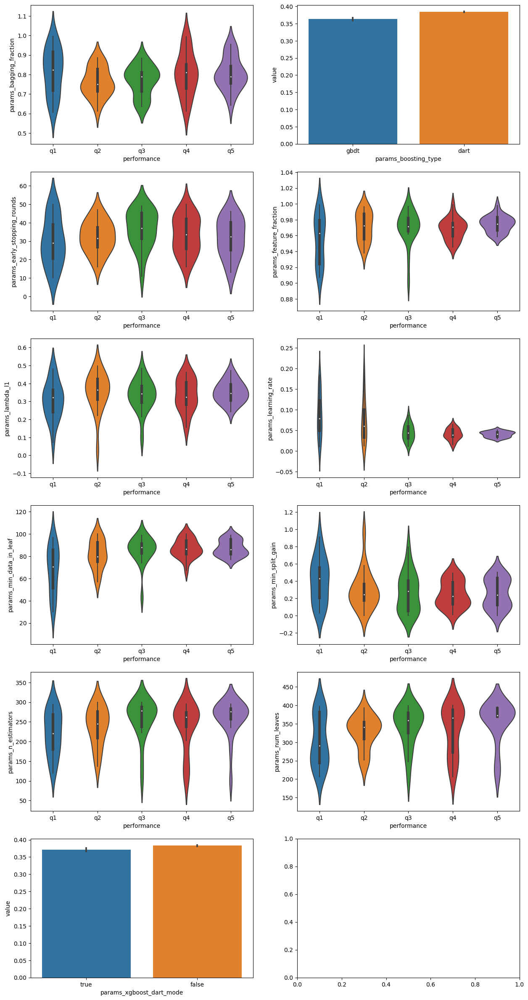

In [192]:
num_params=len([col for col in study_df.columns if 'params' in col])
if num_params%2==0:
    fig_rows=num_params//2
else:
    fig_rows=num_params//2+1

fig,axes=plt.subplots(fig_rows,2,figsize=(15,fig_rows*5))
for i,param in enumerate([col for col in study_df.columns if 'params' in col]):
    print(param)
    try:
        sns.violinplot(data=study_df,x='performance',y=param,ax=axes[i//2,i%2])
    except:
        sns.barplot(data=study_df,x=param,y='value',ax=axes[i//2,i%2])

In [191]:
study.best_params

{'xgboost_dart_mode': 'false',
 'boosting_type': 'dart',
 'early_stopping_rounds': 25,
 'n_estimators': 295,
 'bagging_fraction': 0.8272673749229497,
 'learning_rate': 0.04803724009814091,
 'num_leaves': 395,
 'min_data_in_leaf': 78,
 'feature_fraction': 0.9746284129060898,
 'min_split_gain': 0.4468038361552697,
 'lambda_l1': 0.28196661476690915}

In [137]:
study_df[(study_df['value']>0.9999999999999999) & (study_df['value']<=1.0)][['params_bagging_fraction', 'params_feature_fraction',
       'params_lambda_l1', 'params_learning_rate', 'params_min_data_in_leaf',
       'params_min_split_gain', 'params_n_estimators', 'params_num_leaves']].mean()

params_bagging_fraction      0.755828
params_feature_fraction      0.943518
params_lambda_l1             0.150457
params_learning_rate         0.146094
params_min_data_in_leaf     62.049180
params_min_split_gain        0.461545
params_n_estimators        235.196721
params_num_leaves          335.229508
dtype: float64

<Axes: xlabel='mean_importance', ylabel='Feature'>

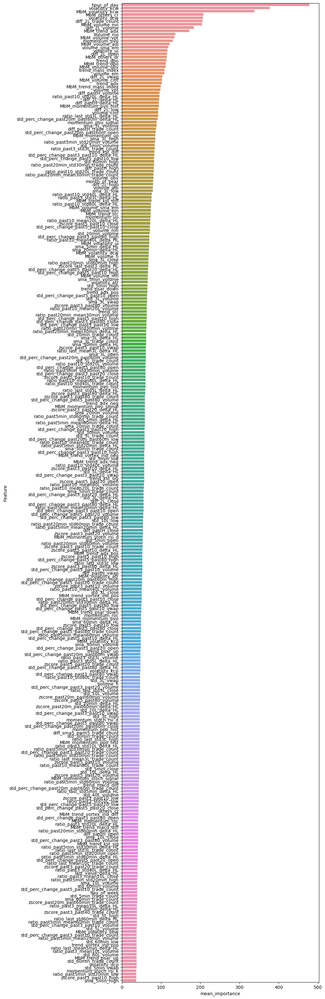

In [193]:
feature_imp=pd.DataFrame(zip(feature_importances.mean(axis=0),feature_importances.mean(axis=0)-1*feature_importances.std(axis=0)),columns=['mean_importance','lower_bound_importance'],index=feature_columns)
feature_imp=feature_imp.sort_values(by='mean_importance',ascending=False).reset_index().rename(columns={'index':'Feature'})

selected_features=feature_imp[feature_imp['lower_bound_importance']>0]['Feature'].tolist()

plt.figure(figsize=(8,40))
sns.barplot(x='mean_importance',y='Feature',data=feature_imp.iloc[0:300])

In [196]:
selected_features=['hour_of_day','volatility_kcw','MbM_others_cr','MbM_volume_nvi','MbM_trend_adx','MbM_volatility_kcw','diff_2L_trade_count','volatility_dcw','MbM_volume_vpt','diff_2L_volume','MbM_volume_adi','MbM_trend_dpo','trend_dpo','MbM_volume_obv','trend_adx','diff_2L_open','trend_mass_index','volume_nvi','MbM_volume_cmf','MbM_momentum_pvo_hist','MbM_trend_mass_index','std_perc_change_past20m_past60m_delta_HL','volatility_ui','diff_2L_vwap','MbM_others_dr','volume_cmf','volume_vpt','MbM_trend_stc','diff_2L_delta_HL','diff_pastH_trade_count','diff_2L_low','MbM_momentum_uo','volume_sma_em','ratio_last_std3L_delta_HL','volume_mfi','ratio_past10_std20L_delta_HL','MbM_volume_mfi','momentum_uo','ratio_past5min_std20min_volume','momentum_pvo_signal','ratio_past10_std80L_delta_HL','diff_pastH_delta_HL','std_perc_change_past5_past20_high','volume_obv','ratio_past20min_std30min_trade_count','std_perc_change_past20m_past60m_open','std_perc_change_past20m_past60m_volume','diff_pastH_volume','volume_em','std_perc_change_past5_past10_high','ratio_past20min_mean30min_volume','MbM_trend_kst_diff','ratio_past10_std40L_delta_HL','sma_3L_low','ratio_past20min_mean30min_trade_count','sma_3L_volume','trend_kst_diff','std_5min_volume','momentum_pvo','MbM_volatility_ui','diff_pastH_high','std_perc_change_past5_past10_low','sma_30min_trade_count','MbM_momentum_stoch_rsi_d','std_perc_change_past3_past80_high','sma_5min_delta_HL','std_perc_change_past5_past80_open','std_perc_change_past3_past10_delta_HL','std_20min_volume','sma_20min_delta_HL','sma_5min_volume','diff_2L_high','MbM_momentum_pvo_signal','ratio_past10_mean40L_delta_HL','ratio_past10_std20L_volume','std_perc_change_past5_past10_open','MbM_volume_em','zscore_last_past3_delta_HL','sma_3L_close','zscore_past5_past10_close','std_perc_change_past3_past20_delta_HL','zscore_past5_past10_delta_HL','ratio_past10_mean20L_delta_HL','zscore_past3_past10_delta_HL','std_perc_change_past3_past10_low','month_of_year','MbM_volume_sma_em','ratio_past10_mean20L_volume','ratio_past3_std3L_trade_count','MbM_momentum_stoch_signal','std_perc_change_past3_past80_delta_HL','sma_20min_trade_count','MbM_trend_vortex_ind_neg','ratio_past10_std40L_volume','trend_adx_pos','std_perc_change_past5_past20_trade_count','ratio_past10_mean80L_delta_HL','ratio_past5min_mean60min_delta_HL','zscore_past20m_past60min_delta_HL','zscore_past5_past10_open','MbM_volume_fi','diff_2L_close','std_20min_trade_count','ratio_past20min_mean30min_delta_HL','sma_3L_vwap','sma_30min_delta_HL','MbM_trend_vortex_ind_pos','sma_5min_trade_count','std_perc_change_past3_past20_close','std_perc_change_past3_past10_open','ratio_past5min_std20min_delta_HL','ratio_past3_std3L_volume','ratio_past5min_mean30min_delta_HL','std_perc_change_past5_past20_volume','std_perc_change_past5_past10_vwap','std_perc_change_past5_past10_close','MbM_trend_adx_pos','volatility_atr','sma_20min_volume','sma_3L_high','zscore_past5_past10_trade_count','std_perc_change_past3_past10_high','ratio_past20min_std60min_trade_count','ratio_past10_mean80L_volume','MbM_trend_adx_neg','std_perc_change_past20m_past60m_trade_count','std_perc_change_past5_past20_delta_HL','std_3L_volume','volume_adi','ratio_past10_std20L_trade_count','ratio_last_mean3L_delta_HL','trend_stc','zscore_past3_past10_trade_count','ratio_past5min_mean20min_delta_HL','std_5L_trade_count','zscore_past3_past20_delta_HL','ratio_past3_std3L_delta_HL','std_perc_change_past20m_past60m_low','zscore_past3_past10_low','std_perc_change_past5_past80_volume','ratio_past5min_std60min_trade_count','MbM_volatility_kcp','zscore_past5_past10_high','ratio_past20min_std60min_volume','ratio_last_std5L_delta_HL','std_perc_change_past5_past80_low','trend_kst_sig','std_3L_trade_count','ratio_past20min_std30min_delta_HL','ratio_past5min_std20min_trade_count','MbM_trend_psar_down','zscore_past3_past40_delta_HL','ratio_past10_mean40L_volume','diff_pastH_close','momentum_roc','std_perc_change_past5_past80_high','std_perc_change_past3_past20_vwap','ratio_past10_std40L_trade_count','momentum_pvo_hist','trend_psar_up','std_perc_change_past3_past80_close','diff_pastH_vwap','trend_psar_down','std_5min_low','MbM_momentum_pvo','std_perc_change_past5_past20_close','std_20min_delta_HL','std_5min_high','std_perc_change_past3_past80_vwap','trend_adx_neg','std_5min_delta_HL','MbM_volatility_dcw','ratio_past20min_std30min_volume','sma_3L_trade_count','sma_3L_open','std_10L_low','momentum_stoch_rsi_d','std_20L_delta_HL','std_perc_change_past3_past10_vwap','std_perc_change_past3_past20_high','zscore_past3_past80_delta_HL','sma_3L_delta_HL','std_perc_change_past5_past80_trade_count','std_perc_change_past5_past10_delta_HL','MbM_momentum_roc','std_perc_change_past3_past20_open','std_3L_high','zscore_past20m_past60min_volume','zscore_past3_past10_high','std_40L_volume','std_3L_delta_HL','std_5min_open','MbM_trend_vortex_ind_diff','ratio_past3_std10L_delta_HL','ratio_past5min_std30min_trade_count','std_perc_change_past3_past80_open','std_perc_change_past5_past80_delta_HL','volatility_kcp','zscore_past5_past10_vwap','ratio_last_std3L_high','ratio_past10_std80L_trade_count','ratio_past20min_std60min_delta_HL','std_perc_change_past5_past20_open','ratio_past5min_mean60min_volume','ratio_past5min_mean20min_volume','std_3L_vwap','std_perc_change_past5_past10_trade_count','std_60min_high','sma_30min_volume','std_perc_change_past20m_past60m_vwap','trend_vortex_ind_pos','std_perc_change_past3_past10_close','ratio_past5min_std30min_volume','ratio_last_std3L_low','ratio_past5min_std30min_delta_HL','std_10L_delta_HL','std_perc_change_past20m_past60m_high','zscore_past3_past80_trade_count','zscore_past3_past10_volume','ratio_past10_mean40L_trade_count','others_cr','sma_60min_volume','std_perc_change_past3_past20_volume','zscore_past5_past20_trade_count','std_5min_trade_count','momentum_ppo_hist','MbM_trend_kst_sig','std_30min_volume','zscore_past3_past80_volume','std_5L_volume','zscore_past20m_past60min_trade_count','ratio_past20min_mean60min_delta_HL','sma_10L_volume','sma_60min_delta_HL','zscore_past5_past10_volume','diff_pastH_open','std_perc_change_past5_past20_low','std_perc_change_past5_past10_volume','zscore_past5_past10_low','std_3L_close','zscore_past3_past10_vwap','sma_60min_trade_count','std_perc_change_past5_past80_close','ratio_past3_std10L_low','std_60min_volume','MbM_trend_macd_diff','MbM_trend_aroon_ind','ratio_past3_std5L_delta_HL','ratio_past3_std20L_delta_HL','ratio_past5min_std60min_delta_HL','std_5min_close','std_30min_delta_HL','ratio_last_std3L_close','std_30min_trade_count','MbM_trend_psar_up','sma_5min_close','ratio_last_std5min_low','volume_fi','ratio_past10_mean20L_trade_count','zscore_past5_past80_volume','ratio_past5min_mean30min_trade_count','std_perc_change_past5_past80_vwap','MbM_momentum_ppo_hist','std_10L_volume','std_5L_delta_HL','ratio_last_std5min_delta_HL','volatility_dcp','ratio_past3_std3L_high','std_perc_change_past3_past80_low','MbM_volatility_atr','trend_vortex_ind_neg','std_perc_change_past3_past20_trade_count','ratio_past10_mean80L_trade_count','diff_sma5_ewm5_delta_HL','ratio_past10_std80L_volume','diff_sma5_ewm5_trade_count','MbM_momentum_stoch_rsi_k','std_perc_change_past3_past10_volume','std_5L_high','std_perc_change_past20m_past60m_close','trend_macd_diff','sma_5min_high','MbM_trend_cci','std_5min_vwap','ratio_past3_std40L_delta_HL','ratio_past5min_std20min_open','ratio_past3_std3L_vwap','ratio_past3_std10L_trade_count','zscore_past3_past10_close','ratio_last_std5min_open','ratio_past3_std5L_trade_count','zscore_past3_past20_volume','std_10L_high','std_60min_trade_count','ratio_past5min_std20min_high','ratio_last_mean5min_trade_count','diff_pastH_low','momentum_stoch_rsi_k','ratio_past20min_mean60min_trade_count','MbM_momentum_rsi','zscore_past5_past20_volume','std_perc_change_past3_past80_volume','sma_10L_trade_count','ratio_past5min_std20min_low','MbM_momentum_tsi','zscore_past5_past40_delta_HL','ratio_past20min_std60min_high','MbM_volatility_bbw','std_60min_delta_HL','ratio_last_mean3L_trade_count','ratio_past20min_mean60min_volume','ratio_past3_std5L_volume','std_5L_low','ratio_past5min_std60min_volume','ratio_past3_std10L_volume','ratio_past5min_mean30min_volume','std_80L_volume','std_perc_change_past3_past10_trade_count','std_10L_open','ratio_last_std5L_high','ratio_past5min_mean60min_trade_count','ratio_past5min_mean20min_trade_count','zscore_past5_past20_delta_HL','ratio_past3_mean10L_volume','sma_10L_close','zscore_past3_past40_trade_count','zscore_last_past5_delta_HL','ratio_past5min_std30min_low','trend_vortex_ind_diff','trend_cci','zscore_past20m_past60min_high','ratio_past3_std80L_delta_HL','sma_10L_delta_HL','std_perc_change_past5_past20_vwap','day_of_week','zscore_past5_past80_trade_count','sma_20min_open','std_10L_close','ratio_past3_std3L_close','last_value_delta_HL','ratio_last_std5min_volume','std_perc_change_past3_past80_trade_count','std_5L_vwap','ratio_last_std3L_vwap','std_60min_low','ratio_last_std3L_trade_count','sma_5min_open','ratio_past10_mean20L_low','ratio_last_std5min_high','ratio_last_mean5min_delta_HL','ratio_past3_mean10L_delta_HL','ratio_past3_std10L_high','MbM_volatility_dcp','ratio_past3_mean10L_close','ratio_last_std60min_delta_HL','MbM_momentum_stoch_rsi','std_80L_low','MbM_trend_macd_signal','sma_5min_vwap','std_3L_low','sma_80L_delta_HL','sma_20min_high','ratio_past5min_std20min_close','momentum_tsi','ratio_last_std5min_trade_count','std_perc_change_past3_past20_low','zscore_past3_past10_open','std_10L_trade_count','ratio_past20min_mean30min_close','zscore_past3_past40_volume','ratio_past3_std10L_close','ratio_past3_std10L_open','ratio_last_std30min_delta_HL','std_5L_open','diff_sma5_ewm5_volume','zscore_past5_past40_trade_count','ratio_last_std5L_low','std_3L_open','zscore_past3_past20_low','zscore_past20m_past60min_low','ratio_last_std10L_low','zscore_past5_past40_volume','ratio_past3_std80L_trade_count','zscore_past20m_past60min_open','ratio_past5min_std20min_vwap','ratio_last_std5L_close','std_60min_close','trend_aroon_ind','ratio_last_std3L_open','zscore_past3_past20_trade_count','ratio_past3_std5L_high','std_20L_trade_count','MbM_volatility_bbp','ratio_last_std5min_vwap','ratio_past20min_mean30min_high','ratio_past20min_std60min_low','ratio_last_std20L_delta_HL','sma_10L_high','std_20L_high','ratio_past3_std80L_low','ratio_last_std3L_volume','std_80L_trade_count','ratio_past3_std5L_low','momentum_stoch_rsi','ratio_past5min_std30min_vwap','ratio_past3_mean10L_high','ratio_past3_mean10L_vwap','sma_5min_low','std_20min_low','zscore_past5_past80_delta_HL','ratio_last_std5L_vwap','ratio_past3_std5L_vwap','momentum_stoch_signal','std_20min_high','std_40L_delta_HL','ratio_last_std5min_close','ratio_past10_mean80L_open','ratio_past3_std3L_low','ratio_past10_std20L_high','sma_10L_low','ratio_past20min_mean30min_open','ratio_past3_mean80L_volume','zscore_past5_past20_low','std_80L_delta_HL','sma_20min_close','MbM_trend_kst','MbM_trend_aroon_up','volatility_bbp','ratio_past3_mean20L_delta_HL','ratio_last_std10L_delta_HL','sma_20min_vwap','sma_80L_volume','ratio_past10_mean80L_low','ratio_past10_mean20L_open','MbM_trend_aroon_down','sma_40L_volume','std_20L_volume','ratio_past10_std80L_low','ratio_past3_std3L_open','momentum_stoch','ratio_past3_std20L_high','ratio_last_std30min_trade_count','diff_sma5_ewm5_low','sma_20min_low','std_5L_close','std_20min_vwap','ratio_last_mean3L_volume','sma_40L_delta_HL','std_20min_close','ratio_last_std10L_high','ratio_last_std20min_delta_HL','ratio_past10_mean20L_close','ratio_past20min_mean30min_low','ratio_last_std60min_low','ratio_past3_std40L_volume','MbM_trend_trix','ratio_last_std20L_high','ratio_past3_mean10L_trade_count','ratio_last_std60min_volume','ratio_past3_mean10L_open','ratio_last_mean60min_volume','std_10L_vwap','ratio_past10_mean20L_high','ratio_past3_mean10L_low','ratio_past10_mean80L_high','ratio_past3_std80L_volume','zscore_past5_past40_high','ratio_last_mean10L_trade_count','std_20min_open','MbM_momentum_stoch','ratio_past20min_mean30min_vwap','zscore_past5_past20_high','sma_40L_trade_count','MbM_momentum_ao','zscore_last_past80_delta_HL','ratio_past3_mean40L_volume','momentum_rsi','ratio_last_mean10L_delta_HL','ratio_past3_std40L_trade_count','ratio_past3_mean80L_delta_HL','ratio_past5min_mean20min_open','ratio_past5min_mean30min_low','sma_80L_trade_count','ratio_last_std20L_low','ratio_last_std20L_open','ratio_last_std60min_high','ratio_past3_mean80L_trade_count','ratio_past5min_std30min_high','zscore_last_past10_delta_HL','std_40L_trade_count','ratio_past3_std5L_open','ratio_last_std20min_high','ratio_past3_std80L_high','ratio_past3_mean80L_high','sma_20L_delta_HL','MbM_momentum_ppo','zscore_past5_past20_open','trend_macd_signal','ratio_last_std20min_vwap','ratio_past3_std40L_high','sma_20L_trade_count','ratio_last_std5L_open','trend_aroon_up','others_dr','ratio_last_mean20min_delta_HL','diff_sma5_ewm5_open','zscore_past20m_past60min_close','ratio_past5min_std30min_close','sma_10L_open','zscore_past5_past40_open','ratio_last_std20min_close','ratio_last_std10L_open','MbM_momentum_ppo_signal','ratio_past3_std5L_close','ratio_past3_mean20L_volume','std_40L_high','zscore_past3_past80_high','std_80L_high','ratio_last_std40L_low','std_60min_vwap','std_60min_open','sma_20L_volume','ratio_past3_mean40L_delta_HL','ratio_past3_std20L_trade_count','sma_10L_vwap','ratio_past3_std10L_vwap','diff_sma5_ewm5_high','ratio_last_mean60min_delta_HL','std_20L_open','std_40L_low','sma_30min_low','zscore_past3_past40_high','ratio_past3_std20L_low','ratio_past10_std80L_high','ratio_past3_std20L_volume','ratio_last_std40L_high','ratio_last_std60min_trade_count','ratio_last_std20min_trade_count','diff_sma5_ewm5_close','zscore_past3_past80_low','ratio_last_std10L_vwap','zscore_past20m_past60min_vwap','ratio_last_std30min_close','zscore_last_past40_delta_HL','zscore_past3_past20_vwap','zscore_past3_past20_high','ratio_past3_mean20L_trade_count','ratio_last_mean30min_delta_HL','ratio_past3_std40L_low','std_30min_close','ratio_past10_mean20L_vwap','zscore_past3_past20_open','ratio_past10_std40L_high','ratio_last_mean20min_trade_count','ratio_past3_std20L_open','std_20L_low','last_value_trade_count','ratio_past5min_std60min_low','momentum_ao','ratio_past10_std40L_low','zscore_past3_past80_open','ratio_past20min_std60min_close','ratio_last_std10L_close','zscore_last_past20_delta_HL','last_value_volume','sma_30min_close','trend_aroon_down','ratio_last_std20min_low','ratio_last_std80L_delta_HL','ratio_last_std40L_delta_HL','trend_trix','ratio_last_mean5min_volume','zscore_past5_past40_low','ratio_last_std30min_high','ratio_last_std60min_vwap','ratio_past3_mean20L_high','ratio_past3_mean40L_high','ratio_past5min_std60min_open','ratio_past20min_mean60min_high','ratio_last_std20L_close','ratio_last_std20L_vwap','ratio_past5min_std30min_open','ratio_past5min_mean30min_open','ratio_past20min_mean60min_low','ratio_past5min_std60min_close','ratio_past5min_std60min_high','ratio_last_std5L_trade_count','ratio_past10_std20L_open','ratio_past5min_mean30min_close','ratio_past3_mean80L_low','std_30min_low','ratio_past20min_std60min_open','ratio_last_std30min_open','sma_30min_open','trend_kst','zscore_past3_past20_close','ratio_past20min_std60min_vwap','trend_macd','sma_30min_high','ratio_past3_mean20L_close','ratio_last_std60min_open','MbM_trend_macd','ratio_past10_std20L_low','zscore_past3_past80_close','ratio_past5min_mean30min_vwap','ratio_past5min_mean20min_high','ratio_past5min_std60min_vwap','ratio_past20min_mean60min_open','ratio_last_std30min_low','ratio_past3_std80L_open','zscore_past5_past20_close','zscore_past3_past40_open','ratio_past3_mean80L_close','ratio_past5min_mean20min_low','std_30min_open','ratio_last_std20L_trade_count','ratio_last_std20min_volume','ratio_past3_mean20L_low','ratio_past5min_mean30min_high','ratio_last_std30min_volume','ratio_past5min_mean60min_close','sma_80L_high','ratio_past3_std20L_close','std_30min_high','sma_60min_open','diff_sma5_ewm5_vwap','std_40L_open','ratio_past10_mean40L_low','ratio_past3_mean40L_close','ratio_last_std80L_high','ratio_past3_mean40L_trade_count','ratio_last_std60min_close','sma_80L_low','ratio_last_mean80L_delta_HL','ratio_last_std30min_vwap','ratio_last_std5L_volume','zscore_past3_past40_low','ratio_past10_std40L_close','std_80L_open','ratio_past3_std40L_open','ratio_last_mean60min_trade_count','volatility_bbw','std_40L_close','std_80L_close','std_30min_vwap','std_20L_close','ratio_last_std80L_low','ratio_last_std20min_open','sma_60min_high','ratio_last_std40L_open','ratio_last_mean20L_delta_HL','zscore_past5_past80_high','ratio_past3_mean80L_open','zscore_past5_past80_open','ratio_last_mean30min_volume','zscore_past3_past80_vwap','momentum_ppo_signal','zscore_past5_past20_vwap','ratio_last_mean30min_trade_count','sma_30min_vwap','ratio_past20min_std30min_close','std_20L_vwap','ratio_past10_mean40L_open','ratio_past20min_mean60min_close','ratio_past3_std40L_close','zscore_past3_past40_close','ratio_past5min_mean60min_high','ratio_past5min_mean20min_close','ratio_past10_mean80L_close','ratio_past3_mean80L_vwap','sma_80L_open','ratio_past3_std80L_close','ratio_last_std10L_trade_count','ratio_past5min_mean20min_vwap','ratio_last_mean40L_delta_HL','sma_20L_high','sma_60min_low','ratio_past20min_mean60min_vwap','ratio_last_mean20min_volume','ratio_past10_std80L_open','std_80L_vwap','ratio_past10_mean40L_high','ratio_past3_mean20L_open','zscore_past5_past80_low','ratio_past3_std40L_vwap','ratio_past10_std40L_open','zscore_last_past3_low','ratio_last_mean20L_trade_count','ratio_past3_mean40L_low','ratio_past10_mean40L_close','ratio_past3_std20L_vwap','ratio_past10_std80L_close','ratio_last_std40L_trade_count','sma_40L_high','sma_20L_open','std_40L_vwap','zscore_last_past3_trade_count','ratio_past10_std80L_vwap','zscore_past3_past40_vwap','ratio_past10_mean80L_vwap','ratio_last_mean10L_volume','ratio_past10_std20L_vwap','sma_20L_low','ratio_past3_mean40L_vwap','ratio_last_std40L_vwap','zscore_last_past3_high','ratio_past20min_std30min_low','ratio_past10_std20L_close','zscore_past5_past40_close','ratio_past5min_mean60min_low','zscore_past5_past40_vwap','ratio_past10_mean40L_vwap','ratio_last_std80L_open','ratio_past20min_std30min_high','momentum_ppo','MbM_momentum_wr','ratio_past10_std40L_vwap','trend_visual_ichimoku_b','ratio_past3_std80L_vwap','ratio_past3_mean20L_vwap','zscore_last_past3_close','ratio_past5min_mean60min_vwap','ratio_past5min_mean60min_open','ratio_last_std40L_close','sma_60min_close','sma_80L_close','sma_60min_vwap','zscore_past5_past80_close','sma_40L_low','ratio_last_std80L_close','ratio_last_std80L_trade_count','sma_40L_open','sma_20L_vwap','ratio_past20min_std30min_open','ratio_past20min_std30min_vwap','zscore_past5_past80_vwap','ratio_last_mean80L_trade_count','zscore_last_past10_low','momentum_wr','ratio_last_std80L_vwap','ratio_last_mean40L_trade_count','zscore_last_past5_high','ratio_last_std10L_volume','ratio_past3_mean40L_open','zscore_last_past5_low','zscore_last_past5_close','sma_80L_vwap','zscore_last_past3_vwap','zscore_last_past5_vwap','sma_20L_close','sma_40L_close','trend_visual_ichimoku_a','zscore_last_past20_high','sma_40L_vwap','zscore_last_past10_high','zscore_last_past3_open','zscore_last_past20_open','ratio_last_mean20L_volume','ratio_last_mean80L_volume','MbM_trend_visual_ichimoku_a','zscore_last_past10_open','zscore_last_past20_low','zscore_last_past40_low','zscore_last_past5_trade_count','ratio_last_mean40L_volume','zscore_last_past20_trade_count','ratio_last_std80L_volume','ratio_last_std20L_volume','ratio_last_std40L_volume','zscore_last_past5_open','zscore_last_past80_high','trend_ichimoku_b','zscore_last_past40_high','zscore_last_past20_vwap','zscore_last_past10_close','zscore_last_past10_vwap','volatility_bbl','zscore_last_past20_close','zscore_last_past80_low','ratio_last_mean80L_open','volatility_dcl','zscore_last_past40_open','ratio_last_mean5min_open','zscore_last_past10_trade_count','zscore_last_past40_trade_count','ratio_last_mean80L_high','zscore_last_past10_volume','zscore_last_past80_trade_count','zscore_last_past80_vwap','MbM_volume_vwap','zscore_last_past40_close','zscore_last_past80_open','zscore_last_past80_volume','zscore_last_past40_vwap','zscore_last_past80_close','ratio_last_mean80L_low','zscore_last_past40_volume','volatility_bbh','ratio_last_mean40L_low','ratio_last_mean40L_open','zscore_last_past20_volume','ratio_last_mean80L_close','ratio_last_mean20L_low','ratio_last_mean40L_high','ratio_last_mean40L_close','MbM_trend_visual_ichimoku_b','ratio_last_mean10L_low','trend_ichimoku_base','MbM_volatility_kch','ratio_last_mean20L_open','volatility_dch','ratio_last_mean80L_vwap','trend_sma_slow','MbM_volatility_bbl','ratio_last_mean40L_vwap','ratio_last_mean20L_high','MbM_volatility_bbh','volume_vwap','MbM_volatility_dcl','volatility_bbm','volatility_kcl','MbM_trend_ichimoku_b','last_value_open','volatility_dcm']
selected_feature

# train final model

In [280]:
test['label']=(test['close']>1.01*test['open'])
train['label']=(train['close']>1.01*train['open'])

In [281]:
for df in [train,test]:
    for cat in categorical:
        df[cat]=df[cat].astype("category")

In [282]:
#selected_features.remove('volatility_dcw')
ns_probs = [0 for _ in range(test.shape[0])]
# fit a model
params={'xgboost_dart_mode': 'false',
 'boosting_type': 'dart',
 'early_stopping_rounds': 25,
 'n_estimators': 295,
 'bagging_fraction': 0.8272673749229497,
 'learning_rate': 0.04803724009814091,
 'num_leaves': 395,
 'min_data_in_leaf': 78,
 'feature_fraction': 0.9746284129060898,
 'min_split_gain': 0.4468038361552697,
 'lambda_l1': 0.28196661476690915}
clf = lgb.LGBMClassifier(**params)
clf.fit(train[[feature for feature in feature_columns if feature in selected_features]], train['label'])#, categorical_feature=['symbol']

[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] feature_fraction is set=0.9746284129060898, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9746284129060898
[LightGBM] [Warning] bagging_fraction is set=0.8272673749229497, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8272673749229497
[LightGBM] [Warning] lambda_l1 is set=0.28196661476690915, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28196661476690915
[LightGBM] [Warning] early_stopping_round is set=25, early_stopping_rounds=25 will be ignored. Current value: early_stopping_round=25


/opt/anaconda3/envs/hft/lib/python3.8/site-packages/lightgbm/callback.py:223: UserWarning: Early stopping is not available in dart mode
  _log_warning('Early stopping is not available in dart mode')


LGBMClassifier(bagging_fraction=0.8272673749229497, boosting_type='dart',
               early_stopping_rounds=25, feature_fraction=0.9746284129060898,
               lambda_l1=0.28196661476690915, learning_rate=0.04803724009814091,
               min_data_in_leaf=78, min_split_gain=0.4468038361552697,
               n_estimators=295, num_leaves=395, xgboost_dart_mode='false')

No Skill: ROC AUC=0.500
Model: ROC AUC=0.874


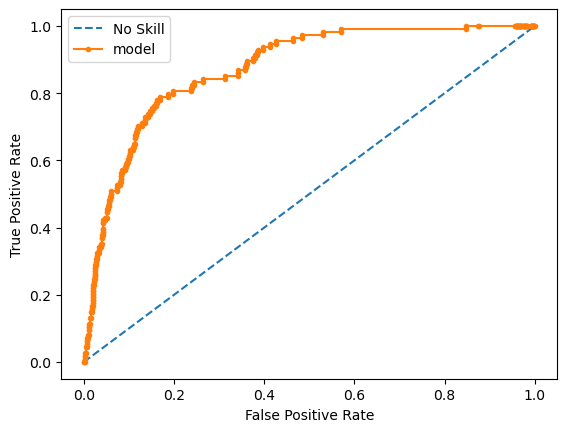

In [283]:
# predict probabilities
model_probs = clf.predict_proba(test[[feature for feature in feature_columns if feature in selected_features]])[:, 1]
# calculate scores
ns_auc = roc_auc_score(test['label'], ns_probs)
model_auc = roc_auc_score(test['label'], model_probs)
# summarize scores
print('No Skill: ROC AUC=%.3f' % (ns_auc))
print('Model: ROC AUC=%.3f' % (model_auc))
# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(test['label'], ns_probs)
model_fpr, model_tpr, _ = roc_curve(test['label'], model_probs)
# plot the roc curve for the model
plt.plot(ns_fpr, ns_tpr, linestyle='--', label='No Skill')
plt.plot(model_fpr, model_tpr, marker='.', label='model')
# axis labels
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
# show the legend
plt.legend()
# show the plot
plt.show()

In [284]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

In [285]:
test_scores1=pd.concat([pd.Series(model_probs,index=test.index),test['symbol']],axis=1).rename(columns={0:'score'})

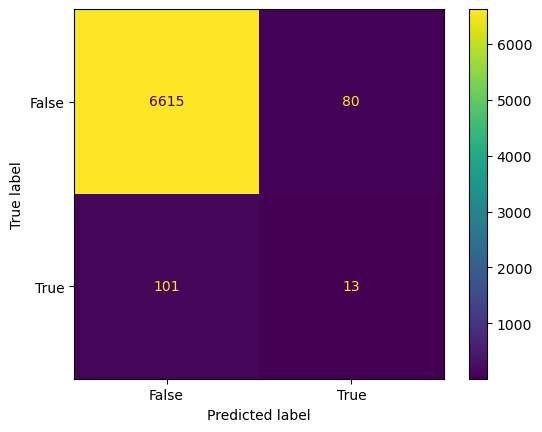

In [288]:
cm = confusion_matrix((test['label']), test_scores1.score>0.15, labels=clf.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,display_labels=clf.classes_)
disp.plot()

In [279]:
XX=pd.concat([test_scores1,test_scores2.drop(columns='symbol').rename(columns={'score':'score_downside'})],axis=1)
test[(XX['score']>0.2) & (XX['score_downside']<0.2)][['open','high','low','close']]

,open,high,low,close
timestamp,,,,
2023-09-11 13:00:00+00:00,462.990,463.0000,445.0500,445.900
2023-09-18 13:00:00+00:00,429.200,435.6000,420.0000,433.190
2023-10-04 13:00:00+00:00,437.060,440.4399,435.5600,438.506
2023-10-16 14:00:00+00:00,455.565,461.2514,454.9500,459.632
2023-10-23 13:00:00+00:00,412.480,419.5700,409.4500,419.240
2023-11-13 14:00:00+00:00,484.500,486.4700,480.9901,483.820
2023-12-19 14:00:00+00:00,136.360,137.4700,136.1037,136.710


In [47]:
# ROC history: iteration 1: ROC AUC=0.809
# ROC history: iteration 2: ROC AUC=0.898 added 4 tech companies and data from 2020, added feature selection
# ROC history: iteration 2: ROC AUC=0.986 Normalised features added technical analysis
# ROC history: iteration 2: ROC AUC=0.999 with feature selection
# ROC history: iteration 2: ROC AUC=0.942 ewm was causing data leakage, removed it, dcw is suspecious!
# ROC history: iteration 2: ROC AUC=0.898 after fixing things and adding minute features FP:128 TP:73 FN:187 TN:6421
# ROC history: iteration 2: ROC AUC=0.902 after hyper prameter tuning  FP:121 TP:73 FN:187 TN:6428